# Cars Classification on the Stanford dataset (fastai)


In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

Import all the necessary packages. We are going to work with the [fastai V1 library](http://www.fast.ai/2018/10/02/fastai-ai/) which sits on top of [Pytorch 1.0](https://hackernoon.com/pytorch-1-0-468332ba5163). The fastai library provides many useful functions that enable us to quickly and easily build neural networks and train our models.

In [2]:
from fastai.vision import *
from fastai.metrics import error_rate
from fastai import *
import cv2 as cv

## Looking at the data

In [40]:
# https://github.com/foamliu/Car-Recognition/blob/master/pre-process.py

import tarfile
import scipy.io
import numpy as np
import os
import cv2 as cv
import shutil
import random
from console_progressbar import ProgressBar


def ensure_folder(folder):
    if not os.path.exists(folder):
        os.makedirs(folder)


def save_train_data(fnames, labels, bboxes):
    src_folder ='//home//jupyter//cars_train//'
    num_samples = len(fnames)

    train_split = 0.8
    num_train = int(round(num_samples * train_split))
    train_indexes = random.sample(range(num_samples), num_train)

    pb = ProgressBar(total=100, prefix='Save train data', suffix='', decimals=3, length=50, fill='=')

    for i in range(num_samples):
        fname = fnames[i]
        label = labels[i]
        (x1, y1, x2, y2) = bboxes[i]

        src_path = os.path.join(src_folder, fname)
        print(src_path)
        src_image = cv.imread(src_path)
        print(src_image)
        height, width = src_image.shape[:2]
        # margins of 16 pixels
        margin = 16
        x1 = max(0, x1 - margin)
        y1 = max(0, y1 - margin)
        x2 = min(x2 + margin, width)
        y2 = min(y2 + margin, height)
        # print("{} -> {}".format(fname, label))
        pb.print_progress_bar((i + 1) * 100 / num_samples)

        if i in train_indexes:
            dst_folder = '//home//jupyter//.fastai//data//train//'
        else:
            dst_folder = '//home//jupyter//.fastai//data//valid//'

        dst_path = os.path.join(dst_folder, label)
        if not os.path.exists(dst_path):
            os.makedirs(dst_path)
        dst_path = os.path.join(dst_path, fname)

        crop_image = src_image[y1:y2, x1:x2]
        dst_img = cv.resize(src=crop_image, dsize=(img_height, img_width))
        cv.imwrite(dst_path, dst_img)


def save_test_data(fnames, bboxes):
    src_folder = '//home//jupyter//cars_test//'
    dst_folder = '//home//jupyter//.fastai//data//test//'
    num_samples = len(fnames)

    pb = ProgressBar(total=100, prefix='Save test data', suffix='', decimals=3, length=50, fill='=')

    for i in range(num_samples):
        fname = fnames[i]
        (x1, y1, x2, y2) = bboxes[i]
        src_path = os.path.join(src_folder, fname)
        src_image = cv.imread(src_path)
        height, width = src_image.shape[:2]
        # margins of 16 pixels
        margin = 16
        x1 = max(0, x1 - margin)
        y1 = max(0, y1 - margin)
        x2 = min(x2 + margin, width)
        y2 = min(y2 + margin, height)
        # print(fname)
        pb.print_progress_bar((i + 1) * 100 / num_samples)

        dst_path = os.path.join(dst_folder, fname)
        crop_image = src_image[y1:y2, x1:x2]
        dst_img = cv.resize(src=crop_image, dsize=(img_height, img_width))
        cv.imwrite(dst_path, dst_img)


def process_train_data():
    print("Processing train data...")
    cars_annos = scipy.io.loadmat('//home//jupyter//devkit//cars_train_annos.mat')
    annotations = cars_annos['annotations']
    annotations = np.transpose(annotations)

    fnames = []
    class_ids = []
    bboxes = []
    labels = []

    for annotation in annotations:
        bbox_x1 = annotation[0][0][0][0]
        bbox_y1 = annotation[0][1][0][0]
        bbox_x2 = annotation[0][2][0][0]
        bbox_y2 = annotation[0][3][0][0]
        class_id = annotation[0][4][0][0]
        labels.append('%04d' % (class_id,))
        fname = annotation[0][5][0]
        bboxes.append((bbox_x1, bbox_y1, bbox_x2, bbox_y2))
        class_ids.append(class_id)
        fnames.append(fname)

    labels_count = np.unique(class_ids).shape[0]
    print(np.unique(class_ids))
    print('The number of different cars is %d' % labels_count)

    save_train_data(fnames, labels, bboxes)


def process_test_data():
    print("Processing test data...")
    cars_annos = scipy.io.loadmat('//home//jupyter//devkit//cars_test_annos.mat')
    annotations = cars_annos['annotations']
    annotations = np.transpose(annotations)

    fnames = []
    bboxes = []

    for annotation in annotations:
        bbox_x1 = annotation[0][0][0][0]
        bbox_y1 = annotation[0][1][0][0]
        bbox_x2 = annotation[0][2][0][0]
        bbox_y2 = annotation[0][3][0][0]
        fname = annotation[0][4][0]
        bboxes.append((bbox_x1, bbox_y1, bbox_x2, bbox_y2))
        fnames.append(fname)

    save_test_data(fnames, bboxes)


if __name__ == '__main__':
    # parameters
    img_width, img_height = 224, 224

    print('Extracting cars_train.tgz...')
    if not os.path.exists('cars_train'):
        with tarfile.open('//home//jupyter//.fastai//data//cars_train.tgz', "r:gz") as tar:
            tar.extractall()
    print('Extracting cars_test.tgz...')
    if not os.path.exists('cars_test'):
        with tarfile.open('//home//jupyter//.fastai//data//cars_test.tgz', "r:gz") as tar:
            tar.extractall()
    print('Extracting car_devkit.tgz...')
    if not os.path.exists('devkit'):
        with tarfile.open('//home//jupyter//.fastai//data//car_devkit.tgz', "r:gz") as tar:
            tar.extractall()

    cars_meta = scipy.io.loadmat('devkit/cars_meta')
    class_names = cars_meta['class_names']  # shape=(1, 196)
    class_names = np.transpose(class_names)
    print('class_names.shape: ' + str(class_names.shape))
    print('Sample class_name: [{}]'.format(class_names[8][0][0]))

    ensure_folder('//home//jupyter//.fastai//data/train')
    ensure_folder('//home//jupyter//.fastai//data/valid')
    ensure_folder('//home//jupyter//.fastai//data/test')

    process_train_data()
    process_test_data()

    # clean up
    shutil.rmtree('cars_train')
    shutil.rmtree('cars_test')
# shutil.rmtree('devkit')

Extracting cars_train.tgz...
Extracting cars_test.tgz...
Extracting car_devkit.tgz...
class_names.shape: (196, 1)
Sample class_name: [Aston Martin V8 Vantage Coupe 2012]
Processing train data...
[  1   2   3   4 ... 193 194 195 196]
The number of different cars is 196
//home//jupyter//cars_train//00001.jpg
[[[123 119 101]
  [120 116  98]
  [115 111  93]
  [109 105  87]
  ...
  [255 255 249]
  [255 255 250]
  [255 255 251]
  [255 255 251]]

 [[111 107  89]
  [115 111  93]
  [118 114  96]
  [117 113  95]
  ...
  [255 255 249]
  [255 255 250]
  [255 255 251]
  [255 255 251]]

 [[103  99  81]
  [108 104  86]
  [114 110  92]
  [116 112  94]
  ...
  [254 254 248]
  [255 255 249]
  [255 255 250]
  [255 255 251]]

 [[105 101  83]
  [106 102  84]
  [105 101  83]
  [104 100  82]
  ...
  [253 253 247]
  [254 254 248]
  [255 255 249]
  [255 255 250]]

 ...

 [[156 173 170]
  [158 175 172]
  [164 177 175]
  [164 177 175]
  ...
  [ 92  92  80]
  [ 91  91  79]
  [ 94  94  82]
  [ 98  98  86]]

 [[165

Save train data |--------------------------------------------------| 0.086% //home//jupyter//cars_train//00008.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [138 150 152]
  [137 149 151]
  [141 153 155]
  [147 159 161]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [138 150 152]
  [136 148 150]
  [140 152 154]
  [146 158 160]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [127 140 142]
  [125 138 140]
  [129 142 144]
  [135 148 150]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [132 145 147]
  [130 143 145]
  [135 148 150]
  [140 153 155]]

 ...

 [[116 139 161]
  [131 154 176]
  [121 144 166]
  [119 142 164]
  ...
  [ 87 107 124]
  [ 86 106 123]
  [ 89 109 126]
  [ 93 113 130]]

 [[119 142 164]
  [133 156 178]
  [121 144 166]
  [117 140 162]
  ...
  [ 88 108 125]
  [ 84 104 121]
  [ 84 104 121]
  [ 87 107 124]]

 [[118 141 163]
  [132 155 177]
  [120 143 165]
  [117 140 162]

Save train data |--------------------------------------------------| 0.172% //home//jupyter//cars_train//00015.jpg
[[[ 89 101 111]
  [ 88 100 110]
  [ 88 100 110]
  [ 88 100 110]
  ...
  [171 185 204]
  [170 184 203]
  [169 183 202]
  [169 183 202]]

 [[ 89 101 111]
  [ 89 101 111]
  [ 88 100 110]
  [ 88 100 110]
  ...
  [171 185 204]
  [170 184 203]
  [169 183 202]
  [169 183 202]]

 [[ 89 101 111]
  [ 89 101 111]
  [ 88 100 110]
  [ 88 100 110]
  ...
  [171 185 204]
  [170 184 203]
  [169 183 202]
  [169 183 202]]

 [[ 90 102 112]
  [ 89 101 111]
  [ 89 101 111]
  [ 89 101 111]
  ...
  [171 185 204]
  [170 184 203]
  [169 183 202]
  [169 183 202]]

 ...

 [[135 121  99]
  [133 119  97]
  [129 115  93]
  [127 113  91]
  ...
  [ 29  26  28]
  [ 29  26  28]
  [ 29  26  28]
  [ 29  26  28]]

 [[124 110  88]
  [125 111  89]
  [127 113  91]
  [129 115  93]
  ...
  [ 28  25  27]
  [ 29  26  28]
  [ 29  26  28]
  [ 29  26  28]]

 [[123 109  87]
  [124 110  88]
  [125 111  89]
  [126 112  90]

Save train data |--------------------------------------------------| 0.258% //home//jupyter//cars_train//00022.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [227 227 227]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [219 219 219]
  [232 232 232]
  [211 211 211]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |--------------------------------------------------| 0.344% //home//jupyter//cars_train//00029.jpg
[[[163 147 131]
  [162 146 130]
  [160 144 128]
  [158 142 126]
  ...
  [145 118  97]
  [149 122 101]
  [146 119  98]
  [140 113  92]]

 [[163 147 131]
  [162 146 130]
  [160 144 128]
  [159 143 127]
  ...
  [144 117  97]
  [147 123 101]
  [147 120 100]
  [141 117  95]]

 [[159 143 127]
  [158 142 126]
  [158 142 126]
  [159 143 127]
  ...
  [142 116  99]
  [143 119  99]
  [143 117 100]
  [140 116  96]]

 [[153 137 121]
  [153 137 121]
  [155 139 123]
  [157 141 125]
  ...
  [144 119 103]
  [139 117  99]
  [139 114  98]
  [137 115  97]]

 ...

 [[ 41  53  77]
  [ 50  64  86]
  [ 63  78  97]
  [ 49  67  84]
  ...
  [ 95 116 138]
  [113 133 158]
  [131 150 177]
  [129 150 177]]

 [[ 52  66  89]
  [ 60  76  99]
  [ 84 101 122]
  [ 57  74  93]
  ...
  [104 121 147]
  [119 139 164]
  [132 149 176]
  [133 152 179]]

 [[ 82 103 125]
  [ 83 104 126]
  [ 88 105 126]
  [ 54  68  87]

Save train data |--------------------------------------------------| 0.442% //home//jupyter//cars_train//00037.jpg
[[[  5   2   0]
  [ 12  11   7]
  [  4   7   5]
  [ 30  36  35]
  ...
  [ 11  10  12]
  [ 13  12  14]
  [ 13  12  14]
  [ 11  10  12]]

 [[ 11   8   3]
  [ 17  16  12]
  [  8  11   9]
  [ 33  39  38]
  ...
  [ 13  12  14]
  [ 12  11  13]
  [  8   7   9]
  [  5   4   6]]

 [[ 13  10   5]
  [ 17  16  12]
  [  6   9   7]
  [ 30  36  35]
  ...
  [ 10   9  11]
  [ 11  10  12]
  [ 10   9  11]
  [  8   7   9]]

 [[ 15  12   7]
  [ 17  16  12]
  [  4   7   5]
  [ 29  34  33]
  ...
  [  7   6   8]
  [ 10   9  11]
  [ 13  12  14]
  [ 14  13  15]]

 ...

 [[165 177 179]
  [199 211 213]
  [189 201 203]
  [193 205 207]
  ...
  [116  92  70]
  [108  85  63]
  [105  84  62]
  [120  99  77]]

 [[173 185 187]
  [202 214 216]
  [187 199 201]
  [193 205 207]
  ...
  [117  93  71]
  [113  90  68]
  [108  87  65]
  [116  95  73]]

 [[194 206 208]
  [202 214 216]
  [170 182 184]
  [178 190 192]

Save train data |--------------------------------------------------| 0.528% //home//jupyter//cars_train//00044.jpg
[[[ 79 129 125]
  [ 87 143 138]
  [ 74 138 132]
  [ 89 157 150]
  ...
  [204 209 212]
  [202 205 209]
  [202 205 209]
  [202 205 209]]

 [[ 80 130 128]
  [ 92 139 137]
  [ 88 130 129]
  [ 85 124 122]
  ...
  [203 205 206]
  [201 204 208]
  [201 204 208]
  [200 203 207]]

 [[ 95 142 140]
  [101 145 144]
  [109 149 147]
  [ 92 131 129]
  ...
  [199 198 200]
  [194 197 201]
  [194 197 201]
  [194 197 201]]

 [[ 65 115 113]
  [ 61 118 115]
  [ 75 145 138]
  [ 81 160 151]
  ...
  [196 196 196]
  [192 194 195]
  [191 193 194]
  [191 193 194]]

 ...

 [[197 195 195]
  [196 194 194]
  [206 204 204]
  [199 197 197]
  ...
  [170 166 171]
  [171 170 174]
  [170 169 173]
  [170 169 173]]

 [[191 188 190]
  [187 184 186]
  [193 190 192]
  [193 190 192]
  ...
  [174 170 175]
  [172 171 175]
  [171 170 174]
  [171 170 174]]

 [[190 187 189]
  [190 187 189]
  [191 188 190]
  [195 192 194]

Save train data |--------------------------------------------------| 0.614% //home//jupyter//cars_train//00051.jpg
[[[209 190 163]
  [209 190 163]
  [209 190 163]
  [210 191 164]
  ...
  [255 255 237]
  [255 255 237]
  [255 255 237]
  [255 255 237]]

 [[209 190 163]
  [209 190 163]
  [210 191 164]
  [210 191 164]
  ...
  [255 255 237]
  [255 255 237]
  [255 255 237]
  [255 255 237]]

 [[209 190 163]
  [210 191 164]
  [210 191 164]
  [210 191 164]
  ...
  [255 255 237]
  [255 255 237]
  [255 255 237]
  [255 255 237]]

 [[210 191 164]
  [210 191 164]
  [210 191 164]
  [211 192 165]
  ...
  [255 255 237]
  [255 255 237]
  [255 255 237]
  [255 255 237]]

 ...

 [[214 217 208]
  [204 207 198]
  [205 208 199]
  [210 213 204]
  ...
  [255 255 255]
  [237 237 237]
  [153 153 153]
  [ 54  54  54]]

 [[223 226 217]
  [209 212 203]
  [208 211 202]
  [215 218 209]
  ...
  [243 243 243]
  [225 225 225]
  [153 153 153]
  [ 68  68  68]]

 [[225 228 219]
  [212 215 206]
  [212 215 206]
  [216 219 210]

Save train data |--------------------------------------------------| 0.700% //home//jupyter//cars_train//00058.jpg
[[[ 25  87  63]
  [ 46 108  84]
  [ 56 114  90]
  [ 61 119  95]
  ...
  [255 255 255]
  [255 254 255]
  [254 253 255]
  [255 254 255]]

 [[ 29  91  67]
  [ 63 125 101]
  [ 55 115  91]
  [ 74 132 108]
  ...
  [255 255 255]
  [255 254 255]
  [255 254 255]
  [255 254 255]]

 [[ 37  99  75]
  [ 48 110  86]
  [ 54 114  90]
  [ 62 122  98]
  ...
  [255 255 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 82 142 118]
  [106 166 142]
  [117 177 153]
  [ 84 144 120]
  ...
  [255 254 253]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[192 192 192]
  [192 192 192]
  [194 194 194]
  [196 196 196]
  ...
  [198 200 201]
  [196 198 199]
  [195 197 198]
  [195 197 198]]

 [[189 188 190]
  [190 189 191]
  [192 191 193]
  [193 193 193]
  ...
  [202 203 207]
  [210 211 215]
  [212 213 217]
  [205 206 210]]

 [[199 198 202]
  [199 198 202]
  [191 190 194]
  [203 202 204]

Save train data |--------------------------------------------------| 0.786% //home//jupyter//cars_train//00065.jpg
[[[251 252 250]
  [255 255 250]
  [224 222 212]
  [242 233 224]
  ...
  [ 36  42  41]
  [ 35  41  40]
  [ 35  41  40]
  [ 36  41  40]]

 [[250 247 243]
  [227 218 214]
  [228 218 211]
  [255 255 249]
  ...
  [ 40  46  45]
  [ 40  45  44]
  [ 38  43  42]
  [ 36  41  40]]

 [[239 227 221]
  [238 224 218]
  [255 251 244]
  [252 254 248]
  ...
  [ 34  39  38]
  [ 35  40  39]
  [ 37  42  41]
  [ 39  44  43]]

 [[240 217 209]
  [251 236 227]
  [249 247 239]
  [248 252 247]
  ...
  [ 43  48  47]
  [ 42  47  46]
  [ 41  46  45]
  [ 41  46  45]]

 ...

 [[126 124 123]
  [129 125 124]
  [130 126 125]
  [133 128 127]
  ...
  [133 131 131]
  [133 131 131]
  [133 131 131]
  [133 131 131]]

 [[130 127 123]
  [130 127 123]
  [130 127 123]
  [130 127 123]
  ...
  [131 127 126]
  [131 127 126]
  [131 127 126]
  [133 129 128]]

 [[131 128 123]
  [131 128 123]
  [130 127 122]
  [130 127 122]

Save train data |--------------------------------------------------| 0.872% //home//jupyter//cars_train//00072.jpg
[[[218 213 212]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [229 223 224]
  [229 223 224]
  [229 223 224]
  [229 223 224]]

 [[218 213 212]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [229 223 224]
  [229 223 224]
  [229 223 224]
  [229 223 224]]

 [[218 213 212]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [229 223 224]
  [229 223 224]
  [229 223 224]
  [229 223 224]]

 [[217 212 211]
  [217 212 211]
  [217 212 211]
  [217 212 211]
  ...
  [229 223 224]
  [229 223 224]
  [229 223 224]
  [229 223 224]]

 ...

 [[234 233 235]
  [234 233 235]
  [233 232 234]
  [232 231 233]
  ...
  [232 231 233]
  [232 231 233]
  [232 231 233]
  [231 230 232]]

 [[233 232 234]
  [232 231 233]
  [231 230 232]
  [231 230 232]
  ...
  [231 230 232]
  [230 229 231]
  [229 228 230]
  [228 227 229]]

 [[234 233 235]
  [233 232 234]
  [233 232 234]
  [232 231 233]

Save train data |--------------------------------------------------| 0.958% //home//jupyter//cars_train//00079.jpg
[[[201 199 198]
  [201 199 198]
  [201 199 198]
  [201 199 198]
  ...
  [224 200 182]
  [224 200 182]
  [224 200 182]
  [224 200 182]]

 [[201 199 198]
  [201 199 198]
  [201 199 198]
  [201 199 198]
  ...
  [224 200 182]
  [224 200 182]
  [224 200 182]
  [224 200 182]]

 [[201 199 198]
  [201 199 198]
  [201 199 198]
  [201 199 198]
  ...
  [224 200 182]
  [224 200 182]
  [224 200 182]
  [224 200 182]]

 [[201 199 198]
  [201 199 198]
  [201 199 198]
  [201 199 198]
  ...
  [225 201 183]
  [225 201 183]
  [225 201 183]
  [225 201 183]]

 ...

 [[108 113 114]
  [106 111 112]
  [104 109 110]
  [101 106 107]
  ...
  [ 72  76  81]
  [ 73  77  82]
  [ 72  76  81]
  [ 70  74  79]]

 [[102 107 108]
  [101 106 107]
  [100 105 106]
  [ 99 104 105]
  ...
  [ 74  78  83]
  [ 75  79  84]
  [ 73  77  82]
  [ 72  76  81]]

 [[100 105 106]
  [100 105 106]
  [100 105 106]
  [100 105 106]

Save train data |--------------------------------------------------| 1.044% //home//jupyter//cars_train//00086.jpg
[[[208 209 199]
  [208 209 199]
  [209 210 200]
  [209 210 200]
  ...
  [210 207 193]
  [210 207 193]
  [210 207 193]
  [210 207 193]]

 [[208 209 199]
  [208 209 199]
  [209 210 200]
  [209 210 200]
  ...
  [210 207 193]
  [210 207 193]
  [210 207 193]
  [210 207 193]]

 [[209 210 200]
  [209 210 200]
  [209 210 200]
  [209 210 200]
  ...
  [210 207 193]
  [210 207 193]
  [210 207 193]
  [210 207 193]]

 [[209 210 200]
  [209 210 200]
  [209 210 200]
  [209 210 200]
  ...
  [211 208 194]
  [211 208 194]
  [211 208 194]
  [211 208 194]]

 ...

 [[ 51  57  68]
  [ 46  52  63]
  [ 31  37  48]
  [ 47  56  66]
  ...
  [ 63  74  82]
  [ 59  70  78]
  [ 63  74  82]
  [ 67  78  86]]

 [[ 59  65  76]
  [ 75  81  92]
  [ 78  84  95]
  [ 68  77  87]
  ...
  [ 60  73  81]
  [ 55  68  76]
  [ 63  76  84]
  [ 73  86  94]]

 [[ 68  74  85]
  [ 72  78  89]
  [ 74  80  91]
  [ 57  66  76]

Save train data |--------------------------------------------------| 1.142% //home//jupyter//cars_train//00094.jpg
[[[165 165 165]
  [215 215 215]
  [197 197 197]
  [198 198 198]
  ...
  [202 202 202]
  [202 202 202]
  [214 214 214]
  [169 169 169]]

 [[218 218 218]
  [255 255 255]
  [253 253 253]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [225 225 225]]

 [[200 200 200]
  [253 253 253]
  [240 240 240]
  [243 243 243]
  ...
  [248 248 248]
  [248 248 248]
  [246 246 246]
  [200 200 200]]

 [[200 200 200]
  [255 255 255]
  [244 244 244]
  [248 248 248]
  ...
  [255 255 255]
  [255 255 255]
  [254 254 254]
  [208 208 208]]

 ...

 [[129 131 142]
  [181 183 194]
  [161 163 174]
  [154 156 167]
  ...
  [159 161 172]
  [162 164 174]
  [187 189 199]
  [133 135 145]]

 [[125 127 137]
  [177 179 189]
  [158 160 170]
  [152 154 164]
  ...
  [161 163 173]
  [162 164 174]
  [187 189 199]
  [139 142 150]]

 [[145 147 157]
  [197 199 209]
  [179 181 191]
  [174 176 186]

Save train data |--------------------------------------------------| 1.228% //home//jupyter//cars_train//00101.jpg
[[[ 85  76  72]
  [115 103 123]
  [157 142 186]
  [176 164 212]
  ...
  [141 143 137]
  [134 138 132]
  [130 134 129]
  [125 131 126]]

 [[ 94  88  83]
  [ 99  90 103]
  [125 116 149]
  [163 155 192]
  ...
  [141 143 137]
  [134 138 133]
  [127 133 128]
  [125 131 126]]

 [[ 92  87  84]
  [ 92  88  93]
  [ 98  95 110]
  [127 125 145]
  ...
  [139 140 136]
  [133 137 132]
  [127 132 130]
  [124 129 127]]

 [[ 66  61  60]
  [ 78  77  73]
  [ 74  77  75]
  [ 80  83  88]
  ...
  [136 140 135]
  [129 134 132]
  [125 132 129]
  [123 130 127]]

 ...

 [[104 101 103]
  [121 118 120]
  [122 119 121]
  [114 113 115]
  ...
  [ 75 101 125]
  [ 83 111 135]
  [ 79 107 131]
  [ 83 111 135]]

 [[100  97  99]
  [ 96  93  95]
  [ 93  90  92]
  [ 93  92  94]
  ...
  [ 77 103 127]
  [ 79 107 131]
  [ 78 106 130]
  [ 78 106 130]]

 [[ 70  69  71]
  [ 64  63  65]
  [ 87  86  88]
  [ 80  79  81]

Save train data |--------------------------------------------------| 1.326% //home//jupyter//cars_train//00109.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [253 255 254]
  [253 255 255]
  [253 255 255]
  [253 255 255]]

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [252 255 253]
  [253 255 255]
  [253 255 255]
  [253 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |--------------------------------------------------| 1.412% //home//jupyter//cars_train//00116.jpg
[[[203 199 198]
  [181 177 176]
  [183 179 178]
  [182 178 177]
  ...
  [182 178 177]
  [182 178 177]
  [186 181 180]
  [207 202 201]]

 [[180 176 175]
  [158 154 153]
  [159 155 154]
  [159 155 154]
  ...
  [159 155 154]
  [159 155 154]
  [161 156 155]
  [183 178 177]]

 [[181 177 176]
  [160 156 155]
  [161 157 156]
  [161 157 156]
  ...
  [161 157 156]
  [161 157 156]
  [161 156 155]
  [183 178 177]]

 [[181 177 176]
  [160 156 155]
  [161 157 156]
  [161 157 156]
  ...
  [161 157 156]
  [161 157 156]
  [161 156 155]
  [183 178 177]]

 ...

 [[116 119 127]
  [103 106 114]
  [100 103 111]
  [103 106 114]
  ...
  [102 105 113]
  [101 104 112]
  [103 105 115]
  [115 117 127]]

 [[116 119 127]
  [103 106 114]
  [100 103 111]
  [103 106 114]
  ...
  [101 104 112]
  [101 104 112]
  [101 103 113]
  [113 115 125]]

 [[118 121 129]
  [106 109 117]
  [103 106 114]
  [105 108 116]

Save train data |--------------------------------------------------| 1.498% //home//jupyter//cars_train//00123.jpg
[[[251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [ 83  81  70]
  [ 82  80  69]
  [ 82  80  69]
  [ 82  80  69]]

 [[251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [ 84  82  71]
  [ 84  82  71]
  [ 83  81  70]
  [ 83  81  70]]

 [[251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [ 85  83  72]
  [ 84  82  71]
  [ 84  82  71]
  [ 84  82  71]]

 [[251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]
  ...
  [ 85  83  72]
  [ 84  82  71]
  [ 84  82  71]
  [ 84  82  71]]

 ...

 [[ 75  73  62]
  [ 75  73  62]
  [ 75  73  62]
  [ 75  73  62]
  ...
  [102 101  87]
  [101 100  86]
  [101 100  86]
  [100  99  85]]

 [[ 75  73  62]
  [ 75  73  62]
  [ 75  73  62]
  [ 75  73  62]
  ...
  [101 100  86]
  [100  99  85]
  [100  99  85]
  [ 99  98  84]]

 [[ 75  73  62]
  [ 75  73  62]
  [ 75  73  62]
  [ 75  73  62]

Save train data |--------------------------------------------------| 1.584% //home//jupyter//cars_train//00130.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[251 251 251]
  [254 254 254]
  [248 248 248]
  [252 252 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[250 250 250]
  [255 255 255]
  [253 253 253]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[252 252 252]
  [255 255 255]
  [250 250 250]
  [254 254 254]

Save train data |--------------------------------------------------| 1.670% //home//jupyter//cars_train//00137.jpg
[[[245 174 136]
  [240 169 131]
  [242 171 133]
  [239 168 130]
  ...
  [231 163 120]
  [230 162 119]
  [236 168 125]
  [229 161 118]]

 [[243 172 134]
  [238 167 129]
  [239 168 130]
  [236 165 127]
  ...
  [229 161 118]
  [228 160 117]
  [234 166 123]
  [227 159 116]]

 [[241 170 132]
  [236 165 127]
  [237 166 128]
  [234 163 125]
  ...
  [228 160 117]
  [227 159 116]
  [233 165 122]
  [226 158 115]]

 [[242 171 133]
  [237 166 128]
  [239 168 130]
  [235 164 126]
  ...
  [229 161 118]
  [228 160 117]
  [234 166 123]
  [227 159 116]]

 ...

 [[151 131 130]
  [141 121 120]
  [148 128 127]
  [157 137 136]
  ...
  [155 155 161]
  [158 158 164]
  [177 177 183]
  [171 171 177]]

 [[150 130 129]
  [144 124 123]
  [142 122 121]
  [151 131 130]
  ...
  [166 166 172]
  [167 167 173]
  [173 173 179]
  [168 168 174]]

 [[150 130 129]
  [148 128 127]
  [146 126 125]
  [151 131 130]

Save train data |--------------------------------------------------| 1.768% //home//jupyter//cars_train//00145.jpg
[[[ 10  11   9]
  [ 18  10  10]
  [ 15   7   7]
  [ 11  12  10]
  ...
  [ 33  38  36]
  [ 36  41  39]
  [ 40  45  43]
  [ 42  47  45]]

 [[ 17   8   5]
  [ 53  33  32]
  [ 36  16  15]
  [  9   0   0]
  ...
  [ 34  39  37]
  [ 37  42  40]
  [ 41  46  44]
  [ 43  48  46]]

 [[ 35   7   7]
  [150 113 115]
  [ 86  49  51]
  [ 33   5   5]
  ...
  [ 36  41  39]
  [ 39  44  42]
  [ 43  48  46]
  [ 45  50  48]]

 [[ 26   7   4]
  [ 73  45  44]
  [ 47  19  18]
  [ 21   2   0]
  ...
  [ 37  42  40]
  [ 40  45  43]
  [ 44  49  47]
  [ 46  51  49]]

 ...

 [[ 37  17   0]
  [ 37  17   0]
  [ 40  17   1]
  [ 40  17   1]
  ...
  [  3   1   0]
  [  3   1   0]
  [  3   1   0]
  [  3   1   0]]

 [[ 37  17   0]
  [ 37  17   0]
  [ 37  17   0]
  [ 40  17   1]
  ...
  [  3   1   0]
  [  3   1   0]
  [  3   1   0]
  [  3   1   0]]

 [[ 41  15   1]
  [ 41  15   1]
  [ 41  15   1]
  [ 42  16   2]

Save train data |--------------------------------------------------| 1.854% //home//jupyter//cars_train//00152.jpg
[[[147 133 121]
  [147 133 121]
  [147 133 121]
  [147 133 121]
  ...
  [ 34  36  36]
  [ 22  24  24]
  [ 22  24  24]
  [ 24  26  26]]

 [[147 133 121]
  [147 133 121]
  [147 133 121]
  [147 133 121]
  ...
  [ 35  37  37]
  [ 24  26  26]
  [ 22  24  24]
  [ 23  25  25]]

 [[149 133 121]
  [150 134 122]
  [149 133 121]
  [149 133 121]
  ...
  [ 33  38  37]
  [ 24  29  28]
  [ 24  26  26]
  [ 25  27  27]]

 [[149 133 121]
  [148 132 120]
  [149 133 121]
  [149 133 121]
  ...
  [ 34  39  38]
  [ 24  29  28]
  [ 23  25  25]
  [ 25  27  27]]

 ...

 [[131 146 155]
  [132 147 156]
  [132 146 158]
  [126 140 152]
  ...
  [114 125 133]
  [117 128 136]
  [106 116 126]
  [110 120 130]]

 [[122 140 147]
  [122 139 148]
  [114 130 142]
  [119 135 147]
  ...
  [102 113 121]
  [102 113 121]
  [100 110 120]
  [109 119 129]]

 [[106 124 131]
  [113 131 138]
  [123 140 149]
  [125 141 153]

Save train data |--------------------------------------------------| 1.940% //home//jupyter//cars_train//00159.jpg
[[[ 66  54  54]
  [ 68  56  56]
  [ 74  62  62]
  [ 78  66  66]
  ...
  [249 246 242]
  [249 246 242]
  [249 246 242]
  [248 245 241]]

 [[ 66  54  54]
  [ 67  55  55]
  [ 72  60  60]
  [ 76  64  64]
  ...
  [249 246 242]
  [249 246 242]
  [249 246 242]
  [248 245 241]]

 [[ 64  52  52]
  [ 65  53  53]
  [ 70  58  58]
  [ 74  62  62]
  ...
  [249 246 242]
  [249 246 242]
  [249 246 242]
  [248 245 241]]

 [[ 62  50  50]
  [ 62  50  50]
  [ 67  55  55]
  [ 71  59  59]
  ...
  [249 246 242]
  [249 246 242]
  [249 246 242]
  [248 245 241]]

 ...

 [[155 163 163]
  [155 163 163]
  [156 164 164]
  [156 164 164]
  ...
  [ 88  84  83]
  [101  97  96]
  [111 107 106]
  [115 111 110]]

 [[156 164 164]
  [157 165 165]
  [157 165 165]
  [157 165 165]
  ...
  [ 89  85  84]
  [ 87  83  82]
  [ 96  92  91]
  [105 101 100]]

 [[160 166 165]
  [160 166 165]
  [160 166 165]
  [160 166 165]

Save train data |=-------------------------------------------------| 2.026% //home//jupyter//cars_train//00166.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |=-------------------------------------------------| 2.112% //home//jupyter//cars_train//00173.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [254 254 254]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [252 252 252]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |=-------------------------------------------------| 2.198% //home//jupyter//cars_train//00180.jpg
[[[107 102 103]
  [107 102 103]
  [106 101 102]
  [106 101 102]
  ...
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]]

 [[107 102 103]
  [107 102 103]
  [106 101 102]
  [105 100 101]
  ...
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]]

 [[107 102 103]
  [106 101 102]
  [105 100 101]
  [104  99 100]
  ...
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]]

 [[106 101 102]
  [105 100 101]
  [104  99 100]
  [103  98  99]
  ...
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]
  [ 39  41  42]]

 ...

 [[104 133 142]
  [105 134 143]
  [107 136 145]
  [110 139 148]
  ...
  [ 83 109 125]
  [ 85 111 127]
  [ 88 114 130]
  [ 91 117 133]]

 [[100 129 138]
  [107 136 145]
  [113 142 151]
  [111 140 149]
  ...
  [ 94 120 136]
  [ 96 122 138]
  [ 99 125 141]
  [102 128 144]]

 [[100 129 138]
  [110 139 148]
  [119 148 157]
  [119 148 157]

Save train data |=-------------------------------------------------| 2.284% //home//jupyter//cars_train//00187.jpg
[[[ 30  29  33]
  [ 30  29  33]
  [ 30  29  31]
  [ 30  29  31]
  ...
  [130 132 143]
  [130 132 143]
  [131 133 144]
  [132 134 145]]

 [[ 29  28  30]
  [ 29  28  30]
  [ 29  28  30]
  [ 30  29  31]
  ...
  [132 134 144]
  [131 133 143]
  [130 135 144]
  [130 135 144]]

 [[ 29  29  29]
  [ 29  29  29]
  [ 29  29  29]
  [ 30  30  30]
  ...
  [132 138 145]
  [131 137 144]
  [130 136 143]
  [130 136 143]]

 [[ 31  32  30]
  [ 30  31  29]
  [ 30  31  29]
  [ 31  32  30]
  ...
  [132 138 143]
  [131 137 142]
  [130 136 141]
  [130 136 141]]

 ...

 [[200 202 203]
  [201 203 204]
  [203 202 204]
  [203 202 204]
  ...
  [ 51  40  36]
  [ 48  39  35]
  [ 45  36  33]
  [ 43  34  31]]

 [[200 202 203]
  [200 202 203]
  [203 202 204]
  [203 202 204]
  ...
  [ 51  40  36]
  [ 48  39  36]
  [ 42  35  32]
  [ 39  31  31]]

 [[199 201 202]
  [200 202 203]
  [201 203 204]
  [201 203 204]

Save train data |=-------------------------------------------------| 2.370% //home//jupyter//cars_train//00194.jpg
[[[ 98 136 171]
  [ 87 124 162]
  [ 63  98 141]
  [ 58  93 137]
  ...
  [ 64  73  86]
  [ 63  72  85]
  [ 62  71  84]
  [ 62  72  82]]

 [[ 98 136 171]
  [ 88 125 163]
  [ 65 100 143]
  [ 59  94 138]
  ...
  [ 64  73  86]
  [ 62  71  84]
  [ 61  70  83]
  [ 62  71  84]]

 [[ 97 135 170]
  [ 88 125 163]
  [ 65 100 143]
  [ 60  95 139]
  ...
  [ 64  73  87]
  [ 62  71  84]
  [ 61  70  83]
  [ 61  70  83]]

 [[ 96 134 169]
  [ 86 123 161]
  [ 65 100 143]
  [ 60  95 139]
  ...
  [ 65  74  88]
  [ 63  72  86]
  [ 61  70  83]
  [ 62  71  84]]

 ...

 [[179 186 189]
  [180 187 190]
  [184 191 194]
  [192 199 202]
  ...
  [168 184 190]
  [169 185 191]
  [166 182 188]
  [167 183 189]]

 [[157 164 167]
  [159 166 169]
  [160 167 170]
  [159 166 169]
  ...
  [193 209 215]
  [182 198 204]
  [170 186 192]
  [171 187 193]]

 [[171 178 181]
  [173 180 183]
  [171 178 181]
  [165 172 175]

Save train data |=-------------------------------------------------| 2.456% //home//jupyter//cars_train//00201.jpg
[[[ 22 176 105]
  [ 21 175 104]
  [ 19 173 102]
  [ 18 172 101]
  ...
  [208 192 193]
  [207 191 192]
  [207 191 192]
  [207 191 192]]

 [[ 11 169  98]
  [ 12 170  99]
  [ 11 169  98]
  [  9 167  96]
  ...
  [212 196 197]
  [212 196 197]
  [211 195 196]
  [211 195 196]]

 [[  2 162  90]
  [  3 163  91]
  [  1 161  89]
  [  0 159  87]
  ...
  [216 200 201]
  [216 200 201]
  [216 200 201]
  [216 200 201]]

 [[  4 169  96]
  [  0 165  92]
  [  0 163  90]
  [  0 163  90]
  ...
  [216 198 199]
  [216 198 199]
  [217 199 200]
  [217 199 200]]

 ...

 [[104  83  82]
  [101  80  79]
  [100  79  78]
  [100  80  79]
  ...
  [ 82 168 108]
  [ 88 173 115]
  [ 78 163 105]
  [ 60 144  89]]

 [[ 92  74  73]
  [ 83  65  64]
  [ 84  66  65]
  [ 89  71  70]
  ...
  [ 78 168 108]
  [ 90 180 121]
  [ 91 181 122]
  [ 83 172 116]]

 [[ 95  82  80]
  [ 83  70  68]
  [ 83  70  68]
  [ 87  74  72]

Save train data |=-------------------------------------------------| 2.542% //home//jupyter//cars_train//00208.jpg
[[[200 195 192]
  [199 194 191]
  [198 193 192]
  [198 193 192]
  ...
  [217 212 209]
  [218 213 212]
  [219 211 211]
  [218 210 210]]

 [[199 194 191]
  [199 194 191]
  [199 194 193]
  [199 194 193]
  ...
  [218 213 212]
  [217 212 211]
  [218 210 210]
  [217 209 209]]

 [[200 195 192]
  [200 195 194]
  [200 195 194]
  [200 195 194]
  ...
  [218 213 212]
  [217 212 211]
  [217 209 209]
  [217 209 209]]

 [[200 195 194]
  [200 195 194]
  [201 196 195]
  [201 196 195]
  ...
  [217 212 211]
  [216 211 210]
  [217 209 209]
  [217 209 209]]

 ...

 [[143 149 160]
  [142 149 158]
  [143 148 157]
  [142 147 156]
  ...
  [156 166 173]
  [156 166 173]
  [154 165 173]
  [152 163 171]]

 [[144 149 158]
  [142 147 156]
  [141 146 155]
  [140 144 155]
  ...
  [154 164 171]
  [155 165 172]
  [155 164 173]
  [151 162 170]]

 [[145 148 156]
  [145 148 156]
  [142 147 156]
  [142 147 156]

Save train data |=-------------------------------------------------| 2.628% //home//jupyter//cars_train//00215.jpg
[[[253 242 244]
  [253 242 244]
  [253 242 244]
  [252 241 243]
  ...
  [209 182 172]
  [210 176 170]
  [219 183 177]
  [224 188 182]]

 [[229 218 220]
  [230 219 221]
  [232 221 223]
  [233 225 226]
  ...
  [189 160 151]
  [215 181 175]
  [211 175 169]
  [205 169 163]]

 [[221 213 214]
  [223 215 216]
  [227 219 220]
  [232 224 225]
  ...
  [221 190 181]
  [224 188 182]
  [199 161 156]
  [175 137 132]]

 [[232 224 225]
  [233 225 226]
  [237 229 230]
  [239 233 234]
  ...
  [193 160 151]
  [151 113 108]
  [122  84  79]
  [ 97  59  54]]

 ...

 [[ 60  47  49]
  [ 55  42  44]
  [ 59  46  48]
  [ 61  48  50]
  ...
  [ 50  36  37]
  [ 48  34  35]
  [ 48  34  35]
  [ 48  34  35]]

 [[ 60  47  49]
  [ 55  42  44]
  [ 59  46  48]
  [ 61  48  50]
  ...
  [ 51  39  39]
  [ 48  34  35]
  [ 48  34  35]
  [ 48  34  35]]

 [[ 57  43  45]
  [ 54  40  42]
  [ 64  50  52]
  [ 60  46  48]

Save train data |=-------------------------------------------------| 2.714% //home//jupyter//cars_train//00222.jpg
[[[ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  ...
  [227 229 229]
  [227 229 229]
  [228 230 230]
  [228 230 230]]

 [[ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  ...
  [228 230 230]
  [229 231 231]
  [229 231 231]
  [230 232 232]]

 [[ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  ...
  [229 231 231]
  [229 231 231]
  [230 232 232]
  [230 232 232]]

 [[ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  [ 12  10  10]
  ...
  [229 231 231]
  [229 231 231]
  [230 232 232]
  [230 232 232]]

 ...

 [[135 132 134]
  [134 131 133]
  [134 131 133]
  [135 132 134]
  ...
  [141 139 139]
  [141 139 139]
  [141 139 139]
  [141 139 139]]

 [[137 134 136]
  [136 133 135]
  [136 133 135]
  [137 134 136]
  ...
  [147 145 145]
  [146 144 144]
  [146 144 144]
  [146 144 144]]

 [[139 136 138]
  [138 135 137]
  [138 135 137]
  [139 136 138]

Save train data |=-------------------------------------------------| 2.800% //home//jupyter//cars_train//00229.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [9 9 9]
  [9 9 9]
  [9 9 9]
  [9 9 9]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [9 9 9]
  [9 9 9]
  [9 9 9]
  [9 9 9]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]]]
Save train data |=-------------------------------------------------| 2.812% //home//jupyter//cars_train//00230.jpg
[[[181 169 167]
  [179 167 165]
  [186 174 172]
  [195 183 1

Save train data |=-------------------------------------------------| 2.898% //home//jupyter//cars_train//00237.jpg
[[[247 247 247]
  [250 250 250]
  [251 251 251]
  [249 249 249]
  ...
  [220 213 218]
  [213 206 213]
  [199 196 205]
  [208 207 217]]

 [[250 250 250]
  [252 252 252]
  [253 253 253]
  [250 250 250]
  ...
  [242 234 235]
  [243 237 242]
  [235 230 239]
  [237 236 246]]

 [[248 248 248]
  [250 250 250]
  [249 249 249]
  [246 246 246]
  ...
  [230 220 220]
  [247 238 241]
  [242 238 244]
  [239 236 245]]

 [[247 247 247]
  [249 249 249]
  [247 247 247]
  [244 244 244]
  ...
  [229 217 213]
  [248 240 241]
  [253 246 253]
  [251 247 255]]

 ...

 [[117 122 123]
  [119 124 125]
  [ 93  98  99]
  [ 99 104 105]
  ...
  [ 92  92  92]
  [ 94  94  94]
  [ 93  93  93]
  [ 91  91  91]]

 [[109 114 115]
  [114 119 120]
  [ 93  98  99]
  [103 108 109]
  ...
  [ 86  86  86]
  [ 88  88  88]
  [ 87  87  87]
  [ 85  85  85]]

 [[102 107 108]
  [111 116 117]
  [ 95 100 101]
  [110 115 116]

Save train data |=-------------------------------------------------| 2.984% //home//jupyter//cars_train//00244.jpg
[[[ 29  50  42]
  [ 24  45  37]
  [ 24  45  36]
  [ 28  49  40]
  ...
  [ 70  63  46]
  [ 25  25   7]
  [ 17  23   6]
  [ 23  33  16]]

 [[ 29  50  42]
  [ 27  48  40]
  [ 27  48  39]
  [ 27  48  39]
  ...
  [ 45  41  23]
  [ 33  33  17]
  [ 20  26   9]
  [ 27  35  18]]

 [[ 33  54  45]
  [ 30  51  42]
  [ 29  50  41]
  [ 32  53  44]
  ...
  [ 86  85  71]
  [ 44  45  29]
  [ 24  27  11]
  [ 18  24   5]]

 [[ 35  56  47]
  [ 35  56  47]
  [ 36  57  48]
  [ 34  55  46]
  ...
  [ 52  52  40]
  [ 37  37  23]
  [ 46  48  29]
  [ 43  45  25]]

 ...

 [[121 116 117]
  [101  96  97]
  [ 90  85  86]
  [ 92  87  88]
  ...
  [ 77  75  75]
  [ 99  97  97]
  [ 92  90  90]
  [ 96  94  94]]

 [[ 85  80  81]
  [ 88  83  84]
  [104  99 100]
  [ 97  92  93]
  ...
  [ 84  82  82]
  [ 97  95  95]
  [ 92  90  90]
  [106 104 104]]

 [[ 79  74  75]
  [ 72  67  68]
  [ 69  64  65]
  [ 73  68  69]

Save train data |=-------------------------------------------------| 3.070% //home//jupyter//cars_train//00251.jpg
[[[ 88  93  92]
  [ 89  94  93]
  [ 83  87  88]
  [ 81  85  86]
  ...
  [187 180 163]
  [184 177 160]
  [183 176 159]
  [185 178 161]]

 [[ 78  83  82]
  [ 82  87  86]
  [ 82  86  87]
  [ 81  85  86]
  ...
  [187 180 163]
  [185 178 161]
  [184 177 160]
  [185 178 161]]

 [[ 78  83  82]
  [ 79  84  83]
  [ 82  86  87]
  [ 81  85  86]
  ...
  [188 181 164]
  [186 179 162]
  [185 178 161]
  [185 178 161]]

 [[ 85  90  89]
  [ 80  85  84]
  [ 80  84  85]
  [ 82  86  87]
  ...
  [191 184 167]
  [189 182 165]
  [189 182 165]
  [190 183 166]]

 ...

 [[215 214 200]
  [214 213 199]
  [212 212 198]
  [212 212 198]
  ...
  [230 237 234]
  [233 241 234]
  [235 242 237]
  [232 239 234]]

 [[216 216 200]
  [215 215 199]
  [213 213 199]
  [212 212 198]
  ...
  [236 243 238]
  [231 238 233]
  [225 232 227]
  [232 239 234]]

 [[215 215 197]
  [215 215 197]
  [213 214 198]
  [212 213 197]

Save train data |=-------------------------------------------------| 3.156% //home//jupyter//cars_train//00258.jpg
[[[186 188 188]
  [180 182 182]
  [174 176 176]
  [174 176 176]
  ...
  [156 165 162]
  [156 165 162]
  [156 167 164]
  [159 170 167]]

 [[180 182 182]
  [174 176 176]
  [168 170 170]
  [168 170 170]
  ...
  [161 168 165]
  [159 168 165]
  [161 170 167]
  [164 173 170]]

 [[175 180 179]
  [169 174 173]
  [164 169 168]
  [163 168 167]
  ...
  [165 172 169]
  [166 171 169]
  [169 174 172]
  [172 177 175]]

 [[178 183 182]
  [172 177 176]
  [166 171 170]
  [166 171 170]
  ...
  [170 175 173]
  [173 176 174]
  [177 178 176]
  [180 181 179]]

 ...

 [[135 156 154]
  [112 133 131]
  [120 141 139]
  [144 165 163]
  ...
  [141 160 157]
  [129 151 149]
  [130 154 152]
  [133 157 155]]

 [[138 159 157]
  [144 165 163]
  [128 149 147]
  [131 152 150]
  ...
  [125 143 142]
  [123 145 143]
  [124 148 146]
  [127 151 149]]

 [[141 161 162]
  [125 145 146]
  [138 158 159]
  [128 148 149]

Save train data |=-------------------------------------------------| 3.242% //home//jupyter//cars_train//00265.jpg
[[[191 147 124]
  [189 145 122]
  [188 144 121]
  [189 145 122]
  ...
  [200 156 127]
  [199 155 126]
  [199 155 126]
  [198 154 125]]

 [[196 155 133]
  [195 154 132]
  [194 153 131]
  [194 153 131]
  ...
  [200 156 127]
  [199 155 126]
  [199 155 126]
  [199 155 126]]

 [[197 161 145]
  [196 160 144]
  [194 158 142]
  [192 156 140]
  ...
  [198 156 127]
  [197 155 126]
  [197 155 126]
  [197 155 126]]

 [[197 168 154]
  [195 166 152]
  [190 161 147]
  [185 156 142]
  ...
  [198 156 127]
  [198 156 127]
  [197 155 126]
  [197 155 126]]

 ...

 [[112 115 123]
  [116 119 127]
  [114 117 125]
  [114 117 125]
  ...
  [132 135 143]
  [115 118 126]
  [121 124 132]
  [120 123 131]]

 [[105 108 116]
  [110 113 121]
  [114 117 125]
  [108 111 119]
  ...
  [136 139 147]
  [113 116 124]
  [117 120 128]
  [117 120 128]]

 [[ 91  94 102]
  [ 92  95 103]
  [108 111 119]
  [115 118 126]

Save train data |=-------------------------------------------------| 3.328% //home//jupyter//cars_train//00272.jpg
[[[ 77  96 117]
  [ 77  96 117]
  [ 78  97 118]
  [ 83 102 123]
  ...
  [ 39 147 124]
  [ 36 144 121]
  [ 33 141 118]
  [ 31 139 116]]

 [[ 69  88 109]
  [ 68  87 108]
  [ 70  89 110]
  [ 73  92 113]
  ...
  [ 42 150 127]
  [ 40 148 125]
  [ 36 144 121]
  [ 34 142 119]]

 [[ 44  63  84]
  [ 45  64  85]
  [ 47  66  87]
  [ 51  70  91]
  ...
  [ 34 144 120]
  [ 30 140 116]
  [ 24 134 110]
  [ 21 131 107]]

 [[ 47  66  87]
  [ 49  68  89]
  [ 52  71  92]
  [ 57  76  97]
  ...
  [ 29 139 115]
  [ 23 133 109]
  [ 17 127 103]
  [ 12 122  98]]

 ...

 [[111 106 107]
  [109 104 105]
  [108 103 104]
  [106 101 102]
  ...
  [109 104 105]
  [109 104 105]
  [109 104 105]
  [109 104 105]]

 [[107 102 103]
  [107 102 103]
  [107 102 103]
  [108 103 104]
  ...
  [110 105 106]
  [110 105 106]
  [112 107 108]
  [112 107 108]]

 [[107 102 103]
  [107 102 103]
  [107 102 103]
  [108 103 104]

Save train data |=-------------------------------------------------| 3.414% //home//jupyter//cars_train//00279.jpg
[[[131 140 144]
  [130 139 143]
  [129 138 142]
  [128 137 141]
  ...
  [190 201 209]
  [190 201 209]
  [190 201 209]
  [190 201 209]]

 [[131 140 144]
  [130 139 143]
  [129 138 142]
  [128 137 141]
  ...
  [191 202 210]
  [191 202 210]
  [190 201 209]
  [190 201 209]]

 [[131 140 144]
  [130 139 143]
  [128 137 141]
  [128 137 141]
  ...
  [191 202 210]
  [191 202 210]
  [191 202 210]
  [191 202 210]]

 [[130 139 143]
  [129 138 142]
  [128 137 141]
  [128 137 141]
  ...
  [192 203 211]
  [192 203 211]
  [192 203 211]
  [191 202 210]]

 ...

 [[151 156 159]
  [151 156 159]
  [151 156 159]
  [151 156 159]
  ...
  [137 145 152]
  [136 144 151]
  [136 144 151]
  [136 144 151]]

 [[152 157 160]
  [152 157 160]
  [152 157 160]
  [152 157 160]
  ...
  [136 144 151]
  [136 144 151]
  [136 144 151]
  [136 144 151]]

 [[151 156 159]
  [151 156 159]
  [151 156 159]
  [151 156 159]

Save train data |=-------------------------------------------------| 3.500% //home//jupyter//cars_train//00286.jpg
[[[112 103  94]
  [112 103  94]
  [107  99  92]
  [107 101  94]
  ...
  [ 73  97 103]
  [ 70  94 100]
  [ 71  95 101]
  [ 74  98 104]]

 [[111 102  93]
  [110 101  92]
  [108  98  91]
  [107 101  94]
  ...
  [ 73  97 103]
  [ 70  94 100]
  [ 71  95 101]
  [ 75  99 105]]

 [[112 101  93]
  [110 101  92]
  [109  99  92]
  [111 103  96]
  ...
  [ 75  97 103]
  [ 72  94 100]
  [ 74  96 102]
  [ 78 100 106]]

 [[113 102  94]
  [111 100  92]
  [110 100  93]
  [115 107 100]
  ...
  [ 75  97 103]
  [ 73  95 101]
  [ 75  97 103]
  [ 79 101 107]]

 ...

 [[233 234 225]
  [233 234 225]
  [232 233 224]
  [232 233 224]
  ...
  [226 227 218]
  [227 228 219]
  [220 221 212]
  [235 236 227]]

 [[233 234 225]
  [233 234 225]
  [232 233 224]
  [232 233 224]
  ...
  [225 226 217]
  [226 227 218]
  [220 221 212]
  [235 236 227]]

 [[233 234 225]
  [233 234 225]
  [232 233 224]
  [232 233 224]

Save train data |=-------------------------------------------------| 3.598% //home//jupyter//cars_train//00294.jpg
[[[100 112 114]
  [100 112 114]
  [100 112 114]
  [100 112 114]
  ...
  [226 217 203]
  [224 215 201]
  [219 210 196]
  [222 213 199]]

 [[100 112 114]
  [100 112 114]
  [100 112 114]
  [100 112 114]
  ...
  [224 215 201]
  [222 213 199]
  [218 209 195]
  [221 212 198]]

 [[100 112 114]
  [100 112 114]
  [100 112 114]
  [100 112 114]
  ...
  [222 213 199]
  [221 212 198]
  [217 208 194]
  [221 212 198]]

 [[100 112 114]
  [100 112 114]
  [100 112 114]
  [100 112 114]
  ...
  [222 213 199]
  [221 212 198]
  [218 209 195]
  [223 214 200]]

 ...

 [[250 255 255]
  [232 237 238]
  [230 235 236]
  [211 216 217]
  ...
  [238 240 250]
  [250 252 255]
  [227 229 239]
  [219 221 231]]

 [[246 251 252]
  [241 246 247]
  [245 250 251]
  [230 235 236]
  ...
  [215 217 227]
  [219 221 231]
  [204 206 216]
  [220 222 232]]

 [[232 237 238]
  [244 249 250]
  [243 248 249]
  [250 255 255]

Save train data |=-------------------------------------------------| 3.684% //home//jupyter//cars_train//00301.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |=-------------------------------------------------| 3.770% //home//jupyter//cars_train//00308.jpg
[[[113 118 127]
  [114 119 128]
  [115 120 129]
  [116 121 130]
  ...
  [132 135 150]
  [132 135 150]
  [132 135 150]
  [132 135 150]]

 [[112 117 126]
  [112 117 126]
  [113 118 127]
  [114 119 128]
  ...
  [133 136 151]
  [133 136 151]
  [132 135 150]
  [132 135 150]]

 [[110 115 124]
  [111 116 125]
  [112 117 126]
  [113 118 127]
  ...
  [134 137 152]
  [133 136 151]
  [133 136 151]
  [133 136 151]]

 [[110 115 124]
  [110 115 124]
  [111 116 125]
  [112 117 126]
  ...
  [135 138 153]
  [134 137 152]
  [133 136 151]
  [133 136 151]]

 ...

 [[158 156 162]
  [157 155 161]
  [157 155 161]
  [156 154 160]
  ...
  [157 152 154]
  [156 151 153]
  [154 149 151]
  [153 148 150]]

 [[157 155 161]
  [157 155 161]
  [156 154 160]
  [155 153 159]
  ...
  [157 152 154]
  [156 151 153]
  [155 150 152]
  [155 150 152]]

 [[151 149 155]
  [151 149 155]
  [151 149 155]
  [151 149 155]

Save train data |=-------------------------------------------------| 3.856% //home//jupyter//cars_train//00315.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [232 232 232]
  [233 233 233]
  [220 220 220]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [223 223 223]
  [223 223 223]
  [209 209 209]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |=-------------------------------------------------| 3.942% //home//jupyter//cars_train//00322.jpg
[[[155 157 167]
  [155 157 167]
  [156 158 168]
  [157 159 169]
  ...
  [176 167 153]
  [176 167 153]
  [176 167 153]
  [175 166 152]]

 [[155 157 167]
  [156 158 168]
  [156 158 168]
  [157 159 169]
  ...
  [176 167 153]
  [176 167 153]
  [175 166 152]
  [175 166 152]]

 [[156 158 168]
  [156 158 168]
  [157 159 169]
  [158 160 170]
  ...
  [176 167 153]
  [176 167 153]
  [175 166 152]
  [175 166 152]]

 [[156 158 168]
  [156 158 168]
  [157 159 169]
  [158 160 170]
  ...
  [176 167 153]
  [175 166 152]
  [175 166 152]
  [175 166 152]]

 ...

 [[186 201 203]
  [186 201 203]
  [187 202 204]
  [187 202 204]
  ...
  [179 180 184]
  [176 177 181]
  [174 175 179]
  [173 174 178]]

 [[190 205 207]
  [190 205 207]
  [190 205 207]
  [190 205 207]
  ...
  [179 180 184]
  [176 177 181]
  [173 174 178]
  [171 172 176]]

 [[187 202 204]
  [188 203 205]
  [188 203 205]
  [189 204 206]

Save train data |==------------------------------------------------| 4.028% //home//jupyter//cars_train//00329.jpg
[[[104 137 157]
  [127 160 180]
  [110 142 165]
  [ 90 122 145]
  ...
  [ 58  77  80]
  [ 56  75  78]
  [ 57  76  79]
  [ 59  78  81]]

 [[118 151 171]
  [127 160 180]
  [101 133 156]
  [ 82 114 137]
  ...
  [ 64  83  86]
  [ 64  83  86]
  [ 66  85  88]
  [ 70  89  92]]

 [[123 156 176]
  [122 155 175]
  [ 93 125 148]
  [ 81 113 136]
  ...
  [ 69  88  91]
  [ 70  89  92]
  [ 73  92  95]
  [ 77  96  99]]

 [[116 149 169]
  [115 148 168]
  [ 94 126 149]
  [ 86 118 141]
  ...
  [ 72  91  94]
  [ 71  90  93]
  [ 73  92  95]
  [ 76  95  98]]

 ...

 [[102  98 123]
  [106 102 127]
  [103  99 124]
  [100  96 121]
  ...
  [159 158 174]
  [155 154 170]
  [159 158 174]
  [167 166 182]]

 [[104 100 125]
  [109 105 130]
  [106 102 127]
  [103  99 124]
  ...
  [158 157 173]
  [153 152 168]
  [156 155 171]
  [163 162 178]]

 [[109 105 130]
  [116 112 137]
  [116 112 137]
  [111 107 132]

Save train data |==------------------------------------------------| 4.113% //home//jupyter//cars_train//00336.jpg
[[[181 154 128]
  [181 154 128]
  [179 152 126]
  [180 153 126]
  ...
  [179 152 126]
  [178 151 125]
  [179 152 126]
  [181 154 128]]

 [[182 155 129]
  [181 154 128]
  [180 153 127]
  [180 153 127]
  ...
  [180 153 127]
  [179 152 126]
  [178 151 125]
  [179 152 126]]

 [[179 154 128]
  [180 155 129]
  [180 155 129]
  [179 154 128]
  ...
  [180 153 127]
  [180 153 127]
  [180 153 127]
  [180 153 127]]

 [[179 154 128]
  [178 153 127]
  [178 153 127]
  [177 152 126]
  ...
  [178 153 127]
  [180 153 127]
  [181 154 128]
  [180 153 127]]

 ...

 [[ 95 103 110]
  [ 93 102 106]
  [ 91  97 104]
  [ 94 100 107]
  ...
  [ 91 102 110]
  [ 97 104 113]
  [ 99 106 115]
  [ 72  81  90]]

 [[ 93 101 108]
  [ 88  96 103]
  [ 97 105 112]
  [ 96 103 112]
  ...
  [ 92 105 113]
  [ 90  99 108]
  [ 87  96 105]
  [ 82  91 101]]

 [[ 90  99 103]
  [ 87  96 100]
  [ 99 107 114]
  [109 119 126]

Save train data |==------------------------------------------------| 4.199% //home//jupyter//cars_train//00343.jpg
[[[249 240 237]
  [254 245 242]
  [255 248 245]
  [252 247 244]
  ...
  [255 255 251]
  [255 253 248]
  [255 254 246]
  [255 255 249]]

 [[252 245 242]
  [250 245 242]
  [252 247 244]
  [254 251 247]
  ...
  [252 249 244]
  [245 243 235]
  [250 247 239]
  [255 255 248]]

 [[255 252 248]
  [248 247 243]
  [248 247 243]
  [252 253 249]
  ...
  [240 238 230]
  [237 236 226]
  [246 244 233]
  [255 255 245]]

 [[253 255 249]
  [249 251 245]
  [248 250 244]
  [249 253 247]
  ...
  [242 241 231]
  [249 247 236]
  [252 251 237]
  [252 249 234]]

 ...

 [[189 195 194]
  [187 193 192]
  [199 204 205]
  [196 200 201]
  ...
  [185 188 186]
  [181 184 182]
  [187 189 189]
  [172 174 174]]

 [[184 189 192]
  [203 208 211]
  [198 203 206]
  [196 201 204]
  ...
  [189 192 190]
  [180 183 181]
  [184 186 186]
  [188 190 190]]

 [[183 188 197]
  [208 210 220]
  [186 189 197]
  [194 198 203]

Save train data |==------------------------------------------------| 4.285% //home//jupyter//cars_train//00350.jpg
[[[166 101  32]
  [166 101  32]
  [167 102  33]
  [167 102  33]
  ...
  [173 113  43]
  [172 113  41]
  [172 113  41]
  [172 113  41]]

 [[167 102  33]
  [167 102  33]
  [167 102  33]
  [168 103  34]
  ...
  [173 114  42]
  [172 113  41]
  [172 113  41]
  [172 113  41]]

 [[168 104  33]
  [168 104  33]
  [169 105  34]
  [169 105  34]
  ...
  [174 115  43]
  [173 114  42]
  [173 115  40]
  [173 115  40]]

 [[169 105  34]
  [170 106  35]
  [170 106  35]
  [171 107  36]
  ...
  [175 116  44]
  [174 116  41]
  [174 116  41]
  [174 116  41]]

 ...

 [[106 132 156]
  [109 135 159]
  [113 139 163]
  [116 142 166]
  ...
  [100 132 161]
  [116 146 173]
  [113 143 170]
  [109 139 166]]

 [[ 99 125 149]
  [100 126 150]
  [102 128 152]
  [104 130 154]
  ...
  [117 149 178]
  [109 139 166]
  [106 136 163]
  [102 132 159]]

 [[101 130 151]
  [ 98 127 148]
  [104 132 156]
  [107 135 159]

Save train data |==------------------------------------------------| 4.371% //home//jupyter//cars_train//00357.jpg
[[[123 131 124]
  [123 131 124]
  [124 131 124]
  [126 130 124]
  ...
  [126 128 128]
  [126 128 128]
  [126 128 128]
  [126 128 128]]

 [[123 130 125]
  [123 131 124]
  [124 130 125]
  [126 130 125]
  ...
  [126 128 128]
  [126 128 128]
  [126 128 128]
  [126 128 128]]

 [[123 130 127]
  [123 130 125]
  [124 129 127]
  [126 129 127]
  ...
  [128 128 128]
  [128 128 128]
  [128 128 128]
  [128 128 128]]

 [[124 129 128]
  [124 129 128]
  [126 128 128]
  [128 129 127]
  ...
  [128 128 128]
  [128 128 128]
  [128 128 128]
  [128 128 128]]

 ...

 [[128 128 128]
  [128 128 128]
  [128 128 128]
  [128 128 128]
  ...
  [128 128 128]
  [128 128 128]
  [128 128 128]
  [128 128 128]]

 [[128 128 128]
  [128 128 128]
  [128 128 128]
  [128 128 128]
  ...
  [130 128 128]
  [130 128 128]
  [130 128 128]
  [130 128 128]]

 [[128 128 128]
  [128 128 128]
  [128 128 128]
  [128 128 128]

Save train data |==------------------------------------------------| 4.457% //home//jupyter//cars_train//00364.jpg
[[[ 60  81  49]
  [ 63  86  54]
  [ 61  84  52]
  [ 50  77  44]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 57  78  46]
  [ 58  81  49]
  [ 56  79  47]
  [ 45  72  39]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 53  74  42]
  [ 53  76  44]
  [ 49  72  40]
  [ 39  66  33]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 46  67  35]
  [ 47  70  38]
  [ 43  67  35]
  [ 35  62  29]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [252 252 252]
  ...
  [242 240 240]
  [242 240 240]
  [243 241 241]
  [244 242 242]]

 [[254 254 254]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [242 240 240]
  [243 241 241]
  [244 242 242]
  [245 243 243]]

 [[244 244 244]
  [249 249 249]
  [253 253 253]
  [255 255 255]

Save train data |==------------------------------------------------| 4.543% //home//jupyter//cars_train//00371.jpg
[[[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[121 121 121]
  [121 121 121]
  [122 122 122]
  [123 123 123]
  ...
  [117 117 117]
  [114 114 114]
  [114 114 114]
  [118 118 118]]

 [[ 86  86  86]
  [ 84  84  84]
  [ 86  86  86]
  [ 91  91  91]
  ...
  [ 70  70  70]
  [ 65  65  65]
  [ 66  66  66]
  [ 69  69  69]]

 [[103 103 103]
  [ 97  97  97]
  [ 94  94  94]
  [ 98  98  98]

Save train data |==------------------------------------------------| 4.629% //home//jupyter//cars_train//00378.jpg
[[[ 77 105 136]
  [ 75 103 134]
  [ 79 107 138]
  [ 91 119 150]
  ...
  [ 88 117 148]
  [ 90 119 150]
  [ 94 122 153]
  [ 94 122 153]]

 [[ 52  80 111]
  [ 58  86 117]
  [ 73 101 132]
  [ 94 122 153]
  ...
  [ 84 113 144]
  [ 87 116 147]
  [ 92 120 151]
  [ 94 122 153]]

 [[ 17  45  76]
  [ 27  55  86]
  [ 50  78 109]
  [ 75 103 134]
  ...
  [ 73 102 133]
  [ 78 107 138]
  [ 85 113 144]
  [ 89 117 148]]

 [[ 41  69 100]
  [ 47  75 106]
  [ 61  89 120]
  [ 77 105 136]
  ...
  [ 60  89 120]
  [ 66  95 126]
  [ 75 103 134]
  [ 80 108 139]]

 ...

 [[ 81  87  86]
  [ 80  86  85]
  [ 83  89  88]
  [ 86  92  91]
  ...
  [ 66  68  68]
  [ 68  70  70]
  [ 70  72  72]
  [ 72  74  74]]

 [[ 73  79  78]
  [ 73  79  78]
  [ 77  83  82]
  [ 82  88  87]
  ...
  [ 68  70  70]
  [ 68  70  70]
  [ 69  71  71]
  [ 70  72  72]]

 [[ 92  98  97]
  [ 73  79  78]
  [ 69  75  74]
  [ 74  80  79]

Save train data |==------------------------------------------------| 4.715% //home//jupyter//cars_train//00385.jpg
[[[12 14 15]
  [12 14 15]
  [13 15 16]
  [14 16 17]
  ...
  [ 9 15 14]
  [10 11 15]
  [10 11 15]
  [ 8 12 13]]

 [[11 13 14]
  [12 14 15]
  [12 14 15]
  [12 14 15]
  ...
  [ 8 12 13]
  [ 7 11 12]
  [10 12 13]
  [ 9 13 14]]

 [[11 13 13]
  [14 16 16]
  [12 14 15]
  [12 14 15]
  ...
  [ 9 13 14]
  [10 14 15]
  [ 9 13 14]
  [ 8 12 13]]

 [[12 14 14]
  [12 14 14]
  [11 13 14]
  [11 13 14]
  ...
  [ 9 13 14]
  [ 9 13 14]
  [ 8 12 13]
  [ 8 13 12]]

 ...

 [[21 21 21]
  [19 21 21]
  [19 22 20]
  [21 24 22]
  ...
  [46 62 75]
  [53 69 86]
  [48 66 83]
  [51 67 84]]

 [[24 22 22]
  [22 22 22]
  [21 21 21]
  [22 22 22]
  ...
  [36 46 56]
  [38 48 58]
  [40 49 62]
  [41 53 65]]

 [[22 20 20]
  [23 21 21]
  [23 23 23]
  [23 23 23]
  ...
  [28 34 41]
  [31 37 44]
  [32 40 47]
  [33 40 49]]

 [[23 23 23]
  [20 20 20]
  [21 21 21]
  [23 23 23]
  ...
  [24 28 33]
  [25 29 34]
  [27 31 36

Save train data |==------------------------------------------------| 4.801% //home//jupyter//cars_train//00392.jpg
[[[105  87 188]
  [112  94 195]
  [109  91 192]
  [105  87 188]
  ...
  [ 64  64  70]
  [ 65  65  71]
  [ 66  66  72]
  [ 67  67  73]]

 [[103  85 186]
  [111  93 194]
  [110  92 193]
  [108  90 191]
  ...
  [ 57  56  65]
  [ 58  58  64]
  [ 58  57  66]
  [ 58  58  64]]

 [[102  84 185]
  [108  90 191]
  [106  88 189]
  [103  85 186]
  ...
  [ 30  29  39]
  [ 30  29  38]
  [ 29  28  38]
  [ 29  28  37]]

 [[ 97  79 180]
  [102  84 185]
  [ 99  81 182]
  [ 96  78 179]
  ...
  [ 24  22  34]
  [ 23  21  33]
  [ 22  20  32]
  [ 22  20  32]]

 ...

 [[157 148 151]
  [170 161 164]
  [158 149 152]
  [155 146 149]
  ...
  [151 140 142]
  [159 148 150]
  [157 146 148]
  [150 139 141]]

 [[155 146 149]
  [168 159 162]
  [158 149 152]
  [157 148 151]
  ...
  [149 138 140]
  [157 146 148]
  [156 145 147]
  [151 140 142]]

 [[153 144 147]
  [165 156 159]
  [156 147 150]
  [158 149 152]

[[[255 255 255]
  [255 255 255]
  [254 254 254]
  [254 254 254]
  ...
  [249 249 249]
  [242 242 242]
  [249 249 249]
  [255 255 255]]

 [[254 254 254]
  [252 252 252]
  [250 250 250]
  [249 249 249]
  ...
  [218 218 218]
  [225 225 225]
  [232 232 232]
  [252 252 252]]

 [[255 255 255]
  [253 253 253]
  [250 250 250]
  [248 248 248]
  ...
  [198 198 198]
  [221 221 221]
  [220 220 220]
  [249 249 249]]

 [[255 255 255]
  [253 253 253]
  [250 250 250]
  [248 248 248]
  ...
  [188 188 188]
  [226 226 226]
  [219 219 219]
  [254 254 254]]

 ...

 [[131 137 144]
  [130 136 143]
  [146 152 159]
  [137 143 150]
  ...
  [ 68  66  66]
  [ 69  67  67]
  [ 70  68  68]
  [ 71  69  69]]

 [[174 180 187]
  [128 134 141]
  [116 122 129]
  [128 134 141]
  ...
  [ 66  64  64]
  [ 66  64  64]
  [ 67  65  65]
  [ 69  67  67]]

 [[143 149 156]
  [123 129 136]
  [132 138 145]
  [133 139 146]
  ...
  [ 68  66  66]
  [ 66  64  64]
  [ 67  65  65]
  [ 71  69  69]]

 [[175 181 188]
  [139 145 152]
  [131 137

Save train data |==------------------------------------------------| 4.973% //home//jupyter//cars_train//00406.jpg
[[[255 255 252]
  [236 240 235]
  [249 254 252]
  [186 198 192]
  ...
  [186 186 174]
  [198 198 186]
  [228 226 216]
  [  6   3   0]]

 [[252 255 251]
  [243 247 242]
  [249 255 251]
  [226 238 232]
  ...
  [179 179 167]
  [172 170 159]
  [174 171 163]
  [  7   4   0]]

 [[234 241 234]
  [232 240 233]
  [248 255 250]
  [244 255 250]
  ...
  [134 130 119]
  [133 131 120]
  [150 147 139]
  [  7   3   0]]

 [[182 196 184]
  [196 213 200]
  [233 249 238]
  [237 255 247]
  ...
  [196 192 181]
  [194 192 182]
  [211 207 202]
  [  5   2   0]]

 ...

 [[221 228 225]
  [210 217 214]
  [206 211 209]
  [204 209 207]
  ...
  [ 37  84  58]
  [ 45  84  62]
  [ 57  83  69]
  [  0  11   0]]

 [[220 227 222]
  [209 215 210]
  [209 214 212]
  [208 213 211]
  ...
  [ 45  82  62]
  [ 57  89  70]
  [ 72  94  82]
  [  0   9   0]]

 [[243 248 246]
  [227 232 230]
  [229 231 231]
  [227 229 229]

Save train data |==------------------------------------------------| 5.059% //home//jupyter//cars_train//00413.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 41  45 104]
  [ 40  44 102]
  [ 36  41  96]
  [ 27  32  87]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 28  32  90]
  [ 29  34  89]
  [ 27  33  86]
  [ 21  27  80]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 28  32  85]
  [ 29  33  84]
  [ 29  34  83]
  [ 25  30  79]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 31  35  83]
  [ 30  35  80]
  [ 28  33  78]
  [ 22  28  71]]

 ...

 [[  0   2 167]
  [  0   2 167]
  [  3   0 170]
  [  3   1 167]
  ...
  [  2   3  29]
  [  2   3  29]
  [  2   4  28]
  [ 14  16  40]]

 [[  0   0 165]
  [  0   0 167]
  [  0   0 167]
  [  2   0 164]
  ...
  [  2   3  29]
  [  2   3  29]
  [  2   4  28]
  [ 13  15  39]]

 [[  0   2 170]
  [  1   2 170]
  [  1   1 169]
  [  4   0 165]

Save train data |==------------------------------------------------| 5.145% //home//jupyter//cars_train//00420.jpg
[[[134 136 137]
  [105 109 110]
  [ 78  84  73]
  [ 73  77  72]
  ...
  [ 11  13  13]
  [ 11  13  13]
  [  9  14  12]
  [ 10  15  13]]

 [[129 123 124]
  [102  99 101]
  [ 88  86  78]
  [ 99  93  88]
  ...
  [ 12  12  12]
  [ 12  12  12]
  [ 11  14  12]
  [ 11  14  12]]

 [[116 131 123]
  [111 110 106]
  [ 97  98  94]
  [ 96  99 103]
  ...
  [ 14  14  14]
  [ 14  14  14]
  [ 15  16  14]
  [ 16  17  15]]

 [[121 132 124]
  [114 106 117]
  [ 84  86  96]
  [ 74  82  75]
  ...
  [ 13  13  13]
  [ 13  13  13]
  [ 14  15  13]
  [ 15  16  14]]

 ...

 [[ 57  61  79]
  [ 49  61  73]
  [ 58  68  86]
  [ 54  58  82]
  ...
  [229 218 214]
  [229 218 214]
  [229 218 214]
  [229 218 214]]

 [[ 61  65  83]
  [ 48  57  70]
  [ 59  67  84]
  [ 56  62  81]
  ...
  [230 218 218]
  [230 218 218]
  [230 218 218]
  [230 218 218]]

 [[ 64  68  87]
  [ 56  63  80]
  [ 54  62  79]
  [ 59  67  84]

Save train data |==------------------------------------------------| 5.231% //home//jupyter//cars_train//00427.jpg
[[[180 136  95]
  [193 149 108]
  [184 140  99]
  [185 141 100]
  ...
  [183 149 120]
  [188 154 125]
  [194 160 131]
  [189 155 126]]

 [[190 146 105]
  [204 160 119]
  [194 150 109]
  [195 151 110]
  ...
  [193 159 130]
  [198 164 135]
  [204 170 141]
  [199 165 136]]

 [[182 138  97]
  [195 151 110]
  [186 142 101]
  [186 142 101]
  ...
  [183 149 120]
  [188 154 125]
  [194 160 131]
  [189 155 126]]

 [[183 139  98]
  [196 152 111]
  [187 143 102]
  [187 143 102]
  ...
  [183 149 120]
  [188 154 125]
  [194 160 131]
  [189 155 126]]

 ...

 [[159 164 167]
  [172 177 180]
  [152 157 160]
  [159 164 167]
  ...
  [120 126 133]
  [123 129 136]
  [125 131 138]
  [124 130 137]]

 [[158 163 166]
  [171 176 179]
  [151 156 159]
  [156 161 164]
  ...
  [126 132 139]
  [129 135 142]
  [130 136 143]
  [128 134 141]]

 [[167 172 175]
  [181 186 189]
  [161 166 169]
  [167 172 175]

Save train data |==------------------------------------------------| 5.317% //home//jupyter//cars_train//00434.jpg
[[[209 245 253]
  [211 247 255]
  [213 249 255]
  [213 249 255]
  ...
  [ 28  63  97]
  [ 28  63  97]
  [ 27  62  95]
  [ 25  60  93]]

 [[215 251 255]
  [211 247 253]
  [208 244 250]
  [209 245 251]
  ...
  [ 25  60  94]
  [ 27  62  96]
  [ 27  62  95]
  [ 26  61  94]]

 [[208 248 247]
  [209 249 248]
  [210 249 251]
  [210 249 251]
  ...
  [ 30  65  99]
  [ 30  65  99]
  [ 29  64  97]
  [ 27  62  95]]

 [[212 252 251]
  [213 253 252]
  [213 253 252]
  [213 252 254]
  ...
  [ 35  70 104]
  [ 33  68 102]
  [ 29  64  97]
  [ 25  60  93]]

 ...

 [[ 85  95 105]
  [ 83  93 103]
  [ 85  95 105]
  [ 85  95 105]
  ...
  [ 98 110 120]
  [ 95 107 117]
  [ 94 106 116]
  [ 97 109 119]]

 [[ 84  94 104]
  [ 83  93 103]
  [ 85  95 105]
  [ 86  96 106]
  ...
  [100 110 120]
  [ 95 105 115]
  [ 94 106 116]
  [ 94 106 116]]

 [[ 84  94 104]
  [ 83  93 103]
  [ 85  95 105]
  [ 86  96 106]

Save train data |==------------------------------------------------| 5.415% //home//jupyter//cars_train//00442.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |==------------------------------------------------| 5.501% //home//jupyter//cars_train//00449.jpg
[[[ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  ...
  [11 11 11]
  [ 0  0  0]
  [ 0  0  0]
  [ 8  8  8]]

 [[ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  ...
  [ 0  0  0]
  [ 9  9  9]
  [ 7  7  7]
  [ 1  1  1]]

 [[ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  ...
  [ 1  1  1]
  [ 0  0  0]
  [ 0  0  0]
  [ 4  4  4]]

 [[ 1  1  1]
  [ 1  1  1]
  [ 2  2  2]
  [ 2  2  2]
  ...
  [ 2  2  2]
  [ 4  4  4]
  [ 3  3  3]
  [ 2  2  2]]

 ...

 [[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...
  [ 4  4  4]
  [38 38 38]
  [37 37 37]
  [16 16 16]]

 [[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...
  [21 21 21]
  [40 40 40]
  [13 13 13]
  [30 30 30]]

 [[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...
  [33 35 35]
  [29 31 31]
  [ 2  4  4]
  [36 38 38]]

 [[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...
  [29 31 31]
  [17 19 19]
  [14 16 16

Save train data |==------------------------------------------------| 5.587% //home//jupyter//cars_train//00456.jpg
[[[192 186 167]
  [212 206 187]
  [202 195 178]
  [187 180 163]
  ...
  [194 183 175]
  [195 184 176]
  [196 185 177]
  [197 186 178]]

 [[183 180 165]
  [188 185 170]
  [183 180 165]
  [180 175 160]
  ...
  [193 182 174]
  [194 183 175]
  [195 184 176]
  [196 185 177]]

 [[196 197 187]
  [184 185 175]
  [181 182 172]
  [183 182 172]
  ...
  [191 180 172]
  [192 181 173]
  [193 182 174]
  [194 183 175]]

 [[181 189 188]
  [166 174 173]
  [162 168 167]
  [155 160 158]
  ...
  [189 178 170]
  [190 179 171]
  [191 180 172]
  [192 181 173]]

 ...

 [[151 167 179]
  [150 166 178]
  [149 165 177]
  [148 164 176]
  ...
  [146 160 178]
  [147 161 179]
  [148 162 180]
  [149 163 181]]

 [[151 167 179]
  [150 166 178]
  [149 165 177]
  [148 164 176]
  ...
  [147 161 179]
  [148 162 180]
  [149 163 181]
  [150 164 182]]

 [[152 168 180]
  [151 167 179]
  [150 166 178]
  [149 165 177]

[[[196 180 168]
  [195 179 167]
  [195 180 171]
  [195 180 171]
  ...
  [ 85  89  83]
  [ 80  92  80]
  [109 128 113]
  [125 149 131]]

 [[197 185 173]
  [199 187 175]
  [203 191 179]
  [201 191 181]
  ...
  [120 123 114]
  [131 139 128]
  [152 169 155]
  [123 145 127]]

 [[195 190 175]
  [194 189 174]
  [195 190 175]
  [193 190 176]
  ...
  [138 135 127]
  [162 166 155]
  [124 134 121]
  [149 165 148]]

 [[190 190 172]
  [190 190 172]
  [193 193 177]
  [196 195 181]
  ...
  [180 175 166]
  [140 140 128]
  [145 152 139]
  [241 251 235]]

 ...

 [[ 54  60  59]
  [ 56  62  61]
  [ 57  63  62]
  [ 56  62  61]
  ...
  [150 173 189]
  [150 175 191]
  [154 178 196]
  [146 172 188]]

 [[ 55  61  60]
  [ 57  63  62]
  [ 59  65  64]
  [ 59  65  64]
  ...
  [156 176 194]
  [149 171 189]
  [151 173 191]
  [146 170 188]]

 [[ 56  61  60]
  [ 57  62  61]
  [ 57  63  62]
  [ 60  66  65]
  ...
  [160 177 196]
  [154 174 192]
  [150 171 192]
  [147 168 189]]

 [[ 58  63  62]
  [ 55  60  59]
  [ 56  62

Save train data |==------------------------------------------------| 5.759% //home//jupyter//cars_train//00470.jpg
[[[12 11 37]
  [12 11 37]
  [12 11 37]
  [12 11 37]
  ...
  [20 20 26]
  [17 17 23]
  [13 13 19]
  [12 12 18]]

 [[12 11 37]
  [12 11 37]
  [12 11 37]
  [12 11 37]
  ...
  [19 19 25]
  [16 16 22]
  [12 12 18]
  [11 11 17]]

 [[12 11 37]
  [12 11 37]
  [12 11 37]
  [12 11 37]
  ...
  [16 16 22]
  [13 13 19]
  [10 10 16]
  [ 9  9 15]]

 [[12 11 37]
  [12 11 37]
  [12 11 37]
  [12 11 37]
  ...
  [13 13 19]
  [11 11 17]
  [ 8  8 14]
  [ 8  8 14]]

 ...

 [[16 17 55]
  [17 18 56]
  [17 18 56]
  [17 18 56]
  ...
  [48 55 70]
  [50 55 70]
  [49 54 69]
  [48 53 68]]

 [[16 16 52]
  [16 16 52]
  [16 16 52]
  [16 16 52]
  ...
  [55 62 77]
  [54 61 76]
  [53 60 75]
  [53 60 75]]

 [[16 14 50]
  [14 14 50]
  [16 14 50]
  [15 15 51]
  ...
  [63 72 86]
  [63 70 85]
  [62 69 84]
  [61 68 83]]

 [[17 12 51]
  [16 13 52]
  [19 14 53]
  [18 15 54]
  ...
  [63 71 88]
  [62 70 87]
  [61 69 86

Save train data |==------------------------------------------------| 5.845% //home//jupyter//cars_train//00477.jpg
[[[ 51  71 102]
  [ 62  82 113]
  [ 61  81 112]
  [ 59  79 110]
  ...
  [ 88 105 144]
  [ 79  96 135]
  [ 65  82 121]
  [ 63  80 119]]

 [[ 66  85 118]
  [ 77  96 129]
  [ 76  95 128]
  [ 72  91 124]
  ...
  [ 88 105 144]
  [ 82  99 138]
  [ 75  92 131]
  [ 79  96 135]]

 [[ 78  98 133]
  [ 90 110 145]
  [ 90 110 145]
  [ 84 103 140]
  ...
  [ 79  96 135]
  [ 76  93 132]
  [ 79  96 135]
  [ 93 110 149]]

 [[ 81 100 138]
  [ 94 113 151]
  [ 95 114 152]
  [ 90 109 147]
  ...
  [ 69  86 125]
  [ 67  84 123]
  [ 77  94 133]
  [ 98 115 154]]

 ...

 [[ 73  92 135]
  [ 86 105 148]
  [ 71  90 133]
  [ 46  65 108]
  ...
  [ 58  80 122]
  [ 66  90 132]
  [ 74  99 143]
  [ 64  89 133]]

 [[109 129 170]
  [106 126 167]
  [ 95 115 156]
  [ 82 102 143]
  ...
  [ 83 105 147]
  [ 76  99 144]
  [ 62  86 132]
  [ 58  82 128]]

 [[ 97 117 158]
  [114 134 175]
  [126 146 187]
  [124 144 185]

Save train data |==------------------------------------------------| 5.931% //home//jupyter//cars_train//00484.jpg
[[[ 63  64  60]
  [ 62  63  59]
  [ 62  63  59]
  [ 61  62  58]
  ...
  [251 213 171]
  [250 212 170]
  [249 211 169]
  [248 210 168]]

 [[ 64  65  61]
  [ 64  65  61]
  [ 63  64  60]
  [ 63  64  60]
  ...
  [251 213 171]
  [250 212 170]
  [249 211 169]
  [248 210 168]]

 [[ 63  64  60]
  [ 63  64  60]
  [ 64  65  61]
  [ 64  65  61]
  ...
  [251 213 171]
  [251 213 171]
  [250 212 170]
  [249 211 169]]

 [[ 61  62  58]
  [ 61  62  58]
  [ 61  62  58]
  [ 62  63  59]
  ...
  [252 214 172]
  [251 213 171]
  [250 212 170]
  [250 212 170]]

 ...

 [[233 249 255]
  [229 245 251]
  [225 241 248]
  [222 238 245]
  ...
  [ 65  48  35]
  [ 65  48  35]
  [ 65  48  35]
  [ 64  47  34]]

 [[224 240 247]
  [220 236 243]
  [216 232 239]
  [215 231 238]
  ...
  [ 66  49  36]
  [ 66  49  36]
  [ 65  48  35]
  [ 65  48  35]]

 [[225 240 249]
  [218 233 242]
  [216 231 240]
  [222 237 246]

Save train data |===-----------------------------------------------| 6.017% //home//jupyter//cars_train//00491.jpg
[[[ 99 108 111]
  [101 110 113]
  [105 112 115]
  [109 116 119]
  ...
  [233 224 191]
  [241 232 198]
  [240 234 197]
  [227 221 184]]

 [[111 115 120]
  [112 117 120]
  [114 117 122]
  [116 119 123]
  ...
  [253 243 213]
  [254 247 214]
  [249 242 209]
  [230 226 191]]

 [[126 118 128]
  [126 119 126]
  [127 119 129]
  [128 121 128]
  ...
  [255 248 221]
  [255 249 220]
  [250 244 215]
  [231 227 198]]

 [[130 119 129]
  [130 119 129]
  [131 120 130]
  [132 121 131]
  ...
  [245 239 216]
  [247 241 218]
  [247 242 217]
  [237 232 207]]

 ...

 [[247 251 252]
  [249 253 254]
  [243 247 248]
  [239 243 244]
  ...
  [140 121 113]
  [142 123 115]
  [142 123 115]
  [139 120 112]]

 [[249 253 254]
  [251 255 255]
  [247 251 252]
  [243 247 248]
  ...
  [143 124 116]
  [145 126 118]
  [145 126 118]
  [142 123 115]]

 [[248 252 253]
  [251 255 255]
  [248 252 253]
  [246 250 251]

[[[206 198 198]
  [241 234 231]
  [240 234 229]
  [244 239 230]
  ...
  [232 226 219]
  [231 225 218]
  [231 225 218]
  [231 225 218]]

 [[204 196 196]
  [240 233 230]
  [238 232 227]
  [242 236 229]
  ...
  [232 226 219]
  [232 226 219]
  [232 226 219]
  [232 226 219]]

 [[197 191 192]
  [239 234 233]
  [237 232 229]
  [240 237 229]
  ...
  [232 226 219]
  [232 226 219]
  [232 226 219]
  [232 226 219]]

 [[175 168 171]
  [230 224 225]
  [235 230 227]
  [241 237 232]
  ...
  [233 227 220]
  [233 227 220]
  [233 227 220]
  [233 227 220]]

 ...

 [[164 173 187]
  [218 226 239]
  [222 228 239]
  [225 231 238]
  ...
  [208 210 210]
  [208 210 210]
  [208 211 209]
  [208 211 209]]

 [[164 172 189]
  [218 225 240]
  [222 228 239]
  [225 230 239]
  ...
  [209 211 211]
  [208 210 210]
  [208 211 209]
  [208 211 209]]

 [[168 175 194]
  [220 227 244]
  [221 226 241]
  [227 231 242]
  ...
  [207 209 209]
  [206 209 207]
  [206 209 207]
  [206 209 207]]

 [[122 129 148]
  [171 179 196]
  [172 176

Save train data |===-----------------------------------------------| 6.189% //home//jupyter//cars_train//00505.jpg
[[[255 253 227]
  [255 252 226]
  [255 251 225]
  [255 250 224]
  ...
  [153  84  11]
  [150  81   8]
  [152  84  11]
  [154  86  13]]

 [[255 244 218]
  [255 245 219]
  [255 246 220]
  [255 249 223]
  ...
  [151  82   9]
  [148  79   6]
  [150  82   9]
  [153  85  12]]

 [[231 219 191]
  [232 220 192]
  [233 222 194]
  [236 225 197]
  ...
  [149  80   7]
  [145  76   3]
  [147  79   6]
  [150  82   9]]

 [[240 228 200]
  [240 228 200]
  [239 228 200]
  [239 228 200]
  ...
  [147  78   5]
  [144  75   2]
  [146  78   5]
  [148  80   7]]

 ...

 [[ 73  63  53]
  [ 66  56  46]
  [ 67  57  47]
  [ 48  38  28]
  ...
  [ 76  63  49]
  [ 74  62  50]
  [ 76  64  52]
  [ 79  67  55]]

 [[ 72  62  52]
  [ 75  65  55]
  [ 83  73  63]
  [ 52  42  32]
  ...
  [ 76  63  49]
  [ 73  61  49]
  [ 76  64  52]
  [ 79  67  55]]

 [[ 77  65  53]
  [ 71  59  47]
  [ 75  63  51]
  [ 63  51  39]

Save train data |===-----------------------------------------------| 6.275% //home//jupyter//cars_train//00512.jpg
[[[130 138 151]
  [132 141 151]
  [138 144 155]
  [143 151 158]
  ...
  [105 113 113]
  [ 99 109 109]
  [ 95 105 105]
  [ 93 103 103]]

 [[ 93 100 115]
  [ 98 106 119]
  [108 114 125]
  [120 127 136]
  ...
  [106 114 114]
  [101 111 111]
  [ 97 107 107]
  [ 95 105 105]]

 [[127 134 151]
  [129 136 151]
  [133 141 154]
  [139 148 158]
  ...
  [110 118 118]
  [104 113 116]
  [100 109 112]
  [ 98 107 110]]

 [[107 113 132]
  [108 116 133]
  [114 121 136]
  [120 128 141]
  ...
  [112 121 124]
  [108 117 120]
  [104 113 116]
  [102 111 114]]

 ...

 [[148 147 149]
  [151 150 152]
  [154 153 155]
  [157 156 158]
  ...
  [167 168 178]
  [166 167 177]
  [166 167 177]
  [166 167 177]]

 [[146 145 147]
  [148 147 149]
  [152 151 153]
  [155 154 156]
  ...
  [147 148 158]
  [146 147 157]
  [146 147 157]
  [146 147 157]]

 [[165 164 166]
  [167 166 168]
  [171 170 172]
  [174 173 175]

Save train data |===-----------------------------------------------| 6.361% //home//jupyter//cars_train//00519.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[130 128 128]
  [124 122 122]
  [120 118 118]
  [119 117 117]
  ...
  [101 101 101]
  [103 103 103]
  [108 108 108]
  [112 112 112]]

 [[128 126 126]
  [122 120 120]
  [119 117 117]
  [120 118 118]
  ...
  [102 102 102]
  [105 105 105]
  [109 109 109]
  [113 113 113]]

 [[126 124 124]
  [121 119 119]
  [119 117 117]
  [121 119 119]

Save train data |===-----------------------------------------------| 6.446% //home//jupyter//cars_train//00526.jpg
[[[172 137 111]
  [172 137 111]
  [172 137 111]
  [173 138 112]
  ...
  [207 188 191]
  [212 188 190]
  [218 192 192]
  [218 192 192]]

 [[172 137 111]
  [173 138 112]
  [173 138 112]
  [173 138 112]
  ...
  [213 195 196]
  [237 214 212]
  [198 174 168]
  [163 139 133]]

 [[171 138 112]
  [171 138 112]
  [172 139 113]
  [172 139 113]
  ...
  [203 185 184]
  [198 181 168]
  [133 116  97]
  [ 81  64  45]]

 [[173 140 114]
  [173 140 114]
  [173 140 114]
  [173 140 114]
  ...
  [212 194 193]
  [151 134 121]
  [107  90  71]
  [ 75  58  39]]

 ...

 [[128 140 150]
  [125 137 147]
  [132 144 154]
  [124 136 146]
  ...
  [117 133 146]
  [121 137 150]
  [121 137 150]
  [121 137 150]]

 [[127 139 151]
  [123 135 145]
  [130 142 154]
  [121 133 143]
  ...
  [114 130 143]
  [117 133 146]
  [117 133 146]
  [117 133 146]]

 [[126 137 151]
  [121 133 145]
  [117 128 142]
  [120 132 144]

Save train data |===-----------------------------------------------| 6.532% //home//jupyter//cars_train//00533.jpg
[[[ 96 107 115]
  [ 97 107 117]
  [ 94 106 116]
  [ 96 108 118]
  ...
  [ 55  77  83]
  [ 53  75  81]
  [ 51  73  79]
  [ 48  72  78]]

 [[ 93 102 111]
  [ 96 105 115]
  [ 98 107 117]
  [103 112 122]
  ...
  [ 58  84  90]
  [ 56  82  88]
  [ 57  83  89]
  [ 59  88  93]]

 [[103 118 127]
  [103 118 127]
  [101 115 127]
  [102 116 128]
  ...
  [ 64  86  91]
  [ 63  85  90]
  [ 65  87  92]
  [ 69  91  96]]

 [[103 122 130]
  [104 122 133]
  [102 120 131]
  [103 121 132]
  ...
  [ 62  81  86]
  [ 63  82  87]
  [ 62  81  86]
  [ 61  80  85]]

 ...

 [[123 127 128]
  [122 126 127]
  [122 126 127]
  [120 124 125]
  ...
  [118 123 124]
  [118 123 124]
  [119 124 125]
  [119 124 125]]

 [[124 128 129]
  [123 127 128]
  [123 127 128]
  [120 124 125]
  ...
  [120 125 126]
  [120 125 126]
  [121 126 127]
  [121 126 127]]

 [[125 129 130]
  [124 128 129]
  [123 127 128]
  [123 127 128]

Save train data |===-----------------------------------------------| 6.618% //home//jupyter//cars_train//00540.jpg
[[[208 151  82]
  [213 157  86]
  [215 157  98]
  [212 159  92]
  ...
  [220 185 145]
  [221 183 148]
  [224 184 142]
  [221 177 136]]

 [[209 152  83]
  [209 157  86]
  [211 157  92]
  [217 160  85]
  ...
  [204 165 133]
  [204 162 125]
  [202 158 117]
  [199 156 107]]

 [[213 152  84]
  [212 156  85]
  [209 154  79]
  [212 156  75]
  ...
  [185 157 123]
  [186 152 122]
  [187 146 124]
  [182 147 107]]

 [[169 126  75]
  [176 127  81]
  [174 127  76]
  [172 129  80]
  ...
  [224 179 135]
  [222 175 121]
  [221 168 118]
  [214 168 104]]

 ...

 [[ 81  74  77]
  [108 100 101]
  [100  84  85]
  [114  93  95]
  ...
  [106  93  91]
  [112  93  90]
  [115  96  91]
  [123 104 101]]

 [[113 105 106]
  [128 116 116]
  [111  98  96]
  [123 108 106]
  ...
  [ 88  67  69]
  [ 87  66  65]
  [ 99  76  74]
  [102  81  79]]

 [[103  82  80]
  [112  91  89]
  [ 93  75  74]
  [108  96  96]

Save train data |===-----------------------------------------------| 6.717% //home//jupyter//cars_train//00548.jpg
[[[162 167 165]
  [154 159 157]
  [159 164 162]
  [164 169 167]
  ...
  [162 168 167]
  [142 149 146]
  [149 156 153]
  [154 161 158]]

 [[143 148 146]
  [155 160 158]
  [143 148 146]
  [ 98 103 101]
  ...
  [ 95 101 100]
  [ 83  90  87]
  [ 88  95  92]
  [ 89  96  93]]

 [[152 157 155]
  [146 151 149]
  [108 113 111]
  [ 51  56  54]
  ...
  [ 68  74  73]
  [ 89  96  93]
  [ 94 101  98]
  [ 97 104 101]]

 [[138 143 141]
  [ 80  85  83]
  [ 32  37  35]
  [ 42  47  45]
  ...
  [130 138 137]
  [136 143 140]
  [133 142 139]
  [133 140 137]]

 ...

 [[ 57  62  63]
  [ 57  62  63]
  [ 57  62  63]
  [ 57  62  63]
  ...
  [ 47  53  52]
  [ 45  51  50]
  [ 45  51  50]
  [ 45  51  50]]

 [[ 61  66  67]
  [ 61  66  67]
  [ 61  66  67]
  [ 60  65  66]
  ...
  [ 47  53  52]
  [ 45  51  50]
  [ 45  51  50]
  [ 45  51  50]]

 [[ 54  59  60]
  [ 65  70  71]
  [ 60  65  66]
  [ 64  69  70]

Save train data |===-----------------------------------------------| 6.803% //home//jupyter//cars_train//00555.jpg
[[[ 97 130 115]
  [ 90 123 108]
  [ 88 119 104]
  [ 84 115 100]
  ...
  [167 184 181]
  [169 179 173]
  [169 175 170]
  [169 173 167]]

 [[106 142 128]
  [ 98 135 119]
  [ 93 129 115]
  [ 89 125 109]
  ...
  [184 190 189]
  [183 187 182]
  [183 184 180]
  [183 183 177]]

 [[ 85 131 118]
  [ 79 126 110]
  [ 78 124 111]
  [ 80 125 109]
  ...
  [205 195 195]
  [204 192 190]
  [199 190 187]
  [198 189 186]]

 [[ 79 125 113]
  [ 71 119 107]
  [ 71 119 107]
  [ 72 120 108]
  ...
  [232 217 214]
  [226 212 206]
  [218 206 200]
  [213 203 196]]

 ...

 [[129 124 125]
  [124 119 120]
  [124 119 120]
  [126 121 122]
  ...
  [117 115 115]
  [124 122 122]
  [120 118 118]
  [122 120 120]]

 [[121 119 119]
  [118 116 116]
  [113 111 111]
  [111 109 109]
  ...
  [117 115 115]
  [119 117 117]
  [120 118 118]
  [120 118 118]]

 [[123 121 121]
  [120 118 118]
  [117 115 115]
  [116 114 114]

Save train data |===-----------------------------------------------| 6.889% //home//jupyter//cars_train//00562.jpg
[[[254 255 246]
  [251 252 243]
  [249 250 240]
  [251 252 242]
  ...
  [131 132 130]
  [134 135 133]
  [135 136 134]
  [136 137 135]]

 [[253 254 245]
  [249 250 241]
  [247 248 238]
  [248 249 239]
  ...
  [130 131 129]
  [134 135 133]
  [135 136 134]
  [134 135 133]]

 [[252 253 244]
  [248 249 240]
  [247 248 239]
  [247 248 239]
  ...
  [134 135 133]
  [133 134 132]
  [133 134 132]
  [134 135 133]]

 [[253 254 245]
  [249 250 241]
  [247 248 239]
  [249 250 241]
  ...
  [134 135 133]
  [134 135 133]
  [134 135 133]
  [135 136 134]]

 ...

 [[127  46  39]
  [127  46  39]
  [126  46  39]
  [126  46  39]
  ...
  [126  46  39]
  [126  46  39]
  [124  44  37]
  [125  45  38]]

 [[127  46  39]
  [127  46  39]
  [126  46  39]
  [126  46  39]
  ...
  [126  46  39]
  [126  46  39]
  [124  44  37]
  [125  45  38]]

 [[126  46  39]
  [126  46  39]
  [126  46  39]
  [126  46  39]

Save train data |===-----------------------------------------------| 6.974% //home//jupyter//cars_train//00569.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 244]
  [255 254 243]
  [255 254 243]
  [255 254 243]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [252 248 237]
  [255 251 240]
  [255 252 241]
  [255 253 242]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [180 174 161]
  [189 183 170]
  [198 192 179]
  [204 198 185]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [236 230 217]
  [235 229 216]
  [234 228 215]
  [234 228 215]]

 ...

 [[128 134 133]
  [124 130 129]
  [128 134 133]
  [139 145 144]
  ...
  [161 162 160]
  [155 156 154]
  [150 151 149]
  [144 145 143]]

 [[119 125 124]
  [120 126 125]
  [129 135 134]
  [142 148 147]
  ...
  [138 139 137]
  [135 136 134]
  [135 136 134]
  [133 134 132]]

 [[113 119 118]
  [117 123 122]
  [130 136 135]
  [142 148 147]

Save train data |===-----------------------------------------------| 7.060% //home//jupyter//cars_train//00576.jpg
[[[200 186 164]
  [199 191 178]
  [147 153 158]
  [117 131 149]
  ...
  [212 182 153]
  [239 203 167]
  [247 212 169]
  [254 219 176]]

 [[207 193 171]
  [196 188 175]
  [139 145 150]
  [109 123 141]
  ...
  [212 182 153]
  [232 199 160]
  [241 206 163]
  [247 212 169]]

 [[213 199 176]
  [193 186 171]
  [136 140 145]
  [102 114 132]
  ...
  [211 181 152]
  [225 192 153]
  [232 197 154]
  [238 203 160]]

 [[211 197 174]
  [191 184 169]
  [141 145 150]
  [101 113 131]
  ...
  [211 181 152]
  [218 185 146]
  [224 189 146]
  [228 193 150]]

 ...

 [[ 74  79  82]
  [ 77  82  85]
  [ 82  87  90]
  [ 86  91  94]
  ...
  [ 87  85  84]
  [ 82  83  81]
  [ 80  83  81]
  [ 80  83  81]]

 [[ 75  80  83]
  [ 81  86  89]
  [ 88  93  96]
  [ 94  99 102]
  ...
  [ 84  85  83]
  [ 91  92  90]
  [ 89  92  90]
  [ 89  92  90]]

 [[ 87  91  92]
  [ 87  91  92]
  [ 86  90  91]
  [ 86  90  91]

Save train data |===-----------------------------------------------| 7.146% //home//jupyter//cars_train//00583.jpg
[[[ 78  91 107]
  [ 77  90 106]
  [ 77  90 106]
  [ 79  92 108]
  ...
  [ 57  66  75]
  [ 56  65  74]
  [ 55  64  73]
  [ 54  63  72]]

 [[ 88 101 117]
  [ 90 103 119]
  [ 92 105 121]
  [ 90 103 119]
  ...
  [ 57  66  75]
  [ 58  67  76]
  [ 61  70  79]
  [ 62  71  80]]

 [[ 99 112 128]
  [103 116 132]
  [105 118 134]
  [100 113 129]
  ...
  [ 72  81  90]
  [ 74  83  92]
  [ 76  85  94]
  [ 77  86  95]]

 [[105 118 134]
  [110 123 139]
  [112 125 141]
  [107 120 136]
  ...
  [ 79  88  97]
  [ 77  86  95]
  [ 75  84  93]
  [ 74  83  92]]

 ...

 [[141 142 146]
  [138 139 143]
  [134 135 139]
  [133 134 138]
  ...
  [ 57  61  66]
  [ 55  59  64]
  [ 53  57  62]
  [ 52  56  61]]

 [[139 140 144]
  [140 141 145]
  [136 137 141]
  [133 134 138]
  ...
  [ 59  63  68]
  [ 58  62  67]
  [ 56  60  65]
  [ 54  58  63]]

 [[139 140 144]
  [140 141 145]
  [136 137 141]
  [133 134 138]

Save train data |===-----------------------------------------------| 7.232% //home//jupyter//cars_train//00590.jpg
[[[215 197 190]
  [213 194 189]
  [218 199 194]
  [223 204 201]
  ...
  [ 63  65  73]
  [ 60  62  70]
  [ 58  60  68]
  [ 58  60  68]]

 [[224 205 200]
  [225 206 201]
  [221 202 197]
  [221 202 199]
  ...
  [ 61  63  71]
  [ 59  61  69]
  [ 57  59  67]
  [ 57  59  67]]

 [[221 202 199]
  [227 208 205]
  [227 208 205]
  [221 202 199]
  ...
  [ 65  67  75]
  [ 63  65  73]
  [ 62  64  72]
  [ 62  64  72]]

 [[228 210 209]
  [224 206 205]
  [223 205 204]
  [223 203 202]
  ...
  [ 64  66  74]
  [ 64  66  74]
  [ 64  66  74]
  [ 63  65  73]]

 ...

 [[204 214 238]
  [201 215 234]
  [207 218 238]
  [212 225 247]
  ...
  [242 248 253]
  [242 248 253]
  [241 247 252]
  [240 246 251]]

 [[202 212 236]
  [201 215 234]
  [209 218 238]
  [212 223 245]
  ...
  [239 247 254]
  [239 247 254]
  [238 246 253]
  [237 245 252]]

 [[206 213 238]
  [205 216 236]
  [212 221 241]
  [212 223 245]

Save train data |===-----------------------------------------------| 7.318% //home//jupyter//cars_train//00597.jpg
[[[61 61 61]
  [62 62 62]
  [63 63 63]
  [64 64 64]
  ...
  [89 84 83]
  [89 84 83]
  [89 84 83]
  [89 84 83]]

 [[61 61 61]
  [62 62 62]
  [63 63 63]
  [64 64 64]
  ...
  [89 84 83]
  [89 84 83]
  [89 84 83]
  [89 84 83]]

 [[62 62 62]
  [62 62 62]
  [63 63 63]
  [64 64 64]
  ...
  [89 84 83]
  [89 84 83]
  [89 84 83]
  [89 84 83]]

 [[62 62 62]
  [63 63 63]
  [63 63 63]
  [63 63 63]
  ...
  [89 84 83]
  [89 84 83]
  [89 84 83]
  [89 84 83]]

 ...

 [[54 56 57]
  [54 56 57]
  [54 56 57]
  [54 56 57]
  ...
  [54 57 61]
  [53 56 60]
  [52 55 59]
  [51 54 58]]

 [[51 53 54]
  [53 55 56]
  [54 56 57]
  [55 57 58]
  ...
  [55 58 62]
  [54 57 61]
  [54 57 61]
  [54 57 61]]

 [[49 51 52]
  [53 55 56]
  [54 56 57]
  [55 57 58]
  ...
  [55 58 63]
  [55 58 63]
  [55 58 63]
  [55 58 63]]

 [[49 51 52]
  [53 55 56]
  [55 57 58]
  [55 57 58]
  ...
  [53 56 61]
  [54 57 62]
  [54 57 62

Save train data |===-----------------------------------------------| 7.404% //home//jupyter//cars_train//00604.jpg
[[[162 165 163]
  [164 167 165]
  [167 171 166]
  [171 175 169]
  ...
  [250 250 236]
  [250 250 236]
  [248 248 234]
  [247 247 233]]

 [[167 171 166]
  [168 172 167]
  [171 175 169]
  [175 180 171]
  ...
  [253 253 239]
  [253 253 239]
  [254 254 240]
  [253 253 239]]

 [[164 167 158]
  [166 169 160]
  [170 174 163]
  [174 178 166]
  ...
  [255 255 242]
  [255 255 242]
  [254 254 240]
  [253 253 239]]

 [[162 166 154]
  [165 169 157]
  [170 175 160]
  [176 181 166]
  ...
  [255 255 241]
  [255 255 241]
  [252 252 238]
  [250 250 236]]

 ...

 [[ 81  93  97]
  [ 82  94  98]
  [ 83  95  99]
  [ 83  95  99]
  ...
  [ 98 110 116]
  [ 98 110 116]
  [ 95 107 111]
  [ 95 107 111]]

 [[ 77  89  93]
  [ 78  90  94]
  [ 80  92  96]
  [ 79  91  95]
  ...
  [ 98 110 116]
  [ 98 110 116]
  [ 98 110 114]
  [ 98 110 114]]

 [[ 73  88  91]
  [ 74  89  92]
  [ 76  91  94]
  [ 75  90  93]

Save train data |===-----------------------------------------------| 7.490% //home//jupyter//cars_train//00611.jpg
[[[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 ...

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]

Save train data |===-----------------------------------------------| 7.576% //home//jupyter//cars_train//00618.jpg
[[[252 240 240]
  [253 241 241]
  [254 242 242]
  [255 244 244]
  ...
  [ 88  70 253]
  [ 89  73 251]
  [ 90  74 252]
  [ 91  75 252]]

 [[254 242 242]
  [254 242 242]
  [254 242 242]
  [254 242 242]
  ...
  [ 87  69 252]
  [ 88  71 252]
  [ 89  73 251]
  [ 89  73 250]]

 [[254 244 244]
  [253 243 243]
  [252 242 242]
  [251 241 241]
  ...
  [ 85  67 252]
  [ 86  68 251]
  [ 86  69 250]
  [ 87  71 249]]

 [[255 246 246]
  [255 245 245]
  [252 242 242]
  [251 241 241]
  ...
  [ 84  65 252]
  [ 84  66 251]
  [ 84  66 249]
  [ 85  67 250]]

 ...

 [[103 104 108]
  [ 99 100 104]
  [100 101 105]
  [104 105 109]
  ...
  [186 197 201]
  [190 201 205]
  [189 200 204]
  [186 197 201]]

 [[104 105 109]
  [102 103 107]
  [ 99 100 104]
  [ 97  98 102]
  ...
  [178 189 193]
  [183 194 198]
  [181 192 196]
  [173 184 188]]

 [[104 105 109]
  [102 103 107]
  [ 99 100 104]
  [ 97  98 102]

Save train data |===-----------------------------------------------| 7.662% //home//jupyter//cars_train//00625.jpg
[[[  8  16  15]
  [  8  16  15]
  [  9  17  16]
  [ 10  18  17]
  ...
  [  6   9   7]
  [  7  11   6]
  [  8  12   7]
  [  9  13   8]]

 [[  8  16  15]
  [  8  16  15]
  [  9  17  16]
  [ 10  18  17]
  ...
  [  8  11   9]
  [  9  13   8]
  [ 10  14   9]
  [ 11  15  10]]

 [[  8  16  15]
  [  8  16  15]
  [  9  17  16]
  [ 10  18  17]
  ...
  [  7  10   8]
  [  8  12   7]
  [  9  13   8]
  [ 10  14   9]]

 [[  8  16  15]
  [  8  16  15]
  [  9  17  16]
  [ 10  18  17]
  ...
  [  4   7   5]
  [  4   8   3]
  [  6  10   5]
  [  7  11   6]]

 ...

 [[117 120 124]
  [119 122 126]
  [132 135 139]
  [131 134 138]
  ...
  [124 126 126]
  [122 124 124]
  [120 122 122]
  [117 119 119]]

 [[120 123 128]
  [115 118 123]
  [122 125 130]
  [125 128 133]
  ...
  [121 123 123]
  [119 121 121]
  [116 118 118]
  [114 116 116]]

 [[122 125 130]
  [109 112 117]
  [112 115 120]
  [118 121 126]

Save train data |===-----------------------------------------------| 7.748% //home//jupyter//cars_train//00632.jpg
[[[145 143 165]
  [103 101 123]
  [ 85  84 104]
  [108 107 127]
  ...
  [191 165 149]
  [191 165 149]
  [191 165 149]
  [191 165 149]]

 [[122 120 142]
  [121 122 143]
  [110 109 129]
  [ 97  98 118]
  ...
  [191 165 149]
  [191 165 149]
  [191 165 149]
  [191 165 149]]

 [[101 102 123]
  [129 132 153]
  [138 139 160]
  [108 111 132]
  ...
  [191 165 149]
  [191 165 149]
  [191 165 149]
  [191 165 149]]

 [[123 127 151]
  [106 111 132]
  [ 85  90 111]
  [ 80  85 106]
  ...
  [191 165 149]
  [191 165 149]
  [191 165 149]
  [191 165 149]]

 ...

 [[101 110 120]
  [ 92 101 111]
  [ 90  99 109]
  [ 97 106 116]
  ...
  [110 119 132]
  [114 123 136]
  [110 119 132]
  [103 112 125]]

 [[103 112 122]
  [ 93 102 112]
  [ 88  97 107]
  [ 92 101 111]
  ...
  [107 116 129]
  [114 123 136]
  [110 119 132]
  [ 97 106 119]]

 [[ 95 104 114]
  [ 96 105 115]
  [ 94 103 113]
  [ 91 100 110]

Save train data |===-----------------------------------------------| 7.834% //home//jupyter//cars_train//00639.jpg
[[[ 49  50  54]
  [ 49  50  54]
  [ 49  50  54]
  [ 48  49  53]
  ...
  [ 35  37  37]
  [ 32  34  34]
  [ 31  33  33]
  [ 31  33  33]]

 [[ 50  51  55]
  [ 49  50  54]
  [ 49  50  54]
  [ 49  50  54]
  ...
  [ 67  69  69]
  [ 66  68  68]
  [ 65  67  67]
  [ 64  66  66]]

 [[ 50  51  55]
  [ 50  51  55]
  [ 50  51  55]
  [ 51  52  56]
  ...
  [ 58  60  60]
  [ 55  57  57]
  [ 54  56  56]
  [ 53  55  55]]

 [[ 51  52  56]
  [ 51  52  56]
  [ 52  53  57]
  [ 52  53  57]
  ...
  [ 43  45  45]
  [ 49  51  51]
  [ 58  60  60]
  [ 63  65  65]]

 ...

 [[114 116 127]
  [107 109 120]
  [120 122 133]
  [113 115 126]
  ...
  [ 91 105 117]
  [ 88 102 114]
  [111 126 135]
  [ 97 112 121]]

 [[123 125 136]
  [113 115 126]
  [123 125 136]
  [113 115 126]
  ...
  [126 140 152]
  [105 119 131]
  [108 123 132]
  [ 80  95 104]]

 [[126 128 139]
  [112 114 125]
  [117 119 130]
  [103 105 116]

Save train data |===-----------------------------------------------| 7.920% //home//jupyter//cars_train//00646.jpg
[[[194 176 159]
  [195 177 160]
  [112  94  77]
  [ 44  26   9]
  ...
  [255 217 168]
  [255 218 169]
  [255 220 170]
  [255 221 171]]

 [[193 177 160]
  [178 162 145]
  [103  87  70]
  [ 56  40  23]
  ...
  [255 215 166]
  [255 216 167]
  [255 218 168]
  [255 219 169]]

 [[ 71  57  39]
  [ 67  53  35]
  [ 45  30  14]
  [ 55  42  26]
  ...
  [250 213 163]
  [251 214 164]
  [252 215 165]
  [253 216 166]]

 [[ 25  15   0]
  [ 32  22   4]
  [ 42  32  15]
  [ 69  61  44]
  ...
  [250 213 163]
  [251 214 164]
  [252 215 165]
  [253 216 166]]

 ...

 [[ 65  70  68]
  [ 68  73  71]
  [ 75  80  78]
  [ 83  88  86]
  ...
  [ 99 102 100]
  [101 104 102]
  [104 107 105]
  [106 109 107]]

 [[ 77  82  80]
  [ 78  83  81]
  [ 80  85  83]
  [ 85  90  88]
  ...
  [ 98 101  99]
  [100 103 101]
  [103 106 104]
  [106 109 107]]

 [[101 106 104]
  [ 94  99  97]
  [ 85  90  88]
  [ 80  85  83]

Save train data |====----------------------------------------------| 8.006% //home//jupyter//cars_train//00653.jpg
[[[119 124 123]
  [116 121 120]
  [108 113 112]
  [ 97 102 101]
  ...
  [ 63 110  78]
  [ 59 106  74]
  [ 57 101  70]
  [ 51  95  64]]

 [[ 96 100 101]
  [102 106 107]
  [109 113 114]
  [115 119 120]
  ...
  [ 58 108  76]
  [ 54 104  72]
  [ 57 106  74]
  [ 53 102  70]]

 [[111 115 120]
  [116 120 125]
  [119 123 128]
  [119 123 128]
  ...
  [ 69 129  95]
  [ 60 120  86]
  [ 50 107  74]
  [ 32  87  54]]

 [[ 84  86  96]
  [ 90  95 104]
  [101 103 113]
  [105 110 119]
  ...
  [ 60 126  91]
  [ 60 124  89]
  [ 54 115  81]
  [ 35  96  62]]

 ...

 [[ 40  94  77]
  [ 47 101  84]
  [ 46 100  87]
  [ 44  98  85]
  ...
  [ 52  91  93]
  [ 62 101 103]
  [ 60  98 100]
  [ 58  96  98]]

 [[ 31  85  68]
  [ 40  93  79]
  [ 47 101  88]
  [ 50 103  93]
  ...
  [ 58  97  99]
  [ 62 101 103]
  [ 54  92  94]
  [ 52  90  92]]

 [[ 28  82  65]
  [ 33  86  72]
  [ 42  96  83]
  [ 47 100  90]

Save train data |====----------------------------------------------| 8.092% //home//jupyter//cars_train//00660.jpg
[[[243 248 251]
  [243 248 251]
  [242 247 250]
  [242 247 250]
  ...
  [ 24  49  59]
  [ 25  50  60]
  [ 26  51  61]
  [ 26  51  61]]

 [[243 248 251]
  [243 248 251]
  [242 247 250]
  [242 247 250]
  ...
  [ 13  39  46]
  [ 17  43  50]
  [ 15  41  48]
  [  8  34  41]]

 [[243 248 251]
  [242 247 250]
  [242 247 250]
  [241 246 249]
  ...
  [ 15  40  44]
  [ 12  37  41]
  [ 10  32  37]
  [  7  29  34]]

 [[242 247 250]
  [242 247 250]
  [242 247 250]
  [241 246 249]
  ...
  [ 11  32  34]
  [  5  26  28]
  [  4  24  25]
  [  6  26  27]]

 ...

 [[ 40  66  80]
  [ 35  61  75]
  [ 41  67  81]
  [ 43  69  83]
  ...
  [ 16  17  15]
  [ 16  17  15]
  [ 15  16  14]
  [ 15  16  14]]

 [[ 44  70  84]
  [ 34  60  74]
  [ 38  64  78]
  [ 42  68  82]
  ...
  [ 13  14  12]
  [ 13  14  12]
  [ 14  15  13]
  [ 14  15  13]]

 [[ 40  72  83]
  [ 16  48  59]
  [ 37  67  78]
  [ 42  70  81]

Save train data |====----------------------------------------------| 8.178% //home//jupyter//cars_train//00667.jpg
[[[251 239 229]
  [252 240 230]
  [253 241 231]
  [254 242 232]
  ...
  [193 170 162]
  [192 169 161]
  [191 168 160]
  [189 166 158]]

 [[252 240 230]
  [253 241 231]
  [254 242 232]
  [255 243 233]
  ...
  [194 171 163]
  [193 170 162]
  [191 168 160]
  [190 167 159]]

 [[253 241 231]
  [254 242 232]
  [255 243 233]
  [255 244 234]
  ...
  [194 170 164]
  [193 169 163]
  [192 168 162]
  [190 166 160]]

 [[255 243 233]
  [255 243 233]
  [255 245 235]
  [255 246 236]
  ...
  [195 171 165]
  [194 170 164]
  [193 169 163]
  [191 167 161]]

 ...

 [[ 97  99 100]
  [ 92  94  95]
  [ 85  87  88]
  [ 85  87  88]
  ...
  [ 64  52  42]
  [ 60  48  38]
  [ 58  46  36]
  [ 57  45  35]]

 [[ 98 100 101]
  [100 102 103]
  [ 96  98  99]
  [ 90  92  93]
  ...
  [ 55  43  33]
  [ 55  43  33]
  [ 54  42  32]
  [ 51  39  29]]

 [[ 95  97  98]
  [104 106 107]
  [106 108 109]
  [ 98 100 101]

Save train data |====----------------------------------------------| 8.276% //home//jupyter//cars_train//00675.jpg
[[[213 183 166]
  [213 183 166]
  [213 183 166]
  [213 183 166]
  ...
  [209 182 168]
  [209 182 168]
  [209 182 168]
  [209 182 168]]

 [[213 183 166]
  [213 183 166]
  [213 183 166]
  [213 183 166]
  ...
  [209 182 168]
  [209 182 168]
  [209 182 168]
  [209 182 168]]

 [[213 183 166]
  [213 183 166]
  [213 183 166]
  [213 183 166]
  ...
  [209 182 168]
  [209 182 168]
  [209 182 168]
  [209 182 168]]

 [[214 184 167]
  [214 184 167]
  [214 184 167]
  [214 184 167]
  ...
  [209 182 168]
  [209 182 168]
  [209 182 168]
  [209 182 168]]

 ...

 [[ 56 105 127]
  [ 56 105 127]
  [ 56 105 127]
  [ 56 105 127]
  ...
  [ 46  93 114]
  [ 46  93 114]
  [ 45  92 113]
  [ 44  91 112]]

 [[ 56 105 127]
  [ 56 105 127]
  [ 56 105 127]
  [ 56 105 127]
  ...
  [ 46  93 114]
  [ 46  93 114]
  [ 46  93 114]
  [ 46  93 114]]

 [[ 56 105 127]
  [ 56 105 127]
  [ 56 105 127]
  [ 56 105 127]

Save train data |====----------------------------------------------| 8.362% //home//jupyter//cars_train//00682.jpg
[[[ 27  32  30]
  [ 14  19  17]
  [  7  12  10]
  [ 13  18  16]
  ...
  [ 32  37  36]
  [ 25  30  29]
  [ 24  29  28]
  [ 27  32  31]]

 [[ 22  27  25]
  [ 17  22  20]
  [ 15  20  18]
  [ 19  24  22]
  ...
  [ 24  29  28]
  [ 23  28  27]
  [ 28  33  32]
  [ 36  41  40]]

 [[ 17  22  20]
  [ 19  24  22]
  [ 24  29  27]
  [ 25  30  28]
  ...
  [ 22  27  26]
  [ 21  26  25]
  [ 28  33  32]
  [ 38  43  42]]

 [[ 16  21  19]
  [ 20  25  23]
  [ 25  30  28]
  [ 25  30  28]
  ...
  [ 29  34  33]
  [ 22  27  26]
  [ 21  26  25]
  [ 24  29  28]]

 ...

 [[104 106 114]
  [109 111 119]
  [115 117 125]
  [118 120 128]
  ...
  [125 129 130]
  [123 127 128]
  [121 125 126]
  [123 127 128]]

 [[115 117 125]
  [116 118 126]
  [117 119 127]
  [117 119 127]
  ...
  [126 130 131]
  [125 129 130]
  [123 127 128]
  [123 127 128]]

 [[117 119 127]
  [118 120 128]
  [118 120 128]
  [116 118 126]

Save train data |====----------------------------------------------| 8.460% //home//jupyter//cars_train//00690.jpg
[[[111 105 106]
  [112 106 107]
  [112 106 107]
  [112 106 107]
  ...
  [125 148 156]
  [120 143 151]
  [119 137 148]
  [119 137 148]]

 [[113 107 108]
  [111 105 106]
  [109 103 104]
  [107 101 102]
  ...
  [114 135 143]
  [105 126 134]
  [109 127 138]
  [109 127 138]]

 [[113 107 108]
  [111 105 106]
  [108 102 103]
  [105  99 100]
  ...
  [143 164 172]
  [131 152 160]
  [123 141 152]
  [123 141 152]]

 [[107 101 102]
  [106 100 101]
  [106 100 101]
  [104  98  99]
  ...
  [161 180 188]
  [150 169 177]
  [141 159 170]
  [141 159 170]]

 ...

 [[ 82  84  85]
  [ 83  85  86]
  [ 83  85  86]
  [ 83  85  86]
  ...
  [ 73  77  78]
  [ 72  76  77]
  [ 72  76  77]
  [ 72  76  77]]

 [[ 83  85  86]
  [ 83  85  86]
  [ 83  85  86]
  [ 83  85  86]
  ...
  [ 73  77  78]
  [ 72  76  77]
  [ 72  76  77]
  [ 72  76  77]]

 [[ 83  85  86]
  [ 84  86  87]
  [ 84  86  87]
  [ 84  86  87]

Save train data |====----------------------------------------------| 8.546% //home//jupyter//cars_train//00697.jpg
[[[ 33  32  11]
  [ 44  43  22]
  [ 45  44  23]
  [ 42  41  20]
  ...
  [ 13  37  25]
  [ 16  40  28]
  [ 18  42  30]
  [ 19  43  31]]

 [[ 45  44  23]
  [ 56  55  34]
  [ 57  56  35]
  [ 53  52  31]
  ...
  [ 31  53  41]
  [ 35  57  45]
  [ 38  60  48]
  [ 40  62  50]]

 [[ 46  45  24]
  [ 58  57  36]
  [ 59  58  37]
  [ 55  54  33]
  ...
  [ 23  42  33]
  [ 27  46  37]
  [ 32  51  42]
  [ 34  53  44]]

 [[ 41  40  19]
  [ 52  51  30]
  [ 53  52  31]
  [ 49  48  27]
  ...
  [ 22  37  29]
  [ 25  42  33]
  [ 32  47  39]
  [ 34  51  42]]

 ...

 [[ 74  75  73]
  [ 83  84  82]
  [ 90  91  89]
  [ 84  85  83]
  ...
  [ 79  79  79]
  [ 79  79  79]
  [ 73  73  73]
  [ 68  68  68]]

 [[ 60  61  59]
  [ 85  86  84]
  [108 109 107]
  [ 99 100  98]
  ...
  [ 83  83  83]
  [ 87  87  87]
  [ 86  86  86]
  [ 83  83  83]]

 [[ 60  61  59]
  [ 76  77  75]
  [107 108 106]
  [100 101  99]

Save train data |====----------------------------------------------| 8.632% //home//jupyter//cars_train//00704.jpg
[[[255 255 248]
  [241 235 228]
  [185 173 171]
  [107  94  92]
  ...
  [186 184 184]
  [187 185 184]
  [184 182 181]
  [181 179 178]]

 [[255 253 245]
  [246 240 233]
  [186 174 172]
  [129 116 114]
  ...
  [184 182 182]
  [184 182 181]
  [182 180 179]
  [180 178 177]]

 [[254 251 243]
  [254 248 241]
  [186 177 174]
  [160 147 145]
  ...
  [182 180 180]
  [183 181 181]
  [181 179 179]
  [179 177 177]]

 [[254 251 243]
  [255 255 247]
  [188 179 176]
  [184 172 170]
  ...
  [183 180 182]
  [185 183 183]
  [184 181 183]
  [180 178 178]]

 ...

 [[122 120 132]
  [122 120 132]
  [122 120 132]
  [123 121 133]
  ...
  [153 157 168]
  [153 157 168]
  [153 157 168]
  [153 157 168]]

 [[125 123 135]
  [125 123 135]
  [126 124 136]
  [126 124 136]
  ...
  [154 158 169]
  [153 157 168]
  [153 157 168]
  [153 157 168]]

 [[164 162 174]
  [164 162 174]
  [163 161 173]
  [163 161 173]

Save train data |====----------------------------------------------| 8.718% //home//jupyter//cars_train//00711.jpg
[[[  7   7   7]
  [  7   7   7]
  [  7   7   7]
  [ 11   9   9]
  ...
  [ 10   8   7]
  [  9   7   6]
  [  8   6   5]
  [  8   6   5]]

 [[  7   7   7]
  [  7   7   7]
  [ 10   8   8]
  [ 10   8   8]
  ...
  [  9   7   7]
  [  8   6   6]
  [  9   7   7]
  [ 10   8   8]]

 [[ 16  14  14]
  [ 17  15  15]
  [ 17  15  15]
  [ 17  15  15]
  ...
  [  8   6   6]
  [  8   6   6]
  [  9   7   7]
  [ 10   8   8]]

 [[ 20  18  18]
  [ 21  19  19]
  [ 22  20  20]
  [ 23  18  19]
  ...
  [ 20  16  15]
  [ 21  17  16]
  [ 21  17  16]
  [ 20  16  15]]

 ...

 [[184 208 230]
  [186 210 232]
  [186 211 231]
  [193 217 237]
  ...
  [204 236 255]
  [195 232 252]
  [198 234 252]
  [210 243 255]]

 [[187 211 233]
  [189 213 235]
  [190 215 235]
  [190 215 235]
  ...
  [212 241 255]
  [210 239 253]
  [210 238 249]
  [212 239 253]]

 [[191 216 236]
  [189 214 234]
  [186 210 232]
  [184 208 230]

Save train data |====----------------------------------------------| 8.804% //home//jupyter//cars_train//00718.jpg
[[[235 232 228]
  [255 253 249]
  [245 244 240]
  [239 238 234]
  ...
  [229 220 207]
  [234 225 211]
  [217 208 195]
  [220 211 198]]

 [[237 234 230]
  [255 255 251]
  [255 255 251]
  [255 255 251]
  ...
  [242 233 219]
  [250 241 227]
  [213 204 191]
  [217 208 195]]

 [[234 230 225]
  [255 254 249]
  [248 244 239]
  [243 239 234]
  ...
  [221 212 198]
  [227 218 204]
  [207 198 185]
  [215 206 193]]

 [[231 228 220]
  [254 251 243]
  [244 238 233]
  [240 234 229]
  ...
  [213 204 190]
  [220 211 197]
  [203 194 181]
  [214 205 192]]

 ...

 [[188 174 155]
  [219 205 186]
  [225 212 196]
  [225 212 196]
  ...
  [144 132 114]
  [109  98  84]
  [ 87  80  71]
  [128 125 117]]

 [[170 156 137]
  [203 189 170]
  [202 187 171]
  [196 183 167]
  ...
  [134 124 107]
  [103  95  82]
  [ 71  65  58]
  [120 117 112]]

 [[155 143 125]
  [157 147 130]
  [147 134 120]
  [137 126 112]

Save train data |====----------------------------------------------| 8.890% //home//jupyter//cars_train//00725.jpg
[[[154 137 134]
  [154 137 134]
  [154 137 134]
  [154 137 134]
  ...
  [163 165 173]
  [163 165 173]
  [163 165 173]
  [163 165 173]]

 [[153 136 133]
  [153 136 133]
  [153 136 133]
  [153 136 133]
  ...
  [163 165 173]
  [163 165 173]
  [163 165 173]
  [163 165 173]]

 [[153 136 133]
  [153 136 133]
  [153 136 133]
  [153 136 133]
  ...
  [163 165 173]
  [163 165 173]
  [163 165 173]
  [163 165 173]]

 [[153 136 133]
  [153 136 133]
  [153 136 133]
  [153 136 133]
  ...
  [163 165 173]
  [163 165 173]
  [163 165 173]
  [163 165 173]]

 ...

 [[ 93  91  97]
  [ 93  91  97]
  [ 93  91  97]
  [ 93  91  97]
  ...
  [ 98 102 113]
  [ 97 101 112]
  [ 98 102 113]
  [ 98 102 113]]

 [[ 93  91  97]
  [ 93  91  97]
  [ 93  91  97]
  [ 93  91  97]
  ...
  [ 97 101 112]
  [ 97 101 112]
  [ 97 101 112]
  [ 99 103 114]]

 [[ 91  89  95]
  [ 92  90  96]
  [ 92  90  96]
  [ 92  90  96]

[[[ 61  71  71]
  [ 59  69  69]
  [ 61  71  71]
  [ 64  74  74]
  ...
  [194 192 184]
  [194 192 184]
  [194 192 184]
  [194 192 184]]

 [[ 77  87  87]
  [ 73  83  83]
  [ 67  77  77]
  [ 62  72  72]
  ...
  [193 191 183]
  [193 191 183]
  [193 191 183]
  [193 191 183]]

 [[ 58  70  70]
  [ 64  76  76]
  [ 69  81  81]
  [ 71  83  83]
  ...
  [194 191 186]
  [194 191 186]
  [194 191 186]
  [194 191 186]]

 [[109 121 121]
  [ 86  98  98]
  [ 65  77  77]
  [ 62  74  74]
  ...
  [196 193 188]
  [196 193 188]
  [196 193 188]
  [196 193 188]]

 ...

 [[ 33  39  38]
  [ 33  39  38]
  [ 33  39  38]
  [ 33  39  38]
  ...
  [ 30  35  36]
  [ 32  37  38]
  [ 34  39  40]
  [ 32  37  38]]

 [[ 32  38  37]
  [ 33  39  38]
  [ 34  40  39]
  [ 35  41  40]
  ...
  [ 27  32  33]
  [ 31  36  37]
  [ 34  39  40]
  [ 34  39  40]]

 [[ 33  39  38]
  [ 34  40  39]
  [ 35  41  40]
  [ 37  43  42]
  ...
  [ 27  32  33]
  [ 31  36  37]
  [ 34  39  40]
  [ 35  40  41]]

 [[ 35  41  40]
  [ 36  42  41]
  [ 36  42

Save train data |====----------------------------------------------| 9.062% //home//jupyter//cars_train//00739.jpg
[[[184 175 178]
  [177 168 171]
  [178 169 172]
  [177 168 171]
  ...
  [184 173 175]
  [182 171 173]
  [188 177 179]
  [187 176 178]]

 [[179 170 173]
  [172 163 166]
  [173 164 167]
  [171 162 165]
  ...
  [175 164 166]
  [175 164 166]
  [181 170 172]
  [181 170 172]]

 [[183 174 177]
  [177 168 171]
  [177 168 171]
  [175 166 169]
  ...
  [176 165 167]
  [176 165 167]
  [184 173 175]
  [185 174 176]]

 [[182 173 176]
  [175 166 169]
  [176 167 170]
  [174 165 168]
  ...
  [175 164 166]
  [175 164 166]
  [183 172 174]
  [184 173 175]]

 ...

 [[116 112 107]
  [110 106 101]
  [110 106 101]
  [107 103  98]
  ...
  [119 110 107]
  [118 109 106]
  [121 112 109]
  [122 113 110]]

 [[119 115 110]
  [112 108 103]
  [111 107 102]
  [108 104  99]
  ...
  [121 112 109]
  [119 110 107]
  [123 114 111]
  [126 117 114]]

 [[121 117 112]
  [115 111 106]
  [115 111 106]
  [112 108 103]

Save train data |====----------------------------------------------| 9.160% //home//jupyter//cars_train//00747.jpg
[[[120  78  65]
  [120  78  65]
  [120  78  65]
  [120  78  65]
  ...
  [121  81  69]
  [120  80  68]
  [120  80  68]
  [120  80  68]]

 [[120  78  65]
  [120  78  65]
  [120  78  65]
  [120  78  65]
  ...
  [121  81  69]
  [120  80  68]
  [120  80  68]
  [120  80  68]]

 [[121  79  66]
  [121  79  66]
  [121  79  66]
  [121  79  66]
  ...
  [122  82  70]
  [121  81  69]
  [121  81  69]
  [121  81  69]]

 [[121  79  66]
  [121  79  66]
  [121  79  66]
  [121  79  66]
  ...
  [123  83  71]
  [122  82  70]
  [122  82  70]
  [122  82  70]]

 ...

 [[ 33  39  38]
  [ 36  42  41]
  [ 34  40  39]
  [ 33  39  38]
  ...
  [ 43  48  47]
  [181 186 185]
  [251 255 255]
  [126 131 130]]

 [[ 33  39  38]
  [ 33  39  38]
  [ 29  35  34]
  [ 30  36  35]
  ...
  [219 224 223]
  [242 247 246]
  [239 244 243]
  [ 40  45  44]]

 [[ 32  38  37]
  [ 30  36  35]
  [ 28  34  33]
  [ 33  39  38]

Save train data |====----------------------------------------------| 9.246% //home//jupyter//cars_train//00754.jpg
[[[183 183 167]
  [182 182 166]
  [181 181 165]
  [182 182 166]
  ...
  [251 243 230]
  [251 243 230]
  [251 243 230]
  [251 243 230]]

 [[182 179 171]
  [186 183 175]
  [186 183 175]
  [181 178 170]
  ...
  [251 243 230]
  [251 243 230]
  [251 243 230]
  [251 243 230]]

 [[202 195 202]
  [191 184 191]
  [181 174 181]
  [182 176 181]
  ...
  [251 243 230]
  [251 243 230]
  [251 243 230]
  [251 243 230]]

 [[137 127 150]
  [162 153 174]
  [190 181 202]
  [201 192 212]
  ...
  [251 243 230]
  [251 243 230]
  [251 243 230]
  [251 243 230]]

 ...

 [[117 122 147]
  [153 161 184]
  [155 163 186]
  [114 122 145]
  ...
  [164 159 158]
  [164 159 158]
  [169 164 163]
  [179 173 174]]

 [[145 149 178]
  [129 133 162]
  [ 96 103 130]
  [ 84  91 116]
  ...
  [176 171 170]
  [162 157 156]
  [157 152 151]
  [141 135 136]]

 [[ 99 103 132]
  [ 72  76 105]
  [ 46  53  80]
  [ 54  61  86]

Save train data |====----------------------------------------------| 9.332% //home//jupyter//cars_train//00761.jpg
[[[201 138  94]
  [201 138  94]
  [201 138  94]
  [201 138  94]
  ...
  [217 158 113]
  [217 158 113]
  [216 157 112]
  [216 157 112]]

 [[200 137  93]
  [201 138  94]
  [201 138  94]
  [201 138  94]
  ...
  [217 158 113]
  [217 158 113]
  [217 158 113]
  [216 157 112]]

 [[200 137  93]
  [201 138  94]
  [202 139  95]
  [203 140  96]
  ...
  [218 159 114]
  [217 158 113]
  [217 158 113]
  [218 159 114]]

 [[201 138  94]
  [202 139  95]
  [203 140  96]
  [204 141  97]
  ...
  [219 160 115]
  [218 159 114]
  [219 160 115]
  [219 160 115]]

 ...

 [[ 95 115 140]
  [ 96 116 141]
  [107 128 150]
  [106 127 149]
  ...
  [ 95 111 127]
  [106 123 136]
  [137 154 167]
  [130 147 160]]

 [[104 124 149]
  [ 97 117 142]
  [111 132 154]
  [107 128 150]
  ...
  [ 75  91 107]
  [104 120 136]
  [ 93 110 123]
  [123 140 153]]

 [[ 94 114 139]
  [ 86 106 131]
  [102 124 149]
  [ 97 119 144]

Save train data |====----------------------------------------------| 9.418% //home//jupyter//cars_train//00768.jpg
[[[ 17  44  28]
  [ 17  43  27]
  [ 52  73  58]
  [ 56  75  60]
  ...
  [ 34  71  51]
  [ 40  67  51]
  [ 47  65  52]
  [ 30  41  33]]

 [[  8  44  27]
  [ 24  58  41]
  [ 51  80  64]
  [ 53  80  64]
  ...
  [ 24  61  41]
  [ 30  57  41]
  [ 42  62  50]
  [ 47  58  50]]

 [[  0  48  27]
  [ 22  75  55]
  [ 38  84  65]
  [ 44  86  68]
  ...
  [ 29  68  47]
  [ 35  64  48]
  [ 40  62  50]
  [ 52  67  59]]

 [[ 37 105  82]
  [ 62 127 105]
  [ 50 109  88]
  [ 54 107  87]
  ...
  [ 40  81  60]
  [ 37  70  55]
  [ 42  68  55]
  [ 74  91  82]]

 ...

 [[ 38  57  36]
  [ 32  51  30]
  [ 28  47  26]
  [ 45  64  43]
  ...
  [192 197 200]
  [174 179 182]
  [169 174 177]
  [180 185 188]]

 [[ 47  66  45]
  [ 38  57  36]
  [ 30  49  28]
  [ 47  66  45]
  ...
  [201 206 209]
  [191 196 199]
  [176 181 184]
  [175 180 183]]

 [[ 34  54  31]
  [ 53  73  50]
  [ 39  59  36]
  [ 44  64  41]

Save train data |====----------------------------------------------| 9.504% //home//jupyter//cars_train//00775.jpg
[[[237 234 230]
  [234 231 227]
  [238 235 231]
  [241 238 234]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]]

 [[238 235 231]
  [234 231 227]
  [238 235 231]
  [240 237 233]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]]

 [[238 235 231]
  [235 232 228]
  [237 234 230]
  [238 235 231]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]]

 [[238 235 231]
  [237 234 230]
  [237 234 230]
  [237 234 230]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]]

 ...

 [[ 73  61  51]
  [ 71  59  49]
  [ 71  59  49]
  [ 75  63  53]
  ...
  [ 40  33  30]
  [ 39  32  29]
  [ 39  32  29]
  [255 255 255]]

 [[ 76  64  54]
  [ 68  56  46]
  [ 65  53  43]
  [ 70  58  48]
  ...
  [ 37  30  27]
  [ 37  30  27]
  [ 37  30  27]
  [255 255 255]]

 [[ 74  62  52]
  [ 67  55  45]
  [ 66  54  44]
  [ 68  56  46]

Save train data |====----------------------------------------------| 9.590% //home//jupyter//cars_train//00782.jpg
[[[ 93  68  58]
  [ 94  69  59]
  [ 94  69  59]
  [ 95  70  60]
  ...
  [  8   9   7]
  [  9  10   8]
  [  9   9   9]
  [  3   3   3]]

 [[ 94  69  59]
  [ 93  68  58]
  [ 93  68  58]
  [ 93  68  58]
  ...
  [  6   7   5]
  [  8   9   7]
  [  7   7   7]
  [  3   3   3]]

 [[ 89  64  54]
  [ 90  65  55]
  [ 89  67  56]
  [ 91  69  58]
  ...
  [  4   7   5]
  [  5   8   6]
  [  2   4   4]
  [  1   3   4]]

 [[ 92  67  57]
  [ 89  67  56]
  [ 90  68  57]
  [ 91  69  58]
  ...
  [  2   5   3]
  [  3   5   5]
  [  0   2   3]
  [  2   3   7]]

 ...

 [[128 128 122]
  [131 131 125]
  [133 130 125]
  [131 128 123]
  ...
  [122 116 103]
  [127 124 110]
  [139 138 124]
  [156 155 141]]

 [[130 130 124]
  [130 130 124]
  [132 129 124]
  [133 130 125]
  ...
  [126 118 105]
  [133 127 114]
  [146 143 129]
  [160 159 145]]

 [[134 134 128]
  [127 127 121]
  [125 125 119]
  [130 130 124]

Save train data |====----------------------------------------------| 9.676% //home//jupyter//cars_train//00789.jpg
[[[ 33  61  61]
  [ 29  57  57]
  [ 76 102 102]
  [ 32  58  58]
  ...
  [ 86 130 123]
  [ 66 109 100]
  [ 70 113 104]
  [ 72 115 106]]

 [[ 34  62  63]
  [ 10  38  38]
  [ 26  51  53]
  [ 15  41  41]
  ...
  [ 72 116 109]
  [ 55  98  89]
  [ 59 102  93]
  [ 59 102  93]]

 [[ 76 105 109]
  [ 52  82  83]
  [ 37  64  68]
  [ 40  65  67]
  ...
  [ 91 135 128]
  [ 70 113 104]
  [ 76 117 109]
  [ 78 119 111]]

 [[ 46  75  80]
  [ 77 106 111]
  [ 85 114 119]
  [ 57  83  89]
  ...
  [ 84 126 119]
  [ 63 104  96]
  [ 65 106  98]
  [ 67 108 100]]

 ...

 [[255 255 252]
  [255 255 252]
  [255 255 254]
  [255 255 255]
  ...
  [120 120 120]
  [127 127 127]
  [127 127 127]
  [127 127 127]]

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 255]
  ...
  [128 128 128]
  [127 127 127]
  [127 127 127]
  [127 127 127]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]

Save train data |====----------------------------------------------| 9.762% //home//jupyter//cars_train//00796.jpg
[[[165 165 165]
  [166 166 166]
  [168 168 168]
  [169 169 169]
  ...
  [180 185 188]
  [180 185 188]
  [179 184 187]
  [179 184 187]]

 [[165 165 165]
  [166 166 166]
  [168 168 168]
  [169 169 169]
  ...
  [180 185 188]
  [180 185 188]
  [180 185 188]
  [179 184 187]]

 [[166 167 165]
  [167 168 166]
  [169 170 168]
  [170 171 169]
  ...
  [180 185 188]
  [180 185 188]
  [180 185 188]
  [180 185 188]]

 [[166 167 165]
  [167 168 166]
  [169 170 168]
  [170 171 169]
  ...
  [180 185 188]
  [180 185 188]
  [180 185 188]
  [180 185 188]]

 ...

 [[ 30  14   0]
  [ 26  10   0]
  [ 35  17   0]
  [ 49  31  14]
  ...
  [110  80  55]
  [129  99  74]
  [103  73  48]
  [ 70  40  15]]

 [[ 38  22   9]
  [ 40  25   9]
  [ 47  31  15]
  [ 48  32  16]
  ...
  [ 51  24   0]
  [ 93  66  40]
  [123  96  70]
  [138 111  85]]

 [[ 37  24  10]
  [ 35  22   8]
  [ 37  21   8]
  [ 31  15   2]

Save train data |====----------------------------------------------| 9.848% //home//jupyter//cars_train//00803.jpg
[[[211 206 205]
  [231 226 225]
  [222 217 216]
  [221 216 215]
  ...
  [202 204 204]
  [200 202 202]
  [205 207 207]
  [213 215 215]]

 [[228 223 222]
  [248 243 242]
  [237 232 231]
  [235 230 229]
  ...
  [218 220 220]
  [216 218 218]
  [221 223 223]
  [229 231 231]]

 [[218 213 212]
  [236 231 230]
  [224 219 218]
  [221 216 215]
  ...
  [203 205 205]
  [201 203 203]
  [207 209 209]
  [215 217 217]]

 [[220 215 214]
  [237 232 231]
  [224 219 218]
  [219 214 213]
  ...
  [201 203 203]
  [199 201 201]
  [204 206 206]
  [212 214 214]]

 ...

 [[172 172 166]
  [187 187 181]
  [175 175 169]
  [174 174 168]
  ...
  [ 39  33 114]
  [ 41  35 117]
  [ 40  35 120]
  [ 40  35 120]]

 [[169 169 163]
  [184 184 178]
  [172 172 166]
  [171 171 165]
  ...
  [ 40  34 115]
  [ 41  35 117]
  [ 39  34 119]
  [ 39  34 119]]

 [[171 171 165]
  [186 186 180]
  [175 175 169]
  [174 174 168]

Save train data |====----------------------------------------------| 9.934% //home//jupyter//cars_train//00810.jpg
[[[170 154 137]
  [167 151 134]
  [164 148 131]
  [164 148 131]
  ...
  [165 149 132]
  [166 150 133]
  [167 151 134]
  [168 152 135]]

 [[167 151 134]
  [164 148 131]
  [161 145 128]
  [161 145 128]
  ...
  [162 146 129]
  [163 147 130]
  [164 148 131]
  [165 149 132]]

 [[163 147 130]
  [160 144 127]
  [158 142 125]
  [158 142 125]
  ...
  [158 142 125]
  [159 143 126]
  [160 144 127]
  [161 145 128]]

 [[162 146 129]
  [159 143 126]
  [156 140 123]
  [156 140 123]
  ...
  [157 141 124]
  [158 142 125]
  [159 143 126]
  [160 144 127]]

 ...

 [[169 186 195]
  [165 182 191]
  [160 177 186]
  [156 173 182]
  ...
  [173 189 201]
  [173 189 201]
  [173 189 201]
  [173 189 201]]

 [[166 183 192]
  [164 181 190]
  [161 178 187]
  [157 174 183]
  ...
  [174 190 202]
  [174 190 202]
  [174 190 202]
  [174 190 202]]

 [[163 180 189]
  [164 181 190]
  [163 180 189]
  [160 177 186]

Save train data |=====---------------------------------------------| 10.032% //home//jupyter//cars_train//00818.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |=====---------------------------------------------| 10.044% //home//jupyter//cars_train//00819.jpg
[[[  4  31  22]
  [  5  32  22]
  [ 11  35  23]
  [  6  29

Save train data |=====---------------------------------------------| 10.130% //home//jupyter//cars_train//00826.jpg
[[[255 255 254]
  [255 255 254]
  [254 255 253]
  [255 255 254]
  ...
  [255 251 248]
  [255 251 248]
  [255 255 252]
  [254 249 246]]

 [[253 254 252]
  [251 252 250]
  [250 251 249]
  [251 252 250]
  ...
  [250 245 242]
  [250 245 242]
  [255 250 247]
  [248 243 240]]

 [[255 253 252]
  [253 251 250]
  [252 250 249]
  [253 251 250]
  ...
  [248 243 240]
  [248 243 240]
  [253 248 245]
  [246 241 238]]

 [[255 255 254]
  [254 252 251]
  [253 251 250]
  [254 252 251]
  ...
  [249 244 241]
  [249 244 241]
  [254 249 246]
  [247 242 239]]

 ...

 [[164 166 176]
  [142 144 154]
  [149 151 161]
  [152 154 164]
  ...
  [148 151 165]
  [146 149 163]
  [144 147 161]
  [138 141 155]]

 [[154 156 166]
  [144 146 156]
  [154 156 166]
  [157 159 169]
  ...
  [148 151 165]
  [154 157 171]
  [145 148 162]
  [137 140 154]]

 [[150 152 162]
  [161 163 173]
  [163 165 175]
  [158 160 170

Save train data |=====---------------------------------------------| 10.216% //home//jupyter//cars_train//00833.jpg
[[[255 255 255]
  [255 255 255]
  [255 253 255]
  [255 253 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 253 255]
  [255 253 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=====---------------------------------------------| 10.302% //home//jupyter//cars_train//00840.jpg
[[[ 78 107 128]
  [ 78 107 128]
  [ 79 108 129]
  [ 80 109 130]
  ...
  [ 89 124 157]
  [ 89 124 157]
  [ 90 125 158]
  [ 92 127 160]]

 [[ 76 105 126]
  [ 77 106 127]
  [ 78 107 128]
  [ 79 108 129]
  ...
  [ 91 126 159]
  [ 91 126 159]
  [ 90 125 158]
  [ 92 127 160]]

 [[ 77 108 129]
  [ 77 108 129]
  [ 78 109 130]
  [ 79 110 131]
  ...
  [ 93 128 161]
  [ 91 126 159]
  [ 89 124 157]
  [ 89 124 157]]

 [[ 83 114 135]
  [ 82 115 135]
  [ 83 114 135]
  [ 82 115 135]
  ...
  [ 92 127 160]
  [ 89 124 157]
  [ 86 121 154]
  [ 84 119 152]]

 ...

 [[137 180 201]
  [136 179 200]
  [133 176 197]
  [130 172 195]
  ...
  [ 95 140 161]
  [ 97 142 163]
  [ 99 144 165]
  [100 145 166]]

 [[135 178 197]
  [135 178 197]
  [134 177 196]
  [132 175 196]
  ...
  [ 99 144 165]
  [100 145 166]
  [101 146 167]
  [101 146 167]]

 [[136 180 197]
  [138 182 199]
  [138 181 200]
  [137 180 199

[[[250 253 251]
  [250 253 251]
  [249 252 250]
  [252 255 253]
  ...
  [247 250 248]
  [253 255 254]
  [248 251 249]
  [247 250 248]]

 [[251 254 252]
  [253 255 254]
  [249 252 250]
  [250 253 251]
  ...
  [243 246 244]
  [249 252 250]
  [252 255 253]
  [253 255 254]]

 [[250 253 251]
  [247 250 248]
  [252 255 253]
  [242 245 243]
  ...
  [250 253 251]
  [248 251 249]
  [251 254 252]
  [251 254 252]]

 [[248 251 249]
  [253 255 254]
  [247 250 248]
  [248 251 249]
  ...
  [253 255 254]
  [248 251 249]
  [250 253 251]
  [248 251 249]]

 ...

 [[251 254 252]
  [251 254 252]
  [251 254 252]
  [252 255 253]
  ...
  [253 255 254]
  [252 255 253]
  [248 251 249]
  [246 249 247]]

 [[250 253 251]
  [251 254 252]
  [251 254 252]
  [250 253 251]
  ...
  [248 251 249]
  [251 254 252]
  [248 251 249]
  [249 252 250]]

 [[251 254 252]
  [252 255 253]
  [252 255 253]
  [250 253 251]
  ...
  [248 251 249]
  [250 253 251]
  [247 250 248]
  [249 252 250]]

 [[251 254 252]
  [251 254 252]
  [251 254

Save train data |=====---------------------------------------------| 10.474% //home//jupyter//cars_train//00854.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=====---------------------------------------------| 10.560% //home//jupyter//cars_train//00861.jpg
[[[ 71 145 117]
  [ 67 141 113]
  [ 60 134 106]
  [ 53 127  99]
  ...
  [ 49 104 113]
  [ 92 147 156]
  [ 96 148 160]
  [ 82 134 146]]

 [[ 75 149 121]
  [ 72 146 118]
  [ 67 141 113]
  [ 63 137 109]
  ...
  [ 56 110 121]
  [ 77 130 143]
  [ 63 115 128]
  [ 60 112 125]]

 [[ 73 147 119]
  [ 69 143 115]
  [ 66 140 112]
  [ 66 140 112]
  ...
  [ 59 111 128]
  [ 65 116 136]
  [ 42  92 112]
  [ 48  98 118]]

 [[ 68 142 114]
  [ 64 138 110]
  [ 62 136 108]
  [ 64 139 111]
  ...
  [ 65 115 138]
  [ 70 120 143]
  [ 64 112 136]
  [ 67 115 139]]

 ...

 [[132 146 165]
  [134 148 167]
  [135 149 168]
  [137 151 170]
  ...
  [219 226 235]
  [216 226 233]
  [215 222 231]
  [209 219 226]]

 [[146 160 179]
  [141 155 174]
  [135 149 168]
  [133 147 166]
  ...
  [230 236 243]
  [228 237 241]
  [228 234 241]
  [223 232 236]]

 [[154 168 187]
  [149 163 182]
  [146 160 179]
  [147 161 180

Save train data |=====---------------------------------------------| 10.646% //home//jupyter//cars_train//00868.jpg
[[[250 223 202]
  [250 223 202]
  [251 224 203]
  [252 225 204]
  ...
  [255 251 233]
  [252 245 228]
  [252 246 227]
  [252 246 227]]

 [[250 223 202]
  [251 224 203]
  [251 224 203]
  [252 225 204]
  ...
  [243 238 223]
  [252 245 228]
  [252 246 227]
  [252 246 227]]

 [[251 224 203]
  [251 224 203]
  [251 224 203]
  [252 225 204]
  ...
  [248 243 228]
  [253 246 229]
  [253 246 229]
  [253 246 229]]

 [[251 224 203]
  [251 224 203]
  [252 225 204]
  [252 225 204]
  ...
  [251 246 231]
  [236 229 212]
  [236 229 212]
  [236 229 212]]

 ...

 [[ 34  81  72]
  [ 37  84  75]
  [ 41  88  79]
  [ 44  91  82]
  ...
  [ 48  85  75]
  [ 13  53  42]
  [ 16  56  45]
  [ 20  60  49]]

 [[ 32  77  68]
  [ 34  79  70]
  [ 36  81  72]
  [ 38  83  74]
  ...
  [ 34  71  61]
  [ 30  67  57]
  [ 34  74  63]
  [ 42  79  69]]

 [[ 30  71  63]
  [ 28  69  61]
  [ 39  81  70]
  [ 41  83  72

Save train data |=====---------------------------------------------| 10.732% //home//jupyter//cars_train//00875.jpg
[[[ 68  31  11]
  [ 73  36  16]
  [ 83  46  24]
  [ 86  49  27]
  ...
  [250 250 250]
  [250 250 250]
  [249 249 249]
  [247 247 247]]

 [[ 80  43  21]
  [ 78  41  19]
  [ 80  43  21]
  [ 78  42  18]
  ...
  [253 253 253]
  [253 253 253]
  [255 255 255]
  [253 253 253]]

 [[101  65  41]
  [ 96  60  36]
  [ 94  58  34]
  [ 88  53  27]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [253 253 253]]

 [[113  80  54]
  [112  79  53]
  [114  81  55]
  [111  77  48]
  ...
  [254 254 254]
  [254 254 254]
  [252 252 252]
  [251 251 251]]

 ...

 [[ 48  49  47]
  [ 53  54  52]
  [ 51  52  50]
  [ 51  52  50]
  ...
  [100  88  86]
  [ 94  82  80]
  [ 99  88  84]
  [ 97  86  82]]

 [[ 52  53  51]
  [ 56  57  55]
  [ 52  53  51]
  [ 51  52  50]
  ...
  [105  93  91]
  [101  89  87]
  [102  91  87]
  [100  89  85]]

 [[ 51  54  52]
  [ 54  57  55]
  [ 50  53  51]
  [ 49  52  50

Save train data |=====---------------------------------------------| 10.818% //home//jupyter//cars_train//00882.jpg
[[[252 248 247]
  [252 248 247]
  [252 248 247]
  [252 248 247]
  ...
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]]

 [[252 248 247]
  [252 248 247]
  [252 248 247]
  [252 248 247]
  ...
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]]

 [[252 248 247]
  [252 248 247]
  [252 248 247]
  [252 248 247]
  ...
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]]

 [[252 248 247]
  [252 248 247]
  [252 248 247]
  [252 248 247]
  ...
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]
  [ 91  87  82]]

 ...

 [[115 110 107]
  [115 110 107]
  [115 110 107]
  [115 110 107]
  ...
  [ 85  82  78]
  [ 85  82  78]
  [ 85  82  78]
  [ 85  82  78]]

 [[114 109 106]
  [114 109 106]
  [114 109 106]
  [114 109 106]
  ...
  [ 85  82  78]
  [ 85  82  78]
  [ 85  82  78]
  [ 85  82  78]]

 [[114 109 106]
  [114 109 106]
  [114 109 106]
  [114 109 106

Save train data |=====---------------------------------------------| 10.904% //home//jupyter//cars_train//00889.jpg
[[[240 238 238]
  [240 238 238]
  [240 238 238]
  [240 238 238]
  ...
  [231 222 218]
  [231 222 218]
  [231 222 218]
  [231 222 218]]

 [[240 238 238]
  [240 238 238]
  [240 238 238]
  [240 238 238]
  ...
  [230 221 217]
  [230 221 217]
  [230 221 217]
  [230 221 217]]

 [[240 238 238]
  [240 238 238]
  [240 238 238]
  [240 238 238]
  ...
  [229 220 216]
  [229 220 216]
  [228 219 215]
  [228 219 215]]

 [[240 238 238]
  [240 238 238]
  [240 238 238]
  [240 238 238]
  ...
  [229 220 216]
  [228 219 215]
  [228 219 215]
  [228 219 215]]

 ...

 [[136 142 147]
  [136 142 147]
  [135 141 146]
  [134 140 145]
  ...
  [166 175 179]
  [165 174 178]
  [165 174 178]
  [165 174 178]]

 [[137 143 148]
  [137 143 148]
  [135 141 146]
  [133 139 144]
  ...
  [170 181 185]
  [168 179 183]
  [165 176 180]
  [161 172 176]]

 [[135 141 146]
  [135 141 146]
  [135 141 146]
  [133 139 144

Save train data |=====---------------------------------------------| 10.990% //home//jupyter//cars_train//00896.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [252 252 252]
  [248 248 248]
  [248 248 248]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [252 252 252]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=====---------------------------------------------| 11.076% //home//jupyter//cars_train//00903.jpg
[[[236 236 236]
  [236 236 236]
  [236 236 236]
  [236 236 236]
  ...
  [241 243 244]
  [241 243 244]
  [241 243 244]
  [241 243 244]]

 [[236 236 236]
  [236 236 236]
  [236 236 236]
  [236 236 236]
  ...
  [241 243 244]
  [241 243 244]
  [241 243 244]
  [241 243 244]]

 [[236 236 236]
  [236 236 236]
  [236 236 236]
  [236 236 236]
  ...
  [241 243 244]
  [241 243 244]
  [241 243 244]
  [241 243 244]]

 [[236 236 236]
  [236 236 236]
  [236 236 236]
  [236 236 236]
  ...
  [241 243 244]
  [241 243 244]
  [241 243 244]
  [241 243 244]]

 ...

 [[118 125 122]
  [126 133 130]
  [127 134 131]
  [130 135 133]
  ...
  [127 132 131]
  [123 128 127]
  [121 123 123]
  [128 130 130]]

 [[140 149 146]
  [135 144 141]
  [121 130 127]
  [120 127 124]
  ...
  [156 160 161]
  [154 158 159]
  [136 138 139]
  [146 148 149]]

 [[171 182 179]
  [156 167 164]
  [132 141 138]
  [126 135 132

Save train data |=====---------------------------------------------| 11.162% //home//jupyter//cars_train//00910.jpg
[[[211 242 251]
  [211 242 251]
  [211 240 249]
  [208 237 246]
  ...
  [138 186 187]
  [138 186 187]
  [136 186 186]
  [135 185 185]]

 [[207 238 247]
  [208 239 248]
  [210 239 248]
  [208 237 246]
  ...
  [140 188 189]
  [140 190 190]
  [140 190 190]
  [139 189 189]]

 [[204 233 242]
  [207 236 245]
  [208 237 246]
  [207 236 245]
  ...
  [140 188 189]
  [138 188 188]
  [136 186 186]
  [133 185 185]]

 [[203 232 241]
  [205 234 243]
  [206 235 244]
  [206 235 244]
  ...
  [137 187 187]
  [134 186 186]
  [132 184 184]
  [130 182 182]]

 ...

 [[181 221 220]
  [183 223 222]
  [184 224 223]
  [185 225 224]
  ...
  [169 219 219]
  [167 217 217]
  [167 217 217]
  [169 219 219]]

 [[181 221 220]
  [182 222 221]
  [184 224 223]
  [185 225 224]
  ...
  [170 220 220]
  [169 219 219]
  [168 218 218]
  [167 217 217]]

 [[182 222 221]
  [182 222 221]
  [182 222 221]
  [183 223 222

Save train data |=====---------------------------------------------| 11.248% //home//jupyter//cars_train//00917.jpg
[[[ 28  22  27]
  [ 27  21  26]
  [ 27  21  26]
  [ 26  20  25]
  ...
  [ 51  36  50]
  [ 45  32  46]
  [ 48  36  48]
  [ 46  37  47]]

 [[ 28  22  27]
  [ 27  21  26]
  [ 27  21  26]
  [ 26  20  25]
  ...
  [ 50  37  51]
  [ 45  32  46]
  [ 44  34  46]
  [ 44  35  45]]

 [[ 28  22  27]
  [ 27  21  26]
  [ 27  21  26]
  [ 26  20  25]
  ...
  [ 48  35  49]
  [ 45  32  46]
  [ 41  31  43]
  [ 41  32  42]]

 [[ 28  22  27]
  [ 27  21  26]
  [ 27  21  26]
  [ 26  20  25]
  ...
  [ 45  32  46]
  [ 42  29  43]
  [ 40  30  42]
  [ 40  31  41]]

 ...

 [[109 117 134]
  [110 118 135]
  [110 118 135]
  [111 119 136]
  ...
  [115 122 139]
  [109 117 134]
  [116 125 139]
  [116 125 139]]

 [[113 121 138]
  [113 121 138]
  [111 119 136]
  [110 118 135]
  ...
  [101 108 127]
  [121 129 146]
  [119 128 142]
  [119 128 142]]

 [[104 112 129]
  [104 112 129]
  [104 112 129]
  [104 112 129

Save train data |=====---------------------------------------------| 11.333% //home//jupyter//cars_train//00924.jpg
[[[11 21  9]
  [12 22 10]
  [13 23 11]
  [14 24 12]
  ...
  [16 24 17]
  [16 24 17]
  [15 23 16]
  [14 22 15]]

 [[11 21  9]
  [12 22 10]
  [13 23 11]
  [14 24 12]
  ...
  [17 25 18]
  [16 24 17]
  [15 23 16]
  [14 22 15]]

 [[11 21  9]
  [12 22 10]
  [13 23 11]
  [14 24 12]
  ...
  [17 25 18]
  [16 24 17]
  [15 23 16]
  [14 22 15]]

 [[12 22 10]
  [13 23 11]
  [14 24 12]
  [15 25 13]
  ...
  [17 25 18]
  [17 25 18]
  [16 24 17]
  [15 23 16]]

 ...

 [[11 21  9]
  [11 21  9]
  [11 21  9]
  [11 21  9]
  ...
  [10 18 11]
  [ 8 16  9]
  [ 6 14  7]
  [ 3 11  4]]

 [[21 31 19]
  [15 25 13]
  [ 9 19  7]
  [ 8 18  6]
  ...
  [10 18 11]
  [13 21 14]
  [16 24 17]
  [20 28 21]]

 [[37 47 35]
  [26 36 24]
  [14 24 12]
  [10 20  8]
  ...
  [ 7 13  8]
  [12 20 13]
  [23 29 24]
  [32 40 33]]

 [[63 73 61]
  [14 24 12]
  [ 7 17  5]
  [13 23 11]
  ...
  [11 14 12]
  [ 2  8  3]
  [ 4  7  

Save train data |=====---------------------------------------------| 11.419% //home//jupyter//cars_train//00931.jpg
[[[105 118 134]
  [ 98 119 140]
  [ 65  94 115]
  [ 59  83 103]
  ...
  [148 187 255]
  [132 164 223]
  [123 138 211]
  [141 158 207]]

 [[ 95 113 142]
  [ 77 105 136]
  [ 80 112 141]
  [104 130 154]
  ...
  [146 203 224]
  [179 232 245]
  [141 172 235]
  [139 172 217]]

 [[ 52  79 123]
  [ 82 116 159]
  [ 48  86 121]
  [ 69 100 125]
  ...
  [136 182 236]
  [167 218 251]
  [133 184 216]
  [167 221 246]]

 [[ 93 128 172]
  [ 70 112 155]
  [ 77 120 159]
  [ 71 110 138]
  ...
  [171 222 242]
  [174 231 240]
  [165 214 252]
  [140 190 232]]

 ...

 [[  0   0   1]
  [ 41  44  48]
  [ 82  86  91]
  [ 69  75  82]
  ...
  [ 80 104 132]
  [ 96 119 157]
  [122 148 178]
  [105 137 148]]

 [[ 11  16  19]
  [ 74  79  82]
  [ 81  87  92]
  [ 73  81  88]
  ...
  [100 123 145]
  [109 123 165]
  [ 72  84 120]
  [107 123 135]]

 [[ 47  54  57]
  [ 78  87  91]
  [ 76  84  91]
  [ 71  80  89

Save train data |=====---------------------------------------------| 11.505% //home//jupyter//cars_train//00938.jpg
[[[ 95 110 102]
  [ 93 108 100]
  [ 89 104  96]
  [ 87 102  94]
  ...
  [111  92  77]
  [107  88  73]
  [100  81  66]
  [ 94  75  60]]

 [[ 97 112 104]
  [ 95 110 102]
  [ 91 106  98]
  [ 89 104  96]
  ...
  [106  87  74]
  [100  84  68]
  [ 95  76  63]
  [ 88  72  56]]

 [[ 99 113 107]
  [ 97 111 105]
  [ 95 110 102]
  [ 95 110 102]
  ...
  [ 97  79  68]
  [ 91  75  62]
  [ 86  68  57]
  [ 80  64  51]]

 [[ 94 108 102]
  [ 92 106 100]
  [ 91 105  99]
  [ 92 107  99]
  ...
  [ 86  71  62]
  [ 79  64  55]
  [ 71  56  47]
  [ 65  50  41]]

 ...

 [[143 149 172]
  [134 140 163]
  [126 132 155]
  [131 138 158]
  ...
  [ 65  54  56]
  [ 65  54  56]
  [ 65  54  56]
  [ 65  54  56]]

 [[136 142 171]
  [127 134 161]
  [117 124 151]
  [119 126 151]
  ...
  [ 67  56  58]
  [ 64  53  55]
  [ 62  54  55]
  [ 66  58  59]]

 [[110 115 146]
  [104 109 140]
  [100 106 135]
  [108 115 142

Save train data |=====---------------------------------------------| 11.591% //home//jupyter//cars_train//00945.jpg
[[[ 42  57  49]
  [ 42  57  49]
  [ 41  56  48]
  [ 39  54  46]
  ...
  [ 26  50  38]
  [  7  36  20]
  [ 13  45  26]
  [ 22  54  35]]

 [[ 37  52  44]
  [ 27  42  34]
  [ 19  34  26]
  [ 21  36  28]
  ...
  [ 25  49  37]
  [ 32  61  45]
  [ 29  61  42]
  [ 29  61  42]]

 [[ 36  51  43]
  [ 26  41  33]
  [ 18  33  25]
  [ 20  35  27]
  ...
  [ 29  53  41]
  [ 38  67  52]
  [ 30  59  43]
  [ 21  50  34]]

 [[ 30  45  37]
  [ 30  45  37]
  [ 29  44  36]
  [ 27  42  34]
  ...
  [ 44  70  57]
  [ 42  71  56]
  [ 36  65  49]
  [ 30  59  43]]

 ...

 [[127  98  89]
  [127  98  89]
  [127  98  89]
  [128  99  90]
  ...
  [126  99  89]
  [122  95  85]
  [122  95  85]
  [122  95  85]]

 [[126  97  88]
  [126  97  88]
  [127  98  89]
  [128  99  90]
  ...
  [126  99  89]
  [122  95  85]
  [122  95  85]
  [122  95  85]]

 [[123  94  85]
  [124  95  86]
  [125  96  87]
  [125  96  87

Save train data |=====---------------------------------------------| 11.677% //home//jupyter//cars_train//00952.jpg
[[[191 193 194]
  [191 193 194]
  [191 193 194]
  [191 193 194]
  ...
  [218 214 213]
  [213 204 200]
  [216 204 198]
  [216 204 198]]

 [[191 193 194]
  [191 193 194]
  [191 193 194]
  [191 193 194]
  ...
  [220 217 213]
  [211 205 200]
  [215 204 200]
  [215 204 200]]

 [[190 192 193]
  [190 192 193]
  [190 192 193]
  [190 192 193]
  ...
  [206 206 200]
  [208 203 200]
  [208 203 202]
  [208 203 202]]

 [[189 191 192]
  [189 191 192]
  [189 191 192]
  [189 191 192]
  ...
  [223 222 212]
  [204 202 201]
  [204 201 203]
  [204 201 203]]

 ...

 [[ 96  98 106]
  [ 96  98 106]
  [ 98  98 104]
  [ 98  98 104]
  ...
  [115 114 110]
  [124 124 118]
  [124 124 118]
  [124 124 118]]

 [[ 96  98 106]
  [ 96  98 106]
  [ 98  98 104]
  [ 98  98 104]
  ...
  [115 114 110]
  [123 123 117]
  [123 123 117]
  [123 123 117]]

 [[ 96  98 106]
  [ 96  98 106]
  [ 98  98 104]
  [ 98  98 104

Save train data |=====---------------------------------------------| 11.763% //home//jupyter//cars_train//00959.jpg
[[[ 51 103 169]
  [ 51 103 169]
  [ 50 104 169]
  [ 51 105 170]
  ...
  [119 138 145]
  [115 134 141]
  [109 128 135]
  [105 124 131]]

 [[ 52 104 170]
  [ 52 104 170]
  [ 51 105 170]
  [ 52 106 171]
  ...
  [ 58  77  84]
  [ 51  70  77]
  [ 46  65  72]
  [ 44  63  70]]

 [[ 53 105 171]
  [ 53 105 171]
  [ 53 106 169]
  [ 53 106 169]
  ...
  [ 25  44  52]
  [ 26  45  53]
  [ 28  47  55]
  [ 30  49  57]]

 [[ 53 105 171]
  [ 53 105 171]
  [ 53 106 169]
  [ 54 107 170]
  ...
  [ 66  85  93]
  [ 72  91  99]
  [ 76  95 103]
  [ 78  97 105]]

 ...

 [[178 197 212]
  [177 196 211]
  [176 195 210]
  [175 194 209]
  ...
  [ 96 136 161]
  [ 97 137 162]
  [ 97 136 164]
  [ 98 137 165]]

 [[181 197 214]
  [179 195 212]
  [175 193 210]
  [174 192 209]
  ...
  [ 92 132 157]
  [ 93 133 158]
  [ 94 133 161]
  [ 95 134 162]]

 [[181 197 214]
  [179 195 212]
  [175 193 210]
  [173 191 208

Save train data |=====---------------------------------------------| 11.849% //home//jupyter//cars_train//00966.jpg
[[[ 81  74  65]
  [ 83  76  67]
  [ 89  82  73]
  [ 96  89  80]
  ...
  [143 144 142]
  [143 144 142]
  [142 143 141]
  [142 143 141]]

 [[ 63  56  47]
  [ 65  58  49]
  [ 69  62  53]
  [ 75  68  59]
  ...
  [144 145 143]
  [143 144 142]
  [142 143 141]
  [142 143 141]]

 [[ 61  54  45]
  [ 61  54  45]
  [ 61  54  45]
  [ 61  54  45]
  ...
  [144 145 143]
  [144 145 143]
  [143 144 142]
  [143 144 142]]

 [[ 62  55  46]
  [ 62  55  46]
  [ 62  55  46]
  [ 64  57  48]
  ...
  [145 146 144]
  [144 145 143]
  [144 145 143]
  [144 145 143]]

 ...

 [[ 62  62  62]
  [ 63  63  63]
  [ 64  64  64]
  [ 66  66  66]
  ...
  [ 63  63  63]
  [ 61  61  61]
  [ 60  60  60]
  [ 60  60  60]]

 [[ 62  62  62]
  [ 62  62  62]
  [ 63  63  63]
  [ 65  65  65]
  ...
  [ 66  66  66]
  [ 65  65  65]
  [ 64  64  64]
  [ 64  64  64]]

 [[ 60  60  60]
  [ 61  61  61]
  [ 62  62  62]
  [ 63  63  63

Save train data |=====---------------------------------------------| 11.935% //home//jupyter//cars_train//00973.jpg
[[[247 247 247]
  [255 255 255]
  [244 244 244]
  [253 253 253]
  ...
  [255 255 255]
  [254 254 254]
  [252 252 252]
  [251 251 251]]

 [[231 231 231]
  [255 255 255]
  [249 249 249]
  [233 233 233]
  ...
  [255 255 255]
  [254 254 254]
  [253 253 253]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [254 254 254]
  [253 253 253]]

 [[249 249 249]
  [237 237 237]
  [255 255 255]
  [237 237 237]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [254 254 254]
  [253 253 253]
  [252 252 252]
  ...
  [252 252 252]
  [253 253 253]
  [254 254 254]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [253 253 253]
  [252 252 252]
  ...
  [252 252 252]
  [253 253 253]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254

Save train data |======--------------------------------------------| 12.021% //home//jupyter//cars_train//00980.jpg
[[[145 171 187]
  [144 172 189]
  [144 174 193]
  [145 176 197]
  ...
  [ 94  72  66]
  [ 92  67  57]
  [ 99  71  60]
  [110  81  66]]

 [[145 171 187]
  [143 171 188]
  [144 174 193]
  [146 177 198]
  ...
  [ 79  59  54]
  [ 82  61  53]
  [ 91  69  58]
  [ 96  72  60]]

 [[145 171 187]
  [143 171 188]
  [143 173 192]
  [146 177 198]
  ...
  [ 71  54  51]
  [ 74  58  52]
  [ 81  66  57]
  [ 84  67  58]]

 [[143 172 187]
  [142 170 187]
  [142 172 191]
  [145 176 197]
  ...
  [ 74  59  56]
  [ 70  59  55]
  [ 73  63  56]
  [ 77  68  59]]

 ...

 [[154 154 166]
  [140 140 152]
  [128 128 140]
  [119 119 131]
  ...
  [226 225 235]
  [221 220 230]
  [213 212 222]
  [209 208 218]]

 [[154 154 166]
  [140 140 152]
  [127 127 139]
  [119 119 131]
  ...
  [229 228 238]
  [228 227 237]
  [222 221 231]
  [220 219 229]]

 [[152 152 164]
  [139 139 151]
  [128 128 140]
  [120 120 132

Save train data |======--------------------------------------------| 12.107% //home//jupyter//cars_train//00987.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |======--------------------------------------------| 12.193% //home//jupyter//cars_train//00994.jpg
[[[ 14  40  40]
  [ 16  42  42]
  [ 19  45  45]
  [ 22  48  48]
  ...
  [ 17  18  28]
  [ 22  21  31]
  [ 23  19  30]
  [ 19  15  26]]

 [[ 16  42  42]
  [ 17  43  43]
  [ 19  45  45]
  [ 19  45  45]
  ...
  [ 20  21  31]
  [ 27  26  36]
  [ 28  24  35]
  [ 25  21  32]]

 [[ 18  41  43]
  [ 19  42  44]
  [ 19  42  44]
  [ 19  42  44]
  ...
  [ 28  28  40]
  [ 36  34  46]
  [ 39  35  47]
  [ 36  32  44]]

 [[ 16  36  41]
  [ 15  38  40]
  [ 19  39  44]
  [ 18  40  45]
  ...
  [ 36  38  49]
  [ 42  42  54]
  [ 44  42  54]
  [ 43  39  51]]

 ...

 [[150 160 148]
  [147 159 147]
  [148 158 146]
  [146 158 146]
  ...
  [ 88  91 105]
  [ 83  84  98]
  [ 73  70  85]
  [ 60  57  72]]

 [[148 160 142]
  [146 158 140]
  [144 156 138]
  [143 155 137]
  ...
  [ 89  92 106]
  [ 84  85  99]
  [ 72  69  84]
  [ 58  55  70]]

 [[151 162 142]
  [149 160 140]
  [146 157 137]
  [146 157 137

Save train data |======--------------------------------------------| 12.279% //home//jupyter//cars_train//01001.jpg
[[[126 172 196]
  [133 173 191]
  [140 173 188]
  [135 171 187]
  ...
  [173 174 178]
  [171 172 176]
  [170 171 175]
  [173 172 174]]

 [[126 172 196]
  [133 173 191]
  [140 173 188]
  [135 171 187]
  ...
  [173 174 178]
  [171 172 176]
  [170 171 175]
  [173 172 174]]

 [[125 171 195]
  [132 172 190]
  [140 173 188]
  [134 170 186]
  ...
  [173 174 178]
  [172 173 177]
  [171 172 176]
  [172 171 173]]

 [[124 170 194]
  [132 172 190]
  [139 172 187]
  [134 170 186]
  ...
  [173 174 178]
  [172 173 177]
  [171 172 176]
  [172 171 173]]

 ...

 [[ 96 115 118]
  [ 85 102 105]
  [115 133 134]
  [155 170 172]
  ...
  [124 139 142]
  [117 131 137]
  [115 129 135]
  [106 115 119]]

 [[ 90 107 110]
  [118 133 136]
  [134 147 149]
  [138 150 152]
  ...
  [122 137 140]
  [114 128 134]
  [ 99 113 119]
  [115 131 130]]

 [[132 146 145]
  [131 145 144]
  [136 149 151]
  [134 147 149

Save train data |======--------------------------------------------| 12.365% //home//jupyter//cars_train//01008.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |======--------------------------------------------| 12.451% //home//jupyter//cars_train//01015.jpg
[[[ 61  58  53]
  [ 63  60  55]
  [ 69  66  61]
  [ 79  76  71]
  ...
  [ 60  76  58]
  [ 61  77  59]
  [ 61  77  59]
  [ 62  78  60]]

 [[ 63  60  55]
  [ 61  58  53]
  [ 59  56  51]
  [ 56  53  48]
  ...
  [ 55  71  53]
  [ 56  72  54]
  [ 58  74  56]
  [ 60  76  58]]

 [[ 62  59  54]
  [ 65  62  57]
  [ 65  62  57]
  [ 59  56  51]
  ...
  [ 51  67  49]
  [ 56  72  54]
  [ 62  78  60]
  [ 66  82  64]]

 [[ 56  53  48]
  [ 58  55  50]
  [ 59  56  51]
  [ 57  54  49]
  ...
  [ 55  71  53]
  [ 62  78  60]
  [ 70  86  68]
  [ 75  91  73]]

 ...

 [[195 204 213]
  [191 200 209]
  [191 200 209]
  [198 207 216]
  ...
  [177 182 185]
  [171 176 179]
  [161 166 169]
  [153 158 161]]

 [[190 199 208]
  [186 195 204]
  [187 196 205]
  [197 206 215]
  ...
  [164 169 172]
  [168 173 176]
  [170 175 178]
  [170 175 178]]

 [[181 190 199]
  [182 191 200]
  [185 194 203]
  [192 201 210

Save train data |======--------------------------------------------| 12.537% //home//jupyter//cars_train//01022.jpg
[[[ 40  47  44]
  [ 35  42  39]
  [ 32  39  36]
  [ 36  43  40]
  ...
  [ 87 100 102]
  [ 87 100 102]
  [ 87 100 102]
  [ 87 100 102]]

 [[ 13  20  17]
  [ 13  20  17]
  [ 12  19  16]
  [  9  16  13]
  ...
  [ 88 101 103]
  [ 88 101 103]
  [ 88 101 103]
  [ 88 101 103]]

 [[  9  14  12]
  [  7  12  10]
  [  5  10   8]
  [  5  10   8]
  ...
  [ 88 101 103]
  [ 88 101 103]
  [ 88 101 103]
  [ 88 101 103]]

 [[ 13  18  16]
  [  8  13  11]
  [  9  14  12]
  [ 24  29  27]
  ...
  [ 89 102 104]
  [ 89 102 104]
  [ 89 102 104]
  [ 89 102 104]]

 ...

 [[ 95  99 100]
  [103 107 108]
  [114 118 119]
  [119 123 124]
  ...
  [107 111 116]
  [107 111 116]
  [106 110 115]
  [105 109 114]]

 [[ 93  97  98]
  [ 98 102 103]
  [106 110 111]
  [111 115 116]
  ...
  [113 117 122]
  [112 116 121]
  [112 116 121]
  [111 115 120]]

 [[101 105 106]
  [102 106 107]
  [105 109 110]
  [111 115 116

Save train data |======--------------------------------------------| 12.623% //home//jupyter//cars_train//01029.jpg
[[[251 248 250]
  [255 255 255]
  [255 254 255]
  [255 255 254]
  ...
  [253 255 247]
  [253 255 247]
  [252 255 245]
  [252 255 245]]

 [[254 253 255]
  [255 254 255]
  [255 255 255]
  [254 252 252]
  ...
  [255 254 250]
  [253 254 250]
  [255 255 249]
  [253 255 249]]

 [[253 254 255]
  [251 253 254]
  [252 252 252]
  [253 253 253]
  ...
  [255 252 255]
  [255 251 255]
  [255 251 255]
  [255 251 255]]

 [[249 252 255]
  [247 250 254]
  [249 253 254]
  [253 255 255]
  ...
  [255 251 255]
  [255 251 255]
  [255 251 255]
  [255 251 255]]

 ...

 [[164 161 163]
  [157 154 156]
  [139 136 138]
  [143 140 142]
  ...
  [152 152 152]
  [162 162 162]
  [161 161 161]
  [173 173 173]]

 [[172 169 171]
  [155 152 154]
  [139 136 138]
  [145 142 144]
  ...
  [145 145 145]
  [163 163 163]
  [154 154 154]
  [160 160 160]]

 [[168 165 167]
  [147 144 146]
  [141 138 140]
  [141 138 140

Save train data |======--------------------------------------------| 12.709% //home//jupyter//cars_train//01036.jpg
[[[ 21  16  17]
  [ 12  14  14]
  [ 44  60  59]
  [ 35  57  55]
  ...
  [ 22  13  10]
  [ 28  10   9]
  [ 59  39  38]
  [171 151 150]]

 [[ 16  11  12]
  [ 15  17  17]
  [ 52  66  65]
  [ 47  69  67]
  ...
  [ 13   4   1]
  [ 14   0   0]
  [ 46  28  27]
  [161 141 140]]

 [[ 14   8   9]
  [ 17  17  17]
  [ 48  60  60]
  [ 47  68  66]
  ...
  [ 19  10   7]
  [ 23   9  10]
  [ 60  44  45]
  [180 162 163]]

 [[ 17   9  10]
  [ 12  12  12]
  [ 34  44  44]
  [ 35  53  52]
  ...
  [ 14   5   2]
  [ 20   6   7]
  [ 61  47  48]
  [186 170 171]]

 ...

 [[144 144 158]
  [144 144 158]
  [145 145 159]
  [146 146 160]
  ...
  [151 150 166]
  [154 151 166]
  [154 151 166]
  [154 151 166]]

 [[156 156 170]
  [156 156 170]
  [157 157 171]
  [157 157 171]
  ...
  [168 167 183]
  [155 152 167]
  [155 152 167]
  [155 152 167]]

 [[145 145 159]
  [145 145 159]
  [146 146 160]
  [146 146 160

Save train data |======--------------------------------------------| 12.795% //home//jupyter//cars_train//01043.jpg
[[[ 12  20  19]
  [  6  14  13]
  [  0   8   7]
  [  0   8   7]
  ...
  [  0   3  59]
  [  0   0  46]
  [ 34  74 109]
  [ 89 137 165]]

 [[ 10  18  17]
  [  6  14  13]
  [  2  10   9]
  [  3  11  10]
  ...
  [  3  19  85]
  [  0  17  74]
  [ 43  85 130]
  [ 89 138 176]]

 [[  6  14  13]
  [  4  12  11]
  [  3  11  10]
  [  5  13  12]
  ...
  [ 22  42 129]
  [ 10  41 120]
  [ 59 103 166]
  [ 91 142 198]]

 [[  2  10   9]
  [  3  11  10]
  [  4  12  11]
  [  6  14  13]
  ...
  [ 27  52 156]
  [ 16  53 145]
  [ 65 114 190]
  [ 87 142 211]]

 ...

 [[ 31  40  30]
  [ 30  39  29]
  [ 29  37  27]
  [ 27  35  25]
  ...
  [ 46  47  43]
  [ 43  44  40]
  [ 40  41  37]
  [ 40  41  37]]

 [[ 29  38  28]
  [ 30  39  29]
  [ 31  39  29]
  [ 31  39  29]
  ...
  [ 48  49  45]
  [ 46  47  43]
  [ 43  44  40]
  [ 43  44  40]]

 [[ 28  37  27]
  [ 29  38  28]
  [ 33  41  31]
  [ 35  43  33

Save train data |======--------------------------------------------| 12.881% //home//jupyter//cars_train//01050.jpg
[[[ 61  75  69]
  [ 65  76  73]
  [ 66  70  75]
  [ 73  72  81]
  ...
  [ 39  58  49]
  [ 41  61  49]
  [ 36  59  44]
  [ 30  54  36]]

 [[ 56  70  64]
  [ 60  71  68]
  [ 61  66  67]
  [ 62  62  68]
  ...
  [ 37  54  45]
  [ 34  54  42]
  [ 29  50  35]
  [ 21  45  27]]

 [[ 60  75  67]
  [ 67  80  72]
  [ 69  78  75]
  [ 71  76  75]
  ...
  [ 35  50  42]
  [ 32  49  38]
  [ 28  47  32]
  [ 23  45  27]]

 [[ 63  79  68]
  [ 72  85  77]
  [ 79  89  83]
  [ 89  96  93]
  ...
  [ 33  48  40]
  [ 29  45  34]
  [ 27  44  30]
  [ 29  48  31]]

 ...

 [[110 177 110]
  [105 169 103]
  [ 94 151  88]
  [103 155  95]
  ...
  [ 51  81  46]
  [ 57  90  53]
  [ 64 100  54]
  [ 69 106  56]]

 [[115 180 111]
  [117 180 111]
  [103 161  96]
  [103 155  95]
  ...
  [ 31  62  29]
  [ 47  81  44]
  [ 61  97  51]
  [ 66 104  54]]

 [[122 185 115]
  [126 188 118]
  [111 167 102]
  [109 160  98

Save train data |======--------------------------------------------| 12.967% //home//jupyter//cars_train//01057.jpg
[[[251 225 208]
  [252 226 209]
  [250 224 207]
  [250 224 207]
  ...
  [217 199 176]
  [218 200 177]
  [219 201 178]
  [219 200 179]]

 [[252 226 209]
  [251 225 208]
  [250 224 207]
  [250 224 207]
  ...
  [218 200 177]
  [218 199 178]
  [218 199 178]
  [219 200 179]]

 [[251 225 208]
  [251 225 208]
  [250 224 207]
  [252 226 209]
  ...
  [216 199 178]
  [217 200 181]
  [217 200 181]
  [219 199 181]]

 [[251 225 208]
  [251 225 208]
  [251 225 208]
  [252 226 209]
  ...
  [216 199 180]
  [217 200 181]
  [217 200 181]
  [220 200 183]]

 ...

 [[125 142 155]
  [129 146 159]
  [126 143 156]
  [125 142 155]
  ...
  [119 141 152]
  [119 141 152]
  [120 142 153]
  [121 143 154]]

 [[124 142 153]
  [129 147 158]
  [129 146 159]
  [132 149 162]
  ...
  [120 140 151]
  [118 140 151]
  [119 141 152]
  [120 142 153]]

 [[127 145 156]
  [129 147 158]
  [125 142 155]
  [126 143 156

Save train data |======--------------------------------------------| 13.065% //home//jupyter//cars_train//01065.jpg
[[[162 113  91]
  [162 113  91]
  [162 113  91]
  [163 114  92]
  ...
  [158 102  83]
  [158 102  83]
  [158 102  83]
  [158 102  83]]

 [[162 113  91]
  [162 113  91]
  [162 113  91]
  [163 114  92]
  ...
  [158 102  83]
  [158 102  83]
  [158 102  83]
  [158 102  83]]

 [[162 113  91]
  [162 113  91]
  [162 113  91]
  [163 114  92]
  ...
  [159 103  84]
  [159 103  84]
  [158 102  83]
  [158 102  83]]

 [[162 112  90]
  [163 113  91]
  [163 113  91]
  [163 113  91]
  ...
  [157 103  86]
  [157 103  86]
  [157 103  86]
  [157 103  86]]

 ...

 [[175 137 119]
  [177 139 121]
  [178 140 122]
  [179 141 123]
  ...
  [155 120 106]
  [161 126 112]
  [172 137 123]
  [180 145 131]]

 [[178 140 122]
  [179 141 123]
  [180 142 124]
  [180 142 124]
  ...
  [144 111  96]
  [146 113  98]
  [153 120 105]
  [160 127 112]]

 [[176 141 121]
  [176 141 121]
  [177 142 122]
  [176 141 121

Save train data |======--------------------------------------------| 13.151% //home//jupyter//cars_train//01072.jpg
[[[132 125 110]
  [138 131 116]
  [143 132 118]
  [139 126 112]
  ...
  [147 125 114]
  [136 115 107]
  [139 119 114]
  [147 127 122]]

 [[131 122 109]
  [137 128 114]
  [139 127 115]
  [134 121 107]
  ...
  [134 111 103]
  [108  86  80]
  [155 132 130]
  [168 147 145]]

 [[137 125 115]
  [145 131 119]
  [150 133 124]
  [144 126 115]
  ...
  [146 121 117]
  [138 115 113]
  [154 130 132]
  [112  88  90]]

 [[ 96  84  74]
  [100  88  78]
  [105  90  81]
  [106  89  80]
  ...
  [123  97  97]
  [144 117 120]
  [129 104 108]
  [ 80  54  60]]

 ...

 [[161 157 169]
  [160 159 169]
  [161 160 170]
  [162 161 170]
  ...
  [151 153 163]
  [152 154 164]
  [152 154 164]
  [152 154 164]]

 [[159 154 169]
  [161 157 169]
  [163 159 171]
  [162 161 171]
  ...
  [146 148 158]
  [147 149 159]
  [148 150 160]
  [148 150 160]]

 [[159 151 168]
  [161 156 171]
  [164 159 174]
  [163 161 173

Save train data |======--------------------------------------------| 13.237% //home//jupyter//cars_train//01079.jpg
[[[197 186 178]
  [198 187 179]
  [197 186 178]
  [198 187 179]
  ...
  [192 180 168]
  [191 179 167]
  [195 180 171]
  [193 181 171]]

 [[195 184 176]
  [195 184 176]
  [195 184 176]
  [195 184 176]
  ...
  [195 180 171]
  [194 180 168]
  [196 180 168]
  [193 179 167]]

 [[197 185 175]
  [196 184 174]
  [198 186 176]
  [199 187 177]
  ...
  [197 182 173]
  [194 179 170]
  [195 181 169]
  [195 181 169]]

 [[198 186 174]
  [197 185 175]
  [197 185 175]
  [197 185 175]
  ...
  [193 183 173]
  [194 182 172]
  [197 185 175]
  [196 184 174]]

 ...

 [[ 79  87 104]
  [ 84  96 106]
  [ 93 104 112]
  [ 78  86  99]
  ...
  [103 108 117]
  [ 87  87  99]
  [ 75  80  89]
  [ 58  67  76]]

 [[ 80  87 102]
  [118 127 136]
  [ 83  98 101]
  [ 69  79  86]
  ...
  [ 66  72  83]
  [121 127 138]
  [ 95  99 110]
  [ 76  88 100]]

 [[ 86  98 108]
  [ 93  99 112]
  [ 82  88  95]
  [ 99 103 104

Save train data |======--------------------------------------------| 13.323% //home//jupyter//cars_train//01086.jpg
[[[ 54  46  39]
  [ 70  62  55]
  [ 52  46  39]
  [ 46  44  36]
  ...
  [103 115 109]
  [140 152 146]
  [127 137 131]
  [ 71  81  75]]

 [[ 39  30  26]
  [ 52  43  39]
  [ 30  24  19]
  [ 20  17  12]
  ...
  [ 80  94  90]
  [ 94 108 104]
  [ 66  77  74]
  [ 33  44  41]]

 [[ 45  35  35]
  [ 59  49  49]
  [ 44  37  34]
  [ 35  31  30]
  ...
  [ 86 103 100]
  [ 74  88  86]
  [ 44  57  55]
  [ 44  57  55]]

 [[ 33  22  25]
  [ 48  40  41]
  [ 47  41  42]
  [ 47  42  43]
  ...
  [ 72  90  91]
  [ 56  74  75]
  [ 63  78  80]
  [ 89 104 106]]

 ...

 [[ 32  71  69]
  [ 33  72  70]
  [ 54  93  91]
  [ 42  81  79]
  ...
  [ 44  66  54]
  [ 45  67  55]
  [ 53  75  63]
  [ 58  80  68]]

 [[ 33  72  70]
  [ 39  78  76]
  [ 66 105 103]
  [ 56  95  93]
  ...
  [ 51  73  61]
  [ 58  80  68]
  [ 62  84  72]
  [ 60  82  70]]

 [[ 23  62  60]
  [ 31  70  68]
  [ 64 103 101]
  [ 52  91  89

Save train data |======--------------------------------------------| 13.409% //home//jupyter//cars_train//01093.jpg
[[[254 251 253]
  [255 254 255]
  [253 253 253]
  [250 254 249]
  ...
  [216 212 211]
  [216 212 211]
  [216 211 212]
  [216 211 212]]

 [[246 255 252]
  [255 255 252]
  [255 251 251]
  [255 254 255]
  ...
  [210 207 209]
  [214 208 209]
  [220 210 210]
  [225 212 210]]

 [[250 254 249]
  [253 253 253]
  [250 250 250]
  [247 253 252]
  ...
  [233 224 215]
  [229 223 212]
  [221 221 207]
  [214 220 203]]

 [[252 255 251]
  [253 252 254]
  [255 251 255]
  [251 251 255]
  ...
  [116 166 166]
  [ 97 145 151]
  [ 72 120 132]
  [ 58 103 124]]

 ...

 [[ 95  97  97]
  [103 108 109]
  [ 96 108 110]
  [100 109 112]
  ...
  [142 141 143]
  [138 140 141]
  [134 138 139]
  [134 138 139]]

 [[ 93 101 101]
  [100  95  97]
  [ 93  94  98]
  [ 78  90  94]
  ...
  [137 138 142]
  [138 140 141]
  [138 140 141]
  [138 142 143]]

 [[ 99  92  97]
  [ 87  92  95]
  [ 76  92  91]
  [ 84  96  98

Save train data |======--------------------------------------------| 13.495% //home//jupyter//cars_train//01100.jpg
[[[ 64  46  29]
  [ 64  46  29]
  [ 64  46  29]
  [ 64  46  29]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 64  46  29]
  [ 64  46  29]
  [ 64  46  29]
  [ 64  46  29]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 65  47  30]
  [ 65  47  30]
  [ 65  47  30]
  [ 65  47  30]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 65  47  30]
  [ 65  47  30]
  [ 65  47  30]
  [ 65  47  30]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[134 123 115]
  [134 123 115]
  [135 124 116]
  [135 124 116]
  ...
  [151 143 136]
  [152 144 137]
  [153 145 138]
  [153 145 138]]

 [[133 122 114]
  [134 123 115]
  [134 123 115]
  [134 123 115]
  ...
  [151 143 136]
  [152 144 137]
  [153 145 138]
  [153 145 138]]

 [[133 122 114]
  [133 122 114]
  [134 123 115]
  [134 123 115

Save train data |======--------------------------------------------| 13.581% //home//jupyter//cars_train//01107.jpg
[[[ 63  64  48]
  [ 62  65  49]
  [ 58  60  48]
  [ 51  58  45]
  ...
  [204 169 119]
  [207 167 114]
  [202 158 105]
  [173 127  73]]

 [[ 58  59  43]
  [ 60  63  48]
  [ 57  61  49]
  [ 56  63  50]
  ...
  [158 128  81]
  [162 127  77]
  [169 129  80]
  [165 125  73]]

 [[ 60  63  48]
  [ 63  66  51]
  [ 58  62  50]
  [ 54  63  50]
  ...
  [142 120  79]
  [138 111  67]
  [141 112  68]
  [153 122  77]]

 [[ 71  74  59]
  [ 67  72  57]
  [ 56  63  50]
  [ 50  59  46]
  ...
  [129 114  81]
  [123 105  68]
  [112  93  55]
  [121 101  60]]

 ...

 [[126 126 132]
  [132 132 138]
  [138 138 144]
  [145 144 153]
  ...
  [160 163 168]
  [165 167 175]
  [149 150 160]
  [135 136 146]]

 [[118 118 124]
  [122 122 128]
  [125 124 133]
  [130 132 140]
  ...
  [143 145 153]
  [153 154 164]
  [139 139 151]
  [124 124 136]]

 [[116 115 124]
  [123 122 131]
  [113 114 124]
  [102 103 113

Save train data |======--------------------------------------------| 13.667% //home//jupyter//cars_train//01114.jpg
[[[244 245 243]
  [199 199 199]
  [193 193 193]
  [227 227 227]
  ...
  [172 159 145]
  [172 159 145]
  [172 159 145]
  [174 158 145]]

 [[249 248 252]
  [255 255 255]
  [236 235 237]
  [201 200 204]
  ...
  [173 159 141]
  [173 157 140]
  [173 157 140]
  [173 157 140]]

 [[255 254 255]
  [255 253 255]
  [252 253 251]
  [252 255 246]
  ...
  [169 157 145]
  [169 157 145]
  [168 156 144]
  [168 156 144]]

 [[217 220 205]
  [244 245 236]
  [255 255 255]
  [255 254 255]
  ...
  [173 160 144]
  [172 159 143]
  [174 159 143]
  [174 159 143]]

 ...

 [[ 49  54  52]
  [ 50  53  51]
  [ 50  54  49]
  [ 54  58  52]
  ...
  [154 156 156]
  [139 141 141]
  [154 156 156]
  [136 141 140]]

 [[ 49  51  51]
  [ 47  49  49]
  [ 52  55  53]
  [ 53  57  52]
  ...
  [144 146 146]
  [160 165 164]
  [136 141 140]
  [143 148 147]]

 [[ 49  51  51]
  [ 49  49  49]
  [ 55  56  54]
  [ 52  55  53

Save train data |======--------------------------------------------| 13.752% //home//jupyter//cars_train//01121.jpg
[[[ 44  45  43]
  [ 43  44  42]
  [ 46  47  43]
  [ 48  49  45]
  ...
  [108 171 192]
  [110 177 200]
  [123 193 217]
  [123 194 221]]

 [[ 43  43  37]
  [ 44  44  38]
  [ 46  46  40]
  [ 46  46  40]
  ...
  [112 169 190]
  [115 178 199]
  [127 195 218]
  [128 200 224]]

 [[ 43  40  35]
  [ 44  41  36]
  [ 45  45  39]
  [ 46  46  40]
  ...
  [115 168 189]
  [123 181 203]
  [133 200 223]
  [136 206 230]]

 [[ 45  41  40]
  [ 43  39  38]
  [ 44  43  39]
  [ 47  46  42]
  ...
  [116 172 197]
  [127 187 211]
  [135 202 227]
  [136 207 234]]

 ...

 [[100 137 159]
  [ 99 136 158]
  [ 98 137 159]
  [ 96 135 157]
  ...
  [ 19  39  20]
  [ 16  38  19]
  [ 19  44  24]
  [ 17  44  24]]

 [[ 92 130 154]
  [ 87 128 151]
  [ 92 134 157]
  [ 86 130 153]
  ...
  [ 17  34  20]
  [ 17  36  21]
  [ 25  46  31]
  [ 16  39  24]]

 [[ 91 132 157]
  [ 88 132 156]
  [ 92 138 162]
  [ 90 138 162

Save train data |======--------------------------------------------| 13.838% //home//jupyter//cars_train//01128.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [176 159 150]
  [177 158 150]
  [177 158 150]
  [177 158 150]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [176 159 150]
  [177 158 150]
  [177 158 150]
  [177 158 150]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [176 159 150]
  [177 158 150]
  [177 158 150]
  [177 158 150]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [176 159 150]
  [177 158 150]
  [177 158 150]
  [177 158 150]]

 ...

 [[106 128 163]
  [105 127 162]
  [101 125 161]
  [101 124 162]
  ...
  [ 89 100 120]
  [ 91 102 122]
  [ 92 103 123]
  [ 94 105 125]]

 [[107 131 167]
  [116 140 176]
  [119 143 179]
  [105 128 166]
  ...
  [ 88  99 119]
  [ 89 100 120]
  [ 89 100 120]
  [ 89 100 120]]

 [[112 138 175]
  [ 99 125 162]
  [100 126 163]
  [108 131 169

Save train data |======--------------------------------------------| 13.924% //home//jupyter//cars_train//01135.jpg
[[[212 172 160]
  [211 171 159]
  [211 171 159]
  [211 171 159]
  ...
  [218 163 136]
  [217 162 135]
  [217 163 138]
  [217 163 138]]

 [[211 171 159]
  [211 171 159]
  [210 170 158]
  [211 171 159]
  ...
  [219 164 137]
  [219 164 137]
  [218 164 139]
  [218 164 139]]

 [[211 171 159]
  [210 170 158]
  [210 170 158]
  [211 171 159]
  ...
  [221 165 140]
  [220 164 139]
  [219 165 140]
  [219 165 140]]

 [[211 171 159]
  [211 171 159]
  [210 170 158]
  [210 170 158]
  ...
  [221 165 140]
  [220 164 139]
  [218 164 139]
  [218 164 139]]

 ...

 [[ 34  41  50]
  [ 35  42  51]
  [ 40  47  56]
  [ 47  54  63]
  ...
  [ 51  59  72]
  [ 55  63  76]
  [ 54  62  75]
  [ 54  62  75]]

 [[ 38  45  54]
  [ 37  44  53]
  [ 40  47  56]
  [ 46  53  62]
  ...
  [ 49  57  70]
  [ 52  60  73]
  [ 53  61  74]
  [ 53  61  74]]

 [[ 41  50  60]
  [ 38  47  57]
  [ 37  46  56]
  [ 41  50  60

Save train data |=======-------------------------------------------| 14.010% //home//jupyter//cars_train//01142.jpg
[[[55 56 52]
  [54 55 51]
  [54 53 49]
  [53 52 48]
  ...
  [21  9  7]
  [26 17 14]
  [25 18 15]
  [21 14 11]]

 [[53 54 50]
  [53 54 50]
  [54 53 49]
  [54 53 49]
  ...
  [19 10  7]
  [24 17 14]
  [26 19 16]
  [23 16 13]]

 [[54 55 51]
  [54 55 51]
  [54 55 51]
  [54 55 51]
  ...
  [20 11  8]
  [23 16 13]
  [24 17 14]
  [20 15 12]]

 [[58 59 55]
  [58 59 55]
  [58 59 55]
  [58 59 55]
  ...
  [24 17 14]
  [22 17 14]
  [19 14 11]
  [15 10  7]]

 ...

 [[46 52 51]
  [46 52 51]
  [46 52 51]
  [46 52 51]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 [[46 52 51]
  [46 52 51]
  [47 53 52]
  [47 53 52]
  ...
  [42 47 46]
  [42 47 46]
  [42 47 46]
  [42 47 46]]

 [[47 53 52]
  [47 53 52]
  [47 53 52]
  [48 54 53]
  ...
  [41 46 45]
  [41 46 45]
  [41 46 45]
  [41 46 45]]

 [[47 53 52]
  [47 53 52]
  [48 54 53]
  [48 54 53]
  ...
  [41 46 45]
  [41 46 45]
  [41 46 4

Save train data |=======-------------------------------------------| 14.096% //home//jupyter//cars_train//01149.jpg
[[[ 92  97  96]
  [ 92  97  96]
  [ 93  98  97]
  [ 93  98  97]
  ...
  [ 47  47  47]
  [ 46  46  46]
  [ 46  46  46]
  [ 45  45  45]]

 [[ 93  98  97]
  [ 93  98  97]
  [ 93  98  97]
  [ 93  98  97]
  ...
  [ 47  47  47]
  [ 46  46  46]
  [ 45  45  45]
  [ 45  45  45]]

 [[ 93  98  97]
  [ 93  98  97]
  [ 94  99  98]
  [ 94  99  98]
  ...
  [ 47  47  47]
  [ 46  46  46]
  [ 45  45  45]
  [ 45  45  45]]

 [[ 94  99  98]
  [ 94  99  98]
  [ 95 100  99]
  [ 95 100  99]
  ...
  [ 44  44  44]
  [ 44  44  44]
  [ 43  43  43]
  [ 42  42  42]]

 ...

 [[ 47  52  53]
  [ 48  53  54]
  [ 47  52  53]
  [ 45  50  51]
  ...
  [ 63  65  66]
  [ 65  67  68]
  [ 71  73  74]
  [ 69  71  72]]

 [[ 51  56  57]
  [ 50  55  56]
  [ 49  54  55]
  [ 49  54  55]
  ...
  [ 68  70  71]
  [ 65  67  68]
  [ 63  65  66]
  [ 55  57  58]]

 [[ 56  61  62]
  [ 48  53  54]
  [ 44  49  50]
  [ 48  53  54

Save train data |=======-------------------------------------------| 14.182% //home//jupyter//cars_train//01156.jpg
[[[236 228 228]
  [234 226 226]
  [231 223 223]
  [231 223 223]
  ...
  [242 234 234]
  [242 234 234]
  [244 236 236]
  [245 237 237]]

 [[234 226 226]
  [231 223 223]
  [229 221 221]
  [228 220 220]
  ...
  [240 232 232]
  [241 233 233]
  [242 234 234]
  [243 235 235]]

 [[231 223 223]
  [228 220 220]
  [226 218 218]
  [226 218 218]
  ...
  [238 230 230]
  [239 231 231]
  [240 232 232]
  [241 233 233]]

 [[230 222 222]
  [228 220 220]
  [225 217 217]
  [225 217 217]
  ...
  [236 228 228]
  [237 229 229]
  [238 230 230]
  [239 231 231]]

 ...

 [[ 80  77  86]
  [ 73  70  79]
  [ 68  65  74]
  [ 68  65  74]
  ...
  [ 63  65  66]
  [ 65  67  68]
  [ 68  70  71]
  [ 70  72  73]]

 [[ 77  74  83]
  [ 70  67  76]
  [ 65  62  71]
  [ 67  64  73]
  ...
  [ 67  69  70]
  [ 69  71  72]
  [ 72  74  75]
  [ 75  77  78]]

 [[ 77  74  83]
  [ 70  67  76]
  [ 66  63  72]
  [ 69  66  75

Save train data |=======-------------------------------------------| 14.268% //home//jupyter//cars_train//01163.jpg
[[[253 252 255]
  [250 252 255]
  [163 170 189]
  [137 151 173]
  ...
  [217 229 235]
  [213 225 231]
  [221 231 238]
  [241 251 255]]

 [[246 245 255]
  [240 244 255]
  [148 156 173]
  [117 134 155]
  ...
  [221 233 239]
  [217 229 235]
  [225 235 242]
  [244 254 255]]

 [[248 250 255]
  [240 246 255]
  [145 155 172]
  [110 129 150]
  ...
  [216 228 234]
  [212 224 230]
  [221 231 238]
  [244 254 255]]

 [[250 253 255]
  [242 251 255]
  [146 159 173]
  [110 132 150]
  ...
  [209 221 227]
  [205 217 223]
  [215 225 232]
  [239 249 255]]

 ...

 [[255 252 253]
  [255 255 254]
  [132 125 122]
  [105  99  94]
  ...
  [153 139 127]
  [156 142 130]
  [161 147 135]
  [255 253 241]]

 [[255 251 252]
  [255 253 254]
  [130 125 124]
  [105  98  95]
  ...
  [154 140 128]
  [155 143 131]
  [161 149 137]
  [255 255 244]]

 [[255 254 255]
  [226 221 222]
  [160 155 154]
  [120 113 110

Save train data |=======-------------------------------------------| 14.354% //home//jupyter//cars_train//01170.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |=======-------------------------------------------| 14.366% //home//jupyter//cars_train//01171.jpg
[[[214 162 109]
  [215 163 110]
  [217 165 112]
  [220 168

Save train data |=======-------------------------------------------| 14.452% //home//jupyter//cars_train//01178.jpg
[[[238 228 211]
  [238 228 211]
  [238 228 211]
  [238 228 211]
  ...
  [ 43  35  45]
  [ 38  30  40]
  [ 38  30  40]
  [ 40  32  42]]

 [[238 228 211]
  [238 228 211]
  [238 228 211]
  [238 228 211]
  ...
  [ 43  35  45]
  [ 41  33  43]
  [ 41  33  43]
  [ 44  36  46]]

 [[238 228 211]
  [238 228 211]
  [238 228 211]
  [238 228 211]
  ...
  [ 43  37  48]
  [ 42  36  47]
  [ 45  39  50]
  [ 47  41  52]]

 [[238 228 211]
  [238 228 211]
  [238 228 211]
  [238 228 211]
  ...
  [ 46  40  51]
  [ 45  41  52]
  [ 50  44  55]
  [ 51  47  58]]

 ...

 [[191 197 210]
  [193 199 210]
  [196 202 213]
  [198 204 215]
  ...
  [213 222 231]
  [209 218 227]
  [207 216 225]
  [207 216 225]]

 [[195 202 217]
  [195 203 216]
  [194 202 215]
  [194 203 213]
  ...
  [217 220 228]
  [217 220 228]
  [217 219 229]
  [217 219 229]]

 [[195 202 217]
  [195 202 217]
  [194 202 215]
  [194 203 213

[[[248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]
  ...
  [248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]]

 [[248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]
  ...
  [248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]]

 [[248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]
  ...
  [248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]]

 [[248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]
  ...
  [248 255 252]
  [248 255 252]
  [248 255 252]
  [248 255 252]]

 ...

 [[129 154 158]
  [136 161 165]
  [121 146 150]
  [107 132 136]
  ...
  [ 57  58  54]
  [ 57  58  54]
  [ 61  62  58]
  [ 64  65  61]]

 [[134 160 166]
  [112 136 142]
  [116 140 146]
  [137 159 165]
  ...
  [ 55  56  52]
  [ 61  62  58]
  [ 60  61  57]
  [ 58  59  55]]

 [[152 178 184]
  [156 182 188]
  [160 182 188]
  [146 168 174]
  ...
  [ 60  61  57]
  [ 60  61  57]
  [ 59  60  56]
  [ 61  62  58]]

 [[187 213 219]
  [178 204 210]
  [188 209

Save train data |=======-------------------------------------------| 14.624% //home//jupyter//cars_train//01192.jpg
[[[164 162 161]
  [185 183 182]
  [185 183 182]
  [186 184 183]
  ...
  [189 185 190]
  [186 184 184]
  [186 187 185]
  [121 122 118]]

 [[189 187 186]
  [210 208 207]
  [210 208 207]
  [211 209 208]
  ...
  [213 209 214]
  [209 206 208]
  [205 206 204]
  [136 137 135]]

 [[190 188 187]
  [211 209 208]
  [211 209 208]
  [212 210 209]
  ...
  [216 212 217]
  [211 208 210]
  [202 201 203]
  [128 128 128]]

 [[190 188 187]
  [211 209 208]
  [211 209 208]
  [212 210 209]
  ...
  [217 214 216]
  [213 209 214]
  [203 202 204]
  [125 124 126]]

 ...

 [[101  97  96]
  [106 102 101]
  [107 103 102]
  [107 103 102]
  ...
  [110 105 102]
  [108 103 100]
  [108 103 100]
  [108 103 100]]

 [[101  97  96]
  [106 102 101]
  [110 106 105]
  [109 105 104]
  ...
  [109 104 101]
  [109 104 101]
  [108 103 100]
  [108 103 100]]

 [[107 103 102]
  [107 103 102]
  [109 105 104]
  [103  99  98

Save train data |=======-------------------------------------------| 14.710% //home//jupyter//cars_train//01199.jpg
[[[210 250 255]
  [203 243 255]
  [203 242 255]
  [201 240 255]
  ...
  [ 11  34  36]
  [ 25  48  50]
  [ 19  42  44]
  [ 49  72  74]]

 [[197 238 253]
  [193 234 249]
  [194 233 247]
  [196 235 249]
  ...
  [ 14  37  39]
  [ 24  47  49]
  [ 21  44  46]
  [ 48  71  73]]

 [[189 231 243]
  [189 231 243]
  [197 237 249]
  [203 244 253]
  ...
  [ 46  71  73]
  [ 36  59  61]
  [ 23  46  48]
  [ 49  72  74]]

 [[192 235 244]
  [194 238 245]
  [203 245 252]
  [208 250 255]
  ...
  [ 69  94  96]
  [ 37  60  62]
  [ 18  41  43]
  [ 46  69  71]]

 ...

 [[ 93  93  93]
  [ 95  95  95]
  [ 95  95  95]
  [ 95  95  95]
  ...
  [ 89  84  85]
  [ 88  83  84]
  [ 86  81  82]
  [ 86  81  82]]

 [[ 96  96  96]
  [ 96  96  96]
  [ 97  97  97]
  [ 96  96  96]
  ...
  [ 85  83  83]
  [ 83  81  81]
  [ 82  80  80]
  [ 81  79  79]]

 [[ 93  93  93]
  [ 94  94  94]
  [ 98  98  98]
  [101 101 101

Save train data |=======-------------------------------------------| 14.796% //home//jupyter//cars_train//01206.jpg
[[[ 24  21  23]
  [  2   0   1]
  [  7   5   5]
  [ 16  14  13]
  ...
  [ 11   7  12]
  [  6   2   7]
  [  3   0   7]
  [ 17  12  21]]

 [[  3   0   2]
  [  2   0   1]
  [ 17  15  15]
  [  2   0   0]
  ...
  [  2   0   1]
  [ 18  14  19]
  [  5   1   7]
  [  2   0   4]]

 [[ 16  13  15]
  [ 18  15  17]
  [  2   0   0]
  [ 12  10   9]
  ...
  [  7   4   6]
  [  2   0   3]
  [ 17  13  18]
  [  8   4   9]]

 [[  2   0   1]
  [  4   2   2]
  [ 12  10  10]
  [255 255 254]
  ...
  [244 242 242]
  [  9   6   8]
  [  7   4   6]
  [  2   0   1]]

 ...

 [[  0   0   0]
  [  0   0   0]
  [  4   4   4]
  [255 255 255]
  ...
  [255 255 255]
  [  5   5   5]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  9   9   9]
  [  0   0   0]
  [ 14  14  14]
  ...
  [ 13  13  13]
  [  0   0   0]
  [  8   8   8]
  [  0   0   0]]

 [[  3   3   3]
  [ 13  13  13]
  [ 16  16  16]
  [  0   0   0

Save train data |=======-------------------------------------------| 14.882% //home//jupyter//cars_train//01213.jpg
[[[218 174 121]
  [218 174 121]
  [218 174 121]
  [218 174 121]
  ...
  [218 178 136]
  [207 164 113]
  [205 158 102]
  [207 160  99]]

 [[218 174 121]
  [218 174 121]
  [218 174 121]
  [218 174 121]
  ...
  [231 192 154]
  [221 179 136]
  [215 172 123]
  [215 170 119]]

 [[218 174 121]
  [218 174 121]
  [218 174 121]
  [218 174 121]
  ...
  [233 195 165]
  [226 188 154]
  [220 182 147]
  [219 180 142]]

 [[218 174 121]
  [218 174 121]
  [218 174 121]
  [218 174 121]
  ...
  [229 195 171]
  [228 194 170]
  [227 193 169]
  [226 192 168]]

 ...

 [[248 245 240]
  [248 245 240]
  [248 245 240]
  [248 245 240]
  ...
  [248 245 240]
  [248 245 240]
  [248 245 240]
  [248 245 240]]

 [[248 245 240]
  [248 245 240]
  [248 245 240]
  [248 245 240]
  ...
  [248 245 240]
  [248 245 240]
  [248 245 240]
  [248 245 240]]

 [[248 245 240]
  [248 245 240]
  [248 245 240]
  [248 245 240

Save train data |=======-------------------------------------------| 14.968% //home//jupyter//cars_train//01220.jpg
[[[17 17 17]
  [12 12 12]
  [ 6  6  6]
  [ 6  6  6]
  ...
  [26 33 42]
  [25 32 41]
  [22 29 38]
  [20 27 36]]

 [[20 20 20]
  [17 17 17]
  [14 14 14]
  [13 13 13]
  ...
  [43 48 57]
  [40 48 55]
  [39 44 53]
  [35 43 50]]

 [[15 15 15]
  [16 16 16]
  [17 17 17]
  [17 17 17]
  ...
  [18 21 29]
  [15 21 26]
  [15 18 26]
  [10 16 21]]

 [[ 7  7  7]
  [ 9  9  9]
  [12 12 12]
  [15 15 15]
  ...
  [ 7 10 15]
  [ 5 10 13]
  [ 3  6 11]
  [ 0  5  8]]

 ...

 [[62 66 71]
  [62 66 71]
  [62 66 71]
  [62 66 71]
  ...
  [62 65 70]
  [62 65 70]
  [62 65 70]
  [61 64 69]]

 [[62 66 71]
  [62 66 71]
  [62 66 71]
  [62 66 71]
  ...
  [62 65 70]
  [62 65 70]
  [62 65 70]
  [61 64 69]]

 [[63 67 72]
  [63 67 72]
  [63 67 72]
  [63 67 72]
  ...
  [62 65 70]
  [62 65 70]
  [62 65 70]
  [61 64 69]]

 [[63 67 72]
  [63 67 72]
  [63 67 72]
  [63 67 72]
  ...
  [62 65 70]
  [62 65 70]
  [62 65 7

Save train data |=======-------------------------------------------| 15.054% //home//jupyter//cars_train//01227.jpg
[[[151 162 160]
  [152 163 161]
  [153 164 162]
  [153 164 162]
  ...
  [ 95 117 128]
  [ 98 121 129]
  [100 123 131]
  [101 124 132]]

 [[148 162 161]
  [148 162 161]
  [148 162 161]
  [149 163 162]
  ...
  [ 93 115 126]
  [ 97 120 128]
  [ 99 122 130]
  [101 124 132]]

 [[138 159 161]
  [137 158 160]
  [137 158 160]
  [137 158 160]
  ...
  [ 92 114 125]
  [ 95 118 126]
  [ 96 120 126]
  [ 98 121 129]]

 [[125 154 159]
  [124 153 158]
  [122 152 157]
  [121 151 156]
  ...
  [ 90 115 125]
  [ 93 119 126]
  [ 94 120 126]
  [ 96 122 129]]

 ...

 [[198 195 197]
  [198 195 197]
  [195 190 192]
  [197 192 194]
  ...
  [185 179 174]
  [185 179 174]
  [184 178 173]
  [184 178 173]]

 [[190 192 193]
  [190 192 193]
  [189 188 190]
  [192 191 193]
  ...
  [181 175 170]
  [181 175 170]
  [180 174 169]
  [180 174 169]]

 [[186 190 191]
  [185 189 190]
  [181 185 186]
  [183 187 188

Save train data |=======-------------------------------------------| 15.152% //home//jupyter//cars_train//01235.jpg
[[[255 229 203]
  [255 229 203]
  [255 229 203]
  [255 229 203]
  ...
  [137 122 119]
  [139 132 129]
  [105 111 106]
  [ 99 114 110]]

 [[255 229 203]
  [255 229 203]
  [255 229 203]
  [255 229 203]
  ...
  [194 187 170]
  [183 180 165]
  [144 150 133]
  [137 149 131]]

 [[255 229 202]
  [255 229 202]
  [255 229 202]
  [255 229 202]
  ...
  [175 179 150]
  [162 166 137]
  [146 148 119]
  [157 159 130]]

 [[255 230 200]
  [255 230 200]
  [255 230 200]
  [255 230 200]
  ...
  [ 80  87  60]
  [ 84  87  61]
  [108 105  77]
  [159 151 122]]

 ...

 [[183 185 185]
  [199 201 201]
  [201 203 203]
  [187 189 189]
  ...
  [203 205 205]
  [194 196 196]
  [188 190 190]
  [191 193 193]]

 [[192 194 194]
  [188 190 190]
  [190 192 192]
  [195 197 197]
  ...
  [200 202 202]
  [195 197 197]
  [193 195 195]
  [196 198 198]]

 [[189 191 191]
  [190 192 192]
  [192 194 194]
  [195 197 197

Save train data |=======-------------------------------------------| 15.238% //home//jupyter//cars_train//01242.jpg
[[[181 171 164]
  [181 171 164]
  [182 172 165]
  [183 173 166]
  ...
  [249 246 242]
  [249 246 242]
  [249 246 242]
  [249 246 242]]

 [[181 171 164]
  [182 172 165]
  [182 172 165]
  [183 173 166]
  ...
  [249 246 242]
  [249 246 242]
  [248 245 241]
  [248 245 241]]

 [[182 172 165]
  [182 172 165]
  [183 173 166]
  [183 173 166]
  ...
  [249 246 242]
  [248 245 241]
  [248 245 241]
  [248 245 241]]

 [[183 173 166]
  [183 173 166]
  [183 173 166]
  [183 173 166]
  ...
  [248 245 241]
  [248 245 241]
  [247 244 240]
  [247 244 240]]

 ...

 [[127 115 113]
  [121 109 107]
  [121 109 107]
  [114 102 100]
  ...
  [163 145 138]
  [164 146 139]
  [171 153 146]
  [151 133 126]]

 [[127 115 113]
  [101  89  87]
  [120 108 106]
  [133 121 119]
  ...
  [168 150 143]
  [165 147 140]
  [170 153 144]
  [179 162 153]]

 [[120 108 106]
  [119 107 105]
  [127 115 113]
  [114 102 100

Save train data |=======-------------------------------------------| 15.324% //home//jupyter//cars_train//01249.jpg
[[[ 68  89 104]
  [ 67  88 103]
  [ 67  88 103]
  [ 67  88 103]
  ...
  [ 69  85  98]
  [ 69  85  98]
  [ 70  86  99]
  [ 70  86  99]]

 [[ 70  91 106]
  [ 70  91 106]
  [ 69  90 105]
  [ 69  90 105]
  ...
  [ 74  90 103]
  [ 74  90 103]
  [ 74  90 103]
  [ 75  91 104]]

 [[ 69  90 105]
  [ 68  89 104]
  [ 66  87 102]
  [ 64  85 100]
  ...
  [ 77  93 106]
  [ 78  94 107]
  [ 78  94 107]
  [ 78  94 107]]

 [[ 72  93 108]
  [ 71  92 107]
  [ 70  91 106]
  [ 68  89 104]
  ...
  [ 77  93 106]
  [ 77  93 106]
  [ 77  93 106]
  [ 78  94 107]]

 ...

 [[ 96  98  99]
  [ 94  96  97]
  [ 93  95  96]
  [ 94  96  97]
  ...
  [ 88  85  87]
  [ 88  85  87]
  [ 88  85  87]
  [ 88  85  87]]

 [[ 96  98  99]
  [ 94  96  97]
  [ 92  94  95]
  [ 93  95  96]
  ...
  [ 88  85  87]
  [ 88  85  87]
  [ 88  85  87]
  [ 88  85  87]]

 [[ 94  96  97]
  [ 94  96  97]
  [ 93  95  96]
  [ 93  95  96

[[[221 179 166]
  [223 180 171]
  [250 200 202]
  [242 193 191]
  ...
  [254 246 229]
  [249 238 216]
  [187 175 147]
  [213 195 166]]

 [[212 171 168]
  [198 157 155]
  [205 156 164]
  [228 178 182]
  ...
  [155 145 128]
  [238 227 205]
  [211 199 171]
  [229 213 184]]

 [[190 154 168]
  [160 121 137]
  [144  98 120]
  [175 128 144]
  ...
  [159 146 130]
  [216 205 183]
  [241 230 203]
  [244 230 202]]

 [[115  84 111]
  [184 151 178]
  [166 125 156]
  [199 154 180]
  ...
  [100  87  73]
  [196 181 162]
  [255 251 228]
  [215 201 173]]

 ...

 [[ 80  64  51]
  [ 76  63  49]
  [ 73  64  51]
  [ 70  64  51]
  ...
  [ 68 156 150]
  [ 78 169 160]
  [ 92 185 176]
  [ 85 179 168]]

 [[ 89  74  58]
  [ 82  69  53]
  [ 76  67  53]
  [ 71  65  52]
  ...
  [ 82 166 161]
  [ 54 143 134]
  [ 66 157 148]
  [ 77 169 158]]

 [[102  87  71]
  [ 93  80  64]
  [ 82  73  59]
  [ 75  70  55]
  ...
  [ 86 168 163]
  [ 88 174 166]
  [ 98 187 178]
  [ 77 166 156]]

 [[110  95  79]
  [103  90  74]
  [ 95  84

Save train data |=======-------------------------------------------| 15.496% //home//jupyter//cars_train//01263.jpg
[[[153 190 182]
  [142 176 169]
  [ 52  84  79]
  [ 43  70  66]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[186 220 213]
  [132 166 159]
  [ 88 118 113]
  [ 34  59  55]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[159 191 186]
  [159 191 186]
  [ 44  71  68]
  [ 41  65  63]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[109 139 134]
  [ 89 116 112]
  [ 63  87  85]
  [ 47  69  67]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[131 140 143]
  [136 145 148]
  [132 144 146]
  [137 149 151]
  ...
  [126 141 144]
  [116 131 134]
  [138 151 153]
  [127 140 142]]

 [[136 145 148]
  [141 150 153]
  [137 149 151]
  [140 152 154]
  ...
  [136 151 154]
  [125 140 143]
  [130 143 145]
  [129 142 144]]

 [[124 133 136]
  [132 141 144]
  [142 154 156]
  [147 159 161

Save train data |=======-------------------------------------------| 15.582% //home//jupyter//cars_train//01270.jpg
[[[194 190 196]
  [214 210 216]
  [199 195 201]
  [192 188 194]
  ...
  [ 50  91  94]
  [ 64 105 108]
  [ 78 119 122]
  [ 77 118 121]]

 [[198 194 200]
  [209 207 213]
  [210 206 212]
  [207 205 211]
  ...
  [ 63 104 107]
  [ 75 116 119]
  [ 80 121 124]
  [ 73 114 117]]

 [[215 212 221]
  [203 202 211]
  [208 205 214]
  [205 204 213]
  ...
  [ 72 112 117]
  [ 81 121 126]
  [ 79 119 124]
  [ 70 110 115]]

 [[214 213 222]
  [192 194 202]
  [210 209 218]
  [216 218 226]
  ...
  [ 68 108 113]
  [ 73 113 118]
  [ 73 113 118]
  [ 70 110 115]]

 ...

 [[119 132 148]
  [130 143 159]
  [129 142 158]
  [130 143 159]
  ...
  [133 149 165]
  [131 147 163]
  [114 130 146]
  [132 148 164]]

 [[132 144 162]
  [132 144 162]
  [155 167 185]
  [166 178 196]
  ...
  [147 163 179]
  [104 120 136]
  [109 125 141]
  [124 140 156]]

 [[151 163 181]
  [111 123 141]
  [123 135 153]
  [153 165 183

Save train data |=======-------------------------------------------| 15.668% //home//jupyter//cars_train//01277.jpg
[[[241 248 245]
  [250 255 254]
  [239 245 244]
  [250 255 255]
  ...
  [251 255 255]
  [251 255 255]
  [251 255 255]
  [251 255 255]]

 [[248 255 252]
  [250 255 254]
  [243 249 248]
  [250 255 255]
  ...
  [246 251 250]
  [243 248 247]
  [242 247 246]
  [242 247 246]]

 [[229 236 233]
  [234 241 238]
  [221 227 226]
  [236 242 241]
  ...
  [251 255 255]
  [249 254 253]
  [244 249 248]
  [241 246 245]]

 [[243 250 247]
  [243 250 247]
  [232 238 237]
  [245 251 250]
  ...
  [251 255 255]
  [251 255 255]
  [251 255 255]
  [250 255 254]]

 ...

 [[189 196 191]
  [188 195 190]
  [187 194 189]
  [186 193 188]
  ...
  [191 198 193]
  [193 200 195]
  [198 205 200]
  [202 209 204]]

 [[188 195 190]
  [185 192 187]
  [183 190 185]
  [184 191 186]
  ...
  [190 197 192]
  [199 206 201]
  [203 210 205]
  [186 193 188]]

 [[191 198 193]
  [189 196 191]
  [186 193 188]
  [187 194 189

Save train data |=======-------------------------------------------| 15.754% //home//jupyter//cars_train//01284.jpg
[[[189 201 213]
  [147 159 171]
  [157 169 181]
  [160 172 184]
  ...
  [202 209 212]
  [202 209 212]
  [203 210 213]
  [221 224 229]]

 [[146 158 170]
  [100 112 124]
  [106 118 130]
  [105 117 129]
  ...
  [175 182 185]
  [175 182 185]
  [175 182 185]
  [205 208 213]]

 [[154 163 177]
  [105 114 128]
  [106 118 130]
  [104 116 128]
  ...
  [174 181 184]
  [173 180 183]
  [173 180 183]
  [206 209 214]]

 [[148 157 171]
  [ 99 108 122]
  [102 113 127]
  [103 115 127]
  ...
  [177 184 187]
  [176 183 186]
  [176 183 186]
  [206 209 214]]

 ...

 [[189 192 190]
  [146 149 147]
  [145 148 146]
  [146 149 147]
  ...
  [133 135 135]
  [137 139 139]
  [142 144 144]
  [182 184 184]]

 [[190 193 191]
  [146 149 147]
  [145 148 146]
  [145 148 146]
  ...
  [144 146 146]
  [146 148 148]
  [150 152 152]
  [185 187 187]]

 [[185 188 186]
  [143 146 144]
  [145 148 146]
  [147 150 148

Save train data |=======-------------------------------------------| 15.840% //home//jupyter//cars_train//01291.jpg
[[[244 250 255]
  [244 250 255]
  [243 249 254]
  [243 249 254]
  ...
  [239 197 150]
  [240 198 151]
  [244 202 155]
  [246 204 157]]

 [[244 250 255]
  [244 250 255]
  [243 249 254]
  [243 249 254]
  ...
  [239 197 150]
  [239 197 150]
  [241 199 152]
  [243 201 154]]

 [[244 250 255]
  [244 250 255]
  [243 249 254]
  [243 249 254]
  ...
  [240 198 151]
  [239 197 150]
  [240 198 151]
  [241 199 152]]

 [[244 250 255]
  [243 249 254]
  [243 249 254]
  [243 249 254]
  ...
  [242 200 153]
  [241 199 152]
  [241 199 152]
  [242 200 153]]

 ...

 [[ 75  86  90]
  [ 81  92  96]
  [ 79  90  94]
  [ 75  86  90]
  ...
  [ 67  74  77]
  [ 66  73  76]
  [ 64  71  74]
  [ 62  69  72]]

 [[ 76  85  89]
  [ 76  85  89]
  [ 73  82  86]
  [ 70  79  83]
  ...
  [ 68  72  77]
  [ 65  69  74]
  [ 64  68  73]
  [ 64  68  73]]

 [[ 79  88  92]
  [ 76  85  89]
  [ 69  78  82]
  [ 66  75  79

Save train data |=======-------------------------------------------| 15.926% //home//jupyter//cars_train//01298.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========------------------------------------------| 16.012% //home//jupyter//cars_train//01305.jpg
[[[116 107 110]
  [116 107 110]
  [116 107 110]
  [116 107 110]
  ...
  [127 121 126]
  [127 121 126]
  [126 120 125]
  [126 120 125]]

 [[116 107 110]
  [116 107 110]
  [116 107 110]
  [116 107 110]
  ...
  [127 121 126]
  [127 121 126]
  [127 121 126]
  [126 120 125]]

 [[117 108 111]
  [116 107 110]
  [116 107 110]
  [116 107 110]
  ...
  [128 122 127]
  [128 122 127]
  [127 121 126]
  [127 121 126]]

 [[117 108 111]
  [117 108 111]
  [117 108 111]
  [117 108 111]
  ...
  [129 123 128]
  [129 123 128]
  [128 122 127]
  [128 122 127]]

 ...

 [[222 220 219]
  [222 220 219]
  [222 220 219]
  [223 221 220]
  ...
  [218 219 217]
  [217 218 216]
  [215 216 214]
  [215 216 214]]

 [[221 219 218]
  [221 219 218]
  [221 219 218]
  [222 220 219]
  ...
  [217 218 216]
  [216 217 215]
  [215 216 214]
  [214 215 213]]

 [[221 219 218]
  [221 219 218]
  [221 219 218]
  [221 219 218

Save train data |========------------------------------------------| 16.098% //home//jupyter//cars_train//01312.jpg
[[[111 122 120]
  [125 136 134]
  [134 145 143]
  [132 143 141]
  ...
  [ 45  51  56]
  [ 43  50  53]
  [ 45  52  55]
  [ 48  55  58]]

 [[115 126 124]
  [128 139 137]
  [138 149 147]
  [135 146 144]
  ...
  [ 45  51  56]
  [ 43  50  53]
  [ 45  52  55]
  [ 49  56  59]]

 [[117 128 126]
  [130 141 139]
  [140 151 149]
  [137 148 146]
  ...
  [ 45  51  56]
  [ 43  50  53]
  [ 46  53  56]
  [ 49  56  59]]

 [[115 126 124]
  [129 140 138]
  [138 149 147]
  [136 147 145]
  ...
  [ 45  51  56]
  [ 43  50  53]
  [ 46  53  56]
  [ 49  56  59]]

 ...

 [[ 80  83  81]
  [ 81  84  82]
  [ 83  86  84]
  [ 83  86  84]
  ...
  [ 97 104 101]
  [ 99 106 103]
  [ 96 103 100]
  [114 121 118]]

 [[ 78  81  79]
  [ 80  83  81]
  [ 81  84  82]
  [ 82  85  83]
  ...
  [ 97 104 101]
  [100 107 104]
  [ 97 104 101]
  [114 121 118]]

 [[ 77  80  78]
  [ 78  81  79]
  [ 80  83  81]
  [ 80  83  81

Save train data |========------------------------------------------| 16.184% //home//jupyter//cars_train//01319.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [246 246 246]
  [251 251 251]
  [237 237 237]
  [247 247 247]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [222 222 222]
  [214 214 214]
  [243 243 243]
  [250 250 250]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========------------------------------------------| 16.270% //home//jupyter//cars_train//01326.jpg
[[[222 162 132]
  [221 164 133]
  [223 166 135]
  [222 168 137]
  ...
  [200 163 129]
  [210 173 139]
  [198 159 127]
  [181 142 110]]

 [[222 165 134]
  [224 167 136]
  [223 168 137]
  [221 170 138]
  ...
  [202 164 132]
  [214 176 144]
  [206 167 135]
  [191 152 120]]

 [[223 168 137]
  [223 169 138]
  [222 171 139]
  [221 172 140]
  ...
  [185 147 117]
  [201 163 133]
  [197 159 129]
  [186 148 118]]

 [[221 170 138]
  [222 171 139]
  [221 172 140]
  [219 172 140]
  ...
  [186 147 119]
  [203 166 138]
  [206 166 141]
  [196 159 133]]

 ...

 [[ 32  26  27]
  [ 32  26  27]
  [ 31  25  26]
  [ 30  24  25]
  ...
  [ 47  64  61]
  [ 46  63  59]
  [ 44  61  58]
  [ 43  60  56]]

 [[ 33  27  28]
  [ 33  27  28]
  [ 32  26  27]
  [ 31  25  26]
  ...
  [ 44  61  57]
  [ 40  58  51]
  [ 36  53  49]
  [ 36  54  47]]

 [[ 33  27  28]
  [ 33  27  28]
  [ 32  26  27]
  [ 31  25  26

Save train data |========------------------------------------------| 16.356% //home//jupyter//cars_train//01333.jpg
[[[  9  11  12]
  [  9  11  12]
  [  9  11  12]
  [  9  11  12]
  ...
  [162 162 162]
  [164 164 164]
  [167 167 167]
  [169 169 169]]

 [[  9  11  12]
  [  9  11  12]
  [  9  11  12]
  [  9  11  12]
  ...
  [164 164 164]
  [169 169 169]
  [171 171 171]
  [170 170 170]]

 [[  9  11  12]
  [  9  11  12]
  [  9  11  12]
  [  9  11  12]
  ...
  [166 166 166]
  [168 168 168]
  [172 172 172]
  [176 176 176]]

 [[  9  11  12]
  [  9  11  12]
  [  9  11  12]
  [  9  11  12]
  ...
  [173 173 173]
  [174 174 174]
  [175 175 175]
  [176 176 176]]

 ...

 [[ 43  45  46]
  [ 42  44  45]
  [ 40  42  43]
  [ 40  42  43]
  ...
  [ 62  62  62]
  [ 60  60  60]
  [ 57  57  57]
  [ 56  56  56]]

 [[ 43  45  46]
  [ 44  46  47]
  [ 42  44  45]
  [ 42  44  45]
  ...
  [ 63  63  63]
  [ 61  61  61]
  [ 58  58  58]
  [ 56  56  56]]

 [[ 44  46  47]
  [ 46  48  49]
  [ 44  46  47]
  [ 43  45  46

Save train data |========------------------------------------------| 16.442% //home//jupyter//cars_train//01340.jpg
[[[ 95 101 112]
  [114 120 131]
  [ 98 104 115]
  [ 99 105 116]
  ...
  [221 220 222]
  [221 220 222]
  [220 219 221]
  [238 237 239]]

 [[160 165 174]
  [180 185 194]
  [167 172 181]
  [169 174 183]
  ...
  [239 238 240]
  [239 238 240]
  [238 237 239]
  [255 254 255]]

 [[198 201 209]
  [218 221 229]
  [204 207 215]
  [207 210 218]
  ...
  [222 221 223]
  [221 220 222]
  [221 220 222]
  [238 237 239]]

 [[208 209 213]
  [226 227 231]
  [210 211 215]
  [212 213 217]
  ...
  [223 222 224]
  [223 222 224]
  [222 221 223]
  [239 238 240]]

 ...

 [[121 102  94]
  [124 105  97]
  [128 109 101]
  [135 116 108]
  ...
  [142 123 116]
  [144 125 118]
  [147 128 121]
  [150 131 124]]

 [[127 106  98]
  [137 116 108]
  [132 111 103]
  [129 108 100]
  ...
  [141 122 114]
  [143 124 116]
  [146 127 119]
  [149 130 122]]

 [[135 114 106]
  [149 128 120]
  [136 115 107]
  [125 104  96

Save train data |========------------------------------------------| 16.528% //home//jupyter//cars_train//01347.jpg
[[[ 27  38  42]
  [ 25  34  38]
  [ 30  36  41]
  [ 26  35  38]
  ...
  [  0   1   1]
  [  0   1   1]
  [  3   5   5]
  [  1   3   3]]

 [[ 26  37  41]
  [ 27  36  40]
  [ 30  37  40]
  [ 26  35  38]
  ...
  [  0   2   2]
  [  0   2   2]
  [  2   4   4]
  [  1   3   3]]

 [[ 26  35  38]
  [ 27  36  39]
  [ 27  36  39]
  [ 25  34  37]
  ...
  [  0   1   1]
  [  0   1   1]
  [  2   4   4]
  [  1   3   3]]

 [[ 27  36  39]
  [ 30  39  42]
  [ 27  36  39]
  [ 27  36  39]
  ...
  [  0   1   1]
  [  0   2   2]
  [  1   3   3]
  [  0   2   2]]

 ...

 [[ 13  15  15]
  [ 12  14  14]
  [ 13  15  15]
  [ 12  14  14]
  ...
  [130 167 211]
  [128 165 209]
  [129 166 210]
  [127 164 208]]

 [[ 11  13  13]
  [  9  11  11]
  [ 12  14  14]
  [ 14  16  16]
  ...
  [131 168 212]
  [129 166 210]
  [132 167 211]
  [130 165 209]]

 [[ 11  13  13]
  [ 11  13  13]
  [ 10  12  12]
  [ 14  16  16

Save train data |========------------------------------------------| 16.613% //home//jupyter//cars_train//01354.jpg
[[[  4  18  16]
  [ 22  36  34]
  [ 16  30  28]
  [  6  20  18]
  ...
  [ 99 104 102]
  [ 56  61  60]
  [ 37  42  41]
  [ 25  30  29]]

 [[ 14  28  26]
  [ 26  40  38]
  [ 25  39  37]
  [ 18  32  30]
  ...
  [100 105 103]
  [ 80  85  84]
  [ 61  66  65]
  [ 56  61  60]]

 [[ 21  35  33]
  [ 25  39  37]
  [ 32  46  44]
  [ 32  46  44]
  ...
  [ 74  79  77]
  [ 90  95  94]
  [ 51  56  55]
  [ 32  37  36]]

 [[ 18  32  30]
  [ 14  28  26]
  [ 28  42  40]
  [ 37  51  49]
  ...
  [164 169 167]
  [169 174 173]
  [ 99 104 103]
  [ 49  54  53]]

 ...

 [[132 143 147]
  [132 143 147]
  [133 144 148]
  [133 144 148]
  ...
  [131 143 153]
  [137 148 156]
  [137 148 156]
  [137 148 156]]

 [[132 143 147]
  [132 143 147]
  [133 144 148]
  [133 144 148]
  ...
  [131 142 150]
  [128 137 146]
  [128 137 146]
  [128 137 146]]

 [[132 143 147]
  [135 146 150]
  [137 148 152]
  [136 147 151

Save train data |========------------------------------------------| 16.699% //home//jupyter//cars_train//01361.jpg
[[[ 67  65  64]
  [ 69  67  66]
  [ 74  72  71]
  [ 83  81  80]
  ...
  [ 43  43  37]
  [ 48  48  42]
  [ 54  54  48]
  [ 59  59  53]]

 [[ 70  68  67]
  [ 70  68  67]
  [ 71  69  68]
  [ 77  75  74]
  ...
  [ 41  41  35]
  [ 46  46  40]
  [ 53  53  47]
  [ 56  56  50]]

 [[ 84  82  81]
  [ 80  78  77]
  [ 75  73  72]
  [ 74  72  71]
  ...
  [ 40  40  34]
  [ 44  44  38]
  [ 50  50  44]
  [ 53  53  47]]

 [[ 84  82  81]
  [ 81  79  78]
  [ 76  74  73]
  [ 73  71  70]
  ...
  [ 38  38  32]
  [ 42  42  36]
  [ 47  47  41]
  [ 49  49  43]]

 ...

 [[ 97  94  80]
  [ 96  93  79]
  [ 94  91  77]
  [ 94  91  77]
  ...
  [135 129 124]
  [136 130 125]
  [137 131 126]
  [138 132 127]]

 [[103 100  86]
  [101  98  84]
  [ 97  94  80]
  [ 95  92  78]
  ...
  [134 128 123]
  [135 129 124]
  [136 130 125]
  [137 131 126]]

 [[108 105  91]
  [105 102  88]
  [100  97  83]
  [ 95  92  78

Save train data |========------------------------------------------| 16.785% //home//jupyter//cars_train//01368.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [ 76  16  10]
  [ 82  19  11]
  [ 84  21  13]
  [ 83  20  12]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [ 79  21  15]
  [ 80  18  10]
  [ 82  20  12]
  [ 81  19  11]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [ 76  24  17]
  [ 74  19  12]
  [ 76  19  10]
  [ 77  20  11]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [ 70  24  13]
  [ 70  21  13]
  [ 73  20  10]
  [ 77  22  13]]

 ...

 [[163 171 171]
  [169 179 179]
  [148 158 158]
  [158 170 170]
  ...
  [ 48  48 218]
  [ 49  52 211]
  [ 43  47 196]
  [ 21  26 171]]

 [[150 158 158]
  [154 164 164]
  [160 170 170]
  [145 157 157]
  ...
  [ 49  49 233]
  [ 41  42 224]
  [ 47  47 225]
  [ 44  44 220]]

 [[170 178 178]
  [156 166 166]
  [151 161 161]
  [139 151 151

[[[186 188 188]
  [174 176 176]
  [175 177 177]
  [184 186 186]
  ...
  [151 153 153]
  [145 147 147]
  [145 147 147]
  [144 146 146]]

 [[183 185 185]
  [175 177 177]
  [179 181 181]
  [183 185 185]
  ...
  [151 153 153]
  [145 147 147]
  [141 143 143]
  [141 143 143]]

 [[182 184 184]
  [174 176 176]
  [178 180 180]
  [182 184 184]
  ...
  [141 143 143]
  [140 142 142]
  [140 142 142]
  [143 145 145]]

 [[183 185 185]
  [174 176 176]
  [176 178 178]
  [180 182 182]
  ...
  [152 154 154]
  [147 149 149]
  [146 148 148]
  [145 147 147]]

 ...

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [151 149 149]
  [146 144 144]
  [142 140 140]
  [142 140 140]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [148 146 146]
  [140 138 138]
  [139 137 137]
  [137 135 135]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [155 153 153]
  [150 148 148]
  [149 147 147]
  [136 134 134]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0

Save train data |========------------------------------------------| 16.957% //home//jupyter//cars_train//01382.jpg
[[[133 120  98]
  [126 113  91]
  [107  94  72]
  [134 121  99]
  ...
  [158 144 121]
  [155 139 116]
  [176 160 137]
  [165 148 127]]

 [[134 121  99]
  [128 115  93]
  [108  95  73]
  [134 121  99]
  ...
  [159 145 122]
  [156 140 117]
  [176 160 137]
  [165 148 127]]

 [[136 123 101]
  [131 118  96]
  [109  96  74]
  [134 121  99]
  ...
  [160 146 123]
  [157 141 118]
  [176 160 137]
  [164 147 126]]

 [[137 124 102]
  [134 121  99]
  [110  97  75]
  [132 119  97]
  ...
  [161 147 124]
  [158 142 119]
  [176 160 137]
  [163 146 125]]

 ...

 [[ 75  75  75]
  [ 69  69  69]
  [ 81  81  81]
  [ 88  88  88]
  ...
  [ 65  62  64]
  [ 66  61  63]
  [ 65  60  62]
  [ 68  61  64]]

 [[ 81  81  81]
  [ 71  71  71]
  [ 74  74  74]
  [ 71  71  71]
  ...
  [ 65  62  64]
  [ 75  70  72]
  [ 62  57  59]
  [ 62  55  58]]

 [[ 65  65  65]
  [ 67  67  67]
  [ 80  80  80]
  [ 76  76  76

Save train data |========------------------------------------------| 17.043% //home//jupyter//cars_train//01389.jpg
[[[248 247 243]
  [247 246 242]
  [247 244 240]
  [245 242 238]
  ...
  [197 176 149]
  [197 176 149]
  [200 179 158]
  [200 179 158]]

 [[245 246 242]
  [244 245 241]
  [244 243 239]
  [242 241 237]
  ...
  [211 193 170]
  [210 192 169]
  [207 190 169]
  [207 190 169]]

 [[239 242 240]
  [238 241 239]
  [238 239 237]
  [236 237 235]
  ...
  [206 191 172]
  [206 191 172]
  [212 198 179]
  [212 198 179]]

 [[235 240 238]
  [235 238 236]
  [234 237 235]
  [234 235 233]
  ...
  [214 201 185]
  [214 203 189]
  [213 203 185]
  [213 203 185]]

 ...

 [[117 119 119]
  [113 115 115]
  [113 115 115]
  [118 120 120]
  ...
  [126 126 126]
  [126 126 126]
  [123 123 123]
  [123 123 123]]

 [[111 113 114]
  [116 118 119]
  [110 112 113]
  [107 109 110]
  ...
  [123 123 123]
  [124 124 124]
  [122 123 121]
  [122 123 121]]

 [[113 115 116]
  [119 121 122]
  [112 114 115]
  [109 111 112

Save train data |========------------------------------------------| 17.129% //home//jupyter//cars_train//01396.jpg
[[[245 243 242]
  [245 243 242]
  [245 243 242]
  [245 243 242]
  ...
  [252 254 254]
  [252 254 254]
  [252 254 254]
  [252 254 254]]

 [[245 243 242]
  [245 243 242]
  [245 243 242]
  [245 243 242]
  ...
  [252 254 254]
  [252 254 254]
  [252 254 254]
  [252 254 254]]

 [[245 243 242]
  [245 243 242]
  [245 243 242]
  [245 243 242]
  ...
  [252 254 254]
  [252 254 254]
  [252 254 254]
  [252 254 254]]

 [[245 243 242]
  [245 243 242]
  [245 243 242]
  [245 243 242]
  ...
  [252 254 254]
  [252 254 254]
  [252 254 254]
  [252 254 254]]

 ...

 [[ 33  37  42]
  [ 32  36  41]
  [ 30  34  39]
  [ 30  34  39]
  ...
  [ 37  42  45]
  [ 40  45  48]
  [ 44  49  52]
  [ 47  52  55]]

 [[ 32  36  41]
  [ 33  37  42]
  [ 31  35  40]
  [ 29  33  38]
  ...
  [ 43  48  51]
  [ 41  46  49]
  [ 38  43  46]
  [ 36  41  44]]

 [[ 33  37  42]
  [ 34  38  43]
  [ 32  36  41]
  [ 30  34  39

Save train data |========------------------------------------------| 17.215% //home//jupyter//cars_train//01403.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========------------------------------------------| 17.301% //home//jupyter//cars_train//01410.jpg
[[[136 124 106]
  [255 249 230]
  [228 213 194]
  [188 175 153]
  ...
  [254 253 255]
  [254 254 254]
  [255 255 255]
  [255 254 253]]

 [[181 169 151]
  [124 110  91]
  [137 120 101]
  [110  97  75]
  ...
  [254 253 255]
  [254 254 254]
  [255 253 253]
  [252 250 249]]

 [[185 171 153]
  [108  94  75]
  [192 175 156]
  [118 104  82]
  ...
  [252 251 253]
  [253 253 253]
  [255 255 255]
  [255 255 254]]

 [[166 150 133]
  [ 80  65  46]
  [161 141 123]
  [252 235 214]
  ...
  [252 251 253]
  [253 253 253]
  [251 251 251]
  [252 253 251]]

 ...

 [[151 162 176]
  [157 169 181]
  [163 175 187]
  [160 172 184]
  ...
  [140 141 151]
  [149 152 160]
  [176 182 189]
  [168 177 181]]

 [[156 168 180]
  [156 168 178]
  [154 166 176]
  [148 160 170]
  ...
  [160 159 169]
  [152 154 162]
  [154 160 167]
  [158 164 169]]

 [[164 176 186]
  [156 168 178]
  [147 159 169]
  [144 156 166

Save train data |========------------------------------------------| 17.387% //home//jupyter//cars_train//01417.jpg
[[[ 30  28  27]
  [ 30  28  27]
  [ 30  28  27]
  [ 31  29  28]
  ...
  [ 19  17  16]
  [ 18  16  15]
  [ 17  15  14]
  [ 17  15  14]]

 [[ 30  28  27]
  [ 30  28  27]
  [ 30  28  27]
  [ 31  29  28]
  ...
  [ 19  17  16]
  [ 18  16  15]
  [ 17  15  14]
  [ 17  15  14]]

 [[ 30  28  27]
  [ 30  28  27]
  [ 30  28  27]
  [ 31  29  28]
  ...
  [ 19  17  16]
  [ 18  16  15]
  [ 17  15  14]
  [ 17  15  14]]

 [[ 30  28  27]
  [ 30  28  27]
  [ 30  28  27]
  [ 31  29  28]
  ...
  [ 19  17  16]
  [ 18  16  15]
  [ 17  15  14]
  [ 17  15  14]]

 ...

 [[ 48  46  45]
  [ 55  53  52]
  [ 61  59  58]
  [ 62  60  59]
  ...
  [108  98  98]
  [108  98  98]
  [109  99  99]
  [109  99  99]]

 [[ 67  65  64]
  [ 66  64  63]
  [ 59  57  56]
  [ 50  48  47]
  ...
  [107  97  97]
  [107  97  97]
  [108  98  98]
  [109  99  99]]

 [[ 60  58  57]
  [ 51  49  48]
  [ 53  51  50]
  [ 65  63  62

Save train data |========------------------------------------------| 17.473% //home//jupyter//cars_train//01424.jpg
[[[ 44  27  18]
  [ 43  28  19]
  [ 45  29  22]
  [ 42  31  23]
  ...
  [ 23  17  12]
  [ 27  21  16]
  [ 36  27  23]
  [ 41  32  28]]

 [[ 45  28  19]
  [ 44  29  20]
  [ 45  29  22]
  [ 41  30  22]
  ...
  [ 24  18  13]
  [ 27  21  16]
  [ 32  23  19]
  [ 33  24  20]]

 [[ 48  31  22]
  [ 46  31  22]
  [ 45  29  22]
  [ 40  29  21]
  ...
  [ 24  18  13]
  [ 26  20  13]
  [ 27  19  12]
  [ 24  16   9]]

 [[ 51  34  25]
  [ 49  32  23]
  [ 45  29  22]
  [ 40  29  21]
  ...
  [ 22  16   9]
  [ 23  17  10]
  [ 24  16   9]
  [ 22  15   6]]

 ...

 [[141 139 138]
  [143 141 140]
  [146 143 139]
  [146 143 139]
  ...
  [129 132 136]
  [133 136 140]
  [135 138 142]
  [133 136 140]]

 [[141 139 138]
  [142 140 139]
  [145 142 138]
  [146 143 139]
  ...
  [128 131 135]
  [131 134 138]
  [131 134 138]
  [128 131 135]]

 [[142 140 139]
  [141 139 138]
  [144 141 137]
  [146 143 139

Save train data |========------------------------------------------| 17.559% //home//jupyter//cars_train//01431.jpg
[[[225 209 192]
  [226 210 193]
  [226 210 193]
  [228 212 195]
  ...
  [ 85  92  85]
  [138 145 138]
  [160 167 160]
  [138 145 138]]

 [[231 215 198]
  [231 215 198]
  [230 214 197]
  [229 213 196]
  ...
  [ 49  56  49]
  [133 140 133]
  [153 160 153]
  [117 124 117]]

 [[231 215 198]
  [231 215 198]
  [230 214 197]
  [229 213 196]
  ...
  [ 61  68  61]
  [ 79  86  79]
  [ 67  74  67]
  [ 73  80  73]]

 [[225 209 192]
  [226 210 193]
  [226 210 193]
  [228 212 195]
  ...
  [ 73  80  73]
  [ 43  50  43]
  [ 11  18  11]
  [ 48  55  48]]

 ...

 [[106 142 158]
  [108 144 160]
  [105 141 157]
  [101 137 153]
  ...
  [122 153 162]
  [120 151 160]
  [115 146 155]
  [111 142 151]]

 [[114 150 166]
  [118 154 170]
  [117 153 169]
  [115 151 167]
  ...
  [118 149 158]
  [114 145 154]
  [108 139 148]
  [103 134 143]]

 [[103 139 155]
  [109 145 161]
  [113 149 165]
  [115 151 167

Save train data |========------------------------------------------| 17.645% //home//jupyter//cars_train//01438.jpg
[[[235 240 241]
  [235 240 241]
  [235 240 241]
  [235 240 241]
  ...
  [247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]]

 [[234 239 240]
  [234 239 240]
  [234 239 240]
  [234 239 240]
  ...
  [247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]]

 [[233 238 239]
  [233 238 239]
  [233 238 239]
  [233 238 239]
  ...
  [247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]]

 [[232 237 238]
  [232 237 238]
  [232 237 238]
  [232 237 238]
  ...
  [247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]]

 ...

 [[ 93 119 135]
  [104 130 146]
  [110 136 152]
  [102 128 144]
  ...
  [ 27  34  37]
  [  8  15  18]
  [ 22  25  29]
  [ 42  45  49]]

 [[100 126 142]
  [110 136 152]
  [111 137 153]
  [ 98 124 140]
  ...
  [  5  12  15]
  [ 15  22  25]
  [ 65  68  72]
  [105 108 112]]

 [[ 92 118 134]
  [103 129 145]
  [105 131 147]
  [ 94 120 136

Save train data |========------------------------------------------| 17.743% //home//jupyter//cars_train//01446.jpg
[[[203 211 218]
  [203 211 218]
  [203 211 218]
  [202 210 217]
  ...
  [203 208 211]
  [203 208 211]
  [204 209 212]
  [204 209 212]]

 [[225 233 240]
  [225 233 240]
  [225 233 240]
  [224 232 239]
  ...
  [224 229 232]
  [224 229 232]
  [224 229 232]
  [224 229 232]]

 [[209 217 224]
  [209 217 224]
  [209 217 224]
  [209 217 224]
  ...
  [208 213 216]
  [208 213 216]
  [208 213 216]
  [208 213 216]]

 [[206 214 221]
  [206 214 221]
  [207 215 222]
  [207 215 222]
  ...
  [206 211 214]
  [207 212 215]
  [207 212 215]
  [207 212 215]]

 ...

 [[144 149 152]
  [169 174 177]
  [199 202 206]
  [212 215 219]
  ...
  [215 214 216]
  [216 215 217]
  [216 215 217]
  [215 214 216]]

 [[192 197 200]
  [200 205 208]
  [208 211 215]
  [208 211 215]
  ...
  [216 215 217]
  [217 216 218]
  [217 216 218]
  [216 215 217]]

 [[211 216 219]
  [211 216 219]
  [210 213 217]
  [206 209 213

Save train data |========------------------------------------------| 17.829% //home//jupyter//cars_train//01453.jpg
[[[  9   5   0]
  [  9   5   0]
  [  9   5   0]
  [  9   5   0]
  ...
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]]

 [[  9   5   0]
  [  9   5   0]
  [  9   5   0]
  [  9   5   0]
  ...
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]]

 [[ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]
  ...
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]]

 [[ 11   7   2]
  [ 11   7   2]
  [ 11   7   2]
  [ 11   7   2]
  ...
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]
  [ 10   6   1]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========------------------------------------------| 17.915% //home//jupyter//cars_train//01460.jpg
[[[255 253 242]
  [255 255 246]
  [252 246 239]
  [255 255 249]
  ...
  [253 252 254]
  [253 252 254]
  [253 252 254]
  [253 252 254]]

 [[255 250 241]
  [255 255 248]
  [255 255 248]
  [255 255 251]
  ...
  [253 252 254]
  [253 252 254]
  [253 252 254]
  [253 252 254]]

 [[253 250 242]
  [255 253 248]
  [249 245 240]
  [255 252 248]
  ...
  [254 252 252]
  [254 252 252]
  [254 252 252]
  [254 252 252]]

 [[255 255 252]
  [255 255 252]
  [254 252 251]
  [255 254 253]
  ...
  [255 254 254]
  [255 254 254]
  [255 254 254]
  [255 254 254]]

 ...

 [[243 247 222]
  [245 251 228]
  [248 253 232]
  [245 248 232]
  ...
  [118  19  15]
  [ 78   0   0]
  [ 59   0   0]
  [255 220 216]]

 [[255 255 246]
  [252 251 241]
  [233 231 223]
  [251 251 245]
  ...
  [103  16  14]
  [100  26  24]
  [ 48   0   0]
  [255 227 223]]

 [[185 179 180]
  [253 247 248]
  [243 238 240]
  [241 235 240

Save train data |=========-----------------------------------------| 18.001% //home//jupyter//cars_train//01467.jpg
[[[ 90  74  51]
  [ 90  76  53]
  [ 92  80  56]
  [ 91  84  59]
  ...
  [ 88  67  40]
  [115  85  60]
  [129  88  65]
  [129  82  60]]

 [[ 88  72  49]
  [ 88  74  51]
  [ 90  78  54]
  [ 88  81  56]
  ...
  [ 78  55  29]
  [107  77  52]
  [124  86  62]
  [131  87  64]]

 [[ 94  78  55]
  [ 93  79  56]
  [ 93  81  57]
  [ 90  83  58]
  ...
  [ 78  53  27]
  [103  72  47]
  [115  79  55]
  [123  82  59]]

 [[ 99  83  60]
  [ 97  83  60]
  [ 96  84  60]
  [ 91  84  59]
  ...
  [ 93  63  38]
  [105  74  49]
  [109  75  51]
  [111  75  51]]

 ...

 [[ 96  56  28]
  [ 93  53  25]
  [ 92  52  24]
  [ 94  54  26]
  ...
  [ 83  46  20]
  [ 83  46  20]
  [ 84  47  21]
  [ 85  48  22]]

 [[ 96  56  28]
  [ 93  53  25]
  [ 92  52  24]
  [ 94  54  26]
  ...
  [ 84  47  21]
  [ 83  46  20]
  [ 84  47  21]
  [ 86  49  23]]

 [[ 96  56  28]
  [ 93  53  25]
  [ 92  52  24]
  [ 94  54  26

Save train data |=========-----------------------------------------| 18.087% //home//jupyter//cars_train//01474.jpg
[[[ 15  18  16]
  [ 14  17  15]
  [ 14  17  15]
  [ 13  16  14]
  ...
  [ 67  65  55]
  [ 31  30  26]
  [ 43  46  44]
  [ 15  18  16]]

 [[ 15  18  16]
  [ 15  18  16]
  [ 14  17  15]
  [ 13  16  14]
  ...
  [ 49  44  35]
  [ 37  35  25]
  [ 73  71  63]
  [ 68  66  58]]

 [[ 16  19  17]
  [ 15  18  16]
  [ 14  17  15]
  [ 13  16  14]
  ...
  [ 46  38  25]
  [ 52  42  25]
  [107  96  76]
  [132 121 101]]

 [[ 16  19  17]
  [ 15  18  16]
  [ 14  17  15]
  [ 12  15  13]
  ...
  [ 53  44  31]
  [ 52  38  16]
  [ 91  77  49]
  [130 113  87]]

 ...

 [[168 165 167]
  [165 162 164]
  [163 160 162]
  [163 160 162]
  ...
  [168 168 168]
  [168 166 166]
  [167 165 165]
  [166 164 164]]

 [[159 156 158]
  [156 153 155]
  [155 152 154]
  [159 156 158]
  ...
  [171 171 171]
  [166 164 164]
  [166 164 164]
  [165 163 163]]

 [[161 158 160]
  [159 156 158]
  [158 155 157]
  [162 159 161

Save train data |=========-----------------------------------------| 18.173% //home//jupyter//cars_train//01481.jpg
[[[184 168 156]
  [184 168 156]
  [184 168 156]
  [184 168 156]
  ...
  [203 176 155]
  [202 175 154]
  [205 176 155]
  [206 177 156]]

 [[183 167 155]
  [183 167 155]
  [183 167 155]
  [184 168 156]
  ...
  [206 177 156]
  [205 176 155]
  [205 177 153]
  [205 177 153]]

 [[182 166 154]
  [182 166 154]
  [183 167 155]
  [183 167 155]
  ...
  [206 178 154]
  [206 178 154]
  [206 176 151]
  [205 175 150]]

 [[182 166 153]
  [182 166 153]
  [182 166 153]
  [183 167 154]
  ...
  [208 177 154]
  [207 176 153]
  [205 175 150]
  [204 174 149]]

 ...

 [[137 154 163]
  [138 155 164]
  [140 157 166]
  [142 159 168]
  ...
  [ 68  75  84]
  [ 67  74  83]
  [ 68  75  84]
  [ 66  73  82]]

 [[135 152 161]
  [136 153 162]
  [136 153 162]
  [140 157 166]
  ...
  [ 70  76  87]
  [ 71  77  88]
  [ 72  78  89]
  [ 72  78  89]]

 [[137 154 163]
  [139 156 165]
  [136 153 162]
  [136 153 162

Save train data |=========-----------------------------------------| 18.271% //home//jupyter//cars_train//01489.jpg
[[[ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  [ 2  2  2]
  ...
  [44 42 41]
  [43 41 40]
  [42 40 39]
  [42 40 39]]

 [[ 4  4  4]
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  ...
  [45 43 42]
  [44 42 41]
  [44 42 41]
  [43 41 40]]

 [[ 4  4  4]
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  ...
  [46 44 44]
  [45 43 43]
  [45 43 43]
  [45 43 43]]

 [[ 4  4  4]
  [ 4  4  4]
  [ 3  3  3]
  [ 3  3  3]
  ...
  [46 44 44]
  [46 44 44]
  [45 43 43]
  [45 43 43]]

 ...

 [[26 25 21]
  [26 25 21]
  [26 25 21]
  [25 24 20]
  ...
  [28 29 25]
  [29 30 26]
  [30 31 27]
  [28 29 25]]

 [[26 25 21]
  [26 25 21]
  [26 25 21]
  [25 24 20]
  ...
  [28 29 25]
  [29 30 26]
  [29 30 26]
  [28 29 25]]

 [[26 25 21]
  [26 25 21]
  [26 25 21]
  [25 24 20]
  ...
  [28 29 25]
  [28 29 25]
  [27 28 24]
  [28 29 25]]

 [[26 25 21]
  [26 25 21]
  [25 24 20]
  [25 24 20]
  ...
  [29 30 26]
  [27 28 24]
  [26 27 2

Save train data |=========-----------------------------------------| 18.357% //home//jupyter//cars_train//01496.jpg
[[[ 70  76  71]
  [ 68  74  69]
  [ 67  73  68]
  [ 69  75  70]
  ...
  [230 232 226]
  [229 231 225]
  [229 231 225]
  [229 231 225]]

 [[ 72  78  73]
  [ 71  77  72]
  [ 70  76  71]
  [ 72  78  73]
  ...
  [229 231 225]
  [229 231 225]
  [228 230 224]
  [228 230 224]]

 [[ 74  80  75]
  [ 74  80  75]
  [ 74  80  75]
  [ 77  83  78]
  ...
  [229 230 226]
  [228 229 225]
  [228 229 225]
  [227 228 224]]

 [[ 74  80  75]
  [ 75  81  76]
  [ 77  83  78]
  [ 78  84  79]
  ...
  [228 229 225]
  [228 229 225]
  [227 228 224]
  [227 228 224]]

 ...

 [[150 152 162]
  [148 151 159]
  [145 147 157]
  [143 146 154]
  ...
  [141 145 156]
  [142 146 157]
  [143 147 158]
  [144 148 159]]

 [[148 150 160]
  [147 149 159]
  [145 147 157]
  [143 145 155]
  ...
  [144 148 159]
  [145 149 160]
  [145 149 160]
  [146 150 161]]

 [[146 148 158]
  [145 147 157]
  [144 146 156]
  [143 145 155

Save train data |=========-----------------------------------------| 18.443% //home//jupyter//cars_train//01503.jpg
[[[124  63  13]
  [124  63  13]
  [124  63  13]
  [125  64  14]
  ...
  [123  66  10]
  [123  66  10]
  [123  66  10]
  [123  66  10]]

 [[124  63  13]
  [122  63  13]
  [124  63  13]
  [122  63  13]
  ...
  [123  66  10]
  [123  66  10]
  [123  66  10]
  [123  66  10]]

 [[122  64  12]
  [121  64  12]
  [122  64  12]
  [121  64  12]
  ...
  [123  66  10]
  [123  66  10]
  [123  66  10]
  [123  66  10]]

 [[121  64  12]
  [121  64  12]
  [121  64  12]
  [121  64  12]
  ...
  [124  67  11]
  [124  67  11]
  [124  67  11]
  [124  67  11]]

 ...

 [[ 46  43  29]
  [ 46  43  29]
  [ 46  43  29]
  [ 46  43  29]
  ...
  [112 103  93]
  [112 103  93]
  [112 103  93]
  [112 103  93]]

 [[ 46  43  29]
  [ 46  43  29]
  [ 45  42  28]
  [ 45  42  28]
  ...
  [107  98  88]
  [107  98  88]
  [107  98  88]
  [107  98  88]]

 [[ 46  43  29]
  [ 45  42  28]
  [ 45  42  28]
  [ 45  42  28

Save train data |=========-----------------------------------------| 18.529% //home//jupyter//cars_train//01510.jpg
[[[ 49  52  50]
  [ 50  53  51]
  [ 46  51  49]
  [ 58  63  62]
  ...
  [ 56  64  63]
  [ 54  62  61]
  [ 53  59  58]
  [ 53  59  58]]

 [[ 60  63  61]
  [ 55  58  56]
  [ 59  64  63]
  [ 78  83  82]
  ...
  [ 48  59  57]
  [ 47  58  56]
  [ 56  64  63]
  [ 64  72  71]]

 [[ 95 100  99]
  [ 99 104 103]
  [118 123 122]
  [123 127 128]
  ...
  [ 60  74  72]
  [ 55  68  66]
  [ 60  73  71]
  [ 68  81  79]]

 [[ 91  95  96]
  [ 72  76  77]
  [ 70  74  75]
  [ 69  74  75]
  ...
  [ 70  87  84]
  [ 62  76  74]
  [ 58  72  70]
  [ 60  74  72]]

 ...

 [[ 63  55  55]
  [ 56  48  48]
  [ 57  49  49]
  [ 71  63  63]
  ...
  [210 194 182]
  [212 196 184]
  [214 198 186]
  [214 198 186]]

 [[ 62  54  54]
  [ 61  53  53]
  [ 69  61  61]
  [ 81  73  73]
  ...
  [195 177 166]
  [199 181 170]
  [202 184 173]
  [202 184 173]]

 [[ 83  75  75]
  [ 79  71  71]
  [ 78  70  70]
  [ 80  72  72

Save train data |=========-----------------------------------------| 18.615% //home//jupyter//cars_train//01517.jpg
[[[148 128 123]
  [148 128 123]
  [148 128 123]
  [148 128 123]
  ...
  [179 185 184]
  [197 202 203]
  [185 189 194]
  [183 186 194]]

 [[148 128 123]
  [148 128 123]
  [148 128 123]
  [148 128 123]
  ...
  [196 202 201]
  [222 227 228]
  [213 218 221]
  [208 212 217]]

 [[147 127 122]
  [148 128 123]
  [148 128 123]
  [148 128 123]
  ...
  [192 199 196]
  [221 227 226]
  [212 217 218]
  [205 210 213]]

 [[147 127 122]
  [147 127 122]
  [147 127 122]
  [148 128 123]
  ...
  [189 196 193]
  [220 227 224]
  [215 221 220]
  [208 213 214]]

 ...

 [[ 68  80  86]
  [ 65  77  83]
  [ 64  76  82]
  [ 66  78  84]
  ...
  [ 71  87  94]
  [ 70  86  93]
  [ 69  85  92]
  [ 68  84  91]]

 [[ 65  77  83]
  [ 61  73  79]
  [ 60  72  78]
  [ 62  74  80]
  ...
  [ 71  87  94]
  [ 71  87  94]
  [ 71  87  94]
  [ 70  86  93]]

 [[ 65  77  83]
  [ 61  73  79]
  [ 59  71  77]
  [ 61  73  79

Save train data |=========-----------------------------------------| 18.701% //home//jupyter//cars_train//01524.jpg
[[[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 ...

 [[69 69 69]
  [69 69 69]
  [69 69 69]
  [69 69 69]
  ...
  [42 42 42]
  [42 42 42]
  [42 42 42]
  [42 42 42]]

 [[71 71 71]
  [71 71 71]
  [71 71 71]
  [71 71 71]
  ...
  [42 42 42]
  [42 42 42]
  [42 42 42]
  [42 42 42]]

 [[71 71 71]
  [71 71 71]
  [71 71 71]
  [71 71 71]
  ...
  [42 42 42]
  [42 42 42]
  [42 42 42]
  [42 42 42]]

 [[71 71 71]
  [71 71 71]
  [71 71 71]
  [71 71 71]
  ...
  [42 42 42]
  [42 42 42]
  [42 42 4

Save train data |=========-----------------------------------------| 18.787% //home//jupyter//cars_train//01531.jpg
[[[192 177 151]
  [191 178 152]
  [196 183 157]
  [194 185 158]
  ...
  [222 211 189]
  [222 219 204]
  [166 166 154]
  [121 121 109]]

 [[189 177 153]
  [188 179 152]
  [185 175 151]
  [190 186 158]
  ...
  [195 187 164]
  [183 180 165]
  [119 119 107]
  [ 67  67  55]]

 [[178 174 150]
  [185 184 158]
  [182 180 156]
  [200 203 177]
  ...
  [168 161 141]
  [ 99  99  83]
  [ 67  69  57]
  [ 47  49  37]]

 [[177 183 160]
  [186 192 169]
  [169 177 154]
  [186 196 173]
  ...
  [114 107  88]
  [107 106  92]
  [ 92  94  82]
  [ 85  87  75]]

 ...

 [[ 99 108 105]
  [ 99 108 105]
  [100 109 106]
  [102 111 108]
  ...
  [126 133 130]
  [123 130 127]
  [123 130 127]
  [123 130 127]]

 [[ 98 107 104]
  [ 99 108 105]
  [100 109 106]
  [101 110 107]
  ...
  [126 133 130]
  [123 130 127]
  [123 130 127]
  [123 130 127]]

 [[ 95 103 102]
  [ 96 104 103]
  [ 97 105 104]
  [ 97 105 104

Save train data |=========-----------------------------------------| 18.873% //home//jupyter//cars_train//01538.jpg
[[[242 222 197]
  [242 222 197]
  [242 222 197]
  [243 223 198]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[241 221 196]
  [242 222 197]
  [242 222 197]
  [243 223 198]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[241 221 196]
  [241 221 196]
  [242 222 197]
  [242 222 197]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[241 221 196]
  [241 221 196]
  [241 221 196]
  [242 222 197]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[144 147 145]
  [149 152 150]
  [155 158 156]
  [158 161 159]
  ...
  [146 142 137]
  [148 144 139]
  [149 145 140]
  [150 146 141]]

 [[145 148 146]
  [149 152 150]
  [154 157 155]
  [157 160 158]
  ...
  [144 140 135]
  [145 141 136]
  [146 142 137]
  [147 143 138]]

 [[149 150 148]
  [151 152 150]
  [151 152 150]
  [150 151 149

Save train data |=========-----------------------------------------| 18.959% //home//jupyter//cars_train//01545.jpg
[[[ 72  78  89]
  [ 78  84  95]
  [ 85  91 104]
  [ 89  95 108]
  ...
  [169 168 178]
  [176 175 185]
  [182 181 191]
  [186 185 195]]

 [[ 85  91 102]
  [ 93  99 110]
  [100 106 119]
  [101 107 120]
  ...
  [153 152 162]
  [155 154 164]
  [160 159 169]
  [166 165 175]]

 [[ 76  84  97]
  [ 86  94 107]
  [ 95 103 116]
  [ 97 105 118]
  ...
  [146 145 155]
  [143 142 152]
  [146 145 155]
  [153 152 162]]

 [[ 65  73  86]
  [ 74  82  95]
  [ 84  92 105]
  [ 89  97 110]
  ...
  [147 146 156]
  [145 144 154]
  [147 146 156]
  [150 149 159]]

 ...

 [[243 245 246]
  [242 244 245]
  [242 244 245]
  [243 245 246]
  ...
  [228 231 235]
  [228 231 235]
  [234 237 241]
  [230 233 237]]

 [[241 243 244]
  [242 244 245]
  [243 245 246]
  [244 246 247]
  ...
  [229 232 236]
  [224 227 231]
  [235 238 242]
  [232 235 239]]

 [[242 244 245]
  [243 245 246]
  [244 246 247]
  [245 247 248

Save train data |=========-----------------------------------------| 19.057% //home//jupyter//cars_train//01553.jpg
[[[253 246 249]
  [253 246 249]
  [253 246 249]
  [253 246 249]
  ...
  [255 236 233]
  [255 236 233]
  [255 236 233]
  [255 236 233]]

 [[253 246 249]
  [253 246 249]
  [253 246 249]
  [253 246 249]
  ...
  [255 238 235]
  [255 238 235]
  [255 238 235]
  [255 238 235]]

 [[253 246 249]
  [253 246 249]
  [253 246 249]
  [253 246 249]
  ...
  [255 238 237]
  [254 239 237]
  [255 238 237]
  [254 239 237]]

 [[252 245 248]
  [252 245 248]
  [253 246 249]
  [253 246 249]
  ...
  [253 238 236]
  [253 238 236]
  [253 238 236]
  [253 238 236]]

 ...

 [[216 214 214]
  [219 217 217]
  [219 217 217]
  [207 205 205]
  ...
  [170 171 175]
  [162 163 167]
  [177 178 182]
  [188 189 193]]

 [[218 216 216]
  [217 215 215]
  [220 218 218]
  [217 215 215]
  ...
  [199 200 204]
  [191 192 196]
  [206 207 211]
  [216 217 221]]

 [[222 220 220]
  [221 219 219]
  [219 217 217]
  [209 207 207

Save train data |=========-----------------------------------------| 19.143% //home//jupyter//cars_train//01560.jpg
[[[247 216 183]
  [240 208 173]
  [237 203 167]
  [238 202 162]
  ...
  [ 90  52  18]
  [ 89  51  17]
  [ 92  54  19]
  [101  63  28]]

 [[243 212 179]
  [236 204 169]
  [233 199 163]
  [234 198 158]
  ...
  [ 90  52  18]
  [ 89  51  17]
  [ 92  54  19]
  [101  63  28]]

 [[242 211 178]
  [235 203 168]
  [232 198 162]
  [233 197 157]
  ...
  [ 90  52  17]
  [ 89  51  16]
  [ 92  54  19]
  [102  64  29]]

 [[243 212 179]
  [236 204 169]
  [233 199 163]
  [234 198 158]
  ...
  [ 90  52  17]
  [ 89  51  16]
  [ 92  54  19]
  [102  64  29]]

 ...

 [[ 68  44  32]
  [ 68  44  32]
  [ 69  45  33]
  [ 68  44  32]
  ...
  [162  44  25]
  [162  44  25]
  [163  45  26]
  [164  46  27]]

 [[ 68  44  32]
  [ 66  42  30]
  [ 66  42  30]
  [ 67  43  31]
  ...
  [162  44  25]
  [162  44  25]
  [163  45  26]
  [164  46  27]]

 [[ 70  45  35]
  [ 68  43  33]
  [ 67  42  32]
  [ 69  44  34

Save train data |=========-----------------------------------------| 19.229% //home//jupyter//cars_train//01567.jpg
[[[217 241 241]
  [218 242 242]
  [221 243 241]
  [223 244 242]
  ...
  [218 238 239]
  [219 239 240]
  [222 240 241]
  [219 237 238]]

 [[219 243 243]
  [219 243 243]
  [222 244 242]
  [224 245 243]
  ...
  [217 237 238]
  [218 238 239]
  [222 240 241]
  [220 238 239]]

 [[221 242 243]
  [221 242 243]
  [221 243 241]
  [222 243 241]
  ...
  [216 236 237]
  [216 236 237]
  [222 240 241]
  [221 239 240]]

 [[221 242 243]
  [221 242 243]
  [221 243 241]
  [222 243 241]
  ...
  [215 235 236]
  [216 236 237]
  [221 239 240]
  [220 238 239]]

 ...

 [[183 203 204]
  [183 203 204]
  [183 203 204]
  [184 204 205]
  ...
  [192 207 210]
  [193 208 211]
  [194 209 212]
  [194 209 212]]

 [[184 204 205]
  [184 204 205]
  [184 204 205]
  [185 205 206]
  ...
  [193 208 211]
  [193 208 211]
  [193 208 211]
  [193 208 211]]

 [[184 204 205]
  [184 204 205]
  [184 204 205]
  [185 205 206

Save train data |=========-----------------------------------------| 19.315% //home//jupyter//cars_train//01574.jpg
[[[176 174 156]
  [161 159 141]
  [158 156 138]
  [162 160 142]
  ...
  [ 35  67  73]
  [ 29  61  67]
  [ 28  60  66]
  [ 32  64  70]]

 [[161 159 141]
  [146 144 126]
  [142 140 122]
  [146 144 126]
  ...
  [ 23  55  61]
  [ 21  53  59]
  [ 25  57  63]
  [ 31  63  69]]

 [[154 154 136]
  [138 138 120]
  [134 134 116]
  [137 137 119]
  ...
  [ 29  58  67]
  [ 25  54  63]
  [ 25  54  63]
  [ 28  57  66]]

 [[157 157 141]
  [141 141 123]
  [138 138 122]
  [142 142 124]
  ...
  [ 29  58  67]
  [ 31  58  68]
  [ 36  63  73]
  [ 44  71  81]]

 ...

 [[168 173 174]
  [152 157 158]
  [148 153 154]
  [153 158 159]
  ...
  [138 156 163]
  [131 149 156]
  [136 154 161]
  [152 170 177]]

 [[165 170 171]
  [149 154 155]
  [145 150 151]
  [151 156 157]
  ...
  [144 162 169]
  [136 154 161]
  [142 160 167]
  [158 176 183]]

 [[172 177 178]
  [153 158 159]
  [149 154 155]
  [156 161 162

Save train data |=========-----------------------------------------| 19.401% //home//jupyter//cars_train//01581.jpg
[[[ 12  16  11]
  [ 12  16  11]
  [ 11   9   8]
  [ 10   8   7]
  ...
  [113 157 170]
  [116 159 176]
  [ 86 129 146]
  [ 21  61  79]]

 [[ 14  15  11]
  [ 11  12  10]
  [ 15  13  12]
  [ 24  19  20]
  ...
  [113 156 171]
  [115 158 175]
  [ 86 126 144]
  [ 22  62  80]]

 [[ 16  14  13]
  [ 13  11  10]
  [ 17  15  15]
  [ 20  15  17]
  ...
  [115 156 171]
  [112 152 170]
  [ 79 117 135]
  [ 15  53  71]]

 [[ 13  11  11]
  [ 16  11  12]
  [ 20  15  17]
  [ 21  14  17]
  ...
  [113 154 169]
  [105 143 161]
  [ 65 103 121]
  [  9  45  63]]

 ...

 [[158 162 163]
  [158 162 163]
  [158 162 163]
  [159 163 164]
  ...
  [136 139 143]
  [136 139 143]
  [136 139 143]
  [136 139 143]]

 [[158 162 163]
  [158 162 163]
  [158 162 163]
  [158 162 163]
  ...
  [136 139 143]
  [136 139 143]
  [136 139 143]
  [136 139 143]]

 [[157 161 162]
  [157 161 162]
  [157 161 162]
  [158 162 163

Save train data |=========-----------------------------------------| 19.487% //home//jupyter//cars_train//01588.jpg
[[[ 90  79  59]
  [ 90  79  59]
  [ 89  78  58]
  [ 89  78  58]
  ...
  [ 81  85  79]
  [ 85  89  83]
  [ 87  91  85]
  [ 87  91  85]]

 [[ 91  80  60]
  [ 90  79  59]
  [ 88  77  57]
  [ 86  75  55]
  ...
  [ 81  85  79]
  [ 84  89  80]
  [ 86  90  84]
  [ 86  91  82]]

 [[ 91  80  60]
  [ 88  77  57]
  [ 85  74  54]
  [ 82  71  51]
  ...
  [ 80  83  74]
  [ 81  85  74]
  [ 83  86  77]
  [ 84  88  77]]

 [[ 86  75  55]
  [ 84  73  53]
  [ 82  71  51]
  [ 81  70  50]
  ...
  [ 74  75  65]
  [ 72  76  64]
  [ 75  76  66]
  [ 74  78  66]]

 ...

 [[ 87  85  84]
  [ 89  87  86]
  [ 84  82  81]
  [ 90  88  87]
  ...
  [ 72  82  76]
  [ 73  83  77]
  [ 86  93  88]
  [ 31  38  33]]

 [[ 97  94  90]
  [ 86  86  80]
  [ 78  77  73]
  [ 91  91  85]
  ...
  [ 50  60  54]
  [ 86  96  90]
  [ 91  98  93]
  [ 43  50  45]]

 [[ 96  92  87]
  [ 72  70  62]
  [ 68  65  60]
  [106 107  98

Save train data |=========-----------------------------------------| 19.573% //home//jupyter//cars_train//01595.jpg
[[[180 175 166]
  [173 168 159]
  [186 180 173]
  [185 179 172]
  ...
  [112 123 131]
  [109 125 132]
  [105 121 133]
  [144 162 173]]

 [[175 170 161]
  [168 163 154]
  [182 176 169]
  [179 173 166]
  ...
  [114 125 133]
  [113 129 136]
  [107 123 135]
  [143 161 172]]

 [[168 165 157]
  [162 159 151]
  [176 173 165]
  [174 171 163]
  ...
  [117 126 135]
  [118 131 139]
  [111 125 137]
  [144 160 172]]

 [[168 165 157]
  [162 160 152]
  [177 174 166]
  [173 171 163]
  ...
  [118 127 136]
  [121 134 142]
  [113 127 139]
  [145 161 173]]

 ...

 [[ 84  91  94]
  [ 69  76  79]
  [ 91  98 101]
  [ 93 100 103]
  ...
  [ 88  91  95]
  [ 90  93  97]
  [ 79  82  86]
  [122 125 129]]

 [[ 90  97 100]
  [ 71  78  81]
  [ 86  93  96]
  [ 85  92  95]
  ...
  [ 87  90  94]
  [ 91  94  98]
  [ 79  82  86]
  [120 123 127]]

 [[ 91  98 101]
  [ 73  80  83]
  [ 84  91  94]
  [ 78  85  88

Save train data |=========-----------------------------------------| 19.659% //home//jupyter//cars_train//01602.jpg
[[[226 220 213]
  [226 220 213]
  [226 220 213]
  [226 220 213]
  ...
  [223 216 207]
  [223 216 207]
  [223 216 207]
  [223 216 207]]

 [[226 220 213]
  [226 220 213]
  [226 220 213]
  [226 220 213]
  ...
  [223 216 207]
  [223 216 207]
  [223 216 207]
  [223 216 207]]

 [[226 220 213]
  [226 220 213]
  [226 220 213]
  [226 220 213]
  ...
  [223 216 207]
  [223 216 207]
  [223 216 207]
  [223 216 207]]

 [[227 221 214]
  [227 221 214]
  [227 221 214]
  [227 221 214]
  ...
  [223 216 207]
  [223 216 207]
  [223 216 207]
  [223 216 207]]

 ...

 [[132 130 142]
  [112 111 121]
  [100 102 110]
  [100 103 108]
  ...
  [149 152 160]
  [157 161 172]
  [154 165 185]
  [154 165 185]]

 [[ 90  87 102]
  [ 93  92 102]
  [101 104 109]
  [135 138 142]
  ...
  [131 139 152]
  [130 138 155]
  [145 152 167]
  [145 152 167]]

 [[120 125 128]
  [114 119 122]
  [102 106 111]
  [ 90  93 101

Save train data |=========-----------------------------------------| 19.745% //home//jupyter//cars_train//01609.jpg
[[[ 36  51  37]
  [ 31  46  32]
  [ 35  49  38]
  [ 38  52  41]
  ...
  [ 57  71  65]
  [ 20  31  28]
  [ 20  31  29]
  [ 20  31  29]]

 [[ 55  70  56]
  [ 47  62  48]
  [ 47  61  50]
  [ 44  58  47]
  ...
  [ 49  63  57]
  [ 23  37  33]
  [ 23  36  34]
  [ 23  36  34]]

 [[ 50  63  49]
  [ 43  56  42]
  [ 44  55  45]
  [ 45  56  46]
  ...
  [ 39  53  47]
  [ 14  29  25]
  [ 14  28  26]
  [ 14  28  26]]

 [[ 56  69  55]
  [ 46  59  45]
  [ 43  54  44]
  [ 41  52  42]
  ...
  [ 34  48  44]
  [ 22  39  36]
  [ 22  39  36]
  [ 22  39  36]]

 ...

 [[ 63  74  82]
  [ 65  76  84]
  [ 67  78  86]
  [ 68  79  87]
  ...
  [  4  41  31]
  [ 28  60  49]
  [ 32  64  53]
  [ 35  65  54]]

 [[ 62  73  81]
  [ 64  75  83]
  [ 66  77  85]
  [ 67  78  86]
  ...
  [  0  31  21]
  [ 28  60  49]
  [ 29  59  48]
  [ 28  55  45]]

 [[ 61  72  80]
  [ 62  73  81]
  [ 64  75  83]
  [ 66  77  85

Save train data |=========-----------------------------------------| 19.831% //home//jupyter//cars_train//01616.jpg
[[[ 36  34  34]
  [ 35  33  33]
  [ 35  33  33]
  [ 36  34  34]
  ...
  [ 54  52  52]
  [ 54  52  52]
  [ 55  53  53]
  [ 57  55  55]]

 [[ 36  34  34]
  [ 36  34  34]
  [ 36  34  34]
  [ 35  33  33]
  ...
  [ 55  53  53]
  [ 55  53  53]
  [ 56  54  54]
  [ 56  54  54]]

 [[ 37  35  35]
  [ 37  35  35]
  [ 37  35  35]
  [ 35  33  33]
  ...
  [ 57  55  55]
  [ 56  54  54]
  [ 56  54  54]
  [ 56  54  54]]

 [[ 37  35  35]
  [ 37  35  35]
  [ 37  35  35]
  [ 36  34  34]
  ...
  [ 58  56  56]
  [ 57  55  55]
  [ 56  54  54]
  [ 56  54  54]]

 ...

 [[110 105 102]
  [110 105 102]
  [110 105 102]
  [110 105 102]
  ...
  [ 94  90  89]
  [ 94  90  89]
  [ 93  89  88]
  [ 93  89  88]]

 [[110 105 102]
  [110 105 102]
  [110 105 102]
  [110 105 102]
  ...
  [ 94  90  89]
  [ 94  90  89]
  [ 93  89  88]
  [ 93  89  88]]

 [[110 105 102]
  [110 105 102]
  [110 105 102]
  [110 105 102

Save train data |=========-----------------------------------------| 19.917% //home//jupyter//cars_train//01623.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========----------------------------------------| 20.002% //home//jupyter//cars_train//01630.jpg
[[[ 70  82  82]
  [ 71  83  83]
  [ 71  83  83]
  [ 71  83  83]
  ...
  [ 71  84  82]
  [ 70  83  81]
  [ 70  83  81]
  [ 70  83  81]]

 [[ 71  83  83]
  [ 71  83  83]
  [ 72  84  84]
  [ 72  84  84]
  ...
  [ 72  85  83]
  [ 71  84  82]
  [ 71  84  82]
  [ 71  84  82]]

 [[ 71  83  83]
  [ 72  84  84]
  [ 72  84  84]
  [ 72  84  84]
  ...
  [ 72  84  84]
  [ 72  84  84]
  [ 71  83  83]
  [ 71  83  83]]

 [[ 72  84  84]
  [ 73  85  85]
  [ 73  85  85]
  [ 73  85  85]
  ...
  [ 72  84  84]
  [ 71  83  83]
  [ 71  83  83]
  [ 71  83  83]]

 ...

 [[126 145 152]
  [127 146 153]
  [128 147 154]
  [128 147 154]
  ...
  [120 141 149]
  [120 141 149]
  [119 140 148]
  [118 139 147]]

 [[126 145 152]
  [127 146 153]
  [127 146 153]
  [128 147 154]
  ...
  [120 141 149]
  [120 141 149]
  [119 140 148]
  [118 139 147]]

 [[125 144 151]
  [126 145 152]
  [127 146 153]
  [127 146 153

Save train data |==========----------------------------------------| 20.088% //home//jupyter//cars_train//01637.jpg
[[[182 135 103]
  [174 127  95]
  [174 127  95]
  [176 129  97]
  ...
  [245 234 230]
  [246 235 231]
  [247 236 232]
  [248 237 233]]

 [[173 126  94]
  [165 118  86]
  [165 118  86]
  [167 120  88]
  ...
  [245 234 230]
  [246 235 231]
  [247 236 232]
  [247 236 232]]

 [[171 124  92]
  [164 117  85]
  [164 117  85]
  [166 119  87]
  ...
  [244 233 229]
  [245 234 230]
  [246 235 231]
  [247 236 232]]

 [[174 127  95]
  [167 120  88]
  [167 120  88]
  [169 122  90]
  ...
  [244 233 229]
  [245 234 230]
  [246 235 231]
  [247 236 232]]

 ...

 [[ 95 105 115]
  [ 87  97 107]
  [ 87  97 107]
  [ 89  99 109]
  ...
  [ 86  95 105]
  [ 86  95 105]
  [ 90  99 109]
  [ 94 103 113]]

 [[ 95 105 115]
  [ 87  97 107]
  [ 87  97 107]
  [ 89  99 109]
  ...
  [ 83  92 102]
  [ 84  93 103]
  [ 88  97 107]
  [ 92 101 111]]

 [[ 95 105 115]
  [ 87  97 107]
  [ 87  97 107]
  [ 89  99 109

Save train data |==========----------------------------------------| 20.174% //home//jupyter//cars_train//01644.jpg
[[[210 201 198]
  [210 201 198]
  [210 201 198]
  [209 200 197]
  ...
  [208 195 193]
  [210 197 195]
  [213 200 198]
  [215 202 200]]

 [[209 200 197]
  [209 200 197]
  [209 200 197]
  [208 199 196]
  ...
  [208 195 193]
  [210 197 195]
  [213 200 198]
  [214 201 199]]

 [[208 199 196]
  [207 198 195]
  [207 198 195]
  [206 197 194]
  ...
  [208 195 193]
  [209 196 194]
  [212 199 197]
  [214 201 199]]

 [[207 198 195]
  [206 197 194]
  [206 197 194]
  [205 196 193]
  ...
  [207 194 192]
  [209 196 194]
  [212 199 197]
  [213 200 198]]

 ...

 [[153 169 176]
  [177 193 200]
  [176 192 199]
  [162 178 185]
  ...
  [148 159 167]
  [155 166 174]
  [156 167 175]
  [153 164 172]]

 [[130 146 153]
  [146 162 169]
  [136 152 159]
  [122 138 145]
  ...
  [159 168 177]
  [168 177 186]
  [159 168 177]
  [136 145 154]]

 [[137 153 160]
  [148 164 171]
  [136 152 159]
  [125 141 148

Save train data |==========----------------------------------------| 20.260% //home//jupyter//cars_train//01651.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |==========----------------------------------------| 20.273% //home//jupyter//cars_train//01652.jpg
[[[ 80  64 165]
  [ 79  63 164]
  [ 78  62 163]
  [ 77  61

[[[ 30  27  29]
  [ 31  28  30]
  [ 31  28  30]
  [ 31  28  30]
  ...
  [ 69  65  70]
  [ 69  65  70]
  [ 69  65  70]
  [ 69  65  70]]

 [[ 31  28  30]
  [ 31  28  30]
  [ 31  28  30]
  [ 31  28  30]
  ...
  [ 68  64  69]
  [ 68  64  69]
  [ 68  64  69]
  [ 68  64  69]]

 [[ 31  28  30]
  [ 32  29  31]
  [ 32  29  31]
  [ 32  29  31]
  ...
  [ 69  65  70]
  [ 69  65  70]
  [ 69  65  70]
  [ 69  65  70]]

 [[ 32  29  31]
  [ 32  29  31]
  [ 33  30  32]
  [ 32  29  31]
  ...
  [ 71  67  72]
  [ 71  67  72]
  [ 71  67  72]
  [ 71  67  72]]

 ...

 [[120 116 121]
  [120 116 121]
  [120 116 121]
  [120 116 121]
  ...
  [122 118 123]
  [122 118 123]
  [122 118 123]
  [122 118 123]]

 [[120 116 121]
  [120 116 121]
  [120 116 121]
  [120 116 121]
  ...
  [121 117 122]
  [121 117 122]
  [121 117 122]
  [121 117 122]]

 [[120 116 121]
  [120 116 121]
  [120 116 121]
  [120 116 121]
  ...
  [121 117 122]
  [121 117 122]
  [121 117 122]
  [121 117 122]]

 [[120 116 121]
  [120 116 121]
  [120 116

Save train data |==========----------------------------------------| 20.432% //home//jupyter//cars_train//01665.jpg
[[[196 140 105]
  [197 141 106]
  [199 143 108]
  [201 145 110]
  ...
  [208 156 116]
  [208 156 116]
  [208 156 116]
  [208 156 116]]

 [[197 141 106]
  [198 142 107]
  [199 143 108]
  [200 144 109]
  ...
  [207 155 115]
  [208 156 116]
  [208 156 116]
  [208 156 116]]

 [[199 143 108]
  [199 143 108]
  [199 143 108]
  [199 143 108]
  ...
  [207 155 115]
  [207 155 115]
  [208 156 116]
  [208 156 116]]

 [[201 145 110]
  [200 144 109]
  [199 143 108]
  [199 143 108]
  ...
  [207 155 115]
  [208 156 116]
  [208 156 116]
  [208 156 116]]

 ...

 [[ 71  77  82]
  [ 74  80  85]
  [ 68  74  79]
  [ 77  83  88]
  ...
  [ 82  90  90]
  [ 83  91  91]
  [ 85  93  93]
  [ 86  94  94]]

 [[ 71  77  82]
  [ 74  80  85]
  [ 71  77  82]
  [ 75  81  86]
  ...
  [ 84  92  92]
  [ 86  94  94]
  [ 87  95  95]
  [ 88  96  96]]

 [[ 72  78  83]
  [ 75  81  86]
  [ 75  81  86]
  [ 73  79  84

Save train data |==========----------------------------------------| 20.530% //home//jupyter//cars_train//01673.jpg
[[[254 246 247]
  [254 246 247]
  [254 246 247]
  [254 246 247]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 246 247]
  [254 246 247]
  [254 246 247]
  [254 246 247]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 246 247]
  [254 246 247]
  [254 246 247]
  [254 246 247]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 246 247]
  [254 246 247]
  [254 246 247]
  [254 246 247]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[190 178 176]
  [189 177 175]
  [192 180 178]
  [195 183 181]
  ...
  [114 122 139]
  [113 121 138]
  [113 121 138]
  [113 121 138]]

 [[190 178 176]
  [189 177 175]
  [191 179 177]
  [195 182 180]
  ...
  [116 124 141]
  [115 123 140]
  [114 122 139]
  [113 121 138]]

 [[191 179 177]
  [190 178 176]
  [193 180 178]
  [196 183 181

[[[158 153 152]
  [159 154 153]
  [159 154 153]
  [159 154 153]
  ...
  [146 140 141]
  [146 140 141]
  [144 138 139]
  [143 137 138]]

 [[159 154 153]
  [159 154 153]
  [159 154 153]
  [159 154 153]
  ...
  [147 141 142]
  [147 141 142]
  [145 139 140]
  [144 138 139]]

 [[159 154 153]
  [159 154 153]
  [159 154 153]
  [158 153 152]
  ...
  [147 141 142]
  [147 141 142]
  [146 140 141]
  [145 139 140]]

 [[160 155 154]
  [159 154 153]
  [158 153 152]
  [158 153 152]
  ...
  [146 140 141]
  [146 140 141]
  [147 141 142]
  [146 140 141]]

 ...

 [[ 93  93  93]
  [ 92  92  92]
  [ 92  92  92]
  [ 95  95  95]
  ...
  [120 122 123]
  [119 121 122]
  [118 120 121]
  [118 120 121]]

 [[ 94  94  94]
  [ 92  92  92]
  [ 93  93  93]
  [ 95  95  95]
  ...
  [119 121 122]
  [119 121 122]
  [118 120 121]
  [118 120 121]]

 [[ 94  94  94]
  [ 92  92  92]
  [ 92  92  92]
  [ 94  94  94]
  ...
  [118 120 121]
  [118 120 121]
  [118 120 121]
  [118 120 121]]

 [[ 94  94  94]
  [ 91  91  91]
  [ 91  91

Save train data |==========----------------------------------------| 20.715% //home//jupyter//cars_train//01688.jpg
[[[ 39  36  31]
  [ 35  36  27]
  [ 35  38  29]
  [ 34  38  27]
  ...
  [ 86  52  39]
  [ 89  49  37]
  [ 90  51  37]
  [ 78  50  33]]

 [[ 38  35  30]
  [ 34  35  26]
  [ 35  36  27]
  [ 33  36  27]
  ...
  [ 83  52  37]
  [ 85  46  32]
  [ 91  50  35]
  [ 87  55  36]]

 [[ 40  37  29]
  [ 38  36  28]
  [ 39  37  29]
  [ 37  38  29]
  ...
  [ 83  53  36]
  [ 88  47  32]
  [ 95  51  34]
  [ 94  56  38]]

 [[ 38  34  29]
  [ 38  35  27]
  [ 37  35  27]
  [ 35  35  29]
  ...
  [ 79  52  32]
  [ 88  48  30]
  [ 96  50  33]
  [ 90  47  30]]

 ...

 [[140 165 169]
  [144 166 171]
  [143 165 171]
  [141 162 170]
  ...
  [113 139 156]
  [114 140 156]
  [113 142 156]
  [113 142 156]]

 [[138 165 169]
  [139 163 169]
  [143 164 172]
  [141 161 172]
  ...
  [117 137 154]
  [119 142 158]
  [117 144 158]
  [114 144 155]]

 [[139 166 170]
  [136 165 170]
  [133 162 169]
  [129 160 169

Save train data |==========----------------------------------------| 20.801% //home//jupyter//cars_train//01695.jpg
[[[ 93  46  32]
  [114  68  67]
  [ 92  47  74]
  [ 87  54  81]
  ...
  [ 86  66  65]
  [ 67  61  56]
  [ 78  62  56]
  [110  52  53]]

 [[126  83  66]
  [245 205 200]
  [251 213 231]
  [255 229 247]
  ...
  [245 232 230]
  [239 236 232]
  [221 204 201]
  [142  85  86]]

 [[ 89  58  33]
  [255 234 217]
  [244 220 220]
  [243 230 232]
  ...
  [217 220 218]
  [231 235 230]
  [243 228 225]
  [103  49  49]]

 [[ 91  66  46]
  [255 239 222]
  [223 209 203]
  [229 226 222]
  ...
  [214 228 226]
  [197 206 203]
  [245 232 230]
  [ 98  45  48]]

 ...

 [[ 82  47  43]
  [196 166 161]
  [180 157 155]
  [167 152 149]
  ...
  [145 140 137]
  [143 142 128]
  [159 140 125]
  [109  47  39]]

 [[ 87  45  38]
  [203 165 160]
  [187 155 150]
  [176 150 144]
  ...
  [154 138 132]
  [152 141 127]
  [168 139 124]
  [112  47  38]]

 [[123  69  58]
  [202 150 138]
  [222 173 163]
  [214 169 158

Save train data |==========----------------------------------------| 20.887% //home//jupyter//cars_train//01702.jpg
[[[100 100 100]
  [ 84  84  84]
  [ 69  69  69]
  [ 61  61  61]
  ...
  [ 52  51  53]
  [ 50  49  51]
  [ 62  61  63]
  [ 97  96  98]]

 [[ 89  89  89]
  [ 92  92  92]
  [ 77  77  77]
  [ 60  60  60]
  ...
  [ 49  48  50]
  [ 47  46  48]
  [ 60  59  61]
  [ 95  94  96]]

 [[ 96  96  96]
  [ 83  83  83]
  [ 66  66  66]
  [ 60  60  60]
  ...
  [ 49  48  50]
  [ 48  47  49]
  [ 61  60  62]
  [ 95  94  96]]

 [[ 93  93  93]
  [ 86  86  86]
  [ 73  73  73]
  [ 59  59  59]
  ...
  [ 53  52  54]
  [ 52  51  53]
  [ 63  62  64]
  [ 96  95  97]]

 ...

 [[ 95  90  89]
  [102  97  96]
  [107 102 101]
  [107 102 101]
  ...
  [102  97  96]
  [102  97  96]
  [102  97  96]
  [101  96  95]]

 [[ 93  88  87]
  [ 98  93  92]
  [102  97  96]
  [102  97  96]
  ...
  [102  97  96]
  [102  97  96]
  [101  96  95]
  [101  96  95]]

 [[101  96  95]
  [104  99  98]
  [105 100  99]
  [104  99  98

Save train data |==========----------------------------------------| 20.972% //home//jupyter//cars_train//01709.jpg
[[[197 152 119]
  [197 152 119]
  [198 153 120]
  [198 153 120]
  ...
  [215 184 153]
  [214 183 152]
  [214 183 152]
  [214 183 152]]

 [[197 152 119]
  [197 152 119]
  [198 153 120]
  [199 154 121]
  ...
  [215 184 153]
  [215 184 153]
  [214 183 152]
  [214 183 152]]

 [[198 153 120]
  [198 153 120]
  [199 154 121]
  [199 154 121]
  ...
  [216 185 154]
  [215 184 153]
  [215 184 153]
  [215 184 153]]

 [[199 154 121]
  [199 154 121]
  [199 154 121]
  [200 155 122]
  ...
  [216 185 154]
  [216 185 154]
  [216 185 154]
  [216 185 154]]

 ...

 [[ 34  27  78]
  [ 77  73 122]
  [ 80  77 123]
  [ 42  41  83]
  ...
  [ 90  76  70]
  [ 90  76  70]
  [ 92  78  72]
  [ 94  80  74]]

 [[ 15  13  55]
  [ 50  49  89]
  [ 63  63  99]
  [ 60  62  96]
  ...
  [ 89  75  69]
  [ 88  74  68]
  [ 89  75  69]
  [ 91  77  71]]

 [[ 35  34  73]
  [ 35  35  71]
  [ 46  49  80]
  [ 84  88 116

Save train data |==========----------------------------------------| 21.058% //home//jupyter//cars_train//01716.jpg
[[[104  70  54]
  [104  70  54]
  [104  70  54]
  [104  70  54]
  ...
  [ 29  28  30]
  [ 11  10  12]
  [  7   6   8]
  [ 12  11  13]]

 [[104  70  54]
  [104  70  54]
  [104  70  54]
  [104  70  54]
  ...
  [ 26  25  27]
  [ 10   9  11]
  [  6   5   7]
  [ 11  10  12]]

 [[104  70  54]
  [104  70  54]
  [104  70  54]
  [104  70  54]
  ...
  [ 22  21  23]
  [ 10   9  11]
  [  6   5   7]
  [ 10   9  11]]

 [[103  69  53]
  [103  69  53]
  [103  69  53]
  [103  69  53]
  ...
  [ 18  17  19]
  [ 11  10  12]
  [  8   7   9]
  [ 12  11  13]]

 ...

 [[207 217 217]
  [205 215 215]
  [204 214 214]
  [204 214 214]
  ...
  [189 201 203]
  [187 199 201]
  [186 198 200]
  [186 198 200]]

 [[207 217 217]
  [206 216 216]
  [205 215 215]
  [205 215 215]
  ...
  [189 201 203]
  [188 200 202]
  [188 200 202]
  [189 201 203]]

 [[205 215 215]
  [205 215 215]
  [205 215 215]
  [205 215 215

  [128 128 128]]]
Save train data |==========----------------------------------------| 21.144% //home//jupyter//cars_train//01723.jpg
[[[195 197 197]
  [146 148 148]
  [159 161 161]
  [154 156 156]
  ...
  [150 152 153]
  [150 152 153]
  [152 154 155]
  [152 154 155]]

 [[138 140 140]
  [ 27  29  29]
  [ 19  21  21]
  [ 26  28  28]
  ...
  [ 11  13  14]
  [ 12  14  15]
  [ 16  18  19]
  [ 19  21  22]]

 [[156 158 158]
  [  7   9   9]
  [  1   3   3]
  [ 14  16  16]
  ...
  [  7   9  10]
  [  9  11  12]
  [ 14  16  17]
  [ 18  20  21]]

 [[146 148 148]
  [  0   0   0]
  [  4   6   6]
  [  7   9   9]
  ...
  [  6   8   9]
  [  7   9  10]
  [ 10  12  13]
  [ 13  15  16]]

 ...

 [[137 166 193]
  [ 79 109 136]
  [ 65  99 129]
  [ 63 101 133]
  ...
  [ 26 110 158]
  [ 25 109 157]
  [ 28 112 160]
  [ 35 120 168]]

 [[140 169 196]
  [ 77 107 136]
  [ 60  94 124]
  [ 64 102 134]
  ...
  [ 30 112 160]
  [ 26 108 156]
  [ 27 109 157]
  [ 33 117 165]]

 [[135 162 189]
  [ 77 105 135]
  [ 62  93 1

Save train data |==========----------------------------------------| 21.230% //home//jupyter//cars_train//01730.jpg
[[[240 234 227]
  [243 237 230]
  [244 238 231]
  [242 236 229]
  ...
  [164 185 193]
  [163 184 192]
  [163 184 192]
  [163 184 192]]

 [[240 234 227]
  [243 237 230]
  [243 237 230]
  [242 236 229]
  ...
  [159 180 188]
  [158 179 187]
  [158 179 187]
  [158 179 187]]

 [[239 233 226]
  [242 236 229]
  [243 237 230]
  [241 235 228]
  ...
  [155 176 184]
  [155 176 184]
  [154 175 183]
  [154 175 183]]

 [[239 233 226]
  [242 236 229]
  [243 237 230]
  [241 235 228]
  ...
  [153 174 182]
  [153 174 182]
  [153 174 182]
  [152 173 181]]

 ...

 [[212 223 227]
  [212 223 227]
  [212 223 227]
  [213 224 228]
  ...
  [192 204 214]
  [192 204 214]
  [192 204 214]
  [191 203 213]]

 [[214 225 229]
  [214 225 229]
  [214 225 229]
  [214 225 229]
  ...
  [192 204 214]
  [192 204 214]
  [191 203 213]
  [191 203 213]]

 [[212 223 227]
  [212 223 227]
  [212 223 227]
  [212 223 227

Save train data |==========----------------------------------------| 21.316% //home//jupyter//cars_train//01737.jpg
[[[211 201 183]
  [226 216 198]
  [214 204 186]
  [216 206 188]
  ...
  [213 204 190]
  [215 208 193]
  [217 211 198]
  [220 214 201]]

 [[220 210 192]
  [234 224 206]
  [221 211 193]
  [221 211 193]
  ...
  [227 219 202]
  [228 221 206]
  [231 223 210]
  [231 225 212]]

 [[220 212 195]
  [233 225 208]
  [219 211 194]
  [217 209 192]
  ...
  [220 212 195]
  [221 214 197]
  [222 215 200]
  [223 216 201]]

 [[221 214 199]
  [233 226 209]
  [217 210 195]
  [215 208 191]
  ...
  [227 219 202]
  [228 220 203]
  [227 219 202]
  [226 219 202]]

 ...

 [[ 59  49  55]
  [ 58  48  54]
  [ 52  42  48]
  [ 80  71  74]
  ...
  [ 55  51  46]
  [ 59  55  50]
  [ 57  53  48]
  [ 52  48  43]]

 [[ 41  30  38]
  [ 53  42  50]
  [ 37  26  34]
  [ 55  45  51]
  ...
  [ 63  59  54]
  [ 64  60  55]
  [ 61  57  52]
  [ 57  53  48]]

 [[ 40  29  39]
  [ 57  46  56]
  [ 61  50  60]
  [ 62  51  59

Save train data |==========----------------------------------------| 21.402% //home//jupyter//cars_train//01744.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 99  98  94]
  [ 99  98  94]
  [ 99  98  94]
  [ 99  98  94]
  ...
  [ 94  93  89]
  [ 95  94  90]
  [ 94  93  89]
  [ 94  93  89]]

 [[101 100  96]
  [101 100  96]
  [100  99  95]
  [100  99  95]
  ...
  [ 93  92  88]
  [ 93  92  88]
  [ 94  93  89]
  [ 94  93  89]]

 [[102 101  97]
  [101 100  96]
  [101 100  96]
  [101 100  96

Save train data |==========----------------------------------------| 21.488% //home//jupyter//cars_train//01751.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========----------------------------------------| 21.574% //home//jupyter//cars_train//01758.jpg
[[[ 15  33  40]
  [ 14  32  39]
  [ 12  31  36]
  [ 78  97 102]
  ...
  [106 100  93]
  [106 100  93]
  [104  98  91]
  [102  96  89]]

 [[  5  21  27]
  [  3  19  25]
  [  6  22  28]
  [ 35  50  53]
  ...
  [106 100  95]
  [106 100  95]
  [106 100  95]
  [106 100  95]]

 [[ 14  29  31]
  [ 16  29  31]
  [ 11  23  25]
  [  6  15  18]
  ...
  [104  99  96]
  [104  99  96]
  [102  97  96]
  [101  96  95]]

 [[ 13  27  25]
  [ 27  39  39]
  [ 23  33  33]
  [ 13  22  25]
  ...
  [ 99  93  94]
  [ 98  93  94]
  [ 99  92  95]
  [ 98  93  95]]

 ...

 [[ 21  25  20]
  [ 23  27  22]
  [ 25  29  24]
  [ 27  31  26]
  ...
  [ 22  24  25]
  [ 21  23  24]
  [ 20  22  23]
  [ 20  22  23]]

 [[ 19  23  18]
  [ 21  25  20]
  [ 22  26  21]
  [ 23  27  22]
  ...
  [ 22  24  25]
  [ 21  23  24]
  [ 22  24  25]
  [ 22  24  25]]

 [[ 25  29  24]
  [ 27  31  26]
  [ 26  30  25]
  [ 27  31  26

Save train data |==========----------------------------------------| 21.660% //home//jupyter//cars_train//01765.jpg
[[[231 219 215]
  [231 219 215]
  [231 219 215]
  [232 220 216]
  ...
  [183 175 158]
  [159 149 132]
  [116 104  86]
  [103  91  73]]

 [[231 219 215]
  [232 220 216]
  [232 220 216]
  [232 220 216]
  ...
  [170 162 145]
  [168 158 141]
  [125 113  95]
  [111  99  81]]

 [[231 220 216]
  [231 220 216]
  [232 221 217]
  [232 221 217]
  ...
  [237 229 212]
  [196 186 169]
  [153 141 123]
  [139 127 109]]

 [[233 222 218]
  [233 222 218]
  [233 222 218]
  [233 222 218]
  ...
  [224 216 199]
  [199 189 172]
  [156 144 126]
  [143 131 113]]

 ...

 [[ 78  82  77]
  [ 75  79  74]
  [ 72  76  71]
  [ 73  77  72]
  ...
  [ 92  96  90]
  [ 87  91  85]
  [ 89  93  87]
  [ 92  96  90]]

 [[ 69  73  68]
  [ 64  68  63]
  [ 61  65  60]
  [ 63  67  62]
  ...
  [106 110 104]
  [ 95  99  93]
  [ 97 101  95]
  [100 104  98]]

 [[ 80  84  78]
  [ 72  76  70]
  [ 70  74  68]
  [ 75  79  73

Save train data |==========----------------------------------------| 21.758% //home//jupyter//cars_train//01773.jpg
[[[244 255 255]
  [244 255 255]
  [248 255 255]
  [250 255 255]
  ...
  [249 247 253]
  [249 247 253]
  [249 247 253]
  [249 247 253]]

 [[242 245 249]
  [248 253 254]
  [249 253 254]
  [245 250 249]
  ...
  [249 247 253]
  [249 247 253]
  [249 247 253]
  [249 247 253]]

 [[255 249 252]
  [255 254 255]
  [255 254 255]
  [244 247 245]
  ...
  [249 247 253]
  [249 247 253]
  [249 247 253]
  [249 247 253]]

 [[255 253 254]
  [255 243 243]
  [246 241 240]
  [255 255 252]
  ...
  [249 247 253]
  [249 247 253]
  [249 247 253]
  [249 247 253]]

 ...

 [[ 89  83  84]
  [ 82  76  77]
  [ 79  73  74]
  [ 82  76  77]
  ...
  [ 94  97 102]
  [ 93  96 101]
  [ 92  95 100]
  [ 91  94  99]]

 [[ 93  87  88]
  [ 86  80  81]
  [ 83  77  78]
  [ 86  80  81]
  ...
  [ 87  90  95]
  [ 88  91  96]
  [ 89  92  97]
  [ 90  93  98]]

 [[100  94  95]
  [ 94  88  89]
  [ 91  85  86]
  [ 92  86  87

Save train data |==========----------------------------------------| 21.844% //home//jupyter//cars_train//01780.jpg
[[[179 231 208]
  [ 27  81  58]
  [ 66 123 102]
  [ 11  70  49]
  ...
  [ 84 103  82]
  [ 55  74  53]
  [ 57  77  54]
  [106 126 103]]

 [[117 159 136]
  [ 72 116  93]
  [ 56 103  81]
  [ 18  65  43]
  ...
  [ 31  50  31]
  [ 38  57  36]
  [ 43  62  41]
  [ 75  94  73]]

 [[126 145 124]
  [123 144 122]
  [ 53  78  58]
  [ 80 107  87]
  ...
  [ 46  62  45]
  [ 39  55  37]
  [ 33  49  31]
  [ 73  89  71]]

 [[109 122 100]
  [ 95 111  88]
  [ 66  84  61]
  [158 175 154]
  ...
  [ 54  69  55]
  [ 38  53  39]
  [ 22  37  23]
  [ 58  73  59]]

 ...

 [[ 58  52  47]
  [ 62  56  51]
  [ 60  54  49]
  [ 61  55  50]
  ...
  [145 158 172]
  [128 141 155]
  [177 190 204]
  [156 169 183]]

 [[ 56  50  45]
  [ 61  55  50]
  [ 59  53  48]
  [ 58  52  47]
  ...
  [ 86  99 113]
  [122 135 149]
  [102 115 129]
  [170 183 197]]

 [[ 67  61  56]
  [ 68  62  57]
  [ 58  52  47]
  [ 51  45  40

Save train data |==========----------------------------------------| 21.930% //home//jupyter//cars_train//01787.jpg
[[[118 126 115]
  [ 56  64  53]
  [ 97 105  94]
  [197 205 194]
  ...
  [ 86 140 141]
  [ 69 120 122]
  [ 71 120 122]
  [ 73 121 123]]

 [[177 185 174]
  [ 99 107  96]
  [ 75  83  72]
  [ 20  28  17]
  ...
  [ 69 123 124]
  [ 62 116 117]
  [ 67 118 120]
  [ 71 120 122]]

 [[ 75  83  73]
  [154 162 152]
  [198 206 196]
  [168 176 166]
  ...
  [ 89 143 144]
  [ 51 107 108]
  [ 63 119 120]
  [ 77 133 134]]

 [[112 120 110]
  [ 25  33  23]
  [ 41  49  39]
  [ 84  92  82]
  ...
  [ 38  94  95]
  [ 57 113 114]
  [ 65 122 123]
  [ 77 134 135]]

 ...

 [[106 103  99]
  [107 104 100]
  [108 105 101]
  [111 108 104]
  ...
  [ 70 101 104]
  [108 140 145]
  [118 150 155]
  [126 158 164]]

 [[ 89  86  82]
  [ 95  92  88]
  [104 101  97]
  [113 110 106]
  ...
  [ 59  90  93]
  [107 139 144]
  [118 150 155]
  [130 159 166]]

 [[ 89  84  81]
  [ 95  90  87]
  [105 100  97]
  [114 109 106

Save train data |===========---------------------------------------| 22.016% //home//jupyter//cars_train//01794.jpg
[[[ 50  57  50]
  [125 132 125]
  [145 152 145]
  [150 157 150]
  ...
  [ 56  52  41]
  [ 63  59  48]
  [ 69  65  54]
  [ 68  64  53]]

 [[ 88  95  88]
  [ 67  74  67]
  [116 123 116]
  [128 135 128]
  ...
  [ 63  57  46]
  [ 67  61  50]
  [ 71  65  54]
  [ 71  65  54]]

 [[147 154 147]
  [113 120 113]
  [101 108 101]
  [128 135 128]
  ...
  [ 70  61  52]
  [ 68  59  50]
  [ 67  58  49]
  [ 64  55  46]]

 [[143 150 143]
  [153 160 153]
  [ 95 102  95]
  [134 141 134]
  ...
  [ 76  65  57]
  [ 72  63  54]
  [ 68  57  49]
  [ 60  51  42]]

 ...

 [[ 40  41  37]
  [ 67  68  64]
  [ 61  62  58]
  [ 50  51  47]
  ...
  [ 96  93  95]
  [ 94  91  93]
  [ 99  96  98]
  [101  98 100]]

 [[ 65  64  60]
  [ 60  61  57]
  [ 56  55  51]
  [ 53  51  50]
  ...
  [ 70  67  69]
  [ 74  71  73]
  [ 89  86  88]
  [ 94  91  93]]

 [[ 52  49  45]
  [ 45  44  40]
  [ 54  50  49]
  [ 52  47  48

Save train data |===========---------------------------------------| 22.102% //home//jupyter//cars_train//01801.jpg
[[[  1  99 111]
  [ 32 117 125]
  [ 29  86  87]
  [  0  21  15]
  ...
  [ 53  97  90]
  [ 59 108 100]
  [ 62 113 105]
  [ 57 108 100]]

 [[ 22 124 137]
  [ 61 150 160]
  [ 62 126 127]
  [ 12  52  47]
  ...
  [ 81 125 118]
  [ 90 139 131]
  [103 152 144]
  [107 156 148]]

 [[  8 120 133]
  [ 55 153 163]
  [ 66 140 142]
  [ 12  63  59]
  ...
  [ 83 124 117]
  [ 90 134 127]
  [100 144 137]
  [103 150 142]]

 [[  9 117 134]
  [ 52 150 162]
  [ 74 148 154]
  [ 29  83  83]
  ...
  [113 151 145]
  [112 153 146]
  [109 151 144]
  [105 147 140]]

 ...

 [[111 128 149]
  [ 85 102 123]
  [ 86 103 124]
  [ 76  93 114]
  ...
  [ 89  90  88]
  [ 90  91  89]
  [ 90  91  89]
  [ 90  91  89]]

 [[ 74  88 111]
  [119 136 157]
  [ 99 115 138]
  [ 92 109 130]
  ...
  [ 89  90  88]
  [ 89  90  88]
  [ 89  90  88]
  [ 90  91  89]]

 [[ 76  87 114]
  [107 121 144]
  [107 120 146]
  [ 98 114 137

Save train data |===========---------------------------------------| 22.200% //home//jupyter//cars_train//01809.jpg
[[[31 31 43]
  [34 34 46]
  [29 29 41]
  [28 29 39]
  ...
  [79 55 57]
  [79 55 57]
  [80 56 58]
  [81 57 59]]

 [[25 25 37]
  [29 30 40]
  [25 26 36]
  [24 25 35]
  ...
  [77 53 55]
  [77 53 55]
  [77 53 55]
  [77 53 55]]

 [[19 18 27]
  [23 22 31]
  [20 19 28]
  [19 18 27]
  ...
  [72 50 52]
  [72 50 52]
  [71 49 51]
  [70 48 50]]

 [[10 10 16]
  [15 15 21]
  [12 12 18]
  [11 11 17]
  ...
  [68 46 48]
  [68 46 48]
  [68 46 48]
  [68 46 48]]

 ...

 [[ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  ...
  [15 17 18]
  [15 17 18]
  [14 16 17]
  [14 16 17]]

 [[ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  ...
  [15 17 18]
  [15 17 18]
  [15 17 18]
  [14 16 17]]

 [[ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  ...
  [15 17 18]
  [15 17 18]
  [14 16 17]
  [14 16 17]]

 [[ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  [ 6  6  6]
  ...
  [15 17 18]
  [15 17 18]
  [14 16 1

Save train data |===========---------------------------------------| 22.286% //home//jupyter//cars_train//01816.jpg
[[[255 254 255]
  [252 246 247]
  [246 240 241]
  [255 249 250]
  ...
  [108 118 112]
  [113 123 117]
  [138 148 142]
  [176 186 180]]

 [[255 254 255]
  [255 254 255]
  [255 250 251]
  [244 238 239]
  ...
  [138 148 142]
  [132 142 136]
  [132 142 136]
  [148 158 152]]

 [[243 238 237]
  [255 253 252]
  [255 253 252]
  [223 218 217]
  ...
  [138 148 142]
  [165 175 169]
  [153 163 157]
  [134 144 138]]

 [[229 224 223]
  [254 249 248]
  [255 255 254]
  [224 219 218]
  ...
  [144 154 148]
  [187 197 191]
  [177 187 181]
  [144 154 148]]

 ...

 [[112 128 140]
  [110 126 138]
  [107 123 135]
  [103 119 131]
  ...
  [ 39  43  44]
  [ 36  40  41]
  [ 36  40  41]
  [ 39  43  44]]

 [[ 93 109 121]
  [ 93 109 121]
  [ 95 111 123]
  [ 99 115 127]
  ...
  [ 43  47  48]
  [ 40  44  45]
  [ 40  44  45]
  [ 43  47  48]]

 [[103 119 131]
  [ 99 115 127]
  [ 98 114 126]
  [100 116 128

Save train data |===========---------------------------------------| 22.372% //home//jupyter//cars_train//01823.jpg
[[[136 112  76]
  [137 113  77]
  [138 114  78]
  [139 115  79]
  ...
  [182 176 171]
  [182 176 171]
  [182 176 171]
  [182 176 171]]

 [[136 112  76]
  [137 113  77]
  [138 114  78]
  [138 114  78]
  ...
  [182 176 171]
  [181 175 168]
  [181 175 170]
  [181 175 168]]

 [[133 111  76]
  [134 112  77]
  [135 113  78]
  [136 114  79]
  ...
  [182 176 169]
  [181 176 167]
  [180 174 167]
  [180 175 166]]

 [[133 111  76]
  [134 112  77]
  [135 113  78]
  [135 113  78]
  ...
  [182 177 168]
  [181 176 167]
  [180 175 166]
  [180 175 166]]

 ...

 [[ 59  53  40]
  [ 65  59  46]
  [ 66  60  47]
  [ 65  59  46]
  ...
  [ 66  67  65]
  [ 65  68  66]
  [ 65  66  64]
  [ 61  64  62]]

 [[ 58  52  39]
  [ 64  58  45]
  [ 66  60  47]
  [ 65  59  46]
  ...
  [ 66  64  63]
  [ 64  65  63]
  [ 65  63  62]
  [ 62  63  61]]

 [[ 59  53  40]
  [ 65  59  46]
  [ 67  61  48]
  [ 66  60  47

Save train data |===========---------------------------------------| 22.458% //home//jupyter//cars_train//01830.jpg
[[[243 230 216]
  [243 230 216]
  [246 230 217]
  [247 231 218]
  ...
  [255 250 245]
  [255 249 244]
  [255 248 245]
  [255 248 245]]

 [[244 228 215]
  [245 230 214]
  [246 229 216]
  [246 229 216]
  ...
  [255 249 244]
  [255 249 244]
  [255 248 245]
  [255 248 245]]

 [[247 228 213]
  [247 229 212]
  [248 229 214]
  [248 229 214]
  ...
  [255 248 244]
  [255 248 244]
  [255 248 244]
  [255 248 244]]

 [[253 230 214]
  [250 230 213]
  [250 230 213]
  [250 230 213]
  ...
  [255 247 243]
  [255 247 243]
  [255 247 243]
  [255 247 243]]

 ...

 [[191 203 213]
  [188 200 210]
  [193 205 217]
  [200 213 221]
  ...
  [151 162 176]
  [133 144 158]
  [139 148 162]
  [141 150 164]]

 [[191 203 213]
  [190 202 212]
  [193 205 217]
  [205 218 226]
  ...
  [132 143 157]
  [127 138 152]
  [146 154 171]
  [119 127 144]]

 [[176 188 198]
  [176 188 198]
  [179 191 203]
  [192 205 213

Save train data |===========---------------------------------------| 22.544% //home//jupyter//cars_train//01837.jpg
[[[ 0  2  1]
  [ 0  1  0]
  [ 0  1  0]
  [ 1  6  5]
  ...
  [30 30 30]
  [ 4  4  4]
  [ 0  0  0]
  [ 3  3  3]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  1  0]
  [ 1  6  5]
  ...
  [29 29 29]
  [ 3  3  3]
  [ 0  0  0]
  [ 3  3  3]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  1  0]
  [ 1  6  5]
  ...
  [27 27 27]
  [ 3  3  3]
  [ 0  0  0]
  [ 4  4  4]]

 [[ 0  2  1]
  [ 0  1  0]
  [ 0  1  0]
  [ 1  6  5]
  ...
  [25 25 25]
  [ 2  2  2]
  [ 0  0  0]
  [ 5  5  5]]

 ...

 [[ 7  4  0]
  [ 9  8  4]
  [ 0  1  0]
  [12 17 18]
  ...
  [48 56 63]
  [ 3  8 11]
  [ 0  0  1]
  [ 7  9  9]]

 [[ 4  1  0]
  [ 6  5  1]
  [ 0  1  0]
  [17 22 23]
  ...
  [48 56 63]
  [ 2  7 10]
  [ 0  0  1]
  [ 7  9  9]]

 [[ 6  3  0]
  [ 7  6  2]
  [ 0  1  0]
  [15 20 21]
  ...
  [46 54 61]
  [ 2  7 10]
  [ 0  0  1]
  [ 8 10 10]]

 [[13 10  5]
  [11 10  6]
  [ 0  1  0]
  [ 9 14 15]
  ...
  [44 52 59]
  [ 2  7 10]
  [ 0  0  

Save train data |===========---------------------------------------| 22.642% //home//jupyter//cars_train//01845.jpg
[[[254 254 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 33  43  31]
  [ 33  43  31]
  [ 33  43  31]
  [ 33  43  31]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 25  35  23]
  [ 25  35  23]
  [ 25  35  23]
  [ 25  35  23]]

 [[254 254 254]
  [253 253 253]
  [252 252 252]
  [251 251 251]
  ...
  [ 34  44  32]
  [ 34  44  32]
  [ 34  44  32]
  [ 34  44  32]]

 [[255 255 255]
  [253 253 253]
  [249 249 249]
  [246 246 246]
  ...
  [ 46  56  44]
  [ 46  56  44]
  [ 46  56  44]
  [ 46  56  44]]

 ...

 [[104  96  96]
  [103  95  95]
  [101  93  93]
  [100  92  92]
  ...
  [ 96  85  81]
  [ 95  84  80]
  [ 94  83  79]
  [ 93  82  78]]

 [[105  97  97]
  [104  96  96]
  [102  94  94]
  [101  93  93]
  ...
  [ 96  85  81]
  [ 96  85  81]
  [ 96  85  81]
  [ 97  86  82]]

 [[106  98  98]
  [105  97  97]
  [103  95  95]
  [102  94  94

Save train data |===========---------------------------------------| 22.741% //home//jupyter//cars_train//01853.jpg
[[[136 154 183]
  [133 151 180]
  [131 149 178]
  [137 155 184]
  ...
  [  8  23  79]
  [  9  24  80]
  [  8  24  77]
  [  4  20  73]]

 [[138 157 184]
  [134 153 180]
  [126 145 172]
  [126 145 172]
  ...
  [  3  13  67]
  [  1  12  64]
  [  8  16  69]
  [ 16  25  75]]

 [[141 164 186]
  [139 162 184]
  [127 150 172]
  [119 142 164]
  ...
  [ 27  30  81]
  [ 20  21  71]
  [ 21  23  71]
  [ 33  33  81]]

 [[143 165 183]
  [147 169 187]
  [140 162 180]
  [132 154 172]
  ...
  [ 27  26  76]
  [ 24  21  67]
  [ 30  24  71]
  [ 40  35  80]]

 ...

 [[ 26 118 171]
  [ 27 117 171]
  [ 36 124 178]
  [ 36 123 179]
  ...
  [ 27  40  78]
  [ 21  34  72]
  [ 28  46  83]
  [ 33  51  88]]

 [[ 36 126 180]
  [ 39 124 180]
  [ 44 125 182]
  [ 28 107 164]
  ...
  [ 32  42  76]
  [ 18  30  64]
  [ 20  35  68]
  [ 25  42  75]]

 [[ 48 133 189]
  [ 44 125 182]
  [ 50 124 182]
  [ 29  99 159

Save train data |===========---------------------------------------| 22.827% //home//jupyter//cars_train//01860.jpg
[[[223 219 200]
  [220 216 197]
  [218 214 195]
  [221 217 198]
  ...
  [129 126 121]
  [128 125 120]
  [126 123 118]
  [126 123 118]]

 [[224 220 201]
  [223 219 200]
  [222 218 199]
  [224 220 201]
  ...
  [130 127 122]
  [130 127 122]
  [129 126 121]
  [129 126 121]]

 [[226 222 204]
  [226 222 204]
  [227 223 205]
  [229 225 207]
  ...
  [131 128 123]
  [132 129 124]
  [132 129 124]
  [132 129 124]]

 [[225 221 203]
  [228 224 206]
  [231 227 209]
  [232 228 210]
  ...
  [131 128 123]
  [132 129 124]
  [133 130 125]
  [134 131 126]]

 ...

 [[114 144 173]
  [121 151 180]
  [125 155 184]
  [129 159 188]
  ...
  [117 143 159]
  [132 158 174]
  [143 169 185]
  [143 169 185]]

 [[128 158 187]
  [124 154 183]
  [114 144 173]
  [111 141 170]
  ...
  [130 156 172]
  [144 170 186]
  [144 170 186]
  [131 157 173]]

 [[130 162 191]
  [126 158 187]
  [114 146 175]
  [107 139 168

[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255

Save train data |===========---------------------------------------| 22.999% //home//jupyter//cars_train//01874.jpg
[[[245 236 233]
  [253 244 241]
  [247 238 235]
  [238 229 226]
  ...
  [218 220 214]
  [232 240 230]
  [176 184 174]
  [115 123 113]]

 [[247 238 235]
  [254 245 242]
  [255 248 245]
  [255 247 244]
  ...
  [198 200 194]
  [200 208 198]
  [149 157 147]
  [ 94 102  92]]

 [[254 247 244]
  [250 243 240]
  [252 245 242]
  [254 247 244]
  ...
  [167 169 163]
  [166 170 164]
  [142 146 140]
  [118 122 116]]

 [[236 229 226]
  [224 217 214]
  [233 226 223]
  [244 237 234]
  ...
  [119 118 114]
  [103 107 101]
  [ 95  97  91]
  [ 90  94  88]]

 ...

 [[162 164 165]
  [163 165 166]
  [163 165 166]
  [164 166 167]
  ...
  [161 163 164]
  [162 164 165]
  [163 165 166]
  [164 166 167]]

 [[162 164 165]
  [163 165 166]
  [163 165 166]
  [164 166 167]
  ...
  [160 162 163]
  [161 163 164]
  [163 165 166]
  [164 166 167]]

 [[163 165 166]
  [157 159 160]
  [165 167 168]
  [160 162 163

Save train data |===========---------------------------------------| 23.084% //home//jupyter//cars_train//01881.jpg
[[[201 201 201]
  [209 209 209]
  [210 210 210]
  [204 204 204]
  ...
  [197 204 201]
  [200 206 205]
  [205 203 203]
  [208 200 201]]

 [[197 197 197]
  [ 12  12  12]
  [  0   0   0]
  [  7   7   7]
  ...
  [  8  25  21]
  [ 16  31  27]
  [ 29  38  35]
  [205 206 204]]

 [[217 217 217]
  [  0   0   0]
  [  4   4   4]
  [ 12  12  12]
  ...
  [  0  26  17]
  [  0  29  20]
  [  0  16   8]
  [204 215 212]]

 [[199 199 199]
  [  3   3   3]
  [ 11  11  11]
  [  0   0   0]
  ...
  [  0  32  20]
  [  8  40  29]
  [ 13  34  26]
  [187 199 193]]

 ...

 [[201 204 209]
  [123 125 133]
  [122 124 134]
  [113 114 128]
  ...
  [ 69  73  78]
  [ 79  82  87]
  [ 78  81  86]
  [191 194 199]]

 [[208 211 216]
  [120 123 128]
  [107 108 118]
  [110 112 123]
  ...
  [ 70  73  78]
  [ 70  73  78]
  [ 84  84  90]
  [205 206 210]]

 [[189 190 194]
  [119 122 127]
  [109 111 119]
  [118 119 129

Save train data |===========---------------------------------------| 23.170% //home//jupyter//cars_train//01888.jpg
[[[ 55  55  55]
  [ 55  55  55]
  [ 54  54  54]
  [ 53  53  53]
  ...
  [ 51  51  51]
  [ 53  53  53]
  [ 45  45  45]
  [ 74  74  74]]

 [[ 54  54  54]
  [ 54  54  54]
  [ 53  53  53]
  [ 52  52  52]
  ...
  [ 51  51  51]
  [ 53  53  53]
  [ 45  45  45]
  [ 74  74  74]]

 [[ 54  54  54]
  [ 53  53  53]
  [ 52  52  52]
  [ 52  52  52]
  ...
  [ 52  52  52]
  [ 53  53  53]
  [ 45  45  45]
  [ 74  74  74]]

 [[ 54  54  54]
  [ 54  54  54]
  [ 53  53  53]
  [ 52  52  52]
  ...
  [ 52  52  52]
  [ 53  53  53]
  [ 46  46  46]
  [ 74  74  74]]

 ...

 [[196 196 196]
  [192 192 192]
  [189 189 189]
  [191 191 191]
  ...
  [194 194 194]
  [185 185 185]
  [194 194 194]
  [211 211 211]]

 [[195 195 195]
  [190 190 190]
  [188 188 188]
  [189 189 189]
  ...
  [193 193 193]
  [183 183 183]
  [192 192 192]
  [210 210 210]]

 [[199 199 199]
  [194 194 194]
  [192 192 192]
  [193 193 193

Save train data |===========---------------------------------------| 23.256% //home//jupyter//cars_train//01895.jpg
[[[199 140  95]
  [208 149 104]
  [203 144  99]
  [197 138  93]
  ...
  [214 148  97]
  [214 148  97]
  [217 151 100]
  [220 154 103]]

 [[205 146 101]
  [214 155 110]
  [209 150 105]
  [203 144  99]
  ...
  [220 154 103]
  [220 154 103]
  [223 157 106]
  [226 160 109]]

 [[203 144  99]
  [211 152 107]
  [206 147 102]
  [200 141  96]
  ...
  [217 151 100]
  [218 152 101]
  [220 154 103]
  [223 157 106]]

 [[197 138  93]
  [206 147 102]
  [201 142  97]
  [195 136  91]
  ...
  [212 146  95]
  [212 146  95]
  [215 149  98]
  [218 152 101]]

 ...

 [[110 111 121]
  [145 146 156]
  [144 145 155]
  [137 138 148]
  ...
  [148 152 157]
  [149 153 158]
  [156 160 165]
  [163 167 172]]

 [[117 118 128]
  [145 146 156]
  [141 142 152]
  [131 132 142]
  ...
  [148 152 157]
  [146 150 155]
  [152 156 161]
  [161 165 170]]

 [[127 128 138]
  [139 140 150]
  [132 133 143]
  [123 124 134

Save train data |===========---------------------------------------| 23.342% //home//jupyter//cars_train//01902.jpg
[[[198 207 211]
  [199 208 212]
  [198 207 211]
  [197 206 210]
  ...
  [178 184 191]
  [197 203 210]
  [201 207 214]
  [199 205 212]]

 [[199 208 212]
  [199 208 212]
  [198 207 211]
  [198 207 211]
  ...
  [179 185 192]
  [198 204 211]
  [201 207 214]
  [199 205 212]]

 [[199 208 212]
  [200 209 213]
  [199 208 212]
  [198 207 211]
  ...
  [181 187 194]
  [199 205 212]
  [202 208 215]
  [199 205 212]]

 [[200 209 213]
  [201 210 214]
  [200 209 213]
  [199 208 212]
  ...
  [184 190 197]
  [200 206 213]
  [202 208 215]
  [200 206 213]]

 ...

 [[160 152 145]
  [166 158 151]
  [152 144 137]
  [149 141 134]
  ...
  [171 162 153]
  [171 162 153]
  [169 160 151]
  [169 160 151]]

 [[150 142 135]
  [156 148 141]
  [149 141 134]
  [157 149 142]
  ...
  [173 164 155]
  [169 160 151]
  [162 153 144]
  [163 154 145]]

 [[161 153 146]
  [164 156 149]
  [162 154 147]
  [171 163 156

Save train data |===========---------------------------------------| 23.428% //home//jupyter//cars_train//01909.jpg
[[[107 103  92]
  [111 107  96]
  [109 105  94]
  [106 102  91]
  ...
  [245 238 235]
  [245 238 235]
  [242 235 232]
  [239 232 229]]

 [[107 103  92]
  [111 107  96]
  [108 104  93]
  [106 102  91]
  ...
  [228 221 218]
  [228 223 220]
  [230 223 220]
  [228 223 220]]

 [[107 103  92]
  [110 106  95]
  [108 104  93]
  [106 102  91]
  ...
  [235 230 227]
  [238 235 231]
  [241 236 233]
  [240 237 233]]

 [[107 103  92]
  [110 106  95]
  [108 104  93]
  [107 103  92]
  ...
  [255 254 250]
  [255 255 251]
  [255 255 251]
  [255 254 250]]

 ...

 [[111 110 112]
  [112 111 113]
  [113 112 114]
  [113 112 114]
  ...
  [138 149 153]
  [137 148 152]
  [136 147 151]
  [135 146 150]]

 [[110 109 111]
  [112 111 113]
  [114 113 115]
  [115 114 116]
  ...
  [139 150 154]
  [137 148 152]
  [135 146 150]
  [134 145 149]]

 [[109 108 110]
  [112 111 113]
  [115 114 116]
  [117 116 118

Save train data |===========---------------------------------------| 23.514% //home//jupyter//cars_train//01916.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===========---------------------------------------| 23.600% //home//jupyter//cars_train//01923.jpg
[[[114 133 136]
  [101 120 123]
  [ 87 106 109]
  [ 84 103 106]
  ...
  [118 137 140]
  [117 136 139]
  [116 135 138]
  [115 134 137]]

 [[106 125 128]
  [112 131 134]
  [114 133 136]
  [106 125 128]
  ...
  [118 137 140]
  [118 137 140]
  [119 138 141]
  [119 138 141]]

 [[109 130 132]
  [108 129 131]
  [107 128 130]
  [106 127 129]
  ...
  [116 135 138]
  [117 136 139]
  [117 136 139]
  [118 137 140]]

 [[105 126 128]
  [104 125 127]
  [104 125 127]
  [107 128 130]
  ...
  [116 135 138]
  [116 135 138]
  [116 135 138]
  [116 135 138]]

 ...

 [[152 161 164]
  [153 162 165]
  [154 163 166]
  [154 163 166]
  ...
  [208 205 214]
  [208 205 214]
  [208 205 214]
  [208 205 214]]

 [[151 160 163]
  [152 161 164]
  [155 162 165]
  [155 162 165]
  ...
  [207 204 213]
  [207 204 213]
  [207 204 213]
  [207 204 213]]

 [[152 161 164]
  [152 161 164]
  [155 162 165]
  [155 162 165

Save train data |===========---------------------------------------| 23.686% //home//jupyter//cars_train//01930.jpg
[[[107 107 123]
  [107 107 123]
  [106 106 122]
  [105 105 121]
  ...
  [ 73 101 132]
  [ 73 102 133]
  [ 74 103 134]
  [ 75 104 135]]

 [[107 107 123]
  [107 107 123]
  [106 106 122]
  [105 105 121]
  ...
  [ 73 101 132]
  [ 73 102 133]
  [ 74 103 134]
  [ 74 103 134]]

 [[107 107 123]
  [107 107 123]
  [106 106 122]
  [105 105 121]
  ...
  [ 73 101 131]
  [ 72 102 131]
  [ 73 103 132]
  [ 74 104 133]]

 [[106 106 122]
  [106 106 122]
  [106 106 122]
  [105 105 121]
  ...
  [ 72 100 130]
  [ 72 102 129]
  [ 73 103 132]
  [ 74 104 131]]

 ...

 [[ 90  91 105]
  [ 90  91 105]
  [ 88  89 103]
  [ 83  84  98]
  ...
  [ 76  76  88]
  [ 77  77  89]
  [ 77  77  89]
  [ 78  78  90]]

 [[ 89  90 104]
  [ 90  91 105]
  [ 90  91 105]
  [ 87  88 102]
  ...
  [ 78  78  90]
  [ 79  79  91]
  [ 80  80  92]
  [ 81  81  93]]

 [[ 78  79  93]
  [ 80  81  95]
  [ 82  83  97]
  [ 82  83  97

Save train data |===========---------------------------------------| 23.772% //home//jupyter//cars_train//01937.jpg
[[[209 193 186]
  [209 193 186]
  [212 194 187]
  [213 195 188]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[214 196 189]
  [213 195 188]
  [213 195 188]
  [213 195 188]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[218 199 192]
  [216 197 190]
  [214 195 188]
  [214 195 188]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[222 200 194]
  [217 198 191]
  [216 194 188]
  [215 193 187]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[143 163 188]
  [111 131 156]
  [130 151 173]
  [131 152 174]
  ...
  [128 142 161]
  [157 171 190]
  [145 159 181]
  [152 166 188]]

 [[131 151 176]
  [113 133 158]
  [102 123 145]
  [132 153 175]
  ...
  [150 164 183]
  [138 152 171]
  [150 164 186]
  [134 148 170]]

 [[130 150 175]
  [133 153 178]
  [134 155 177]
  [125 146 168

Save train data |===========---------------------------------------| 23.858% //home//jupyter//cars_train//01944.jpg
[[[144 146 154]
  [144 146 154]
  [142 144 152]
  [141 143 151]
  ...
  [207 203 198]
  [208 204 199]
  [209 205 200]
  [210 206 201]]

 [[144 146 154]
  [143 145 153]
  [142 144 152]
  [141 143 151]
  ...
  [204 200 195]
  [204 200 195]
  [206 202 197]
  [207 203 198]]

 [[145 148 156]
  [145 148 156]
  [143 146 154]
  [142 145 153]
  ...
  [202 198 193]
  [203 199 194]
  [204 200 195]
  [205 201 196]]

 [[148 151 159]
  [145 151 158]
  [146 149 157]
  [143 149 156]
  ...
  [206 202 197]
  [207 203 198]
  [208 204 199]
  [209 205 200]]

 ...

 [[119 120 118]
  [118 119 117]
  [116 117 115]
  [114 115 113]
  ...
  [ 83  97  96]
  [ 84  98  97]
  [ 85  99  98]
  [ 86 100  99]]

 [[123 124 122]
  [121 122 120]
  [118 119 117]
  [116 117 115]
  ...
  [ 87 101 100]
  [ 88 102 101]
  [ 89 103 102]
  [ 90 104 103]]

 [[126 127 125]
  [124 125 123]
  [121 122 120]
  [118 119 117

Save train data |===========---------------------------------------| 23.944% //home//jupyter//cars_train//01951.jpg
[[[222 227 228]
  [222 227 228]
  [222 227 228]
  [223 228 229]
  ...
  [209 210 208]
  [209 210 208]
  [209 210 208]
  [208 209 207]]

 [[223 228 229]
  [222 227 228]
  [222 227 228]
  [223 228 229]
  ...
  [209 210 208]
  [209 210 208]
  [209 210 208]
  [209 210 208]]

 [[222 227 228]
  [222 227 228]
  [222 227 228]
  [224 229 230]
  ...
  [209 210 208]
  [209 210 208]
  [209 210 208]
  [209 210 208]]

 [[223 228 229]
  [223 228 229]
  [223 228 229]
  [224 229 230]
  ...
  [210 211 209]
  [210 211 209]
  [209 210 208]
  [209 210 208]]

 ...

 [[175 173 173]
  [174 172 172]
  [173 171 171]
  [170 168 168]
  ...
  [143 139 138]
  [144 140 139]
  [147 143 142]
  [149 145 144]]

 [[171 169 169]
  [172 170 170]
  [172 170 170]
  [171 169 169]
  ...
  [136 132 131]
  [134 130 129]
  [140 136 135]
  [147 143 142]]

 [[169 167 167]
  [168 166 166]
  [165 163 163]
  [162 160 160

Save train data |============--------------------------------------| 24.042% //home//jupyter//cars_train//01959.jpg
[[[10  9  5]
  [10  9  5]
  [10  9  5]
  [10  9  5]
  ...
  [41 44 35]
  [41 44 35]
  [41 44 35]
  [41 44 35]]

 [[10  9  5]
  [10  9  5]
  [10  9  5]
  [10  9  5]
  ...
  [41 44 35]
  [41 44 35]
  [41 44 35]
  [41 44 35]]

 [[10  9  5]
  [10  9  5]
  [10  9  5]
  [10  9  5]
  ...
  [42 45 36]
  [42 45 36]
  [42 45 36]
  [42 45 36]]

 [[10  9  5]
  [10  9  5]
  [10  9  5]
  [10  9  5]
  ...
  [42 45 36]
  [42 45 36]
  [42 45 36]
  [42 45 36]]

 ...

 [[22 33 25]
  [21 32 24]
  [21 32 24]
  [20 31 23]
  ...
  [41 47 46]
  [41 47 46]
  [42 48 47]
  [42 48 47]]

 [[22 33 25]
  [22 33 25]
  [21 32 24]
  [21 32 24]
  ...
  [41 47 46]
  [41 47 46]
  [41 47 46]
  [41 47 46]]

 [[22 33 25]
  [22 33 25]
  [23 34 26]
  [22 33 25]
  ...
  [37 43 42]
  [38 44 43]
  [40 46 45]
  [41 47 46]]

 [[22 33 25]
  [22 33 25]
  [23 34 26]
  [22 33 25]
  ...
  [37 43 42]
  [38 44 43]
  [40 46 4

Save train data |============--------------------------------------| 24.128% //home//jupyter//cars_train//01966.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[118 115 124]
  [113 110 119]
  [111 108 117]
  [114 111 120]
  ...
  [107 104 113]
  [105 102 111]
  [104 101 110]
  [102  99 108]]

 [[121 118 127]
  [116 113 122]
  [114 111 120]
  [116 113 122]
  ...
  [108 105 114]
  [107 104 113]
  [106 103 112]
  [104 101 110]]

 [[122 119 128]
  [118 115 124]
  [117 114 123]
  [120 117 126

Save train data |============--------------------------------------| 24.214% //home//jupyter//cars_train//01973.jpg
[[[ 33  54  52]
  [ 43  64  62]
  [ 44  65  63]
  [ 59  80  78]
  ...
  [108 149 171]
  [105 142 168]
  [103 137 166]
  [ 91 125 155]]

 [[ 36  57  55]
  [ 32  53  51]
  [ 27  48  46]
  [ 59  80  78]
  ...
  [127 164 184]
  [119 153 176]
  [107 137 164]
  [ 97 127 154]]

 [[ 35  53  52]
  [ 44  62  61]
  [ 52  70  69]
  [ 88 106 105]
  ...
  [ 59  87 104]
  [128 155 175]
  [116 143 164]
  [119 146 167]]

 [[ 14  30  29]
  [ 35  51  50]
  [ 52  68  67]
  [ 88 104 103]
  ...
  [ 56  78  90]
  [ 50  71  86]
  [126 149 165]
  [115 138 154]]

 ...

 [[ 10  13  11]
  [ 10  13  11]
  [ 11  14  12]
  [ 11  14  12]
  ...
  [ 38  51  49]
  [ 56  69  67]
  [ 70  84  82]
  [ 77  91  89]]

 [[ 10  13  11]
  [ 10  13  11]
  [ 11  14  12]
  [ 11  14  12]
  ...
  [ 41  54  52]
  [ 60  73  71]
  [ 74  88  86]
  [ 81  95  93]]

 [[ 10  13  11]
  [ 10  13  11]
  [ 11  14  12]
  [ 11  14  12

Save train data |============--------------------------------------| 24.300% //home//jupyter//cars_train//01980.jpg
[[[201 189 177]
  [201 189 177]
  [200 189 175]
  [200 189 175]
  ...
  [204 146  97]
  [203 145  96]
  [199 143  94]
  [197 141  92]]

 [[204 191 177]
  [203 190 176]
  [203 190 176]
  [203 190 176]
  ...
  [204 146  97]
  [204 146  97]
  [201 145  96]
  [200 144  95]]

 [[204 191 175]
  [204 191 175]
  [204 191 175]
  [204 191 175]
  ...
  [205 147  98]
  [205 147  98]
  [203 147  98]
  [203 147  98]]

 [[203 190 174]
  [204 191 175]
  [204 191 175]
  [205 192 176]
  ...
  [204 146  97]
  [205 147  98]
  [203 147  98]
  [203 147  98]]

 ...

 [[ 68  63  64]
  [ 73  68  69]
  [ 72  67  68]
  [ 65  60  61]
  ...
  [105 100 101]
  [101  96  97]
  [ 95  95  95]
  [ 98  98  98]]

 [[ 75  69  70]
  [ 77  71  72]
  [ 72  67  68]
  [ 65  60  61]
  ...
  [108 103 104]
  [ 97  92  93]
  [ 82  82  82]
  [ 91  91  91]]

 [[ 78  72  73]
  [ 78  72  73]
  [ 74  68  69]
  [ 71  65  66

Save train data |============--------------------------------------| 24.386% //home//jupyter//cars_train//01987.jpg
[[[136 104  69]
  [136 104  69]
  [136 104  69]
  [136 104  69]
  ...
  [137 105  76]
  [137 105  76]
  [137 105  76]
  [135 105  76]]

 [[136 104  69]
  [136 104  69]
  [136 104  69]
  [136 103  70]
  ...
  [137 105  76]
  [137 105  76]
  [137 105  76]
  [137 105  76]]

 [[136 104  69]
  [136 104  69]
  [136 104  69]
  [136 103  70]
  ...
  [137 105  76]
  [137 105  76]
  [137 105  76]
  [137 105  76]]

 [[136 104  69]
  [136 103  70]
  [136 103  70]
  [136 103  70]
  ...
  [140 106  77]
  [138 106  77]
  [138 106  77]
  [138 106  77]]

 ...

 [[128 146 175]
  [135 153 182]
  [122 140 169]
  [ 96 113 140]
  ...
  [ 90 104 132]
  [129 144 170]
  [140 155 181]
  [132 147 173]]

 [[118 139 167]
  [125 146 174]
  [116 135 162]
  [145 164 191]
  ...
  [152 169 196]
  [121 138 165]
  [121 138 165]
  [139 156 183]]

 [[107 134 161]
  [121 145 173]
  [114 139 165]
  [148 171 197

Save train data |============--------------------------------------| 24.472% //home//jupyter//cars_train//01994.jpg
[[[ 28  45  41]
  [ 34  57  52]
  [ 20  55  51]
  [  8  56  50]
  ...
  [ 41 114 112]
  [ 53 126 124]
  [ 51 121 120]
  [ 42 112 111]]

 [[ 19  42  37]
  [ 24  55  48]
  [ 22  63  58]
  [ 21  75  68]
  ...
  [ 30 105 103]
  [ 32 105 103]
  [ 35 105 104]
  [ 37 105 104]]

 [[  0  39  31]
  [  4  49  40]
  [ 15  69  62]
  [ 32  99  90]
  ...
  [ 29 106 102]
  [ 19  93  89]
  [ 24  93  90]
  [ 33 100  97]]

 [[  0  44  35]
  [  0  37  29]
  [  0  54  46]
  [ 32 103  93]
  ...
  [ 41 121 116]
  [ 27 101  97]
  [ 28  95  92]
  [ 31  96  94]]

 ...

 [[152 165 173]
  [152 165 173]
  [152 165 173]
  [152 165 173]
  ...
  [141 158 161]
  [141 158 161]
  [141 158 161]
  [141 158 161]]

 [[152 165 173]
  [152 165 173]
  [152 165 173]
  [152 165 173]
  ...
  [143 157 163]
  [143 157 163]
  [143 157 163]
  [143 157 163]]

 [[153 166 174]
  [153 166 174]
  [153 166 174]
  [153 166 174

Save train data |============--------------------------------------| 24.558% //home//jupyter//cars_train//02001.jpg
[[[239 241 241]
  [228 230 230]
  [216 218 218]
  [237 239 239]
  ...
  [ 26  37  35]
  [ 31  42  40]
  [ 38  46  45]
  [ 45  53  52]]

 [[234 236 236]
  [233 235 235]
  [227 229 229]
  [244 246 246]
  ...
  [ 29  40  38]
  [ 33  44  42]
  [ 41  49  48]
  [ 49  57  56]]

 [[226 228 228]
  [215 217 217]
  [207 209 209]
  [233 235 235]
  ...
  [ 31  42  40]
  [ 32  43  41]
  [ 37  48  46]
  [ 44  55  53]]

 [[235 237 237]
  [215 217 217]
  [192 194 194]
  [207 209 209]
  ...
  [ 39  50  48]
  [ 36  47  45]
  [ 36  47  45]
  [ 40  51  49]]

 ...

 [[130 134 135]
  [127 131 132]
  [123 127 128]
  [118 122 123]
  ...
  [125 127 128]
  [123 125 126]
  [128 130 131]
  [129 131 132]]

 [[125 129 130]
  [121 125 126]
  [117 121 122]
  [116 120 121]
  ...
  [127 129 130]
  [123 125 126]
  [127 129 130]
  [126 128 129]]

 [[124 128 129]
  [119 123 124]
  [117 121 122]
  [119 123 124

Save train data |============--------------------------------------| 24.644% //home//jupyter//cars_train//02008.jpg
[[[247 179 114]
  [246 178 113]
  [245 176 113]
  [244 175 112]
  ...
  [239 159  94]
  [240 160  95]
  [241 160  99]
  [242 161 100]]

 [[246 178 113]
  [245 177 112]
  [245 176 113]
  [244 174 114]
  ...
  [240 160  95]
  [240 160  95]
  [241 160  99]
  [242 161 100]]

 [[245 176 113]
  [245 176 113]
  [245 175 115]
  [245 175 115]
  ...
  [239 161  95]
  [239 161  95]
  [240 160  99]
  [240 160  99]]

 [[245 175 115]
  [245 175 115]
  [246 176 116]
  [247 177 117]
  ...
  [240 162  96]
  [240 161  98]
  [240 160  99]
  [239 159  98]]

 ...

 [[213 216 214]
  [215 218 216]
  [215 218 216]
  [213 216 214]
  ...
  [204 207 205]
  [205 208 206]
  [207 209 209]
  [206 208 208]]

 [[220 223 221]
  [214 217 215]
  [212 215 213]
  [215 218 216]
  ...
  [205 208 206]
  [204 207 205]
  [205 207 207]
  [204 206 206]]

 [[218 223 221]
  [212 217 215]
  [212 215 213]
  [215 218 216

Save train data |============--------------------------------------| 24.730% //home//jupyter//cars_train//02015.jpg
[[[245 244 230]
  [245 244 230]
  [245 244 230]
  [244 243 229]
  ...
  [248 243 228]
  [248 243 228]
  [247 242 227]
  [247 242 227]]

 [[246 245 231]
  [246 245 231]
  [246 245 231]
  [245 244 230]
  ...
  [249 244 229]
  [248 243 228]
  [248 243 228]
  [248 243 228]]

 [[247 246 232]
  [247 246 232]
  [247 246 232]
  [246 245 231]
  ...
  [249 244 229]
  [249 244 229]
  [249 244 229]
  [249 244 229]]

 [[247 246 232]
  [247 246 232]
  [246 245 231]
  [246 245 231]
  ...
  [250 245 230]
  [250 245 230]
  [250 245 230]
  [249 244 229]]

 ...

 [[202 210 217]
  [201 210 214]
  [200 208 215]
  [198 207 211]
  ...
  [189 194 197]
  [200 205 208]
  [195 200 203]
  [192 197 200]]

 [[196 207 215]
  [196 208 214]
  [195 206 214]
  [194 206 212]
  ...
  [190 194 199]
  [188 192 197]
  [186 190 195]
  [186 190 195]]

 [[200 213 221]
  [199 212 220]
  [198 211 219]
  [197 210 218

Save train data |============--------------------------------------| 24.816% //home//jupyter//cars_train//02022.jpg
[[[ 97  93  88]
  [ 97  93  88]
  [ 98  94  89]
  [ 99  95  90]
  ...
  [ 90  72  55]
  [ 90  72  55]
  [ 90  72  55]
  [ 89  71  54]]

 [[ 98  94  89]
  [ 98  94  89]
  [ 98  94  89]
  [ 99  95  90]
  ...
  [ 90  72  55]
  [ 90  72  55]
  [ 90  72  55]
  [ 90  72  55]]

 [[ 99  95  90]
  [ 98  94  89]
  [ 98  94  89]
  [ 99  95  90]
  ...
  [ 92  72  55]
  [ 92  72  55]
  [ 92  72  55]
  [ 92  72  55]]

 [[100  96  91]
  [ 98  94  89]
  [ 98  94  89]
  [100  96  91]
  ...
  [ 91  71  54]
  [ 91  71  54]
  [ 91  71  54]
  [ 91  71  54]]

 ...

 [[125 150 166]
  [129 154 170]
  [126 151 167]
  [126 151 167]
  ...
  [ 48  57  61]
  [ 48  54  59]
  [ 41  47  54]
  [ 40  45  54]]

 [[122 147 163]
  [128 153 169]
  [129 154 170]
  [122 147 163]
  ...
  [ 51  57  62]
  [ 40  46  51]
  [ 30  38  45]
  [ 54  61  70]]

 [[122 147 163]
  [124 149 165]
  [130 155 171]
  [125 150 166

Save train data |============--------------------------------------| 24.902% //home//jupyter//cars_train//02029.jpg
[[[156 161 164]
  [169 178 182]
  [159 176 179]
  [159 180 182]
  ...
  [ 10  12  12]
  [ 11  13  13]
  [ 13  15  15]
  [ 14  16  16]]

 [[149 158 162]
  [169 180 184]
  [164 178 184]
  [161 177 183]
  ...
  [  5   7   7]
  [  7   9   9]
  [  9  11  11]
  [  9  11  11]]

 [[139 155 162]
  [166 179 187]
  [167 176 185]
  [164 171 180]
  ...
  [  3   5   5]
  [  4   6   6]
  [  6   8   8]
  [  7   9   9]]

 [[135 154 162]
  [161 176 185]
  [165 171 182]
  [166 168 179]
  ...
  [  5   7   7]
  [  6   8   8]
  [  8  10  10]
  [  9  11  11]]

 ...

 [[ 81  86  87]
  [ 78  83  84]
  [ 76  81  82]
  [ 76  81  82]
  ...
  [112 114 114]
  [111 113 113]
  [111 113 113]
  [110 112 112]]

 [[ 70  75  76]
  [ 69  74  75]
  [ 73  78  79]
  [ 80  85  86]
  ...
  [108 110 110]
  [107 109 109]
  [105 107 107]
  [102 104 104]]

 [[ 86  91  92]
  [ 80  85  86]
  [ 75  80  81]
  [ 77  82  83

Save train data |============--------------------------------------| 24.988% //home//jupyter//cars_train//02036.jpg
[[[ 38  31  28]
  [ 37  30  27]
  [ 49  37  35]
  [ 53  40  38]
  ...
  [105  88  75]
  [103  87  71]
  [140 121 106]
  [101  83  66]]

 [[ 39  32  29]
  [ 38  31  28]
  [ 47  38  35]
  [ 52  40  36]
  ...
  [114  96  85]
  [120 103  90]
  [ 86  70  54]
  [132 116 100]]

 [[ 39  34  31]
  [ 36  31  28]
  [ 47  38  34]
  [ 51  39  35]
  ...
  [124 107  98]
  [100  85  76]
  [123 109  97]
  [ 94  81  67]]

 [[ 40  35  32]
  [ 37  32  29]
  [ 47  38  34]
  [ 50  38  34]
  ...
  [ 95  80  71]
  [100  88  78]
  [ 72  60  50]
  [108  96  84]]

 ...

 [[126 126 132]
  [125 125 131]
  [126 126 132]
  [136 136 142]
  ...
  [106 105 109]
  [105 104 108]
  [ 93  92  96]
  [107 106 110]]

 [[127 125 131]
  [114 114 120]
  [119 119 125]
  [135 135 141]
  ...
  [ 76  77  81]
  [110 111 115]
  [108 107 111]
  [102 101 105]]

 [[133 128 137]
  [119 116 125]
  [127 125 131]
  [132 130 136

Save train data |============--------------------------------------| 25.074% //home//jupyter//cars_train//02043.jpg
[[[252 248 247]
  [255 251 250]
  [255 251 250]
  [251 247 246]
  ...
  [254 249 250]
  [254 249 250]
  [255 251 252]
  [255 253 254]]

 [[255 254 253]
  [255 255 254]
  [255 255 254]
  [255 253 252]
  ...
  [255 251 252]
  [255 251 252]
  [255 253 254]
  [255 254 255]]

 [[255 251 250]
  [255 254 253]
  [255 253 252]
  [254 250 249]
  ...
  [255 250 251]
  [255 251 252]
  [255 253 254]
  [255 254 255]]

 [[251 247 246]
  [254 250 249]
  [253 249 248]
  [250 246 245]
  ...
  [253 248 249]
  [253 248 249]
  [255 250 251]
  [255 252 253]]

 ...

 [[125 116 113]
  [132 123 120]
  [127 118 115]
  [121 112 109]
  ...
  [151 146 145]
  [149 144 143]
  [154 149 148]
  [162 157 156]]

 [[126 117 114]
  [134 125 122]
  [128 119 116]
  [122 113 110]
  ...
  [149 144 143]
  [147 142 141]
  [152 147 146]
  [160 155 154]]

 [[129 120 117]
  [137 128 125]
  [132 123 120]
  [126 117 114

Save train data |============--------------------------------------| 25.160% //home//jupyter//cars_train//02050.jpg
[[[255 254 250]
  [255 253 249]
  [255 253 249]
  [255 252 248]
  ...
  [168  88  25]
  [168  88  25]
  [168  88  25]
  [168  88  25]]

 [[255 252 248]
  [255 252 248]
  [254 251 247]
  [253 250 246]
  ...
  [168  88  25]
  [168  88  25]
  [168  88  25]
  [168  88  25]]

 [[254 251 247]
  [254 251 247]
  [253 250 246]
  [252 249 245]
  ...
  [168  88  25]
  [168  88  25]
  [168  88  25]
  [168  88  25]]

 [[255 252 248]
  [255 252 248]
  [254 251 247]
  [254 251 247]
  ...
  [168  88  25]
  [168  88  25]
  [168  88  25]
  [168  88  25]]

 ...

 [[  2   8  13]
  [ 28  34  39]
  [ 23  29  34]
  [ 37  43  48]
  ...
  [  9  12  16]
  [  7  10  14]
  [  7  10  14]
  [  6   9  13]]

 [[ 33  39  44]
  [ 40  46  51]
  [ 34  40  45]
  [ 21  27  32]
  ...
  [  8  11  15]
  [  7  10  14]
  [  7  10  14]
  [  6   9  13]]

 [[ 32  38  43]
  [ 46  52  57]
  [ 48  54  59]
  [ 41  47  52

Save train data |============--------------------------------------| 25.246% //home//jupyter//cars_train//02057.jpg
[[[170 172 173]
  [171 173 174]
  [175 174 176]
  [176 175 177]
  ...
  [113 123 123]
  [114 124 124]
  [114 124 124]
  [114 124 124]]

 [[183 185 186]
  [184 186 187]
  [188 187 189]
  [190 189 191]
  ...
  [138 143 144]
  [136 144 144]
  [139 144 145]
  [137 145 145]]

 [[185 184 186]
  [187 186 188]
  [190 187 189]
  [193 190 192]
  ...
  [141 141 141]
  [139 141 141]
  [141 141 141]
  [139 141 141]]

 [[179 176 178]
  [180 177 179]
  [182 179 181]
  [184 181 183]
  ...
  [149 143 144]
  [149 143 144]
  [149 143 144]
  [149 143 144]]

 ...

 [[150 174 192]
  [150 174 192]
  [151 175 193]
  [151 175 193]
  ...
  [127 158 167]
  [127 158 167]
  [128 159 168]
  [128 159 168]]

 [[150 174 192]
  [150 174 192]
  [150 174 192]
  [150 174 192]
  ...
  [133 164 173]
  [134 165 174]
  [134 165 174]
  [135 166 175]]

 [[145 170 186]
  [145 170 186]
  [145 169 187]
  [145 169 187

Save train data |============--------------------------------------| 25.332% //home//jupyter//cars_train//02064.jpg
[[[254 253 249]
  [254 253 249]
  [254 253 249]
  [254 253 249]
  ...
  [ 24  26  26]
  [ 26  28  28]
  [ 30  32  32]
  [ 33  35  35]]

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [ 21  23  23]
  [ 23  25  25]
  [ 26  28  28]
  [ 29  31  31]]

 [[248 248 248]
  [248 248 248]
  [248 248 248]
  [248 248 248]
  ...
  [ 67  69  69]
  [ 69  71  71]
  [ 71  73  73]
  [ 74  76  76]]

 [[252 251 255]
  [250 251 255]
  [252 251 255]
  [250 251 255]
  ...
  [ 63  65  65]
  [ 64  66  66]
  [ 66  68  68]
  [ 67  69  69]]

 ...

 [[154 146 146]
  [155 147 147]
  [155 147 147]
  [156 148 148]
  ...
  [134 132 132]
  [132 130 130]
  [130 128 128]
  [127 125 125]]

 [[158 150 150]
  [159 151 151]
  [160 152 152]
  [159 151 151]
  ...
  [190 188 188]
  [188 186 186]
  [184 182 182]
  [181 179 179]]

 [[161 153 153]
  [163 155 155]
  [164 156 156]
  [162 154 154

Save train data |============--------------------------------------| 25.417% //home//jupyter//cars_train//02071.jpg
[[[ 84 107  92]
  [ 92 118 100]
  [ 69 104  78]
  [ 87 128  96]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]]

 [[ 13  37  19]
  [ 45  72  52]
  [ 34  69  43]
  [  0  36   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  [  1   1   1]]

 [[  0  23   3]
  [ 42  71  48]
  [ 45  80  54]
  [ 64 105  73]
  ...
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  [  0   0   0]]

 [[ 75 107  83]
  [ 77 112  86]
  [ 51  89  61]
  [ 24  66  35]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[196 171 197]
  [193 168 194]
  [160 136 160]
  [193 167 190]
  ...
  [140  89  56]
  [130  79  46]
  [150  97  64]
  [144  92  56]]

 [[185 165 184]
  [203 183 202]
  [182 162 181]
  [147 128 145]
  ...
  [133  82  49]
  [133  81  45]
  [145  91  56]
  [142  88  53]]

 [[149 134 148]
  [186 171 185]
  [150 135 149]
  [182 165 179

[[[ 6  6  6]
  [18 18 18]
  [27 27 27]
  [17 17 17]
  ...
  [15 15 15]
  [15 15 15]
  [14 14 14]
  [12 12 12]]

 [[ 6  6  6]
  [18 18 18]
  [27 27 27]
  [18 18 18]
  ...
  [15 15 15]
  [15 15 15]
  [15 15 15]
  [13 13 13]]

 [[ 7  7  7]
  [18 18 18]
  [27 27 27]
  [19 19 19]
  ...
  [15 15 15]
  [15 15 15]
  [15 15 15]
  [14 14 14]]

 [[ 8  8  8]
  [18 18 18]
  [27 27 27]
  [19 19 19]
  ...
  [14 14 14]
  [15 15 15]
  [15 15 15]
  [15 15 15]]

 ...

 [[ 9 11 11]
  [15 17 17]
  [17 19 19]
  [11 13 13]
  ...
  [10 10 10]
  [16 16 16]
  [21 21 21]
  [22 22 22]]

 [[23 25 25]
  [26 28 28]
  [26 28 28]
  [17 19 19]
  ...
  [13 13 13]
  [15 15 15]
  [17 17 17]
  [14 14 14]]

 [[25 27 27]
  [24 26 26]
  [29 31 31]
  [22 24 24]
  ...
  [10 10 10]
  [10 10 10]
  [13 13 13]
  [15 15 15]]

 [[22 24 24]
  [15 17 17]
  [17 19 19]
  [14 16 16]
  ...
  [35 35 35]
  [16 16 16]
  [10 10 10]
  [21 21 21]]]
Save train data |============--------------------------------------| 25.516% //home//jupyter//cars

Save train data |============--------------------------------------| 25.675% //home//jupyter//cars_train//02092.jpg
[[[167 151 104]
  [167 151 104]
  [167 151 104]
  [167 151 104]
  ...
  [ 26  19   2]
  [ 27  19   2]
  [ 27  19   2]
  [ 28  20   3]]

 [[165 149 102]
  [165 149 103]
  [165 149 103]
  [165 149 103]
  ...
  [ 27  19   2]
  [ 27  19   2]
  [ 27  19   2]
  [ 27  19   2]]

 [[165 149 103]
  [166 150 104]
  [166 150 104]
  [166 150 104]
  ...
  [ 28  20   3]
  [ 27  19   2]
  [ 27  19   2]
  [ 27  19   2]]

 [[166 149 106]
  [166 149 106]
  [167 150 107]
  [166 149 106]
  ...
  [ 28  20   3]
  [ 28  20   3]
  [ 27  19   2]
  [ 27  19   2]]

 ...

 [[ 57  50  35]
  [ 56  49  34]
  [ 54  47  32]
  [ 54  47  32]
  ...
  [ 56  51  26]
  [ 55  50  25]
  [ 55  50  25]
  [ 55  50  25]]

 [[ 55  48  33]
  [ 55  48  33]
  [ 55  48  33]
  [ 57  50  35]
  ...
  [ 56  51  26]
  [ 57  52  27]
  [ 57  52  27]
  [ 57  52  27]]

 [[ 54  47  30]
  [ 55  48  31]
  [ 57  50  35]
  [ 57  50  35

Save train data |============--------------------------------------| 25.761% //home//jupyter//cars_train//02099.jpg
[[[192 118  82]
  [183 113  76]
  [174 108  73]
  [179 121  85]
  ...
  [189 117  77]
  [190 118  78]
  [191 119  79]
  [192 120  80]]

 [[191 117  81]
  [183 113  76]
  [175 109  74]
  [178 120  84]
  ...
  [190 118  78]
  [190 118  78]
  [191 119  79]
  [192 120  80]]

 [[191 117  81]
  [184 114  77]
  [175 109  74]
  [178 120  84]
  ...
  [190 118  78]
  [191 119  79]
  [192 120  80]
  [193 121  81]]

 [[191 117  81]
  [185 115  78]
  [176 110  75]
  [178 120  84]
  ...
  [190 118  78]
  [191 119  79]
  [192 120  80]
  [193 121  81]]

 ...

 [[110  98  94]
  [109  97  93]
  [109  97  93]
  [109  97  93]
  ...
  [114 102  98]
  [114 102  98]
  [116 104 100]
  [117 105 101]]

 [[114 102  98]
  [112 100  96]
  [110  98  94]
  [109  97  93]
  ...
  [114 102  98]
  [115 103  99]
  [116 104 100]
  [117 105 101]]

 [[117 105 101]
  [115 103  99]
  [112 100  96]
  [110  98  94

Save train data |============--------------------------------------| 25.847% //home//jupyter//cars_train//02106.jpg
[[[187 136  96]
  [187 136  96]
  [187 136  96]
  [187 136  96]
  ...
  [ 17  31  29]
  [  7  15  15]
  [  1   5   6]
  [  1   3   4]]

 [[187 136  96]
  [187 136  96]
  [187 136  96]
  [188 137  97]
  ...
  [ 13  30  26]
  [  9  23  19]
  [  2  11   8]
  [  1   8   5]]

 [[187 136  96]
  [187 136  96]
  [188 137  97]
  [188 137  97]
  ...
  [  0  13   4]
  [  0  13   5]
  [  4  14   8]
  [ 16  23  18]]

 [[187 136  96]
  [188 137  97]
  [188 137  97]
  [188 137  97]
  ...
  [ 34  40  35]
  [ 41  45  40]
  [ 41  42  38]
  [ 41  42  38]]

 ...

 [[ 70  57  49]
  [ 70  57  49]
  [ 66  53  45]
  [ 69  56  48]
  ...
  [198 201 209]
  [198 201 209]
  [198 201 209]
  [197 200 208]]

 [[ 69  56  48]
  [ 70  57  49]
  [ 67  54  46]
  [ 70  57  49]
  ...
  [199 202 210]
  [199 202 210]
  [200 203 211]
  [199 202 210]]

 [[ 68  55  47]
  [ 69  56  48]
  [ 67  54  46]
  [ 70  57  49

Save train data |============--------------------------------------| 25.933% //home//jupyter//cars_train//02113.jpg
[[[251 253 253]
  [251 253 253]
  [252 254 254]
  [252 254 254]
  ...
  [122  90  91]
  [128  96  97]
  [136 101 105]
  [139 104 108]]

 [[251 253 253]
  [251 253 253]
  [252 254 254]
  [252 254 254]
  ...
  [131  99 100]
  [143 111 112]
  [174 140 141]
  [202 168 169]]

 [[251 253 253]
  [251 253 253]
  [252 254 254]
  [252 254 254]
  ...
  [144 113 112]
  [141 110 109]
  [134 100 100]
  [129  93  93]]

 [[251 253 253]
  [251 253 253]
  [252 254 254]
  [252 254 254]
  ...
  [102  72  67]
  [ 87  55  50]
  [ 81  46  42]
  [ 80  45  41]]

 ...

 [[ 25  22  18]
  [ 19  19  13]
  [ 18  17  13]
  [ 13  17  11]
  ...
  [  9  11  11]
  [ 17  17  17]
  [ 25  25  25]
  [ 31  31  31]]

 [[ 25  22  18]
  [ 21  18  14]
  [ 18  17  13]
  [ 16  17  13]
  ...
  [ 19  24  23]
  [ 24  26  26]
  [ 24  26  26]
  [ 22  24  24]]

 [[ 23  18  17]
  [ 21  17  16]
  [ 22  20  19]
  [ 23  24  22

Save train data |=============-------------------------------------| 26.019% //home//jupyter//cars_train//02120.jpg
[[[ 39  92  83]
  [ 35  88  79]
  [ 36  87  79]
  [ 45  94  86]
  ...
  [ 70 111 106]
  [ 61  98  94]
  [ 63 100  96]
  [ 74 111 107]]

 [[ 48 101  92]
  [ 46  99  90]
  [ 45  96  88]
  [ 47  96  88]
  ...
  [ 72 113 108]
  [ 64 101  97]
  [ 67 104 100]
  [ 78 115 111]]

 [[ 50 101  93]
  [ 54 105  97]
  [ 54 103  95]
  [ 47  96  88]
  ...
  [ 74 115 110]
  [ 68 105 101]
  [ 75 110 106]
  [ 86 121 117]]

 [[ 43  94  86]
  [ 52 103  95]
  [ 55 104  96]
  [ 46  93  85]
  ...
  [ 69 110 105]
  [ 68 103  99]
  [ 77 112 108]
  [ 89 124 120]]

 ...

 [[ 47 108  98]
  [ 42 105  95]
  [ 46 107  97]
  [ 49 112 102]
  ...
  [ 33 109  97]
  [ 33 109  97]
  [ 32 108  96]
  [ 32 108  96]]

 [[ 40 103  93]
  [ 36 102  91]
  [ 38 101  91]
  [ 40 106  95]
  ...
  [ 30 106  94]
  [ 29 105  93]
  [ 29 105  93]
  [ 29 105  93]]

 [[ 34 100  89]
  [ 32  98  87]
  [ 30  96  85]
  [ 31  97  86

Save train data |=============-------------------------------------| 26.105% //home//jupyter//cars_train//02127.jpg
[[[145 137 130]
  [145 137 130]
  [146 138 131]
  [147 139 132]
  ...
  [135 123 113]
  [136 124 114]
  [137 125 115]
  [138 126 116]]

 [[145 137 130]
  [145 137 130]
  [146 138 131]
  [146 138 131]
  ...
  [137 125 115]
  [138 126 116]
  [139 127 117]
  [140 128 118]]

 [[146 138 131]
  [146 138 131]
  [146 138 131]
  [146 138 131]
  ...
  [139 127 117]
  [139 127 117]
  [140 128 118]
  [141 129 119]]

 [[147 139 132]
  [146 138 131]
  [146 138 131]
  [146 138 131]
  ...
  [139 127 117]
  [139 127 117]
  [140 128 118]
  [140 128 118]]

 ...

 [[ 70  77  92]
  [ 70  77  92]
  [ 71  78  93]
  [ 74  81  96]
  ...
  [ 71 113 155]
  [ 72 114 156]
  [ 72 114 156]
  [ 71 113 155]]

 [[ 68  75  90]
  [ 68  75  90]
  [ 69  76  91]
  [ 70  77  92]
  ...
  [ 77 119 161]
  [ 78 120 162]
  [ 78 120 162]
  [ 77 119 161]]

 [[ 72  79  94]
  [ 73  80  95]
  [ 73  80  95]
  [ 73  80  95

Save train data |=============-------------------------------------| 26.191% //home//jupyter//cars_train//02134.jpg
[[[ 32  48  84]
  [ 30  46  83]
  [ 34  49  95]
  [ 34  50 103]
  ...
  [  2   4   4]
  [  3   5   5]
  [ 10  10  10]
  [ 16  16  16]]

 [[ 29  50 102]
  [ 37  57 105]
  [ 40  59 104]
  [ 42  60 101]
  ...
  [  5   7   7]
  [  6   8   8]
  [  5   7   7]
  [  8  10  10]]

 [[ 40  65  99]
  [ 46  70  94]
  [ 49  70  85]
  [ 65  84  91]
  ...
  [  8  10  10]
  [  7   9   9]
  [  4   6   6]
  [  6   8   8]]

 [[ 43  59  72]
  [ 47  59  69]
  [ 55  64  74]
  [ 65  69  80]
  ...
  [  9   8  10]
  [  5   7   8]
  [  5   7   7]
  [  8  10  10]]

 ...

 [[117 121 126]
  [102 112 119]
  [101 115 121]
  [ 97 109 113]
  ...
  [129 132 136]
  [137 141 142]
  [121 124 128]
  [115 120 123]]

 [[118 121 129]
  [108 116 123]
  [110 122 128]
  [111 121 128]
  ...
  [116 117 121]
  [122 126 127]
  [123 128 129]
  [117 122 123]]

 [[117 121 126]
  [118 122 127]
  [113 119 126]
  [116 121 130

Save train data |=============-------------------------------------| 26.277% //home//jupyter//cars_train//02141.jpg
[[[ 66 102  96]
  [ 68 104  98]
  [ 71 107 101]
  [ 71 107 101]
  ...
  [ 43  57  46]
  [ 53  67  56]
  [ 50  64  53]
  [ 51  65  54]]

 [[ 68 104  98]
  [ 70 106 100]
  [ 71 107 101]
  [ 71 107 101]
  ...
  [ 45  59  48]
  [ 43  57  46]
  [ 50  64  53]
  [ 42  56  45]]

 [[ 70 106 100]
  [ 70 106 100]
  [ 69 105  99]
  [ 69 105  99]
  ...
  [ 58  72  61]
  [ 45  59  48]
  [ 38  52  41]
  [ 54  68  57]]

 [[ 70 106 100]
  [ 68 104  98]
  [ 66 102  96]
  [ 67 103  97]
  ...
  [ 40  54  43]
  [ 50  64  53]
  [ 42  56  45]
  [ 48  62  51]]

 ...

 [[ 46  82  82]
  [ 49  85  85]
  [  9  43  42]
  [ 19  51  50]
  ...
  [ 48  79  80]
  [ 74 105 106]
  [ 30  63  66]
  [ 20  55  58]]

 [[ 36  67  68]
  [ 81 112 113]
  [ 49  80  79]
  [ 19  50  47]
  ...
  [ 69 100 101]
  [ 65  96  97]
  [ 34  67  70]
  [  4  37  40]]

 [[ 27  52  54]
  [ 52  77  79]
  [ 76 102 102]
  [ 38  65  62

Save train data |=============-------------------------------------| 26.363% //home//jupyter//cars_train//02148.jpg
[[[214 134  71]
  [214 134  71]
  [213 133  70]
  [212 133  70]
  ...
  [115  52  31]
  [117  52  31]
  [116  51  30]
  [115  50  29]]

 [[212 132  69]
  [212 132  69]
  [211 132  69]
  [211 132  69]
  ...
  [112  53  33]
  [114  53  33]
  [113  52  32]
  [112  51  31]]

 [[210 130  67]
  [209 130  67]
  [210 131  68]
  [210 131  68]
  ...
  [107  51  32]
  [106  50  31]
  [105  49  30]
  [105  49  30]]

 [[207 127  66]
  [208 128  67]
  [208 128  67]
  [207 130  68]
  ...
  [ 97  47  29]
  [ 95  45  27]
  [ 96  44  27]
  [ 96  44  27]]

 ...

 [[ 83  50  35]
  [ 82  49  34]
  [ 81  48  33]
  [ 81  48  33]
  ...
  [ 76  53  58]
  [ 75  52  57]
  [ 75  52  56]
  [ 75  52  56]]

 [[ 83  50  35]
  [ 82  49  34]
  [ 81  48  33]
  [ 82  49  34]
  ...
  [ 78  55  60]
  [ 76  53  58]
  [ 75  52  56]
  [ 75  52  56]]

 [[ 82  49  34]
  [ 82  49  34]
  [ 82  49  34]
  [ 82  49  34

Save train data |=============-------------------------------------| 26.449% //home//jupyter//cars_train//02155.jpg
[[[220 220 220]
  [239 239 239]
  [232 232 232]
  [235 235 235]
  ...
  [235 235 235]
  [237 237 237]
  [240 240 240]
  [219 219 219]]

 [[239 239 239]
  [255 255 255]
  [251 251 251]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [237 237 237]]

 [[235 235 235]
  [254 254 254]
  [248 248 248]
  [250 250 250]
  ...
  [253 253 253]
  [249 249 249]
  [252 252 252]
  [231 231 231]]

 [[238 238 238]
  [255 255 255]
  [250 250 250]
  [252 252 252]
  ...
  [255 255 255]
  [250 250 250]
  [253 253 253]
  [232 232 232]]

 ...

 [[221 221 221]
  [221 221 221]
  [222 222 222]
  [223 223 223]
  ...
  [224 224 224]
  [223 223 223]
  [220 220 220]
  [217 217 217]]

 [[220 220 220]
  [220 220 220]
  [221 221 221]
  [221 221 221]
  ...
  [223 223 223]
  [222 222 222]
  [219 219 219]
  [217 217 217]]

 [[217 217 217]
  [218 218 218]
  [218 218 218]
  [219 219 219

Save train data |=============-------------------------------------| 26.535% //home//jupyter//cars_train//02162.jpg
[[[2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]
  ...
  [2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]]

 [[2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]
  ...
  [2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]]

 [[2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 [[2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [3 3 3]
  [2 2 2]
  [1 1 1]
  [1 1 1]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [2 2 2]
  [2 2 2]
  [2 2 2]
  [2 2 2]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [1 1 1]
  [2 2 2]
  [2 2 2]
  [3 3 3]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [1 1 1]
  [1 1 1]
  [2 2 2]
  [3 3 3]]]
Save train data |=============-------------------------------------| 26.547% //home//jupyter//cars_train//02163.jpg
[[[ 95 159 129]
  [ 64 125  87]
  [ 27  59  40]
  [ 47  61

Save train data |=============-------------------------------------| 26.633% //home//jupyter//cars_train//02170.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=============-------------------------------------| 26.719% //home//jupyter//cars_train//02177.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[247 246 248]
  [247 246 248]
  [247 246 248]
  [247 246 248]
  ...
  [247 246 248]
  [247 246 248]
  [247 246 248]
  [248 247 249]]

 [[247 246 248]
  [247 246 248]
  [247 246 248]
  [247 246 248]
  ...
  [247 246 248]
  [247 246 248]
  [247 246 248]
  [248 247 249]]

 [[247 246 248]
  [247 246 248]
  [247 246 248]
  [247 246 248

Save train data |=============-------------------------------------| 26.805% //home//jupyter//cars_train//02184.jpg
[[[170 135  85]
  [170 135  85]
  [170 135  85]
  [170 135  85]
  ...
  [147 112  56]
  [147 112  56]
  [147 112  56]
  [147 112  56]]

 [[170 135  85]
  [170 135  85]
  [170 135  85]
  [170 135  85]
  ...
  [147 112  56]
  [147 112  56]
  [147 112  56]
  [147 112  56]]

 [[170 135  85]
  [170 135  85]
  [170 135  85]
  [170 135  85]
  ...
  [147 112  56]
  [147 112  56]
  [147 112  56]
  [147 112  56]]

 [[170 135  85]
  [170 135  85]
  [170 135  85]
  [170 135  85]
  ...
  [147 112  56]
  [147 112  56]
  [147 112  56]
  [147 112  56]]

 ...

 [[255 255 255]
  [253 253 253]
  [253 253 253]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [253 253 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[252 252 252]
  [254 254 254]
  [255 255 255]
  [255 255 255

[[[ 20  22  16]
  [ 25  27  21]
  [ 28  29  25]
  [ 24  25  21]
  ...
  [ 14  14  26]
  [ 14  14  26]
  [ 14  14  26]
  [ 14  14  26]]

 [[ 14  16  10]
  [ 17  19  13]
  [ 19  20  16]
  [ 19  20  16]
  ...
  [ 10  10  22]
  [ 10  10  22]
  [ 10  10  22]
  [ 10  10  22]]

 [[ 10  12   6]
  [  8  10   4]
  [  8   9   5]
  [ 12  13   9]
  ...
  [  7   7  19]
  [  7   7  19]
  [  7   7  19]
  [  7   7  19]]

 [[ 12  14   8]
  [  7   9   3]
  [  3   4   0]
  [  7   8   4]
  ...
  [  9   9  21]
  [  9   9  21]
  [  9   9  21]
  [  9   9  21]]

 ...

 [[139 144 153]
  [134 139 148]
  [128 133 142]
  [123 128 137]
  ...
  [133 139 146]
  [134 140 145]
  [134 140 145]
  [135 141 146]]

 [[123 128 137]
  [125 130 139]
  [127 132 141]
  [130 135 144]
  ...
  [134 140 147]
  [134 140 145]
  [134 140 145]
  [135 141 146]]

 [[128 133 142]
  [131 136 145]
  [134 139 148]
  [135 140 149]
  ...
  [134 140 147]
  [135 141 146]
  [135 141 146]
  [135 141 146]]

 [[137 142 151]
  [136 141 150]
  [134 139

Save train data |=============-------------------------------------| 27.063% //home//jupyter//cars_train//02205.jpg
[[[248 248 248]
  [246 246 246]
  [253 253 253]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [253 253 253]
  [248 248 248]]

 [[247 247 247]
  [247 247 247]
  [254 254 254]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [254 254 254]
  [251 251 251]]

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [135 135 135]
  [135 135 135]
  [136 136 136]
  [137 137 137]]

 [[134 134 134]
  [135 135 135]
  [136 136 136]
  [136 136 136

Save train data |=============-------------------------------------| 27.149% //home//jupyter//cars_train//02212.jpg
[[[209 200 190]
  [209 200 190]
  [209 200 190]
  [209 200 190]
  ...
  [206 194 184]
  [206 194 184]
  [208 193 184]
  [208 193 184]]

 [[209 200 190]
  [209 200 190]
  [209 200 190]
  [209 200 190]
  ...
  [206 194 184]
  [206 194 184]
  [208 193 184]
  [208 193 184]]

 [[209 200 190]
  [209 200 190]
  [209 200 190]
  [209 200 190]
  ...
  [206 194 184]
  [206 194 184]
  [206 194 184]
  [206 194 184]]

 [[209 200 190]
  [209 200 190]
  [209 200 190]
  [209 200 190]
  ...
  [207 195 185]
  [207 195 185]
  [207 195 185]
  [207 195 185]]

 ...

 [[ 67  72  75]
  [ 70  75  78]
  [ 71  76  79]
  [ 68  73  76]
  ...
  [ 66  75  85]
  [ 68  77  87]
  [ 66  75  85]
  [ 63  72  82]]

 [[ 73  80  83]
  [ 64  71  74]
  [ 64  71  74]
  [ 69  76  79]
  ...
  [ 63  72  82]
  [ 65  74  84]
  [ 64  73  83]
  [ 60  69  79]]

 [[ 75  82  85]
  [ 59  66  69]
  [ 65  72  75]
  [ 81  88  91

Save train data |=============-------------------------------------| 27.235% //home//jupyter//cars_train//02219.jpg
[[[  2  30  24]
  [  2  30  24]
  [  2  30  24]
  [  0  30  25]
  ...
  [ 33  46  48]
  [ 33  46  48]
  [ 32  45  47]
  [ 31  44  46]]

 [[  2  30  24]
  [  2  30  24]
  [  2  30  24]
  [  1  31  26]
  ...
  [ 32  45  47]
  [ 32  45  47]
  [ 32  45  47]
  [ 31  44  46]]

 [[  1  30  21]
  [  2  30  24]
  [  2  30  24]
  [  1  32  25]
  ...
  [ 31  44  46]
  [ 31  44  46]
  [ 30  43  45]
  [ 29  42  44]]

 [[  2  29  20]
  [  3  30  21]
  [  2  30  24]
  [  1  32  25]
  ...
  [ 29  41  43]
  [ 29  41  43]
  [ 29  41  43]
  [ 28  40  42]]

 ...

 [[ 93 102 112]
  [ 92 101 111]
  [ 93 102 112]
  [ 94 103 113]
  ...
  [ 98 106 119]
  [ 96 104 117]
  [ 96 104 117]
  [ 98 106 119]]

 [[ 94 103 113]
  [ 95 104 114]
  [ 95 104 114]
  [ 95 104 114]
  ...
  [101 109 122]
  [ 98 106 119]
  [ 98 106 119]
  [100 108 121]]

 [[ 88  97 107]
  [ 89  98 108]
  [ 91 100 110]
  [ 91 100 110

Save train data |=============-------------------------------------| 27.321% //home//jupyter//cars_train//02226.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[106  92  96]
  [106  92  96]
  [105  91  95]
  [104  91  93]
  ...
  [114 103 105]
  [114 103 105]
  [114 103 105]
  [116 105 107]]

 [[106  92  96]
  [106  92  96]
  [106  92  96]
  [105  91  95]
  ...
  [119 108 110]
  [119 108 110]
  [119 108 110]
  [121 110 112]]

 [[106  92  96]
  [106  92  96]
  [106  92  96]
  [106  92  96

Save train data |=============-------------------------------------| 27.407% //home//jupyter//cars_train//02233.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254

Save train data |=============-------------------------------------| 27.493% //home//jupyter//cars_train//02240.jpg
[[[216 211 212]
  [215 210 211]
  [214 209 210]
  [218 213 214]
  ...
  [ 19  52  45]
  [ 14  53  38]
  [ 18  56  44]
  [ 17  54  50]]

 [[216 211 212]
  [216 211 212]
  [215 210 211]
  [219 214 215]
  ...
  [ 15  52  42]
  [ 19  54  40]
  [ 23  55  44]
  [ 27  61  55]]

 [[217 212 213]
  [217 212 213]
  [216 211 212]
  [219 214 215]
  ...
  [ 11  48  38]
  [ 25  58  44]
  [ 33  63  52]
  [ 25  59  52]]

 [[217 212 213]
  [217 212 213]
  [216 211 212]
  [218 213 214]
  ...
  [ 22  53  44]
  [ 19  53  42]
  [ 18  54  42]
  [ 18  55  45]]

 ...

 [[ 32  80  62]
  [ 51  84  69]
  [ 57  93  77]
  [ 41  84  69]
  ...
  [ 19  82  66]
  [ 19  82  66]
  [ 26  88  72]
  [ 30  87  72]]

 [[ 38  75  59]
  [ 53  82  67]
  [ 58  91  76]
  [ 42  83  68]
  ...
  [ 21  83  67]
  [ 21  84  68]
  [ 26  85  70]
  [ 27  82  65]]

 [[ 32  74  57]
  [ 46  82  66]
  [ 50  83  68]
  [ 44  81  65

Save train data |=============-------------------------------------| 27.579% //home//jupyter//cars_train//02247.jpg
[[[144 219 241]
  [143 219 241]
  [141 220 241]
  [139 220 241]
  ...
  [139 220 241]
  [135 221 241]
  [137 220 242]
  [137 220 242]]

 [[144 220 239]
  [143 220 239]
  [141 220 239]
  [139 221 239]
  ...
  [139 221 239]
  [135 221 239]
  [137 220 241]
  [137 220 241]]

 [[144 220 238]
  [143 221 238]
  [141 221 238]
  [139 221 238]
  ...
  [139 221 238]
  [135 222 238]
  [137 222 238]
  [137 222 238]]

 [[144 222 235]
  [143 222 235]
  [141 223 235]
  [139 222 237]
  ...
  [139 222 237]
  [135 224 235]
  [137 222 237]
  [137 223 235]]

 ...

 [[ 98 167 200]
  [ 96 167 200]
  [ 95 168 200]
  [ 93 168 200]
  ...
  [ 95 168 200]
  [ 93 168 200]
  [ 91 168 201]
  [ 91 168 201]]

 [[ 98 167 200]
  [ 96 167 200]
  [ 95 168 200]
  [ 91 169 198]
  ...
  [ 93 169 198]
  [ 93 168 200]
  [ 91 168 201]
  [ 91 168 201]]

 [[100 167 198]
  [ 98 168 198]
  [ 93 169 198]
  [ 91 170 197

Save train data |=============-------------------------------------| 27.665% //home//jupyter//cars_train//02254.jpg
[[[174 138  98]
  [174 138  98]
  [174 138  98]
  [174 138  98]
  ...
  [185 153 118]
  [185 153 118]
  [186 154 119]
  [186 154 119]]

 [[174 138  98]
  [174 138  98]
  [174 138  98]
  [174 138  98]
  ...
  [184 152 117]
  [184 152 117]
  [185 153 118]
  [185 153 118]]

 [[174 138  98]
  [174 138  98]
  [174 138  98]
  [174 138  98]
  ...
  [183 151 115]
  [183 151 115]
  [183 151 115]
  [184 152 116]]

 [[175 139  99]
  [175 139  99]
  [175 139  99]
  [175 139  99]
  ...
  [182 150 114]
  [183 151 115]
  [183 151 115]
  [184 152 116]]

 ...

 [[ 95  98 129]
  [ 91  96 127]
  [ 89  94 125]
  [ 88  93 124]
  ...
  [115 126 153]
  [115 126 153]
  [116 127 154]
  [117 128 155]]

 [[ 99 103 138]
  [ 98 102 137]
  [ 96 101 134]
  [ 94  99 132]
  ...
  [111 122 150]
  [113 124 152]
  [116 127 155]
  [118 129 157]]

 [[ 88  90 130]
  [ 89  92 130]
  [ 91  94 132]
  [ 91  97 132

Save train data |=============-------------------------------------| 27.750% //home//jupyter//cars_train//02261.jpg
[[[202 161 139]
  [198 159 137]
  [201 161 142]
  [206 170 152]
  ...
  [255 251 248]
  [255 251 248]
  [255 251 248]
  [255 251 248]]

 [[194 154 135]
  [195 155 136]
  [192 154 136]
  [190 154 138]
  ...
  [255 250 247]
  [255 251 246]
  [255 250 247]
  [255 251 246]]

 [[191 155 137]
  [191 155 139]
  [188 153 139]
  [187 153 140]
  ...
  [255 249 244]
  [255 249 242]
  [255 249 244]
  [255 249 242]]

 [[199 166 151]
  [194 162 149]
  [192 160 147]
  [192 162 151]
  ...
  [255 249 242]
  [255 249 242]
  [255 249 242]
  [255 249 242]]

 ...

 [[152 153 157]
  [151 152 156]
  [148 150 151]
  [150 152 153]
  ...
  [ 91  79  79]
  [ 92  80  80]
  [ 95  83  83]
  [104  92  92]]

 [[171 170 174]
  [167 168 172]
  [162 161 163]
  [159 161 162]
  ...
  [ 84  72  72]
  [ 91  79  79]
  [100  88  88]
  [113 101 101]]

 [[161 157 162]
  [160 159 163]
  [161 158 160]
  [163 162 164

Save train data |=============-------------------------------------| 27.836% //home//jupyter//cars_train//02268.jpg
[[[119  85  62]
  [119  85  62]
  [119  85  61]
  [119  85  61]
  ...
  [134  95  73]
  [134  95  73]
  [132  93  71]
  [132  93  71]]

 [[119  85  62]
  [119  85  62]
  [119  85  61]
  [119  85  61]
  ...
  [134  95  73]
  [133  94  72]
  [132  93  71]
  [131  92  70]]

 [[119  85  62]
  [119  85  62]
  [120  86  63]
  [120  86  63]
  ...
  [133  94  72]
  [133  94  72]
  [131  92  70]
  [131  92  70]]

 [[118  84  61]
  [119  85  62]
  [120  86  63]
  [121  87  64]
  ...
  [133  94  72]
  [133  94  72]
  [132  93  71]
  [131  92  70]]

 ...

 [[ 66  74 103]
  [ 66  74 103]
  [ 67  75 104]
  [ 66  74 103]
  ...
  [ 70  77 116]
  [ 70  77 116]
  [ 69  74 113]
  [ 63  70 109]]

 [[ 63  71 101]
  [ 64  72 101]
  [ 64  72 102]
  [ 63  71 101]
  ...
  [ 69  75 110]
  [ 66  73 106]
  [ 61  67 102]
  [ 55  62  95]]

 [[ 65  72 105]
  [ 65  73 103]
  [ 65  72 105]
  [ 65  72 105

Save train data |=============-------------------------------------| 27.922% //home//jupyter//cars_train//02275.jpg
[[[ 90 106 105]
  [ 94 107 105]
  [ 42  44  44]
  [ 28  23  20]
  ...
  [164 102  48]
  [164 102  48]
  [164 102  48]
  [164 102  48]]

 [[ 47  65  64]
  [ 70  84  82]
  [ 51  56  55]
  [ 16  13   9]
  ...
  [164 102  48]
  [164 102  48]
  [164 102  48]
  [164 102  48]]

 [[ 29  50  48]
  [ 71  88  85]
  [ 52  58  57]
  [ 40  39  35]
  ...
  [164 102  48]
  [164 102  48]
  [164 102  48]
  [164 102  48]]

 [[ 55  79  77]
  [ 90 111 109]
  [ 47  58  56]
  [ 15  18  16]
  ...
  [164 102  48]
  [164 102  48]
  [164 102  48]
  [164 102  48]]

 ...

 [[ 38  44  63]
  [ 36  43  62]
  [ 39  46  66]
  [ 45  54  74]
  ...
  [ 29  29  45]
  [ 28  28  44]
  [ 27  28  42]
  [ 32  34  45]]

 [[ 37  43  62]
  [ 37  44  63]
  [ 39  46  66]
  [ 40  49  69]
  ...
  [ 29  29  45]
  [ 27  27  43]
  [ 29  30  44]
  [ 32  34  45]]

 [[ 60  66  85]
  [ 59  66  85]
  [ 58  65  85]
  [ 52  61  81

Save train data |==============------------------------------------| 28.008% //home//jupyter//cars_train//02282.jpg
[[[156 153 145]
  [156 153 145]
  [157 154 146]
  [157 154 146]
  ...
  [140 136 131]
  [142 138 133]
  [142 138 133]
  [143 139 134]]

 [[156 153 145]
  [156 153 145]
  [156 153 145]
  [157 154 146]
  ...
  [139 135 130]
  [140 136 131]
  [141 137 132]
  [142 138 133]]

 [[155 152 144]
  [155 152 144]
  [155 152 144]
  [156 153 145]
  ...
  [141 137 132]
  [141 137 132]
  [142 138 133]
  [142 138 133]]

 [[156 153 145]
  [155 152 144]
  [155 152 144]
  [156 153 145]
  ...
  [139 135 130]
  [140 136 131]
  [142 138 133]
  [140 136 131]]

 ...

 [[254 250 249]
  [255 251 250]
  [254 250 249]
  [254 250 249]
  ...
  [249 244 241]
  [250 245 242]
  [250 245 242]
  [248 243 240]]

 [[255 250 251]
  [255 250 251]
  [255 250 251]
  [254 249 250]
  ...
  [248 243 240]
  [248 243 240]
  [246 241 238]
  [248 243 240]]

 [[255 251 250]
  [255 251 250]
  [255 251 250]
  [255 251 250

Save train data |==============------------------------------------| 28.094% //home//jupyter//cars_train//02289.jpg
[[[157 150 133]
  [173 166 149]
  [ 92  86  73]
  [ 38  32  19]
  ...
  [104 112 105]
  [143 151 141]
  [ 94  99  90]
  [171 176 167]]

 [[162 155 138]
  [152 145 128]
  [100  94  81]
  [ 43  37  24]
  ...
  [129 137 130]
  [111 119 109]
  [125 130 121]
  [146 151 142]]

 [[164 157 140]
  [133 126 109]
  [111 105  92]
  [ 53  47  34]
  ...
  [126 134 127]
  [138 146 136]
  [191 196 187]
  [135 140 131]]

 [[156 149 132]
  [131 127 109]
  [121 115 102]
  [ 67  61  48]
  ...
  [128 136 129]
  [162 170 160]
  [186 191 182]
  [102 107  98]]

 ...

 [[150 146 141]
  [149 145 140]
  [152 148 143]
  [158 154 149]
  ...
  [163 160 156]
  [166 162 157]
  [166 162 157]
  [166 162 157]]

 [[154 150 145]
  [150 146 141]
  [153 149 144]
  [162 158 153]
  ...
  [164 159 156]
  [158 154 149]
  [158 154 149]
  [160 154 149]]

 [[142 138 133]
  [155 151 146]
  [149 145 140]
  [151 147 142

Save train data |==============------------------------------------| 28.180% //home//jupyter//cars_train//02296.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [242 242 242]
  [235 235 235]
  [237 237 237]
  [244 244 244]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [234 234 234]
  [228 228 228]
  [230 230 230]
  [237 237 237]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [239 239 239]
  [234 234 234]
  [236 236 236]
  [241 241 241]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [250 250 250]
  [248 248 248]
  [249 249 249]
  [252 252 252]]

 ...

 [[132 130 122]
  [131 129 121]
  [130 128 120]
  [130 128 120]
  ...
  [ 53  44  40]
  [ 37  28  24]
  [ 32  23  19]
  [ 31  22  18]]

 [[128 126 118]
  [123 121 113]
  [119 117 109]
  [121 119 111]
  ...
  [ 57  48  44]
  [ 40  31  27]
  [ 31  22  18]
  [ 26  17  13]]

 [[125 123 115]
  [122 120 112]
  [120 118 110]
  [123 121 113

Save train data |==============------------------------------------| 28.266% //home//jupyter//cars_train//02303.jpg
[[[255 251 252]
  [255 248 240]
  [255 255 237]
  [252 255 226]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 249 255]
  [255 248 248]
  [255 255 240]
  [246 255 228]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 240 255]
  [255 245 255]
  [255 255 251]
  [251 255 244]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[252 235 255]
  [255 244 255]
  [247 250 255]
  [246 255 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[252 255 250]
  [251 255 247]
  [252 255 245]
  [253 255 245]
  ...
  [255 253 255]
  [253 255 255]
  [250 255 254]
  [245 255 250]]

 [[253 255 249]
  [252 254 248]
  [251 253 247]
  [252 255 245]
  ...
  [253 254 255]
  [248 255 254]
  [243 255 248]
  [241 255 246]]

 [[255 253 253]
  [253 249 254]
  [252 246 255]
  [253 247 255

Save train data |==============------------------------------------| 28.352% //home//jupyter//cars_train//02310.jpg
[[[ 12  16  10]
  [ 14  18  12]
  [ 27  31  25]
  [ 29  33  27]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 25  29  23]
  [ 28  32  26]
  [ 28  32  26]
  [ 15  19  13]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 11  15   9]
  [ 17  21  15]
  [ 29  33  27]
  [ 27  31  25]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 41  45  39]
  [ 31  35  29]
  [ 24  28  22]
  [ 19  23  17]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 58  63  62]
  [ 67  72  71]
  [ 57  62  61]
  [ 60  65  64]
  ...
  [105 103 102]
  [100  98  97]
  [100  98  97]
  [104 102 101]]

 [[ 60  65  64]
  [ 69  74  73]
  [ 58  63  62]
  [ 59  64  63]
  ...
  [ 98  96  95]
  [ 94  92  91]
  [ 95  93  92]
  [100  98  97]]

 [[ 62  67  66]
  [ 70  75  74]
  [ 59  64  63]
  [ 60  65  64

Save train data |==============------------------------------------| 28.438% //home//jupyter//cars_train//02317.jpg
[[[54 58 63]
  [54 58 63]
  [54 58 63]
  [54 58 63]
  ...
  [75 87 89]
  [76 88 90]
  [76 88 90]
  [76 88 90]]

 [[54 58 63]
  [54 58 63]
  [54 58 63]
  [54 58 63]
  ...
  [75 87 89]
  [76 88 90]
  [76 88 90]
  [76 88 90]]

 [[54 58 63]
  [54 58 63]
  [54 58 63]
  [54 58 63]
  ...
  [75 87 89]
  [75 87 89]
  [76 88 90]
  [76 88 90]]

 [[54 58 63]
  [54 58 63]
  [54 58 63]
  [54 58 63]
  ...
  [75 87 89]
  [75 87 89]
  [75 87 89]
  [75 87 89]]

 ...

 [[49 53 64]
  [48 52 63]
  [48 52 63]
  [48 52 63]
  ...
  [19 22 27]
  [19 22 27]
  [19 22 27]
  [19 22 27]]

 [[49 53 64]
  [49 53 64]
  [48 52 63]
  [48 52 63]
  ...
  [19 22 27]
  [19 22 27]
  [19 22 27]
  [19 22 27]]

 [[50 54 65]
  [49 53 64]
  [48 52 63]
  [48 52 63]
  ...
  [19 22 27]
  [19 22 27]
  [19 22 27]
  [19 22 27]]

 [[51 55 66]
  [50 54 65]
  [48 52 63]
  [47 51 62]
  ...
  [19 22 27]
  [19 22 27]
  [19 22 2

Save train data |==============------------------------------------| 28.536% //home//jupyter//cars_train//02325.jpg
[[[ 49  62  70]
  [ 49  62  70]
  [ 48  61  69]
  [ 47  60  68]
  ...
  [ 99 103 104]
  [ 98 102 103]
  [101 103 103]
  [103 105 105]]

 [[ 49  62  70]
  [ 48  61  69]
  [ 47  60  68]
  [ 47  60  68]
  ...
  [ 97 101 102]
  [ 96 100 101]
  [ 99 101 101]
  [101 103 103]]

 [[ 48  61  69]
  [ 47  60  68]
  [ 47  60  68]
  [ 46  59  67]
  ...
  [ 94  98  99]
  [ 94  98  99]
  [ 94  99  98]
  [ 96 101 100]]

 [[ 47  60  68]
  [ 47  60  68]
  [ 46  59  67]
  [ 45  58  66]
  ...
  [ 91  96  97]
  [ 91  96  97]
  [ 92  97  96]
  [ 94  99  98]]

 ...

 [[ 25  13  11]
  [ 23  11   9]
  [ 22  10   8]
  [ 22  10   8]
  ...
  [ 77  89  77]
  [ 76  87  77]
  [ 77  88  80]
  [ 90 101  93]]

 [[ 27  18  15]
  [ 25  16  13]
  [ 23  14  11]
  [ 23  14  11]
  ...
  [ 50  60  54]
  [ 49  58  55]
  [ 56  65  62]
  [ 65  74  71]]

 [[ 23  18  17]
  [ 21  16  15]
  [ 20  15  14]
  [ 21  16  15

Save train data |==============------------------------------------| 28.622% //home//jupyter//cars_train//02332.jpg
[[[178 126  89]
  [193 141 104]
  [203 151 114]
  [201 149 112]
  ...
  [199 150 112]
  [199 150 112]
  [200 151 113]
  [200 151 113]]

 [[122  69  32]
  [128  77  37]
  [132  79  42]
  [127  76  36]
  ...
  [126  74  37]
  [127  76  36]
  [127  75  38]
  [127  76  36]]

 [[129  74  35]
  [128  76  35]
  [128  73  34]
  [124  72  31]
  ...
  [126  74  34]
  [126  74  33]
  [126  74  34]
  [126  74  33]]

 [[131  76  33]
  [129  74  31]
  [129  74  31]
  [131  76  33]
  ...
  [131  76  33]
  [130  77  34]
  [132  77  34]
  [130  77  34]]

 ...

 [[100 102 103]
  [ 96  98  99]
  [110 112 113]
  [101 103 104]
  ...
  [126  98  74]
  [130 102  78]
  [137 111  87]
  [136 112  88]]

 [[103 105 106]
  [112 114 115]
  [ 97  99 100]
  [ 83  85  86]
  ...
  [149 118  95]
  [134 106  82]
  [127 101  77]
  [143 119  95]]

 [[106 108 109]
  [ 96  98  99]
  [105 107 108]
  [107 109 110

Save train data |==============------------------------------------| 28.708% //home//jupyter//cars_train//02339.jpg
[[[ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  ...
  [226 224 214]
  [232 230 220]
  [242 238 227]
  [248 244 233]]

 [[ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  ...
  [225 223 215]
  [231 229 219]
  [239 234 225]
  [243 239 228]]

 [[ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  ...
  [214 212 204]
  [217 216 206]
  [222 220 210]
  [224 222 212]]

 [[ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  [ 41  34  49]
  ...
  [193 190 185]
  [195 193 185]
  [199 196 188]
  [199 197 187]]

 ...

 [[ 82  63  56]
  [ 81  62  55]
  [ 83  64  57]
  [ 87  68  61]
  ...
  [ 79  59  48]
  [ 87  67  56]
  [ 93  75  64]
  [ 98  80  69]]

 [[ 87  68  61]
  [ 81  62  55]
  [ 78  59  52]
  [ 79  60  53]
  ...
  [ 73  53  42]
  [ 80  60  49]
  [ 90  72  61]
  [100  82  71]]

 [[ 99  80  73]
  [ 85  66  59]
  [ 74  55  48]
  [ 71  52  45

Save train data |==============------------------------------------| 28.794% //home//jupyter//cars_train//02346.jpg
[[[150 119  98]
  [152 139 125]
  [ 92  98  73]
  [114 109  94]
  ...
  [134 117  90]
  [144 123  96]
  [148 123  97]
  [146 119  92]]

 [[153 119 106]
  [155 141 123]
  [ 85  86  76]
  [115 112 107]
  ...
  [195 189 176]
  [197 189 176]
  [196 185 171]
  [192 179 165]]

 [[135 105  86]
  [143 131 103]
  [ 75  76  66]
  [131 132 128]
  ...
  [221 226 224]
  [225 228 226]
  [229 227 226]
  [230 227 223]]

 [[117  89  78]
  [141 124 105]
  [ 71  75  56]
  [131 137 126]
  ...
  [211 216 215]
  [215 217 217]
  [218 219 217]
  [220 219 215]]

 ...

 [[140 148 147]
  [147 152 153]
  [137 142 145]
  [140 145 148]
  ...
  [ 65  66  92]
  [ 59  53 110]
  [ 53  49  61]
  [ 76  67  47]]

 [[136 141 144]
  [139 144 145]
  [133 138 139]
  [142 147 148]
  ...
  [ 41  54 122]
  [ 73  58  96]
  [100  68  69]
  [100  76  58]]

 [[143 148 151]
  [142 147 148]
  [139 144 145]
  [141 146 147

Save train data |==============------------------------------------| 28.892% //home//jupyter//cars_train//02354.jpg
[[[171 188 231]
  [170 187 230]
  [169 186 229]
  [168 185 228]
  ...
  [163 179 226]
  [163 179 226]
  [166 182 229]
  [166 182 229]]

 [[170 187 230]
  [169 186 229]
  [168 185 228]
  [167 184 227]
  ...
  [160 176 223]
  [160 176 223]
  [164 180 227]
  [164 180 227]]

 [[169 186 229]
  [168 185 228]
  [167 184 227]
  [166 183 226]
  ...
  [157 173 220]
  [157 173 220]
  [160 176 223]
  [160 176 223]]

 [[167 184 227]
  [166 183 226]
  [165 182 225]
  [164 181 224]
  ...
  [157 173 220]
  [157 173 220]
  [159 175 222]
  [159 175 222]]

 ...

 [[161 175 193]
  [147 161 179]
  [131 145 163]
  [125 139 157]
  ...
  [161 175 193]
  [162 176 194]
  [164 175 195]
  [164 175 195]]

 [[153 167 185]
  [144 158 176]
  [133 147 165]
  [128 142 160]
  ...
  [158 172 190]
  [158 172 190]
  [149 161 179]
  [149 161 179]]

 [[140 154 172]
  [142 156 174]
  [144 158 176]
  [144 158 176

Save train data |==============------------------------------------| 28.978% //home//jupyter//cars_train//02361.jpg
[[[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 91  89 101]
  [ 91  89 101]
  [ 92  90 102]
  [ 92  90 102]
  ...
  [109 112 117]
  [109 113 118]
  [109 113 118]
  [109 113 118]]

 [[ 91  89 101]
  [ 91  89 101]
  [ 91  89 101]
  [ 92  90 102]
  ...
  [109 111 119]
  [109 112 120]
  [109 113 118]
  [109 112 120]]

 [[ 92  91 101]
  [ 91  90 100]
  [ 91  90 100]
  [ 90  89  99

Save train data |==============------------------------------------| 29.064% //home//jupyter//cars_train//02368.jpg
[[[ 45  43  42]
  [105 103 102]
  [ 92  90  89]
  [ 94  92  91]
  ...
  [ 97  97  97]
  [ 97  97  97]
  [ 97  97  97]
  [ 97  97  97]]

 [[164 163 159]
  [234 233 229]
  [229 228 224]
  [233 232 228]
  ...
  [234 234 234]
  [234 234 234]
  [234 234 234]
  [234 234 234]]

 [[160 161 152]
  [242 243 234]
  [248 249 240]
  [251 252 243]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[151 153 141]
  [241 243 231]
  [250 252 240]
  [251 253 241]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[ 49  35  23]
  [ 71  59  47]
  [ 57  44  30]
  [ 45  34  20]
  ...
  [ 94  98  99]
  [ 81  85  86]
  [112 116 117]
  [251 255 255]]

 [[ 55  45  28]
  [ 82  72  55]
  [ 69  58  44]
  [ 57  46  32]
  ...
  [115 117 117]
  [ 87  89  89]
  [ 99 101 101]
  [250 252 252]]

 [[ 52  42  25]
  [ 86  76  59]
  [ 84  73  59]
  [ 79  68  54

Save train data |==============------------------------------------| 29.150% //home//jupyter//cars_train//02375.jpg
[[[213 189 167]
  [213 187 170]
  [216 189 169]
  [214 190 170]
  ...
  [238 224 212]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[215 189 172]
  [215 190 170]
  [213 189 171]
  [216 190 174]
  ...
  [238 224 212]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[215 191 171]
  [216 192 168]
  [215 191 171]
  [218 192 175]
  ...
  [238 224 212]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[217 192 172]
  [219 191 174]
  [213 189 171]
  [193 187 174]
  ...
  [239 225 213]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[212 207 204]
  [215 210 207]
  [216 211 208]
  [213 208 205]
  ...
  [236 231 230]
  [254 254 254]
  [255 255 255]
  [255 255 255]]

 [[219 214 211]
  [219 214 211]
  [218 213 210]
  [217 212 209]
  ...
  [236 231 230]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[219 214 211]
  [220 215 212]
  [220 215 212]
  [221 216 213

Save train data |==============------------------------------------| 29.236% //home//jupyter//cars_train//02382.jpg
[[[231 206 172]
  [231 206 172]
  [231 206 172]
  [231 206 172]
  ...
  [ 80  83 104]
  [ 75  78  99]
  [ 70  74  93]
  [ 71  75  94]]

 [[232 207 173]
  [232 207 173]
  [232 207 173]
  [232 207 173]
  ...
  [ 83  86 107]
  [ 78  82 101]
  [ 73  77  96]
  [ 73  77  96]]

 [[232 207 173]
  [232 207 173]
  [232 207 173]
  [232 207 173]
  ...
  [ 89  90 111]
  [ 83  84 104]
  [ 78  79  99]
  [ 79  81  99]]

 [[233 208 174]
  [233 208 174]
  [233 208 174]
  [233 208 174]
  ...
  [ 92  93 113]
  [ 85  87 105]
  [ 80  82 100]
  [ 82  84 102]]

 ...

 [[156 163 172]
  [150 157 166]
  [151 158 167]
  [147 154 163]
  ...
  [158 167 177]
  [151 160 170]
  [148 157 166]
  [149 158 167]]

 [[153 160 169]
  [147 154 163]
  [147 154 163]
  [151 158 167]
  ...
  [148 157 167]
  [146 155 165]
  [149 158 167]
  [144 153 162]]

 [[149 156 165]
  [143 150 159]
  [150 157 166]
  [153 160 169

Save train data |==============------------------------------------| 29.334% //home//jupyter//cars_train//02390.jpg
[[[222 210 198]
  [222 210 198]
  [222 210 198]
  [222 210 198]
  ...
  [ 16  31  27]
  [ 16  32  25]
  [ 16  32  25]
  [ 16  32  25]]

 [[222 210 198]
  [222 210 198]
  [222 210 198]
  [222 210 198]
  ...
  [ 16  31  27]
  [ 16  32  25]
  [ 16  32  25]
  [ 16  32  25]]

 [[221 209 197]
  [221 209 197]
  [221 209 197]
  [222 210 198]
  ...
  [ 16  31  27]
  [ 16  32  25]
  [ 16  32  25]
  [ 16  32  25]]

 [[220 208 196]
  [221 209 197]
  [221 209 197]
  [221 209 197]
  ...
  [ 16  32  25]
  [ 16  32  25]
  [ 16  32  25]
  [ 16  32  25]]

 ...

 [[250 250 250]
  [250 250 250]
  [250 250 250]
  [250 250 250]
  ...
  [160 167 170]
  [161 168 171]
  [163 170 173]
  [166 173 176]]

 [[250 250 250]
  [250 250 250]
  [250 250 250]
  [250 250 250]
  ...
  [158 165 168]
  [159 166 169]
  [160 167 170]
  [161 168 171]]

 [[250 250 250]
  [250 250 250]
  [250 250 250]
  [250 250 250

Save train data |==============------------------------------------| 29.420% //home//jupyter//cars_train//02397.jpg
[[[255 255 254]
  [255 255 255]
  [255 252 255]
  [254 250 255]
  ...
  [143 131 129]
  [139 130 127]
  [130 125 122]
  [128 127 123]]

 [[255 255 254]
  [255 253 253]
  [254 250 255]
  [255 253 255]
  ...
  [147 140 143]
  [140 135 137]
  [128 128 128]
  [121 126 124]]

 [[255 255 255]
  [254 252 252]
  [255 252 254]
  [255 252 254]
  ...
  [144 142 148]
  [139 139 145]
  [126 129 134]
  [113 117 122]]

 [[255 255 255]
  [255 254 254]
  [255 255 255]
  [249 247 247]
  ...
  [133 134 138]
  [133 136 140]
  [120 122 130]
  [100 101 111]]

 ...

 [[125 127 127]
  [133 133 133]
  [135 130 131]
  [125 117 118]
  ...
  [207 211 216]
  [208 212 217]
  [207 211 216]
  [203 207 212]]

 [[123 126 124]
  [131 132 130]
  [133 129 128]
  [124 116 116]
  ...
  [204 208 213]
  [206 210 215]
  [206 210 215]
  [204 208 213]]

 [[131 135 130]
  [138 139 135]
  [142 139 135]
  [141 134 131

Save train data |==============------------------------------------| 29.506% //home//jupyter//cars_train//02404.jpg
[[[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 ...

 [[47 44 46]
  [47 44 46]
  [47 44 46]
  [47 44 46]
  ...
  [35 32 34]
  [35 32 34]
  [35 32 34]
  [35 32 34]]

 [[47 44 46]
  [47 44 46]
  [47 44 46]
  [47 44 46]
  ...
  [35 32 34]
  [35 32 34]
  [35 32 34]
  [35 32 34]]

 [[46 43 45]
  [46 43 45]
  [46 43 45]
  [46 43 45]
  ...
  [34 31 33]
  [34 31 33]
  [34 31 33]
  [34 31 33]]

 [[46 43 45]
  [46 43 45]
  [46 43 45]
  [46 43 45]
  ...
  [34 31 33]
  [34 31 33]
  [34 31 3

Save train data |==============------------------------------------| 29.592% //home//jupyter//cars_train//02411.jpg
[[[239 213 183]
  [224 198 168]
  [221 195 165]
  [226 200 170]
  ...
  [237 218 191]
  [233 214 187]
  [240 221 194]
  [249 230 203]]

 [[225 199 169]
  [210 184 154]
  [207 181 151]
  [211 185 155]
  ...
  [218 199 172]
  [213 194 167]
  [220 201 174]
  [230 211 184]]

 [[223 197 167]
  [208 182 152]
  [205 179 149]
  [210 184 154]
  ...
  [222 203 176]
  [217 198 171]
  [224 205 178]
  [234 215 188]]

 [[227 201 171]
  [212 186 156]
  [209 183 153]
  [214 188 158]
  ...
  [221 202 175]
  [216 197 170]
  [223 204 177]
  [233 214 187]]

 ...

 [[129 133 138]
  [116 120 125]
  [121 125 130]
  [115 119 124]
  ...
  [113 116 124]
  [112 115 123]
  [114 117 125]
  [119 122 130]]

 [[125 129 134]
  [113 117 122]
  [118 122 127]
  [112 116 121]
  ...
  [108 111 119]
  [107 110 118]
  [110 113 121]
  [116 119 127]]

 [[123 127 132]
  [111 115 120]
  [118 122 127]
  [112 116 121

Save train data |==============------------------------------------| 29.678% //home//jupyter//cars_train//02418.jpg
[[[125 123 123]
  [130 128 128]
  [122 120 120]
  [111 109 109]
  ...
  [143 142 144]
  [141 140 142]
  [139 138 140]
  [138 137 139]]

 [[130 128 128]
  [136 134 134]
  [132 130 130]
  [124 122 122]
  ...
  [142 141 143]
  [140 139 141]
  [139 138 140]
  [138 137 139]]

 [[145 143 143]
  [152 150 150]
  [151 149 149]
  [149 147 147]
  ...
  [142 141 143]
  [140 139 141]
  [139 138 140]
  [138 137 139]]

 [[155 153 153]
  [162 160 160]
  [161 159 159]
  [162 160 160]
  ...
  [142 141 143]
  [141 140 142]
  [139 138 140]
  [138 137 139]]

 ...

 [[122 121 130]
  [122 121 130]
  [123 122 131]
  [124 123 132]
  ...
  [186 192 215]
  [183 189 212]
  [181 187 210]
  [180 186 209]]

 [[120 119 128]
  [120 119 128]
  [121 120 129]
  [124 123 132]
  ...
  [183 189 212]
  [181 187 210]
  [179 185 208]
  [178 184 207]]

 [[121 120 129]
  [122 121 130]
  [122 121 130]
  [124 123 132

Save train data |==============------------------------------------| 29.764% //home//jupyter//cars_train//02425.jpg
[[[252 251 253]
  [252 251 253]
  [252 251 253]
  [252 251 253]
  ...
  [106 124 117]
  [133 151 144]
  [134 153 144]
  [134 153 144]]

 [[251 250 252]
  [252 251 253]
  [253 252 254]
  [253 252 254]
  ...
  [104 122 115]
  [130 148 141]
  [132 151 142]
  [133 152 143]]

 [[249 248 250]
  [251 250 252]
  [253 252 254]
  [254 253 255]
  ...
  [102 120 113]
  [127 145 138]
  [129 148 139]
  [132 151 142]]

 [[249 248 250]
  [250 249 251]
  [251 250 252]
  [252 251 253]
  ...
  [102 120 113]
  [126 144 137]
  [127 146 137]
  [129 148 139]]

 ...

 [[147 179 255]
  [147 179 255]
  [147 179 255]
  [147 179 255]
  ...
  [137 162 248]
  [136 161 247]
  [135 160 246]
  [134 159 245]]

 [[147 179 255]
  [147 179 255]
  [147 179 255]
  [147 179 255]
  ...
  [136 161 247]
  [135 160 246]
  [134 159 245]
  [133 158 244]]

 [[148 180 255]
  [147 179 255]
  [147 179 255]
  [147 179 255

Save train data |==============------------------------------------| 29.850% //home//jupyter//cars_train//02432.jpg
[[[  3  20   6]
  [  0  16   2]
  [ 10  27  13]
  [ 11  28  14]
  ...
  [231 230 209]
  [247 240 213]
  [244 230 202]
  [219 203 174]]

 [[  5  22   8]
  [  5  22   8]
  [ 14  31  17]
  [  5  22   8]
  ...
  [242 244 222]
  [242 237 212]
  [233 222 194]
  [219 207 179]]

 [[  0  15   1]
  [  3  20   6]
  [  7  24  10]
  [  0  12   0]
  ...
  [235 238 216]
  [225 224 198]
  [218 214 189]
  [223 219 191]]

 [[  9  26  12]
  [ 10  27  13]
  [  4  21   7]
  [  0  13   0]
  ...
  [221 228 207]
  [222 225 203]
  [226 229 204]
  [237 240 215]]

 ...

 [[195 221 235]
  [194 220 234]
  [195 221 235]
  [197 223 237]
  ...
  [206 218 222]
  [200 219 224]
  [198 220 226]
  [196 220 226]]

 [[196 222 236]
  [196 222 236]
  [196 222 236]
  [198 224 238]
  ...
  [200 219 227]
  [196 219 227]
  [192 220 227]
  [192 221 228]]

 [[196 222 236]
  [196 222 236]
  [196 222 236]
  [197 223 237

Save train data |==============------------------------------------| 29.936% //home//jupyter//cars_train//02439.jpg
[[[202 203 255]
  [117 124 227]
  [ 62  78 225]
  [ 59  78 241]
  ...
  [ 80  76 241]
  [ 73  77 242]
  [ 56  75 214]
  [106 134 255]]

 [[184 183 255]
  [ 85  91 186]
  [ 14  31 171]
  [  6  24 177]
  ...
  [ 12   9 165]
  [ 12  15 173]
  [  5  24 157]
  [ 67  94 214]]

 [[200 197 255]
  [ 94  98 181]
  [ 13  28 151]
  [  0  16 151]
  ...
  [ 14  11 150]
  [ 19  20 164]
  [ 15  32 153]
  [ 77 102 212]]

 [[203 197 254]
  [100 100 176]
  [ 24  35 149]
  [  8  23 145]
  ...
  [  7   3 128]
  [ 18  16 152]
  [ 16  28 146]
  [ 77  97 206]]

 ...

 [[131 150 165]
  [ 93 105 139]
  [ 97  93 168]
  [105  99 180]
  ...
  [ 92  86 168]
  [ 87  83 159]
  [ 91 100 137]
  [ 24  40  57]]

 [[ 99 115 104]
  [101 110 120]
  [113 106 157]
  [115 106 163]
  ...
  [121 111 171]
  [113 105 158]
  [131 137 150]
  [  0   9   1]]

 [[122 124 112]
  [131 126 135]
  [132 113 162]
  [135 114 169

Save train data |===============-----------------------------------| 30.022% //home//jupyter//cars_train//02446.jpg
[[[157 160 164]
  [121 124 128]
  [ 89  92  96]
  [ 82  85  89]
  ...
  [ 78  78  78]
  [ 78  78  78]
  [ 78  78  78]
  [ 78  78  78]]

 [[147 150 154]
  [116 119 123]
  [ 89  92  96]
  [ 84  87  91]
  ...
  [ 77  77  77]
  [ 77  77  77]
  [ 77  77  77]
  [ 77  77  77]]

 [[136 139 143]
  [112 115 119]
  [ 91  94  98]
  [ 87  90  94]
  ...
  [ 75  75  75]
  [ 75  75  75]
  [ 75  75  75]
  [ 75  75  75]]

 [[133 136 140]
  [113 116 120]
  [ 93  96 100]
  [ 87  90  94]
  ...
  [ 76  76  76]
  [ 76  76  76]
  [ 76  76  76]
  [ 76  76  76]]

 ...

 [[175 162 160]
  [174 161 159]
  [184 171 169]
  [189 176 174]
  ...
  [170 165 164]
  [165 160 159]
  [176 171 170]
  [189 184 183]]

 [[179 166 164]
  [176 163 161]
  [185 172 170]
  [192 179 177]
  ...
  [171 166 165]
  [166 161 160]
  [176 171 170]
  [188 183 182]]

 [[183 170 168]
  [176 163 161]
  [178 165 163]
  [181 168 166

Save train data |===============-----------------------------------| 30.108% //home//jupyter//cars_train//02453.jpg
[[[239 245 244]
  [238 244 243]
  [239 244 243]
  [239 244 243]
  ...
  [238 243 241]
  [237 242 240]
  [237 242 240]
  [237 242 240]]

 [[236 242 241]
  [236 242 241]
  [237 242 241]
  [237 242 241]
  ...
  [238 243 241]
  [237 242 240]
  [237 242 240]
  [237 242 240]]

 [[236 243 240]
  [236 243 240]
  [237 242 240]
  [237 242 240]
  ...
  [238 243 241]
  [237 242 240]
  [237 242 240]
  [237 242 240]]

 [[236 243 240]
  [236 243 240]
  [237 242 240]
  [237 242 240]
  ...
  [238 243 241]
  [237 242 240]
  [237 242 240]
  [237 242 240]]

 ...

 [[ 60  67  70]
  [ 58  65  68]
  [ 56  63  66]
  [ 56  63  66]
  ...
  [ 76  83  86]
  [ 72  79  82]
  [ 68  75  78]
  [ 66  73  76]]

 [[ 57  64  67]
  [ 55  62  65]
  [ 53  60  63]
  [ 54  61  64]
  ...
  [ 75  82  85]
  [ 74  81  84]
  [ 72  79  82]
  [ 71  78  81]]

 [[ 57  64  67]
  [ 56  63  66]
  [ 56  63  66]
  [ 59  66  69

Save train data |===============-----------------------------------| 30.194% //home//jupyter//cars_train//02460.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [153 153 153]
  [152 152 152]
  [152 152 152]
  [152 152 152]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [153 153 153]
  [152 152 152]
  [152 152 152]
  [152 152 152]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [153 153 153]
  [152 152 152]
  [152 152 152]
  [152 152 152]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [153 153 153]
  [152 152 152]
  [152 152 152]
  [152 152 152]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [153 153 153]
  [153 153 153]
  [153 153 153]
  [153 153 153]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [153 153 153]
  [153 153 153]
  [153 153 153]
  [153 153 153]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============-----------------------------------| 30.280% //home//jupyter//cars_train//02467.jpg
[[[208 207 187]
  [212 211 191]
  [215 214 194]
  [213 212 192]
  ...
  [ 53  56  60]
  [ 63  66  70]
  [114 113 117]
  [117 116 120]]

 [[214 213 193]
  [219 218 198]
  [221 220 200]
  [219 218 198]
  ...
  [ 79  82  86]
  [ 96  99 103]
  [104 103 107]
  [106 105 109]]

 [[214 213 193]
  [219 218 198]
  [221 220 200]
  [219 218 198]
  ...
  [ 87  90  94]
  [ 98 101 105]
  [116 115 119]
  [118 117 121]]

 [[212 211 191]
  [217 216 196]
  [219 218 198]
  [217 216 196]
  ...
  [166 169 173]
  [169 170 174]
  [183 182 186]
  [184 183 187]]

 ...

 [[ 79  81  82]
  [ 80  82  83]
  [ 80  82  83]
  [ 80  82  83]
  ...
  [152 146 147]
  [152 147 148]
  [153 148 150]
  [150 147 149]]

 [[ 82  84  85]
  [ 82  84  85]
  [ 82  84  85]
  [ 82  84  85]
  ...
  [151 145 146]
  [151 146 147]
  [152 147 149]
  [149 146 148]]

 [[ 88  87  89]
  [ 87  86  88]
  [ 87  86  88]
  [ 87  86  88

Save train data |===============-----------------------------------| 30.366% //home//jupyter//cars_train//02474.jpg
[[[196 200 205]
  [196 200 205]
  [197 201 206]
  [196 200 205]
  ...
  [207 216 230]
  [208 217 231]
  [206 216 233]
  [206 216 233]]

 [[196 200 205]
  [197 201 206]
  [197 201 206]
  [197 201 206]
  ...
  [206 215 228]
  [207 216 229]
  [208 217 231]
  [207 216 230]]

 [[199 203 208]
  [199 203 208]
  [199 203 208]
  [199 203 208]
  ...
  [207 216 226]
  [207 216 226]
  [206 216 226]
  [206 216 226]]

 [[199 205 212]
  [199 205 212]
  [198 204 211]
  [198 204 211]
  ...
  [206 216 223]
  [206 216 223]
  [206 216 223]
  [206 216 223]]

 ...

 [[156 146 139]
  [154 144 137]
  [154 144 137]
  [152 142 135]
  ...
  [136 128 121]
  [132 124 117]
  [133 125 118]
  [139 131 124]]

 [[158 148 141]
  [154 144 137]
  [154 144 137]
  [157 147 140]
  ...
  [145 137 130]
  [143 135 128]
  [140 132 125]
  [138 130 123]]

 [[152 144 137]
  [151 143 136]
  [152 144 137]
  [155 147 140

Save train data |===============-----------------------------------| 30.452% //home//jupyter//cars_train//02481.jpg
[[[173 173 173]
  [173 173 173]
  [173 173 173]
  [173 173 173]
  ...
  [165 163 162]
  [165 163 162]
  [164 162 161]
  [164 162 161]]

 [[185 185 185]
  [185 185 185]
  [185 185 185]
  [185 185 185]
  ...
  [177 175 174]
  [177 175 174]
  [177 175 174]
  [176 174 173]]

 [[189 189 189]
  [189 189 189]
  [189 189 189]
  [189 189 189]
  ...
  [181 179 178]
  [180 178 177]
  [180 178 177]
  [180 178 177]]

 [[185 185 185]
  [185 185 185]
  [185 185 185]
  [185 185 185]
  ...
  [177 175 174]
  [177 175 174]
  [176 174 173]
  [176 174 173]]

 ...

 [[ 42 104  92]
  [ 43 105  93]
  [ 43 107  95]
  [ 46 110  98]
  ...
  [ 11  90  76]
  [ 11  90  76]
  [ 10  89  75]
  [  9  88  74]]

 [[ 45 107  95]
  [ 43 105  93]
  [ 41 105  93]
  [ 44 108  96]
  ...
  [ 12  91  77]
  [ 11  90  76]
  [ 10  89  75]
  [ 10  89  75]]

 [[ 48 110  98]
  [ 45 107  95]
  [ 43 105  93]
  [ 44 108  96

[[[102 113 157]
  [ 99 112 156]
  [ 91 104 148]
  [ 79  96 139]
  ...
  [251 222 131]
  [251 222 131]
  [251 222 131]
  [251 222 131]]

 [[ 87  98 142]
  [ 86  99 143]
  [ 80  96 139]
  [ 75  92 135]
  ...
  [251 222 131]
  [251 222 131]
  [251 222 131]
  [251 222 131]]

 [[ 81  95 137]
  [ 83  97 139]
  [ 76  92 134]
  [ 71  89 130]
  ...
  [250 221 130]
  [250 221 130]
  [250 221 130]
  [250 221 130]]

 [[ 88 104 141]
  [ 87 102 141]
  [ 78  95 134]
  [ 70  88 129]
  ...
  [249 220 129]
  [249 220 129]
  [249 220 129]
  [249 220 129]]

 ...

 [[113 116 107]
  [121 124 115]
  [129 132 123]
  [132 135 126]
  ...
  [141 142 133]
  [140 141 131]
  [136 137 128]
  [133 134 124]]

 [[132 135 126]
  [140 143 134]
  [137 140 131]
  [122 125 116]
  ...
  [148 147 137]
  [138 138 126]
  [140 139 129]
  [153 153 141]]

 [[121 124 115]
  [132 135 126]
  [133 136 127]
  [121 124 115]
  ...
  [145 143 132]
  [135 133 122]
  [137 135 124]
  [151 149 138]]

 [[113 116 107]
  [125 128 119]
  [130 133

Save train data |===============-----------------------------------| 30.624% //home//jupyter//cars_train//02495.jpg
[[[213 210 212]
  [202 199 201]
  [210 207 209]
  [198 195 197]
  ...
  [209 204 205]
  [215 213 213]
  [198 196 196]
  [209 207 207]]

 [[192 189 191]
  [160 157 159]
  [158 155 157]
  [149 146 148]
  ...
  [110 105 106]
  [104 102 102]
  [121 119 119]
  [193 191 191]]

 [[212 209 211]
  [158 155 157]
  [153 150 152]
  [152 149 151]
  ...
  [112 107 108]
  [ 94  92  92]
  [111 109 109]
  [210 208 208]]

 [[208 205 207]
  [148 145 147]
  [148 145 147]
  [154 151 153]
  ...
  [114 109 110]
  [103 101 101]
  [106 104 104]
  [200 198 198]]

 ...

 [[200 204 205]
  [199 203 204]
  [199 203 204]
  [200 204 205]
  ...
  [ 59  56  52]
  [ 59  57  56]
  [ 52  50  49]
  [201 199 198]]

 [[201 203 204]
  [199 201 202]
  [197 199 200]
  [197 199 200]
  ...
  [ 71  68  64]
  [ 53  51  50]
  [ 45  43  42]
  [211 209 208]]

 [[203 205 206]
  [201 203 204]
  [198 200 201]
  [196 198 199

Save train data |===============-----------------------------------| 30.710% //home//jupyter//cars_train//02502.jpg
[[[233 221 227]
  [233 221 227]
  [235 221 227]
  [235 221 227]
  ...
  [217 201 208]
  [218 202 209]
  [222 204 211]
  [224 206 213]]

 [[234 222 228]
  [233 221 227]
  [234 220 226]
  [233 219 225]
  ...
  [217 201 208]
  [217 201 208]
  [221 203 210]
  [222 204 211]]

 [[235 223 229]
  [233 221 227]
  [233 219 225]
  [232 218 224]
  ...
  [215 199 206]
  [216 200 207]
  [219 201 208]
  [219 201 208]]

 [[235 223 229]
  [234 222 228]
  [234 220 226]
  [232 218 224]
  ...
  [214 198 205]
  [215 199 206]
  [217 199 206]
  [218 200 207]]

 ...

 [[ 76  74  93]
  [ 79  77  96]
  [ 82  80  99]
  [ 87  86 102]
  ...
  [ 83  79  90]
  [ 87  83  94]
  [ 89  83  94]
  [ 86  80  91]]

 [[ 83  81 100]
  [ 94  93 109]
  [ 91  90 106]
  [ 80  80  94]
  ...
  [ 85  81  93]
  [ 86  82  94]
  [ 88  81  96]
  [ 87  80  93]]

 [[ 86  86 102]
  [ 98  98 114]
  [ 91  90 106]
  [ 76  76  90

Save train data |===============-----------------------------------| 30.796% //home//jupyter//cars_train//02509.jpg
[[[ 90  91 101]
  [ 94  95 105]
  [100 101 111]
  [105 106 116]
  ...
  [ 60  60  66]
  [ 64  64  70]
  [ 64  64  70]
  [ 65  65  71]]

 [[104 105 115]
  [108 109 119]
  [114 115 125]
  [119 120 130]
  ...
  [ 60  60  66]
  [ 64  64  70]
  [ 64  64  70]
  [ 65  65  71]]

 [[113 114 124]
  [116 117 127]
  [122 123 133]
  [126 127 137]
  ...
  [ 60  60  66]
  [ 64  64  70]
  [ 64  64  70]
  [ 65  65  71]]

 [[107 108 118]
  [110 111 121]
  [115 116 126]
  [119 120 130]
  ...
  [ 61  61  67]
  [ 64  64  70]
  [ 64  64  70]
  [ 65  65  71]]

 ...

 [[134 132 132]
  [134 132 132]
  [134 132 132]
  [135 133 133]
  ...
  [119 110 106]
  [127 116 112]
  [127 116 112]
  [127 116 112]]

 [[126 121 122]
  [124 122 121]
  [126 121 122]
  [124 122 121]
  ...
  [131 125 120]
  [135 126 122]
  [133 124 120]
  [132 121 117]]

 [[127 122 121]
  [126 123 119]
  [126 121 120]
  [125 122 118

Save train data |===============-----------------------------------| 30.882% //home//jupyter//cars_train//02516.jpg
[[[ 85  55  38]
  [ 85  55  38]
  [ 85  55  38]
  [ 85  55  38]
  ...
  [ 67  37  18]
  [ 67  37  18]
  [ 67  37  18]
  [ 67  37  18]]

 [[ 85  55  38]
  [ 85  55  38]
  [ 85  55  38]
  [ 85  55  38]
  ...
  [ 68  38  19]
  [ 68  38  19]
  [ 68  38  19]
  [ 68  38  19]]

 [[ 86  56  39]
  [ 86  56  39]
  [ 86  56  39]
  [ 86  56  39]
  ...
  [ 68  38  19]
  [ 68  38  19]
  [ 68  38  19]
  [ 68  38  19]]

 [[ 87  57  40]
  [ 87  57  40]
  [ 87  57  40]
  [ 87  57  40]
  ...
  [ 68  38  19]
  [ 68  38  19]
  [ 68  38  19]
  [ 68  38  19]]

 ...

 [[ 85  85  91]
  [ 86  86  92]
  [ 86  86  92]
  [ 87  87  93]
  ...
  [101 101 107]
  [100 100 106]
  [ 98  98 104]
  [ 97  97 103]]

 [[ 84  84  90]
  [ 84  84  90]
  [ 85  85  91]
  [ 86  86  92]
  ...
  [101 101 107]
  [100 100 106]
  [ 98  98 104]
  [ 97  97 103]]

 [[ 83  83  89]
  [ 83  83  89]
  [ 84  84  90]
  [ 84  84  90

Save train data |===============-----------------------------------| 30.968% //home//jupyter//cars_train//02523.jpg
[[[ 98  98  98]
  [100 100 100]
  [113 113 113]
  [107 107 107]
  ...
  [ 89  89  89]
  [ 88  88  88]
  [ 90  90  90]
  [ 93  93  93]]

 [[119 119 119]
  [134 134 134]
  [125 125 125]
  [119 119 119]
  ...
  [ 79  79  79]
  [ 86  86  86]
  [ 73  73  73]
  [ 87  87  87]]

 [[ 95  95  95]
  [ 95  95  95]
  [107 107 107]
  [ 96  96  96]
  ...
  [ 91  91  91]
  [ 97  97  97]
  [ 94  94  94]
  [ 94  94  94]]

 [[ 81  81  81]
  [ 61  61  61]
  [ 89  89  89]
  [ 96  96  96]
  ...
  [111 111 111]
  [113 113 113]
  [109 109 109]
  [ 95  95  95]]

 ...

 [[109 109 109]
  [ 96  96  96]
  [ 82  82  82]
  [ 87  87  87]
  ...
  [ 33  33  33]
  [ 28  28  28]
  [ 22  22  22]
  [ 24  24  24]]

 [[ 95  95  95]
  [ 94  94  94]
  [ 92  92  92]
  [ 83  83  83]
  ...
  [ 25  25  25]
  [ 31  31  31]
  [ 22  22  22]
  [ 24  24  24]]

 [[100 100 100]
  [ 85  85  85]
  [109 109 109]
  [ 98  98  98

Save train data |===============-----------------------------------| 31.054% //home//jupyter//cars_train//02530.jpg
[[[232 237 238]
  [231 236 237]
  [229 234 235]
  [227 232 233]
  ...
  [242 246 247]
  [243 248 247]
  [243 248 247]
  [243 248 247]]

 [[232 237 238]
  [230 235 236]
  [228 233 234]
  [226 231 232]
  ...
  [242 246 247]
  [243 248 247]
  [243 248 247]
  [243 248 247]]

 [[232 237 238]
  [230 235 236]
  [228 233 234]
  [226 231 232]
  ...
  [242 246 247]
  [243 248 247]
  [243 248 247]
  [243 248 247]]

 [[231 236 237]
  [229 234 235]
  [227 232 233]
  [225 230 231]
  ...
  [242 246 247]
  [243 248 247]
  [243 248 247]
  [243 248 247]]

 ...

 [[112 125 133]
  [110 123 131]
  [106 119 127]
  [103 116 124]
  ...
  [118 129 133]
  [120 126 131]
  [123 129 134]
  [126 132 137]]

 [[109 122 130]
  [107 120 128]
  [105 118 126]
  [102 115 123]
  ...
  [114 125 129]
  [121 127 132]
  [124 130 135]
  [127 133 138]]

 [[109 122 130]
  [107 120 128]
  [105 118 126]
  [103 116 124

Save train data |===============-----------------------------------| 31.139% //home//jupyter//cars_train//02537.jpg
[[[228 230 231]
  [228 230 231]
  [229 231 232]
  [229 231 232]
  ...
  [247 250 255]
  [247 250 255]
  [247 250 255]
  [247 250 255]]

 [[228 230 231]
  [228 230 231]
  [228 230 231]
  [229 231 232]
  ...
  [247 250 255]
  [247 250 255]
  [247 250 255]
  [247 250 255]]

 [[229 228 230]
  [229 228 230]
  [230 229 231]
  [230 229 231]
  ...
  [247 249 255]
  [247 249 255]
  [247 249 255]
  [247 249 255]]

 [[229 228 230]
  [229 228 230]
  [229 228 230]
  [229 228 230]
  ...
  [246 248 255]
  [246 248 255]
  [246 248 255]
  [246 248 255]]

 ...

 [[114 122 122]
  [114 122 122]
  [114 122 122]
  [113 121 121]
  ...
  [117 130 132]
  [111 124 126]
  [111 124 126]
  [111 124 126]]

 [[114 122 122]
  [114 122 122]
  [113 121 121]
  [113 121 121]
  ...
  [120 133 135]
  [113 126 128]
  [113 126 128]
  [113 126 128]]

 [[113 121 121]
  [113 121 121]
  [113 121 121]
  [113 121 121

Save train data |===============-----------------------------------| 31.225% //home//jupyter//cars_train//02544.jpg
[[[  5   5   5]
  [  2   2   2]
  [  4   4   4]
  [  6   6   6]
  ...
  [146 100  69]
  [156 106  86]
  [153 102  92]
  [170 117 114]]

 [[  4   4   4]
  [  3   3   3]
  [  4   4   4]
  [  5   5   5]
  ...
  [160 113 109]
  [178 143 147]
  [236 221 225]
  [255 250 255]]

 [[  5   5   5]
  [  4   4   4]
  [  4   4   4]
  [  5   5   5]
  ...
  [255 248 251]
  [253 255 255]
  [248 254 253]
  [246 254 253]]

 [[  6   6   6]
  [  4   4   4]
  [  3   3   3]
  [  7   7   7]
  ...
  [253 253 247]
  [255 255 254]
  [254 253 255]
  [251 252 255]]

 ...

 [[ 31  78 130]
  [ 32  79 131]
  [ 33  79 133]
  [ 33  79 133]
  ...
  [ 36  93 145]
  [ 36  93 145]
  [ 38  95 147]
  [ 41  98 150]]

 [[ 35  77 130]
  [ 32  74 127]
  [ 36  77 132]
  [ 38  79 134]
  ...
  [ 40  97 148]
  [ 40  97 148]
  [ 35  93 145]
  [ 35  93 145]]

 [[ 33  77 130]
  [ 37  81 134]
  [ 35  79 132]
  [ 33  77 130

Save train data |===============-----------------------------------| 31.311% //home//jupyter//cars_train//02551.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [253 255 255]
  [253 255 255]
  [253 255 255]
  [253 255 255]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [253 255 255]
  [253 255 255]
  [253 255 255]
  [253 255 255]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============-----------------------------------| 31.397% //home//jupyter//cars_train//02558.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============-----------------------------------| 31.483% //home//jupyter//cars_train//02565.jpg
[[[161 195 184]
  [165 199 189]
  [169 200 191]
  [170 198 192]
  ...
  [239 250 247]
  [220 234 230]
  [234 250 243]
  [240 255 249]]

 [[165 198 191]
  [167 200 193]
  [171 201 196]
  [170 200 195]
  ...
  [246 255 252]
  [239 248 245]
  [242 255 250]
  [240 254 248]]

 [[167 199 194]
  [168 200 195]
  [171 200 197]
  [170 199 196]
  ...
  [245 252 249]
  [245 252 249]
  [241 250 247]
  [234 243 240]]

 [[172 201 198]
  [172 201 198]
  [171 200 197]
  [171 200 197]
  ...
  [252 255 253]
  [253 255 254]
  [250 255 253]
  [249 254 252]]

 ...

 [[ 63  82  90]
  [ 67  89  95]
  [ 66  91  95]
  [ 62  87  89]
  ...
  [186 191 182]
  [184 188 182]
  [184 188 182]
  [185 189 184]]

 [[ 74  83  93]
  [ 75  84  94]
  [ 71  83  89]
  [ 76  88  92]
  ...
  [187 192 183]
  [185 190 181]
  [186 188 182]
  [187 189 183]]

 [[ 72  77  92]
  [ 69  75  88]
  [ 75  84  93]
  [ 68  79  83

Save train data |===============-----------------------------------| 31.569% //home//jupyter//cars_train//02572.jpg
[[[228 237 234]
  [228 237 234]
  [229 238 235]
  [231 240 237]
  ...
  [185 220 233]
  [186 221 234]
  [186 221 234]
  [187 222 235]]

 [[229 240 238]
  [228 239 237]
  [227 238 236]
  [226 237 235]
  ...
  [187 222 232]
  [188 223 233]
  [188 223 233]
  [188 223 233]]

 [[226 238 240]
  [226 238 240]
  [227 239 241]
  [229 241 243]
  ...
  [189 225 231]
  [190 226 232]
  [190 226 232]
  [190 226 232]]

 [[201 216 219]
  [203 218 221]
  [205 220 223]
  [209 224 227]
  ...
  [193 228 231]
  [194 229 232]
  [194 229 232]
  [193 228 231]]

 ...

 [[201 230 237]
  [201 230 237]
  [201 230 237]
  [201 230 237]
  ...
  [171 214 229]
  [171 214 229]
  [171 214 229]
  [172 215 230]]

 [[202 230 237]
  [202 230 237]
  [202 230 237]
  [201 229 236]
  ...
  [172 215 230]
  [171 214 229]
  [170 213 228]
  [170 213 228]]

 [[200 229 236]
  [200 229 236]
  [200 229 236]
  [199 228 235

Save train data |===============-----------------------------------| 31.655% //home//jupyter//cars_train//02579.jpg
[[[ 91 108  99]
  [ 90 107  98]
  [ 87 105  98]
  [ 89 107 100]
  ...
  [ 28  19   9]
  [ 21  18  10]
  [ 20  17   9]
  [ 20  17   9]]

 [[ 93 110 101]
  [ 77  96  87]
  [ 77  95  88]
  [ 91 112 104]
  ...
  [ 27  18   8]
  [ 22  16   9]
  [ 21  15   8]
  [ 21  15   8]]

 [[ 92 111 102]
  [ 98 119 110]
  [105 126 118]
  [108 129 121]
  ...
  [ 33  23  13]
  [ 29  22  13]
  [ 27  20  11]
  [ 27  20  11]]

 [[ 76  97  88]
  [ 84 105  96]
  [ 92 113 105]
  [ 96 117 109]
  ...
  [ 32  20  10]
  [ 27  18   9]
  [ 26  15   7]
  [ 24  15   6]]

 ...

 [[140 158 145]
  [145 163 150]
  [157 175 162]
  [166 184 171]
  ...
  [167 174 169]
  [168 175 170]
  [169 176 171]
  [169 176 171]]

 [[123 141 128]
  [139 157 144]
  [153 171 158]
  [159 177 164]
  ...
  [160 168 161]
  [145 153 146]
  [142 150 143]
  [148 156 149]]

 [[146 164 151]
  [153 171 158]
  [156 174 161]
  [152 170 157

Save train data |===============-----------------------------------| 31.741% //home//jupyter//cars_train//02586.jpg
[[[238 212 205]
  [238 212 205]
  [238 212 205]
  [237 211 204]
  ...
  [246 233 225]
  [247 234 226]
  [245 234 226]
  [245 234 226]]

 [[238 212 205]
  [238 212 205]
  [238 212 205]
  [238 212 205]
  ...
  [247 234 226]
  [248 235 227]
  [248 237 229]
  [248 237 229]]

 [[239 213 206]
  [239 213 206]
  [238 212 205]
  [238 212 205]
  ...
  [248 235 227]
  [249 236 228]
  [249 238 230]
  [249 238 230]]

 [[240 214 207]
  [239 213 206]
  [239 213 206]
  [239 213 206]
  ...
  [248 235 227]
  [248 235 227]
  [250 237 229]
  [248 237 229]]

 ...

 [[ 46  50  55]
  [ 46  50  55]
  [ 45  49  54]
  [ 44  48  53]
  ...
  [ 53  62  71]
  [ 54  63  72]
  [ 48  58  65]
  [ 48  58  65]]

 [[ 46  50  55]
  [ 45  49  54]
  [ 45  49  54]
  [ 44  48  53]
  ...
  [ 49  58  67]
  [ 49  58  67]
  [ 48  58  65]
  [ 48  58  65]]

 [[ 45  49  54]
  [ 45  49  54]
  [ 45  49  54]
  [ 44  48  53

Save train data |===============-----------------------------------| 31.827% //home//jupyter//cars_train//02593.jpg
[[[159 111  83]
  [159 111  83]
  [159 111  83]
  [159 111  83]
  ...
  [143  96  74]
  [142  95  73]
  [142  95  73]
  [142  95  73]]

 [[159 111  83]
  [159 111  83]
  [159 111  83]
  [159 111  83]
  ...
  [143  96  74]
  [143  96  74]
  [142  95  73]
  [142  95  73]]

 [[159 111  83]
  [159 111  83]
  [159 111  83]
  [160 112  84]
  ...
  [144  97  75]
  [143  96  74]
  [143  96  74]
  [143  96  74]]

 [[159 111  83]
  [159 111  83]
  [160 112  84]
  [160 112  84]
  ...
  [144  97  75]
  [144  97  75]
  [143  96  74]
  [143  96  74]]

 ...

 [[ 46  47  57]
  [ 51  52  62]
  [ 75  76  86]
  [ 93  94 104]
  ...
  [ 86  90 108]
  [ 89  93 111]
  [101 105 123]
  [105 109 127]]

 [[ 58  59  69]
  [ 67  68  78]
  [ 71  72  82]
  [ 67  68  78]
  ...
  [117 121 139]
  [112 116 134]
  [110 114 132]
  [112 116 134]]

 [[ 87  88  98]
  [ 81  82  92]
  [ 60  61  71]
  [ 48  49  59

Save train data |===============-----------------------------------| 31.913% //home//jupyter//cars_train//02600.jpg
[[[ 12  18   7]
  [ 15  21  10]
  [ 21  22  12]
  [ 11  15   4]
  ...
  [ 62  54  47]
  [ 68  58  51]
  [ 77  62  59]
  [ 80  63  60]]

 [[  3  11   1]
  [ 16  22  11]
  [ 15  18   9]
  [ 12  15   6]
  ...
  [183 176 167]
  [186 176 169]
  [197 182 179]
  [211 194 191]]

 [[ 26  34  27]
  [ 45  54  44]
  [ 21  28  21]
  [ 13  20  13]
  ...
  [198 191 182]
  [190 179 171]
  [191 177 171]
  [199 183 177]]

 [[ 88 100  94]
  [115 125 119]
  [ 65  75  69]
  [ 44  54  48]
  ...
  [ 76  70  59]
  [ 75  64  56]
  [ 70  57  49]
  [ 74  58  51]]

 ...

 [[100 100 100]
  [147 147 147]
  [149 149 149]
  [144 144 144]
  ...
  [127 131 132]
  [129 133 134]
  [125 129 130]
  [128 132 133]]

 [[101 101 101]
  [120 120 120]
  [137 137 137]
  [140 140 140]
  ...
  [121 126 125]
  [126 131 130]
  [131 136 135]
  [136 141 140]]

 [[108 108 108]
  [132 132 132]
  [125 125 125]
  [113 113 113

[[[  2   2   2]
  [  2   2   2]
  [  2   2   2]
  [  2   2   2]
  ...
  [143 159 158]
  [146 163 160]
  [139 153 151]
  [136 148 148]]

 [[  3   3   3]
  [  3   3   3]
  [  2   2   2]
  [  1   1   1]
  ...
  [140 151 149]
  [149 160 157]
  [149 160 157]
  [155 166 163]]

 [[  5   3   3]
  [  4   2   2]
  [  3   1   1]
  [  3   1   1]
  ...
  [ 84  82  82]
  [ 93  95  95]
  [ 99 104 103]
  [106 111 110]]

 [[  5   3   3]
  [  4   2   2]
  [  3   1   1]
  [  4   2   2]
  ...
  [ 91  84  87]
  [ 88  81  84]
  [ 75  69  74]
  [ 68  62  67]]

 ...

 [[159 161 161]
  [161 163 164]
  [146 151 154]
  [132 135 139]
  ...
  [139 144 143]
  [164 169 168]
  [152 158 157]
  [133 139 138]]

 [[114 112 112]
  [106 105 107]
  [ 97  98 102]
  [ 94  95  99]
  ...
  [ 94  99  98]
  [105 110 109]
  [121 126 125]
  [120 125 124]]

 [[ 76  81  84]
  [ 73  80  83]
  [ 73  78  81]
  [ 72  77  80]
  ...
  [ 87  87  87]
  [ 90  90  90]
  [112 112 112]
  [115 115 115]]

 [[ 98 110 112]
  [107 120 122]
  [112 124

Save train data |================----------------------------------| 32.085% //home//jupyter//cars_train//02614.jpg
[[[118 118 118]
  [124 124 124]
  [127 127 127]
  [126 126 126]
  ...
  [120 119 121]
  [121 120 122]
  [122 121 123]
  [123 122 124]]

 [[118 118 118]
  [124 124 124]
  [125 125 125]
  [123 123 123]
  ...
  [124 123 125]
  [125 124 126]
  [126 125 127]
  [127 126 128]]

 [[130 130 130]
  [138 138 138]
  [141 141 141]
  [136 136 136]
  ...
  [119 118 120]
  [120 119 121]
  [121 120 122]
  [122 121 123]]

 [[133 133 133]
  [146 146 146]
  [157 157 157]
  [156 156 156]
  ...
  [134 133 135]
  [135 134 136]
  [136 135 137]
  [137 136 138]]

 ...

 [[ 60  72  72]
  [ 62  74  74]
  [ 63  75  75]
  [ 63  75  75]
  ...
  [ 93  97 108]
  [ 94  98 109]
  [ 96 100 111]
  [ 97 101 112]]

 [[ 57  69  69]
  [ 58  70  70]
  [ 60  72  72]
  [ 63  75  75]
  ...
  [ 89  93 104]
  [ 90  94 105]
  [ 92  96 107]
  [ 93  97 108]]

 [[ 58  70  70]
  [ 58  70  70]
  [ 61  73  73]
  [ 65  77  77

Save train data |================----------------------------------| 32.171% //home//jupyter//cars_train//02621.jpg
[[[243 243 243]
  [243 243 243]
  [243 243 243]
  [244 244 244]
  ...
  [202 192 185]
  [201 191 184]
  [200 190 183]
  [200 190 183]]

 [[243 243 243]
  [243 243 243]
  [243 243 243]
  [244 244 244]
  ...
  [202 192 185]
  [201 191 184]
  [200 190 183]
  [200 190 183]]

 [[243 243 243]
  [243 243 243]
  [243 243 243]
  [244 244 244]
  ...
  [202 192 185]
  [201 191 184]
  [201 191 184]
  [200 190 183]]

 [[243 243 243]
  [243 243 243]
  [243 243 243]
  [244 244 244]
  ...
  [202 192 185]
  [202 192 185]
  [201 191 184]
  [201 191 184]]

 ...

 [[ 72  77  80]
  [ 72  77  80]
  [ 71  76  79]
  [ 70  75  78]
  ...
  [ 38  34  33]
  [ 37  33  32]
  [ 37  33  32]
  [ 37  33  32]]

 [[ 71  76  79]
  [ 72  77  80]
  [ 73  78  81]
  [ 71  76  79]
  ...
  [ 39  35  34]
  [ 40  36  35]
  [ 41  37  36]
  [ 41  37  36]]

 [[ 69  74  77]
  [ 70  75  78]
  [ 71  76  79]
  [ 73  78  81

Save train data |================----------------------------------| 32.257% //home//jupyter//cars_train//02628.jpg
[[[253 250 255]
  [251 248 255]
  [246 244 250]
  [226 225 229]
  ...
  [255 252 251]
  [251 247 246]
  [250 246 245]
  [255 254 253]]

 [[214 211 220]
  [250 247 255]
  [255 253 255]
  [235 234 238]
  ...
  [255 255 254]
  [255 252 251]
  [255 252 251]
  [255 255 254]]

 [[208 207 216]
  [188 187 196]
  [222 222 228]
  [240 241 245]
  ...
  [250 247 243]
  [246 243 239]
  [247 244 240]
  [255 253 249]]

 [[216 215 224]
  [233 233 239]
  [148 149 153]
  [171 172 176]
  ...
  [248 245 241]
  [245 242 238]
  [247 244 240]
  [255 254 250]]

 ...

 [[146 134 132]
  [114 102 100]
  [107  95  93]
  [114 102 100]
  ...
  [127 110 101]
  [120 103  94]
  [120 103  94]
  [120 103  94]]

 [[140 128 126]
  [118 106 104]
  [113 101  99]
  [113 101  99]
  ...
  [118 101  92]
  [102  85  76]
  [103  86  77]
  [109  92  83]]

 [[160 148 146]
  [128 116 114]
  [112 100  98]
  [101  89  87

Save train data |================----------------------------------| 32.343% //home//jupyter//cars_train//02635.jpg
[[[156 133 131]
  [179 154 150]
  [201 177 171]
  [207 186 178]
  ...
  [252 246 241]
  [252 246 241]
  [252 246 241]
  [252 246 241]]

 [[ 80  63  67]
  [ 88  68  73]
  [ 98  77  80]
  [133 117 118]
  ...
  [252 246 241]
  [252 246 241]
  [252 246 241]
  [252 246 241]]

 [[ 71  61  67]
  [ 69  56  64]
  [ 80  67  75]
  [119 109 115]
  ...
  [251 245 240]
  [251 245 240]
  [252 246 241]
  [252 246 241]]

 [[ 69  67  66]
  [ 66  61  63]
  [ 83  76  81]
  [112 107 109]
  ...
  [251 245 240]
  [251 245 240]
  [251 245 240]
  [252 246 241]]

 ...

 [[ 47 110  84]
  [ 75 150 122]
  [ 65 145 122]
  [ 89 166 152]
  ...
  [ 41 136 121]
  [ 79 170 155]
  [ 39 124 110]
  [ 57 136 122]]

 [[ 73 146 120]
  [ 96 177 150]
  [ 67 146 125]
  [ 91 160 150]
  ...
  [  0  74  58]
  [ 62 141 127]
  [ 59 144 130]
  [ 42 129 115]]

 [[ 83 159 135]
  [ 86 167 142]
  [ 58 135 114]
  [ 62 127 118

Save train data |================----------------------------------| 32.429% //home//jupyter//cars_train//02642.jpg
[[[154 153 155]
  [147 146 148]
  [150 149 151]
  [153 152 154]
  ...
  [155 153 153]
  [154 152 152]
  [153 151 151]
  [156 156 156]]

 [[150 149 151]
  [141 140 142]
  [141 140 142]
  [142 141 143]
  ...
  [197 195 195]
  [196 194 194]
  [195 193 193]
  [156 156 156]]

 [[153 152 154]
  [142 141 143]
  [140 139 141]
  [139 138 140]
  ...
  [197 195 195]
  [196 194 194]
  [195 193 193]
  [156 156 156]]

 [[153 152 154]
  [141 140 142]
  [138 137 139]
  [138 137 139]
  ...
  [195 193 193]
  [194 192 192]
  [193 191 191]
  [156 156 156]]

 ...

 [[164 158 159]
  [201 195 196]
  [193 187 188]
  [196 190 191]
  ...
  [129 124 126]
  [131 126 128]
  [132 127 129]
  [152 152 152]]

 [[152 147 148]
  [196 191 192]
  [200 195 196]
  [200 195 196]
  ...
  [129 124 126]
  [132 127 129]
  [135 130 132]
  [152 152 152]]

 [[164 162 162]
  [190 188 188]
  [192 190 190]
  [190 188 188

Save train data |================----------------------------------| 32.515% //home//jupyter//cars_train//02649.jpg
[[[ 21  21  21]
  [ 21  21  21]
  [ 22  22  22]
  [ 25  25  25]
  ...
  [ 24  37  35]
  [ 26  39  37]
  [ 26  39  37]
  [ 26  39  37]]

 [[ 21  21  21]
  [ 21  21  21]
  [ 23  23  23]
  [ 25  25  25]
  ...
  [ 23  36  34]
  [ 22  35  33]
  [ 22  35  33]
  [ 22  35  33]]

 [[ 20  20  20]
  [ 21  21  21]
  [ 23  23  23]
  [ 25  25  25]
  ...
  [ 21  34  32]
  [ 23  36  34]
  [ 23  36  34]
  [ 23  36  34]]

 [[ 19  19  19]
  [ 20  20  20]
  [ 22  22  22]
  [ 25  25  25]
  ...
  [ 23  36  34]
  [ 26  39  37]
  [ 26  39  37]
  [ 26  39  37]]

 ...

 [[106 104 104]
  [112 110 110]
  [116 114 114]
  [115 113 113]
  ...
  [139 137 137]
  [138 136 136]
  [139 137 137]
  [140 138 138]]

 [[108 106 106]
  [114 112 112]
  [117 115 115]
  [112 110 110]
  ...
  [140 138 138]
  [137 135 135]
  [137 135 135]
  [137 135 135]]

 [[114 112 112]
  [114 112 112]
  [112 110 110]
  [109 107 107

[[[  8  43  17]
  [ 11  46  20]
  [ 15  50  24]
  [ 25  60  34]
  ...
  [ 89  96  93]
  [ 94 101  98]
  [ 91  98  95]
  [ 91  98  95]]

 [[ 16  51  25]
  [ 12  47  21]
  [  8  43  17]
  [ 16  51  25]
  ...
  [ 72  79  76]
  [ 72  79  76]
  [ 75  82  79]
  [ 75  82  79]]

 [[ 21  56  30]
  [ 23  58  32]
  [ 20  54  30]
  [ 14  48  24]
  ...
  [ 86  93  90]
  [ 85  92  89]
  [ 70  77  74]
  [ 70  77  74]]

 [[ 23  58  32]
  [ 41  76  50]
  [ 46  80  56]
  [ 23  57  33]
  ...
  [ 97 104 101]
  [101 108 105]
  [ 90  97  94]
  [ 90  97  94]]

 ...

 [[ 98 128 115]
  [ 75 103  90]
  [ 97 121 109]
  [ 83 103  91]
  ...
  [ 55  77  82]
  [ 85 110 114]
  [ 65  91  97]
  [ 57  83  89]]

 [[ 73 109  95]
  [ 64  99  85]
  [ 70  96  83]
  [ 93 113 101]
  ...
  [109 131 136]
  [ 94 119 123]
  [ 70  96 102]
  [ 66  92  98]]

 [[ 65 108  93]
  [ 63 102  87]
  [ 67  97  84]
  [ 87 109  97]
  ...
  [ 87 109 114]
  [ 70  95  99]
  [ 30  56  62]
  [ 27  53  59]]

 [[ 59 108  92]
  [ 59 104  88]
  [ 67 100

Save train data |================----------------------------------| 32.687% //home//jupyter//cars_train//02663.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [137 137 137]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [137 137 137]
  [135 135 135]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |================----------------------------------| 32.773% //home//jupyter//cars_train//02670.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================----------------------------------| 32.871% //home//jupyter//cars_train//02678.jpg
[[[ 50  47  39]
  [ 88  85  77]
  [112 109 101]
  [ 42  39  31]
  ...
  [ 31  35  36]
  [ 25  29  30]
  [ 22  27  26]
  [ 23  28  27]]

 [[ 69  66  58]
  [ 97  94  86]
  [114 111 103]
  [ 41  38  30]
  ...
  [ 17  21  22]
  [ 15  19  20]
  [ 22  27  26]
  [ 32  37  36]]

 [[ 53  50  42]
  [ 97  94  86]
  [140 137 129]
  [ 67  64  56]
  ...
  [ 42  46  47]
  [ 42  46  47]
  [ 38  42  43]
  [ 37  41  42]]

 [[ 61  58  50]
  [ 76  73  65]
  [109 106  98]
  [ 50  47  39]
  ...
  [ 42  46  47]
  [ 46  50  51]
  [ 40  44  45]
  [ 34  38  39]]

 ...

 [[114 115 125]
  [129 130 140]
  [144 146 157]
  [150 154 165]
  ...
  [ 56  84  71]
  [ 54  82  69]
  [ 54  84  73]
  [ 56  86  75]]

 [[123 124 134]
  [137 138 148]
  [143 145 156]
  [139 143 154]
  ...
  [ 52  80  67]
  [ 51  79  66]
  [ 52  82  71]
  [ 54  84  73]]

 [[113 114 124]
  [119 120 130]
  [113 115 126]
  [112 116 127

Save train data |================----------------------------------| 32.957% //home//jupyter//cars_train//02685.jpg
[[[  0  57  83]
  [ 55 109 139]
  [ 45  93 129]
  [ 42  85 118]
  ...
  [  0  68  51]
  [  0  95  79]
  [  3  98  83]
  [ 22 104  91]]

 [[  3  55  78]
  [ 46  95 121]
  [ 37  84 116]
  [ 33  75 104]
  ...
  [ 11 106  92]
  [ 10 110  98]
  [  7 104  94]
  [ 36 122 116]]

 [[  1  41  60]
  [ 18  59  81]
  [ 17  61  85]
  [ 33  75  98]
  ...
  [ 46 144 138]
  [ 22 127 124]
  [ 15 118 120]
  [ 37 131 137]]

 [[ 32  66  79]
  [ 21  58  72]
  [  7  51  68]
  [ 13  58  72]
  ...
  [ 53 150 148]
  [ 43 146 148]
  [ 57 161 168]
  [ 58 152 165]]

 ...

 [[169 176 191]
  [125 131 144]
  [120 124 135]
  [119 121 131]
  ...
  [166 179 211]
  [140 152 180]
  [145 156 183]
  [141 153 177]]

 [[156 163 180]
  [122 128 141]
  [173 175 183]
  [166 165 167]
  ...
  [127 140 162]
  [ 79  93 111]
  [ 81  95 113]
  [ 79  93 111]]

 [[130 126 131]
  [155 149 150]
  [157 148 144]
  [196 186 176

Save train data |================----------------------------------| 33.043% //home//jupyter//cars_train//02692.jpg
[[[255 249 245]
  [144 130 124]
  [136 114 103]
  [201 176 166]
  ...
  [ 96  89  70]
  [ 96  89  70]
  [ 97  90  71]
  [ 97  90  71]]

 [[253 243 236]
  [194 181 173]
  [167 145 133]
  [200 176 164]
  ...
  [ 96  89  70]
  [ 96  89  70]
  [ 97  90  71]
  [ 97  90  71]]

 [[253 244 234]
  [220 208 196]
  [166 147 132]
  [202 181 166]
  ...
  [ 96  89  70]
  [ 96  89  70]
  [ 97  90  71]
  [ 97  90  71]]

 [[255 253 238]
  [222 212 195]
  [161 144 125]
  [232 212 195]
  ...
  [ 96  89  70]
  [ 96  89  70]
  [ 97  90  71]
  [ 97  90  71]]

 ...

 [[102  74  57]
  [103  73  56]
  [102  72  55]
  [105  72  56]
  ...
  [239 244 243]
  [241 246 245]
  [242 247 246]
  [241 246 245]]

 [[ 96  70  53]
  [ 94  68  51]
  [ 97  67  50]
  [ 97  67  50]
  ...
  [233 238 237]
  [238 243 242]
  [244 249 248]
  [249 254 253]]

 [[100  74  57]
  [ 98  72  55]
  [ 99  69  52]
  [ 99  69  52

Save train data |================----------------------------------| 33.129% //home//jupyter//cars_train//02699.jpg
[[[ 34 124 213]
  [ 36 126 215]
  [ 40 130 219]
  [ 43 133 222]
  ...
  [ 23 120 218]
  [ 23 117 217]
  [ 34 112 218]
  [ 46 110 218]]

 [[ 33 123 212]
  [ 36 126 215]
  [ 40 130 219]
  [ 43 133 222]
  ...
  [ 23 120 218]
  [ 24 118 218]
  [ 36 115 218]
  [ 48 112 220]]

 [[ 33 123 212]
  [ 35 125 214]
  [ 38 128 217]
  [ 41 131 220]
  ...
  [ 23 120 218]
  [ 23 120 218]
  [ 36 118 220]
  [ 50 116 221]]

 [[ 33 123 212]
  [ 35 125 214]
  [ 38 128 217]
  [ 41 131 220]
  ...
  [ 23 120 217]
  [ 22 121 219]
  [ 35 120 220]
  [ 50 119 222]]

 ...

 [[ 96  96 156]
  [ 98 100 158]
  [ 86  95 152]
  [ 74  87 143]
  ...
  [ 65  57 104]
  [ 65  57 104]
  [ 80  70 117]
  [ 90  80 127]]

 [[ 97  98 158]
  [ 96 100 158]
  [ 89 100 157]
  [ 86  99 155]
  ...
  [ 67  57 104]
  [ 72  60 108]
  [ 89  75 123]
  [100  86 134]]

 [[ 86  90 149]
  [ 82  89 146]
  [ 82  93 150]
  [ 87 102 158

Save train data |================----------------------------------| 33.215% //home//jupyter//cars_train//02706.jpg
[[[28 26 26]
  [28 26 26]
  [28 26 26]
  [28 26 26]
  ...
  [27 25 25]
  [27 25 25]
  [27 25 25]
  [27 25 25]]

 [[28 26 26]
  [28 26 26]
  [29 27 27]
  [29 27 27]
  ...
  [27 25 25]
  [27 25 25]
  [27 25 25]
  [27 25 25]]

 [[29 27 27]
  [29 27 27]
  [29 27 27]
  [29 27 27]
  ...
  [27 25 25]
  [27 25 25]
  [27 25 25]
  [27 25 25]]

 [[29 27 27]
  [29 27 27]
  [29 27 27]
  [29 27 27]
  ...
  [27 25 25]
  [28 26 26]
  [28 26 26]
  [28 26 26]]

 ...

 [[36 34 34]
  [36 34 34]
  [36 34 34]
  [36 34 34]
  ...
  [32 30 30]
  [32 30 30]
  [32 30 30]
  [32 30 30]]

 [[36 34 34]
  [36 34 34]
  [36 34 34]
  [36 34 34]
  ...
  [31 29 29]
  [32 30 30]
  [32 30 30]
  [32 30 30]]

 [[36 34 34]
  [36 34 34]
  [36 34 34]
  [36 34 34]
  ...
  [31 29 29]
  [31 29 29]
  [31 29 29]
  [31 29 29]]

 [[36 34 34]
  [36 34 34]
  [36 34 34]
  [36 34 34]
  ...
  [31 29 29]
  [31 29 29]
  [31 29 2

Save train data |================----------------------------------| 33.301% //home//jupyter//cars_train//02713.jpg
[[[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [ 30  29  25]
  [ 30  29  25]
  [ 30  29  25]
  [ 26  25  21]]

 [[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [ 31  30  26]
  [ 30  29  25]
  [ 30  29  25]
  [ 27  26  22]]

 [[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [ 31  30  26]
  [ 31  30  26]
  [ 31  30  26]
  [ 27  26  22]]

 [[253 253 253]
  [253 253 253]
  [254 254 254]
  [254 254 254]
  ...
  [ 31  30  26]
  [ 31  30  26]
  [ 31  30  26]
  [ 28  27  23]]

 ...

 [[115 111 100]
  [114 112 101]
  [ 89  85  74]
  [105 103  92]
  ...
  [ 16  15  11]
  [ 23  22  18]
  [ 35  34  30]
  [ 32  31  27]]

 [[109 108  94]
  [102 102  88]
  [ 92  91  77]
  [ 79  79  65]
  ...
  [ 34  33  29]
  [ 33  32  28]
  [ 32  31  27]
  [ 29  28  24]]

 [[105 105  91]
  [ 99  99  85]
  [ 89  89  75]
  [ 78  78  64

Save train data |================----------------------------------| 33.387% //home//jupyter//cars_train//02720.jpg
[[[253 252 248]
  [253 252 248]
  [253 252 248]
  [253 252 248]
  ...
  [241 239 239]
  [241 239 239]
  [241 239 239]
  [241 239 239]]

 [[253 252 248]
  [253 252 248]
  [253 252 248]
  [253 252 248]
  ...
  [241 239 239]
  [241 239 239]
  [241 239 239]
  [241 239 239]]

 [[253 252 248]
  [253 252 248]
  [253 252 248]
  [253 252 248]
  ...
  [241 239 239]
  [241 239 239]
  [241 239 239]
  [241 239 239]]

 [[253 252 248]
  [253 252 248]
  [253 252 248]
  [253 252 248]
  ...
  [241 239 239]
  [241 239 239]
  [241 239 239]
  [241 239 239]]

 ...

 [[234 238 243]
  [235 239 244]
  [235 239 244]
  [235 239 244]
  ...
  [229 234 243]
  [229 234 243]
  [231 236 245]
  [233 238 247]]

 [[235 239 244]
  [235 239 244]
  [236 240 245]
  [235 239 244]
  ...
  [231 236 245]
  [230 235 244]
  [231 236 245]
  [233 238 247]]

 [[235 239 244]
  [237 241 246]
  [237 241 246]
  [235 239 244

Save train data |================----------------------------------| 33.472% //home//jupyter//cars_train//02727.jpg
[[[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 ...

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100

Save train data |================----------------------------------| 33.558% //home//jupyter//cars_train//02734.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [230 230 230]
  [233 233 233]
  [217 217 217]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [219 219 219]
  [217 217 217]
  [219 219 219]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================----------------------------------| 33.644% //home//jupyter//cars_train//02741.jpg
[[[230 221 212]
  [230 221 212]
  [233 222 214]
  [233 221 215]
  ...
  [ 92  89  91]
  [ 90  87  89]
  [ 87  84  86]
  [ 84  81  83]]

 [[231 220 212]
  [232 221 213]
  [233 221 215]
  [233 221 215]
  ...
  [ 91  89  89]
  [ 89  86  88]
  [ 86  83  85]
  [ 84  81  83]]

 [[231 219 213]
  [234 220 214]
  [234 220 214]
  [234 220 214]
  ...
  [ 90  88  88]
  [ 89  87  87]
  [ 87  85  85]
  [ 84  81  83]]

 [[232 219 211]
  [233 220 212]
  [233 220 212]
  [233 219 213]
  ...
  [ 89  87  86]
  [ 89  87  87]
  [ 87  85  85]
  [ 83  81  81]]

 ...

 [[ 85  76 109]
  [104 102 114]
  [ 95 100  99]
  [ 89  98  95]
  ...
  [ 64  64  70]
  [ 77  73  85]
  [ 68  59  80]
  [ 58  43  74]]

 [[ 81  80  89]
  [ 92  93  97]
  [ 99  97 109]
  [ 99  95 114]
  ...
  [ 86  96  80]
  [ 78  83  74]
  [ 57  59  59]
  [ 42  38  49]]

 [[ 80  76  87]
  [ 89  84  99]
  [ 82  75  88]
  [ 68  60  70

Save train data |================----------------------------------| 33.730% //home//jupyter//cars_train//02748.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================----------------------------------| 33.816% //home//jupyter//cars_train//02755.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 85  88  92]
  [ 90  93  97]
  [ 94  97 101]
  [ 92  95  99]
  ...
  [ 82  83  87]
  [ 84  85  89]
  [ 90  91  95]
  [ 85  86  90]]

 [[ 83  86  90]
  [ 86  89  93]
  [ 87  90  94]
  [ 84  87  91]
  ...
  [ 74  75  79]
  [ 92  93  97]
  [ 76  77  81]
  [ 72  73  77]]

 [[ 97 100 104]
  [ 97 100 104]
  [ 96  99 103]
  [ 92  95  99

Save train data |================----------------------------------| 33.902% //home//jupyter//cars_train//02762.jpg
[[[181 186 187]
  [182 187 188]
  [183 188 189]
  [184 189 190]
  ...
  [192 194 195]
  [191 193 194]
  [191 193 194]
  [191 193 194]]

 [[195 200 199]
  [195 200 199]
  [196 201 200]
  [197 202 201]
  ...
  [195 197 198]
  [195 197 198]
  [194 196 197]
  [194 196 197]]

 [[195 197 197]
  [195 197 197]
  [195 197 197]
  [196 198 198]
  ...
  [194 196 197]
  [193 195 196]
  [193 195 196]
  [193 195 196]]

 [[186 187 185]
  [186 187 185]
  [186 187 185]
  [186 187 185]
  ...
  [188 190 191]
  [187 189 190]
  [187 189 190]
  [187 189 190]]

 ...

 [[187 185 185]
  [186 184 184]
  [186 184 184]
  [186 186 186]
  ...
  [121 154 173]
  [106 139 159]
  [107 138 161]
  [109 140 163]]

 [[184 182 182]
  [186 184 184]
  [187 185 185]
  [186 184 184]
  ...
  [142 178 194]
  [144 180 196]
  [150 183 202]
  [154 186 205]]

 [[183 178 179]
  [186 184 184]
  [190 188 188]
  [188 186 186

Save train data |================----------------------------------| 33.988% //home//jupyter//cars_train//02769.jpg
[[[ 97 103 102]
  [103 109 108]
  [112 118 117]
  [122 128 127]
  ...
  [207 213 212]
  [206 212 211]
  [205 211 210]
  [203 209 208]]

 [[102 108 107]
  [101 107 106]
  [101 107 106]
  [104 110 109]
  ...
  [207 213 212]
  [207 213 212]
  [205 211 210]
  [203 209 208]]

 [[112 118 117]
  [108 114 113]
  [101 107 106]
  [ 97 103 102]
  ...
  [208 214 213]
  [207 213 212]
  [206 212 211]
  [204 210 209]]

 [[125 131 130]
  [124 130 129]
  [121 127 126]
  [117 123 122]
  ...
  [208 214 213]
  [208 214 213]
  [206 212 211]
  [205 211 210]]

 ...

 [[139 156 159]
  [135 152 155]
  [138 153 156]
  [140 152 156]
  ...
  [160 168 167]
  [154 162 161]
  [150 158 157]
  [149 157 156]]

 [[132 151 154]
  [129 148 151]
  [139 156 159]
  [139 154 157]
  ...
  [155 163 162]
  [153 161 160]
  [156 164 163]
  [157 165 164]]

 [[126 147 149]
  [127 146 149]
  [139 158 161]
  [133 150 153

Save train data |=================---------------------------------| 34.074% //home//jupyter//cars_train//02776.jpg
[[[204 205 203]
  [200 203 201]
  [199 206 203]
  [189 198 195]
  ...
  [208 215 210]
  [207 208 206]
  [198 193 192]
  [211 203 203]]

 [[199 202 200]
  [ 31  36  34]
  [ 16  25  22]
  [ 14  26  20]
  ...
  [ 32  53  45]
  [ 31  45  41]
  [ 71  78  75]
  [203 208 206]]

 [[208 211 209]
  [ 26  33  30]
  [ 33  45  39]
  [ 42  58  51]
  ...
  [ 35  70  60]
  [ 31  59  53]
  [ 34  54  49]
  [197 211 207]]

 [[192 199 196]
  [ 54  64  58]
  [ 39  55  48]
  [ 46  67  59]
  ...
  [ 35  72  62]
  [ 42  70  64]
  [ 33  50  46]
  [189 200 197]]

 ...

 [[199 202 200]
  [117 115 127]
  [108 104 129]
  [ 93  89 114]
  ...
  [124 122 141]
  [119 119 133]
  [122 121 130]
  [203 203 209]]

 [[201 204 202]
  [107 105 117]
  [109 105 130]
  [102  98 123]
  ...
  [128 126 145]
  [128 128 142]
  [131 130 139]
  [209 210 214]]

 [[208 211 209]
  [ 93  91 103]
  [103  99 124]
  [109 105 130

Save train data |=================---------------------------------| 34.160% //home//jupyter//cars_train//02783.jpg
[[[ 26  36  19]
  [ 48  58  41]
  [ 32  41  20]
  [ 35  43  20]
  ...
  [238 226 198]
  [255 255 225]
  [255 232 196]
  [175 146 109]]

 [[ 44  55  39]
  [ 52  62  46]
  [ 32  43  23]
  [ 34  41  20]
  ...
  [167 181 170]
  [187 193 182]
  [175 178 163]
  [133 133 119]]

 [[ 28  38  25]
  [ 48  57  44]
  [ 56  66  49]
  [ 48  56  39]
  ...
  [169 223 230]
  [164 213 221]
  [164 214 220]
  [164 212 218]]

 [[ 11  21   8]
  [ 31  41  28]
  [ 59  69  53]
  [ 54  61  46]
  ...
  [136 222 228]
  [136 222 228]
  [140 226 232]
  [140 226 232]]

 ...

 [[120  83  57]
  [124  87  61]
  [138 101  75]
  [123  86  60]
  ...
  [125  88  66]
  [144 107  85]
  [143 106  84]
  [143 106  84]]

 [[120  82  58]
  [120  82  58]
  [129  91  67]
  [122  84  60]
  ...
  [148 115  95]
  [160 127 107]
  [140 109  88]
  [121  90  69]]

 [[123  83  64]
  [122  82  63]
  [122  82  63]
  [122  82  63

Save train data |=================---------------------------------| 34.246% //home//jupyter//cars_train//02790.jpg
[[[237 220 193]
  [240 223 196]
  [241 224 197]
  [239 222 195]
  ...
  [242 216 180]
  [241 215 179]
  [239 215 179]
  [239 215 179]]

 [[215 198 171]
  [226 209 182]
  [239 222 195]
  [246 229 202]
  ...
  [242 216 180]
  [239 215 179]
  [239 215 179]
  [239 215 179]]

 [[225 211 183]
  [233 219 191]
  [243 229 201]
  [247 233 205]
  ...
  [243 216 182]
  [239 214 180]
  [239 214 180]
  [239 214 180]]

 [[221 207 179]
  [230 216 188]
  [241 227 199]
  [246 232 204]
  ...
  [243 216 182]
  [240 215 181]
  [240 215 181]
  [240 215 181]]

 ...

 [[ 37  33  28]
  [ 37  33  28]
  [ 37  33  28]
  [ 36  32  27]
  ...
  [ 32  30  22]
  [ 32  29  21]
  [ 32  29  21]
  [ 32  29  21]]

 [[ 37  33  28]
  [ 37  33  28]
  [ 36  32  27]
  [ 36  32  27]
  ...
  [ 32  30  22]
  [ 32  29  21]
  [ 32  29  21]
  [ 32  29  21]]

 [[ 37  34  26]
  [ 37  34  26]
  [ 36  33  25]
  [ 36  33  25

Save train data |=================---------------------------------| 34.332% //home//jupyter//cars_train//02797.jpg
[[[ 54  58  69]
  [ 56  62  73]
  [ 55  62  77]
  [ 49  59  76]
  ...
  [ 74  67 134]
  [ 56  47 114]
  [ 37  26  94]
  [ 14   1  69]]

 [[ 37  41  52]
  [ 44  48  59]
  [ 47  55  68]
  [ 50  61  75]
  ...
  [126 122 188]
  [104  98 163]
  [ 69  58 126]
  [ 28  18  84]]

 [[ 23  25  35]
  [ 27  32  41]
  [ 33  39  50]
  [ 41  50  63]
  ...
  [170 166 231]
  [151 146 208]
  [ 96  88 153]
  [ 41  33  96]]

 [[ 20  23  28]
  [ 22  25  33]
  [ 24  29  38]
  [ 27  33  44]
  ...
  [183 183 243]
  [169 167 227]
  [100  95 156]
  [ 41  36  97]]

 ...

 [[ 85  86  84]
  [ 86  87  85]
  [ 88  89  87]
  [ 90  91  89]
  ...
  [ 68  72  73]
  [ 71  76  75]
  [ 73  77  78]
  [ 74  79  78]]

 [[ 84  85  83]
  [ 84  85  83]
  [ 86  87  85]
  [ 86  87  85]
  ...
  [ 68  73  72]
  [ 71  76  75]
  [ 73  78  77]
  [ 74  79  78]]

 [[ 83  84  82]
  [ 83  84  82]
  [ 82  83  81]
  [ 82  83  81

Save train data |=================---------------------------------| 34.418% //home//jupyter//cars_train//02804.jpg
[[[  0   1   3]
  [  0   0   3]
  [  0   1   1]
  [  0   1   0]
  ...
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]]

 [[  0   0   3]
  [  0   0   3]
  [  0   0   1]
  [  0   0   0]
  ...
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]]

 [[  0   0   4]
  [  0   0   3]
  [  0   0   1]
  [  0   0   0]
  ...
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]]

 [[  1   0   2]
  [  1   0   2]
  [  0   0   0]
  [  0   1   0]
  ...
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]]

 ...

 [[ 91  99 106]
  [ 91  99 106]
  [ 90  98 105]
  [ 89  97 104]
  ...
  [102  99 108]
  [100  97 106]
  [ 96  93 102]
  [ 94  91 100]]

 [[ 91  99 106]
  [ 90  98 105]
  [ 90  98 105]
  [ 90  98 105]
  ...
  [103 100 109]
  [101  98 107]
  [ 99  96 105]
  [ 97  94 103]]

 [[ 91  99 106]
  [ 89  97 104]
  [ 89  97 104]
  [ 91  99 106

Save train data |=================---------------------------------| 34.504% //home//jupyter//cars_train//02811.jpg
[[[ 91  77  79]
  [ 90  76  78]
  [ 88  75  77]
  [ 88  75  77]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[ 91  77  79]
  [ 90  76  78]
  [ 88  75  77]
  [ 88  75  77]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[ 90  76  78]
  [ 90  76  78]
  [ 88  75  77]
  [ 88  75  77]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[ 90  76  78]
  [ 89  75  77]
  [ 88  75  77]
  [ 88  75  77]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 ...

 [[171 166 167]
  [177 172 173]
  [172 167 168]
  [180 175 176]
  ...
  [179 182 186]
  [184 187 191]
  [177 180 184]
  [175 178 182]]

 [[178 173 174]
  [186 181 182]
  [175 170 171]
  [168 163 164]
  ...
  [156 159 163]
  [184 187 191]
  [188 191 195]
  [180 183 187]]

 [[208 203 204]
  [205 200 201]
  [194 189 190]
  [180 175 176

Save train data |=================---------------------------------| 34.590% //home//jupyter//cars_train//02818.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [137 137 137]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [137 137 137]
  [135 135 135]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |=================---------------------------------| 34.676% //home//jupyter//cars_train//02825.jpg
[[[163 167 162]
  [166 168 162]
  [164 167 165]
  [188 193 191]
  ...
  [169 164 165]
  [167 165 165]
  [167 165 165]
  [166 164 164]]

 [[163 165 165]
  [164 168 163]
  [162 164 164]
  [192 197 196]
  ...
  [164 164 164]
  [164 164 164]
  [164 164 164]
  [164 164 164]]

 [[158 162 163]
  [171 174 172]
  [160 164 165]
  [183 187 188]
  ...
  [161 166 165]
  [161 166 165]
  [163 165 165]
  [162 164 164]]

 [[160 162 163]
  [164 167 165]
  [157 159 160]
  [181 185 186]
  ...
  [164 166 167]
  [164 166 167]
  [164 166 167]
  [165 164 166]]

 ...

 [[153 158 159]
  [150 155 158]
  [136 141 144]
  [155 160 163]
  ...
  [129 132 136]
  [131 134 138]
  [132 135 139]
  [130 133 138]]

 [[154 160 159]
  [140 145 146]
  [142 147 148]
  [150 155 158]
  ...
  [139 142 147]
  [132 135 140]
  [131 134 139]
  [130 133 138]]

 [[144 149 147]
  [144 149 148]
  [144 149 150]
  [139 144 145

Save train data |=================---------------------------------| 34.762% //home//jupyter//cars_train//02832.jpg
[[[ 61  62  60]
  [ 61  62  60]
  [ 60  61  59]
  [ 61  61  61]
  ...
  [  0   2   6]
  [  1   4   9]
  [  0   2   7]
  [  0   2   7]]

 [[ 62  61  63]
  [ 62  61  63]
  [ 60  60  60]
  [ 61  61  61]
  ...
  [  0   1   5]
  [  1   0  10]
  [  0   1   9]
  [  0   3   7]]

 [[ 63  62  64]
  [ 61  60  62]
  [ 60  59  63]
  [ 61  60  64]
  ...
  [  2   5   9]
  [  3   6  10]
  [  2   7  10]
  [  3   7  12]]

 [[ 61  61  61]
  [ 62  61  65]
  [ 62  60  66]
  [ 63  61  67]
  ...
  [ 22  27  28]
  [ 23  28  27]
  [ 23  28  27]
  [ 24  28  29]]

 ...

 [[209 199 199]
  [213 202 204]
  [209 201 202]
  [206 200 201]
  ...
  [225 225 219]
  [224 222 214]
  [220 218 210]
  [215 216 207]]

 [[233 228 227]
  [232 227 226]
  [228 222 223]
  [225 219 220]
  ...
  [240 242 230]
  [242 242 228]
  [243 243 229]
  [243 243 229]]

 [[236 232 231]
  [236 232 231]
  [237 232 233]
  [237 233 232

Save train data |=================---------------------------------| 34.860% //home//jupyter//cars_train//02840.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]]

 ...

 [[ 96 133 117]
  [ 88 125 109]
  [ 81 118 102]
  [100 136 120]
  ...
  [ 91 122  95]
  [102 126 102]
  [111 126 112]
  [  0   9   0]]

 [[103 133 122]
  [ 97 127 116]
  [ 84 114 103]
  [ 96 129 115]
  ...
  [ 92 121  98]
  [106 126 107]
  [119 132 118]
  [  0   7   0]]

 [[124 145 137]
  [ 98 119 111]
  [ 92 113 105]
  [ 98 119 111

Save train data |=================---------------------------------| 34.946% //home//jupyter//cars_train//02847.jpg
[[[ 17  17  33]
  [ 48  51  66]
  [ 60  62  80]
  [ 54  58  76]
  ...
  [143 148 133]
  [145 154 141]
  [118 126 116]
  [110 119 109]]

 [[105 105 123]
  [135 137 155]
  [140 144 162]
  [ 94  98 117]
  ...
  [145 152 139]
  [158 166 155]
  [124 133 123]
  [ 78  89  79]]

 [[140 141 161]
  [155 156 176]
  [158 162 181]
  [ 98 101 122]
  ...
  [124 133 120]
  [121 133 121]
  [108 119 109]
  [ 64  77  69]]

 [[ 75  75  99]
  [117 117 141]
  [163 165 189]
  [109 113 137]
  ...
  [134 146 134]
  [118 132 121]
  [127 142 134]
  [106 121 113]]

 ...

 [[ 94 105 103]
  [ 92 103 101]
  [ 52  63  61]
  [ 43  54  52]
  ...
  [ 67  76  79]
  [ 85  94  97]
  [100 109 112]
  [104 113 116]]

 [[ 44  55  53]
  [ 45  56  54]
  [ 16  27  25]
  [ 19  30  28]
  ...
  [ 70  79  82]
  [ 79  88  91]
  [ 85  94  97]
  [ 83  92  95]]

 [[ 33  44  42]
  [ 37  48  46]
  [ 16  27  25]
  [ 28  39  37

Save train data |=================---------------------------------| 35.032% //home//jupyter//cars_train//02854.jpg
[[[ 62  47  38]
  [ 61  46  37]
  [ 59  45  33]
  [ 58  45  31]
  ...
  [105  94  96]
  [ 97  84  86]
  [ 93  76  79]
  [ 91  74  77]]

 [[ 63  48  39]
  [ 62  47  38]
  [ 61  47  35]
  [ 59  46  32]
  ...
  [107  96  98]
  [ 97  84  86]
  [ 95  81  83]
  [100  83  86]]

 [[ 64  49  40]
  [ 63  48  39]
  [ 62  48  36]
  [ 61  48  34]
  ...
  [110 101 104]
  [ 96  85  88]
  [ 99  84  88]
  [105  90  94]]

 [[ 63  48  39]
  [ 62  48  36]
  [ 62  49  35]
  [ 61  48  34]
  ...
  [120 113 116]
  [ 99  90  93]
  [ 98  84  88]
  [104  90  94]]

 ...

 [[117 179 195]
  [119 181 197]
  [121 183 199]
  [121 183 199]
  ...
  [125 182 197]
  [125 182 197]
  [125 182 197]
  [124 181 196]]

 [[113 178 193]
  [115 180 195]
  [117 182 197]
  [117 182 197]
  ...
  [122 179 194]
  [123 180 195]
  [125 182 197]
  [125 182 197]]

 [[112 176 194]
  [114 178 196]
  [115 179 197]
  [115 179 197

Save train data |=================---------------------------------| 35.118% //home//jupyter//cars_train//02861.jpg
[[[ 94  99  98]
  [119 124 123]
  [138 140 140]
  [149 151 151]
  ...
  [158 155 157]
  [153 150 152]
  [150 147 149]
  [148 145 147]]

 [[ 32  37  36]
  [ 48  53  52]
  [ 78  80  80]
  [124 126 126]
  ...
  [144 141 143]
  [142 139 141]
  [140 137 139]
  [140 137 139]]

 [[101 103 103]
  [ 53  55  55]
  [ 32  34  34]
  [ 86  88  88]
  ...
  [144 144 144]
  [143 143 143]
  [144 142 142]
  [144 142 142]]

 [[141 143 143]
  [ 92  94  94]
  [ 69  71  71]
  [116 118 118]
  ...
  [119 119 119]
  [116 116 116]
  [116 114 114]
  [115 113 113]]

 ...

 [[ 86  89  87]
  [ 85  88  86]
  [ 86  89  87]
  [ 87  90  88]
  ...
  [ 83  86  90]
  [ 83  86  90]
  [ 83  86  90]
  [ 83  87  88]]

 [[ 87  92  90]
  [ 87  92  90]
  [ 87  92  90]
  [ 89  94  92]
  ...
  [104 106 107]
  [104 106 107]
  [104 106 107]
  [104 106 106]]

 [[ 89  94  92]
  [ 89  94  92]
  [ 90  95  93]
  [ 90  95  93

Save train data |=================---------------------------------| 35.204% //home//jupyter//cars_train//02868.jpg
[[[ 42  46  47]
  [ 31  35  36]
  [ 28  32  33]
  [ 32  36  37]
  ...
  [ 34  35  33]
  [ 36  37  35]
  [ 35  36  34]
  [ 33  34  32]]

 [[ 33  37  38]
  [ 31  35  36]
  [ 33  37  38]
  [ 35  39  40]
  ...
  [ 32  33  31]
  [ 31  32  30]
  [ 31  32  30]
  [ 32  33  31]]

 [[ 36  41  42]
  [ 38  43  44]
  [ 40  45  46]
  [ 38  43  44]
  ...
  [ 35  36  34]
  [ 32  33  31]
  [ 33  34  32]
  [ 36  37  35]]

 [[ 44  49  50]
  [ 41  46  47]
  [ 40  45  46]
  [ 39  44  45]
  ...
  [ 36  37  35]
  [ 33  34  32]
  [ 35  36  34]
  [ 39  40  38]]

 ...

 [[138 145 148]
  [141 148 151]
  [141 150 153]
  [141 150 153]
  ...
  [173 180 177]
  [168 177 174]
  [169 178 175]
  [165 176 173]]

 [[140 147 150]
  [142 149 152]
  [142 151 154]
  [141 150 153]
  ...
  [165 172 169]
  [165 174 171]
  [168 177 174]
  [165 176 173]]

 [[141 148 151]
  [143 150 153]
  [143 152 155]
  [142 151 154

Save train data |=================---------------------------------| 35.290% //home//jupyter//cars_train//02875.jpg
[[[216 198 187]
  [216 198 187]
  [216 198 187]
  [216 198 187]
  ...
  [180 154 137]
  [180 154 137]
  [180 154 137]
  [180 154 137]]

 [[216 198 187]
  [216 198 187]
  [216 198 187]
  [216 198 187]
  ...
  [181 155 138]
  [181 155 138]
  [181 155 138]
  [181 155 138]]

 [[216 198 187]
  [216 198 187]
  [216 198 187]
  [216 198 187]
  ...
  [181 155 138]
  [181 155 138]
  [181 155 138]
  [181 155 138]]

 [[217 199 188]
  [217 199 188]
  [217 199 188]
  [217 199 188]
  ...
  [180 154 137]
  [180 154 137]
  [180 154 137]
  [180 154 137]]

 ...

 [[ 95 129 153]
  [103 137 161]
  [110 144 168]
  [111 145 169]
  ...
  [ 93 119 135]
  [ 88 114 130]
  [ 87 113 129]
  [ 91 117 133]]

 [[ 99 133 157]
  [105 139 163]
  [108 142 166]
  [106 140 164]
  ...
  [ 98 124 140]
  [ 94 120 136]
  [ 93 119 135]
  [ 97 123 139]]

 [[104 138 162]
  [107 141 165]
  [106 140 164]
  [100 134 158

Save train data |=================---------------------------------| 35.376% //home//jupyter//cars_train//02882.jpg
[[[ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  ...
  [115 136 144]
  [115 136 144]
  [115 136 144]
  [115 136 144]]

 [[ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  ...
  [115 136 144]
  [115 136 144]
  [115 136 144]
  [115 136 144]]

 [[ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  ...
  [116 137 145]
  [116 137 145]
  [116 137 145]
  [116 137 145]]

 [[ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  [ 97 134 148]
  ...
  [117 138 146]
  [117 138 146]
  [117 138 146]
  [117 138 146]]

 ...

 [[ 44  46  46]
  [ 53  55  55]
  [ 58  60  60]
  [ 53  55  55]
  ...
  [ 76 101 111]
  [ 75 100 110]
  [ 75 100 110]
  [ 74  99 109]]

 [[ 53  55  55]
  [ 60  62  62]
  [ 65  67  67]
  [ 62  64  64]
  ...
  [ 76 101 111]
  [ 75 100 110]
  [ 75  99 111]
  [ 74  98 110]]

 [[ 60  62  62]
  [ 63  65  65]
  [ 67  69  69]
  [ 70  72  72

Save train data |=================---------------------------------| 35.462% //home//jupyter//cars_train//02889.jpg
[[[ 72  38  38]
  [ 67  33  33]
  [ 67  36  35]
  [ 85  54  53]
  ...
  [ 14  24  24]
  [  9  20  17]
  [ 16  27  24]
  [ 16  28  22]]

 [[ 77  43  43]
  [ 76  42  42]
  [ 76  45  44]
  [ 73  42  41]
  ...
  [ 21  34  32]
  [ 23  34  31]
  [ 10  22  16]
  [  7  21  15]]

 [[ 74  40  40]
  [ 73  39  39]
  [ 77  46  45]
  [ 70  39  38]
  ...
  [ 27  41  37]
  [ 17  31  25]
  [  7  21  15]
  [ 11  28  19]]

 [[ 72  38  38]
  [ 74  40  40]
  [ 75  44  43]
  [ 73  42  41]
  ...
  [  8  24  17]
  [  5  22  13]
  [  4  23  14]
  [ 12  31  22]]

 ...

 [[210 207 203]
  [226 223 219]
  [222 219 215]
  [223 220 216]
  ...
  [229 226 222]
  [227 224 220]
  [236 233 229]
  [217 214 210]]

 [[210 207 203]
  [227 224 220]
  [222 219 215]
  [222 219 215]
  ...
  [231 228 224]
  [229 226 222]
  [236 233 229]
  [217 214 210]]

 [[218 215 211]
  [234 231 227]
  [230 227 223]
  [229 226 222

Save train data |=================---------------------------------| 35.548% //home//jupyter//cars_train//02896.jpg
[[[  1   3   3]
  [  0   2   2]
  [  0   3   2]
  [  0   3   2]
  ...
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  [  3   3   3]]

 [[113 115 115]
  [107 109 109]
  [103 105 105]
  [103 108 107]
  ...
  [ 34  34  34]
  [ 34  34  34]
  [ 35  35  35]
  [ 37  37  37]]

 [[108 108 108]
  [ 99  99  99]
  [ 91  91  91]
  [ 92  94  94]
  ...
  [ 36  36  36]
  [ 35  35  35]
  [ 36  36  36]
  [ 38  38  38]]

 [[121 121 121]
  [114 114 114]
  [108 108 108]
  [108 108 108]
  ...
  [ 34  34  34]
  [ 34  34  34]
  [ 35  35  35]
  [ 36  36  36]]

 ...

 [[168 169 179]
  [160 161 171]
  [150 151 161]
  [145 146 156]
  ...
  [121 130 139]
  [122 131 140]
  [125 134 143]
  [128 137 146]]

 [[154 155 165]
  [158 159 169]
  [163 164 174]
  [167 168 178]
  ...
  [132 141 150]
  [135 144 153]
  [138 147 156]
  [141 150 159]]

 [[170 171 181]
  [166 167 177]
  [160 161 171]
  [154 155 165

Save train data |=================---------------------------------| 35.634% //home//jupyter//cars_train//02903.jpg
[[[162 196 225]
  [115 149 178]
  [ 77 111 140]
  [ 78 112 141]
  ...
  [151 191 226]
  [148 188 223]
  [143 184 217]
  [142 183 216]]

 [[178 212 241]
  [175 209 238]
  [172 206 235]
  [172 206 235]
  ...
  [148 188 223]
  [143 183 218]
  [141 182 215]
  [144 185 218]]

 [[174 208 237]
  [181 215 244]
  [183 217 246]
  [178 212 241]
  ...
  [139 179 214]
  [138 179 212]
  [143 184 217]
  [146 187 220]]

 [[182 216 245]
  [179 213 242]
  [177 211 240]
  [179 213 242]
  ...
  [ 61 102 135]
  [ 63 104 137]
  [ 72 113 146]
  [ 76 117 150]]

 ...

 [[165 168 166]
  [172 175 173]
  [162 165 163]
  [163 166 164]
  ...
  [151 157 156]
  [145 151 150]
  [141 147 146]
  [143 149 148]]

 [[168 171 169]
  [171 174 172]
  [159 162 160]
  [161 164 162]
  ...
  [134 140 139]
  [135 141 140]
  [143 149 148]
  [150 156 155]]

 [[168 171 169]
  [169 172 170]
  [159 162 160]
  [161 164 162

Save train data |=================---------------------------------| 35.720% //home//jupyter//cars_train//02910.jpg
[[[ 85 169 164]
  [ 75 159 154]
  [ 68 152 147]
  [ 72 156 151]
  ...
  [252 244 244]
  [253 245 245]
  [254 246 246]
  [255 247 247]]

 [[ 95 179 174]
  [ 75 159 154]
  [ 68 152 147]
  [ 79 163 158]
  ...
  [251 243 243]
  [251 243 243]
  [253 245 245]
  [254 246 246]]

 [[ 82 164 159]
  [ 56 138 133]
  [ 52 134 129]
  [ 70 152 147]
  ...
  [249 241 241]
  [250 242 242]
  [251 243 243]
  [252 244 244]]

 [[ 40 122 117]
  [ 26 108 103]
  [ 28 110 105]
  [ 47 129 124]
  ...
  [248 240 240]
  [249 241 241]
  [250 242 242]
  [251 243 243]]

 ...

 [[117 129 135]
  [114 126 132]
  [110 122 128]
  [107 119 125]
  ...
  [164 176 186]
  [169 181 191]
  [175 187 197]
  [178 190 200]]

 [[124 136 142]
  [122 134 140]
  [118 130 136]
  [116 128 134]
  ...
  [170 182 192]
  [173 185 195]
  [176 188 198]
  [177 189 199]]

 [[135 147 153]
  [133 145 151]
  [130 142 148]
  [129 141 147

Save train data |=================---------------------------------| 35.806% //home//jupyter//cars_train//02917.jpg
[[[ 14  15  11]
  [  4   5   1]
  [  9  10   6]
  [ 55  56  52]
  ...
  [201 194 191]
  [201 194 191]
  [201 194 191]
  [200 193 190]]

 [[ 14  15  11]
  [ 10  11   7]
  [ 16  17  13]
  [ 52  53  49]
  ...
  [119 120 118]
  [119 120 118]
  [119 120 118]
  [119 120 118]]

 [[ 11  12   8]
  [ 14  15  11]
  [ 20  21  17]
  [ 42  43  39]
  ...
  [100 102 103]
  [100 102 103]
  [ 99 101 102]
  [ 99 101 102]]

 [[  9   8   4]
  [ 14  13   9]
  [ 19  18  14]
  [ 30  29  25]
  ...
  [119 112 115]
  [119 112 115]
  [119 112 115]
  [118 111 114]]

 ...

 [[ 13  32  29]
  [ 14  37  33]
  [ 18  45  41]
  [  2  34  29]
  ...
  [155 160 169]
  [154 159 168]
  [152 155 169]
  [151 154 169]]

 [[  3  23  18]
  [ 10  33  28]
  [ 19  47  41]
  [  3  36  29]
  ...
  [157 161 172]
  [155 158 172]
  [152 155 170]
  [151 152 172]]

 [[  0  17  12]
  [  7  29  24]
  [ 17  45  39]
  [  2  35  28

Save train data |=================---------------------------------| 35.891% //home//jupyter//cars_train//02924.jpg
[[[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [26 26 26]
  [26 26 26]
  [27 27 27]
  [27 27 27]]

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [27 27 27]
  [26 26 26]
  [24 24 24]
  [24 24 24]]

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [27 27 27]
  [28 28 28]
  [28 28 28]
  [23 23 23]]

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [25 25 25]
  [26 26 26]
  [26 26 26]
  [22 22 22]]

 ...

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [26 26 26]
  [22 22 22]
  [22 22 22]
  [20 20 20]]

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [26 26 26]
  [23 23 23]
  [21 21 21]
  [19 19 19]]

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [22 22 22]
  [22 22 22]
  [21 21 21]
  [21 21 21]]

 [[18 18 18]
  [18 18 18]
  [18 18 18]
  [18 18 18]
  ...
  [22 22 22]
  [21 21 21]
  [21 21 2

Save train data |=================---------------------------------| 35.977% //home//jupyter//cars_train//02931.jpg
[[[ 76  87  84]
  [114 125 122]
  [127 139 133]
  [ 74  86  80]
  ...
  [104 108  96]
  [ 89  93  81]
  [ 89  93  82]
  [ 92  96  85]]

 [[ 74  85  82]
  [ 83  95  89]
  [ 88 100  94]
  [ 67  80  72]
  ...
  [100 104  92]
  [ 90  94  82]
  [ 92  96  85]
  [ 97 101  90]]

 [[ 59  69  63]
  [ 57  67  61]
  [ 68  78  72]
  [ 73  84  76]
  ...
  [ 93  97  85]
  [ 94  98  86]
  [ 98 102  90]
  [102 106  94]]

 [[ 44  51  46]
  [ 41  52  44]
  [ 55  63  56]
  [ 66  77  67]
  ...
  [ 87  91  79]
  [ 94  98  86]
  [ 97 101  89]
  [ 96 100  88]]

 ...

 [[105  95  85]
  [ 96  86  76]
  [ 96  86  76]
  [ 96  86  76]
  ...
  [122 109 101]
  [125 112 104]
  [123 110 102]
  [123 110 102]]

 [[ 94  84  74]
  [ 99  89  79]
  [ 99  89  79]
  [ 95  85  75]
  ...
  [130 117 109]
  [124 111 103]
  [115 102  94]
  [112  99  91]]

 [[131 121 111]
  [132 122 112]
  [113 103  93]
  [105  95  85

Save train data |==================--------------------------------| 36.063% //home//jupyter//cars_train//02938.jpg
[[[248 228 211]
  [248 228 211]
  [248 228 211]
  [248 228 211]
  ...
  [246 227 212]
  [246 227 212]
  [246 227 212]
  [246 227 212]]

 [[248 228 211]
  [248 228 211]
  [248 228 211]
  [248 228 211]
  ...
  [247 228 213]
  [247 228 213]
  [247 228 213]
  [247 228 213]]

 [[248 228 211]
  [248 228 211]
  [248 228 211]
  [248 228 211]
  ...
  [247 228 213]
  [247 228 213]
  [247 228 213]
  [247 228 213]]

 [[248 228 211]
  [248 228 211]
  [248 228 211]
  [248 228 211]
  ...
  [247 228 213]
  [247 228 213]
  [247 228 213]
  [247 228 213]]

 ...

 [[ 73  57  44]
  [ 73  57  44]
  [ 73  57  44]
  [ 73  57  44]
  ...
  [ 75  57  46]
  [ 75  57  46]
  [ 76  58  47]
  [ 77  59  48]]

 [[ 70  54  41]
  [ 70  54  41]
  [ 71  55  42]
  [ 71  55  42]
  ...
  [ 78  60  49]
  [ 79  61  50]
  [ 81  63  52]
  [ 83  65  54]]

 [[ 67  51  38]
  [ 68  52  39]
  [ 69  53  40]
  [ 70  54  41

Save train data |==================--------------------------------| 36.149% //home//jupyter//cars_train//02945.jpg
[[[203 200 195]
  [196 193 188]
  [191 188 183]
  [192 189 184]
  ...
  [189 182 189]
  [201 195 200]
  [204 198 203]
  [207 201 206]]

 [[190 187 182]
  [199 196 191]
  [206 203 198]
  [204 201 196]
  ...
  [196 189 196]
  [190 184 189]
  [189 183 188]
  [188 182 187]]

 [[197 194 189]
  [198 195 190]
  [200 197 192]
  [203 200 195]
  ...
  [192 185 192]
  [205 199 204]
  [201 196 198]
  [196 191 193]]

 [[205 202 197]
  [199 196 191]
  [195 192 187]
  [198 195 190]
  ...
  [178 172 177]
  [191 186 188]
  [187 182 184]
  [182 177 179]]

 ...

 [[ 88  85  81]
  [ 89  86  82]
  [ 91  88  84]
  [ 92  89  85]
  ...
  [171 177 184]
  [170 173 181]
  [170 174 179]
  [170 174 179]]

 [[ 84  81  77]
  [ 85  82  78]
  [ 87  84  80]
  [ 90  87  83]
  ...
  [156 161 170]
  [165 168 176]
  [165 169 174]
  [165 169 174]]

 [[ 92  89  85]
  [ 93  90  86]
  [ 93  90  86]
  [ 94  91  87

[[[ 25  29  24]
  [ 11  15  10]
  [ 11  15  10]
  [  5  11   6]
  ...
  [  0   3   1]
  [  3   8   6]
  [ 10  11   9]
  [ 10  11   9]]

 [[ 15  22  17]
  [  5  12   7]
  [  3   9   4]
  [  6  12   7]
  ...
  [  5  10   8]
  [  8  11   9]
  [  7  10   8]
  [  4   7   5]]

 [[ 14  29  25]
  [ 15  29  25]
  [  0   9   6]
  [  7  14  11]
  ...
  [  5   8   6]
  [  5   8   6]
  [  3   6   4]
  [  0   2   0]]

 [[  1  23  18]
  [  0  14   9]
  [ 11  26  22]
  [  8  19  16]
  ...
  [  0   1   0]
  [  0   2   0]
  [  0   2   0]
  [  0   2   0]]

 ...

 [[114 135 163]
  [118 139 166]
  [117 138 166]
  [122 143 171]
  ...
  [111 129 160]
  [106 126 161]
  [ 98 120 155]
  [121 143 178]]

 [[123 142 169]
  [121 141 166]
  [124 143 170]
  [125 144 171]
  ...
  [113 134 162]
  [114 135 163]
  [112 134 162]
  [111 133 161]]

 [[117 137 162]
  [116 136 161]
  [119 139 164]
  [120 140 165]
  ...
  [123 144 171]
  [122 143 170]
  [119 140 167]
  [116 137 164]]

 [[129 149 174]
  [127 147 172]
  [126 146

Save train data |==================--------------------------------| 36.321% //home//jupyter//cars_train//02959.jpg
[[[103  41   1]
  [103  41   1]
  [103  41   1]
  [103  41   1]
  ...
  [100  41   1]
  [100  41   1]
  [100  41   1]
  [100  41   1]]

 [[103  41   1]
  [103  41   1]
  [103  41   1]
  [103  41   1]
  ...
  [100  41   1]
  [100  41   1]
  [100  41   1]
  [100  41   1]]

 [[103  41   1]
  [103  41   1]
  [103  41   1]
  [103  41   1]
  ...
  [100  41   1]
  [100  41   1]
  [100  41   1]
  [100  41   1]]

 [[103  41   1]
  [103  41   1]
  [103  41   1]
  [103  41   1]
  ...
  [100  41   1]
  [100  41   1]
  [100  41   1]
  [100  41   1]]

 ...

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 32  32  32]
  [ 32  32  32]
  [ 32  32  32]
  [ 32  32  32]]

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 32  32  32]
  [ 32  32  32]
  [ 32  32  32]
  [ 32  32  32]]

 [[ 32  32  32]
  [ 29  29  29]
  [ 25  25  25]
  [ 26  26  26

Save train data |==================--------------------------------| 36.407% //home//jupyter//cars_train//02966.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 255 255]
  [253 255 255]
  [253 255 255]
  [253 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 255 255]
  [253 255 255]
  [253 255 255]
  [253 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==================--------------------------------| 36.493% //home//jupyter//cars_train//02973.jpg
[[[ 85 108 134]
  [ 85 108 134]
  [ 83 107 129]
  [ 78 103 123]
  ...
  [163 167 168]
  [163 168 169]
  [161 171 171]
  [160 172 172]]

 [[ 87 111 141]
  [ 88 110 138]
  [ 85 108 134]
  [ 79 103 125]
  ...
  [153 166 168]
  [154 167 169]
  [155 168 170]
  [155 168 170]]

 [[ 95 117 152]
  [ 92 115 147]
  [ 86 110 138]
  [ 81 105 129]
  ...
  [135 166 167]
  [138 166 167]
  [143 166 168]
  [146 165 168]]

 [[ 99 123 159]
  [ 93 118 152]
  [ 87 111 141]
  [ 81 105 129]
  ...
  [116 166 166]
  [120 166 167]
  [127 165 167]
  [133 164 167]]

 ...

 [[138 135 137]
  [126 123 125]
  [117 114 116]
  [133 130 132]
  ...
  [135 141 152]
  [134 140 151]
  [144 150 161]
  [139 145 156]]

 [[104 101 103]
  [107 104 106]
  [113 110 112]
  [121 118 120]
  ...
  [138 144 155]
  [143 149 160]
  [159 165 176]
  [155 161 172]]

 [[122 119 121]
  [116 113 115]
  [120 117 119]
  [124 121 123

Save train data |==================--------------------------------| 36.579% //home//jupyter//cars_train//02980.jpg
[[[125 153 147]
  [120 148 142]
  [103 134 127]
  [104 135 128]
  ...
  [105 125 126]
  [113 139 139]
  [101 131 132]
  [105 139 139]]

 [[114 139 135]
  [ 68  96  90]
  [ 29  56  52]
  [ 27  58  51]
  ...
  [ 14  38  38]
  [ 15  46  45]
  [  0  36  36]
  [  2  40  40]]

 [[110 132 130]
  [ 54  79  75]
  [ 22  46  44]
  [ 19  46  42]
  ...
  [ 33  67  66]
  [ 35  74  72]
  [ 13  57  56]
  [  2  51  49]]

 [[ 97 118 116]
  [ 35  57  55]
  [ 22  44  42]
  [ 26  50  48]
  ...
  [  3  46  43]
  [ 14  61  58]
  [  0  52  49]
  [  0  42  39]]

 ...

 [[136 213 206]
  [119 197 190]
  [ 80 156 152]
  [ 77 154 150]
  ...
  [135 139 167]
  [163 169 198]
  [198 201 232]
  [209 214 245]]

 [[109 187 180]
  [108 188 181]
  [ 89 166 162]
  [ 94 171 167]
  ...
  [154 159 190]
  [165 172 205]
  [180 184 219]
  [184 190 225]]

 [[112 193 184]
  [138 221 213]
  [139 219 214]
  [132 212 207

Save train data |==================--------------------------------| 36.665% //home//jupyter//cars_train//02987.jpg
[[[167 186 191]
  [173 192 197]
  [176 195 200]
  [174 193 198]
  ...
  [ 17  24  17]
  [ 15  22  15]
  [ 11  18  11]
  [  8  15   8]]

 [[169 188 193]
  [173 192 197]
  [174 193 198]
  [172 191 196]
  ...
  [ 29  36  29]
  [ 28  35  28]
  [ 25  32  25]
  [ 22  29  22]]

 [[171 190 195]
  [173 192 197]
  [172 191 196]
  [169 188 193]
  ...
  [ 26  30  24]
  [ 25  29  23]
  [ 23  27  21]
  [ 21  25  19]]

 [[172 191 196]
  [173 192 197]
  [170 189 194]
  [166 185 190]
  ...
  [ 18  20  14]
  [ 15  19  13]
  [ 16  18  12]
  [ 13  17  11]]

 ...

 [[111 111 111]
  [109 109 109]
  [107 107 107]
  [107 107 107]
  ...
  [136 136 136]
  [131 131 131]
  [130 130 130]
  [134 134 134]]

 [[126 126 126]
  [124 124 124]
  [121 121 121]
  [119 119 119]
  ...
  [137 137 137]
  [132 132 132]
  [131 131 131]
  [135 135 135]]

 [[124 124 124]
  [124 124 124]
  [124 124 124]
  [123 123 123

Save train data |==================--------------------------------| 36.751% //home//jupyter//cars_train//02994.jpg
[[[14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]
  ...
  [14 14 14]
  [15 15 15]
  [15 15 15]
  [15 15 15]]

 [[14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]
  ...
  [14 14 14]
  [15 15 15]
  [15 15 15]
  [15 15 15]]

 [[14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]
  ...
  [14 14 14]
  [15 15 15]
  [15 15 15]
  [15 15 15]]

 [[14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]
  ...
  [14 14 14]
  [15 15 15]
  [15 15 15]
  [15 15 15]]

 ...

 [[76 76 76]
  [76 76 76]
  [76 76 76]
  [76 76 76]
  ...
  [63 63 63]
  [63 63 63]
  [63 63 63]
  [62 62 62]]

 [[76 76 76]
  [76 76 76]
  [76 76 76]
  [76 76 76]
  ...
  [63 63 63]
  [62 62 62]
  [62 62 62]
  [62 62 62]]

 [[76 76 76]
  [76 76 76]
  [76 76 76]
  [76 76 76]
  ...
  [62 62 62]
  [62 62 62]
  [62 62 62]
  [61 61 61]]

 [[76 76 76]
  [76 76 76]
  [76 76 76]
  [76 76 76]
  ...
  [62 62 62]
  [61 61 61]
  [61 61 6

Save train data |==================--------------------------------| 36.849% //home//jupyter//cars_train//03002.jpg
[[[103 118 127]
  [103 118 127]
  [102 117 126]
  [102 117 126]
  ...
  [ 94 111 120]
  [ 95 112 121]
  [ 95 112 121]
  [ 95 112 121]]

 [[103 118 127]
  [103 118 127]
  [103 118 127]
  [102 117 126]
  ...
  [ 95 112 121]
  [ 96 113 122]
  [ 96 113 122]
  [ 97 114 123]]

 [[103 118 127]
  [103 118 127]
  [103 118 127]
  [103 118 127]
  ...
  [ 96 113 122]
  [ 96 113 122]
  [ 97 114 123]
  [ 97 114 123]]

 [[102 117 126]
  [102 117 126]
  [102 117 126]
  [102 117 126]
  ...
  [ 94 111 120]
  [ 95 112 121]
  [ 95 112 121]
  [ 96 113 122]]

 ...

 [[189 184 181]
  [193 188 185]
  [198 193 190]
  [197 192 189]
  ...
  [207 202 199]
  [205 200 197]
  [206 201 198]
  [207 202 199]]

 [[187 182 179]
  [188 183 180]
  [190 185 182]
  [192 187 184]
  ...
  [208 203 200]
  [206 201 198]
  [205 200 197]
  [205 200 197]]

 [[188 183 180]
  [184 179 176]
  [181 176 173]
  [184 179 176

Save train data |==================--------------------------------| 36.935% //home//jupyter//cars_train//03009.jpg
[[[108 119 123]
  [100 110 117]
  [ 88 100 106]
  [ 79  89  99]
  ...
  [176 188 198]
  [180 190 200]
  [182 191 201]
  [183 192 202]]

 [[111 123 129]
  [106 118 124]
  [ 99 110 118]
  [ 93 104 112]
  ...
  [186 198 200]
  [186 195 198]
  [193 203 203]
  [198 206 206]]

 [[112 123 131]
  [109 120 128]
  [106 118 124]
  [103 113 120]
  ...
  [190 199 196]
  [195 202 199]
  [202 209 204]
  [203 209 204]]

 [[113 125 129]
  [110 122 126]
  [109 120 124]
  [107 118 122]
  ...
  [189 195 194]
  [197 203 202]
  [199 204 202]
  [198 203 201]]

 ...

 [[110 126 149]
  [108 124 147]
  [103 123 148]
  [104 124 149]
  ...
  [ 83 115 156]
  [ 84 116 157]
  [ 85 117 158]
  [ 82 114 155]]

 [[102 124 149]
  [100 122 147]
  [ 99 121 146]
  [ 99 121 146]
  ...
  [ 80 116 156]
  [ 81 117 157]
  [ 83 118 158]
  [ 80 115 155]]

 [[100 124 148]
  [101 125 149]
  [ 99 122 148]
  [ 96 119 145

Save train data |==================--------------------------------| 37.021% //home//jupyter//cars_train//03016.jpg
[[[ 83  80 159]
  [ 84  81 160]
  [ 84  83 163]
  [ 84  83 163]
  ...
  [  0   3   4]
  [  0   2   3]
  [  0   2   3]
  [  0   2   3]]

 [[ 84  81 160]
  [ 85  82 161]
  [ 84  83 163]
  [ 84  83 163]
  ...
  [  0   4   5]
  [  0   3   4]
  [  0   2   3]
  [  0   2   3]]

 [[ 85  82 162]
  [ 86  83 163]
  [ 84  83 163]
  [ 84  83 163]
  ...
  [  0   4   5]
  [  0   3   4]
  [  0   3   4]
  [  0   2   3]]

 [[ 85  82 162]
  [ 86  83 163]
  [ 84  83 163]
  [ 84  82 164]
  ...
  [  0   4   5]
  [  0   3   4]
  [  0   3   4]
  [  0   2   3]]

 ...

 [[ 79  77  77]
  [ 90  88  88]
  [ 94  92  92]
  [101  99  99]
  ...
  [126 126 126]
  [124 124 124]
  [132 132 132]
  [126 126 126]]

 [[ 90  88  88]
  [ 84  82  82]
  [ 85  83  83]
  [ 89  87  87]
  ...
  [124 124 124]
  [130 130 130]
  [132 132 132]
  [131 131 131]]

 [[ 93  91  91]
  [ 88  86  86]
  [ 90  88  88]
  [ 93  91  91

Save train data |==================--------------------------------| 37.107% //home//jupyter//cars_train//03023.jpg
[[[ 92  68  50]
  [ 92  68  50]
  [ 93  69  51]
  [ 94  70  52]
  ...
  [ 98  73  57]
  [ 96  73  57]
  [ 93  70  54]
  [ 90  67  51]]

 [[ 92  68  50]
  [ 93  69  51]
  [ 93  69  51]
  [ 94  70  52]
  ...
  [ 98  73  57]
  [ 95  72  56]
  [ 92  69  53]
  [ 90  67  51]]

 [[ 93  69  51]
  [ 93  69  51]
  [ 94  70  52]
  [ 94  70  52]
  ...
  [ 99  74  58]
  [ 94  71  55]
  [ 92  69  53]
  [ 89  66  50]]

 [[ 93  69  51]
  [ 93  69  51]
  [ 94  70  52]
  [ 95  71  53]
  ...
  [ 99  74  58]
  [ 94  71  55]
  [ 91  68  52]
  [ 89  66  50]]

 ...

 [[ 88  92  93]
  [ 95  99 100]
  [100 104 105]
  [ 98 102 103]
  ...
  [147 151 152]
  [141 145 146]
  [141 145 146]
  [141 145 146]]

 [[ 94  98  99]
  [100 104 105]
  [102 106 107]
  [ 96 100 101]
  ...
  [144 148 149]
  [141 145 146]
  [141 145 146]
  [141 145 146]]

 [[ 89  93  94]
  [ 88  92  93]
  [ 88  92  93]
  [ 88  92  93

Save train data |==================--------------------------------| 37.193% //home//jupyter//cars_train//03030.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==================--------------------------------| 37.279% //home//jupyter//cars_train//03037.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==================--------------------------------| 37.365% //home//jupyter//cars_train//03044.jpg
[[[215 187 157]
  [149 139 121]
  [ 23  33  27]
  [ 92 111 108]
  ...
  [245 237 200]
  [244 236 199]
  [244 236 199]
  [244 236 199]]

 [[107  89  52]
  [148 138 114]
  [ 83  85  79]
  [ 29  39  46]
  ...
  [245 237 200]
  [245 237 200]
  [244 236 199]
  [244 236 199]]

 [[194 191 153]
  [138 130 100]
  [ 72  63  49]
  [  5   3   9]
  ...
  [245 237 200]
  [245 237 200]
  [245 237 200]
  [244 236 199]]

 [[124 123 102]
  [ 94  83  55]
  [134 120  92]
  [ 92  85  76]
  ...
  [245 237 200]
  [245 237 200]
  [245 237 200]
  [245 237 200]]

 ...

 [[ 59  50  40]
  [ 59  50  40]
  [ 60  51  41]
  [ 62  53  43]
  ...
  [ 76  85  89]
  [ 78  87  91]
  [ 86  95  99]
  [ 73  82  86]]

 [[ 60  51  42]
  [ 60  51  42]
  [ 61  52  43]
  [ 62  53  44]
  ...
  [ 65  71  76]
  [ 77  83  88]
  [ 78  84  89]
  [ 77  83  88]]

 [[ 61  52  43]
  [ 61  52  43]
  [ 62  53  44]
  [ 63  54  45

Save train data |==================--------------------------------| 37.463% //home//jupyter//cars_train//03052.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |==================--------------------------------| 37.475% //home//jupyter//cars_train//03053.jpg
[[[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...


Save train data |==================--------------------------------| 37.561% //home//jupyter//cars_train//03060.jpg
[[[ 24  41  32]
  [ 20  37  28]
  [ 13  30  21]
  [ 24  41  32]
  ...
  [ 29  49  44]
  [ 13  33  28]
  [  9  29  24]
  [ 48  68  63]]

 [[ 22  39  30]
  [ 19  36  27]
  [ 18  35  26]
  [ 16  33  24]
  ...
  [ 44  61  57]
  [ 81  98  94]
  [ 37  54  50]
  [ 26  43  39]]

 [[ 27  42  34]
  [ 18  33  25]
  [ 22  39  30]
  [ 16  35  26]
  ...
  [ 19  33  27]
  [ 80  96  89]
  [ 42  56  50]
  [ 19  33  27]]

 [[ 24  39  31]
  [ 18  33  25]
  [ 32  49  40]
  [ 35  54  45]
  ...
  [  3  15   9]
  [  9  21  15]
  [  3  13   7]
  [ 17  27  21]]

 ...

 [[ 67  55  43]
  [ 61  52  39]
  [ 59  50  37]
  [ 54  45  32]
  ...
  [110 115 118]
  [ 97 102 105]
  [ 97 101 102]
  [100 104 105]]

 [[ 68  59  46]
  [ 69  60  47]
  [ 63  54  41]
  [ 64  55  42]
  ...
  [ 74  82  82]
  [ 86  94  94]
  [ 93  98 101]
  [ 86  91  94]]

 [[ 63  55  42]
  [ 62  54  41]
  [ 54  45  32]
  [ 59  50  36

Save train data |==================--------------------------------| 37.647% //home//jupyter//cars_train//03067.jpg
[[[ 26  44  51]
  [ 25  49  49]
  [ 26  56  51]
  [ 20  48  48]
  ...
  [ 40  40  46]
  [ 25  25  31]
  [ 25  25  31]
  [ 31  31  37]]

 [[ 32  53  55]
  [ 29  48  53]
  [ 35  54  59]
  [ 37  53  59]
  ...
  [ 38  38  44]
  [ 25  25  31]
  [ 27  27  33]
  [ 33  33  39]]

 [[ 28  51  46]
  [ 29  41  51]
  [ 59  60  81]
  [120 118 130]
  ...
  [ 36  36  42]
  [ 25  25  31]
  [ 28  28  34]
  [ 33  33  39]]

 [[ 29  55  42]
  [ 24  33  46]
  [ 35  24  56]
  [126 110 128]
  ...
  [ 33  31  37]
  [ 26  24  30]
  [ 30  28  34]
  [ 31  29  35]]

 ...

 [[ 68  52  63]
  [ 82  65  76]
  [ 92  72  84]
  [ 95  73  85]
  ...
  [ 92  68  62]
  [ 97  73  67]
  [ 98  76  70]
  [ 89  67  61]]

 [[ 50  34  45]
  [ 74  57  68]
  [ 85  65  77]
  [ 85  63  75]
  ...
  [ 90  66  60]
  [ 88  64  58]
  [ 88  66  60]
  [ 85  63  57]]

 [[ 65  51  62]
  [ 80  64  75]
  [ 84  64  76]
  [ 84  64  76

Save train data |==================--------------------------------| 37.733% //home//jupyter//cars_train//03074.jpg
[[[109 102  99]
  [117 112 109]
  [105 100  97]
  [107 106 102]
  ...
  [131 132 130]
  [131 132 130]
  [130 131 129]
  [130 131 129]]

 [[105  98  95]
  [113 108 105]
  [108 105 101]
  [112 111 107]
  ...
  [131 132 130]
  [131 132 130]
  [131 132 130]
  [130 131 129]]

 [[101  96  95]
  [109 104 103]
  [113 109 108]
  [113 111 110]
  ...
  [132 133 131]
  [132 133 131]
  [131 132 130]
  [131 132 130]]

 [[130 124 125]
  [131 126 125]
  [134 129 130]
  [113 111 111]
  ...
  [132 133 131]
  [132 133 131]
  [132 133 131]
  [132 133 131]]

 ...

 [[ 74  76  76]
  [ 70  72  72]
  [ 74  76  76]
  [ 85  87  87]
  ...
  [ 64  64  64]
  [ 64  64  64]
  [ 64  64  64]
  [ 64  64  64]]

 [[ 73  75  75]
  [ 70  72  72]
  [ 74  76  76]
  [ 84  86  86]
  ...
  [ 64  64  64]
  [ 64  64  64]
  [ 64  64  64]
  [ 64  64  64]]

 [[ 72  74  74]
  [ 72  74  74]
  [ 75  77  77]
  [ 81  83  83

Save train data |==================--------------------------------| 37.819% //home//jupyter//cars_train//03081.jpg
[[[130 128 127]
  [ 91  89  88]
  [ 85  83  82]
  [ 86  84  83]
  ...
  [ 90  91  89]
  [ 82  78  77]
  [ 85  82  78]
  [126 123 119]]

 [[101  99  98]
  [ 62  60  59]
  [ 56  54  53]
  [ 57  55  54]
  ...
  [ 54  55  53]
  [ 64  60  59]
  [ 67  64  60]
  [108 105 101]]

 [[100  98  97]
  [ 62  60  59]
  [ 55  53  52]
  [ 56  54  53]
  ...
  [ 53  54  52]
  [ 60  56  55]
  [ 64  61  57]
  [104 101  97]]

 [[ 98  96  95]
  [ 60  58  57]
  [ 53  51  50]
  [ 54  52  51]
  ...
  [ 57  58  56]
  [ 64  60  59]
  [ 67  64  60]
  [108 105 101]]

 ...

 [[110 110 110]
  [ 66  68  68]
  [ 44  44  44]
  [ 48  50  50]
  ...
  [ 49  49  49]
  [ 51  46  47]
  [ 74  69  68]
  [118 112 113]]

 [[111 107 106]
  [ 69  66  62]
  [ 45  41  40]
  [ 51  48  44]
  ...
  [ 74  69  71]
  [ 50  45  47]
  [ 72  67  69]
  [117 112 114]]

 [[105  98  95]
  [102  96  91]
  [ 96  89  86]
  [ 89  83  78

Save train data |==================--------------------------------| 37.905% //home//jupyter//cars_train//03088.jpg
[[[255 255 245]
  [255 255 245]
  [255 255 245]
  [255 255 245]
  ...
  [250 235 219]
  [250 235 219]
  [250 235 219]
  [250 235 219]]

 [[255 255 245]
  [255 255 245]
  [255 255 245]
  [255 255 245]
  ...
  [250 235 219]
  [250 235 219]
  [250 235 219]
  [250 235 219]]

 [[255 255 245]
  [255 255 245]
  [255 255 245]
  [255 255 245]
  ...
  [250 235 219]
  [250 235 219]
  [250 235 219]
  [250 235 219]]

 [[255 255 245]
  [255 255 245]
  [255 255 245]
  [255 255 245]
  ...
  [250 235 219]
  [250 235 219]
  [250 235 219]
  [250 235 219]]

 ...

 [[135 140 149]
  [125 130 139]
  [145 150 159]
  [163 168 177]
  ...
  [ 67  53  41]
  [ 64  50  38]
  [ 67  53  41]
  [ 72  58  46]]

 [[116 123 132]
  [127 134 143]
  [123 130 139]
  [120 127 136]
  ...
  [ 65  51  39]
  [ 64  50  38]
  [ 70  56  44]
  [ 79  65  53]]

 [[122 131 140]
  [128 137 146]
  [110 119 128]
  [100 109 118

Save train data |==================--------------------------------| 37.991% //home//jupyter//cars_train//03095.jpg
[[[147 128 120]
  [149 130 122]
  [148 129 121]
  [145 126 118]
  ...
  [170 150 139]
  [171 151 140]
  [171 151 140]
  [172 152 141]]

 [[153 134 126]
  [155 136 128]
  [154 135 127]
  [150 131 123]
  ...
  [175 155 144]
  [175 155 144]
  [176 156 145]
  [176 156 145]]

 [[150 131 123]
  [152 133 125]
  [151 132 124]
  [148 129 121]
  ...
  [171 151 140]
  [171 151 140]
  [172 152 141]
  [172 152 141]]

 [[146 127 119]
  [149 130 122]
  [148 129 121]
  [144 125 117]
  ...
  [166 146 135]
  [166 146 135]
  [167 147 136]
  [167 147 136]]

 ...

 [[112 111 113]
  [117 116 118]
  [117 116 118]
  [113 112 114]
  ...
  [131 128 130]
  [133 130 132]
  [135 132 134]
  [137 134 136]]

 [[116 115 117]
  [117 116 118]
  [117 116 118]
  [116 115 117]
  ...
  [130 125 127]
  [133 128 130]
  [134 129 131]
  [132 127 129]]

 [[116 115 117]
  [117 116 118]
  [117 116 118]
  [116 115 117

Save train data |===================-------------------------------| 38.077% //home//jupyter//cars_train//03102.jpg
[[[146 148 149]
  [142 147 146]
  [140 150 144]
  [138 151 143]
  ...
  [100 108 107]
  [ 99 106 109]
  [ 97 106 110]
  [ 99 107 114]]

 [[143 148 146]
  [142 147 145]
  [140 151 143]
  [140 151 143]
  ...
  [101 108 105]
  [ 99 107 107]
  [ 94 108 107]
  [ 93 108 110]]

 [[142 147 145]
  [142 147 145]
  [143 149 144]
  [145 149 144]
  ...
  [103 108 107]
  [103 108 109]
  [ 98 109 107]
  [ 96 109 107]]

 [[140 147 144]
  [141 148 145]
  [143 149 144]
  [145 149 144]
  ...
  [103 108 111]
  [103 108 111]
  [ 99 109 109]
  [ 99 109 109]]

 ...

 [[ 24  31  26]
  [ 26  33  28]
  [ 31  37  32]
  [ 28  32  27]
  ...
  [ 16  25  22]
  [ 18  26  25]
  [ 22  28  27]
  [ 20  25  26]]

 [[ 24  31  24]
  [ 23  29  24]
  [ 25  32  27]
  [ 24  31  28]
  ...
  [ 15  26  24]
  [ 16  22  21]
  [ 21  26  24]
  [ 26  29  27]]

 [[ 29  39  33]
  [ 24  33  30]
  [ 23  29  28]
  [ 26  31  32

Save train data |===================-------------------------------| 38.163% //home//jupyter//cars_train//03109.jpg
[[[158 175 188]
  [158 175 188]
  [156 176 187]
  [156 176 187]
  ...
  [ 49  70  71]
  [ 29  52  54]
  [ 14  37  39]
  [ 12  35  37]]

 [[167 184 197]
  [167 184 197]
  [165 185 196]
  [165 185 196]
  ...
  [ 18  39  40]
  [  8  31  33]
  [ 10  33  35]
  [ 24  47  49]]

 [[180 197 210]
  [180 197 210]
  [178 198 209]
  [178 198 209]
  ...
  [ 29  49  50]
  [ 23  44  45]
  [ 28  49  50]
  [ 44  65  66]]

 [[176 193 206]
  [176 193 206]
  [174 194 205]
  [174 194 205]
  ...
  [ 37  58  56]
  [ 24  46  44]
  [ 17  38  39]
  [ 22  44  42]]

 ...

 [[178 184 189]
  [178 184 189]
  [178 184 189]
  [178 184 189]
  ...
  [180 184 189]
  [180 184 189]
  [180 184 189]
  [180 184 189]]

 [[182 188 193]
  [182 188 193]
  [182 188 193]
  [182 188 193]
  ...
  [182 186 191]
  [182 186 191]
  [182 186 191]
  [182 186 191]]

 [[185 191 196]
  [185 191 196]
  [185 191 196]
  [185 191 196

Save train data |===================-------------------------------| 38.249% //home//jupyter//cars_train//03116.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

[[[233 225 226]
  [233 225 226]
  [233 225 226]
  [234 226 227]
  ...
  [234 226 227]
  [234 226 227]
  [233 225 226]
  [233 225 226]]

 [[233 225 226]
  [233 225 226]
  [233 225 226]
  [234 226 227]
  ...
  [233 225 226]
  [233 225 226]
  [233 225 226]
  [233 225 226]]

 [[233 225 226]
  [233 225 226]
  [234 226 227]
  [234 226 227]
  ...
  [233 225 226]
  [233 225 226]
  [233 225 226]
  [233 225 226]]

 [[234 226 227]
  [234 226 227]
  [234 226 227]
  [234 226 227]
  ...
  [233 225 226]
  [232 224 225]
  [233 225 226]
  [233 225 226]]

 ...

 [[134 140 147]
  [133 139 146]
  [133 139 146]
  [136 142 149]
  ...
  [172 178 185]
  [174 180 187]
  [176 179 187]
  [175 178 186]]

 [[144 150 157]
  [146 152 159]
  [150 156 163]
  [156 162 169]
  ...
  [169 175 182]
  [171 176 185]
  [175 178 186]
  [174 177 185]]

 [[160 162 172]
  [161 163 173]
  [161 163 173]
  [161 166 175]
  ...
  [168 173 182]
  [170 175 184]
  [177 180 188]
  [176 179 187]]

 [[164 165 175]
  [163 165 175]
  [160 162

Save train data |===================-------------------------------| 38.421% //home//jupyter//cars_train//03130.jpg
[[[219 210 206]
  [219 210 206]
  [221 210 206]
  [222 211 207]
  ...
  [157 136 135]
  [195 175 174]
  [200 182 183]
  [200 182 183]]

 [[219 210 206]
  [219 210 206]
  [222 211 207]
  [222 211 207]
  ...
  [160 139 138]
  [198 178 177]
  [202 184 185]
  [200 182 183]]

 [[219 210 206]
  [219 210 206]
  [222 211 207]
  [222 211 207]
  ...
  [158 136 138]
  [196 175 177]
  [199 180 183]
  [198 179 182]]

 [[219 210 206]
  [219 210 206]
  [221 210 206]
  [222 211 207]
  ...
  [156 134 136]
  [195 174 176]
  [198 179 182]
  [197 178 181]]

 ...

 [[ 82  83  81]
  [ 81  82  78]
  [ 80  81  79]
  [ 80  81  77]
  ...
  [ 76  80  85]
  [ 77  81  86]
  [ 81  85  90]
  [ 84  88  93]]

 [[ 81  82  78]
  [ 81  82  78]
  [ 81  82  78]
  [ 81  82  78]
  ...
  [ 76  80  85]
  [ 77  82  85]
  [ 78  82  87]
  [ 79  84  87]]

 [[ 82  84  78]
  [ 82  84  78]
  [ 82  84  78]
  [ 82  84  78

Save train data |===================-------------------------------| 38.507% //home//jupyter//cars_train//03137.jpg
[[[16 21 19]
  [16 21 19]
  [18 23 21]
  [19 24 22]
  ...
  [11 16 15]
  [12 17 15]
  [12 17 15]
  [13 18 16]]

 [[26 31 29]
  [25 30 28]
  [27 32 30]
  [29 34 32]
  ...
  [12 17 16]
  [12 17 15]
  [13 18 16]
  [13 18 16]]

 [[25 30 28]
  [24 29 27]
  [25 30 28]
  [27 32 30]
  ...
  [12 17 16]
  [12 17 15]
  [13 18 16]
  [13 18 16]]

 [[19 24 22]
  [18 23 21]
  [18 23 21]
  [21 26 24]
  ...
  [13 18 17]
  [13 18 16]
  [13 18 16]
  [13 18 16]]

 ...

 [[46 50 55]
  [44 48 53]
  [48 52 57]
  [52 56 61]
  ...
  [49 56 59]
  [51 58 61]
  [52 59 62]
  [51 58 61]]

 [[47 51 56]
  [38 42 47]
  [38 42 47]
  [48 52 57]
  ...
  [51 58 61]
  [50 57 60]
  [50 57 60]
  [50 57 60]]

 [[33 40 43]
  [41 48 51]
  [47 54 57]
  [46 53 56]
  ...
  [58 67 71]
  [56 65 69]
  [56 65 69]
  [59 68 72]]

 [[27 34 37]
  [31 38 41]
  [35 42 45]
  [32 39 42]
  ...
  [58 67 71]
  [56 65 69]
  [55 64 6

Save train data |===================-------------------------------| 38.593% //home//jupyter//cars_train//03144.jpg
[[[  8  12  23]
  [ 10  12  23]
  [ 13  11  23]
  [ 16  12  23]
  ...
  [ 45  39  70]
  [ 45  39  70]
  [ 46  40  71]
  [ 46  40  71]]

 [[  9  14  23]
  [ 11  13  23]
  [ 11  13  21]
  [ 14  13  22]
  ...
  [ 45  40  71]
  [ 45  40  71]
  [ 45  40  71]
  [ 46  41  72]]

 [[ 20  26  31]
  [ 20  24  29]
  [ 20  23  28]
  [ 22  23  27]
  ...
  [ 47  44  76]
  [ 47  44  76]
  [ 47  44  76]
  [ 47  44  76]]

 [[ 27  36  39]
  [ 27  34  37]
  [ 27  32  33]
  [ 28  32  33]
  ...
  [ 44  43  75]
  [ 44  43  75]
  [ 45  44  76]
  [ 45  44  76]]

 ...

 [[ 84  69  66]
  [ 88  77  73]
  [ 88  81  78]
  [ 79  77  76]
  ...
  [ 72  67  64]
  [ 80  75  72]
  [ 83  79  74]
  [ 90  86  81]]

 [[ 88  75  73]
  [ 88  76  74]
  [ 80  75  72]
  [ 72  70  69]
  ...
  [102  97  94]
  [106 101  98]
  [ 97  94  90]
  [ 70  69  65]]

 [[ 77  65  65]
  [ 75  67  67]
  [ 73  70  66]
  [ 71  70  66

Save train data |===================-------------------------------| 38.691% //home//jupyter//cars_train//03152.jpg
[[[ 31  59  40]
  [ 27  55  36]
  [ 28  55  35]
  [ 28  56  36]
  ...
  [ 35  51  40]
  [ 27  42  34]
  [ 19  31  25]
  [ 13  24  21]]

 [[ 28  55  35]
  [ 29  56  36]
  [ 33  58  38]
  [ 29  56  36]
  ...
  [129 146 132]
  [ 33  47  35]
  [ 14  27  19]
  [ 18  31  23]]

 [[ 40  66  43]
  [ 20  46  23]
  [ 30  53  31]
  [ 35  60  40]
  ...
  [135 151 133]
  [ 69  82  66]
  [ 22  35  21]
  [ 22  35  21]]

 [[ 28  54  30]
  [ 24  50  26]
  [ 30  53  31]
  [ 34  60  37]
  ...
  [ 47  66  45]
  [ 52  68  50]
  [ 30  43  27]
  [ 22  35  19]]

 ...

 [[213 220 223]
  [210 217 220]
  [215 222 225]
  [217 224 227]
  ...
  [222 224 225]
  [221 223 224]
  [219 223 224]
  [216 220 221]]

 [[215 222 225]
  [217 224 227]
  [220 227 230]
  [216 223 226]
  ...
  [223 225 226]
  [219 221 222]
  [221 225 226]
  [216 220 221]]

 [[211 216 219]
  [216 221 224]
  [219 224 227]
  [217 222 225

Save train data |===================-------------------------------| 38.777% //home//jupyter//cars_train//03159.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===================-------------------------------| 38.863% //home//jupyter//cars_train//03166.jpg
[[[141 142 152]
  [141 142 152]
  [141 142 152]
  [141 142 152]
  ...
  [182 170 170]
  [186 174 174]
  [179 167 165]
  [171 159 157]]

 [[141 142 152]
  [141 142 152]
  [141 142 152]
  [141 142 152]
  ...
  [177 165 165]
  [173 161 161]
  [161 149 147]
  [151 139 137]]

 [[140 141 151]
  [140 141 151]
  [140 141 151]
  [140 141 151]
  ...
  [151 139 139]
  [149 137 137]
  [145 133 133]
  [143 131 131]]

 [[139 140 150]
  [139 140 150]
  [139 140 150]
  [139 140 150]
  ...
  [137 125 125]
  [134 122 122]
  [132 120 120]
  [131 119 119]]

 ...

 [[170 174 175]
  [170 174 175]
  [170 174 175]
  [169 173 174]
  ...
  [200 203 207]
  [201 204 208]
  [201 204 208]
  [201 204 208]]

 [[170 174 175]
  [170 174 175]
  [170 174 175]
  [170 174 175]
  ...
  [200 203 207]
  [201 204 208]
  [201 204 208]
  [201 204 208]]

 [[172 174 175]
  [172 174 175]
  [172 174 175]
  [172 174 175

Save train data |===================-------------------------------| 38.949% //home//jupyter//cars_train//03173.jpg
[[[ 2  5  3]
  [ 1  4  2]
  [ 0  3  1]
  [ 0  2  0]
  ...
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]]

 [[ 2  5  3]
  [ 2  5  3]
  [ 1  4  2]
  [ 0  3  1]
  ...
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]]

 [[ 3  6  4]
  [ 2  5  3]
  [ 1  4  2]
  [ 1  4  2]
  ...
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]]

 [[ 2  5  3]
  [ 2  5  3]
  [ 1  4  2]
  [ 1  4  2]
  ...
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]
  [ 0  2  0]]

 ...

 [[75 80 78]
  [75 80 78]
  [72 77 75]
  [69 74 72]
  ...
  [ 0  6  3]
  [ 0  7  4]
  [ 0  7  4]
  [ 0  7  4]]

 [[77 82 80]
  [78 83 81]
  [76 81 79]
  [73 78 76]
  ...
  [ 0  6  3]
  [ 0  7  4]
  [ 0  7  4]
  [ 0  7  4]]

 [[75 80 78]
  [78 83 81]
  [79 84 82]
  [76 81 79]
  ...
  [ 0  7  4]
  [ 0  7  4]
  [ 0  7  4]
  [ 0  7  4]]

 [[75 80 78]
  [78 83 81]
  [79 84 82]
  [76 81 79]
  ...
  [ 0  7  4]
  [ 0  7  4]
  [ 0  7  

[[[220 244 250]
  [220 244 250]
  [222 244 250]
  [222 244 250]
  ...
  [147 160 162]
  [153 164 168]
  [155 166 170]
  [157 166 170]]

 [[219 243 249]
  [221 243 249]
  [221 243 249]
  [221 243 249]
  ...
  [147 162 164]
  [153 166 168]
  [157 168 172]
  [158 167 171]]

 [[221 243 249]
  [221 243 249]
  [221 243 249]
  [223 242 249]
  ...
  [147 162 164]
  [153 166 168]
  [156 167 171]
  [157 166 170]]

 [[222 244 250]
  [222 244 250]
  [224 243 250]
  [223 242 249]
  ...
  [147 163 162]
  [152 165 167]
  [155 166 170]
  [157 165 172]]

 ...

 [[167 159 146]
  [166 158 145]
  [168 159 149]
  [167 161 150]
  ...
  [173 161 157]
  [170 158 154]
  [165 153 151]
  [165 153 151]]

 [[168 160 147]
  [173 165 152]
  [172 163 153]
  [168 159 149]
  ...
  [180 168 164]
  [178 167 163]
  [177 165 163]
  [179 167 165]]

 [[168 160 147]
  [176 168 155]
  [174 165 155]
  [169 160 150]
  ...
  [177 166 162]
  [175 164 160]
  [174 162 160]
  [177 165 163]]

 [[164 158 145]
  [170 164 151]
  [172 163

Save train data |===================-------------------------------| 39.121% //home//jupyter//cars_train//03187.jpg
[[[247 232 213]
  [247 232 213]
  [247 233 215]
  [247 235 217]
  ...
  [240 231 227]
  [240 231 227]
  [240 231 227]
  [240 231 227]]

 [[246 231 212]
  [247 232 213]
  [247 233 215]
  [246 234 216]
  ...
  [239 230 226]
  [239 230 226]
  [239 230 226]
  [239 230 226]]

 [[248 231 212]
  [246 231 212]
  [246 232 214]
  [246 234 216]
  ...
  [239 231 224]
  [239 231 224]
  [239 231 224]
  [239 231 224]]

 [[247 230 211]
  [248 231 212]
  [247 231 214]
  [247 233 215]
  ...
  [239 231 224]
  [239 231 224]
  [239 231 224]
  [239 231 224]]

 ...

 [[170 174 179]
  [154 158 163]
  [160 164 169]
  [159 163 168]
  ...
  [171 176 179]
  [159 164 167]
  [142 147 150]
  [151 156 159]]

 [[179 183 188]
  [171 175 180]
  [171 175 180]
  [163 167 172]
  ...
  [175 180 183]
  [160 165 168]
  [162 167 170]
  [163 168 171]]

 [[189 193 198]
  [164 168 173]
  [157 161 166]
  [154 158 163

Save train data |===================-------------------------------| 39.207% //home//jupyter//cars_train//03194.jpg
[[[ 67  90  86]
  [ 44  67  63]
  [ 42  64  62]
  [ 47  69  67]
  ...
  [ 68 165 155]
  [ 62 159 149]
  [ 63 159 149]
  [ 58 154 144]]

 [[ 71  94  90]
  [ 47  70  66]
  [ 42  64  62]
  [ 43  67  65]
  ...
  [ 70 167 157]
  [ 70 167 157]
  [ 73 169 159]
  [ 64 160 150]]

 [[ 76  98  96]
  [ 52  74  72]
  [ 44  68  66]
  [ 45  69  67]
  ...
  [ 68 166 154]
  [ 74 172 160]
  [ 79 177 165]
  [ 70 168 156]]

 [[ 73  95  93]
  [ 49  73  71]
  [ 46  70  68]
  [ 48  72  70]
  ...
  [ 65 161 150]
  [ 68 166 154]
  [ 74 172 160]
  [ 68 166 154]]

 ...

 [[164 167 165]
  [158 161 159]
  [152 155 153]
  [151 154 152]
  ...
  [177 178 176]
  [178 179 177]
  [179 180 176]
  [177 178 174]]

 [[166 169 167]
  [160 163 161]
  [154 157 155]
  [153 156 154]
  ...
  [176 177 175]
  [176 177 175]
  [177 178 174]
  [175 176 172]]

 [[169 172 170]
  [163 166 164]
  [156 159 157]
  [154 157 155

Save train data |===================-------------------------------| 39.293% //home//jupyter//cars_train//03201.jpg
[[[ 67  54  56]
  [ 64  51  53]
  [ 64  53  55]
  [ 71  63  64]
  ...
  [ 81  71  53]
  [ 35  27  10]
  [ 18   8   0]
  [ 24   8   9]]

 [[ 65  51  52]
  [ 67  53  54]
  [ 68  56  56]
  [ 69  57  57]
  ...
  [ 33  10   0]
  [ 35  14   0]
  [ 39  17   5]
  [ 31   6   2]]

 [[ 74  56  55]
  [ 84  66  65]
  [ 85  70  68]
  [ 77  62  60]
  ...
  [ 61  13   1]
  [ 83  35  23]
  [ 92  47  34]
  [120  78  65]]

 [[122 100  95]
  [118  98  93]
  [100  80  75]
  [ 71  52  47]
  ...
  [164 102  92]
  [188 123 114]
  [207 148 133]
  [192 141 121]]

 ...

 [[164 183 180]
  [160 179 176]
  [163 182 179]
  [148 167 164]
  ...
  [104  93  89]
  [136 125 121]
  [197 186 182]
  [190 181 178]]

 [[183 202 199]
  [162 181 178]
  [163 182 179]
  [163 182 179]
  ...
  [193 182 178]
  [200 189 185]
  [186 175 171]
  [188 179 176]]

 [[183 202 199]
  [164 183 180]
  [168 187 184]
  [170 189 186

Save train data |===================-------------------------------| 39.379% //home//jupyter//cars_train//03208.jpg
[[[168 178 178]
  [146 156 156]
  [141 151 151]
  [133 143 143]
  ...
  [149 162 176]
  [141 157 170]
  [141 155 173]
  [162 178 195]]

 [[145 155 155]
  [119 129 129]
  [111 121 121]
  [100 110 110]
  ...
  [116 129 143]
  [111 127 140]
  [115 130 146]
  [136 150 168]]

 [[136 143 146]
  [107 114 117]
  [ 96 103 106]
  [ 85  92  95]
  ...
  [ 94 110 122]
  [ 93 109 122]
  [106 119 135]
  [125 138 154]]

 [[134 141 144]
  [104 111 114]
  [ 93 100 103]
  [ 86  93  96]
  ...
  [ 95 111 123]
  [ 97 113 125]
  [110 121 135]
  [127 138 152]]

 ...

 [[100 106 105]
  [ 87  93  92]
  [ 86  92  91]
  [ 92  98  97]
  ...
  [ 87  95  95]
  [ 86  94  94]
  [ 85  92  95]
  [ 96 103 106]]

 [[ 99 105 104]
  [ 86  92  91]
  [ 86  92  91]
  [ 92  98  97]
  ...
  [ 88  96  96]
  [ 87  95  95]
  [ 86  93  96]
  [ 97 104 107]]

 [[101 107 106]
  [ 88  94  93]
  [ 87  93  92]
  [ 94 100  99

Save train data |===================-------------------------------| 39.465% //home//jupyter//cars_train//03215.jpg
[[[181 194 208]
  [181 194 208]
  [181 194 208]
  [180 193 207]
  ...
  [180 193 201]
  [180 193 201]
  [179 191 201]
  [179 191 201]]

 [[180 193 207]
  [180 193 207]
  [180 193 207]
  [180 193 207]
  ...
  [179 192 200]
  [179 192 200]
  [179 191 201]
  [178 190 200]]

 [[180 193 207]
  [180 193 207]
  [180 193 207]
  [180 193 207]
  ...
  [179 192 200]
  [179 192 200]
  [178 190 200]
  [177 189 199]]

 [[181 194 208]
  [181 194 208]
  [181 194 208]
  [180 193 207]
  ...
  [179 192 200]
  [179 192 200]
  [178 190 200]
  [177 189 199]]

 ...

 [[165 205 217]
  [166 206 218]
  [166 208 220]
  [168 210 222]
  ...
  [117 160 175]
  [115 158 173]
  [110 155 169]
  [108 153 167]]

 [[169 207 219]
  [167 207 219]
  [169 209 221]
  [167 209 221]
  ...
  [122 167 181]
  [121 166 180]
  [116 162 179]
  [113 159 176]]

 [[169 207 219]
  [167 207 219]
  [168 208 220]
  [166 208 220

Save train data |===================-------------------------------| 39.551% //home//jupyter//cars_train//03222.jpg
[[[203 176 149]
  [196 169 142]
  [193 166 139]
  [197 170 143]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[203 176 149]
  [195 168 141]
  [193 166 139]
  [197 170 143]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[202 175 148]
  [194 167 140]
  [192 165 138]
  [196 169 142]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[201 174 147]
  [193 166 139]
  [191 164 137]
  [195 168 141]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[106 105 109]
  [127 126 130]
  [119 118 120]
  [116 116 116]
  ...
  [131 131 131]
  [122 122 122]
  [116 116 116]
  [146 146 146]]

 [[103 102 104]
  [124 123 125]
  [116 115 117]
  [114 114 114]
  ...
  [108 108 108]
  [109 109 109]
  [103 103 103]
  [133 133 133]]

 [[ 95  95  95]
  [113 113 113]
  [116 116 116]
  [109 109 109

Save train data |===================-------------------------------| 39.637% //home//jupyter//cars_train//03229.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===================-------------------------------| 39.722% //home//jupyter//cars_train//03236.jpg
[[[176 206 233]
  [176 206 233]
  [177 207 234]
  [178 208 235]
  ...
  [164 214 244]
  [164 214 244]
  [164 214 244]
  [164 214 244]]

 [[174 204 231]
  [174 204 231]
  [174 204 231]
  [175 205 232]
  ...
  [164 214 244]
  [164 214 244]
  [164 214 244]
  [164 214 244]]

 [[176 206 233]
  [175 205 232]
  [175 205 232]
  [175 205 232]
  ...
  [163 216 243]
  [163 216 243]
  [163 216 243]
  [163 216 243]]

 [[179 209 236]
  [179 209 236]
  [179 209 236]
  [178 208 235]
  ...
  [163 216 243]
  [163 216 243]
  [164 217 244]
  [164 217 244]]

 ...

 [[125 163 198]
  [125 163 198]
  [126 164 199]
  [126 164 199]
  ...
  [202 216 239]
  [201 215 238]
  [197 211 234]
  [197 211 234]]

 [[126 164 199]
  [126 164 199]
  [126 164 199]
  [126 164 199]
  ...
  [199 213 235]
  [198 212 234]
  [189 203 225]
  [189 203 225]]

 [[126 164 199]
  [126 164 199]
  [126 164 199]
  [126 164 199

Save train data |===================-------------------------------| 39.808% //home//jupyter//cars_train//03243.jpg
[[[254 254 254]
  [253 253 253]
  [255 255 255]
  [253 253 253]
  ...
  [255 251 240]
  [254 250 239]
  [253 247 236]
  [250 244 233]]

 [[253 253 253]
  [252 252 252]
  [254 254 254]
  [255 255 255]
  ...
  [254 250 239]
  [251 247 236]
  [249 243 232]
  [245 239 228]]

 [[255 254 253]
  [254 252 251]
  [255 253 252]
  [255 254 253]
  ...
  [250 244 233]
  [244 238 227]
  [238 232 221]
  [235 229 218]]

 [[255 253 252]
  [252 250 249]
  [253 251 250]
  [254 252 251]
  ...
  [240 234 223]
  [233 227 216]
  [228 222 211]
  [225 219 208]]

 ...

 [[170 172 172]
  [168 170 170]
  [170 172 172]
  [172 174 174]
  ...
  [173 175 176]
  [173 175 176]
  [176 178 179]
  [179 181 182]]

 [[169 171 171]
  [166 168 168]
  [168 170 170]
  [169 171 171]
  ...
  [174 176 177]
  [173 175 176]
  [176 178 179]
  [180 182 183]]

 [[165 167 167]
  [162 164 164]
  [163 165 165]
  [164 166 166

Save train data |===================-------------------------------| 39.894% //home//jupyter//cars_train//03250.jpg
[[[247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]
  ...
  [248 250 250]
  [248 250 250]
  [248 250 250]
  [248 250 250]]

 [[247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]
  ...
  [248 250 250]
  [248 250 250]
  [248 250 250]
  [248 250 250]]

 [[247 249 249]
  [247 249 249]
  [247 249 249]
  [247 249 249]
  ...
  [248 250 250]
  [248 250 250]
  [248 250 250]
  [248 250 250]]

 [[247 249 249]
  [248 250 250]
  [248 250 250]
  [248 250 250]
  ...
  [248 250 250]
  [248 250 250]
  [248 250 250]
  [248 250 250]]

 ...

 [[ 24  17  20]
  [ 27  22  24]
  [ 35  32  34]
  [134 136 137]
  ...
  [ 70  59  55]
  [ 27  19  19]
  [ 26  20  21]
  [ 25  20  22]]

 [[ 23  16  19]
  [ 27  22  24]
  [ 34  31  33]
  [126 128 129]
  ...
  [ 68  57  53]
  [ 26  18  18]
  [ 26  20  21]
  [ 25  20  22]]

 [[ 23  16  19]
  [ 25  20  22]
  [ 31  28  30]
  [110 112 113

Save train data |===================-------------------------------| 39.993% //home//jupyter//cars_train//03258.jpg
[[[ 13  85  97]
  [ 12  84  96]
  [ 11  83  95]
  [ 10  82  94]
  ...
  [  2  67  75]
  [  2  67  75]
  [  2  67  75]
  [  2  67  75]]

 [[ 12  84  96]
  [ 11  83  95]
  [ 11  83  95]
  [ 11  83  95]
  ...
  [  4  69  77]
  [  4  69  77]
  [  4  69  77]
  [  4  69  77]]

 [[ 11  81  94]
  [ 11  81  94]
  [ 11  83  95]
  [ 12  84  96]
  ...
  [  4  70  75]
  [  4  70  75]
  [  4  70  75]
  [  4  70  75]]

 [[  9  79  92]
  [ 10  80  93]
  [ 10  82  94]
  [ 11  83  95]
  ...
  [  3  69  74]
  [  3  69  74]
  [  3  69  74]
  [  3  69  74]]

 ...

 [[151 156 159]
  [150 155 158]
  [147 152 155]
  [145 150 153]
  ...
  [148 155 158]
  [149 156 159]
  [150 157 160]
  [150 157 160]]

 [[148 156 156]
  [146 154 154]
  [145 150 151]
  [144 149 150]
  ...
  [147 154 157]
  [150 155 158]
  [150 155 158]
  [148 153 156]]

 [[148 156 156]
  [146 154 154]
  [145 150 151]
  [144 149 150

Save train data |====================------------------------------| 40.079% //home//jupyter//cars_train//03265.jpg
[[[ 12  11  51]
  [ 14  13  53]
  [ 17  16  56]
  [ 21  21  61]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  8   7  47]
  [ 12  11  51]
  [ 18  17  57]
  [ 24  24  64]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 10   9  49]
  [ 13  12  52]
  [ 18  17  57]
  [ 23  23  63]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 11  10  50]
  [ 13  12  52]
  [ 17  16  56]
  [ 22  22  62]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[121 118 114]
  [110 107 103]
  [107 104 100]
  [100  97  92]
  ...
  [135 132 127]
  [122 118 113]
  [108 104  99]
  [116 112 107]]

 [[114 111 107]
  [108 105 101]
  [104 101  97]
  [107 104  99]
  ...
  [125 121 116]
  [121 118 110]
  [122 119 111]
  [118 115 107]]

 [[118 115 111]
  [121 118 114]
  [117 114 110]
  [114 111 106

Save train data |====================------------------------------| 40.165% //home//jupyter//cars_train//03272.jpg
[[[ 77  70  91]
  [ 74  67  88]
  [ 73  66  87]
  [ 74  67  88]
  ...
  [ 80 124 123]
  [ 85 128 131]
  [ 85 127 134]
  [ 83 124 133]]

 [[ 70  64  87]
  [ 68  62  85]
  [ 69  61  84]
  [ 71  63  86]
  ...
  [ 80 122 121]
  [ 82 123 126]
  [ 83 122 130]
  [ 84 123 132]]

 [[ 71  65  90]
  [ 69  63  88]
  [ 70  64  89]
  [ 72  66  91]
  ...
  [ 83 123 122]
  [ 78 116 120]
  [ 79 117 122]
  [ 86 123 131]]

 [[ 69  64  93]
  [ 69  64  93]
  [ 71  66  95]
  [ 74  69  98]
  ...
  [ 89 126 124]
  [ 78 113 116]
  [ 78 112 118]
  [ 88 121 130]]

 ...

 [[117 121 149]
  [116 119 147]
  [116 117 145]
  [118 114 143]
  ...
  [136 138 156]
  [138 140 158]
  [142 142 160]
  [141 141 159]]

 [[116 122 151]
  [114 118 147]
  [112 112 142]
  [112 107 138]
  ...
  [134 134 152]
  [136 136 154]
  [138 138 156]
  [138 138 156]]

 [[117 125 155]
  [113 118 149]
  [109 111 142]
  [106 103 135

Save train data |====================------------------------------| 40.250% //home//jupyter//cars_train//03279.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |====================------------------------------| 40.336% //home//jupyter//cars_train//03286.jpg
[[[177 131  83]
  [178 132  84]
  [182 133  85]
  [184 135  87]
  ...
  [  7   5   5]
  [  8   6   6]
  [  6   4   4]
  [  4   2   2]]

 [[179 133  85]
  [182 134  86]
  [184 135  87]
  [187 135  88]
  ...
  [  7   5   5]
  [  7   5   5]
  [  4   2   2]
  [  2   0   0]]

 [[184 136  88]
  [185 137  89]
  [186 137  89]
  [189 137  90]
  ...
  [  8   6   6]
  [  7   5   5]
  [  5   3   3]
  [  2   0   0]]

 [[187 139  91]
  [187 139  91]
  [189 140  92]
  [191 139  92]
  ...
  [ 11   9   9]
  [ 10   8   8]
  [  8   6   6]
  [  7   5   5]]

 ...

 [[ 56  58  58]
  [ 49  51  51]
  [ 46  48  48]
  [ 52  54  54]
  ...
  [ 68  72  73]
  [ 73  77  78]
  [ 73  77  78]
  [ 61  65  66]]

 [[ 55  57  57]
  [ 47  49  49]
  [ 46  48  48]
  [ 55  57  57]
  ...
  [ 67  71  72]
  [ 66  70  71]
  [ 68  72  73]
  [ 60  64  65]]

 [[ 52  54  54]
  [ 44  46  46]
  [ 43  45  45]
  [ 52  54  54

Save train data |====================------------------------------| 40.422% //home//jupyter//cars_train//03293.jpg
[[[194 173 171]
  [195 174 172]
  [196 175 173]
  [197 176 174]
  ...
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]]

 [[194 173 171]
  [195 174 172]
  [196 175 173]
  [197 176 174]
  ...
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]]

 [[194 173 171]
  [195 174 172]
  [196 175 173]
  [197 176 174]
  ...
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]]

 [[194 173 171]
  [195 174 172]
  [196 175 173]
  [197 176 174]
  ...
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]
  [ 81  60  62]]

 ...

 [[103 108 133]
  [ 99 104 129]
  [ 96 101 126]
  [ 94  99 124]
  ...
  [199 204 203]
  [198 203 202]
  [197 202 201]
  [197 202 201]]

 [[114 119 144]
  [106 111 136]
  [ 97 102 127]
  [ 92  97 122]
  ...
  [198 203 202]
  [197 202 201]
  [196 201 200]
  [195 200 199]]

 [[130 135 160]
  [119 124 149]
  [105 110 135]
  [ 98 103 128

Save train data |====================------------------------------| 40.508% //home//jupyter//cars_train//03300.jpg
[[[ 32  51  42]
  [ 27  36  26]
  [ 46  54  44]
  [ 39  46  39]
  ...
  [254 248 243]
  [255 250 245]
  [253 249 244]
  [252 249 244]]

 [[ 30  54  46]
  [ 25  36  33]
  [ 38  51  49]
  [ 22  30  29]
  ...
  [252 250 242]
  [254 252 244]
  [250 251 242]
  [250 251 242]]

 [[ 15  42  33]
  [ 18  29  27]
  [ 27  45  46]
  [ 24  29  32]
  ...
  [251 248 244]
  [252 249 245]
  [251 247 246]
  [252 248 247]]

 [[ 19  44  30]
  [ 27  34  29]
  [ 31  52  50]
  [ 27  29  30]
  ...
  [249 248 244]
  [249 247 246]
  [251 247 246]
  [252 247 244]]

 ...

 [[ 73  64  67]
  [ 59  55  61]
  [ 68  60  60]
  [ 81  71  77]
  ...
  [157 135 140]
  [161 142 145]
  [165 147 154]
  [168 149 164]]

 [[ 81  72  59]
  [ 60  72  54]
  [ 67  67  61]
  [ 66  53  61]
  ...
  [183 161 173]
  [157 140 143]
  [163 152 148]
  [170 157 173]]

 [[ 79  65  67]
  [ 61  68  71]
  [ 72  63  73]
  [ 84  67  70

Save train data |====================------------------------------| 40.594% //home//jupyter//cars_train//03307.jpg
[[[243 173 120]
  [236 166 113]
  [237 165 111]
  [238 166 112]
  ...
  [238 158 105]
  [238 158 105]
  [238 157 106]
  [245 164 113]]

 [[236 166 113]
  [226 156 103]
  [235 163 109]
  [233 161 107]
  ...
  [235 155 102]
  [228 148  95]
  [228 147  96]
  [238 157 106]]

 [[243 171 117]
  [231 159 105]
  [236 162 108]
  [237 163 109]
  ...
  [233 156 100]
  [233 156 100]
  [234 154 101]
  [238 158 105]]

 [[238 166 112]
  [233 161 107]
  [237 163 109]
  [233 159 105]
  ...
  [229 152  96]
  [232 155  99]
  [228 148  95]
  [238 158 105]]

 ...

 [[141 114 110]
  [137 110 106]
  [136 109 105]
  [137 110 106]
  ...
  [136 109 105]
  [133 106 102]
  [135 106 101]
  [147 118 113]]

 [[143 114 109]
  [141 115 109]
  [144 118 112]
  [131 107 101]
  ...
  [135 106 101]
  [135 106 101]
  [130 101  96]
  [143 114 109]]

 [[139 110 105]
  [128 102  96]
  [133 106 102]
  [131 106 102

Save train data |====================------------------------------| 40.680% //home//jupyter//cars_train//03314.jpg
[[[223 196 186]
  [224 197 187]
  [226 199 189]
  [226 199 189]
  ...
  [223 197 190]
  [221 195 188]
  [222 196 189]
  [223 197 190]]

 [[224 197 187]
  [225 198 188]
  [226 199 189]
  [226 199 189]
  ...
  [223 197 190]
  [222 196 189]
  [222 196 189]
  [222 196 189]]

 [[225 198 188]
  [225 198 188]
  [225 198 188]
  [224 197 187]
  ...
  [224 198 191]
  [223 197 190]
  [222 196 189]
  [222 196 189]]

 [[223 196 186]
  [223 196 186]
  [223 196 186]
  [223 196 186]
  ...
  [223 197 190]
  [222 196 189]
  [222 196 189]
  [222 196 189]]

 ...

 [[172 166 167]
  [205 199 200]
  [218 212 213]
  [212 206 207]
  ...
  [181 175 176]
  [188 182 183]
  [192 186 187]
  [198 192 193]]

 [[184 179 180]
  [189 184 185]
  [194 189 190]
  [203 198 199]
  ...
  [179 174 175]
  [182 177 178]
  [188 182 183]
  [196 190 191]]

 [[181 183 183]
  [172 172 172]
  [190 190 190]
  [182 180 180

Save train data |====================------------------------------| 40.766% //home//jupyter//cars_train//03321.jpg
[[[ 65  90 122]
  [ 63  88 120]
  [ 63  88 120]
  [ 64  89 121]
  ...
  [117 148 199]
  [117 148 199]
  [116 147 198]
  [115 146 197]]

 [[ 65  90 122]
  [ 64  89 121]
  [ 63  88 120]
  [ 64  89 121]
  ...
  [123 154 205]
  [123 154 205]
  [122 153 204]
  [121 152 203]]

 [[ 65  90 122]
  [ 64  89 121]
  [ 63  88 120]
  [ 65  90 122]
  ...
  [127 159 208]
  [126 158 207]
  [126 158 207]
  [125 157 206]]

 [[ 65  90 122]
  [ 64  89 121]
  [ 63  88 120]
  [ 65  90 122]
  ...
  [126 158 207]
  [126 158 207]
  [126 158 207]
  [125 157 206]]

 ...

 [[ 79  85  92]
  [ 79  85  92]
  [ 78  84  91]
  [ 78  84  91]
  ...
  [ 76  82  89]
  [ 76  82  89]
  [ 76  82  89]
  [ 76  82  89]]

 [[ 74  83  93]
  [ 75  84  94]
  [ 76  85  95]
  [ 76  85  95]
  ...
  [ 78  81  89]
  [ 78  81  89]
  [ 78  81  89]
  [ 78  81  89]]

 [[ 75  84  94]
  [ 76  85  95]
  [ 77  86  96]
  [ 77  86  96

Save train data |====================------------------------------| 40.864% //home//jupyter//cars_train//03329.jpg
[[[203 202 206]
  [203 202 206]
  [203 202 206]
  [204 203 207]
  ...
  [237 237 237]
  [236 236 236]
  [236 236 236]
  [236 236 236]]

 [[203 202 206]
  [203 202 206]
  [204 203 207]
  [204 203 207]
  ...
  [228 228 228]
  [229 229 229]
  [230 230 230]
  [231 231 231]]

 [[204 203 207]
  [204 203 207]
  [204 203 207]
  [205 204 208]
  ...
  [249 249 249]
  [251 251 251]
  [253 253 253]
  [255 255 255]]

 [[205 204 208]
  [205 204 208]
  [205 204 208]
  [205 204 208]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[165 142 127]
  [165 142 127]
  [166 143 128]
  [166 143 128]
  ...
  [216 201 199]
  [218 203 201]
  [220 205 203]
  [221 206 204]]

 [[167 144 129]
  [167 144 129]
  [167 144 129]
  [167 144 129]
  ...
  [211 196 194]
  [212 197 195]
  [213 198 196]
  [214 199 197]]

 [[164 141 126]
  [164 141 126]
  [164 141 126]
  [164 141 126

Save train data |====================------------------------------| 40.950% //home//jupyter//cars_train//03336.jpg
[[[210 182 141]
  [212 184 143]
  [215 182 143]
  [211 182 145]
  ...
  [121 109  99]
  [132 120 110]
  [115 105  95]
  [126 116 106]]

 [[210 182 141]
  [211 183 142]
  [215 182 143]
  [210 181 144]
  ...
  [ 67  52  43]
  [ 81  67  55]
  [ 97  85  75]
  [107  95  83]]

 [[210 182 141]
  [211 183 142]
  [215 182 143]
  [210 181 144]
  ...
  [ 53  37  25]
  [ 50  34  21]
  [ 72  54  43]
  [ 80  63  50]]

 [[210 182 141]
  [212 184 143]
  [213 182 143]
  [210 181 144]
  ...
  [ 46  29  20]
  [ 49  31  20]
  [ 42  24  13]
  [ 49  31  20]]

 ...

 [[ 63  48  45]
  [ 58  43  40]
  [ 58  43  40]
  [ 60  45  42]
  ...
  [114 119 122]
  [112 117 120]
  [110 115 118]
  [111 116 119]]

 [[ 64  46  39]
  [ 65  47  40]
  [ 66  48  41]
  [ 66  48  41]
  ...
  [108 114 119]
  [109 115 120]
  [110 116 121]
  [109 115 120]]

 [[ 63  44  36]
  [ 63  44  36]
  [ 63  44  36]
  [ 63  44  36

Save train data |====================------------------------------| 41.036% //home//jupyter//cars_train//03343.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[247 248 244]
  [252 253 249]
  [ 76  77  73]
  [ 63  64  60]
  ...
  [ 69  70  66]
  [ 77  78  74]
  [ 84  85  81]
  [ 78  79  75]]

 [[255 255 252]
  [244 245 241]
  [ 78  79  75]
  [ 63  64  60]
  ...
  [ 67  68  64]
  [ 79  80  76]
  [ 82  83  79]
  [ 80  81  77]]

 [[252 253 249]
  [244 245 241]
  [ 81  82  78]
  [ 69  70  66

Save train data |====================------------------------------| 41.122% //home//jupyter//cars_train//03350.jpg
[[[ 0  1  2]
  [ 0  2  3]
  [ 1  3  4]
  [ 1  3  4]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[22 24 25]
  [16 18 19]
  [ 8 10 11]
  [ 0  2  3]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[13 15 16]
  [19 21 22]
  [27 29 30]
  [33 35 36]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[24 26 27]
  [17 19 20]
  [ 7  9 10]
  [ 0  1  2]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 ...

 [[53 51 43]
  [45 43 35]
  [64 62 54]
  [65 63 55]
  ...
  [43 49 48]
  [39 47 47]
  [39 47 47]
  [39 47 47]]

 [[59 57 49]
  [49 47 39]
  [58 56 48]
  [53 51 43]
  ...
  [42 48 47]
  [39 47 47]
  [39 47 47]
  [39 47 47]]

 [[39 37 29]
  [27 25 17]
  [33 31 23]
  [37 35 27]
  ...
  [43 49 48]
  [37 45 45]
  [37 45 45]
  [37 45 45]]

 [[13 11  3]
  [10  8  0]
  [25 23 15]
  [39 37 29]
  ...
  [45 51 50]
  [32 40 40]
  [32 40 4

Save train data |====================------------------------------| 41.221% //home//jupyter//cars_train//03358.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [200 205 204]
  [200 205 204]
  [200 205 204]
  [200 205 204]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [200 205 204]
  [200 205 204]
  [200 205 204]
  [200 205 204]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [202 207 206]
  [202 207 206]
  [202 207 206]
  [202 207 206]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [202 207 206]
  [202 207 206]
  [202 207 206]
  [202 207 206]]

 ...

 [[ 74  68  61]
  [ 79  73  66]
  [ 83  77  70]
  [ 81  75  68]
  ...
  [ 61  59  51]
  [ 61  59  51]
  [ 61  59  51]
  [ 61  59  51]]

 [[ 79  73  66]
  [ 79  73  66]
  [ 79  73  66]
  [ 79  73  66]
  ...
  [ 62  60  52]
  [ 62  60  52]
  [ 62  60  52]
  [ 62  60  52]]

 [[ 79  73  66]
  [ 79  73  66]
  [ 79  73  66]
  [ 79  73  66

Save train data |====================------------------------------| 41.306% //home//jupyter//cars_train//03365.jpg
[[[193 195 183]
  [190 192 180]
  [191 194 179]
  [191 194 179]
  ...
  [110 155 169]
  [128 173 187]
  [110 154 171]
  [115 159 176]]

 [[190 192 180]
  [193 195 183]
  [195 198 183]
  [189 192 177]
  ...
  [114 159 172]
  [113 158 172]
  [118 161 178]
  [132 176 193]]

 [[193 196 181]
  [196 199 184]
  [197 200 185]
  [191 194 179]
  ...
  [127 171 184]
  [126 170 183]
  [133 174 189]
  [137 180 195]]

 [[196 199 184]
  [193 196 181]
  [193 196 181]
  [190 193 178]
  ...
  [144 186 199]
  [141 183 196]
  [140 179 193]
  [137 179 192]]

 ...

 [[222 248 254]
  [222 251 255]
  [224 255 255]
  [219 254 255]
  ...
  [210 234 246]
  [212 240 251]
  [206 240 253]
  [195 230 243]]

 [[220 252 255]
  [213 248 252]
  [190 227 231]
  [157 198 201]
  ...
  [196 222 234]
  [203 232 246]
  [197 231 244]
  [170 205 219]]

 [[163 209 216]
  [126 174 180]
  [ 54 104 110]
  [ 46  97 100

Save train data |====================------------------------------| 41.392% //home//jupyter//cars_train//03372.jpg
[[[  1   6   7]
  [  1   6   7]
  [  1   6   7]
  [  1   6   7]
  ...
  [194 154 135]
  [192 153 131]
  [191 150 128]
  [189 148 125]]

 [[  1   6   7]
  [  1   6   7]
  [  1   6   7]
  [  1   6   7]
  ...
  [190 150 131]
  [190 151 129]
  [188 150 126]
  [187 149 125]]

 [[  2   7   8]
  [  2   7   8]
  [  2   7   8]
  [  2   7   8]
  ...
  [184 147 125]
  [184 147 125]
  [186 150 126]
  [187 152 126]]

 [[  4   9  10]
  [  4   9  10]
  [  4   9  10]
  [  4   9  10]
  ...
  [181 145 121]
  [181 147 123]
  [186 151 125]
  [186 153 127]]

 ...

 [[202 204 205]
  [200 202 203]
  [197 199 200]
  [194 196 197]
  ...
  [174 176 177]
  [174 176 177]
  [174 176 177]
  [174 176 177]]

 [[196 198 199]
  [195 197 198]
  [194 196 197]
  [192 194 195]
  ...
  [175 177 178]
  [175 177 178]
  [175 177 178]
  [175 177 178]]

 [[192 194 195]
  [192 194 195]
  [191 193 194]
  [191 193 194

Save train data |====================------------------------------| 41.478% //home//jupyter//cars_train//03379.jpg
[[[159 191 234]
  [159 191 234]
  [159 191 234]
  [159 191 234]
  ...
  [137 143 148]
  [137 143 148]
  [137 143 148]
  [137 143 148]]

 [[158 188 229]
  [158 188 229]
  [159 189 230]
  [159 189 230]
  ...
  [137 143 148]
  [137 143 148]
  [137 143 148]
  [137 143 148]]

 [[155 184 223]
  [156 185 224]
  [157 186 225]
  [157 186 225]
  ...
  [137 143 148]
  [137 143 148]
  [137 143 148]
  [137 143 148]]

 [[154 180 216]
  [155 181 217]
  [156 182 218]
  [157 183 219]
  ...
  [136 142 147]
  [136 142 147]
  [136 142 147]
  [136 142 147]]

 ...

 [[145 137 138]
  [137 129 130]
  [115 107 108]
  [122 114 115]
  ...
  [ 98  92  93]
  [ 89  83  84]
  [ 77  71  72]
  [100  94  95]]

 [[167 159 160]
  [158 150 151]
  [126 118 119]
  [118 110 111]
  ...
  [101  95  96]
  [ 95  89  90]
  [ 85  79  80]
  [100  94  95]]

 [[103  95  96]
  [105  97  98]
  [ 90  82  83]
  [103  95  96

Save train data |====================------------------------------| 41.564% //home//jupyter//cars_train//03386.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [115 107 108]
  [113 105 106]
  [112 104 105]
  [113 105 106]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [100  92  93]
  [ 97  91  92]
  [ 99  91  92]
  [ 99  93  94]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 86  80  81]
  [ 84  79  80]
  [ 86  80  81]
  [ 87  82  83]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 74  69  70]
  [ 73  68  69]
  [ 73  68  69]
  [ 75  70  71]]

 ...

 [[133 135 136]
  [139 141 142]
  [128 130 131]
  [136 138 139]
  ...
  [131 133 141]
  [140 143 148]
  [145 147 155]
  [143 146 151]]

 [[157 159 160]
  [159 161 162]
  [158 160 161]
  [151 153 154]
  ...
  [119 121 129]
  [137 139 147]
  [141 143 151]
  [143 145 153]]

 [[136 138 139]
  [146 148 149]
  [151 153 154]
  [149 151 152

Save train data |====================------------------------------| 41.650% //home//jupyter//cars_train//03393.jpg
[[[  3  54  46]
  [  9  53  46]
  [ 17  58  51]
  [ 19  64  55]
  ...
  [  7  63  40]
  [  9  65  44]
  [ 17  72  53]
  [ 20  72  54]]

 [[ 17  58  51]
  [ 20  56  50]
  [ 24  58  51]
  [ 23  60  52]
  ...
  [  0  49  26]
  [  2  55  35]
  [ 14  64  46]
  [ 16  66  48]]

 [[ 36  67  60]
  [ 34  65  58]
  [ 35  63  57]
  [ 30  61  52]
  ...
  [  0  45  23]
  [  1  50  30]
  [  6  55  35]
  [  6  54  36]]

 [[ 60  87  78]
  [ 52  81  72]
  [ 45  76  67]
  [ 38  70  59]
  ...
  [  7  50  29]
  [  6  52  30]
  [  5  50  31]
  [  3  48  29]]

 ...

 [[ 55  85  74]
  [ 51  81  70]
  [ 44  74  63]
  [ 40  70  59]
  ...
  [ 45  70  72]
  [ 43  68  70]
  [ 41  66  68]
  [ 39  64  66]]

 [[ 68 100  89]
  [ 62  94  83]
  [ 52  82  71]
  [ 44  74  63]
  ...
  [ 40  65  67]
  [ 38  63  65]
  [ 37  62  64]
  [ 36  61  63]]

 [[ 82 114 103]
  [ 77 109  98]
  [ 64  96  85]
  [ 56  88  77

Save train data |====================------------------------------| 41.736% //home//jupyter//cars_train//03400.jpg
[[[94 94 94]
  [48 48 48]
  [49 49 49]
  [57 57 57]
  ...
  [41 41 41]
  [41 41 41]
  [41 41 41]
  [41 41 41]]

 [[48 48 48]
  [ 2  2  2]
  [ 0  0  0]
  [ 8  8  8]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[47 47 47]
  [ 0  0  0]
  [ 0  0  0]
  [ 1  1  1]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[56 56 56]
  [ 7  7  7]
  [ 2  2  2]
  [ 6  6  6]
  ...
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]]

 ...

 [[28 28 28]
  [ 1  1  1]
  [ 3  3  3]
  [ 2  2  2]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[28 28 28]
  [ 1  1  1]
  [ 3  3  3]
  [ 2  2  2]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[28 28 28]
  [ 1  1  1]
  [ 3  3  3]
  [ 2  2  2]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[28 28 28]
  [ 1  1  1]
  [ 3  3  3]
  [ 2  2  2]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  

Save train data |====================------------------------------| 41.822% //home//jupyter//cars_train//03407.jpg
[[[193 189 184]
  [193 189 184]
  [193 189 184]
  [194 190 185]
  ...
  [214 210 209]
  [213 210 206]
  [213 210 206]
  [213 210 206]]

 [[193 189 184]
  [193 189 184]
  [194 190 185]
  [194 190 185]
  ...
  [214 210 209]
  [213 210 206]
  [213 210 206]
  [213 210 206]]

 [[194 190 185]
  [194 190 185]
  [194 190 185]
  [194 190 185]
  ...
  [212 208 207]
  [211 208 204]
  [211 208 204]
  [211 208 204]]

 [[194 190 185]
  [194 190 185]
  [194 190 185]
  [195 191 186]
  ...
  [211 207 206]
  [210 207 203]
  [210 207 203]
  [210 207 203]]

 ...

 [[103 111 111]
  [123 131 131]
  [229 237 237]
  [231 239 239]
  ...
  [227 233 238]
  [223 233 240]
  [118 129 137]
  [ 85  96 104]]

 [[ 97 105 105]
  [112 120 120]
  [221 229 229]
  [225 233 233]
  ...
  [242 248 253]
  [228 238 245]
  [114 125 133]
  [ 94 105 113]]

 [[108 116 116]
  [ 94 102 102]
  [139 147 147]
  [124 132 132

Save train data |====================------------------------------| 41.908% //home//jupyter//cars_train//03414.jpg
[[[117 117 117]
  [121 121 121]
  [126 126 126]
  [129 129 129]
  ...
  [121 121 121]
  [120 120 120]
  [120 120 120]
  [119 119 119]]

 [[121 121 121]
  [118 118 118]
  [117 117 117]
  [119 119 119]
  ...
  [131 131 131]
  [128 128 128]
  [126 126 126]
  [124 124 124]]

 [[126 126 126]
  [123 123 123]
  [118 118 118]
  [115 115 115]
  ...
  [133 133 133]
  [134 134 134]
  [134 134 134]
  [135 135 135]]

 [[ 77  77  77]
  [ 76  76  76]
  [ 73  73  73]
  [ 67  67  67]
  ...
  [129 129 129]
  [131 131 131]
  [132 132 132]
  [133 133 133]]

 ...

 [[ 73  73  73]
  [ 80  80  80]
  [ 82  82  82]
  [ 79  79  79]
  ...
  [109 109 109]
  [108 108 108]
  [107 107 107]
  [107 107 107]]

 [[ 76  76  76]
  [ 76  76  76]
  [ 73  73  73]
  [ 69  69  69]
  ...
  [110 110 110]
  [108 108 108]
  [106 106 106]
  [105 105 105]]

 [[ 91  91  91]
  [ 88  88  88]
  [ 83  83  83]
  [ 79  79  79

Save train data |====================------------------------------| 41.994% //home//jupyter//cars_train//03421.jpg
[[[ 43  52  42]
  [ 28  37  27]
  [ 19  27  20]
  [ 14  22  15]
  ...
  [  3   3   3]
  [  2   2   2]
  [254 254 254]
  [254 254 254]]

 [[ 29  38  28]
  [ 18  27  17]
  [ 20  28  21]
  [ 23  31  24]
  ...
  [  3   3   3]
  [  2   2   2]
  [254 254 254]
  [255 255 255]]

 [[ 34  43  33]
  [ 20  29  19]
  [ 15  23  16]
  [ 14  22  15]
  ...
  [  2   2   2]
  [  1   1   1]
  [254 254 254]
  [255 255 255]]

 [[ 45  54  44]
  [ 35  44  34]
  [ 27  35  28]
  [ 15  23  16]
  ...
  [  3   3   3]
  [  1   1   1]
  [254 254 254]
  [255 255 255]]

 ...

 [[ 52  49  45]
  [ 47  44  40]
  [ 53  50  46]
  [ 52  49  45]
  ...
  [ 50  51  49]
  [ 49  50  48]
  [255 255 255]
  [254 254 254]]

 [[ 49  46  42]
  [ 47  44  40]
  [ 53  50  46]
  [ 51  48  44]
  ...
  [ 56  57  55]
  [ 44  45  43]
  [255 255 255]
  [253 253 253]]

 [[ 45  42  38]
  [ 52  49  45]
  [ 53  50  46]
  [ 51  48  44

Save train data |=====================-----------------------------| 42.092% //home//jupyter//cars_train//03429.jpg
[[[  1  79  56]
  [  0  64  41]
  [  0  69  47]
  [  0  69  47]
  ...
  [127 157 144]
  [ 85 130 114]
  [ 64 124 106]
  [ 42 111  91]]

 [[  5  80  58]
  [  0  72  50]
  [  9  82  60]
  [  7  79  57]
  ...
  [107 140 126]
  [ 51  96  80]
  [ 29  89  71]
  [ 19  88  68]]

 [[  0  68  46]
  [  0  68  46]
  [  9  81  59]
  [  4  73  52]
  ...
  [120 156 142]
  [ 64 113  97]
  [ 47 107  89]
  [ 44 110  91]]

 [[  1  73  51]
  [  6  78  56]
  [ 21  90  69]
  [ 11  78  57]
  ...
  [103 146 131]
  [ 62 114  97]
  [ 39  97  79]
  [ 14  76  58]]

 ...

 [[168 173 172]
  [172 177 176]
  [176 181 180]
  [177 182 181]
  ...
  [164 166 166]
  [162 164 164]
  [159 161 161]
  [160 162 162]]

 [[173 178 177]
  [175 180 179]
  [176 181 180]
  [176 181 180]
  ...
  [161 163 163]
  [154 156 156]
  [149 151 151]
  [150 152 152]]

 [[177 182 181]
  [175 180 179]
  [173 178 177]
  [173 178 177

Save train data |=====================-----------------------------| 42.178% //home//jupyter//cars_train//03436.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |=====================-----------------------------| 42.264% //home//jupyter//cars_train//03443.jpg
[[[ 87  58 255]
  [ 81  57 255]
  [ 81  66 241]
  [ 87  74 242]
  ...
  [ 68  60 255]
  [ 54  53 241]
  [ 63  55 209]
  [177 148 247]]

 [[ 32   6 208]
  [ 33  11 194]
  [ 39  24 176]
  [ 43  26 167]
  ...
  [ 21  12 222]
  [ 24  23 216]
  [ 35  27 182]
  [150 121 220]]

 [[ 44  26 197]
  [ 46  27 176]
  [ 58  42 149]
  [ 81  56 144]
  ...
  [ 18   9 236]
  [ 23  22 220]
  [ 37  28 185]
  [151 123 223]]

 [[ 30  19 175]
  [ 39  26 154]
  [ 69  49 124]
  [104  70 117]
  ...
  [ 17  12 247]
  [ 19  16 219]
  [ 35  25 185]
  [151 122 225]]

 ...

 [[ 35  91  62]
  [ 46 104  75]
  [ 41  96  69]
  [ 45 102  77]
  ...
  [167 164 166]
  [157 154 156]
  [157 154 156]
  [157 154 156]]

 [[ 27  80  53]
  [ 24  79  52]
  [ 13  68  41]
  [ 34  89  64]
  ...
  [155 152 154]
  [161 158 160]
  [161 158 160]
  [161 158 160]]

 [[ 44  94  70]
  [ 38  90  66]
  [ 43  98  73]
  [ 44  99  74

Save train data |=====================-----------------------------| 42.350% //home//jupyter//cars_train//03450.jpg
[[[196 196 196]
  [201 201 201]
  [189 189 189]
  [163 163 163]
  ...
  [ 69  72  76]
  [ 42  45  49]
  [ 33  37  38]
  [ 32  36  37]]

 [[199 199 199]
  [208 208 208]
  [183 183 183]
  [129 129 129]
  ...
  [ 68  71  75]
  [ 47  50  54]
  [ 32  36  37]
  [ 31  35  36]]

 [[204 204 204]
  [205 205 205]
  [158 158 158]
  [ 84  84  84]
  ...
  [ 66  69  73]
  [ 51  54  58]
  [ 31  33  34]
  [ 31  33  34]]

 [[204 204 204]
  [175 175 175]
  [110 110 110]
  [ 53  53  53]
  ...
  [ 63  66  70]
  [ 53  56  60]
  [ 28  30  31]
  [ 30  32  33]]

 ...

 [[140 145 148]
  [137 142 145]
  [135 140 143]
  [135 140 143]
  ...
  [129 134 137]
  [126 131 134]
  [134 139 142]
  [134 139 142]]

 [[144 149 152]
  [143 148 151]
  [140 145 148]
  [139 144 147]
  ...
  [132 137 140]
  [129 134 137]
  [129 134 137]
  [129 134 137]]

 [[146 151 154]
  [146 151 154]
  [145 150 153]
  [144 149 152

[[[147 145 144]
  [180 178 177]
  [181 179 178]
  [176 174 173]
  ...
  [179 176 178]
  [177 175 174]
  [181 183 177]
  [120 123 114]]

 [[179 177 176]
  [212 210 209]
  [214 212 211]
  [209 207 206]
  ...
  [211 208 210]
  [207 205 204]
  [205 206 202]
  [136 138 132]]

 [[180 178 177]
  [214 212 211]
  [216 214 213]
  [212 210 209]
  ...
  [218 215 217]
  [214 212 212]
  [205 206 204]
  [130 131 127]]

 [[175 173 172]
  [209 207 206]
  [212 210 209]
  [208 206 205]
  ...
  [217 214 216]
  [215 212 214]
  [206 206 206]
  [128 129 127]]

 ...

 [[117 115 115]
  [118 116 116]
  [122 120 120]
  [123 121 121]
  ...
  [127 124 120]
  [129 126 122]
  [128 125 121]
  [127 124 120]]

 [[120 118 118]
  [118 116 116]
  [118 116 116]
  [119 117 117]
  ...
  [131 128 124]
  [135 132 128]
  [134 131 127]
  [130 127 123]]

 [[122 120 120]
  [118 116 116]
  [116 114 114]
  [118 116 116]
  ...
  [132 129 125]
  [136 133 129]
  [135 132 128]
  [131 128 124]]

 [[123 121 121]
  [118 116 116]
  [116 114

Save train data |=====================-----------------------------| 42.522% //home//jupyter//cars_train//03464.jpg
[[[143  86  47]
  [137  88  38]
  [137  88  40]
  [143  88  43]
  ...
  [190 128  80]
  [183 128  83]
  [181 131  79]
  [181 128  71]]

 [[149  83  42]
  [147  85  45]
  [146  87  42]
  [147  86  42]
  ...
  [189 131  79]
  [181 131  79]
  [182 130  84]
  [183 127  78]]

 [[150  83  44]
  [149  85  44]
  [148  89  40]
  [146  87  42]
  ...
  [186 134  74]
  [179 130  80]
  [182 131  81]
  [181 131  79]]

 [[145  87  45]
  [145  86  40]
  [146  87  37]
  [149  87  41]
  ...
  [186 132  79]
  [186 134  81]
  [182 134  82]
  [179 132  80]]

 ...

 [[220 215 214]
  [226 220 225]
  [233 231 231]
  [224 226 214]
  ...
  [220 216 227]
  [201 200 209]
  [195 199 194]
  [217 224 209]]

 [[223 224 215]
  [221 220 222]
  [238 239 235]
  [225 226 216]
  ...
  [227 228 232]
  [209 214 215]
  [198 198 198]
  [209 211 205]]

 [[226 224 223]
  [223 223 217]
  [226 224 224]
  [224 221 216

Save train data |=====================-----------------------------| 42.608% //home//jupyter//cars_train//03471.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [232 232 232]
  [233 233 233]
  [220 220 220]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [223 223 223]
  [223 223 223]
  [209 209 209]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=====================-----------------------------| 42.694% //home//jupyter//cars_train//03478.jpg
[[[ 77  88  85]
  [ 76  87  84]
  [ 70  81  78]
  [ 81  92  89]
  ...
  [ 83  92  96]
  [ 83  92  96]
  [ 85  94  98]
  [ 87  96 100]]

 [[ 78  89  86]
  [ 78  89  86]
  [ 71  82  79]
  [ 82  93  90]
  ...
  [ 83  92  96]
  [ 83  92  96]
  [ 85  94  98]
  [ 87  96 100]]

 [[ 80  91  88]
  [ 80  91  88]
  [ 74  85  82]
  [ 83  94  91]
  ...
  [ 82  91  95]
  [ 82  91  95]
  [ 84  93  97]
  [ 86  95  99]]

 [[ 79  90  87]
  [ 82  93  90]
  [ 75  86  83]
  [ 83  94  91]
  ...
  [ 79  88  92]
  [ 80  89  93]
  [ 81  90  94]
  [ 83  92  96]]

 ...

 [[ 38  62  68]
  [ 39  63  69]
  [ 49  71  77]
  [ 22  44  50]
  ...
  [ 48  66  77]
  [ 47  65  76]
  [ 43  59  72]
  [ 38  54  67]]

 [[ 40  64  70]
  [ 29  53  59]
  [ 44  66  72]
  [ 24  46  52]
  ...
  [ 70  88  99]
  [ 64  82  93]
  [ 53  69  82]
  [ 45  61  74]]

 [[ 46  70  76]
  [ 24  48  54]
  [ 41  63  69]
  [ 46  68  74

Save train data |=====================-----------------------------| 42.780% //home//jupyter//cars_train//03485.jpg
[[[187 178 165]
  [204 195 182]
  [227 218 205]
  [242 233 220]
  ...
  [235 223 205]
  [235 223 205]
  [235 223 205]
  [236 224 206]]

 [[155 146 133]
  [166 157 144]
  [193 184 171]
  [224 215 202]
  ...
  [235 223 205]
  [235 223 205]
  [235 223 205]
  [236 224 206]]

 [[161 152 139]
  [163 154 141]
  [181 172 159]
  [214 205 192]
  ...
  [235 223 205]
  [235 223 205]
  [236 224 206]
  [236 224 206]]

 [[206 197 184]
  [204 195 182]
  [207 198 185]
  [219 210 197]
  ...
  [235 223 205]
  [235 223 205]
  [236 224 206]
  [236 224 206]]

 ...

 [[127 135 135]
  [127 135 135]
  [125 133 133]
  [121 129 129]
  ...
  [133 151 152]
  [137 155 156]
  [138 156 157]
  [138 156 157]]

 [[116 124 124]
  [120 128 128]
  [122 130 130]
  [123 131 131]
  ...
  [133 151 152]
  [136 154 155]
  [134 152 153]
  [130 148 149]]

 [[112 119 122]
  [116 123 126]
  [122 129 132]
  [126 133 136

Save train data |=====================-----------------------------| 42.878% //home//jupyter//cars_train//03493.jpg
[[[209 200 191]
  [210 201 192]
  [211 202 193]
  [212 203 194]
  ...
  [175 161 139]
  [178 162 139]
  [182 164 141]
  [179 161 138]]

 [[210 201 192]
  [211 202 193]
  [212 203 194]
  [212 203 194]
  ...
  [170 151 130]
  [175 154 133]
  [179 158 136]
  [177 156 134]]

 [[211 201 194]
  [212 202 195]
  [212 202 195]
  [213 203 196]
  ...
  [184 168 151]
  [186 168 151]
  [188 171 152]
  [185 170 151]]

 [[212 201 197]
  [213 203 196]
  [213 203 196]
  [213 203 196]
  ...
  [205 185 168]
  [203 183 166]
  [204 184 166]
  [201 184 165]]

 ...

 [[183 200 219]
  [187 203 219]
  [186 205 220]
  [180 199 220]
  ...
  [179 206 226]
  [165 196 217]
  [161 193 216]
  [167 192 218]]

 [[176 194 211]
  [178 200 212]
  [178 197 212]
  [172 189 208]
  ...
  [171 201 226]
  [173 203 228]
  [165 192 218]
  [169 195 219]]

 [[183 200 213]
  [195 209 221]
  [180 196 209]
  [183 199 215

Save train data |=====================-----------------------------| 42.964% //home//jupyter//cars_train//03500.jpg
[[[100  88  88]
  [100  88  88]
  [100  88  88]
  [101  89  89]
  ...
  [ 55  96  81]
  [ 55  96  81]
  [ 55  96  81]
  [ 56  97  82]]

 [[102  92  92]
  [102  92  92]
  [100  90  90]
  [ 99  89  89]
  ...
  [ 58  97  82]
  [ 57  95  83]
  [ 57  96  81]
  [ 57  95  83]]

 [[ 95  90  89]
  [ 94  89  88]
  [ 93  88  87]
  [ 91  86  85]
  ...
  [ 64 100  88]
  [ 63  98  88]
  [ 63  99  87]
  [ 63  98  88]]

 [[104 102 101]
  [104 102 101]
  [103 101 100]
  [103 101 100]
  ...
  [ 55  86  79]
  [ 56  87  80]
  [ 57  88  81]
  [ 57  88  81]]

 ...

 [[101  99  99]
  [100  98  98]
  [ 99  97  97]
  [ 98  96  96]
  ...
  [ 99  97  97]
  [ 99  97  97]
  [100  98  98]
  [101  99  99]]

 [[106 104 104]
  [105 103 103]
  [104 102 102]
  [103 101 101]
  ...
  [102 100 100]
  [103 101 101]
  [104 102 102]
  [105 103 103]]

 [[114 112 112]
  [113 111 111]
  [112 110 110]
  [111 109 109

Save train data |=====================-----------------------------| 43.050% //home//jupyter//cars_train//03507.jpg
[[[173 150 134]
  [178 155 139]
  [180 157 142]
  [178 155 140]
  ...
  [183 140 113]
  [185 140 113]
  [184 139 112]
  [185 138 111]]

 [[176 153 137]
  [177 154 138]
  [180 157 142]
  [182 159 144]
  ...
  [183 140 113]
  [184 139 112]
  [183 138 111]
  [184 137 110]]

 [[176 155 140]
  [173 152 137]
  [173 152 137]
  [178 157 142]
  ...
  [183 141 112]
  [184 140 111]
  [183 139 110]
  [183 136 108]]

 [[186 167 152]
  [179 160 145]
  [175 156 141]
  [178 159 144]
  ...
  [183 141 112]
  [185 141 112]
  [184 140 111]
  [185 138 110]]

 ...

 [[111 111 105]
  [117 117 111]
  [113 113 107]
  [108 108 102]
  ...
  [108 111 102]
  [116 119 110]
  [122 126 115]
  [111 112 102]]

 [[101 103  97]
  [112 114 108]
  [106 106 100]
  [ 99  99  93]
  ...
  [122 127 118]
  [149 152 143]
  [157 161 150]
  [134 138 127]]

 [[ 89  91  85]
  [107 109 103]
  [ 97  97  91]
  [ 97  97  91

Save train data |=====================-----------------------------| 43.136% //home//jupyter//cars_train//03514.jpg
[[[ 11   8  10]
  [  0   0   0]
  [ 14  16  16]
  [  1   7   2]
  ...
  [  2   2   2]
  [  0   0   0]
  [  1   1   1]
  [  0   0   0]]

 [[  9   6   8]
  [  0   0   0]
  [  0   0   0]
  [  0   3   0]
  ...
  [  6   6   6]
  [  5   5   5]
  [ 13  13  13]
  [  6   6   6]]

 [[  4   1   3]
  [ 64  64  64]
  [ 47  49  49]
  [ 30  36  31]
  ...
  [107 107 107]
  [ 90  90  90]
  [ 62  62  62]
  [ 14  14  14]]

 [[  6   3   5]
  [204 204 204]
  [243 245 245]
  [244 250 245]
  ...
  [208 208 208]
  [173 173 173]
  [107 107 107]
  [ 14  14  14]]

 ...

 [[  0   0   0]
  [220 220 220]
  [248 248 248]
  [253 253 253]
  ...
  [208 208 208]
  [176 176 176]
  [121 121 121]
  [ 14  14  14]]

 [[  0   0   0]
  [219 219 219]
  [246 246 246]
  [251 251 251]
  ...
  [131 131 131]
  [113 113 113]
  [ 79  79  79]
  [  0   0   0]]

 [[  2   2   2]
  [  2   2   2]
  [  2   2   2]
  [  2   2   2

Save train data |=====================-----------------------------| 43.222% //home//jupyter//cars_train//03521.jpg
[[[132 135 133]
  [132 135 133]
  [132 135 133]
  [132 135 133]
  ...
  [121 124 122]
  [121 124 122]
  [121 124 122]
  [121 124 122]]

 [[132 135 133]
  [132 135 133]
  [132 135 133]
  [132 135 133]
  ...
  [121 124 122]
  [121 124 122]
  [121 124 122]
  [121 124 122]]

 [[132 135 133]
  [132 135 133]
  [132 135 133]
  [132 135 133]
  ...
  [121 124 122]
  [121 124 122]
  [121 124 122]
  [121 124 122]]

 [[133 136 134]
  [133 136 134]
  [133 136 134]
  [133 136 134]
  ...
  [121 124 122]
  [121 124 122]
  [121 124 122]
  [121 124 122]]

 ...

 [[121 124 122]
  [122 125 123]
  [122 125 123]
  [122 125 123]
  ...
  [149 152 150]
  [149 152 150]
  [148 151 149]
  [148 151 149]]

 [[121 124 122]
  [121 124 122]
  [122 125 123]
  [122 125 123]
  ...
  [148 151 149]
  [147 150 148]
  [147 150 148]
  [147 150 148]]

 [[121 124 122]
  [121 124 122]
  [121 124 122]
  [122 125 123

Save train data |=====================-----------------------------| 43.308% //home//jupyter//cars_train//03528.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=====================-----------------------------| 43.394% //home//jupyter//cars_train//03535.jpg
[[[190 191 195]
  [157 158 162]
  [133 134 138]
  [146 147 151]
  ...
  [138 137 141]
  [151 150 154]
  [159 158 162]
  [165 164 168]]

 [[194 195 199]
  [163 164 168]
  [135 136 140]
  [140 141 145]
  ...
  [129 128 132]
  [133 132 136]
  [141 140 144]
  [148 147 151]]

 [[200 201 205]
  [173 174 178]
  [141 142 146]
  [131 132 136]
  ...
  [118 117 119]
  [131 130 134]
  [141 140 144]
  [149 148 152]]

 [[206 207 211]
  [185 186 190]
  [151 152 156]
  [128 129 133]
  ...
  [114 113 115]
  [124 123 127]
  [135 134 138]
  [145 144 148]]

 ...

 [[100 101  99]
  [ 88  89  87]
  [ 91  92  90]
  [ 99 100  98]
  ...
  [ 59  59  59]
  [ 56  56  56]
  [ 56  56  56]
  [ 56  56  56]]

 [[101 102 100]
  [ 90  91  89]
  [ 94  95  93]
  [101 102 100]
  ...
  [ 61  61  61]
  [ 55  55  55]
  [ 55  55  55]
  [ 55  55  55]]

 [[102 103 101]
  [ 92  93  91]
  [ 97  98  96]
  [103 104 102

Save train data |=====================-----------------------------| 43.480% //home//jupyter//cars_train//03542.jpg
[[[  6   1   2]
  [  6   1   2]
  [  6   1   2]
  [  6   1   2]
  ...
  [ 21  36  45]
  [ 20  35  44]
  [ 23  38  47]
  [ 23  38  47]]

 [[  6   1   2]
  [  6   1   2]
  [  6   1   2]
  [  6   1   2]
  ...
  [ 22  37  46]
  [ 21  36  45]
  [ 23  38  47]
  [ 23  38  47]]

 [[  6   1   2]
  [  6   1   2]
  [  6   1   2]
  [  6   1   2]
  ...
  [ 22  37  46]
  [ 22  37  46]
  [ 22  37  46]
  [ 22  37  46]]

 [[  6   1   2]
  [  6   1   2]
  [  6   1   2]
  [  6   1   2]
  ...
  [ 22  37  46]
  [ 22  37  46]
  [ 22  37  46]
  [ 22  37  46]]

 ...

 [[245 243 243]
  [245 243 243]
  [245 243 243]
  [245 243 243]
  ...
  [ 91  32  23]
  [ 72  13   3]
  [ 76  17   7]
  [ 76  18   6]]

 [[243 241 241]
  [243 241 241]
  [244 242 242]
  [244 242 242]
  ...
  [ 77  18   9]
  [ 77  18   8]
  [ 77  18   8]
  [ 77  18   8]]

 [[241 239 239]
  [241 239 239]
  [242 240 240]
  [242 240 240

[[[116 154 159]
  [ 94 132 137]
  [ 81 121 126]
  [ 79 119 124]
  ...
  [ 33  95  81]
  [ 29  94  79]
  [ 40 104  92]
  [ 43 109  97]]

 [[ 81 119 124]
  [ 58  98 103]
  [ 46  86  91]
  [ 46  86  91]
  ...
  [ 26  88  74]
  [ 24  86  72]
  [ 20  84  72]
  [ 22  88  76]]

 [[ 91 131 136]
  [ 65 107 112]
  [ 49  91  96]
  [ 43  85  90]
  ...
  [ 21  82  68]
  [ 18  80  66]
  [ 17  81  69]
  [ 22  86  74]]

 [[ 80 122 127]
  [ 57 102 106]
  [ 47  89  94]
  [ 45  87  92]
  ...
  [ 16  77  63]
  [ 14  75  61]
  [ 14  76  64]
  [ 16  80  68]]

 ...

 [[190 200 218]
  [168 178 196]
  [170 180 198]
  [169 179 197]
  ...
  [179 186 203]
  [175 182 199]
  [172 179 199]
  [198 205 225]]

 [[181 191 209]
  [159 169 187]
  [162 172 190]
  [162 172 190]
  ...
  [172 179 196]
  [169 176 193]
  [172 179 199]
  [199 206 226]]

 [[188 198 216]
  [166 176 194]
  [168 178 196]
  [168 178 196]
  ...
  [177 184 201]
  [175 182 199]
  [167 174 194]
  [193 200 220]]

 [[207 217 235]
  [183 193 211]
  [182 192

Save train data |=====================-----------------------------| 43.738% //home//jupyter//cars_train//03563.jpg
[[[160 201 233]
  [159 200 232]
  [158 199 231]
  [157 198 230]
  ...
  [170 206 242]
  [171 207 243]
  [172 208 244]
  [173 209 245]]

 [[159 200 232]
  [158 199 231]
  [157 198 230]
  [156 197 229]
  ...
  [167 203 239]
  [168 204 240]
  [169 205 241]
  [170 206 242]]

 [[159 200 232]
  [158 199 231]
  [157 198 230]
  [156 197 229]
  ...
  [164 200 238]
  [165 201 239]
  [166 202 240]
  [167 203 241]]

 [[160 201 233]
  [159 200 232]
  [158 199 231]
  [157 198 230]
  ...
  [162 198 236]
  [163 199 237]
  [164 200 238]
  [165 201 239]]

 ...

 [[ 58  55  70]
  [ 57  54  69]
  [ 56  53  68]
  [ 54  51  66]
  ...
  [ 60  57  59]
  [ 61  58  60]
  [ 64  61  63]
  [ 67  64  66]]

 [[ 61  58  73]
  [ 43  40  55]
  [ 41  38  53]
  [ 48  45  60]
  ...
  [ 47  44  46]
  [ 48  45  47]
  [ 53  50  52]
  [ 62  59  61]]

 [[ 68  65  80]
  [ 50  47  62]
  [ 47  44  59]
  [ 54  51  66

Save train data |=====================-----------------------------| 43.824% //home//jupyter//cars_train//03570.jpg
[[[ 81 119 161]
  [ 79 117 159]
  [ 80 115 155]
  [ 79 114 154]
  ...
  [ 11  47  65]
  [ 16  63  84]
  [ 71 130 149]
  [ 73 142 159]]

 [[ 80 118 160]
  [ 78 116 158]
  [ 79 115 155]
  [ 78 113 153]
  ...
  [ 19  57  75]
  [ 40  87 108]
  [101 163 181]
  [ 69 139 156]]

 [[ 82 122 164]
  [ 83 121 163]
  [ 83 118 161]
  [ 82 117 157]
  ...
  [ 18  55  75]
  [ 41  91 111]
  [ 91 155 173]
  [ 64 136 153]]

 [[ 83 125 168]
  [ 84 124 166]
  [ 85 123 165]
  [ 84 119 162]
  ...
  [ 26  68  87]
  [ 50 101 121]
  [ 76 142 160]
  [ 80 155 171]]

 ...

 [[124 123 119]
  [113 112 108]
  [123 122 118]
  [112 111 107]
  ...
  [122 119 115]
  [124 121 117]
  [116 113 109]
  [125 122 118]]

 [[110 108 107]
  [118 116 115]
  [118 117 113]
  [114 113 109]
  ...
  [129 126 122]
  [133 130 126]
  [126 123 119]
  [128 125 121]]

 [[129 127 126]
  [134 132 131]
  [142 141 137]
  [127 126 122

Save train data |=====================-----------------------------| 43.910% //home//jupyter//cars_train//03577.jpg
[[[ 76  77  73]
  [ 82  79  74]
  [ 77  81  70]
  [ 90  91  81]
  ...
  [148 109  87]
  [162 130 117]
  [167 125 120]
  [128  82  81]]

 [[ 83  84  80]
  [ 67  69  63]
  [ 58  61  52]
  [ 63  66  57]
  ...
  [209 185 161]
  [220 191 177]
  [225 191 185]
  [199 133 134]]

 [[ 88  87  83]
  [ 62  66  61]
  [ 66  67  63]
  [ 66  69  67]
  ...
  [179 167 139]
  [255 252 237]
  [240 234 221]
  [219 197 179]]

 [[ 74  75  73]
  [ 59  60  58]
  [ 67  65  64]
  [ 66  66  66]
  ...
  [204 178 166]
  [237 227 210]
  [207 186 164]
  [168 140 116]]

 ...

 [[ 78  69  72]
  [ 71  62  65]
  [ 79  69  75]
  [ 92  82  88]
  ...
  [196 207 215]
  [195 207 213]
  [205 214 223]
  [224 233 243]]

 [[ 83  75  76]
  [ 75  69  70]
  [ 73  66  69]
  [ 74  69  71]
  ...
  [207 211 222]
  [220 222 233]
  [189 195 202]
  [202 211 215]]

 [[ 81  75  76]
  [ 84  82  82]
  [ 66  64  64]
  [ 73  71  71

Save train data |=====================-----------------------------| 43.996% //home//jupyter//cars_train//03584.jpg
[[[245 244 246]
  [248 247 249]
  [250 249 251]
  [249 248 250]
  ...
  [  9   9   9]
  [  5   5   5]
  [ 68  69  67]
  [245 246 244]]

 [[244 243 245]
  [246 245 247]
  [249 248 250]
  [248 247 249]
  ...
  [  9   9   9]
  [  5   5   5]
  [ 68  69  67]
  [245 246 244]]

 [[243 242 244]
  [245 244 246]
  [247 246 248]
  [248 247 249]
  ...
  [  9   9   9]
  [  5   5   5]
  [ 68  69  67]
  [245 246 244]]

 [[244 243 245]
  [245 244 246]
  [247 246 248]
  [247 246 248]
  ...
  [  9   9   9]
  [  5   5   5]
  [ 68  69  67]
  [245 246 244]]

 ...

 [[200 176 156]
  [203 179 159]
  [202 178 158]
  [202 178 158]
  ...
  [173 156 130]
  [172 158 136]
  [201 192 172]
  [255 255 236]]

 [[200 176 156]
  [203 179 159]
  [201 177 157]
  [201 177 157]
  ...
  [171 154 128]
  [170 156 134]
  [199 190 170]
  [255 252 233]]

 [[203 179 159]
  [206 182 162]
  [202 178 158]
  [200 176 156

Save train data |======================----------------------------| 44.082% //home//jupyter//cars_train//03591.jpg
[[[ 43  48  63]
  [ 27  33  46]
  [ 19  20  34]
  [ 29  30  40]
  ...
  [ 50  46  51]
  [ 48  45  47]
  [ 48  45  47]
  [ 51  48  50]]

 [[ 83  93 103]
  [101 110 119]
  [ 96 105 114]
  [ 51  57  64]
  ...
  [ 48  44  49]
  [ 52  51  53]
  [ 57  53  58]
  [ 52  51  53]]

 [[ 53  74  72]
  [ 88 109 107]
  [ 93 114 112]
  [ 66  84  83]
  ...
  [ 49  47  53]
  [ 54  55  59]
  [ 59  57  63]
  [ 54  55  59]]

 [[  8  25  22]
  [ 23  42  39]
  [ 24  45  42]
  [ 31  50  47]
  ...
  [ 66  65  74]
  [ 57  59  67]
  [ 51  50  59]
  [ 47  49  57]]

 ...

 [[135 120 111]
  [135 120 111]
  [135 120 111]
  [136 121 112]
  ...
  [188 160 143]
  [188 160 143]
  [187 159 142]
  [187 159 142]]

 [[135 120 111]
  [135 120 111]
  [135 120 111]
  [135 120 111]
  ...
  [185 157 140]
  [184 156 139]
  [183 155 138]
  [183 155 138]]

 [[123 111  99]
  [123 111  99]
  [123 111 101]
  [123 111 101

Save train data |======================----------------------------| 44.167% //home//jupyter//cars_train//03598.jpg
[[[ 16  23  18]
  [  8  15  10]
  [  4   7   5]
  [ 15  18  16]
  ...
  [ 63  76  54]
  [ 33  46  24]
  [ 35  48  26]
  [ 35  48  26]]

 [[ 21  31  25]
  [ 17  27  21]
  [  9  14  12]
  [  6  11   9]
  ...
  [ 79  92  70]
  [ 64  77  55]
  [ 32  45  23]
  [ 32  45  23]]

 [[  0   5   0]
  [  0   6   0]
  [  1  11   5]
  [  8  15  10]
  ...
  [ 58  74  51]
  [ 57  73  50]
  [ 48  64  41]
  [ 48  64  41]]

 [[ 48  72  62]
  [ 20  41  32]
  [  1  17  10]
  [  0   7   1]
  ...
  [ 63  79  56]
  [ 56  72  49]
  [ 53  69  46]
  [ 53  69  46]]

 ...

 [[100  83  70]
  [102  85  72]
  [123 106  93]
  [127 110  97]
  ...
  [169 168 154]
  [144 143 129]
  [193 192 178]
  [231 230 216]]

 [[ 63  46  33]
  [ 82  65  52]
  [117 100  87]
  [124 107  94]
  ...
  [169 168 154]
  [194 193 179]
  [136 135 121]
  [151 150 136]]

 [[ 44  27  14]
  [ 76  59  46]
  [101  84  71]
  [ 95  78  65

Save train data |======================----------------------------| 44.253% //home//jupyter//cars_train//03605.jpg
[[[  3   3   3]
  [  3   3   3]
  [  3   3   3]
  [  3   3   3]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[  3   3   3]
  [  3   3   3]
  [  3   3   3]
  [  3   3   3]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[  3   3   3]
  [  3   3   3]
  [  3   3   3]
  [  3   3   3]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[  2   2   2]
  [  2   2   2]
  [  2   2   2]
  [  2   2   2]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[ 69  60  56]
  [ 70  61  57]
  [ 70  61  57]
  [ 71  62  58]
  ...
  [ 43  39  38]
  [ 43  39  38]
  [ 42  38  37]
  [ 42  38  37]]

 [[ 69  60  56]
  [ 70  61  57]
  [ 72  63  59]
  [ 71  62  58]
  ...
  [ 43  39  38]
  [ 44  40  39]
  [ 46  42  41]
  [ 47  43  42]]

 [[ 67  58  54]
  [ 70  61  57]
  [ 71  62  58]
  [ 69  60  56

Save train data |======================----------------------------| 44.339% //home//jupyter//cars_train//03612.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |======================----------------------------| 44.425% //home//jupyter//cars_train//03619.jpg
[[[243 243 243]
  [242 242 242]
  [244 244 244]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[242 242 242]
  [241 241 241]
  [246 246 246]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[242 242 242]
  [245 245 245]
  [251 251 251]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[249 249 249]
  [251 251 251]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [135 135 135]
  [136 136 136]
  [137 137 137]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [135 135 135]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |======================----------------------------| 44.511% //home//jupyter//cars_train//03626.jpg
[[[227 188 160]
  [228 189 161]
  [228 189 161]
  [228 189 161]
  ...
  [229 183 165]
  [229 183 165]
  [229 183 165]
  [229 183 165]]

 [[228 189 161]
  [228 189 161]
  [229 190 162]
  [229 189 164]
  ...
  [228 182 164]
  [228 182 164]
  [228 182 164]
  [228 182 164]]

 [[229 189 164]
  [229 189 164]
  [231 190 165]
  [231 189 166]
  ...
  [228 182 164]
  [228 182 164]
  [228 182 164]
  [228 182 164]]

 [[230 189 166]
  [230 189 166]
  [231 189 166]
  [231 189 166]
  ...
  [228 182 164]
  [228 182 164]
  [228 182 164]
  [228 182 164]]

 ...

 [[141 105  97]
  [144 111 102]
  [145 110 106]
  [148 115 112]
  ...
  [143 116 119]
  [127 101 101]
  [124  98  98]
  [129 103 103]]

 [[132 102  97]
  [138 109 105]
  [140 110 109]
  [144 116 116]
  ...
  [136 110 110]
  [131 105 105]
  [126 100 100]
  [123  97  97]]

 [[135 110 108]
  [138 114 114]
  [139 115 117]
  [141 118 122

Save train data |======================----------------------------| 44.597% //home//jupyter//cars_train//03633.jpg
[[[234 232 232]
  [233 231 231]
  [232 230 230]
  [230 228 228]
  ...
  [233 228 229]
  [228 223 222]
  [228 223 222]
  [228 223 222]]

 [[234 232 232]
  [233 231 231]
  [232 230 230]
  [230 228 228]
  ...
  [235 230 231]
  [231 226 225]
  [231 226 225]
  [231 226 225]]

 [[232 230 230]
  [232 230 230]
  [231 229 229]
  [230 228 228]
  ...
  [238 234 233]
  [235 231 230]
  [235 231 230]
  [235 231 230]]

 [[231 229 229]
  [230 228 228]
  [230 228 228]
  [229 227 227]
  ...
  [240 236 235]
  [239 235 234]
  [239 235 234]
  [239 235 234]]

 ...

 [[140 148 161]
  [140 148 161]
  [141 149 162]
  [142 150 163]
  ...
  [153 158 167]
  [151 156 165]
  [151 156 165]
  [151 156 165]]

 [[136 145 158]
  [137 146 159]
  [138 147 160]
  [141 149 162]
  ...
  [153 158 167]
  [152 157 166]
  [152 157 166]
  [152 157 166]]

 [[136 151 160]
  [132 147 156]
  [137 149 159]
  [148 158 168

Save train data |======================----------------------------| 44.683% //home//jupyter//cars_train//03640.jpg
[[[ 47  60  86]
  [ 49  62  88]
  [ 54  67  93]
  [ 60  73  99]
  ...
  [ 39  69 126]
  [ 33  66 129]
  [ 29  60 129]
  [ 24  56 127]]

 [[ 69  82 108]
  [ 71  85 108]
  [ 74  88 111]
  [ 77  91 114]
  ...
  [ 37  67 126]
  [ 32  64 129]
  [ 28  60 131]
  [ 24  57 130]]

 [[110 126 149]
  [110 127 148]
  [110 127 148]
  [111 128 149]
  ...
  [ 33  64 125]
  [ 29  63 129]
  [ 28  61 134]
  [ 25  60 134]]

 [[105 122 141]
  [105 122 141]
  [105 123 140]
  [104 122 139]
  ...
  [ 28  60 125]
  [ 28  62 132]
  [ 27  61 137]
  [ 25  61 139]]

 ...

 [[ 85 102 111]
  [ 86 103 112]
  [ 86 103 112]
  [ 85 102 111]
  ...
  [116 120 131]
  [114 118 129]
  [113 117 128]
  [113 117 128]]

 [[ 86 103 112]
  [ 86 103 112]
  [ 86 103 112]
  [ 85 102 111]
  ...
  [129 133 144]
  [135 139 150]
  [140 144 155]
  [143 147 158]]

 [[ 90 105 114]
  [ 91 106 115]
  [ 91 106 115]
  [ 89 104 113

Save train data |======================----------------------------| 44.769% //home//jupyter//cars_train//03647.jpg
[[[205 186 171]
  [205 186 171]
  [206 187 172]
  [207 188 173]
  ...
  [237 238 236]
  [239 240 238]
  [239 240 238]
  [239 240 238]]

 [[205 186 171]
  [206 187 172]
  [206 187 172]
  [207 188 173]
  ...
  [237 238 236]
  [239 240 238]
  [239 240 238]
  [239 240 238]]

 [[206 187 172]
  [206 187 172]
  [206 187 172]
  [207 188 173]
  ...
  [237 238 236]
  [239 240 238]
  [239 240 238]
  [239 240 238]]

 [[206 187 172]
  [206 188 171]
  [207 188 173]
  [207 189 172]
  ...
  [237 238 236]
  [238 239 237]
  [238 239 237]
  [238 239 237]]

 ...

 [[ 90 105 121]
  [120 135 151]
  [130 145 161]
  [150 165 181]
  ...
  [125 136 150]
  [120 131 145]
  [122 133 147]
  [125 136 150]]

 [[109 124 140]
  [119 134 150]
  [136 151 167]
  [133 148 164]
  ...
  [121 132 146]
  [120 131 145]
  [108 119 133]
  [ 95 106 120]]

 [[122 137 153]
  [118 133 149]
  [146 161 177]
  [ 98 113 129

Save train data |======================----------------------------| 44.855% //home//jupyter//cars_train//03654.jpg
[[[190 166 168]
  [189 165 167]
  [188 164 166]
  [187 163 165]
  ...
  [183 161 163]
  [183 161 163]
  [184 162 164]
  [186 164 166]]

 [[189 165 167]
  [188 164 166]
  [187 163 165]
  [186 162 164]
  ...
  [182 160 162]
  [183 161 163]
  [184 162 164]
  [185 163 165]]

 [[188 164 166]
  [187 163 165]
  [186 162 164]
  [185 161 163]
  ...
  [182 160 162]
  [182 160 162]
  [183 161 163]
  [185 163 165]]

 [[186 162 164]
  [185 161 163]
  [184 160 162]
  [183 159 161]
  ...
  [182 160 162]
  [182 160 162]
  [184 162 164]
  [185 163 165]]

 ...

 [[ 30  28  28]
  [ 28  26  26]
  [ 29  27  27]
  [ 34  32  32]
  ...
  [ 73  71  71]
  [ 74  72  72]
  [ 76  74  74]
  [ 77  75  75]]

 [[ 41  39  39]
  [ 34  32  32]
  [ 32  30  30]
  [ 38  36  36]
  ...
  [ 71  69  69]
  [ 73  71  71]
  [ 76  74  74]
  [ 78  76  76]]

 [[ 58  56  56]
  [ 45  43  43]
  [ 38  36  36]
  [ 42  40  40

Save train data |======================----------------------------| 44.941% //home//jupyter//cars_train//03661.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [137 137 137]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [137 137 137]
  [135 135 135]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |======================----------------------------| 45.027% //home//jupyter//cars_train//03668.jpg
[[[ 73 128 109]
  [105 150 133]
  [148 175 159]
  [178 191 177]
  ...
  [232 215 196]
  [232 215 196]
  [232 215 196]
  [234 217 198]]

 [[ 75 130 111]
  [107 152 135]
  [150 177 161]
  [180 193 179]
  ...
  [232 215 196]
  [232 215 196]
  [232 215 196]
  [234 217 198]]

 [[ 75 130 111]
  [108 153 136]
  [150 176 162]
  [180 193 179]
  ...
  [232 215 196]
  [233 216 197]
  [233 216 197]
  [232 217 198]]

 [[ 75 130 111]
  [109 154 137]
  [151 177 163]
  [180 192 180]
  ...
  [233 216 197]
  [233 216 197]
  [233 216 197]
  [231 216 197]]

 ...

 [[166 171 174]
  [164 169 172]
  [162 167 170]
  [160 165 168]
  ...
  [112 117 120]
  [158 163 166]
  [178 183 186]
  [180 185 188]]

 [[156 161 164]
  [160 165 168]
  [159 164 167]
  [155 160 163]
  ...
  [170 175 178]
  [170 175 178]
  [175 180 183]
  [182 187 190]]

 [[165 170 173]
  [169 174 177]
  [168 173 176]
  [165 170 173

Save train data |======================----------------------------| 45.113% //home//jupyter//cars_train//03675.jpg
[[[ 38  44  49]
  [ 31  36  37]
  [ 36  40  35]
  [ 42  41  37]
  ...
  [ 28  19  75]
  [ 28  20  73]
  [ 27  19  72]
  [ 27  20  71]]

 [[ 38  44  49]
  [ 31  37  36]
  [ 35  39  34]
  [ 39  40  36]
  ...
  [ 27  17  70]
  [ 26  17  68]
  [ 26  17  68]
  [ 26  17  67]]

 [[ 41  48  51]
  [ 33  39  38]
  [ 36  41  39]
  [ 39  43  38]
  ...
  [ 25  18  55]
  [ 25  19  54]
  [ 25  20  52]
  [ 25  20  52]]

 [[ 40  48  48]
  [ 33  39  38]
  [ 35  40  38]
  [ 39  43  38]
  ...
  [ 22  21  30]
  [ 22  22  28]
  [ 22  22  28]
  [ 21  21  27]]

 ...

 [[117 122 120]
  [105 110 109]
  [121 125 126]
  [138 142 143]
  ...
  [133 131 130]
  [117 115 114]
  [106 104 103]
  [108 106 105]]

 [[134 139 137]
  [121 126 124]
  [107 112 111]
  [121 125 126]
  ...
  [133 134 132]
  [130 131 129]
  [130 131 129]
  [126 127 125]]

 [[138 144 139]
  [126 131 129]
  [124 129 127]
  [123 128 127

[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |======================----------------------------| 45.211% //home//jupyter//cars_train//03683.jpg
[[[247 255 251]
  [248 255 252]
  [251 255 254]
  [253 255 254]
  ...
  [255 255 252]
  [255 255 251]
  [255 252 248]
  [255 255 252]]

 [[116 123 118]
  [114 121 116]
  [116

Save train data |======================----------------------------| 45.297% //home//jupyter//cars_train//03690.jpg
[[[10 10 10]
  [10 10 10]
  [10 10 10]
  [10 10 10]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[10 10 10]
  [10 10 10]
  [10 10 10]
  [10 10 10]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[10 10 10]
  [10 10 10]
  [10 10 10]
  [10 10 10]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[10 10 10]
  [10 10 10]
  [10 10 10]
  [10 10 10]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 ...

 [[16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]
  ...
  [16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]]

 [[16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]
  ...
  [16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]]

 [[16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]
  ...
  [16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]]

 [[16 16 16]
  [16 16 16]
  [16 16 16]
  [16 16 16]
  ...
  [16 16 16]
  [16 16 16]
  [16 16 1

Save train data |======================----------------------------| 45.383% //home//jupyter//cars_train//03697.jpg
[[[132 144 146]
  [151 163 165]
  [132 144 146]
  [142 154 156]
  ...
  [178 185 188]
  [181 188 191]
  [174 181 184]
  [194 201 204]]

 [[149 161 163]
  [169 181 183]
  [149 161 163]
  [160 172 174]
  ...
  [198 205 208]
  [201 208 211]
  [194 201 204]
  [214 221 224]]

 [[129 141 143]
  [150 162 164]
  [131 143 145]
  [141 153 155]
  ...
  [175 182 185]
  [178 185 188]
  [171 178 181]
  [191 198 201]]

 [[143 155 157]
  [163 175 177]
  [144 156 158]
  [155 167 169]
  ...
  [186 193 196]
  [188 195 198]
  [181 188 191]
  [200 207 210]]

 ...

 [[136 154 161]
  [154 172 179]
  [134 152 159]
  [145 163 170]
  ...
  [182 200 211]
  [183 201 212]
  [175 193 204]
  [193 211 222]]

 [[131 149 156]
  [149 167 174]
  [129 147 154]
  [140 158 165]
  ...
  [183 201 212]
  [184 202 213]
  [176 194 205]
  [195 213 224]]

 [[136 154 161]
  [154 172 179]
  [134 152 159]
  [145 163 170

Save train data |======================----------------------------| 45.469% //home//jupyter//cars_train//03704.jpg
[[[134 139 140]
  [134 139 140]
  [135 140 141]
  [135 140 141]
  ...
  [131 136 135]
  [130 135 134]
  [130 135 134]
  [130 135 134]]

 [[134 139 140]
  [135 140 141]
  [135 140 141]
  [135 140 141]
  ...
  [131 136 135]
  [130 135 134]
  [130 135 134]
  [130 135 134]]

 [[135 140 141]
  [135 140 141]
  [135 140 141]
  [135 140 141]
  ...
  [131 136 135]
  [130 135 134]
  [130 135 134]
  [130 135 134]]

 [[135 140 141]
  [135 140 141]
  [135 140 141]
  [135 140 141]
  ...
  [131 136 135]
  [131 136 135]
  [131 136 135]
  [131 136 135]]

 ...

 [[ 95 103 120]
  [ 94 102 119]
  [ 93 101 118]
  [ 93 101 118]
  ...
  [ 92 101 111]
  [ 89  98 108]
  [ 87  96 106]
  [ 85  94 104]]

 [[ 94 102 119]
  [ 94 102 119]
  [ 93 101 118]
  [ 93 101 118]
  ...
  [ 93 102 112]
  [ 90  99 109]
  [ 88  97 107]
  [ 86  95 105]]

 [[ 94 102 119]
  [ 94 102 119]
  [ 93 101 118]
  [ 93 101 118

Save train data |======================----------------------------| 45.555% //home//jupyter//cars_train//03711.jpg
[[[ 68  68  74]
  [ 54  54  60]
  [ 44  43  52]
  [ 49  48  57]
  ...
  [ 99  60  52]
  [105  65  47]
  [104  64  39]
  [ 98  58  29]]

 [[ 67  67  73]
  [ 58  58  64]
  [ 50  49  58]
  [ 51  50  59]
  ...
  [ 98  60  56]
  [107  67  55]
  [108  68  49]
  [107  66  43]]

 [[ 70  70  76]
  [ 63  63  69]
  [ 57  56  65]
  [ 54  53  62]
  ...
  [ 95  56  64]
  [100  60  61]
  [101  61  56]
  [103  64  55]]

 [[ 77  77  83]
  [ 67  67  73]
  [ 58  57  66]
  [ 55  54  63]
  ...
  [142 105 125]
  [150 111 126]
  [159 121 127]
  [167 130 134]]

 ...

 [[144 142 148]
  [142 140 146]
  [137 135 141]
  [131 129 135]
  ...
  [134 134 134]
  [136 136 136]
  [135 135 135]
  [132 132 132]]

 [[142 140 146]
  [137 135 141]
  [134 132 138]
  [131 129 135]
  ...
  [133 133 133]
  [135 135 135]
  [135 135 135]
  [132 132 132]]

 [[137 135 141]
  [142 140 146]
  [145 143 149]
  [140 138 144

[[[193 208 234]
  [194 209 235]
  [194 209 235]
  [194 209 235]
  ...
  [202 223 251]
  [202 223 251]
  [202 223 251]
  [201 222 250]]

 [[193 208 234]
  [194 209 235]
  [194 209 235]
  [194 209 235]
  ...
  [202 223 251]
  [202 223 251]
  [202 223 251]
  [201 222 250]]

 [[193 208 234]
  [194 209 235]
  [194 209 235]
  [194 209 235]
  ...
  [202 223 251]
  [202 223 251]
  [201 222 250]
  [201 222 250]]

 [[193 208 234]
  [194 209 235]
  [194 209 235]
  [194 209 235]
  ...
  [202 223 251]
  [202 223 251]
  [201 222 250]
  [201 222 250]]

 ...

 [[ 60  74  80]
  [ 66  80  86]
  [ 65  79  85]
  [ 69  83  89]
  ...
  [105 114 118]
  [ 97 106 110]
  [100 109 113]
  [106 115 119]]

 [[ 58  70  74]
  [ 66  78  82]
  [ 63  77  83]
  [ 60  74  80]
  ...
  [122 131 135]
  [117 126 130]
  [112 119 122]
  [124 131 134]]

 [[ 69  81  85]
  [ 73  85  89]
  [ 68  80  86]
  [ 62  76  82]
  ...
  [112 121 125]
  [108 117 121]
  [103 110 113]
  [116 123 126]]

 [[ 79  90  94]
  [ 78  90  94]
  [ 70  82

Save train data |======================----------------------------| 45.727% //home//jupyter//cars_train//03725.jpg
[[[ 72  72  72]
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  ...
  [ 12  11  13]
  [  0   0   1]
  [  6   1   3]
  [  6   1   3]]

 [[ 72  72  72]
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  ...
  [  6   6   6]
  [  0   0   1]
  [  2   0   1]
  [  2   0   1]]

 [[ 72  72  72]
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  ...
  [  0   0   0]
  [  3   3   3]
  [  2   2   2]
  [  2   2   2]]

 [[ 72  72  72]
  [  0   0   0]
  [  0   0   0]
  [  1   1   1]
  ...
  [  0   1   0]
  [  3   6   4]
  [  3   3   3]
  [  1   4   2]]

 ...

 [[121 113  90]
  [ 82  76  53]
  [ 55  48  28]
  [ 81  76  55]
  ...
  [ 91  85  56]
  [ 91  86  55]
  [ 96  92  57]
  [ 96  93  55]]

 [[131 124  99]
  [ 73  68  43]
  [ 64  58  35]
  [ 57  52  31]
  ...
  [ 94  87  60]
  [ 94  87  60]
  [ 87  76  54]
  [ 87  76  54]]

 [[122 118  90]
  [ 65  61  33]
  [ 61  56  31]
  [ 69  63  40

Save train data |======================----------------------------| 45.813% //home//jupyter//cars_train//03732.jpg
[[[118 178 220]
  [122 177 220]
  [128 170 215]
  [150 184 230]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[ 88 142 183]
  [101 153 194]
  [103 145 190]
  [113 151 199]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[ 31  74 113]
  [ 67 111 152]
  [ 91 133 180]
  [103 146 197]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[ 14  47  86]
  [ 43  78 121]
  [ 66 108 155]
  [ 81 129 181]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[ 92 103 117]
  [ 93 104 118]
  [ 94 107 121]
  [ 96 112 125]
  ...
  [198 204 211]
  [246 249 253]
  [252 254 255]
  [246 248 248]]

 [[ 92 103 117]
  [ 92 105 119]
  [ 96 109 123]
  [ 98 114 127]
  ...
  [217 220 228]
  [248 251 255]
  [253 252 254]
  [253 253 253]]

 [[ 94 105 119]
  [ 93 106 120]
  [ 96 109 123]
  [ 97 113 126

Save train data |======================----------------------------| 45.899% //home//jupyter//cars_train//03739.jpg
[[[174 182 172]
  [221 229 219]
  [205 213 202]
  [216 224 213]
  ...
  [110 113  97]
  [187 187 169]
  [206 207 187]
  [215 216 196]]

 [[230 238 228]
  [234 242 231]
  [245 253 242]
  [251 255 247]
  ...
  [103 106  90]
  [182 184 165]
  [214 216 196]
  [255 255 241]]

 [[222 228 217]
  [239 245 234]
  [247 253 242]
  [253 255 247]
  ...
  [124 127 111]
  [135 141 122]
  [203 212 192]
  [242 251 231]]

 [[206 210 199]
  [255 255 247]
  [221 225 213]
  [253 255 247]
  ...
  [123 126 110]
  [104 112  95]
  [219 231 211]
  [225 236 216]]

 ...

 [[ 57  54  46]
  [ 59  56  48]
  [ 62  59  51]
  [ 64  61  53]
  ...
  [157 158 154]
  [162 163 159]
  [164 165 161]
  [167 168 164]]

 [[ 57  54  46]
  [ 59  56  48]
  [ 61  58  50]
  [ 64  61  53]
  ...
  [151 152 148]
  [163 164 160]
  [166 167 163]
  [169 170 166]]

 [[ 56  53  45]
  [ 58  55  47]
  [ 61  58  50]
  [ 63  60  52

Save train data |======================----------------------------| 45.985% //home//jupyter//cars_train//03746.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=======================---------------------------| 46.071% //home//jupyter//cars_train//03753.jpg
[[[217 212 211]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [166 176 183]
  [159 169 176]
  [145 157 161]
  [144 156 160]]

 [[218 213 212]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [167 177 184]
  [163 173 180]
  [148 160 164]
  [147 159 163]]

 [[218 213 212]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [164 172 179]
  [160 170 177]
  [148 160 164]
  [147 159 163]]

 [[218 213 212]
  [218 213 212]
  [218 213 212]
  [218 213 212]
  ...
  [165 173 180]
  [166 175 179]
  [166 177 181]
  [164 176 180]]

 ...

 [[105 121 134]
  [103 119 132]
  [104 120 133]
  [105 121 134]
  ...
  [109 125 142]
  [108 124 141]
  [106 122 138]
  [106 122 138]]

 [[104 120 133]
  [103 119 132]
  [103 119 132]
  [105 121 134]
  ...
  [110 126 143]
  [109 125 142]
  [109 125 141]
  [109 125 141]]

 [[104 120 133]
  [102 118 131]
  [103 119 132]
  [105 121 134

Save train data |=======================---------------------------| 46.157% //home//jupyter//cars_train//03760.jpg
[[[ 42  36  37]
  [ 48  37  39]
  [ 49  38  41]
  [ 52  41  44]
  ...
  [213 215 203]
  [193 191 183]
  [148 143 140]
  [106  98  98]]

 [[ 42  35  38]
  [ 52  41  44]
  [ 45  36  39]
  [ 50  39  41]
  ...
  [132 128 123]
  [118 115 111]
  [ 90  91  89]
  [ 88  90  91]]

 [[ 52  44  45]
  [ 52  41  43]
  [ 46  38  39]
  [ 58  47  50]
  ...
  [130 137 122]
  [140 144 132]
  [126 126 114]
  [141 136 127]]

 [[ 45  34  36]
  [ 54  41  43]
  [ 48  42  43]
  [ 53  40  42]
  ...
  [ 77  73  62]
  [ 79  75  64]
  [ 81  79  68]
  [107 106  92]]

 ...

 [[ 29  83 118]
  [ 57 105 141]
  [ 63 113 149]
  [ 55 111 146]
  ...
  [ 71 136 157]
  [ 72 136 160]
  [ 63 127 151]
  [ 63 127 151]]

 [[ 53 107 142]
  [ 58 108 144]
  [ 51 101 137]
  [ 48 102 135]
  ...
  [ 71 134 155]
  [ 73 136 157]
  [ 65 127 151]
  [ 65 127 151]]

 [[ 49 101 137]
  [ 51 103 139]
  [ 46  98 134]
  [ 44  96 132

Save train data |=======================---------------------------| 46.243% //home//jupyter//cars_train//03767.jpg
[[[ 33  72  94]
  [ 35  74  96]
  [ 35  75 100]
  [ 36  76 101]
  ...
  [ 57 101 108]
  [ 58 102 109]
  [ 63 101 113]
  [ 64 102 114]]

 [[ 37  74  94]
  [ 34  74  93]
  [ 34  72  96]
  [ 31  71  96]
  ...
  [ 60 104 111]
  [ 63 104 113]
  [ 66 104 116]
  [ 67 105 117]]

 [[ 47  83  99]
  [ 45  81  97]
  [ 42  77  97]
  [ 38  75  97]
  ...
  [ 64 108 115]
  [ 67 108 117]
  [ 70 108 120]
  [ 73 108 122]]

 [[ 70 104 117]
  [ 68 102 115]
  [ 66  99 114]
  [ 63  96 115]
  ...
  [ 71 112 121]
  [ 74 112 124]
  [ 77 112 126]
  [ 78 113 127]]

 ...

 [[164 188 208]
  [163 187 207]
  [162 186 206]
  [161 185 205]
  ...
  [205 210 211]
  [209 214 215]
  [213 218 219]
  [214 219 220]]

 [[171 195 215]
  [170 194 214]
  [169 193 213]
  [168 192 212]
  ...
  [208 213 214]
  [211 216 217]
  [215 220 221]
  [217 222 223]]

 [[180 204 224]
  [179 203 223]
  [178 202 222]
  [177 201 221

Save train data |=======================---------------------------| 46.329% //home//jupyter//cars_train//03774.jpg
[[[178 143 129]
  [191 155 139]
  [209 166 149]
  [221 174 153]
  ...
  [192 151 119]
  [192 151 119]
  [171 129 100]
  [182 140 111]]

 [[189 154 140]
  [194 158 142]
  [205 163 144]
  [218 171 149]
  ...
  [189 148 116]
  [182 138 107]
  [210 166 137]
  [194 147 119]]

 [[189 154 140]
  [190 154 138]
  [200 158 139]
  [215 168 146]
  ...
  [201 157 126]
  [201 155 124]
  [211 163 135]
  [198 150 122]]

 [[187 150 136]
  [192 153 138]
  [203 160 141]
  [217 170 148]
  ...
  [199 155 126]
  [215 167 139]
  [197 149 121]
  [198 148 120]]

 ...

 [[125 144 149]
  [170 189 194]
  [127 149 154]
  [142 167 171]
  ...
  [118 135 144]
  [109 126 135]
  [113 129 141]
  [ 94 110 122]]

 [[118 143 145]
  [143 168 170]
  [113 142 146]
  [136 165 169]
  ...
  [156 174 181]
  [135 153 160]
  [119 134 143]
  [110 125 134]]

 [[203 234 235]
  [126 157 158]
  [134 167 170]
  [150 183 186

Save train data |=======================---------------------------| 46.415% //home//jupyter//cars_train//03781.jpg
[[[199 206 209]
  [199 206 209]
  [198 205 208]
  [198 205 208]
  ...
  [192 197 200]
  [192 197 200]
  [192 197 200]
  [193 198 201]]

 [[198 205 208]
  [198 205 208]
  [197 204 207]
  [197 204 207]
  ...
  [193 198 201]
  [193 198 201]
  [193 198 201]
  [193 198 201]]

 [[199 206 209]
  [199 206 209]
  [198 205 208]
  [198 205 208]
  ...
  [194 199 202]
  [194 199 202]
  [194 199 202]
  [194 199 202]]

 [[201 208 211]
  [201 208 211]
  [201 208 211]
  [200 207 210]
  ...
  [195 200 203]
  [195 200 203]
  [195 200 203]
  [195 200 203]]

 ...

 [[186 196 196]
  [186 196 196]
  [185 195 195]
  [184 194 194]
  ...
  [182 190 190]
  [182 190 190]
  [183 191 191]
  [184 192 192]]

 [[186 196 196]
  [186 196 196]
  [186 196 196]
  [185 195 195]
  ...
  [182 190 190]
  [182 190 190]
  [183 191 191]
  [184 192 192]]

 [[187 197 197]
  [187 197 197]
  [187 197 197]
  [187 197 197

Save train data |=======================---------------------------| 46.500% //home//jupyter//cars_train//03788.jpg
[[[187 199 205]
  [191 203 209]
  [193 205 211]
  [191 203 209]
  ...
  [173 188 190]
  [173 188 190]
  [176 189 191]
  [174 187 189]]

 [[193 205 211]
  [198 210 216]
  [200 212 218]
  [198 210 216]
  ...
  [177 192 194]
  [177 192 194]
  [180 193 195]
  [178 191 193]]

 [[193 205 211]
  [198 210 216]
  [200 212 218]
  [198 210 216]
  ...
  [179 194 196]
  [179 194 196]
  [180 193 195]
  [178 191 193]]

 [[192 204 210]
  [196 208 214]
  [198 210 216]
  [196 208 214]
  ...
  [178 193 195]
  [178 193 195]
  [180 193 195]
  [178 191 193]]

 ...

 [[ 37  45  62]
  [ 43  51  68]
  [ 23  31  48]
  [ 18  26  43]
  ...
  [ 19  28  38]
  [ 15  24  34]
  [ 18  27  37]
  [ 19  28  38]]

 [[ 11  19  36]
  [ 30  38  55]
  [ 26  34  51]
  [ 24  32  49]
  ...
  [ 18  27  37]
  [ 15  24  34]
  [ 12  21  31]
  [ 12  21  31]]

 [[ 25  33  50]
  [ 41  49  66]
  [ 37  45  62]
  [ 36  44  61

Save train data |=======================---------------------------| 46.586% //home//jupyter//cars_train//03795.jpg
[[[246 246 246]
  [251 251 251]
  [247 247 247]
  [237 237 237]
  ...
  [ 90  89  93]
  [ 91  90  94]
  [ 92  91  95]
  [ 92  91  95]]

 [[244 244 244]
  [248 248 248]
  [245 245 245]
  [236 236 236]
  ...
  [ 90  89  93]
  [ 91  90  94]
  [ 92  91  95]
  [ 92  91  95]]

 [[247 247 247]
  [250 250 250]
  [248 248 248]
  [241 241 241]
  ...
  [ 90  89  93]
  [ 91  90  94]
  [ 92  91  95]
  [ 92  91  95]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [250 250 250]
  ...
  [ 90  89  93]
  [ 91  90  94]
  [ 92  91  95]
  [ 92  91  95]]

 ...

 [[157 151 144]
  [157 151 144]
  [157 151 144]
  [157 151 144]
  ...
  [149 143 136]
  [149 143 136]
  [149 143 136]
  [149 143 136]]

 [[157 151 144]
  [157 151 144]
  [157 151 144]
  [157 151 144]
  ...
  [149 143 136]
  [149 143 136]
  [149 143 136]
  [149 143 136]]

 [[157 151 144]
  [157 151 144]
  [157 151 144]
  [157 151 144

Save train data |=======================---------------------------| 46.672% //home//jupyter//cars_train//03802.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [133 133 133]
  [254 254 254]
  [254 254 254]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [233 233 233]
  [254 254 254]
  [254 254 254]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=======================---------------------------| 46.771% //home//jupyter//cars_train//03810.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=======================---------------------------| 46.857% //home//jupyter//cars_train//03817.jpg
[[[  4   5   9]
  [  2   3   7]
  [  6   5   9]
  [  8   7   9]
  ...
  [ 83  60  45]
  [ 79  59  48]
  [ 74  59  50]
  [255 254 246]]

 [[  2   3   7]
  [  1   2   6]
  [  4   3   7]
  [  7   6   8]
  ...
  [ 83  60  45]
  [ 79  59  48]
  [ 74  59  50]
  [255 254 246]]

 [[  3   2   6]
  [  3   2   6]
  [  3   2   4]
  [  5   4   6]
  ...
  [ 84  61  46]
  [ 79  59  48]
  [ 74  59  50]
  [255 255 245]]

 [[  3   2   6]
  [  3   2   4]
  [  4   3   5]
  [  4   3   5]
  ...
  [ 84  61  46]
  [ 80  61  48]
  [ 75  61  49]
  [255 255 245]]

 ...

 [[113 114 118]
  [114 115 119]
  [111 112 116]
  [109 110 114]
  ...
  [112 133 155]
  [127 144 163]
  [134 150 167]
  [234 249 255]]

 [[108 109 113]
  [113 114 118]
  [114 115 119]
  [113 114 118]
  ...
  [121 142 164]
  [125 142 161]
  [125 141 158]
  [232 247 255]]

 [[109 110 114]
  [109 110 114]
  [110 111 115]
  [110 111 115

Save train data |=======================---------------------------| 46.943% //home//jupyter//cars_train//03824.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [189 189 189]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 255 255]
  [253 253 253]
  [255 255 255]
  [189 189 189]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254

Save train data |=======================---------------------------| 47.028% //home//jupyter//cars_train//03831.jpg
[[[ 52  55  33]
  [ 66  68  48]
  [ 61  60  46]
  [ 40  38  30]
  ...
  [255 247 255]
  [255 245 254]
  [255 245 254]
  [255 248 255]]

 [[ 51  62  42]
  [ 68  78  61]
  [100 109  96]
  [ 80  91  83]
  ...
  [167 148 157]
  [161 142 151]
  [158 139 148]
  [159 140 149]]

 [[ 36  59  44]
  [ 84 110  96]
  [188 218 207]
  [158 194 188]
  ...
  [215 194 203]
  [210 189 198]
  [209 188 197]
  [212 191 200]]

 [[ 31  60  51]
  [ 55  89  82]
  [165 206 201]
  [117 169 169]
  ...
  [210 186 196]
  [208 184 194]
  [209 185 195]
  [213 189 199]]

 ...

 [[ 69  99 100]
  [107 111 116]
  [135  83 100]
  [154  68  92]
  ...
  [167  70 102]
  [167  70 102]
  [167  70 102]
  [167  70 102]]

 [[ 94 125 126]
  [117 123 128]
  [132  85 101]
  [151  69  91]
  ...
  [164  71 102]
  [164  71 102]
  [164  71 102]
  [164  71 102]]

 [[119 153 153]
  [127 136 140]
  [130  87 102]
  [151  72  93

Save train data |=======================---------------------------| 47.114% //home//jupyter//cars_train//03838.jpg
[[[216 172 131]
  [216 172 131]
  [217 173 132]
  [218 174 133]
  ...
  [213 168 135]
  [211 164 132]
  [211 164 132]
  [211 164 132]]

 [[217 173 132]
  [217 173 132]
  [217 173 132]
  [218 174 133]
  ...
  [220 174 140]
  [213 167 133]
  [213 167 133]
  [215 166 134]]

 [[217 173 132]
  [218 174 133]
  [218 174 133]
  [219 175 134]
  ...
  [224 176 140]
  [222 174 138]
  [222 174 138]
  [224 173 140]]

 [[219 175 134]
  [219 175 134]
  [219 175 134]
  [220 176 135]
  ...
  [228 179 141]
  [223 174 136]
  [223 173 137]
  [223 173 137]]

 ...

 [[174 180 193]
  [179 185 198]
  [182 190 203]
  [181 189 202]
  ...
  [189 199 209]
  [196 202 213]
  [198 202 213]
  [198 202 213]]

 [[171 177 190]
  [176 182 195]
  [181 187 200]
  [179 187 200]
  ...
  [202 212 222]
  [194 200 211]
  [194 200 211]
  [196 200 211]]

 [[185 189 200]
  [187 191 202]
  [188 192 203]
  [180 186 197

Save train data |=======================---------------------------| 47.200% //home//jupyter//cars_train//03845.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [148 138 121]
  [149 139 122]
  [148 140 123]
  [140 132 115]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [145 135 118]
  [146 136 119]
  [145 137 120]
  [137 129 112]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [145 135 118]
  [146 136 119]
  [145 137 120]
  [137 129 112]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [147 137 120]
  [147 137 120]
  [146 138 121]
  [139 131 114]]

 ...

 [[116 119 124]
  [117 120 125]
  [120 123 128]
  [120 123 128]
  ...
  [254 254 254]
  [254 254 254]
  [255 255 255]
  [244 244 244]]

 [[115 118 123]
  [117 120 125]
  [120 123 128]
  [122 125 130]
  ...
  [254 254 254]
  [254 254 254]
  [255 255 255]
  [245 245 245]]

 [[117 120 125]
  [117 120 125]
  [118 121 126]
  [120 123 128

Save train data |=======================---------------------------| 47.286% //home//jupyter//cars_train//03852.jpg
[[[252 255 253]
  [252 255 253]
  [251 254 252]
  [251 254 252]
  ...
  [176 182 181]
  [176 182 181]
  [176 182 181]
  [175 181 180]]

 [[252 255 253]
  [252 255 253]
  [251 254 252]
  [251 254 252]
  ...
  [176 182 181]
  [176 182 181]
  [176 182 181]
  [175 181 180]]

 [[252 255 253]
  [252 255 253]
  [251 254 252]
  [251 254 252]
  ...
  [176 182 181]
  [176 182 181]
  [176 182 181]
  [175 181 180]]

 [[252 255 253]
  [252 255 253]
  [251 254 252]
  [251 254 252]
  ...
  [176 182 181]
  [176 182 181]
  [176 182 181]
  [175 181 180]]

 ...

 [[220 220 220]
  [220 220 220]
  [220 220 220]
  [221 221 221]
  ...
  [188 193 192]
  [190 192 192]
  [190 192 192]
  [190 192 192]]

 [[222 222 222]
  [221 221 221]
  [221 221 221]
  [222 222 222]
  ...
  [189 191 191]
  [190 192 192]
  [190 192 192]
  [191 191 191]]

 [[225 225 225]
  [225 225 225]
  [224 224 224]
  [224 224 224

Save train data |=======================---------------------------| 47.372% //home//jupyter//cars_train//03859.jpg
[[[186 193 186]
  [187 194 187]
  [188 194 189]
  [190 196 191]
  ...
  [ 64  71  66]
  [ 64  70  65]
  [ 63  69  64]
  [ 63  68  66]]

 [[189 195 190]
  [189 195 190]
  [191 197 192]
  [192 198 193]
  ...
  [ 55  61  56]
  [ 53  59  54]
  [ 55  61  56]
  [ 54  59  57]]

 [[190 195 193]
  [193 199 194]
  [193 199 194]
  [194 200 195]
  ...
  [ 54  58  53]
  [ 56  59  57]
  [ 55  58  56]
  [ 53  58  56]]

 [[192 197 195]
  [193 199 194]
  [193 199 194]
  [195 201 196]
  ...
  [ 34  37  35]
  [ 33  36  34]
  [ 32  35  33]
  [ 32  35  33]]

 ...

 [[213 214 212]
  [214 215 213]
  [210 211 209]
  [205 206 204]
  ...
  [164 169 168]
  [167 169 169]
  [165 167 167]
  [160 162 163]]

 [[211 212 210]
  [209 210 208]
  [205 206 204]
  [205 206 204]
  ...
  [161 166 165]
  [162 164 165]
  [162 164 165]
  [158 160 161]]

 [[208 209 207]
  [205 206 204]
  [205 206 204]
  [197 198 196

Save train data |=======================---------------------------| 47.458% //home//jupyter//cars_train//03866.jpg
[[[208 179 152]
  [208 179 152]
  [208 179 152]
  [208 179 152]
  ...
  [208 178 149]
  [208 178 149]
  [208 178 149]
  [208 178 149]]

 [[208 179 152]
  [208 179 152]
  [208 179 152]
  [208 179 152]
  ...
  [208 178 149]
  [208 178 149]
  [208 178 149]
  [208 178 149]]

 [[208 179 152]
  [208 179 152]
  [208 179 152]
  [208 179 152]
  ...
  [208 178 149]
  [208 178 149]
  [208 178 149]
  [208 178 149]]

 [[208 179 152]
  [208 179 152]
  [208 179 152]
  [208 179 152]
  ...
  [208 178 149]
  [208 178 149]
  [208 178 149]
  [208 178 149]]

 ...

 [[171 173 183]
  [170 172 182]
  [172 174 184]
  [167 169 179]
  ...
  [168 169 179]
  [171 172 182]
  [167 168 178]
  [156 157 167]]

 [[171 173 183]
  [170 172 182]
  [173 175 185]
  [165 167 177]
  ...
  [177 178 188]
  [177 178 188]
  [174 175 185]
  [172 173 183]]

 [[170 172 182]
  [172 174 184]
  [169 171 181]
  [173 175 185

Save train data |=======================---------------------------| 47.544% //home//jupyter//cars_train//03873.jpg
[[[206 226 244]
  [206 226 244]
  [207 227 245]
  [207 227 245]
  ...
  [212 220 233]
  [212 220 233]
  [214 222 235]
  [215 223 236]]

 [[206 226 244]
  [207 227 245]
  [207 227 245]
  [207 227 245]
  ...
  [213 221 234]
  [213 221 234]
  [214 222 235]
  [215 223 236]]

 [[208 225 244]
  [208 225 244]
  [208 225 244]
  [208 225 244]
  ...
  [214 222 235]
  [213 222 235]
  [213 222 235]
  [214 223 236]]

 [[208 225 244]
  [208 225 244]
  [208 225 244]
  [207 224 243]
  ...
  [214 223 236]
  [213 222 235]
  [213 222 235]
  [213 222 235]]

 ...

 [[114 105 115]
  [116 107 117]
  [114 105 115]
  [116 107 117]
  ...
  [112 103 113]
  [112 103 113]
  [112 103 113]
  [112 103 113]]

 [[109 100 110]
  [111 102 112]
  [109 100 110]
  [110 101 111]
  ...
  [112 103 113]
  [112 103 113]
  [112 103 113]
  [112 103 113]]

 [[108  99 109]
  [109 100 110]
  [107  98 108]
  [108  99 109

Save train data |=======================---------------------------| 47.630% //home//jupyter//cars_train//03880.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=======================---------------------------| 47.716% //home//jupyter//cars_train//03887.jpg
[[[232 228 227]
  [232 228 227]
  [232 228 227]
  [232 228 227]
  ...
  [233 229 228]
  [233 229 228]
  [233 229 228]
  [233 229 228]]

 [[232 228 227]
  [232 228 227]
  [232 228 227]
  [232 228 227]
  ...
  [233 229 228]
  [233 229 228]
  [233 229 228]
  [233 229 228]]

 [[232 228 227]
  [232 228 227]
  [232 228 227]
  [232 228 227]
  ...
  [233 229 228]
  [233 229 228]
  [233 229 228]
  [233 229 228]]

 [[232 228 227]
  [232 228 227]
  [232 228 227]
  [232 228 227]
  ...
  [233 229 228]
  [233 229 228]
  [233 229 228]
  [233 229 228]]

 ...

 [[ 54  52  51]
  [ 54  52  51]
  [ 54  52  51]
  [ 54  52  51]
  ...
  [ 50  48  47]
  [ 50  48  47]
  [ 50  48  47]
  [ 50  48  47]]

 [[ 54  52  51]
  [ 54  52  51]
  [ 54  52  51]
  [ 54  52  51]
  ...
  [ 50  48  47]
  [ 50  48  47]
  [ 50  48  47]
  [ 50  48  47]]

 [[ 54  52  51]
  [ 54  52  51]
  [ 54  52  51]
  [ 54  52  51

Save train data |=======================---------------------------| 47.802% //home//jupyter//cars_train//03894.jpg
[[[ 70 101 126]
  [ 78 113 133]
  [ 82 116 132]
  [ 82 110 121]
  ...
  [125 158 161]
  [118 152 165]
  [116 147 168]
  [125 155 180]]

 [[ 62  98 122]
  [ 79 119 138]
  [ 89 125 141]
  [ 73 101 112]
  ...
  [133 157 163]
  [109 138 153]
  [ 97 129 152]
  [110 145 171]]

 [[ 75 120 141]
  [ 77 123 140]
  [ 76 120 133]
  [ 59  89 100]
  ...
  [142 154 166]
  [109 133 151]
  [ 92 128 152]
  [108 151 178]]

 [[ 83 139 156]
  [ 73 131 143]
  [ 80 135 144]
  [ 69 108 116]
  ...
  [143 147 165]
  [119 140 161]
  [108 145 171]
  [117 167 195]]

 ...

 [[220 219 223]
  [220 219 221]
  [210 210 210]
  [218 216 215]
  ...
  [226 226 226]
  [222 222 222]
  [221 221 221]
  [223 223 223]]

 [[219 218 222]
  [220 219 221]
  [210 210 210]
  [216 214 213]
  ...
  [223 223 223]
  [219 219 219]
  [218 218 218]
  [220 220 220]]

 [[217 216 220]
  [220 219 221]
  [211 211 211]
  [214 212 211

Save train data |=======================---------------------------| 47.888% //home//jupyter//cars_train//03901.jpg
[[[109 139 128]
  [103 133 122]
  [ 77 102  92]
  [ 67  91  81]
  ...
  [244 237 218]
  [245 238 219]
  [250 240 222]
  [252 242 224]]

 [[102 134 123]
  [ 96 126 115]
  [ 64  91  81]
  [ 61  86  76]
  ...
  [250 246 227]
  [251 245 226]
  [250 243 224]
  [248 241 222]]

 [[115 149 138]
  [113 147 136]
  [ 87 117 106]
  [ 99 126 116]
  ...
  [219 220 200]
  [215 216 196]
  [212 211 191]
  [207 206 186]]

 [[112 150 138]
  [121 157 145]
  [103 137 126]
  [132 162 151]
  ...
  [174 181 160]
  [172 179 158]
  [170 175 154]
  [167 172 151]]

 ...

 [[122 115 106]
  [113 106  97]
  [104  97  88]
  [ 99  92  83]
  ...
  [208 215 212]
  [212 219 216]
  [217 224 221]
  [220 227 224]]

 [[120 115 106]
  [110 105  96]
  [ 98  93  84]
  [ 93  88  79]
  ...
  [211 218 215]
  [215 222 219]
  [220 227 224]
  [223 230 227]]

 [[125 118 109]
  [112 107  98]
  [102  95  86]
  [ 94  89  80

Save train data |=======================---------------------------| 47.974% //home//jupyter//cars_train//03908.jpg
[[[208 204 186]
  [208 204 186]
  [207 203 185]
  [207 203 185]
  ...
  [207 207 195]
  [207 207 195]
  [208 208 196]
  [209 209 197]]

 [[207 203 185]
  [207 203 185]
  [207 203 185]
  [207 203 185]
  ...
  [207 207 195]
  [207 207 195]
  [208 208 196]
  [208 208 196]]

 [[207 203 185]
  [207 203 185]
  [207 203 185]
  [207 203 185]
  ...
  [207 207 195]
  [207 207 195]
  [208 208 196]
  [208 208 196]]

 [[206 202 184]
  [206 202 184]
  [207 203 185]
  [207 203 185]
  ...
  [207 207 195]
  [207 207 195]
  [208 208 196]
  [208 208 196]]

 ...

 [[ 92 101 105]
  [ 93 102 106]
  [ 93 102 106]
  [ 95 104 108]
  ...
  [100 110 117]
  [ 94 103 112]
  [ 94 103 113]
  [ 96 104 117]]

 [[ 96 105 109]
  [ 97 106 110]
  [ 97 106 110]
  [ 97 106 110]
  ...
  [ 99 109 116]
  [ 93 102 111]
  [ 93 102 112]
  [ 95 103 116]]

 [[ 97 106 110]
  [ 99 108 112]
  [100 109 113]
  [ 99 108 112

Save train data |========================--------------------------| 48.060% //home//jupyter//cars_train//03915.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========================--------------------------| 48.146% //home//jupyter//cars_train//03922.jpg
[[[ 53  82  79]
  [ 53  82  79]
  [ 54  81  78]
  [ 54  81  78]
  ...
  [ 46  61  57]
  [ 44  59  55]
  [ 47  61  57]
  [ 47  61  57]]

 [[ 56  87  84]
  [ 55  86  83]
  [ 55  84  81]
  [ 55  82  79]
  ...
  [ 50  65  61]
  [ 48  63  59]
  [ 48  63  59]
  [ 48  63  59]]

 [[ 57  90  86]
  [ 56  89  85]
  [ 54  85  82]
  [ 53  84  81]
  ...
  [ 46  63  60]
  [ 45  62  59]
  [ 49  66  63]
  [ 49  66  63]]

 [[ 46  83  79]
  [ 47  84  80]
  [ 50  85  81]
  [ 51  86  82]
  ...
  [ 43  64  62]
  [ 43  64  61]
  [ 50  68  67]
  [ 50  69  66]]

 ...

 [[112 131 138]
  [114 133 140]
  [115 134 141]
  [114 133 140]
  ...
  [114 135 143]
  [115 136 144]
  [114 135 143]
  [114 135 143]]

 [[106 125 132]
  [107 126 133]
  [108 127 134]
  [107 126 133]
  ...
  [109 130 138]
  [109 130 138]
  [114 135 143]
  [114 135 143]]

 [[102 121 128]
  [102 121 128]
  [102 121 128]
  [102 121 128

Save train data |========================--------------------------| 48.232% //home//jupyter//cars_train//03929.jpg
[[[ 95  90  81]
  [ 90  85  76]
  [ 89  84  75]
  [ 93  88  79]
  ...
  [161 130  75]
  [173 144  93]
  [149 121  74]
  [150 124  78]]

 [[ 88  83  74]
  [ 88  83  74]
  [ 90  85  76]
  [ 92  87  78]
  ...
  [157 126  71]
  [146 117  66]
  [153 126  76]
  [162 136  89]]

 [[ 86  81  72]
  [ 90  85  76]
  [ 92  87  78]
  [ 91  86  77]
  ...
  [163 133  78]
  [151 120  67]
  [165 136  85]
  [150 123  73]]

 [[ 90  85  76]
  [ 93  88  79]
  [ 93  88  79]
  [ 91  86  77]
  ...
  [147 117  62]
  [153 123  68]
  [169 138  85]
  [158 127  74]]

 ...

 [[106  82  58]
  [104  80  56]
  [101  77  53]
  [101  77  53]
  ...
  [ 34  36  30]
  [ 34  37  28]
  [ 36  37  28]
  [ 36  37  27]]

 [[ 99  75  51]
  [ 93  69  45]
  [ 93  69  45]
  [107  83  59]
  ...
  [ 34  36  30]
  [ 34  36  30]
  [ 36  37  28]
  [ 36  37  28]]

 [[113  89  65]
  [113  89  65]
  [105  81  57]
  [107  83  59

Save train data |========================--------------------------| 48.318% //home//jupyter//cars_train//03936.jpg
[[[198 224 200]
  [200 221 206]
  [204 215 219]
  [208 214 219]
  ...
  [205 210 211]
  [204 209 210]
  [204 209 210]
  [204 209 210]]

 [[198 224 201]
  [200 220 207]
  [204 215 219]
  [208 214 221]
  ...
  [205 210 211]
  [204 209 210]
  [204 209 210]
  [204 209 210]]

 [[198 221 206]
  [200 219 210]
  [206 213 222]
  [210 212 222]
  ...
  [205 210 211]
  [204 209 210]
  [204 209 210]
  [204 209 210]]

 [[198 220 208]
  [200 217 213]
  [206 212 223]
  [210 212 222]
  ...
  [205 210 211]
  [205 210 211]
  [205 210 211]
  [205 210 211]]

 ...

 [[220 228 227]
  [220 228 227]
  [220 228 227]
  [220 228 227]
  ...
  [219 225 224]
  [216 224 223]
  [216 224 223]
  [216 224 223]]

 [[220 228 227]
  [220 228 227]
  [220 228 227]
  [220 228 227]
  ...
  [219 225 224]
  [216 224 223]
  [216 224 223]
  [216 224 223]]

 [[217 228 226]
  [217 228 226]
  [216 227 225]
  [216 227 225

Save train data |========================--------------------------| 48.404% //home//jupyter//cars_train//03943.jpg
[[[30 30 30]
  [27 27 27]
  [41 41 41]
  [29 29 29]
  ...
  [28 28 28]
  [28 28 28]
  [28 28 28]
  [28 28 28]]

 [[34 34 34]
  [29 29 29]
  [27 27 27]
  [31 31 31]
  ...
  [28 28 28]
  [28 28 28]
  [28 28 28]
  [28 28 28]]

 [[29 29 29]
  [35 35 35]
  [35 35 35]
  [32 32 32]
  ...
  [29 29 29]
  [29 29 29]
  [29 29 29]
  [29 29 29]]

 [[30 30 30]
  [36 36 36]
  [30 30 30]
  [29 29 29]
  ...
  [30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]]

 ...

 [[74 55 58]
  [74 55 58]
  [73 54 57]
  [73 54 57]
  ...
  [93 74 77]
  [91 72 75]
  [89 70 73]
  [88 69 72]]

 [[73 54 57]
  [73 54 57]
  [73 54 57]
  [73 54 57]
  ...
  [94 75 78]
  [91 72 75]
  [89 70 73]
  [88 69 72]]

 [[73 54 57]
  [73 54 57]
  [75 54 57]
  [76 55 58]
  ...
  [90 71 74]
  [92 73 76]
  [94 75 78]
  [94 75 78]]

 [[73 54 57]
  [73 54 57]
  [75 54 57]
  [76 55 58]
  ...
  [93 74 77]
  [93 74 77]
  [92 73 7

Save train data |========================--------------------------| 48.502% //home//jupyter//cars_train//03951.jpg
[[[229 221 228]
  [237 230 233]
  [235 229 222]
  [232 226 221]
  ...
  [ 53  37 124]
  [ 37  21 108]
  [ 36  19 110]
  [ 65  48 139]]

 [[230 223 228]
  [235 229 230]
  [233 227 220]
  [233 227 220]
  ...
  [ 48  34 116]
  [ 37  23 105]
  [ 39  23 110]
  [ 62  46 133]]

 [[230 223 226]
  [232 227 226]
  [231 226 217]
  [234 229 220]
  ...
  [ 46  33 107]
  [ 41  28 102]
  [ 47  33 111]
  [ 61  47 125]]

 [[230 224 225]
  [229 225 220]
  [228 225 211]
  [235 231 220]
  ...
  [ 39  27  93]
  [ 38  25  93]
  [ 46  32 103]
  [ 53  39 110]]

 ...

 [[ 42  36  31]
  [ 45  39  34]
  [ 60  54  49]
  [ 59  53  48]
  ...
  [ 43  38  35]
  [ 46  41  38]
  [ 37  32  29]
  [ 43  38  35]]

 [[ 40  34  29]
  [ 44  38  33]
  [ 54  48  43]
  [ 53  47  42]
  ...
  [ 22  17  14]
  [ 24  19  16]
  [ 35  30  27]
  [ 62  57  54]]

 [[ 50  44  39]
  [ 55  49  44]
  [ 55  49  44]
  [ 50  44  39

Save train data |========================--------------------------| 48.588% //home//jupyter//cars_train//03958.jpg
[[[ 79  83  84]
  [ 80  84  85]
  [ 81  85  86]
  [ 83  87  88]
  ...
  [226 229 227]
  [224 227 225]
  [221 224 222]
  [219 222 220]]

 [[102 106 107]
  [ 98 102 103]
  [ 91  95  96]
  [ 84  88  89]
  ...
  [223 226 224]
  [223 226 224]
  [223 226 224]
  [224 227 225]]

 [[114 117 121]
  [111 114 118]
  [106 109 113]
  [100 103 107]
  ...
  [222 227 225]
  [222 227 225]
  [221 226 224]
  [220 225 223]]

 [[110 115 118]
  [112 117 120]
  [115 120 123]
  [116 121 124]
  ...
  [221 226 225]
  [220 225 224]
  [218 223 222]
  [216 221 220]]

 ...

 [[128 140 144]
  [133 145 149]
  [136 148 152]
  [139 151 155]
  ...
  [133 148 151]
  [133 148 151]
  [132 147 150]
  [132 147 150]]

 [[128 140 144]
  [133 145 149]
  [131 143 147]
  [138 150 154]
  ...
  [128 143 146]
  [126 141 144]
  [125 140 143]
  [128 143 146]]

 [[128 140 144]
  [130 142 146]
  [124 136 140]
  [135 147 151

Save train data |========================--------------------------| 48.674% //home//jupyter//cars_train//03965.jpg
[[[148 155 158]
  [143 150 153]
  [144 151 154]
  [149 156 159]
  ...
  [ 91 100 109]
  [ 90  99 108]
  [ 89  98 107]
  [ 88  97 106]]

 [[147 154 157]
  [144 151 154]
  [143 150 153]
  [144 151 154]
  ...
  [ 91 100 109]
  [ 90  99 108]
  [ 89  98 107]
  [ 88  97 106]]

 [[145 152 155]
  [145 152 155]
  [143 150 153]
  [139 146 149]
  ...
  [ 91 100 109]
  [ 91 100 109]
  [ 90  99 108]
  [ 89  98 107]]

 [[143 150 153]
  [147 154 157]
  [144 151 154]
  [137 144 147]
  ...
  [ 92 101 110]
  [ 91 100 109]
  [ 90  99 108]
  [ 90  99 108]]

 ...

 [[161 146 143]
  [162 147 144]
  [163 148 145]
  [163 148 145]
  ...
  [133 136 140]
  [135 138 142]
  [136 139 143]
  [136 139 143]]

 [[162 147 144]
  [163 148 145]
  [163 148 145]
  [163 148 145]
  ...
  [133 136 140]
  [135 138 142]
  [134 137 141]
  [133 136 140]]

 [[162 147 144]
  [164 149 146]
  [165 150 147]
  [165 150 147

Save train data |========================--------------------------| 48.760% //home//jupyter//cars_train//03972.jpg
[[[230 225 227]
  [230 225 227]
  [230 225 227]
  [230 225 227]
  ...
  [ 44  45  43]
  [ 44  45  43]
  [ 43  44  42]
  [ 42  43  41]]

 [[228 223 225]
  [228 223 225]
  [228 223 225]
  [227 222 224]
  ...
  [ 47  48  46]
  [ 47  48  46]
  [ 46  47  45]
  [ 45  46  44]]

 [[227 225 225]
  [227 225 225]
  [227 225 225]
  [227 225 225]
  ...
  [ 51  52  50]
  [ 51  52  50]
  [ 49  50  48]
  [ 48  49  47]]

 [[226 224 224]
  [226 224 223]
  [226 224 224]
  [227 225 224]
  ...
  [ 55  56  54]
  [ 53  54  52]
  [ 51  52  50]
  [ 50  51  49]]

 ...

 [[ 63  67  68]
  [ 62  66  67]
  [ 61  65  66]
  [ 61  65  66]
  ...
  [ 85  90  93]
  [ 84  89  92]
  [ 84  89  92]
  [ 83  88  91]]

 [[ 62  66  67]
  [ 61  65  66]
  [ 60  64  65]
  [ 59  63  64]
  ...
  [ 86  91  94]
  [ 85  90  93]
  [ 85  90  93]
  [ 85  90  93]]

 [[ 62  66  67]
  [ 61  65  66]
  [ 60  64  65]
  [ 59  63  64

Save train data |========================--------------------------| 48.846% //home//jupyter//cars_train//03979.jpg
[[[118 129 121]
  [115 126 118]
  [115 126 118]
  [117 128 120]
  ...
  [237 235 234]
  [238 236 235]
  [238 236 235]
  [238 236 235]]

 [[117 128 118]
  [116 127 117]
  [116 127 117]
  [117 128 118]
  ...
  [237 235 234]
  [238 236 235]
  [238 236 235]
  [238 236 235]]

 [[116 127 117]
  [116 127 117]
  [116 127 117]
  [116 127 117]
  ...
  [237 235 234]
  [238 236 235]
  [238 236 235]
  [238 236 235]]

 [[112 123 113]
  [113 124 114]
  [114 125 115]
  [114 125 115]
  ...
  [237 235 234]
  [238 236 235]
  [238 236 235]
  [238 236 235]]

 ...

 [[106  97  87]
  [104  95  85]
  [104  94  84]
  [107  95  85]
  ...
  [ 31  27  22]
  [ 32  28  23]
  [ 31  28  24]
  [ 28  26  25]]

 [[107  99  86]
  [105  97  84]
  [105  96  83]
  [108  96  84]
  ...
  [ 31  27  22]
  [ 32  27  24]
  [ 30  26  25]
  [ 28  26  25]]

 [[106  99  84]
  [105  98  83]
  [105  96  82]
  [109  98  84

Save train data |========================--------------------------| 48.932% //home//jupyter//cars_train//03986.jpg
[[[250 240 230]
  [248 238 228]
  [250 237 229]
  [249 236 228]
  ...
  [249 230 217]
  [246 230 214]
  [247 231 215]
  [246 230 213]]

 [[249 239 229]
  [248 238 228]
  [250 237 229]
  [248 235 227]
  ...
  [250 231 218]
  [246 230 214]
  [246 230 214]
  [246 230 214]]

 [[251 238 230]
  [252 239 231]
  [252 239 231]
  [251 238 230]
  ...
  [247 230 217]
  [246 229 216]
  [248 232 216]
  [247 231 215]]

 [[250 237 229]
  [251 238 230]
  [251 238 230]
  [251 238 230]
  ...
  [246 229 216]
  [247 230 217]
  [249 232 219]
  [247 230 217]]

 ...

 [[ 65  70  68]
  [ 69  76  71]
  [ 74  81  76]
  [ 73  84  76]
  ...
  [124 119 110]
  [112 106  99]
  [119 116 108]
  [114 115 106]]

 [[ 74  81  76]
  [ 71  81  75]
  [ 74  84  78]
  [ 70  84  73]
  ...
  [119 113 106]
  [110 104  97]
  [105 102  94]
  [102 100  92]]

 [[ 73  83  77]
  [ 74  84  78]
  [ 72  85  77]
  [ 68  82  71

[[[ 61  73  91]
  [ 44  56  74]
  [ 45  57  75]
  [ 46  58  76]
  ...
  [ 53  52  84]
  [ 50  50  74]
  [ 40  43  58]
  [ 61  67  74]]

 [[ 46  58  76]
  [ 29  41  59]
  [ 30  42  60]
  [ 31  43  61]
  ...
  [ 26  33  48]
  [ 28  33  48]
  [ 26  32  43]
  [ 48  55  64]]

 [[ 48  60  78]
  [ 31  43  61]
  [ 32  44  62]
  [ 33  45  63]
  ...
  [ 25  39  38]
  [ 25  38  40]
  [ 24  36  42]
  [ 43  53  63]]

 [[ 49  61  79]
  [ 32  44  62]
  [ 33  45  63]
  [ 34  46  64]
  ...
  [ 39  53  51]
  [ 29  43  42]
  [ 22  36  42]
  [ 42  54  64]]

 ...

 [[ 85  79  80]
  [ 69  63  64]
  [ 71  65  66]
  [ 75  69  70]
  ...
  [186 171 168]
  [183 168 165]
  [187 172 169]
  [192 177 174]]

 [[ 86  80  81]
  [ 72  66  67]
  [ 74  68  69]
  [ 73  67  68]
  ...
  [182 170 166]
  [182 170 166]
  [184 172 168]
  [191 179 175]]

 [[ 84  78  79]
  [ 71  65  66]
  [ 72  66  67]
  [ 71  65  66]
  ...
  [180 168 164]
  [180 168 164]
  [181 169 165]
  [187 175 171]]

 [[ 94  88  89]
  [ 81  75  76]
  [ 83  77

Save train data |========================--------------------------| 49.104% //home//jupyter//cars_train//04000.jpg
[[[ 99 143 232]
  [100 144 233]
  [100 144 233]
  [101 145 234]
  ...
  [237 226 206]
  [237 226 206]
  [237 226 206]
  [237 226 206]]

 [[ 98 140 236]
  [ 98 140 236]
  [ 98 140 236]
  [ 98 140 237]
  ...
  [237 226 206]
  [237 226 206]
  [237 226 206]
  [237 226 206]]

 [[ 97 132 242]
  [ 97 132 242]
  [ 97 132 242]
  [ 95 132 244]
  ...
  [237 226 206]
  [237 226 206]
  [237 226 206]
  [237 226 206]]

 [[ 97 131 244]
  [ 97 131 244]
  [ 96 130 243]
  [ 95 129 242]
  ...
  [238 227 207]
  [238 227 207]
  [238 227 207]
  [238 227 207]]

 ...

 [[ 97 127 152]
  [ 94 124 149]
  [ 93 123 148]
  [ 95 125 150]
  ...
  [ 85 104 119]
  [ 83 102 117]
  [ 82 101 116]
  [ 83 102 117]]

 [[ 95 122 148]
  [ 95 122 148]
  [ 95 125 150]
  [ 95 125 150]
  ...
  [ 89 105 121]
  [ 94 110 126]
  [ 89 105 121]
  [ 80  96 112]]

 [[ 94 121 147]
  [ 94 121 147]
  [ 94 124 149]
  [ 95 125 150

Save train data |========================--------------------------| 49.190% //home//jupyter//cars_train//04007.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[126 128 128]
  [149 151 151]
  [154 156 157]
  [151 153 154]
  ...
  [170 176 181]
  [176 182 187]
  [184 188 193]
  [198 202 207]]

 [[149 151 151]
  [150 152 152]
  [151 153 153]
  [161 163 164]
  ...
  [170 176 181]
  [177 183 188]
  [183 187 192]
  [186 190 195]]

 [[152 155 153]
  [138 141 139]
  [157 160 158]
  [153 155 155

Save train data |========================--------------------------| 49.276% //home//jupyter//cars_train//04014.jpg
[[[159 170 167]
  [179 190 187]
  [160 171 168]
  [174 185 182]
  ...
  [188 194 183]
  [191 197 186]
  [193 199 188]
  [194 200 189]]

 [[164 175 172]
  [173 184 181]
  [155 166 163]
  [168 179 176]
  ...
  [187 193 182]
  [189 195 184]
  [191 197 186]
  [192 198 187]]

 [[164 175 172]
  [163 174 171]
  [156 167 164]
  [168 179 176]
  ...
  [185 191 180]
  [187 193 182]
  [190 196 185]
  [191 197 186]]

 [[145 156 153]
  [145 156 153]
  [168 179 176]
  [180 191 188]
  ...
  [185 191 180]
  [187 193 182]
  [189 195 184]
  [190 196 185]]

 ...

 [[117 111  92]
  [115 109  90]
  [112 106  87]
  [112 106  87]
  ...
  [ 94  91  76]
  [ 94  91  76]
  [ 96  93  78]
  [ 98  95  80]]

 [[118 112  93]
  [116 110  91]
  [113 107  88]
  [112 106  87]
  ...
  [ 94  91  76]
  [ 94  91  76]
  [ 97  94  79]
  [100  97  82]]

 [[119 113  94]
  [117 111  92]
  [114 108  89]
  [113 107  88

Save train data |========================--------------------------| 49.361% //home//jupyter//cars_train//04021.jpg
[[[ 81 105 133]
  [ 84 108 136]
  [ 86 110 138]
  [ 88 111 137]
  ...
  [ 63  58  67]
  [ 80  72  82]
  [ 75  67  77]
  [ 70  61  71]]

 [[ 86 110 138]
  [ 86 110 138]
  [ 85 110 136]
  [ 84 107 133]
  ...
  [ 79  75  86]
  [ 75  71  82]
  [ 51  47  58]
  [ 30  26  37]]

 [[ 85 110 136]
  [ 87 112 138]
  [ 86 112 136]
  [ 86 112 136]
  ...
  [ 16  18  29]
  [ 33  37  48]
  [ 65  71  82]
  [103 109 120]]

 [[ 85 112 133]
  [ 87 113 137]
  [ 85 111 135]
  [ 87 113 137]
  ...
  [162 173 187]
  [189 202 216]
  [199 215 228]
  [202 219 232]]

 ...

 [[142 177 187]
  [140 175 185]
  [142 177 187]
  [141 176 186]
  ...
  [158 169 183]
  [161 172 186]
  [168 179 193]
  [174 185 199]]

 [[142 177 187]
  [140 175 185]
  [141 176 186]
  [141 176 186]
  ...
  [159 172 186]
  [157 170 184]
  [158 171 185]
  [160 173 187]]

 [[141 176 186]
  [142 177 187]
  [142 177 187]
  [143 178 188

Save train data |========================--------------------------| 49.447% //home//jupyter//cars_train//04028.jpg
[[[ 12  18  17]
  [ 13  19  18]
  [ 14  20  19]
  [ 12  18  17]
  ...
  [190 185 187]
  [189 184 186]
  [189 184 186]
  [189 184 186]]

 [[ 15  21  20]
  [ 15  21  20]
  [ 14  20  19]
  [ 11  17  16]
  ...
  [190 185 187]
  [189 184 186]
  [189 184 186]
  [189 184 186]]

 [[ 17  23  22]
  [ 15  21  20]
  [ 13  19  18]
  [  9  15  14]
  ...
  [190 185 187]
  [189 184 186]
  [189 184 186]
  [189 184 186]]

 [[ 15  21  20]
  [ 14  20  19]
  [ 12  18  17]
  [ 10  16  15]
  ...
  [190 185 187]
  [189 184 186]
  [189 184 186]
  [189 184 186]]

 ...

 [[107 110 114]
  [ 93  96 100]
  [ 89  92  96]
  [ 79  82  86]
  ...
  [ 78  82  87]
  [ 76  80  85]
  [ 73  77  82]
  [ 71  75  80]]

 [[108 111 115]
  [ 89  92  96]
  [ 82  85  89]
  [ 79  82  86]
  ...
  [ 74  78  83]
  [ 73  77  82]
  [ 71  75  80]
  [ 69  73  78]]

 [[103 106 110]
  [ 83  86  90]
  [ 78  81  85]
  [ 80  83  87

Save train data |========================--------------------------| 49.533% //home//jupyter//cars_train//04035.jpg
[[[160 157 159]
  [159 156 158]
  [157 154 156]
  [154 151 153]
  ...
  [109 111 122]
  [109 111 122]
  [110 112 123]
  [111 113 124]]

 [[158 155 157]
  [156 153 155]
  [154 151 153]
  [152 149 151]
  ...
  [106 108 119]
  [107 109 120]
  [108 110 121]
  [109 111 122]]

 [[155 152 154]
  [154 151 153]
  [152 149 151]
  [151 148 150]
  ...
  [103 105 116]
  [104 106 117]
  [105 107 118]
  [106 108 119]]

 [[154 151 153]
  [154 151 153]
  [152 149 151]
  [151 148 150]
  ...
  [102 104 115]
  [103 105 116]
  [104 106 117]
  [105 107 118]]

 ...

 [[ 52  55  63]
  [ 54  57  65]
  [ 54  57  65]
  [ 80  83  91]
  ...
  [ 39  42  50]
  [ 41  44  52]
  [ 44  47  55]
  [ 46  49  57]]

 [[ 53  56  64]
  [ 59  62  70]
  [ 51  54  62]
  [ 49  52  60]
  ...
  [ 45  48  56]
  [ 47  50  58]
  [ 51  54  62]
  [ 54  57  65]]

 [[ 63  66  74]
  [ 72  75  83]
  [ 61  64  72]
  [ 45  48  56

Save train data |========================--------------------------| 49.619% //home//jupyter//cars_train//04042.jpg
[[[123 127 128]
  [123 127 128]
  [125 129 130]
  [126 130 131]
  ...
  [117 121 122]
  [117 121 122]
  [116 120 121]
  [116 120 121]]

 [[125 129 130]
  [126 130 131]
  [127 131 132]
  [128 132 133]
  ...
  [127 131 132]
  [128 132 133]
  [128 132 133]
  [128 132 133]]

 [[123 127 128]
  [123 127 128]
  [123 127 128]
  [123 127 128]
  ...
  [111 115 116]
  [111 115 116]
  [110 114 115]
  [110 114 115]]

 [[123 127 128]
  [122 126 127]
  [121 125 126]
  [120 124 125]
  ...
  [123 127 128]
  [123 127 128]
  [123 127 128]
  [123 127 128]]

 ...

 [[ 92 108 107]
  [ 66  82  81]
  [ 54  68  67]
  [ 84  98  97]
  ...
  [ 77  82  85]
  [ 89  92  97]
  [108 109 119]
  [ 78  78  90]]

 [[ 73  81  88]
  [ 69  75  80]
  [ 88  93  96]
  [ 78  83  84]
  ...
  [ 75  81  80]
  [ 61  67  66]
  [ 51  55  56]
  [ 57  60  64]]

 [[ 84  66  83]
  [ 81  64  78]
  [137 120 131]
  [136 118 125

Save train data |========================--------------------------| 49.705% //home//jupyter//cars_train//04049.jpg
[[[142 149 152]
  [142 149 152]
  [143 150 153]
  [144 151 154]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[117 124 127]
  [117 124 127]
  [118 125 128]
  [118 125 128]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[149 156 159]
  [149 156 159]
  [148 155 158]
  [148 155 158]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[154 161 164]
  [153 160 163]
  [153 160 163]
  [153 160 163]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 95  95  95]
  [ 97  97  97]
  [ 93  93  93]
  [ 85  85  85]
  ...
  [111 115 116]
  [106 108 109]
  [ 99 101 102]
  [ 97  99 100]]

 [[ 86  86  86]
  [ 92  92  92]
  [ 91  91  91]
  [ 83  83  83]
  ...
  [107 111 112]
  [104 108 109]
  [101 105 106]
  [100 104 105]]

 [[ 81  81  81]
  [ 89  89  89]
  [ 90  90  90]
  [ 83  83  83

Save train data |========================--------------------------| 49.791% //home//jupyter//cars_train//04056.jpg
[[[37 14 18]
  [37 14 18]
  [37 14 18]
  [37 14 18]
  ...
  [47 30 43]
  [48 31 44]
  [48 31 44]
  [49 32 45]]

 [[41 18 22]
  [41 18 22]
  [41 18 22]
  [41 18 22]
  ...
  [47 30 43]
  [48 31 44]
  [50 33 46]
  [51 34 47]]

 [[40 17 21]
  [40 17 21]
  [40 17 21]
  [40 17 21]
  ...
  [45 28 41]
  [46 29 42]
  [47 30 43]
  [48 31 44]]

 [[39 16 20]
  [39 16 20]
  [40 17 21]
  [40 17 21]
  ...
  [43 26 39]
  [42 25 38]
  [42 25 38]
  [42 25 38]]

 ...

 [[39 20 23]
  [39 20 23]
  [39 20 23]
  [39 20 23]
  ...
  [54 46 56]
  [54 46 56]
  [55 46 56]
  [55 46 56]]

 [[40 21 24]
  [40 21 24]
  [40 21 24]
  [40 21 24]
  ...
  [54 47 54]
  [54 47 54]
  [55 46 56]
  [55 46 56]]

 [[41 22 25]
  [41 22 25]
  [41 22 25]
  [41 22 25]
  ...
  [53 46 53]
  [53 46 53]
  [54 45 55]
  [54 45 55]]

 [[39 22 26]
  [39 22 26]
  [39 22 26]
  [39 22 26]
  ...
  [52 45 52]
  [52 45 52]
  [53 45 5

Save train data |========================--------------------------| 49.877% //home//jupyter//cars_train//04063.jpg
[[[ 42  42  42]
  [ 45  47  47]
  [ 28  30  30]
  [ 23  29  28]
  ...
  [  4   6   6]
  [  5   7   7]
  [  3   5   5]
  [  1   3   3]]

 [[ 42  42  42]
  [ 75  77  77]
  [ 61  66  65]
  [ 29  35  34]
  ...
  [ 10  12  12]
  [ 10  12  12]
  [  8  10  10]
  [  5   7   7]]

 [[ 34  36  36]
  [ 76  81  80]
  [ 70  76  75]
  [ 30  38  37]
  ...
  [ 11  13  13]
  [ 11  13  13]
  [  8  10  10]
  [  5   7   7]]

 [[ 30  36  35]
  [ 47  53  52]
  [ 44  52  51]
  [ 31  42  40]
  ...
  [  5   7   7]
  [  4   6   6]
  [  2   4   4]
  [  0   2   2]]

 ...

 [[ 72  74  74]
  [ 94  96  96]
  [102 104 104]
  [ 98 100 100]
  ...
  [ 90  94  95]
  [ 90  94  95]
  [ 92  96  97]
  [ 94  98  99]]

 [[100 102 102]
  [108 110 110]
  [104 106 106]
  [ 97  99  99]
  ...
  [ 88  92  93]
  [ 88  92  93]
  [ 87  91  92]
  [ 87  91  92]]

 [[ 99 101 101]
  [ 96  98  98]
  [ 84  86  86]
  [ 85  87  87

Save train data |========================--------------------------| 49.963% //home//jupyter//cars_train//04070.jpg
[[[255 251 255]
  [255 251 255]
  [255 251 255]
  [255 251 255]
  ...
  [ 71  93  65]
  [ 71  93  65]
  [ 71  92  67]
  [ 71  92  67]]

 [[252 247 255]
  [251 248 255]
  [253 248 255]
  [254 250 255]
  ...
  [ 71  93  65]
  [ 71  93  65]
  [ 71  92  67]
  [ 71  92  67]]

 [[255 253 255]
  [253 254 255]
  [255 254 255]
  [255 254 255]
  ...
  [ 71  93  65]
  [ 71  93  65]
  [ 71  92  67]
  [ 71  92  67]]

 [[249 251 252]
  [249 251 252]
  [249 251 251]
  [249 251 251]
  ...
  [ 70  92  64]
  [ 70  92  64]
  [ 70  91  66]
  [ 70  91  66]]

 ...

 [[204 207 205]
  [206 209 207]
  [216 219 217]
  [202 205 203]
  ...
  [ 52  56  51]
  [ 57  61  56]
  [ 54  58  53]
  [ 45  49  44]]

 [[204 207 205]
  [204 207 205]
  [215 218 216]
  [194 197 195]
  ...
  [ 49  53  48]
  [ 58  62  57]
  [ 57  61  56]
  [ 47  51  46]]

 [[208 211 209]
  [209 212 210]
  [200 203 201]
  [179 182 180

Save train data |=========================-------------------------| 50.049% //home//jupyter//cars_train//04077.jpg
[[[195 196 192]
  [203 204 200]
  [212 213 209]
  [214 215 211]
  ...
  [175 170 171]
  [175 170 171]
  [173 168 169]
  [173 168 169]]

 [[192 193 189]
  [199 200 196]
  [206 207 203]
  [208 209 205]
  ...
  [175 170 171]
  [175 170 171]
  [173 168 169]
  [173 168 169]]

 [[201 203 197]
  [205 207 201]
  [210 212 206]
  [211 213 207]
  ...
  [175 170 171]
  [175 170 171]
  [173 168 169]
  [173 168 169]]

 [[209 211 205]
  [210 212 206]
  [212 214 208]
  [212 214 208]
  ...
  [176 171 172]
  [176 171 172]
  [173 168 169]
  [173 168 169]]

 ...

 [[136 136 142]
  [136 136 142]
  [135 135 141]
  [133 133 139]
  ...
  [ 37  39  50]
  [ 33  35  45]
  [ 33  35  45]
  [ 33  36  44]]

 [[125 125 131]
  [126 126 132]
  [127 127 133]
  [129 129 135]
  ...
  [ 22  23  33]
  [ 19  21  29]
  [ 29  31  39]
  [ 29  32  37]]

 [[126 126 132]
  [127 127 133]
  [129 129 135]
  [131 131 137

Save train data |=========================-------------------------| 50.135% //home//jupyter//cars_train//04084.jpg
[[[187 180 183]
  [187 180 183]
  [187 180 183]
  [187 180 183]
  ...
  [184 178 179]
  [184 178 179]
  [184 178 179]
  [184 178 179]]

 [[186 179 182]
  [186 179 182]
  [186 179 182]
  [187 180 183]
  ...
  [184 178 179]
  [184 178 179]
  [184 178 179]
  [184 178 179]]

 [[185 180 182]
  [185 180 182]
  [185 180 182]
  [185 180 182]
  ...
  [183 177 178]
  [183 177 178]
  [183 177 178]
  [183 177 178]]

 [[185 180 182]
  [185 180 182]
  [185 180 182]
  [185 180 182]
  ...
  [182 176 177]
  [182 176 177]
  [182 176 177]
  [182 176 177]]

 ...

 [[230 231 235]
  [230 231 235]
  [231 232 236]
  [233 234 238]
  ...
  [232 233 237]
  [233 234 238]
  [234 235 239]
  [234 235 239]]

 [[232 233 237]
  [232 233 237]
  [233 234 238]
  [233 234 238]
  ...
  [230 231 235]
  [232 233 237]
  [234 235 239]
  [236 237 241]]

 [[236 237 241]
  [236 237 241]
  [235 236 240]
  [235 236 240

Save train data |=========================-------------------------| 50.221% //home//jupyter//cars_train//04091.jpg
[[[ 15  25  13]
  [ 14  24  12]
  [ 13  23  11]
  [ 11  21   9]
  ...
  [221 181 133]
  [222 182 134]
  [223 183 135]
  [224 184 136]]

 [[ 14  24  12]
  [ 14  24  12]
  [ 13  23  11]
  [ 12  22  10]
  ...
  [220 180 132]
  [221 181 133]
  [222 182 134]
  [223 183 135]]

 [[ 11  21   9]
  [ 11  21   9]
  [ 12  22  10]
  [ 12  22  10]
  ...
  [218 178 130]
  [219 179 131]
  [220 180 132]
  [221 181 133]]

 [[  6  16   4]
  [  7  17   5]
  [  8  18   6]
  [ 10  20   8]
  ...
  [217 177 129]
  [218 178 130]
  [219 179 131]
  [220 180 132]]

 ...

 [[154 156 156]
  [147 149 149]
  [146 148 148]
  [148 150 150]
  ...
  [144 146 146]
  [142 144 144]
  [139 141 141]
  [136 138 138]]

 [[143 145 145]
  [135 137 137]
  [134 136 136]
  [138 140 140]
  ...
  [133 135 135]
  [133 135 135]
  [133 135 135]
  [134 136 136]]

 [[138 140 140]
  [129 131 131]
  [126 128 128]
  [129 131 131

Save train data |=========================-------------------------| 50.307% //home//jupyter//cars_train//04098.jpg
[[[142 135 148]
  [143 136 149]
  [144 137 150]
  [145 138 151]
  ...
  [ 62  67  92]
  [ 65  67  91]
  [ 61  63  87]
  [ 58  59  80]]

 [[145 138 151]
  [145 138 151]
  [146 139 152]
  [147 140 153]
  ...
  [ 59  64  89]
  [ 60  62  86]
  [ 60  62  86]
  [ 62  63  84]]

 [[146 139 152]
  [146 139 152]
  [146 139 152]
  [146 139 152]
  ...
  [ 58  63  88]
  [ 60  62  86]
  [ 64  66  90]
  [ 72  73  94]]

 [[145 138 151]
  [145 138 151]
  [144 137 150]
  [142 135 148]
  ...
  [ 65  70  95]
  [ 73  75  99]
  [ 80  82 106]
  [ 89  90 111]]

 ...

 [[153 160 180]
  [156 163 183]
  [160 167 187]
  [163 170 190]
  ...
  [169 180 202]
  [169 180 202]
  [168 179 201]
  [168 179 201]]

 [[159 166 186]
  [160 167 187]
  [162 169 189]
  [163 170 190]
  ...
  [169 180 202]
  [168 179 201]
  [168 179 201]
  [168 179 201]]

 [[174 181 201]
  [174 181 201]
  [175 182 202]
  [175 182 202

Save train data |=========================-------------------------| 50.393% //home//jupyter//cars_train//04105.jpg
[[[185 184 180]
  [186 185 181]
  [187 186 182]
  [188 187 183]
  ...
  [106 118 136]
  [ 99 111 129]
  [ 97 111 130]
  [102 116 135]]

 [[185 184 180]
  [186 185 181]
  [187 186 182]
  [188 187 183]
  ...
  [104 116 134]
  [ 99 113 131]
  [101 115 134]
  [106 120 139]]

 [[188 185 181]
  [188 185 181]
  [189 186 182]
  [190 187 183]
  ...
  [ 96 110 128]
  [ 96 110 129]
  [ 99 112 134]
  [100 114 136]]

 [[188 185 181]
  [189 186 182]
  [190 187 183]
  [191 188 184]
  ...
  [ 96 110 129]
  [ 98 112 134]
  [ 98 112 134]
  [ 93 107 129]]

 ...

 [[ 72  77  76]
  [ 72  77  76]
  [ 72  77  76]
  [ 72  77  76]
  ...
  [ 62  55  58]
  [ 60  53  56]
  [ 59  52  55]
  [ 58  51  54]]

 [[ 70  75  74]
  [ 70  75  74]
  [ 70  75  74]
  [ 71  76  75]
  ...
  [ 55  48  51]
  [ 52  45  48]
  [ 51  44  47]
  [ 50  43  46]]

 [[ 71  76  75]
  [ 71  76  75]
  [ 71  76  75]
  [ 71  76  75

Save train data |=========================-------------------------| 50.479% //home//jupyter//cars_train//04112.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [137 137 137]
  [133 134 132]
  [133 134 132]
  [133 134 132]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [137 137 137]
  [133 134 132]
  [133 134 132]
  [133 134 132]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [140 138 138]
  [134 135 133]
  [134 135 133]
  [134 135 133]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [142 140 140]
  [135 136 134]
  [135 136 134]
  [135 136 134]]

 ...

 [[176 177 181]
  [176 177 181]
  [176 177 181]
  [176 177 181]
  ...
  [189 192 200]
  [187 191 196]
  [187 191 196]
  [187 191 196]]

 [[176 177 181]
  [176 177 181]
  [177 178 182]
  [177 178 182]
  ...
  [189 191 201]
  [187 190 198]
  [187 191 196]
  [187 190 198]]

 [[177 177 183]
  [176 176 182]
  [175 175 181]
  [174 174 180

Save train data |=========================-------------------------| 50.565% //home//jupyter//cars_train//04119.jpg
[[[7 2 1]
  [7 2 1]
  [7 2 1]
  [7 2 1]
  ...
  [4 2 1]
  [4 2 1]
  [4 2 1]
  [4 2 1]]

 [[7 2 1]
  [7 2 1]
  [7 2 1]
  [7 2 1]
  ...
  [4 2 1]
  [4 2 1]
  [4 2 1]
  [4 2 1]]

 [[7 2 1]
  [7 2 1]
  [8 3 2]
  [8 3 2]
  ...
  [4 2 1]
  [4 2 1]
  [5 3 2]
  [5 3 2]]

 [[8 3 2]
  [8 3 2]
  [8 3 2]
  [8 3 2]
  ...
  [4 2 1]
  [5 3 2]
  [5 3 2]
  [5 3 2]]

 ...

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]]

 [[1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]
  ...
  [1 1 1]
  [1 1 1]
  [1 1 1]
  [1 1 1]]]
Save train data |=========================-------------------------| 50.577% //home//jupyter//cars_train//04120.jpg
[[[138 129 125]
  [139 130 126]
  [139 130 126]
  [138 129

Save train data |=========================-------------------------| 50.663% //home//jupyter//cars_train//04127.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=========================-------------------------| 50.749% //home//jupyter//cars_train//04134.jpg
[[[255 255 255]
  [228 228 228]
  [201 201 201]
  [184 184 184]
  ...
  [204 204 204]
  [237 237 237]
  [255 255 255]
  [250 250 250]]

 [[207 207 207]
  [190 190 190]
  [180 180 180]
  [177 177 177]
  ...
  [178 178 178]
  [184 184 184]
  [215 215 215]
  [255 255 255]]

 [[181 181 181]
  [175 175 175]
  [177 177 177]
  [183 183 183]
  ...
  [186 186 186]
  [174 174 174]
  [190 190 190]
  [240 240 240]]

 [[188 188 188]
  [184 184 184]
  [188 188 188]
  [192 192 192]
  ...
  [190 190 190]
  [185 185 185]
  [184 184 184]
  [200 200 200]]

 ...

 [[222 222 222]
  [222 222 222]
  [222 222 222]
  [221 221 221]
  ...
  [230 230 230]
  [230 230 230]
  [231 231 231]
  [231 231 231]]

 [[225 225 225]
  [225 225 225]
  [225 225 225]
  [224 224 224]
  ...
  [232 232 232]
  [232 232 232]
  [232 232 232]
  [233 233 233]]

 [[228 228 228]
  [227 227 227]
  [227 227 227]
  [226 226 226

Save train data |=========================-------------------------| 50.835% //home//jupyter//cars_train//04141.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=========================-------------------------| 50.921% //home//jupyter//cars_train//04148.jpg
[[[190 190 190]
  [189 189 189]
  [187 187 187]
  [185 185 185]
  ...
  [198 196 196]
  [199 197 197]
  [200 198 198]
  [201 199 199]]

 [[189 189 189]
  [188 188 188]
  [186 186 186]
  [184 184 184]
  ...
  [195 193 193]
  [196 194 194]
  [197 195 195]
  [198 196 196]]

 [[188 188 188]
  [187 187 187]
  [185 185 185]
  [183 183 183]
  ...
  [193 191 191]
  [193 191 191]
  [194 192 192]
  [196 194 194]]

 [[186 186 186]
  [185 185 185]
  [183 183 183]
  [182 182 182]
  ...
  [192 190 190]
  [193 191 191]
  [194 192 192]
  [195 193 193]]

 ...

 [[ 34  34  34]
  [ 30  30  30]
  [ 28  28  28]
  [ 30  30  30]
  ...
  [ 32  32  32]
  [ 32  32  32]
  [ 36  36  36]
  [ 42  42  42]]

 [[ 40  40  40]
  [ 31  31  31]
  [ 27  27  27]
  [ 31  31  31]
  ...
  [ 33  33  33]
  [ 32  32  32]
  [ 39  39  39]
  [ 50  50  50]]

 [[ 49  49  49]
  [ 36  36  36]
  [ 28  28  28]
  [ 32  32  32

Save train data |=========================-------------------------| 51.019% //home//jupyter//cars_train//04156.jpg
[[[140 108  89]
  [148 116  97]
  [144 112  93]
  [144 112  93]
  ...
  [136 102  89]
  [136 102  89]
  [139 105  92]
  [136 102  89]]

 [[148 116  97]
  [156 124 105]
  [152 120 101]
  [153 121 102]
  ...
  [140 106  93]
  [141 107  94]
  [144 110  97]
  [140 106  93]]

 [[144 112  93]
  [153 121 102]
  [148 115  99]
  [149 116 100]
  ...
  [140 106  93]
  [141 107  94]
  [145 111  98]
  [142 108  95]]

 [[145 113  94]
  [153 121 102]
  [149 116 100]
  [150 117 101]
  ...
  [139 105  92]
  [140 106  93]
  [143 109  96]
  [141 107  94]]

 ...

 [[107 118 126]
  [115 128 136]
  [113 124 132]
  [109 122 130]
  ...
  [ 89 102 118]
  [ 92 105 121]
  [ 99 112 128]
  [ 86  99 115]]

 [[105 118 126]
  [113 127 133]
  [106 119 127]
  [102 116 122]
  ...
  [101 114 130]
  [102 115 129]
  [101 114 130]
  [ 85  98 112]]

 [[ 97 113 119]
  [106 123 126]
  [101 117 123]
  [100 117 120

Save train data |=========================-------------------------| 51.105% //home//jupyter//cars_train//04163.jpg
[[[ 23 245 245]
  [ 27 249 249]
  [ 34 254 254]
  [ 37 255 255]
  ...
  [249 246 241]
  [246 243 239]
  [246 243 239]
  [246 243 239]]

 [[ 36 250 251]
  [ 41 255 255]
  [ 39 254 255]
  [ 28 246 246]
  ...
  [249 246 241]
  [246 243 239]
  [246 243 239]
  [247 242 239]]

 [[ 46 245 247]
  [ 40 242 243]
  [ 44 250 251]
  [ 52 255 255]
  ...
  [249 246 238]
  [247 243 238]
  [247 243 238]
  [249 243 238]]

 [[ 81 251 255]
  [ 69 246 249]
  [ 60 246 247]
  [ 52 250 249]
  ...
  [249 246 238]
  [248 242 235]
  [248 242 235]
  [250 241 237]]

 ...

 [[ 93  99 104]
  [ 96 102 107]
  [100 106 111]
  [105 111 116]
  ...
  [ 47  35  23]
  [ 44  32  20]
  [ 44  32  20]
  [ 44  32  20]]

 [[ 91  97 102]
  [ 95 101 106]
  [103 109 114]
  [109 115 120]
  ...
  [ 47  35  23]
  [ 44  32  20]
  [ 44  32  20]
  [ 44  32  20]]

 [[ 97 104 107]
  [ 97 104 107]
  [108 115 118]
  [ 99 106 109

Save train data |=========================-------------------------| 51.191% //home//jupyter//cars_train//04170.jpg
[[[236 237 247]
  [235 236 246]
  [235 236 246]
  [235 236 246]
  ...
  [243 236 251]
  [243 236 251]
  [245 235 251]
  [245 235 251]]

 [[236 237 247]
  [235 236 246]
  [235 236 246]
  [235 236 246]
  ...
  [243 236 249]
  [244 237 252]
  [244 237 252]
  [244 237 252]]

 [[236 237 247]
  [235 236 246]
  [235 236 246]
  [235 236 246]
  ...
  [241 237 249]
  [242 238 250]
  [242 237 252]
  [242 237 252]]

 [[235 236 246]
  [235 236 246]
  [235 236 246]
  [235 236 246]
  ...
  [240 236 248]
  [241 237 249]
  [240 235 250]
  [240 235 250]]

 ...

 [[ 78  89 109]
  [ 76  87 107]
  [ 79  90 110]
  [ 74  85 105]
  ...
  [ 86  89 104]
  [ 76  79  94]
  [ 81  81  99]
  [ 80  80  98]]

 [[ 77  88 108]
  [ 72  83 103]
  [ 81  92 112]
  [ 76  87 107]
  ...
  [ 86  89 104]
  [ 79  82  97]
  [ 91  91 109]
  [ 89  89 107]]

 [[ 70  81 103]
  [ 76  87 109]
  [ 79  90 110]
  [ 78  89 109

Save train data |=========================-------------------------| 51.289% //home//jupyter//cars_train//04178.jpg
[[[255 250 227]
  [255 252 228]
  [253 252 226]
  [253 252 226]
  ...
  [104 158  89]
  [ 99 147  81]
  [102 121  70]
  [137 118  85]]

 [[255 252 224]
  [255 253 225]
  [253 252 224]
  [254 253 227]
  ...
  [122 170  98]
  [101 159  81]
  [ 97 142  79]
  [ 47 101  54]]

 [[255 252 221]
  [253 253 223]
  [251 253 224]
  [254 253 227]
  ...
  [108 144  98]
  [113 148  91]
  [111 146  82]
  [ 65 132  65]]

 [[255 253 222]
  [254 254 224]
  [252 254 225]
  [253 253 229]
  ...
  [ 60  95  55]
  [ 76 103  60]
  [ 75 107  60]
  [ 58  97  51]]

 ...

 [[168 157 143]
  [167 156 142]
  [164 155 142]
  [162 154 141]
  ...
  [168 156 144]
  [169 163 152]
  [163 159 148]
  [168 157 149]]

 [[163 150 136]
  [164 151 137]
  [166 154 142]
  [164 152 140]
  ...
  [162 150 140]
  [164 160 149]
  [159 157 147]
  [168 161 152]]

 [[164 151 135]
  [155 142 128]
  [158 146 134]
  [157 145 133

Save train data |=========================-------------------------| 51.375% //home//jupyter//cars_train//04185.jpg
[[[183 190 185]
  [200 207 202]
  [177 183 178]
  [182 188 183]
  ...
  [234 225 221]
  [233 224 220]
  [247 238 234]
  [234 225 221]]

 [[199 206 201]
  [214 221 216]
  [190 196 191]
  [195 201 196]
  ...
  [255 247 243]
  [255 247 243]
  [255 255 251]
  [255 249 245]]

 [[187 194 189]
  [201 208 203]
  [175 181 176]
  [179 185 180]
  ...
  [235 226 222]
  [234 225 221]
  [249 240 236]
  [237 228 224]]

 [[189 196 191]
  [202 209 204]
  [174 180 175]
  [177 183 178]
  ...
  [243 234 230]
  [243 234 230]
  [255 250 246]
  [248 239 235]]

 ...

 [[ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  ...
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]]

 [[ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  ...
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]]

 [[ 32  16  17]
  [ 32  16  17]
  [ 32  16  17]
  [ 32  16  17

Save train data |=========================-------------------------| 51.461% //home//jupyter//cars_train//04192.jpg
[[[  1   0  11]
  [ 13   8  23]
  [  2   0  12]
  [  0   0   8]
  ...
  [ 12   3   0]
  [ 12   3   0]
  [ 15   8   5]
  [  7   0   0]]

 [[ 10   5  20]
  [ 28  26  38]
  [ 26  24  36]
  [ 25  25  37]
  ...
  [200 188 186]
  [194 185 182]
  [191 182 179]
  [ 30  23  20]]

 [[  0   0  10]
  [ 25  26  36]
  [ 27  28  38]
  [ 25  27  37]
  ...
  [189 176 174]
  [190 178 176]
  [212 200 198]
  [ 13   4   1]]

 [[  1   2  12]
  [ 30  33  41]
  [ 33  35  45]
  [ 26  32  39]
  ...
  [200 187 185]
  [197 184 182]
  [191 178 176]
  [ 19   7   5]]

 ...

 [[  1   3  11]
  [ 69  72  80]
  [ 63  67  78]
  [ 50  58  71]
  ...
  [ 76  80  99]
  [ 76  79  94]
  [ 94  94 106]
  [  0   0   6]]

 [[  0   0   3]
  [ 62  62  68]
  [ 65  66  76]
  [ 59  63  74]
  ...
  [ 81  83 101]
  [ 84  86  97]
  [ 83  82  92]
  [  0   0   4]]

 [[ 19  16  18]
  [ 62  61  63]
  [ 58  58  64]
  [ 60  63  71

Save train data |=========================-------------------------| 51.547% //home//jupyter//cars_train//04199.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 52 106  77]
  [ 49  97  69]
  [ 53  98  71]
  [ 78 123  96]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 42  93  65]
  [ 56 104  76]
  [ 47  92  65]
  [ 59 104  78]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 52 101  73]
  [ 38  83  57]
  [ 31  73  48]
  [ 47  89  66]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 43  90  64]
  [ 43  87  64]
  [ 50  92  69]
  [ 82 123 102]]

 ...

 [[160 173 171]
  [160 173 171]
  [162 173 171]
  [162 173 171]
  ...
  [164 176 178]
  [163 175 175]
  [163 175 175]
  [163 175 175]]

 [[160 173 171]
  [160 173 171]
  [162 173 171]
  [162 173 171]
  ...
  [164 176 178]
  [163 175 175]
  [163 175 175]
  [163 175 175]]

 [[160 173 171]
  [160 173 171]
  [161 174 172]
  [161 174 172

Save train data |=========================-------------------------| 51.633% //home//jupyter//cars_train//04206.jpg
[[[242 227 224]
  [242 227 224]
  [242 227 224]
  [242 227 224]
  ...
  [220 211 201]
  [220 211 201]
  [220 211 201]
  [220 211 201]]

 [[242 227 224]
  [242 227 224]
  [242 227 224]
  [242 227 224]
  ...
  [220 211 201]
  [220 211 201]
  [220 211 201]
  [220 211 201]]

 [[242 227 224]
  [242 227 224]
  [242 227 224]
  [242 227 224]
  ...
  [220 210 200]
  [220 210 200]
  [220 210 200]
  [220 210 200]]

 [[241 226 223]
  [241 226 223]
  [241 226 223]
  [241 226 223]
  ...
  [220 210 200]
  [220 210 200]
  [220 210 200]
  [220 210 200]]

 ...

 [[ 96 140 133]
  [ 74 118 111]
  [ 56  98  91]
  [107 149 142]
  ...
  [ 81 133 116]
  [119 171 154]
  [ 67 116 100]
  [ 94 143 127]]

 [[ 45  89  82]
  [ 63 107 100]
  [ 63 105  98]
  [ 52  94  87]
  ...
  [ 36  88  71]
  [ 95 147 130]
  [ 88 137 121]
  [ 66 115  99]]

 [[ 77 121 114]
  [ 55  99  92]
  [ 56  98  91]
  [ 46  88  81

Save train data |=========================-------------------------| 51.719% //home//jupyter//cars_train//04213.jpg
[[[  0  21  27]
  [  0  22  30]
  [ 18  12  31]
  [ 18   7  33]
  ...
  [ 59  70  60]
  [ 73  87  83]
  [ 68  88  89]
  [ 24  47  55]]

 [[ 15  17  41]
  [  8  32  54]
  [  5  24  51]
  [  6  19  51]
  ...
  [ 31  42  32]
  [ 54  68  62]
  [ 72  90  89]
  [ 63  85  90]]

 [[ 14  45  76]
  [  0   0  35]
  [ 20   5  49]
  [ 26  11  55]
  ...
  [ 25  37  25]
  [ 35  48  40]
  [ 49  66  63]
  [ 69  90  91]]

 [[ 11 134 148]
  [  0  74  96]
  [ 17  36  71]
  [ 19  33  69]
  ...
  [ 31  44  30]
  [ 27  41  30]
  [ 26  42  35]
  [ 51  68  64]]

 ...

 [[  4  82  75]
  [ 12  98  92]
  [  3  87  83]
  [  0  76  73]
  ...
  [ 97 120 128]
  [ 97 120 128]
  [ 98 121 129]
  [ 98 121 129]]

 [[  0  89  78]
  [  4  98  87]
  [  0  83  75]
  [  0  67  64]
  ...
  [100 122 128]
  [100 122 128]
  [100 122 128]
  [101 123 129]]

 [[  2  90  77]
  [  0  87  74]
  [  0  67  59]
  [  5  58  55

Save train data |=========================-------------------------| 51.805% //home//jupyter//cars_train//04220.jpg
[[[  8  29  21]
  [ 11  38  29]
  [ 19  50  41]
  [ 16  41  31]
  ...
  [  1  21  16]
  [  0  25  15]
  [ 26  54  41]
  [ 15  35  22]]

 [[  0  11   5]
  [  5  28  20]
  [ 19  50  41]
  [ 12  48  36]
  ...
  [  3  24  21]
  [  9  30  22]
  [ 18  40  28]
  [  0  20   8]]

 [[ 12  19  14]
  [  5  19  13]
  [  6  33  23]
  [  9  49  37]
  ...
  [  0  22  20]
  [  5  18  16]
  [ 15  27  21]
  [  6  25  16]]

 [[  8  15  10]
  [  8  15  10]
  [  7  22  14]
  [  9  39  28]
  ...
  [  3  29  29]
  [ 11  19  19]
  [ 18  25  22]
  [ 15  36  28]]

 ...

 [[ 59  89 106]
  [ 55  86 101]
  [ 69 100 115]
  [ 85 115 134]
  ...
  [ 45 114 124]
  [ 27  72  76]
  [ 58 111 108]
  [ 27  81  81]]

 [[ 62  92 117]
  [ 72 102 121]
  [ 86 117 132]
  [ 91 122 137]
  ...
  [ 23  59  65]
  [ 65  87  93]
  [ 71 109 113]
  [ 42  91  99]]

 [[ 71  98 132]
  [ 73 104 127]
  [ 63  97 110]
  [ 66  99 108

Save train data |=========================-------------------------| 51.891% //home//jupyter//cars_train//04227.jpg
[[[224 223 232]
  [225 224 233]
  [225 224 233]
  [226 225 234]
  ...
  [189 132  93]
  [188 131  92]
  [188 131  92]
  [187 130  91]]

 [[211 210 219]
  [213 212 221]
  [216 215 224]
  [220 219 228]
  ...
  [190 133  94]
  [189 132  93]
  [188 131  92]
  [188 131  92]]

 [[225 223 229]
  [221 219 225]
  [215 213 219]
  [210 208 214]
  ...
  [191 134  95]
  [190 133  94]
  [189 132  93]
  [189 132  93]]

 [[228 226 232]
  [230 228 234]
  [233 231 237]
  [234 232 238]
  ...
  [192 135  96]
  [191 134  95]
  [190 133  94]
  [190 133  94]]

 ...

 [[118 116 128]
  [118 116 128]
  [119 117 129]
  [122 120 132]
  ...
  [ 39  27  23]
  [ 39  27  23]
  [ 40  28  24]
  [ 41  29  25]]

 [[119 117 129]
  [122 120 132]
  [120 118 130]
  [120 118 130]
  ...
  [ 40  28  24]
  [ 40  28  24]
  [ 40  28  24]
  [ 40  28  24]]

 [[123 121 133]
  [130 128 140]
  [124 122 134]
  [119 117 129

Save train data |=========================-------------------------| 51.977% //home//jupyter//cars_train//04234.jpg
[[[210 210 210]
  [210 210 210]
  [209 209 209]
  [209 209 209]
  ...
  [243 244 242]
  [244 245 243]
  [245 246 244]
  [245 246 244]]

 [[215 215 215]
  [215 215 215]
  [214 214 214]
  [214 214 214]
  ...
  [243 244 242]
  [244 245 243]
  [245 246 244]
  [245 246 244]]

 [[222 222 222]
  [221 221 221]
  [221 221 221]
  [220 220 220]
  ...
  [242 243 241]
  [244 245 243]
  [245 246 244]
  [245 246 244]]

 [[226 226 226]
  [226 226 226]
  [225 225 225]
  [225 225 225]
  ...
  [242 243 241]
  [243 244 242]
  [244 245 243]
  [245 246 244]]

 ...

 [[ 90  91  89]
  [ 90  91  89]
  [ 91  92  90]
  [ 92  93  91]
  ...
  [107 108 106]
  [107 108 106]
  [108 109 107]
  [108 109 107]]

 [[ 91  92  90]
  [ 91  92  90]
  [ 92  93  91]
  [ 93  94  92]
  ...
  [105 106 104]
  [106 107 105]
  [107 108 106]
  [108 109 107]]

 [[ 92  93  91]
  [ 93  94  92]
  [ 93  94  92]
  [ 93  94  92

Save train data |==========================------------------------| 52.063% //home//jupyter//cars_train//04241.jpg
[[[225 183 118]
  [225 183 118]
  [225 183 118]
  [225 183 118]
  ...
  [ 80  83  81]
  [ 80  83  81]
  [ 77  82  81]
  [ 75  80  79]]

 [[226 184 119]
  [226 184 119]
  [226 184 119]
  [226 184 119]
  ...
  [ 82  85  83]
  [ 80  85  84]
  [ 78  83  82]
  [ 76  82  81]]

 [[227 185 120]
  [227 185 120]
  [227 185 120]
  [227 185 120]
  ...
  [ 82  87  86]
  [ 80  85  86]
  [ 79  84  85]
  [ 75  83  83]]

 [[227 185 120]
  [227 185 120]
  [227 185 120]
  [227 185 120]
  ...
  [ 81  86  87]
  [ 78  85  88]
  [ 76  83  86]
  [ 72  81  84]]

 ...

 [[117 117 117]
  [117 117 117]
  [116 116 116]
  [116 116 116]
  ...
  [ 94  94  94]
  [ 94  94  94]
  [ 95  95  95]
  [ 95  95  95]]

 [[116 116 116]
  [116 116 116]
  [116 116 116]
  [116 116 116]
  ...
  [ 94  94  94]
  [ 95  95  95]
  [ 96  96  96]
  [ 96  96  96]]

 [[116 116 116]
  [116 116 116]
  [116 116 116]
  [116 116 116

Save train data |==========================------------------------| 52.149% //home//jupyter//cars_train//04248.jpg
[[[174 146 129]
  [175 147 130]
  [177 147 130]
  [178 148 131]
  ...
  [ 65  91 151]
  [ 28  50 102]
  [  8  26  73]
  [ 24  41  84]]

 [[175 147 130]
  [175 147 130]
  [177 147 130]
  [177 147 130]
  ...
  [ 51  77 137]
  [  7  29  81]
  [  5  27  75]
  [ 39  60 105]]

 [[176 148 131]
  [176 148 131]
  [176 147 132]
  [176 147 132]
  ...
  [ 28  55 112]
  [  0  23  75]
  [ 14  41  92]
  [ 68  95 145]]

 [[178 150 133]
  [177 149 132]
  [177 148 133]
  [175 146 131]
  ...
  [  7  34  91]
  [  0  26  80]
  [ 37  68 123]
  [ 69 102 158]]

 ...

 [[ 70 116 164]
  [ 31  77 125]
  [ 22  64 111]
  [ 39  81 126]
  ...
  [ 43  42  62]
  [ 41  40  60]
  [ 37  36  56]
  [ 25  26  46]]

 [[ 63 104 159]
  [ 25  65 118]
  [ 21  61 110]
  [ 30  70 118]
  ...
  [ 44  44  62]
  [ 45  44  64]
  [ 42  41  61]
  [ 44  43  63]]

 [[ 45  82 142]
  [ 44  82 140]
  [ 40  78 132]
  [ 47  86 138

Save train data |==========================------------------------| 52.235% //home//jupyter//cars_train//04255.jpg
[[[ 47  31  15]
  [ 48  32  16]
  [ 47  32  16]
  [ 46  31  15]
  ...
  [ 63  40  18]
  [ 63  40  18]
  [ 63  40  18]
  [ 63  40  18]]

 [[ 46  30  14]
  [ 47  31  15]
  [ 46  31  15]
  [ 45  30  14]
  ...
  [ 64  41  19]
  [ 64  41  19]
  [ 64  41  19]
  [ 64  41  19]]

 [[ 48  32  16]
  [ 49  33  17]
  [ 49  33  17]
  [ 47  32  16]
  ...
  [ 64  41  19]
  [ 64  41  19]
  [ 64  41  19]
  [ 64  41  19]]

 [[ 47  31  15]
  [ 48  32  16]
  [ 48  32  16]
  [ 48  32  16]
  ...
  [ 65  42  20]
  [ 65  42  20]
  [ 65  42  20]
  [ 65  42  20]]

 ...

 [[ 80  88 105]
  [ 80  88 105]
  [ 78  87 101]
  [ 76  85  99]
  ...
  [ 92  98 109]
  [ 91  97 108]
  [ 90  96 107]
  [ 90  97 106]]

 [[ 75  83 100]
  [ 76  84 101]
  [ 76  84 101]
  [ 77  86 100]
  ...
  [ 96 100 111]
  [ 95  99 110]
  [ 96 101 110]
  [ 97 102 111]]

 [[ 75  83 100]
  [ 77  85 102]
  [ 79  87 104]
  [ 81  89 106

Save train data |==========================------------------------| 52.321% //home//jupyter//cars_train//04262.jpg
[[[159 153 142]
  [159 153 142]
  [159 153 142]
  [158 152 141]
  ...
  [101  93  86]
  [101  93  86]
  [101  93  86]
  [101  93  86]]

 [[158 152 141]
  [158 152 141]
  [158 152 141]
  [158 152 141]
  ...
  [101  93  86]
  [101  93  86]
  [101  93  86]
  [101  93  86]]

 [[158 149 139]
  [158 149 139]
  [158 149 139]
  [158 149 139]
  ...
  [101  93  86]
  [101  93  86]
  [101  93  86]
  [101  93  86]]

 [[156 147 134]
  [156 147 134]
  [157 148 135]
  [157 148 135]
  ...
  [102  94  87]
  [102  94  87]
  [102  94  87]
  [102  94  87]]

 ...

 [[153 160 169]
  [153 160 169]
  [153 160 169]
  [152 160 167]
  ...
  [145 149 154]
  [145 149 154]
  [146 150 155]
  [146 150 155]]

 [[153 160 169]
  [153 160 169]
  [152 159 168]
  [152 160 167]
  ...
  [143 147 152]
  [144 148 153]
  [144 148 153]
  [145 149 154]]

 [[155 162 171]
  [155 162 171]
  [154 161 170]
  [154 162 169

Save train data |==========================------------------------| 52.407% //home//jupyter//cars_train//04269.jpg
[[[  0  18  23]
  [  0  20  25]
  [  0  22  24]
  [  0  21  23]
  ...
  [  6  20  18]
  [  5  22  19]
  [  6  23  20]
  [  5  24  21]]

 [[  6  26  31]
  [  7  27  32]
  [  7  28  30]
  [  5  26  28]
  ...
  [  6  20  18]
  [  6  20  18]
  [  5  22  19]
  [  4  23  20]]

 [[  4  20  26]
  [  6  22  28]
  [  9  24  27]
  [  8  23  26]
  ...
  [  9  23  21]
  [ 10  24  22]
  [  9  26  23]
  [ 10  27  24]]

 [[  2  14  20]
  [  5  17  23]
  [  9  20  24]
  [ 10  21  25]
  ...
  [  9  23  21]
  [ 10  24  22]
  [  9  26  23]
  [ 10  27  24]]

 ...

 [[147 148 162]
  [144 145 159]
  [141 142 156]
  [139 140 154]
  ...
  [153 154 168]
  [153 154 168]
  [153 154 168]
  [153 154 168]]

 [[144 145 159]
  [141 142 156]
  [138 139 153]
  [137 138 152]
  ...
  [153 154 168]
  [153 154 168]
  [153 154 168]
  [153 154 168]]

 [[141 142 156]
  [138 139 153]
  [135 136 150]
  [133 134 148

Save train data |==========================------------------------| 52.505% //home//jupyter//cars_train//04277.jpg
[[[212 206 201]
  [212 206 201]
  [212 206 201]
  [212 206 201]
  ...
  [152 113  81]
  [152 113  81]
  [152 113  81]
  [152 113  81]]

 [[212 206 201]
  [212 206 201]
  [212 206 201]
  [212 206 201]
  ...
  [151 112  80]
  [151 112  80]
  [151 112  80]
  [151 112  80]]

 [[213 207 202]
  [213 207 202]
  [213 207 202]
  [213 207 202]
  ...
  [151 110  78]
  [151 110  78]
  [151 110  78]
  [151 110  78]]

 [[213 207 202]
  [213 207 202]
  [213 207 202]
  [213 207 202]
  ...
  [150 109  77]
  [150 109  77]
  [150 109  77]
  [150 109  77]]

 ...

 [[ 69  79  86]
  [107 117 124]
  [ 88  98 105]
  [ 66  76  83]
  ...
  [ 92 102 109]
  [ 82  92  99]
  [ 83  93 100]
  [ 88  98 105]]

 [[ 76  86  93]
  [ 72  82  89]
  [ 73  83  90]
  [ 81  91  98]
  ...
  [ 97 108 116]
  [ 90 100 107]
  [ 90 100 107]
  [ 87  97 104]]

 [[ 85  95 102]
  [ 86  96 103]
  [ 76  86  93]
  [ 86  96 103

Save train data |==========================------------------------| 52.603% //home//jupyter//cars_train//04285.jpg
[[[210 190 172]
  [210 190 172]
  [210 191 170]
  [210 192 169]
  ...
  [139 146 149]
  [136 148 150]
  [131 146 148]
  [128 143 145]]

 [[215 195 177]
  [215 195 177]
  [215 196 175]
  [215 197 174]
  ...
  [140 147 150]
  [143 155 157]
  [137 152 154]
  [134 149 151]]

 [[210 193 174]
  [210 193 174]
  [210 193 172]
  [210 194 171]
  ...
  [144 151 154]
  [143 154 158]
  [139 151 155]
  [136 148 152]]

 [[201 184 165]
  [199 184 165]
  [201 184 165]
  [201 184 163]
  ...
  [131 140 143]
  [135 146 150]
  [132 144 148]
  [129 141 145]]

 ...

 [[ 95 101 100]
  [ 95 101 100]
  [ 95 101 100]
  [ 95 101 100]
  ...
  [111 119 118]
  [106 114 113]
  [106 114 113]
  [106 114 113]]

 [[ 96 100 101]
  [ 95 100 101]
  [ 95 100 101]
  [ 95 100 101]
  ...
  [113 121 120]
  [106 114 113]
  [106 114 113]
  [106 114 113]]

 [[100 100 106]
  [ 95  98 103]
  [ 96  99 103]
  [ 98 103 106

Save train data |==========================------------------------| 52.689% //home//jupyter//cars_train//04292.jpg
[[[217 167 114]
  [217 167 114]
  [217 167 114]
  [218 168 115]
  ...
  [195 131  60]
  [195 131  60]
  [194 130  59]
  [194 130  59]]

 [[217 167 114]
  [217 167 114]
  [218 168 115]
  [218 168 115]
  ...
  [194 130  59]
  [195 131  60]
  [195 131  60]
  [195 131  60]]

 [[218 168 115]
  [218 168 115]
  [218 168 115]
  [218 168 115]
  ...
  [194 130  59]
  [194 130  59]
  [195 131  60]
  [195 131  60]]

 [[218 168 115]
  [218 168 115]
  [218 168 115]
  [218 168 115]
  ...
  [193 129  58]
  [194 130  59]
  [195 131  60]
  [196 132  61]]

 ...

 [[114 114 120]
  [112 112 118]
  [108 108 114]
  [108 108 114]
  ...
  [125 121 120]
  [130 126 125]
  [136 132 131]
  [140 136 135]]

 [[104 104 110]
  [111 111 117]
  [113 113 119]
  [108 108 114]
  ...
  [138 137 139]
  [136 135 137]
  [134 133 135]
  [132 131 133]]

 [[112 113 117]
  [109 110 114]
  [110 111 115]
  [113 114 118

Save train data |==========================------------------------| 52.775% //home//jupyter//cars_train//04299.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[166 152 124]
  [166 152 124]
  [166 152 124]
  [166 152 124]
  ...
  [166 152 124]
  [166 152 124]
  [166 152 124]
  [166 152 124]]

 [[166 152 124]
  [166 152 124]
  [166 152 124]
  [166 152 124]
  ...
  [166 152 124]
  [166 152 124]
  [166 152 124]
  [166 152 124]]

 [[165 151 123]
  [165 151 123]
  [165 151 123]
  [165 151 123

Save train data |==========================------------------------| 52.861% //home//jupyter//cars_train//04306.jpg
[[[228 228 228]
  [228 228 228]
  [228 228 228]
  [228 228 228]
  ...
  [228 228 228]
  [228 228 228]
  [228 228 228]
  [228 228 228]]

 [[228 228 228]
  [228 228 228]
  [228 228 228]
  [228 228 228]
  ...
  [228 228 228]
  [228 228 228]
  [228 228 228]
  [228 228 228]]

 [[228 228 228]
  [228 228 228]
  [228 228 228]
  [228 228 228]
  ...
  [228 228 228]
  [228 228 228]
  [228 228 228]
  [228 228 228]]

 [[227 227 227]
  [227 227 227]
  [227 227 227]
  [227 227 227]
  ...
  [227 227 227]
  [227 227 227]
  [227 227 227]
  [227 227 227]]

 ...

 [[203 203 203]
  [203 203 203]
  [203 203 203]
  [203 203 203]
  ...
  [203 203 203]
  [203 203 203]
  [203 203 203]
  [203 203 203]]

 [[202 202 202]
  [202 202 202]
  [202 202 202]
  [202 202 202]
  ...
  [202 202 202]
  [202 202 202]
  [202 202 202]
  [202 202 202]]

 [[202 202 202]
  [202 202 202]
  [202 202 202]
  [202 202 202

Save train data |==========================------------------------| 52.947% //home//jupyter//cars_train//04313.jpg
[[[222 214 201]
  [222 214 201]
  [222 214 201]
  [222 214 201]
  ...
  [229 219 209]
  [228 221 206]
  [227 220 203]
  [227 220 203]]

 [[224 216 203]
  [224 216 203]
  [225 217 204]
  [225 217 204]
  ...
  [229 219 209]
  [227 220 205]
  [227 220 203]
  [226 219 202]]

 [[226 220 209]
  [226 220 209]
  [226 220 209]
  [226 220 207]
  ...
  [228 218 208]
  [226 219 204]
  [226 219 202]
  [225 218 201]]

 [[228 222 211]
  [228 222 211]
  [228 222 211]
  [229 223 212]
  ...
  [227 217 207]
  [226 219 204]
  [225 218 201]
  [225 218 201]]

 ...

 [[128 142 161]
  [147 161 180]
  [132 143 163]
  [137 148 168]
  ...
  [143 153 163]
  [144 154 164]
  [146 156 166]
  [147 156 169]]

 [[130 144 163]
  [128 142 161]
  [135 146 166]
  [134 145 165]
  ...
  [140 150 160]
  [139 149 159]
  [137 147 157]
  [137 146 159]]

 [[107 121 140]
  [ 88 102 121]
  [127 138 158]
  [144 155 175

Save train data |==========================------------------------| 53.033% //home//jupyter//cars_train//04320.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========================------------------------| 53.119% //home//jupyter//cars_train//04327.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [196 177 169]
  [196 177 169]
  [201 182 174]
  [193 174 166]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [192 173 165]
  [192 173 165]
  [197 178 170]
  [189 170 162]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [191 172 164]
  [191 172 164]
  [196 177 169]
  [189 170 162]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [192 173 165]
  [192 173 165]
  [197 178 170]
  [190 171 163]]

 ...

 [[129 139 139]
  [124 134 134]
  [123 133 133]
  [126 136 136]
  ...
  [252 252 252]
  [255 255 255]
  [253 253 253]
  [244 244 244]]

 [[128 138 138]
  [123 133 133]
  [120 130 130]
  [122 132 132]
  ...
  [253 253 253]
  [255 255 255]
  [254 254 254]
  [246 246 246]]

 [[135 143 143]
  [130 138 138]
  [128 136 136]
  [131 139 139

Save train data |==========================------------------------| 53.205% //home//jupyter//cars_train//04334.jpg
[[[ 30  87  89]
  [ 18  58  57]
  [ 15  51  51]
  [ 10  54  53]
  ...
  [ 32 107 105]
  [ 33 108 106]
  [ 36 109 107]
  [ 33 106 104]]

 [[ 54 113 105]
  [ 33  89  84]
  [ 18  65  63]
  [  4  51  49]
  ...
  [ 33 110 107]
  [ 34 109 107]
  [ 34 109 107]
  [ 35 108 106]]

 [[ 45  98  95]
  [ 59 114 119]
  [ 76 124 130]
  [ 63 112 110]
  ...
  [ 33 110 107]
  [ 33 110 107]
  [ 34 109 107]
  [ 34 109 107]]

 [[ 16  68  68]
  [ 70 122 129]
  [106 165 167]
  [118 171 162]
  ...
  [ 35 112 109]
  [ 36 111 109]
  [ 35 110 108]
  [ 35 110 108]]

 ...

 [[ 90 115 141]
  [ 95 118 144]
  [ 93 116 142]
  [ 86 110 138]
  ...
  [ 22  28  33]
  [ 22  28  33]
  [ 22  26  31]
  [ 21  25  30]]

 [[ 89 114 140]
  [ 95 118 144]
  [ 95 118 144]
  [ 88 112 140]
  ...
  [ 22  28  33]
  [ 21  27  32]
  [ 22  26  31]
  [ 20  24  29]]

 [[ 84 109 135]
  [ 92 115 141]
  [ 94 117 143]
  [ 90 115 141

Save train data |==========================------------------------| 53.291% //home//jupyter//cars_train//04341.jpg
[[[ 27  33  40]
  [ 61  67  74]
  [ 79  84  93]
  [ 66  71  80]
  ...
  [ 42  95  86]
  [ 37  90  81]
  [ 49 102  93]
  [ 67 120 111]]

 [[ 37  43  50]
  [ 46  52  59]
  [ 53  58  67]
  [ 49  54  63]
  ...
  [ 42  93  85]
  [ 37  88  80]
  [ 41  92  84]
  [ 50 101  93]]

 [[ 28  30  40]
  [ 34  36  46]
  [ 31  36  45]
  [ 30  35  44]
  ...
  [ 67 114 106]
  [ 73 120 112]
  [ 52  99  91]
  [ 39  86  78]]

 [[ 78  80  90]
  [ 74  76  86]
  [ 64  69  78]
  [ 31  36  45]
  ...
  [ 76 118 111]
  [ 83 125 118]
  [ 54  96  89]
  [ 43  85  78]]

 ...

 [[137 139 150]
  [146 148 159]
  [122 124 134]
  [122 124 134]
  ...
  [160 162 172]
  [162 164 174]
  [162 164 174]
  [175 177 187]]

 [[125 127 138]
  [145 147 158]
  [132 134 144]
  [132 134 144]
  ...
  [158 160 170]
  [161 163 173]
  [161 163 173]
  [176 178 188]]

 [[137 139 150]
  [143 145 156]
  [130 132 142]
  [133 135 145

Save train data |==========================------------------------| 53.377% //home//jupyter//cars_train//04348.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 253 245]
  [254 251 243]
  [253 250 242]
  [252 249 241]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [248 245 237]
  [247 244 236]
  [246 243 235]
  [245 242 234]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [248 245 240]
  [248 245 240]
  [247 244 239]
  [247 244 239]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 252 247]
  [255 252 247]
  [255 252 247]
  [254 251 246]]

 ...

 [[117 130 138]
  [145 158 166]
  [135 147 157]
  [141 153 163]
  ...
  [172 184 194]
  [168 180 190]
  [166 178 190]
  [166 177 191]]

 [[130 143 151]
  [131 144 152]
  [126 138 148]
  [203 215 225]
  ...
  [162 174 184]
  [161 173 185]
  [162 173 187]
  [163 174 188]]

 [[134 147 155]
  [153 166 174]
  [116 128 138]
  [147 159 169

Save train data |==========================------------------------| 53.463% //home//jupyter//cars_train//04355.jpg
[[[68 66 65]
  [68 66 65]
  [68 66 65]
  [68 66 65]
  ...
  [67 65 64]
  [67 65 64]
  [67 65 64]
  [67 65 64]]

 [[68 66 65]
  [68 66 65]
  [68 66 65]
  [68 66 65]
  ...
  [67 65 64]
  [67 65 64]
  [67 65 64]
  [67 65 64]]

 [[68 66 65]
  [68 66 65]
  [68 66 65]
  [68 66 65]
  ...
  [67 65 64]
  [67 65 64]
  [67 65 64]
  [67 65 64]]

 [[68 66 65]
  [68 66 65]
  [68 66 65]
  [68 66 65]
  ...
  [67 65 64]
  [67 65 64]
  [67 65 64]
  [67 65 64]]

 ...

 [[39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]
  ...
  [39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]]

 [[39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]
  ...
  [39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]]

 [[39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]
  ...
  [39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]]

 [[39 37 36]
  [39 37 36]
  [39 37 36]
  [39 37 36]
  ...
  [39 37 36]
  [39 37 36]
  [39 37 3

Save train data |==========================------------------------| 53.549% //home//jupyter//cars_train//04362.jpg
[[[111 105  98]
  [123 117 110]
  [135 129 122]
  [143 137 130]
  ...
  [ 94  82  80]
  [ 91  80  76]
  [ 89  80  76]
  [ 88  80  73]]

 [[141 135 128]
  [146 140 133]
  [149 143 136]
  [148 142 135]
  ...
  [ 92  80  78]
  [ 86  77  74]
  [ 81  72  68]
  [ 81  73  66]]

 [[153 147 142]
  [157 151 146]
  [158 152 147]
  [156 150 145]
  ...
  [ 75  66  63]
  [ 71  62  59]
  [ 69  60  56]
  [ 67  61  56]]

 [[157 151 146]
  [164 158 153]
  [171 165 160]
  [174 168 163]
  ...
  [ 64  55  52]
  [ 62  55  52]
  [ 63  56  53]
  [ 62  56  51]]

 ...

 [[121 121 127]
  [123 123 129]
  [124 124 130]
  [124 124 130]
  ...
  [247 245 244]
  [247 245 244]
  [245 243 243]
  [243 241 241]]

 [[124 124 130]
  [126 126 132]
  [127 127 133]
  [126 126 132]
  ...
  [247 245 244]
  [247 245 244]
  [245 243 243]
  [243 241 241]]

 [[121 121 127]
  [121 121 127]
  [121 121 127]
  [120 120 126

Save train data |==========================------------------------| 53.635% //home//jupyter//cars_train//04369.jpg
[[[ 63  61  61]
  [ 63  61  61]
  [ 63  61  61]
  [ 63  61  61]
  ...
  [ 59  59  59]
  [ 59  59  59]
  [ 59  59  59]
  [ 59  59  59]]

 [[ 63  61  61]
  [ 63  61  61]
  [ 63  61  61]
  [ 63  61  61]
  ...
  [ 59  59  59]
  [ 59  59  59]
  [ 59  59  59]
  [ 59  59  59]]

 [[ 63  61  61]
  [ 63  61  61]
  [ 63  61  61]
  [ 63  61  61]
  ...
  [ 60  60  60]
  [ 60  60  60]
  [ 60  60  60]
  [ 60  60  60]]

 [[ 64  62  62]
  [ 64  62  62]
  [ 64  62  62]
  [ 64  62  62]
  ...
  [ 60  60  60]
  [ 60  60  60]
  [ 60  60  60]
  [ 60  60  60]]

 ...

 [[176 174 173]
  [176 174 173]
  [176 174 173]
  [176 174 173]
  ...
  [166 166 166]
  [166 166 166]
  [166 166 166]
  [166 166 166]]

 [[175 173 172]
  [175 173 172]
  [175 173 172]
  [175 173 172]
  ...
  [166 167 165]
  [166 167 165]
  [166 167 165]
  [166 167 165]]

 [[175 173 172]
  [175 173 172]
  [175 173 172]
  [175 173 172

Save train data |==========================------------------------| 53.721% //home//jupyter//cars_train//04376.jpg
[[[211 139  99]
  [211 139  99]
  [211 139  99]
  [212 140 100]
  ...
  [233 178 133]
  [233 178 133]
  [234 179 134]
  [234 179 134]]

 [[211 139  99]
  [211 139  99]
  [212 140 100]
  [212 140 100]
  ...
  [233 178 133]
  [233 178 133]
  [234 179 134]
  [234 179 134]]

 [[212 140 100]
  [212 140 100]
  [212 140 100]
  [212 140 100]
  ...
  [233 178 133]
  [233 178 133]
  [234 179 134]
  [234 179 134]]

 [[212 140 100]
  [212 140 100]
  [212 140 100]
  [213 141 101]
  ...
  [233 178 133]
  [233 178 133]
  [234 179 134]
  [234 179 134]]

 ...

 [[161 140 142]
  [143 122 124]
  [136 115 117]
  [152 131 133]
  ...
  [162 141 140]
  [163 142 141]
  [156 135 134]
  [168 147 146]]

 [[132 111 113]
  [140 119 121]
  [153 132 134]
  [166 145 147]
  ...
  [167 146 145]
  [169 148 147]
  [163 142 141]
  [175 154 153]]

 [[155 137 138]
  [151 133 134]
  [156 138 139]
  [145 127 128

Save train data |==========================------------------------| 53.806% //home//jupyter//cars_train//04383.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [224 224 224]
  [228 228 228]
  [222 222 222]
  [250 250 250]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [226 226 226]
  [230 230 230]
  [224 224 224]
  [249 249 249]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========================------------------------| 53.892% //home//jupyter//cars_train//04390.jpg
[[[198 140  98]
  [206 148 106]
  [202 145 100]
  [197 140  95]
  ...
  [210 151  95]
  [208 150  91]
  [217 162 101]
  [207 152  91]]

 [[219 161 119]
  [228 171 126]
  [223 166 121]
  [218 161 116]
  ...
  [216 156  97]
  [215 155  95]
  [223 166 105]
  [213 156  94]]

 [[231 172 127]
  [239 180 134]
  [235 176 130]
  [229 170 124]
  ...
  [215 154  92]
  [213 152  88]
  [223 161  97]
  [213 151  87]]

 [[228 168 122]
  [235 177 128]
  [232 172 126]
  [225 167 118]
  ...
  [212 150  86]
  [212 148  84]
  [221 157  92]
  [210 146  81]]

 ...

 [[ 88 107 110]
  [ 90 109 112]
  [ 87 106 109]
  [ 80  99 102]
  ...
  [130 157 177]
  [129 156 176]
  [140 165 185]
  [127 152 172]]

 [[ 89 108 111]
  [ 90 109 112]
  [ 87 106 109]
  [ 83 102 105]
  ...
  [139 166 186]
  [136 163 183]
  [143 168 188]
  [127 152 172]]

 [[ 89 108 111]
  [ 90 109 112]
  [ 89 108 111]
  [ 88 107 110

Save train data |==========================------------------------| 53.978% //home//jupyter//cars_train//04397.jpg
[[[  6   4   4]
  [ 12  10  10]
  [ 13  11  11]
  [  7   5   5]
  ...
  [  1  15   4]
  [  0  13   2]
  [  4  20   9]
  [ 24  40  29]]

 [[  5   3   3]
  [ 12  10  10]
  [ 14  12  12]
  [  9   7   6]
  ...
  [  4  18   7]
  [  2  16   5]
  [  3  19   8]
  [ 19  35  24]]

 [[  0   1   0]
  [  4   5   3]
  [  8   9   7]
  [  4   5   3]
  ...
  [  7  21  10]
  [  5  19   8]
  [  4  18   7]
  [ 14  28  17]]

 [[  0   1   0]
  [  2   6   1]
  [  8   9   7]
  [  2   6   1]
  ...
  [  6  20   9]
  [  6  20   9]
  [  3  17   6]
  [  9  23  12]]

 ...

 [[177 186 195]
  [182 191 200]
  [185 194 203]
  [184 193 202]
  ...
  [206 207 211]
  [207 208 212]
  [207 208 212]
  [208 209 213]]

 [[172 181 190]
  [175 184 193]
  [178 187 196]
  [179 188 197]
  ...
  [198 199 203]
  [198 199 203]
  [199 200 204]
  [202 203 207]]

 [[147 156 165]
  [147 156 165]
  [146 155 164]
  [145 154 163

Save train data |===========================-----------------------| 54.064% //home//jupyter//cars_train//04404.jpg
[[[188 129  83]
  [188 129  83]
  [188 129  83]
  [188 129  83]
  ...
  [172 115  70]
  [172 115  70]
  [172 115  70]
  [172 115  70]]

 [[189 130  84]
  [189 130  84]
  [189 130  84]
  [189 130  84]
  ...
  [173 116  71]
  [173 116  71]
  [173 116  71]
  [173 116  71]]

 [[190 131  85]
  [190 131  85]
  [190 131  85]
  [190 131  85]
  ...
  [174 118  71]
  [174 118  71]
  [174 118  71]
  [174 118  71]]

 [[192 133  87]
  [192 133  87]
  [192 133  87]
  [192 133  87]
  ...
  [175 119  72]
  [175 119  72]
  [175 119  72]
  [175 119  72]]

 ...

 [[128  92  74]
  [128  95  76]
  [123  91  72]
  [117  87  68]
  ...
  [111 114 112]
  [106 105 101]
  [ 90  86  81]
  [ 73  68  59]]

 [[119  89  70]
  [121  91  72]
  [132 102  83]
  [148 118  99]
  ...
  [110 106 101]
  [104  99  90]
  [108  99  89]
  [111 100  86]]

 [[115  91  71]
  [129 105  85]
  [148 123 103]
  [152 125 105

Save train data |===========================-----------------------| 54.150% //home//jupyter//cars_train//04411.jpg
[[[249 245 240]
  [249 245 240]
  [249 245 240]
  [249 245 240]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[249 245 240]
  [249 245 240]
  [249 245 240]
  [249 245 240]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[249 245 240]
  [249 245 240]
  [249 245 240]
  [249 245 240]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[249 245 240]
  [249 245 240]
  [249 245 240]
  [249 245 240]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[131 133 134]
  [128 130 131]
  [124 126 127]
  [122 124 125]
  ...
  [143 145 145]
  [143 145 145]
  [142 144 144]
  [141 143 143]]

 [[133 135 136]
  [132 134 135]
  [127 129 130]
  [122 124 125]
  ...
  [142 144 144]
  [142 144 144]
  [142 144 144]
  [142 144 144]]

 [[129 131 132]
  [129 131 132]
  [125 127 128]
  [119 121 122

Save train data |===========================-----------------------| 54.236% //home//jupyter//cars_train//04418.jpg
[[[ 19  16  11]
  [ 24  21  16]
  [ 27  21  14]
  [ 27  21  14]
  ...
  [137 125 119]
  [157 145 139]
  [171 154 145]
  [169 151 140]]

 [[ 24  21  16]
  [ 30  27  22]
  [ 30  27  19]
  [ 32  26  19]
  ...
  [178 166 160]
  [203 191 185]
  [224 207 198]
  [221 203 192]]

 [[ 24  21  16]
  [ 30  27  22]
  [ 30  26  21]
  [ 30  26  21]
  ...
  [179 169 162]
  [200 190 183]
  [209 195 183]
  [204 188 175]]

 [[ 24  21  16]
  [ 30  27  22]
  [ 30  26  21]
  [ 30  26  21]
  ...
  [184 174 167]
  [208 199 190]
  [209 195 183]
  [209 193 180]]

 ...

 [[108 115 118]
  [160 167 170]
  [157 163 168]
  [147 153 158]
  ...
  [148 153 156]
  [162 167 170]
  [172 177 180]
  [170 175 178]]

 [[105 109 114]
  [152 158 163]
  [155 161 168]
  [156 162 169]
  ...
  [162 167 170]
  [156 161 164]
  [167 172 175]
  [173 178 181]]

 [[116 118 126]
  [136 139 147]
  [130 133 141]
  [169 172 180

Save train data |===========================-----------------------| 54.322% //home//jupyter//cars_train//04425.jpg
[[[ 69  90  91]
  [ 79 100 101]
  [ 81 101 102]
  [ 27  47  48]
  ...
  [247 190 139]
  [248 191 140]
  [249 192 141]
  [250 193 142]]

 [[ 62  82  83]
  [ 70  90  91]
  [ 78  98  99]
  [ 41  59  60]
  ...
  [246 189 138]
  [247 190 139]
  [248 191 140]
  [249 192 141]]

 [[ 45  63  64]
  [ 53  71  72]
  [ 66  84  85]
  [ 47  62  64]
  ...
  [245 188 137]
  [246 189 138]
  [247 190 139]
  [248 191 140]]

 [[ 24  39  41]
  [ 36  51  53]
  [ 47  60  62]
  [ 33  46  48]
  ...
  [244 187 136]
  [245 188 137]
  [246 189 138]
  [247 190 139]]

 ...

 [[189 194 195]
  [186 191 192]
  [185 190 191]
  [191 196 197]
  ...
  [186 188 189]
  [189 191 192]
  [195 197 198]
  [199 201 202]]

 [[198 203 204]
  [195 200 201]
  [192 197 198]
  [191 196 197]
  ...
  [184 186 187]
  [185 187 188]
  [187 189 190]
  [189 191 192]]

 [[208 213 214]
  [204 209 210]
  [197 202 203]
  [191 196 197

Save train data |===========================-----------------------| 54.408% //home//jupyter//cars_train//04432.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===========================-----------------------| 54.494% //home//jupyter//cars_train//04439.jpg
[[[225 196 191]
  [216 188 181]
  [209 181 174]
  [209 182 172]
  ...
  [225 205 188]
  [225 205 188]
  [224 204 187]
  [224 204 187]]

 [[219 190 185]
  [214 186 179]
  [211 184 174]
  [211 187 175]
  ...
  [225 205 188]
  [225 205 188]
  [224 204 187]
  [224 204 187]]

 [[213 185 178]
  [211 184 174]
  [211 186 176]
  [215 191 179]
  ...
  [225 205 188]
  [225 205 188]
  [224 204 187]
  [224 204 187]]

 [[211 184 174]
  [210 186 174]
  [213 189 177]
  [216 193 178]
  ...
  [226 206 189]
  [225 205 188]
  [225 205 188]
  [224 204 187]]

 ...

 [[ 57  56  52]
  [ 57  56  52]
  [ 58  57  53]
  [ 60  59  55]
  ...
  [ 70  66  61]
  [ 69  65  60]
  [ 69  65  60]
  [ 68  64  59]]

 [[ 60  59  55]
  [ 60  59  55]
  [ 60  59  55]
  [ 61  60  56]
  ...
  [ 71  67  62]
  [ 70  66  61]
  [ 69  65  60]
  [ 68  64  59]]

 [[ 61  60  56]
  [ 61  60  56]
  [ 60  59  55]
  [ 60  59  55

Save train data |===========================-----------------------| 54.580% //home//jupyter//cars_train//04446.jpg
[[[ 57 141 123]
  [ 45 129 111]
  [ 43 127 109]
  [ 47 131 113]
  ...
  [ 35 117 105]
  [ 33 118 104]
  [ 34 122 108]
  [ 43 135 118]]

 [[ 47 131 113]
  [ 34 118 100]
  [ 32 116  98]
  [ 35 119 101]
  ...
  [ 27 109  97]
  [ 25 110  96]
  [ 20 109  93]
  [ 29 121 104]]

 [[ 41 125 107]
  [ 29 113  95]
  [ 27 111  93]
  [ 29 113  95]
  ...
  [ 24 106  93]
  [ 22 107  93]
  [ 23 112  96]
  [ 32 124 107]]

 [[ 42 126 108]
  [ 30 114  96]
  [ 28 112  94]
  [ 31 115  97]
  ...
  [ 29 111  98]
  [ 27 112  97]
  [ 24 113  97]
  [ 33 125 108]]

 ...

 [[122 131 141]
  [102 111 121]
  [104 113 123]
  [104 113 123]
  ...
  [ 72  79  88]
  [ 72  79  88]
  [ 71  77  88]
  [ 82  88  99]]

 [[119 128 138]
  [ 99 108 118]
  [102 111 121]
  [101 110 120]
  ...
  [ 74  81  90]
  [ 75  82  91]
  [ 72  78  89]
  [ 83  89 100]]

 [[119 128 138]
  [ 98 107 117]
  [101 110 120]
  [101 110 120

Save train data |===========================-----------------------| 54.666% //home//jupyter//cars_train//04453.jpg
[[[234 230 229]
  [234 230 229]
  [233 229 228]
  [233 231 231]
  ...
  [230 226 225]
  [229 225 224]
  [227 223 222]
  [227 223 222]]

 [[232 228 227]
  [233 229 228]
  [233 229 228]
  [235 230 231]
  ...
  [230 226 225]
  [229 225 224]
  [228 224 223]
  [228 224 223]]

 [[231 227 226]
  [233 229 228]
  [234 230 229]
  [235 231 230]
  ...
  [230 226 225]
  [230 226 225]
  [230 226 225]
  [229 225 224]]

 [[232 228 227]
  [235 231 230]
  [236 232 231]
  [236 232 231]
  ...
  [230 226 225]
  [231 227 226]
  [231 227 226]
  [231 227 226]]

 ...

 [[ 14  97  89]
  [ 32 116 111]
  [ 71 145 149]
  [ 68 152 148]
  ...
  [ 51 133 128]
  [ 19 102  94]
  [ 34 118 106]
  [ 61 143 130]]

 [[ 50 140 134]
  [ 61 151 145]
  [ 67 149 150]
  [ 80 167 163]
  ...
  [ 41 118 115]
  [ 38 116 109]
  [ 34 113 104]
  [ 54 133 122]]

 [[ 65 161 155]
  [ 46 145 137]
  [ 53 141 141]
  [ 63 158 151

Save train data |===========================-----------------------| 54.752% //home//jupyter//cars_train//04460.jpg
[[[  7   2  34]
  [  0   0   7]
  [ 17   6  22]
  [  1  17   0]
  ...
  [252 252 252]
  [219 233 169]
  [ 23  61  11]
  [  0   9   1]]

 [[ 26  33 214]
  [  0   0 139]
  [  0   1  22]
  [  5   0  13]
  ...
  [246 240  73]
  [148 165   0]
  [ 10  23   9]
  [ 12   0   8]]

 [[ 42 100 255]
  [ 17  42 228]
  [  2   0 110]
  [ 15   2  26]
  ...
  [166  76  19]
  [ 69  22   0]
  [  0   6   0]
  [  8   1  28]]

 [[ 63 118 255]
  [ 44  72 250]
  [  6   3 126]
  [  1   4   9]
  ...
  [  5   2   0]
  [  1   3  14]
  [  7   0  22]
  [ 15   5  22]]

 ...

 [[213 210 195]
  [213 210 195]
  [213 210 195]
  [213 210 195]
  ...
  [ 54  57 108]
  [ 51  54 105]
  [ 47  50 101]
  [ 50  53 104]]

 [[213 210 195]
  [213 210 195]
  [213 210 195]
  [213 210 195]
  ...
  [ 48  52 103]
  [ 45  49 100]
  [ 44  48  99]
  [ 49  53 104]]

 [[211 208 194]
  [212 209 195]
  [214 211 197]
  [214 211 197

Save train data |===========================-----------------------| 54.838% //home//jupyter//cars_train//04467.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [252 252 252]
  [246 246 246]
  [239 239 239]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [253 253 253]
  [249 249 249]
  [244 244 244]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [254 254 254]
  [252 252 252]
  [250 250 250

Save train data |===========================-----------------------| 54.936% //home//jupyter//cars_train//04475.jpg
[[[172 137  93]
  [173 138  94]
  [173 138  95]
  [173 138  95]
  ...
  [ 60  92  75]
  [ 54  94  76]
  [ 43  92  70]
  [ 36  90  67]]

 [[172 137  93]
  [172 137  93]
  [173 138  95]
  [172 137  94]
  ...
  [ 52  86  69]
  [ 46  88  70]
  [ 38  90  67]
  [ 33  89  66]]

 [[172 137  94]
  [173 138  95]
  [173 137  97]
  [173 137  97]
  ...
  [ 41  81  63]
  [ 34  83  61]
  [ 31  87  64]
  [ 30  90  66]]

 [[174 139  96]
  [174 139  96]
  [175 139  99]
  [175 139  99]
  ...
  [ 35  76  55]
  [ 31  78  56]
  [ 28  82  59]
  [ 28  86  62]]

 ...

 [[129 132 136]
  [130 133 137]
  [130 133 137]
  [129 132 136]
  ...
  [116 119 124]
  [115 118 123]
  [114 117 122]
  [113 116 121]]

 [[129 132 136]
  [130 133 137]
  [130 133 137]
  [128 131 135]
  ...
  [118 121 126]
  [118 121 126]
  [117 120 125]
  [116 119 124]]

 [[129 132 136]
  [131 134 138]
  [131 134 138]
  [129 132 136

Save train data |===========================-----------------------| 55.022% //home//jupyter//cars_train//04482.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===========================-----------------------| 55.108% //home//jupyter//cars_train//04489.jpg
[[[ 65  88  80]
  [  0  12   3]
  [ 51  68  55]
  [106 138 119]
  ...
  [108 121 107]
  [ 66  71  56]
  [148 136 126]
  [237 215 210]]

 [[ 54  89  79]
  [  0  20  10]
  [ 27  41  29]
  [ 63  86  71]
  ...
  [ 88 101  87]
  [ 50  55  40]
  [134 122 112]
  [223 201 196]]

 [[ 56 111  94]
  [ 21  54  40]
  [ 14  23  13]
  [ 20  28  18]
  ...
  [ 97 110  96]
  [ 64  69  54]
  [150 138 128]
  [238 216 211]]

 [[ 51 127 103]
  [ 43  87  70]
  [ 15  22  15]
  [  5   1   0]
  ...
  [ 93 106  92]
  [ 63  68  53]
  [151 139 129]
  [236 214 209]]

 ...

 [[138 155 176]
  [147 167 185]
  [151 175 193]
  [148 173 189]
  ...
  [144 177 193]
  [151 192 207]
  [127 179 192]
  [ 86 146 158]]

 [[160 177 198]
  [161 181 199]
  [159 183 201]
  [158 183 199]
  ...
  [140 176 192]
  [141 184 199]
  [122 171 185]
  [ 91 149 161]]

 [[150 167 188]
  [145 165 183]
  [139 163 181]
  [142 167 183

Save train data |===========================-----------------------| 55.194% //home//jupyter//cars_train//04496.jpg
[[[ 31  27  26]
  [ 28  24  23]
  [ 37  35  34]
  [ 31  32  30]
  ...
  [ 63  67  62]
  [ 67  71  66]
  [ 71  72  68]
  [ 70  71  67]]

 [[ 26  24  23]
  [ 33  31  30]
  [ 33  31  30]
  [ 38  39  37]
  ...
  [ 64  68  63]
  [ 68  72  67]
  [ 72  73  69]
  [ 70  71  67]]

 [[ 31  32  30]
  [ 27  30  28]
  [ 26  29  27]
  [ 37  42  40]
  ...
  [ 65  69  64]
  [ 68  72  67]
  [ 69  73  68]
  [ 68  72  67]]

 [[ 23  26  24]
  [ 28  33  31]
  [ 28  33  31]
  [ 36  43  40]
  ...
  [ 66  70  65]
  [ 67  71  66]
  [ 68  72  67]
  [ 67  71  66]]

 ...

 [[103 100  95]
  [100  97  92]
  [ 96  93  89]
  [ 94  91  87]
  ...
  [ 74 115 117]
  [ 74 115 117]
  [ 82 123 126]
  [ 89 130 133]]

 [[104 101  96]
  [100  97  92]
  [ 97  94  90]
  [ 94  91  87]
  ...
  [ 93 132 134]
  [ 97 136 138]
  [103 141 145]
  [107 145 149]]

 [[104 101  96]
  [101  98  93]
  [ 97  94  90]
  [ 94  91  87

Save train data |===========================-----------------------| 55.280% //home//jupyter//cars_train//04503.jpg
[[[ 36  39  24]
  [ 36  39  24]
  [ 35  38  23]
  [ 28  31  16]
  ...
  [102  80  55]
  [136 110  80]
  [149 119  84]
  [149 117  81]]

 [[ 21  24   9]
  [ 17  20   5]
  [ 16  19   4]
  [ 19  22   7]
  ...
  [124 103  81]
  [155 131 103]
  [161 132 101]
  [156 126  91]]

 [[ 35  38  23]
  [ 30  33  18]
  [ 29  31  19]
  [ 30  32  20]
  ...
  [108  89  68]
  [141 117  93]
  [145 121  93]
  [141 115  85]]

 [[ 32  35  20]
  [ 31  34  19]
  [ 33  35  23]
  [ 33  35  23]
  ...
  [ 97  81  64]
  [131 111  93]
  [146 125 104]
  [152 131 109]]

 ...

 [[102 109 112]
  [ 72  79  82]
  [ 79  86  89]
  [ 84  91  94]
  ...
  [ 11  15  10]
  [ 19  22  20]
  [ 49  54  52]
  [ 86  91  89]]

 [[ 98 105 108]
  [ 76  83  86]
  [ 74  81  84]
  [ 81  88  91]
  ...
  [  9  12  10]
  [  4   7   5]
  [ 32  37  36]
  [ 70  76  75]]

 [[ 99 106 109]
  [102 109 112]
  [ 82  89  92]
  [ 96 103 106

Save train data |===========================-----------------------| 55.366% //home//jupyter//cars_train//04510.jpg
[[[  7   5   5]
  [  7   5   5]
  [  7   5   5]
  [  7   5   5]
  ...
  [  8   6   6]
  [  8   6   6]
  [  8   6   6]
  [  8   6   6]]

 [[  7   5   5]
  [  7   5   5]
  [  7   5   5]
  [  7   5   5]
  ...
  [  8   6   6]
  [  8   6   6]
  [  8   6   6]
  [  8   6   6]]

 [[  7   5   5]
  [  7   5   5]
  [  7   5   5]
  [  7   5   5]
  ...
  [  9   7   7]
  [  9   7   7]
  [  9   7   7]
  [  9   7   7]]

 [[  7   5   5]
  [  7   5   5]
  [  7   5   5]
  [  7   5   5]
  ...
  [ 10   8   8]
  [ 10   8   8]
  [ 10   8   8]
  [ 10   8   8]]

 ...

 [[133 135 129]
  [130 132 126]
  [115 117 111]
  [ 90  90  84]
  ...
  [ 49  62  78]
  [ 42  55  71]
  [ 38  51  67]
  [ 34  47  63]]

 [[ 67  68  64]
  [ 50  51  49]
  [ 29  30  28]
  [ 17  19  19]
  ...
  [ 35  53  76]
  [ 42  60  83]
  [ 53  71  94]
  [ 65  83 106]]

 [[ 17  16  12]
  [ 21  19  18]
  [ 28  28  28]
  [ 38  39  43

Save train data |===========================-----------------------| 55.452% //home//jupyter//cars_train//04517.jpg
[[[ 19  15  20]
  [ 20  16  21]
  [ 21  17  22]
  [ 22  18  23]
  ...
  [  7   7   7]
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 [[ 22  18  23]
  [ 22  18  23]
  [ 23  19  24]
  [ 24  20  25]
  ...
  [  7   7   7]
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 [[ 25  21  26]
  [ 25  21  26]
  [ 26  22  27]
  [ 26  22  27]
  ...
  [  7   7   7]
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 [[ 28  24  29]
  [ 28  24  29]
  [ 28  24  29]
  [ 28  24  29]
  ...
  [  7   7   7]
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 ...

 [[216 210 211]
  [217 211 212]
  [218 212 213]
  [220 214 215]
  ...
  [226 207 202]
  [223 205 198]
  [220 203 194]
  [217 200 191]]

 [[215 209 210]
  [216 210 211]
  [217 211 212]
  [218 212 213]
  ...
  [224 205 200]
  [220 202 195]
  [218 201 192]
  [215 198 189]]

 [[213 207 208]
  [214 208 209]
  [215 209 210]
  [217 211 212

Save train data |===========================-----------------------| 55.538% //home//jupyter//cars_train//04524.jpg
[[[194 161 145]
  [187 154 138]
  [183 150 134]
  [185 152 136]
  ...
  [228 116  26]
  [228 116  26]
  [228 116  26]
  [228 116  26]]

 [[191 160 145]
  [183 153 136]
  [179 148 133]
  [179 149 132]
  ...
  [227 115  25]
  [227 115  25]
  [227 115  25]
  [227 115  25]]

 [[195 168 154]
  [189 163 147]
  [186 159 145]
  [188 162 146]
  ...
  [224 114  24]
  [224 114  24]
  [224 114  24]
  [224 114  24]]

 [[213 189 177]
  [207 185 173]
  [209 185 173]
  [213 191 179]
  ...
  [223 113  23]
  [223 113  23]
  [223 113  23]
  [223 113  23]]

 ...

 [[ 92  95 103]
  [ 92  95 103]
  [ 93  96 104]
  [ 93  96 104]
  ...
  [ 98 101 109]
  [102 105 113]
  [108 111 119]
  [110 113 121]]

 [[ 96  99 107]
  [ 96  99 107]
  [ 95  98 106]
  [ 94  97 105]
  ...
  [ 98 101 109]
  [103 106 114]
  [108 111 119]
  [111 114 122]]

 [[ 97 100 108]
  [ 97 100 108]
  [ 95  98 106]
  [ 93  96 104

Save train data |===========================-----------------------| 55.624% //home//jupyter//cars_train//04531.jpg
[[[ 46  55  64]
  [ 24  34  41]
  [  4  12  19]
  [  0   7  10]
  ...
  [108 121 147]
  [ 99 110 137]
  [ 72  80 109]
  [ 93  99 128]]

 [[ 46  55  64]
  [ 26  36  43]
  [ 10  18  25]
  [  4  13  16]
  ...
  [133 147 170]
  [100 111 138]
  [ 88  97 124]
  [112 119 146]]

 [[ 45  56  64]
  [ 31  41  48]
  [ 18  26  33]
  [ 14  23  26]
  ...
  [149 163 185]
  [ 88 100 124]
  [ 85  95 119]
  [115 122 147]]

 [[ 47  58  66]
  [ 34  46  52]
  [ 22  32  39]
  [ 21  30  33]
  ...
  [115 130 149]
  [ 86  99 121]
  [131 142 164]
  [205 213 236]]

 ...

 [[190 207 233]
  [184 201 227]
  [191 208 234]
  [201 216 242]
  ...
  [215 228 244]
  [179 192 208]
  [177 190 206]
  [205 218 234]]

 [[199 220 242]
  [189 210 232]
  [188 208 233]
  [198 215 241]
  ...
  [221 235 253]
  [206 220 238]
  [186 200 218]
  [182 196 214]]

 [[185 209 229]
  [194 218 238]
  [204 224 249]
  [191 208 234

Save train data |===========================-----------------------| 55.710% //home//jupyter//cars_train//04538.jpg
[[[108 116 123]
  [123 131 138]
  [113 121 128]
  [ 88  96 103]
  ...
  [133 129 140]
  [133 129 140]
  [128 124 135]
  [123 119 130]]

 [[ 87  95 102]
  [105 113 120]
  [110 118 125]
  [100 108 115]
  ...
  [137 133 144]
  [136 132 143]
  [134 130 141]
  [132 128 139]]

 [[ 91  99 106]
  [ 95 103 110]
  [ 96 104 111]
  [ 94 102 109]
  ...
  [129 125 136]
  [130 126 137]
  [134 130 141]
  [138 134 145]]

 [[110 118 125]
  [ 92 100 107]
  [ 80  88  95]
  [ 83  91  98]
  ...
  [117 113 124]
  [122 118 129]
  [130 126 137]
  [135 131 142]]

 ...

 [[165 172 175]
  [169 176 179]
  [171 178 181]
  [170 177 180]
  ...
  [196 204 204]
  [194 202 202]
  [189 197 197]
  [190 198 198]]

 [[156 163 166]
  [165 172 175]
  [170 177 180]
  [170 177 180]
  ...
  [192 200 200]
  [179 187 187]
  [166 174 174]
  [171 179 179]]

 [[147 156 159]
  [159 168 171]
  [166 175 178]
  [165 174 177

Save train data |===========================-----------------------| 55.796% //home//jupyter//cars_train//04545.jpg
[[[170 134  86]
  [170 134  86]
  [169 136  87]
  [171 138  89]
  ...
  [251 237 214]
  [251 237 214]
  [251 237 214]
  [251 237 214]]

 [[171 138  89]
  [171 138  89]
  [173 139  93]
  [172 139  93]
  ...
  [251 237 214]
  [251 237 214]
  [251 237 214]
  [251 237 214]]

 [[172 139  94]
  [173 140  95]
  [174 141  96]
  [172 141  96]
  ...
  [251 237 214]
  [251 237 214]
  [251 237 214]
  [251 237 214]]

 [[172 140  97]
  [173 141  98]
  [171 141 100]
  [171 141 100]
  ...
  [251 237 214]
  [251 237 214]
  [251 237 214]
  [251 237 214]]

 ...

 [[144 135 122]
  [154 140 128]
  [146 129 116]
  [133 112  97]
  ...
  [120  95  75]
  [131 107  87]
  [144 123 101]
  [167 149 126]]

 [[126 117 103]
  [130 117 103]
  [121 105  89]
  [116  96  79]
  ...
  [129 104  84]
  [133 109  89]
  [129 108  86]
  [137 119  96]]

 [[138 130 113]
  [139 127 109]
  [131 116  97]
  [132 113  92

Save train data |===========================-----------------------| 55.882% //home//jupyter//cars_train//04552.jpg
[[[ 19  49  68]
  [ 16  43  63]
  [ 18  44  61]
  [ 22  45  61]
  ...
  [ 84 101 128]
  [ 76  93 120]
  [ 70  87 114]
  [ 70  87 114]]

 [[ 19  46  66]
  [ 13  41  58]
  [ 15  39  57]
  [ 16  39  55]
  ...
  [ 56  73 100]
  [ 51  68  95]
  [ 49  66  93]
  [ 52  69  96]]

 [[ 14  40  57]
  [  8  32  50]
  [ 10  30  48]
  [ 11  29  46]
  ...
  [ 41  60  87]
  [ 41  59  88]
  [ 44  62  91]
  [ 50  68  97]]

 [[  9  31  49]
  [  3  23  40]
  [  1  19  36]
  [  2  18  35]
  ...
  [ 38  56  85]
  [ 40  61  89]
  [ 49  67  96]
  [ 53  74 102]]

 ...

 [[105 106 120]
  [101 102 116]
  [100 101 115]
  [104 105 119]
  ...
  [ 93 101 114]
  [ 93 101 114]
  [ 94 102 115]
  [ 95 103 116]]

 [[103 104 118]
  [104 105 119]
  [102 103 117]
  [100 101 115]
  ...
  [ 98 105 120]
  [ 98 106 119]
  [ 98 105 120]
  [ 99 107 120]]

 [[101 102 116]
  [102 103 117]
  [ 98  99 113]
  [100 101 115

Save train data |===========================-----------------------| 55.968% //home//jupyter//cars_train//04559.jpg
[[[187 168 163]
  [187 168 163]
  [187 168 163]
  [186 167 162]
  ...
  [227 222 221]
  [228 223 222]
  [229 224 223]
  [229 224 223]]

 [[192 173 168]
  [190 174 168]
  [191 172 167]
  [189 173 167]
  ...
  [227 222 221]
  [228 223 222]
  [229 224 223]
  [229 224 223]]

 [[198 182 176]
  [196 182 176]
  [197 181 175]
  [194 180 174]
  ...
  [228 223 222]
  [229 224 223]
  [229 224 223]
  [230 225 224]]

 [[203 189 183]
  [202 188 182]
  [201 187 181]
  [200 186 180]
  ...
  [228 223 222]
  [229 224 223]
  [230 225 224]
  [230 225 224]]

 ...

 [[117 149 154]
  [129 161 166]
  [ 93 123 128]
  [112 141 146]
  ...
  [ 43  41  40]
  [ 43  41  40]
  [ 44  42  41]
  [ 44  42  41]]

 [[113 145 150]
  [128 158 163]
  [ 93 122 127]
  [114 140 146]
  ...
  [ 44  42  41]
  [ 44  42  41]
  [ 45  43  42]
  [ 45  43  42]]

 [[104 134 139]
  [120 150 155]
  [ 88 117 122]
  [111 137 143

Save train data |============================----------------------| 56.054% //home//jupyter//cars_train//04566.jpg
[[[250 240 233]
  [245 235 228]
  [239 229 222]
  [239 229 222]
  ...
  [220 206 200]
  [223 207 201]
  [226 210 204]
  [229 213 207]]

 [[248 238 231]
  [242 232 225]
  [236 226 219]
  [236 226 219]
  ...
  [221 207 201]
  [224 208 202]
  [227 211 205]
  [230 214 208]]

 [[243 233 226]
  [237 227 220]
  [232 222 215]
  [232 222 215]
  ...
  [223 209 203]
  [224 210 204]
  [227 213 207]
  [230 216 210]]

 [[239 229 222]
  [234 224 217]
  [228 218 211]
  [228 218 211]
  ...
  [226 212 206]
  [227 213 207]
  [230 216 210]
  [233 219 213]]

 ...

 [[125 122 118]
  [124 121 117]
  [126 123 119]
  [130 127 123]
  ...
  [135 129 124]
  [135 129 124]
  [135 131 126]
  [138 134 129]]

 [[108 107 103]
  [120 119 115]
  [124 123 119]
  [119 118 114]
  ...
  [146 137 133]
  [142 136 131]
  [139 135 130]
  [138 132 127]]

 [[119 125 120]
  [128 132 127]
  [123 127 122]
  [119 120 116

Save train data |============================----------------------| 56.139% //home//jupyter//cars_train//04573.jpg
[[[ 24  59  49]
  [ 19  52  45]
  [ 29  62  55]
  [ 27  60  53]
  ...
  [ 13  46  39]
  [ 14  45  38]
  [ 10  41  34]
  [  6  40  33]]

 [[ 27  64  54]
  [ 22  56  49]
  [ 25  58  51]
  [ 27  60  53]
  ...
  [ 11  44  37]
  [ 14  47  40]
  [ 12  45  38]
  [  7  41  34]]

 [[ 24  61  53]
  [ 24  58  51]
  [ 20  53  46]
  [ 23  56  49]
  ...
  [  4  37  30]
  [ 10  44  37]
  [ 11  45  38]
  [  7  41  34]]

 [[ 24  61  53]
  [ 28  62  55]
  [ 20  53  46]
  [ 22  55  48]
  ...
  [  3  36  29]
  [  6  39  32]
  [  5  38  31]
  [  3  36  29]]

 ...

 [[141 153 159]
  [142 154 160]
  [141 153 157]
  [143 155 161]
  ...
  [157 169 173]
  [160 172 176]
  [160 172 176]
  [163 175 179]]

 [[138 150 156]
  [134 146 152]
  [130 142 146]
  [132 144 148]
  ...
  [157 169 173]
  [156 168 172]
  [157 168 172]
  [157 169 173]]

 [[122 134 140]
  [122 134 140]
  [122 134 140]
  [123 135 141

Save train data |============================----------------------| 56.225% //home//jupyter//cars_train//04580.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [162 152 134]
  [183 174 154]
  [193 184 164]
  [183 174 154]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [162 152 134]
  [146 137 117]
  [155 146 126]
  [188 179 159]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [124 114  96]
  [ 90  80  62]
  [ 88  78  60]
  [129 119 101]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [138 128 111]
  [127 117  99]
  [117 107  90]
  [118 108  90]]

 ...

 [[112 120 119]
  [115 123 122]
  [107 115 114]
  [105 113 112]
  ...
  [ 66  67  63]
  [ 76  77  73]
  [ 83  84  80]
  [ 79  80  76]]

 [[130 138 137]
  [125 133 132]
  [117 125 124]
  [116 124 123]
  ...
  [ 84  85  81]
  [ 95  96  92]
  [101 102  98]
  [ 94  95  91]]

 [[142 150 149]
  [130 138 137]
  [125 133 132]
  [127 135 134

Save train data |============================----------------------| 56.311% //home//jupyter//cars_train//04587.jpg
[[[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [207 211 206]
  [207 211 206]
  [207 211 206]
  [207 211 206]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [207 211 206]
  [207 211 206]
  [207 211 206]
  [207 211 206]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [208 212 207]
  [208 212 207]
  [208 212 207]
  [208 212 207]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [208 212 207]
  [208 212 207]
  [208 212 207]
  [208 212 207]]

 ...

 [[172 177 132]
  [172 177 132]
  [172 177 132]
  [172 177 132]
  ...
  [196 196 166]
  [196 196 166]
  [196 196 166]
  [196 196 166]]

 [[172 177 132]
  [172 177 132]
  [172 177 132]
  [172 177 132]
  ...
  [196 196 166]
  [196 196 166]
  [196 196 166]
  [196 196 166]]

 [[171 176 131]
  [171 176 131]
  [171 176 131]
  [172 177 132

Save train data |============================----------------------| 56.397% //home//jupyter//cars_train//04594.jpg
[[[ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 [[ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 [[ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 [[ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 ...

 [[ 2  0  0]
  [ 2  0  0]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 [[ 2  0  0]
  [ 2  0  0]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 [[ 2  0  0]
  [ 2  0  0]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 38]
  [39 36 38]]

 [[ 2  0  0]
  [ 2  0  0]
  [ 3  1  1]
  [ 3  1  1]
  ...
  [39 36 38]
  [39 36 38]
  [39 36 3

Save train data |============================----------------------| 56.483% //home//jupyter//cars_train//04601.jpg
[[[ 70  85  87]
  [ 71  86  88]
  [ 73  88  91]
  [ 75  90  93]
  ...
  [218 221 226]
  [218 221 226]
  [219 222 227]
  [219 222 227]]

 [[ 73  88  90]
  [ 73  88  90]
  [ 74  89  92]
  [ 75  90  93]
  ...
  [219 219 225]
  [219 219 225]
  [219 219 225]
  [220 220 226]]

 [[ 71  86  88]
  [ 71  86  88]
  [ 72  87  90]
  [ 73  88  91]
  ...
  [221 219 225]
  [220 218 224]
  [220 218 224]
  [220 218 224]]

 [[ 64  79  81]
  [ 65  80  82]
  [ 66  81  84]
  [ 68  83  86]
  ...
  [222 220 226]
  [221 219 225]
  [221 219 225]
  [221 219 225]]

 ...

 [[127 121 116]
  [127 121 116]
  [127 121 116]
  [127 121 116]
  ...
  [128 122 117]
  [129 123 118]
  [128 122 117]
  [128 122 117]]

 [[127 121 116]
  [127 121 116]
  [127 121 116]
  [127 121 116]
  ...
  [129 123 118]
  [129 123 118]
  [128 122 117]
  [127 121 116]]

 [[127 121 116]
  [127 121 116]
  [127 121 116]
  [127 121 116

Save train data |============================----------------------| 56.569% //home//jupyter//cars_train//04608.jpg
[[[ 28  71 138]
  [ 32  75 142]
  [ 29  70 139]
  [ 33  75 140]
  ...
  [ 16  78 142]
  [  9  71 135]
  [  8  69 135]
  [  9  70 136]]

 [[ 28  70 139]
  [ 24  66 135]
  [ 29  70 139]
  [ 25  67 134]
  ...
  [  7  71 135]
  [  8  70 134]
  [ 16  77 143]
  [  9  70 136]]

 [[ 34  76 147]
  [ 42  84 155]
  [ 43  83 155]
  [ 35  75 147]
  ...
  [ 12  78 143]
  [  7  71 136]
  [ 10  71 135]
  [ 10  71 135]]

 [[ 34  76 147]
  [ 42  84 155]
  [ 35  74 148]
  [ 43  82 156]
  ...
  [  5  71 136]
  [  5  72 135]
  [  9  71 135]
  [  3  64 128]]

 ...

 [[ 18  22  33]
  [ 18  22  33]
  [ 21  23  33]
  [ 21  23  33]
  ...
  [ 20  15  24]
  [ 12   9  18]
  [ 18  15  24]
  [ 17  13  24]]

 [[ 20  24  35]
  [ 20  24  35]
  [ 22  24  35]
  [ 22  24  35]
  ...
  [ 14   9  18]
  [ 12   9  18]
  [ 12   9  18]
  [ 10   9  18]]

 [[ 28  34  45]
  [ 26  32  45]
  [ 30  33  48]
  [ 20  23  38

Save train data |============================----------------------| 56.667% //home//jupyter//cars_train//04616.jpg
[[[ 74  74  74]
  [109 109 109]
  [118 118 118]
  [117 117 117]
  ...
  [114 114 114]
  [137 137 137]
  [162 162 162]
  [233 233 233]]

 [[ 64  64  64]
  [ 97  97  97]
  [108 108 108]
  [113 113 113]
  ...
  [132 132 132]
  [149 149 149]
  [242 242 242]
  [217 217 217]]

 [[ 50  50  50]
  [ 80  80  80]
  [ 94  94  94]
  [108 108 108]
  ...
  [144 144 144]
  [248 248 248]
  [226 226 226]
  [217 217 217]]

 [[ 39  39  39]
  [ 64  64  64]
  [ 81  81  81]
  [102 102 102]
  ...
  [231 231 231]
  [227 227 227]
  [237 237 237]
  [200 200 200]]

 ...

 [[213 247 255]
  [198 233 247]
  [173 208 228]
  [147 187 212]
  ...
  [ 64  71  90]
  [ 69  77  94]
  [131 136 151]
  [181 186 201]]

 [[213 247 255]
  [198 233 247]
  [172 207 227]
  [146 186 211]
  ...
  [ 64  71  91]
  [ 69  76  95]
  [131 135 153]
  [181 186 201]]

 [[215 247 255]
  [198 231 246]
  [172 207 227]
  [145 185 210

Save train data |============================----------------------| 56.753% //home//jupyter//cars_train//04623.jpg
[[[111 158 219]
  [ 86 133 194]
  [ 73 117 180]
  [ 71 115 178]
  ...
  [ 70 108 143]
  [ 68 102 138]
  [ 40  74 110]
  [ 39  68 105]]

 [[ 85 135 195]
  [ 72 122 182]
  [ 73 120 182]
  [ 76 123 185]
  ...
  [ 66 104 139]
  [ 69 105 141]
  [ 52  86 122]
  [ 43  75 111]]

 [[ 55 110 171]
  [ 54 109 170]
  [ 66 120 181]
  [ 72 126 187]
  ...
  [ 53  90 128]
  [ 56  93 131]
  [ 46  82 120]
  [ 27  63 101]]

 [[ 43 103 163]
  [ 47 107 167]
  [ 64 121 182]
  [ 66 123 184]
  ...
  [ 41  83 120]
  [ 40  79 117]
  [ 31  70 108]
  [ 30  67 105]]

 ...

 [[ 36  38  62]
  [ 39  41  65]
  [ 41  43  67]
  [ 45  47  71]
  ...
  [ 71  78  95]
  [ 68  75  92]
  [ 66  73  90]
  [ 71  78  95]]

 [[ 46  49  70]
  [ 43  46  67]
  [ 38  41  62]
  [ 39  42  63]
  ...
  [ 66  73  88]
  [ 67  74  89]
  [ 67  74  89]
  [ 65  72  87]]

 [[ 49  52  73]
  [ 46  49  70]
  [ 41  44  65]
  [ 39  42  63

Save train data |============================----------------------| 56.839% //home//jupyter//cars_train//04630.jpg
[[[137 138 136]
  [134 135 133]
  [133 134 132]
  [134 135 133]
  ...
  [121 121 107]
  [123 123 109]
  [124 124 110]
  [125 125 111]]

 [[142 143 141]
  [142 143 141]
  [143 144 142]
  [143 144 142]
  ...
  [123 123 109]
  [123 123 109]
  [124 124 110]
  [124 124 110]]

 [[148 149 147]
  [147 148 146]
  [147 148 146]
  [145 146 144]
  ...
  [126 126 112]
  [126 126 112]
  [125 125 111]
  [126 126 112]]

 [[148 149 147]
  [148 149 147]
  [150 151 149]
  [153 154 152]
  ...
  [128 128 114]
  [128 128 114]
  [128 128 114]
  [128 128 114]]

 ...

 [[  3  17  16]
  [  4  21  18]
  [  4  18  17]
  [  3   9  14]
  ...
  [  0   0   0]
  [  2   2   2]
  [  1   1   1]
  [  0   0   0]]

 [[  3  10  13]
  [  0   9   9]
  [ 15  29  28]
  [  0   6  10]
  ...
  [  0   0   0]
  [  4   6   6]
  [  9  11  11]
  [ 13  15  15]]

 [[ 48  57  60]
  [ 62  64  65]
  [ 19  14  16]
  [  7   0   9

Save train data |============================----------------------| 56.938% //home//jupyter//cars_train//04638.jpg
[[[189 112   9]
  [185 108   5]
  [183 106   3]
  [184 107   4]
  ...
  [253 209 172]
  [255 213 176]
  [255 214 177]
  [255 213 176]]

 [[185 108   5]
  [186 109   6]
  [187 110   7]
  [186 109   6]
  ...
  [246 202 165]
  [245 201 164]
  [244 200 163]
  [243 199 162]]

 [[183 106   3]
  [187 110   7]
  [190 113  10]
  [188 111   8]
  ...
  [242 198 161]
  [242 198 161]
  [242 198 161]
  [243 199 162]]

 [[184 107   4]
  [186 109   6]
  [188 111   8]
  [187 110   7]
  ...
  [242 198 161]
  [244 200 163]
  [246 202 165]
  [247 203 166]]

 ...

 [[115  70   3]
  [113  68   1]
  [111  66   0]
  [112  67   0]
  ...
  [117  72   5]
  [117  72   5]
  [114  69   2]
  [110  65   0]]

 [[114  69   2]
  [112  67   0]
  [110  65   0]
  [113  68   1]
  ...
  [117  72   5]
  [116  71   4]
  [113  68   1]
  [111  66   0]]

 [[112  67   0]
  [112  67   0]
  [113  68   1]
  [114  69   2

Save train data |============================----------------------| 57.024% //home//jupyter//cars_train//04645.jpg
[[[ 77  59  36]
  [ 78  60  37]
  [ 79  61  38]
  [ 80  62  39]
  ...
  [ 16  11  10]
  [ 14   8   9]
  [ 14   8   9]
  [ 14   8   9]]

 [[ 72  54  31]
  [ 72  54  31]
  [ 71  53  30]
  [ 71  53  30]
  ...
  [ 16  11  10]
  [ 15  10   9]
  [ 15  10   9]
  [ 15  10   9]]

 [[ 74  56  33]
  [ 72  54  31]
  [ 70  52  29]
  [ 70  52  29]
  ...
  [ 17  12   9]
  [ 16  11   8]
  [ 16  11   8]
  [ 16  11   8]]

 [[ 76  58  35]
  [ 76  58  35]
  [ 75  57  34]
  [ 76  58  35]
  ...
  [ 18  12   7]
  [ 17  11   6]
  [ 17  11   6]
  [ 18  12   7]]

 ...

 [[121 119  95]
  [119 117  93]
  [116 114  90]
  [112 110  86]
  ...
  [153 149 124]
  [152 148 123]
  [153 149 124]
  [155 151 126]]

 [[116 114  90]
  [113 111  87]
  [109 107  83]
  [106 104  80]
  ...
  [150 147 119]
  [150 146 121]
  [151 147 122]
  [153 149 124]]

 [[109 107  83]
  [107 105  81]
  [103 101  77]
  [101  99  75

Save train data |============================----------------------| 57.110% //home//jupyter//cars_train//04652.jpg
[[[119 113 106]
  [137 137 131]
  [145 143 132]
  [148 141 124]
  ...
  [164 186 211]
  [154 172 195]
  [168 189 204]
  [174 189 205]]

 [[128 121 112]
  [135 134 120]
  [125 131 114]
  [145 144 134]
  ...
  [173 200 220]
  [167 191 211]
  [165 187 205]
  [169 188 203]]

 [[110 101  97]
  [135 132 124]
  [118 118 106]
  [119 123 117]
  ...
  [160 189 203]
  [168 193 219]
  [150 178 202]
  [153 176 191]]

 [[117 111 104]
  [129 123 124]
  [142 136 137]
  [128 126 118]
  ...
  [174 193 201]
  [197 216 231]
  [156 193 213]
  [143 171 182]]

 ...

 [[ 76  65  57]
  [ 77  70  55]
  [ 79  72  52]
  [ 83  70  54]
  ...
  [ 88  80  80]
  [ 86  75  77]
  [ 89  82  79]
  [ 85  77  78]]

 [[ 78  66  60]
  [ 81  72  59]
  [ 80  71  58]
  [ 81  70  62]
  ...
  [ 90  80  80]
  [ 87  80  77]
  [ 84  79  78]
  [ 85  78  75]]

 [[ 81  70  62]
  [ 84  75  65]
  [ 82  73  63]
  [ 79  69  62

Save train data |============================----------------------| 57.195% //home//jupyter//cars_train//04659.jpg
[[[30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]
  ...
  [30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]]

 [[30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]
  ...
  [30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]]

 [[30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]
  ...
  [30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]]

 [[30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]
  ...
  [30 30 30]
  [30 30 30]
  [30 30 30]
  [30 30 30]]

 ...

 [[32 32 32]
  [32 32 32]
  [32 32 32]
  [32 32 32]
  ...
  [31 31 31]
  [31 31 31]
  [31 31 31]
  [31 31 31]]

 [[32 32 32]
  [32 32 32]
  [32 32 32]
  [32 32 32]
  ...
  [31 31 31]
  [31 31 31]
  [31 31 31]
  [31 31 31]]

 [[32 32 32]
  [32 32 32]
  [32 32 32]
  [32 32 32]
  ...
  [31 31 31]
  [31 31 31]
  [31 31 31]
  [31 31 31]]

 [[32 32 32]
  [32 32 32]
  [32 32 32]
  [32 32 32]
  ...
  [31 31 31]
  [31 31 31]
  [31 31 3

Save train data |============================----------------------| 57.281% //home//jupyter//cars_train//04666.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [188 196 196]
  [187 195 195]
  [182 192 192]
  [180 190 190]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [178 186 186]
  [175 185 185]
  [173 183 183]
  [171 181 181]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [206 214 214]
  [203 213 213]
  [202 212 212]
  [199 211 211]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [239 249 249]
  [236 248 248]
  [236 248 248]
  [235 247 247]]

 ...

 [[ 41  51  61]
  [ 40  50  60]
  [ 38  48  58]
  [ 36  46  56]
  ...
  [139 149 149]
  [140 150 150]
  [141 151 151]
  [142 152 152]]

 [[ 43  53  63]
  [ 40  50  60]
  [ 36  46  56]
  [ 33  43  53]
  ...
  [139 149 149]
  [140 150 150]
  [141 151 151]
  [142 152 152]]

 [[ 50  59  69]
  [ 46  55  64]
  [ 39  48  58]
  [ 31  42  50

Save train data |============================----------------------| 57.367% //home//jupyter//cars_train//04673.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [254 254 254]
  [251 251 251]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [252 252 252]
  [252 252 252]
  [254 254 254]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |============================----------------------| 57.453% //home//jupyter//cars_train//04680.jpg
[[[114 128 147]
  [105 119 138]
  [113 126 148]
  [103 115 139]
  ...
  [ 65  73  86]
  [ 77  86 100]
  [ 71  79  96]
  [ 64  72  89]]

 [[154 168 187]
  [ 93 107 126]
  [119 132 154]
  [127 139 163]
  ...
  [ 88  96 109]
  [ 53  62  76]
  [ 60  68  85]
  [ 68  76  93]]

 [[ 89 103 122]
  [ 73  87 106]
  [101 114 136]
  [104 116 140]
  ...
  [ 44  52  65]
  [ 81  90 104]
  [ 83  93 110]
  [ 87  97 114]]

 [[ 98 112 131]
  [ 97 111 130]
  [ 87 100 122]
  [127 140 162]
  ...
  [153 162 175]
  [139 150 164]
  [122 132 149]
  [104 114 131]]

 ...

 [[142 137 138]
  [142 137 138]
  [142 137 138]
  [143 138 139]
  ...
  [ 79  60  52]
  [ 91  75  69]
  [ 91  77  71]
  [ 94  80  74]]

 [[140 135 136]
  [140 135 136]
  [141 136 137]
  [141 136 137]
  ...
  [ 68  49  41]
  [ 78  62  56]
  [ 79  65  59]
  [ 82  68  62]]

 [[140 135 136]
  [141 136 137]
  [141 136 137]
  [142 137 138

Save train data |============================----------------------| 57.539% //home//jupyter//cars_train//04687.jpg
[[[103 112 122]
  [108 117 127]
  [112 122 132]
  [119 129 139]
  ...
  [121 123 123]
  [141 141 141]
  [154 149 150]
  [153 145 146]]

 [[ 86  95 105]
  [ 98 107 117]
  [110 120 130]
  [117 127 137]
  ...
  [117 119 120]
  [135 135 135]
  [150 145 146]
  [153 146 149]]

 [[ 98 107 117]
  [103 112 122]
  [107 117 127]
  [112 122 132]
  ...
  [120 121 125]
  [136 135 137]
  [149 144 146]
  [154 147 150]]

 [[118 128 138]
  [117 127 137]
  [114 124 134]
  [117 127 137]
  ...
  [134 135 139]
  [148 144 149]
  [155 148 153]
  [153 147 152]]

 ...

 [[113 119 124]
  [113 119 124]
  [114 120 125]
  [116 122 127]
  ...
  [120 127 136]
  [119 126 135]
  [121 126 135]
  [119 126 135]]

 [[113 119 124]
  [113 119 124]
  [114 120 125]
  [115 121 126]
  ...
  [120 127 136]
  [121 126 135]
  [121 126 135]
  [120 127 136]]

 [[113 119 124]
  [113 119 124]
  [114 120 125]
  [115 121 126

Save train data |============================----------------------| 57.625% //home//jupyter//cars_train//04694.jpg
[[[150 153 157]
  [176 179 183]
  [209 213 214]
  [190 194 195]
  ...
  [197 201 196]
  [159 163 158]
  [182 186 180]
  [210 214 208]]

 [[147 150 154]
  [163 166 170]
  [199 203 204]
  [193 197 198]
  ...
  [188 189 185]
  [166 170 165]
  [200 202 196]
  [207 211 205]]

 [[167 172 175]
  [157 162 165]
  [161 166 167]
  [198 203 204]
  ...
  [162 161 157]
  [163 164 160]
  [210 210 204]
  [207 209 203]]

 [[174 179 182]
  [173 178 181]
  [123 128 129]
  [167 172 173]
  ...
  [156 155 151]
  [163 160 156]
  [197 194 189]
  [200 197 192]]

 ...

 [[156 172 171]
  [134 150 149]
  [106 120 119]
  [108 122 121]
  ...
  [110 122 124]
  [101 113 115]
  [114 126 128]
  [109 121 123]]

 [[146 162 161]
  [128 144 143]
  [104 118 117]
  [106 120 119]
  ...
  [110 122 124]
  [ 97 109 111]
  [123 135 137]
  [122 134 136]]

 [[130 146 145]
  [124 140 139]
  [108 122 121]
  [108 122 121

[[[219 212 197]
  [219 212 197]
  [219 212 197]
  [219 212 197]
  ...
  [248 246 245]
  [248 246 245]
  [248 246 245]
  [248 246 245]]

 [[219 212 197]
  [219 212 197]
  [219 212 197]
  [219 212 197]
  ...
  [249 247 246]
  [249 247 246]
  [249 247 246]
  [249 247 246]]

 [[219 212 197]
  [219 212 197]
  [219 212 197]
  [219 212 197]
  ...
  [250 248 247]
  [250 248 247]
  [250 248 247]
  [250 248 247]]

 [[219 212 197]
  [219 212 197]
  [219 212 197]
  [219 212 197]
  ...
  [249 247 246]
  [249 247 246]
  [249 247 246]
  [249 247 246]]

 ...

 [[ 25  47  29]
  [ 46  88  70]
  [ 20  94  70]
  [ 15  72  47]
  ...
  [ 14  55  34]
  [ 13  65  42]
  [  6  62  41]
  [  0  49  31]]

 [[ 11  25  13]
  [ 22  64  46]
  [ 25 109  81]
  [  9  74  48]
  ...
  [ 17  53  36]
  [ 21  61  43]
  [ 12  52  34]
  [  9  40  25]]

 [[ 25  33  23]
  [  8  53  34]
  [ 32 127  93]
  [ 19  99  70]
  ...
  [ 17  49  32]
  [ 21  56  36]
  [ 25  55  36]
  [ 29  49  30]]

 [[ 29  36  29]
  [ 16  67  47]
  [ 46 159

Save train data |============================----------------------| 57.797% //home//jupyter//cars_train//04708.jpg
[[[  0   2   0]
  [ 25  57 100]
  [ 15  72 147]
  [ 19  54 110]
  ...
  [196 180 163]
  [195 179 162]
  [194 178 161]
  [193 177 160]]

 [[  7   1   6]
  [ 31  52 103]
  [ 33  84 157]
  [ 58  78 135]
  ...
  [198 182 165]
  [197 181 164]
  [196 180 163]
  [195 179 162]]

 [[  4   0   5]
  [ 45  69 121]
  [ 55 108 188]
  [ 69  93 147]
  ...
  [197 178 163]
  [196 177 162]
  [196 177 162]
  [198 177 162]]

 [[  0   2   1]
  [ 54  86 135]
  [ 61 114 205]
  [ 78 122 181]
  ...
  [203 189 170]
  [202 188 169]
  [202 188 169]
  [202 187 168]]

 ...

 [[235 210 190]
  [244 219 199]
  [242 218 200]
  [213 189 171]
  ...
  [146 119 105]
  [155 128 114]
  [150 124 110]
  [161 135 121]]

 [[225 200 180]
  [221 196 176]
  [215 191 171]
  [217 196 175]
  ...
  [153 125 114]
  [151 123 112]
  [147 121 109]
  [146 120 108]]

 [[113  87  73]
  [ 87  61  49]
  [ 94  70  58]
  [ 98  76  64

Save train data |============================----------------------| 57.883% //home//jupyter//cars_train//04715.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |============================----------------------| 57.969% //home//jupyter//cars_train//04722.jpg
[[[255 237 194]
  [255 237 194]
  [254 237 194]
  [253 236 193]
  ...
  [254 244 210]
  [253 243 209]
  [253 243 209]
  [253 243 209]]

 [[250 231 188]
  [251 232 189]
  [250 233 190]
  [252 235 192]
  ...
  [254 244 210]
  [254 244 210]
  [253 243 209]
  [253 243 209]]

 [[245 228 185]
  [246 229 186]
  [247 230 187]
  [250 233 190]
  ...
  [254 243 211]
  [254 243 211]
  [254 243 211]
  [253 242 210]]

 [[248 231 188]
  [248 231 188]
  [248 231 188]
  [248 231 188]
  ...
  [255 244 212]
  [254 243 211]
  [254 243 211]
  [254 243 211]]

 ...

 [[ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]
  [ 71  54  51]
  ...
  [ 60  48  38]
  [ 60  48  38]
  [ 60  48  38]
  [ 60  48  38]]

 [[ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]
  [ 71  54  51]
  ...
  [ 61  49  39]
  [ 61  49  39]
  [ 61  49  39]
  [ 61  49  39]]

 [[ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]
  [ 71  54  51

Save train data |=============================---------------------| 58.055% //home//jupyter//cars_train//04729.jpg
[[[125 144 141]
  [ 81  97  96]
  [ 62  75  77]
  [137 149 149]
  ...
  [ 52 104  94]
  [ 69 106  90]
  [ 33  69  47]
  [ 45  81  59]]

 [[ 64  86  84]
  [ 62  83  81]
  [ 36  51  53]
  [118 130 130]
  ...
  [ 76 123 115]
  [ 51  90  74]
  [ 68 103  83]
  [ 60  97  77]]

 [[109 137 137]
  [ 73  99  99]
  [ 29  47  48]
  [ 97 111 110]
  ...
  [ 45  85  83]
  [ 73 111  99]
  [ 79 115  99]
  [ 49  85  71]]

 [[165 197 196]
  [128 156 156]
  [ 85 105 106]
  [ 47  65  66]
  ...
  [ 52  89  87]
  [ 62  96  89]
  [ 48  84  72]
  [ 50  84  73]]

 ...

 [[108  84  66]
  [111  87  69]
  [112  87  71]
  [106  81  65]
  ...
  [ 98  75  60]
  [ 91  69  57]
  [ 93  71  59]
  [ 93  74  61]]

 [[110  86  68]
  [118  94  76]
  [106  81  65]
  [105  80  64]
  ...
  [ 95  72  57]
  [ 92  70  58]
  [ 79  57  45]
  [ 91  69  57]]

 [[106  81  65]
  [109  84  68]
  [107  85  67]
  [109  87  69

Save train data |=============================---------------------| 58.141% //home//jupyter//cars_train//04736.jpg
[[[189 173 167]
  [188 172 166]
  [187 171 165]
  [187 171 165]
  ...
  [197 190 197]
  [197 191 196]
  [196 191 193]
  [195 190 191]]

 [[189 173 167]
  [188 172 166]
  [188 172 166]
  [188 172 166]
  ...
  [196 189 194]
  [195 189 194]
  [194 189 191]
  [194 189 190]]

 [[190 174 168]
  [189 173 167]
  [189 173 167]
  [189 173 167]
  ...
  [196 189 194]
  [195 188 191]
  [195 189 190]
  [195 189 190]]

 [[189 173 167]
  [189 173 167]
  [189 173 167]
  [189 173 167]
  ...
  [198 189 192]
  [197 188 191]
  [195 189 190]
  [196 191 190]]

 ...

 [[127 136 149]
  [137 146 159]
  [138 147 160]
  [130 138 151]
  ...
  [102 117 133]
  [117 131 149]
  [163 179 196]
  [146 162 179]]

 [[157 166 179]
  [161 170 183]
  [151 160 173]
  [142 150 163]
  ...
  [138 153 169]
  [128 143 159]
  [137 151 169]
  [134 148 166]]

 [[151 160 173]
  [154 163 176]
  [144 153 166]
  [144 152 165

Save train data |=============================---------------------| 58.227% //home//jupyter//cars_train//04743.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253

Save train data |=============================---------------------| 58.313% //home//jupyter//cars_train//04750.jpg
[[[ 62  78  91]
  [ 66  82  95]
  [ 70  86 102]
  [ 72  88 104]
  ...
  [ 38  57  54]
  [ 37  56  53]
  [ 36  55  52]
  [ 34  53  50]]

 [[ 44  60  73]
  [ 45  61  74]
  [ 47  62  78]
  [ 48  64  80]
  ...
  [ 45  62  59]
  [ 42  61  58]
  [ 41  60  57]
  [ 40  59  56]]

 [[ 37  50  64]
  [ 45  61  74]
  [ 53  68  84]
  [ 49  65  81]
  ...
  [ 37  54  51]
  [ 37  54  51]
  [ 36  53  50]
  [ 35  52  49]]

 [[ 29  42  56]
  [ 33  46  60]
  [ 37  50  66]
  [ 34  49  65]
  ...
  [ 33  47  45]
  [ 30  47  44]
  [ 32  46  44]
  [ 30  47  44]]

 ...

 [[101 102 100]
  [101 102 100]
  [102 103 101]
  [104 105 103]
  ...
  [114 119 118]
  [113 118 117]
  [112 117 116]
  [111 116 115]]

 [[100 101  99]
  [101 102 100]
  [102 103 101]
  [103 104 102]
  ...
  [114 119 118]
  [113 118 117]
  [112 117 116]
  [111 116 115]]

 [[ 99 100  98]
  [100 101  99]
  [101 102 100]
  [102 103 101

Save train data |=============================---------------------| 58.399% //home//jupyter//cars_train//04757.jpg
[[[ 32 105  83]
  [ 50 122 100]
  [ 91 155 133]
  [ 60 120  96]
  ...
  [ 30  97  82]
  [ 98 160 146]
  [ 31  90  76]
  [ 41  97  84]]

 [[ 55 127 105]
  [119 188 167]
  [117 181 159]
  [ 54 112  88]
  ...
  [ 64 131 116]
  [112 174 160]
  [ 48 107  93]
  [  2  58  45]]

 [[ 89 158 137]
  [143 208 187]
  [132 194 172]
  [ 52 108  85]
  ...
  [ 77 144 129]
  [147 209 195]
  [ 51 112  98]
  [  0  51  37]]

 [[ 72 137 116]
  [113 176 156]
  [118 174 155]
  [ 58 111  91]
  ...
  [  4  71  56]
  [154 219 204]
  [ 63 124 110]
  [  9  70  56]]

 ...

 [[161 160 169]
  [178 177 186]
  [173 172 181]
  [179 178 187]
  ...
  [180 182 183]
  [194 196 197]
  [198 200 201]
  [189 191 192]]

 [[170 169 178]
  [172 171 180]
  [148 147 156]
  [166 165 174]
  ...
  [187 189 190]
  [199 201 202]
  [203 205 206]
  [195 197 198]]

 [[163 162 171]
  [174 173 182]
  [162 161 170]
  [176 175 184

[[[218 231 239]
  [218 231 239]
  [218 231 239]
  [219 232 240]
  ...
  [236 251 253]
  [242 255 255]
  [240 253 255]
  [238 251 253]]

 [[218 231 239]
  [218 231 239]
  [218 231 239]
  [219 232 240]
  ...
  [241 255 255]
  [241 254 255]
  [240 253 255]
  [239 252 254]]

 [[218 231 239]
  [218 231 239]
  [218 231 239]
  [219 232 240]
  ...
  [238 253 255]
  [240 253 255]
  [241 254 255]
  [242 255 255]]

 [[218 231 239]
  [218 231 239]
  [218 231 239]
  [219 232 240]
  ...
  [223 238 240]
  [217 230 232]
  [219 232 234]
  [221 234 236]]

 ...

 [[134 155 170]
  [134 155 170]
  [134 155 170]
  [135 156 171]
  ...
  [183 209 223]
  [182 205 220]
  [184 205 220]
  [184 205 220]]

 [[134 155 170]
  [134 155 170]
  [135 156 171]
  [135 156 171]
  ...
  [183 209 223]
  [182 205 220]
  [184 205 220]
  [184 205 220]]

 [[135 156 171]
  [135 156 171]
  [135 156 171]
  [135 156 171]
  ...
  [184 210 224]
  [181 204 219]
  [183 204 219]
  [183 204 219]]

 [[135 156 171]
  [135 156 171]
  [135 156

Save train data |=============================---------------------| 58.571% //home//jupyter//cars_train//04771.jpg
[[[253 234 207]
  [252 235 209]
  [253 237 214]
  [253 239 220]
  ...
  [236 196 167]
  [235 195 166]
  [235 195 166]
  [235 195 166]]

 [[253 234 207]
  [252 235 208]
  [253 237 214]
  [253 240 218]
  ...
  [237 197 168]
  [235 197 167]
  [236 196 167]
  [235 197 167]]

 [[255 234 206]
  [254 235 208]
  [254 236 213]
  [253 239 217]
  ...
  [237 198 170]
  [235 198 170]
  [237 198 170]
  [235 198 170]]

 [[255 235 207]
  [255 235 207]
  [254 237 211]
  [254 238 215]
  ...
  [238 201 175]
  [235 201 172]
  [237 200 174]
  [235 201 172]]

 ...

 [[147 163 175]
  [147 163 175]
  [147 163 175]
  [146 162 174]
  ...
  [142 156 168]
  [142 156 168]
  [141 155 167]
  [140 154 166]]

 [[145 161 173]
  [145 161 173]
  [145 161 173]
  [145 161 173]
  ...
  [142 156 168]
  [142 156 168]
  [141 155 167]
  [140 154 166]]

 [[143 159 171]
  [143 159 171]
  [143 159 171]
  [144 160 172

Save train data |=============================---------------------| 58.657% //home//jupyter//cars_train//04778.jpg
[[[190 195 198]
  [189 194 197]
  [187 192 195]
  [186 191 194]
  ...
  [188 193 192]
  [189 194 193]
  [188 193 192]
  [186 191 190]]

 [[188 193 196]
  [187 192 195]
  [186 191 194]
  [186 191 194]
  ...
  [188 193 192]
  [189 194 193]
  [188 193 192]
  [186 191 190]]

 [[187 192 195]
  [186 191 194]
  [186 191 194]
  [187 192 195]
  ...
  [189 194 193]
  [188 193 192]
  [188 193 192]
  [188 193 192]]

 [[186 191 194]
  [186 191 194]
  [186 191 194]
  [187 192 195]
  ...
  [190 195 194]
  [188 193 192]
  [189 194 193]
  [189 194 193]]

 ...

 [[220 216 215]
  [223 219 218]
  [227 222 223]
  [228 226 226]
  ...
  [201 205 216]
  [201 205 216]
  [201 205 216]
  [201 205 216]]

 [[218 214 213]
  [214 210 209]
  [216 211 212]
  [224 219 220]
  ...
  [201 205 216]
  [201 205 216]
  [201 205 216]
  [201 205 216]]

 [[213 208 205]
  [209 204 201]
  [209 205 204]
  [215 210 211

Save train data |=============================---------------------| 58.743% //home//jupyter//cars_train//04785.jpg
[[[252 254 234]
  [251 253 233]
  [251 253 231]
  [250 253 228]
  ...
  [254 236 189]
  [254 236 189]
  [253 236 187]
  [253 236 187]]

 [[255 255 242]
  [255 255 241]
  [253 254 238]
  [253 253 235]
  ...
  [254 236 189]
  [254 236 189]
  [254 237 188]
  [255 238 189]]

 [[255 255 255]
  [255 254 253]
  [255 254 250]
  [255 253 248]
  ...
  [255 237 190]
  [255 237 190]
  [255 237 190]
  [255 238 191]]

 [[255 252 255]
  [255 252 255]
  [255 253 255]
  [255 253 253]
  ...
  [255 237 190]
  [255 237 190]
  [255 237 190]
  [255 238 191]]

 ...

 [[ 75 183 184]
  [ 99 203 202]
  [ 99 198 196]
  [131 231 225]
  ...
  [123 121 120]
  [125 123 122]
  [113 111 111]
  [122 120 120]]

 [[ 41 155 148]
  [118 230 223]
  [106 213 210]
  [108 219 211]
  ...
  [130 128 127]
  [125 123 122]
  [125 123 123]
  [121 119 119]]

 [[114 226 214]
  [ 62 175 165]
  [ 77 193 186]
  [104 229 220

Save train data |=============================---------------------| 58.829% //home//jupyter//cars_train//04792.jpg
[[[137 184 152]
  [129 178 146]
  [107 161 131]
  [ 84 144 113]
  ...
  [114 210 174]
  [121 224 187]
  [ 85 191 154]
  [119 225 188]]

 [[122 175 142]
  [100 155 122]
  [ 67 124  93]
  [ 46 106  75]
  ...
  [ 69 165 129]
  [ 55 161 124]
  [ 59 172 134]
  [ 53 164 126]]

 [[ 52 116  81]
  [ 57 121  86]
  [ 55 118  86]
  [ 54 117  85]
  ...
  [ 11 109  73]
  [ 37 152 113]
  [ 91 214 174]
  [ 69 191 151]]

 [[ 85 162 125]
  [ 75 149 113]
  [ 51 120  87]
  [ 37 102  70]
  ...
  [ 68 164 128]
  [ 48 161 123]
  [ 78 200 160]
  [ 69 188 149]]

 ...

 [[124 138 137]
  [123 137 136]
  [122 136 135]
  [122 136 135]
  ...
  [ 84  58  42]
  [ 89  63  46]
  [ 89  63  46]
  [ 89  63  46]]

 [[124 138 137]
  [123 137 136]
  [122 136 135]
  [122 136 135]
  ...
  [ 73  47  31]
  [ 86  57  42]
  [ 84  58  41]
  [ 86  58  41]]

 [[129 143 142]
  [124 138 137]
  [120 134 133]
  [120 134 133

Save train data |=============================---------------------| 58.915% //home//jupyter//cars_train//04799.jpg
[[[ 63  77  71]
  [ 75  89  83]
  [ 28  44  37]
  [ 59  75  68]
  ...
  [243 191 150]
  [244 192 151]
  [245 193 152]
  [246 194 153]]

 [[ 52  66  60]
  [ 61  77  70]
  [ 29  45  38]
  [ 49  66  57]
  ...
  [240 188 147]
  [241 189 148]
  [242 190 149]
  [243 191 150]]

 [[ 47  64  55]
  [ 49  68  59]
  [ 35  54  45]
  [ 34  53  44]
  ...
  [237 185 144]
  [238 186 145]
  [239 187 146]
  [240 188 147]]

 [[ 39  58  49]
  [ 38  57  48]
  [ 42  61  52]
  [ 25  45  33]
  ...
  [237 185 144]
  [237 185 144]
  [239 187 146]
  [240 188 147]]

 ...

 [[159 158 160]
  [155 154 156]
  [151 150 152]
  [147 146 148]
  ...
  [144 143 152]
  [133 132 141]
  [119 118 127]
  [110 109 118]]

 [[158 157 159]
  [156 155 157]
  [152 151 153]
  [149 148 150]
  ...
  [149 148 157]
  [141 140 149]
  [133 132 141]
  [130 129 138]]

 [[157 156 158]
  [156 155 157]
  [153 152 154]
  [151 150 152

Save train data |=============================---------------------| 59.000% //home//jupyter//cars_train//04806.jpg
[[[238 242 243]
  [238 242 243]
  [238 242 243]
  [238 242 243]
  ...
  [243 247 248]
  [243 247 248]
  [244 248 249]
  [244 248 249]]

 [[237 241 242]
  [237 241 242]
  [237 241 242]
  [237 241 242]
  ...
  [243 247 248]
  [243 247 248]
  [244 248 249]
  [244 248 249]]

 [[237 241 242]
  [237 241 242]
  [237 241 242]
  [237 241 242]
  ...
  [243 247 248]
  [243 247 248]
  [243 247 248]
  [243 247 248]]

 [[237 241 242]
  [237 241 242]
  [237 241 242]
  [237 241 242]
  ...
  [243 247 248]
  [243 247 248]
  [243 247 248]
  [243 247 248]]

 ...

 [[113 123 130]
  [113 123 130]
  [114 124 131]
  [115 125 132]
  ...
  [124 137 145]
  [122 135 143]
  [120 133 141]
  [118 131 139]]

 [[114 124 131]
  [113 123 130]
  [113 123 130]
  [113 123 130]
  ...
  [119 132 140]
  [122 135 143]
  [125 138 146]
  [126 139 147]]

 [[116 126 133]
  [114 124 131]
  [112 122 129]
  [110 120 127

Save train data |=============================---------------------| 59.086% //home//jupyter//cars_train//04813.jpg
[[[172 171 175]
  [173 172 176]
  [175 174 178]
  [176 175 179]
  ...
  [ 77  50  40]
  [ 72  30  17]
  [185  53  43]
  [241 143 119]]

 [[198 197 201]
  [197 196 200]
  [197 196 200]
  [197 196 200]
  ...
  [ 57  31  24]
  [ 64  15   5]
  [197  66  57]
  [253 155 131]]

 [[175 174 178]
  [175 174 178]
  [175 174 178]
  [174 173 177]
  ...
  [ 54  30  24]
  [ 67   7   1]
  [208  78  71]
  [253 157 133]]

 [[153 152 156]
  [154 153 157]
  [154 153 157]
  [155 154 158]
  ...
  [ 53  33  28]
  [ 88  13  11]
  [230 103  95]
  [252 160 135]]

 ...

 [[122 120 120]
  [121 119 119]
  [119 119 119]
  [121 121 121]
  ...
  [ 91  89  89]
  [ 91  89  89]
  [ 91  89  89]
  [ 87  85  85]]

 [[122 120 120]
  [118 118 118]
  [121 121 121]
  [128 128 128]
  ...
  [ 96  94  94]
  [ 95  93  93]
  [ 98  96  96]
  [ 97  95  95]]

 [[121 119 118]
  [129 127 126]
  [130 128 127]
  [126 124 123

Save train data |=============================---------------------| 59.172% //home//jupyter//cars_train//04820.jpg
[[[177 187 197]
  [180 190 200]
  [182 192 202]
  [183 193 203]
  ...
  [ 42  75  71]
  [ 31  64  60]
  [ 27  60  56]
  [ 29  62  58]]

 [[180 190 200]
  [180 190 200]
  [180 190 200]
  [179 189 199]
  ...
  [ 20  53  49]
  [ 17  50  46]
  [ 16  49  45]
  [ 16  49  45]]

 [[184 196 208]
  [183 195 207]
  [181 193 205]
  [178 190 202]
  ...
  [ 12  45  41]
  [ 13  46  42]
  [ 11  44  40]
  [  8  41  37]]

 [[176 192 204]
  [178 194 206]
  [179 195 207]
  [180 194 206]
  ...
  [ 19  52  48]
  [ 18  51  47]
  [ 14  47  43]
  [  9  42  38]]

 ...

 [[ 84  80  85]
  [ 84  80  85]
  [ 84  80  85]
  [ 84  80  85]
  ...
  [ 87  83  88]
  [ 87  83  88]
  [ 87  83  88]
  [ 87  83  88]]

 [[ 84  80  85]
  [ 84  80  85]
  [ 84  80  85]
  [ 84  80  85]
  ...
  [ 87  83  88]
  [ 87  83  88]
  [ 87  83  88]
  [ 87  83  88]]

 [[ 85  81  86]
  [ 85  81  86]
  [ 85  81  86]
  [ 85  81  86

Save train data |=============================---------------------| 59.258% //home//jupyter//cars_train//04827.jpg
[[[251 255 252]
  [247 248 246]
  [219 211 212]
  [202 187 191]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[246 254 247]
  [253 255 252]
  [227 223 222]
  [175 169 170]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[206 215 205]
  [235 242 235]
  [205 206 202]
  [157 158 156]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[175 178 169]
  [198 198 192]
  [184 183 179]
  [167 168 164]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[201 216 232]
  [201 216 232]
  [201 216 232]
  [201 216 232]
  ...
  [200 221 229]
  [201 222 230]
  [201 223 229]
  [201 223 229]]

 [[201 216 232]
  [201 216 232]
  [201 216 232]
  [201 216 232]
  ...
  [200 221 229]
  [201 223 229]
  [201 223 229]
  [201 223 228]]

 [[201 216 232]
  [201 216 232]
  [201 216 232]
  [201 216 232

Save train data |=============================---------------------| 59.344% //home//jupyter//cars_train//04834.jpg
[[[232 228 223]
  [231 227 222]
  [230 226 221]
  [228 224 219]
  ...
  [244 238 233]
  [246 240 235]
  [246 240 235]
  [246 240 235]]

 [[232 228 223]
  [231 227 222]
  [230 226 221]
  [228 224 219]
  ...
  [244 238 233]
  [245 239 234]
  [245 239 234]
  [245 239 234]]

 [[232 227 224]
  [231 226 223]
  [230 225 222]
  [229 224 221]
  ...
  [244 235 231]
  [246 237 233]
  [246 237 233]
  [246 237 233]]

 [[231 226 223]
  [231 226 223]
  [230 225 222]
  [230 225 222]
  ...
  [243 234 230]
  [244 235 231]
  [244 235 231]
  [244 235 231]]

 ...

 [[ 90  88  88]
  [ 89  87  87]
  [ 89  87  87]
  [ 88  86  86]
  ...
  [ 99  97  96]
  [106 104 103]
  [106 104 103]
  [106 104 103]]

 [[ 90  88  88]
  [ 90  88  88]
  [ 89  87  87]
  [ 88  86  86]
  ...
  [ 99  97  96]
  [ 94  92  91]
  [ 94  92  91]
  [ 94  92  91]]

 [[ 95  93  93]
  [ 83  81  81]
  [ 96  94  94]
  [ 91  89  89

Save train data |=============================---------------------| 59.443% //home//jupyter//cars_train//04842.jpg
[[[192 135  84]
  [192 135  84]
  [192 135  84]
  [192 135  84]
  ...
  [190 133  82]
  [189 131  82]
  [189 131  82]
  [189 131  82]]

 [[192 135  84]
  [192 135  84]
  [192 135  84]
  [192 135  84]
  ...
  [190 133  82]
  [189 131  82]
  [189 131  82]
  [189 131  82]]

 [[193 136  85]
  [193 136  85]
  [193 136  85]
  [193 136  85]
  ...
  [191 134  83]
  [190 132  83]
  [190 132  83]
  [190 132  83]]

 [[194 137  86]
  [194 137  86]
  [194 137  86]
  [194 137  86]
  ...
  [192 135  84]
  [191 133  84]
  [191 133  84]
  [191 133  84]]

 ...

 [[ 12  51  43]
  [  0  35  27]
  [  0  39  31]
  [ 29  68  60]
  ...
  [ 31  54  50]
  [  9  30  28]
  [  5  23  24]
  [  2  20  21]]

 [[ 16  55  47]
  [ 10  49  41]
  [  0  31  23]
  [  8  47  39]
  ...
  [ 59  80  77]
  [ 57  73  72]
  [ 26  41  43]
  [ 14  27  29]]

 [[ 46  87  79]
  [ 40  81  73]
  [ 50  91  83]
  [ 46  85  77

Save train data |=============================---------------------| 59.528% //home//jupyter//cars_train//04849.jpg
[[[211 169  50]
  [200 162  66]
  [255 226 175]
  [255 236 197]
  ...
  [ 87  89 143]
  [104 106 160]
  [131 135 184]
  [177 181 230]]

 [[201 156  35]
  [185 144  45]
  [239 208 153]
  [255 234 191]
  ...
  [ 77  78 134]
  [ 89  91 145]
  [108 111 162]
  [150 154 203]]

 [[197 147  21]
  [176 131  26]
  [229 192 130]
  [255 238 188]
  ...
  [ 70  71 127]
  [ 75  77 131]
  [ 85  88 139]
  [121 124 175]]

 [[203 148  19]
  [184 133  23]
  [226 182 111]
  [255 233 172]
  ...
  [ 72  73 131]
  [ 73  74 130]
  [ 77  79 133]
  [108 110 164]]

 ...

 [[132 136 141]
  [121 125 130]
  [118 122 127]
  [117 121 126]
  ...
  [112 114 115]
  [116 118 119]
  [112 114 115]
  [133 135 136]]

 [[132 136 141]
  [122 126 131]
  [120 124 129]
  [119 123 128]
  ...
  [117 119 120]
  [120 122 123]
  [116 118 119]
  [137 139 140]]

 [[130 134 139]
  [121 125 130]
  [122 126 131]
  [123 127 132

Save train data |=============================---------------------| 59.614% //home//jupyter//cars_train//04856.jpg
[[[178 162 145]
  [178 162 145]
  [179 163 146]
  [178 162 145]
  ...
  [181 176 167]
  [181 176 167]
  [181 176 167]
  [181 176 167]]

 [[178 162 145]
  [179 163 146]
  [180 164 147]
  [179 163 146]
  ...
  [181 176 167]
  [181 176 167]
  [181 176 167]
  [181 176 167]]

 [[179 163 146]
  [181 165 148]
  [181 165 148]
  [179 163 146]
  ...
  [181 176 167]
  [181 176 167]
  [181 176 167]
  [181 176 167]]

 [[181 165 148]
  [180 164 147]
  [179 163 146]
  [177 161 144]
  ...
  [180 175 166]
  [181 176 167]
  [181 176 167]
  [181 176 167]]

 ...

 [[ 23  43  68]
  [ 29  49  74]
  [ 26  46  71]
  [ 30  50  75]
  ...
  [  7  25  42]
  [ 26  43  62]
  [ 22  39  58]
  [ 20  37  56]]

 [[ 25  45  70]
  [ 22  42  67]
  [ 21  41  66]
  [ 23  43  68]
  ...
  [  8  28  46]
  [  8  25  44]
  [ 14  31  50]
  [  8  28  46]]

 [[ 56  75 102]
  [ 35  54  81]
  [ 31  51  76]
  [ 32  52  77

Save train data |=============================---------------------| 59.713% //home//jupyter//cars_train//04864.jpg
[[[247 216 177]
  [248 217 178]
  [248 217 178]
  [248 217 178]
  ...
  [252 225 191]
  [251 224 190]
  [251 224 190]
  [251 224 190]]

 [[247 216 177]
  [248 217 178]
  [248 217 178]
  [248 217 178]
  ...
  [252 225 191]
  [252 225 191]
  [251 224 190]
  [251 224 190]]

 [[247 216 177]
  [248 217 178]
  [249 218 179]
  [249 218 179]
  ...
  [252 225 191]
  [252 225 191]
  [252 225 191]
  [252 225 191]]

 [[248 217 178]
  [248 217 178]
  [249 218 179]
  [249 218 179]
  ...
  [252 225 191]
  [252 225 191]
  [252 225 191]
  [252 225 191]]

 ...

 [[113 150 170]
  [122 159 179]
  [112 151 173]
  [113 152 174]
  ...
  [ 76  70  63]
  [ 76  70  63]
  [ 79  73  66]
  [ 75  69  62]]

 [[114 151 171]
  [119 156 176]
  [107 146 168]
  [114 153 175]
  ...
  [ 80  74  67]
  [ 77  71  64]
  [ 78  72  65]
  [ 75  69  62]]

 [[111 148 168]
  [118 155 175]
  [111 150 172]
  [121 160 182

Save train data |=============================---------------------| 59.799% //home//jupyter//cars_train//04871.jpg
[[[3 4 2]
  [3 4 2]
  [4 2 1]
  [4 2 1]
  ...
  [3 1 0]
  [5 3 2]
  [7 5 4]
  [3 1 0]]

 [[0 1 0]
  [0 1 0]
  [2 0 0]
  [2 0 0]
  ...
  [2 0 0]
  [4 2 1]
  [6 4 3]
  [2 0 0]]

 [[3 3 3]
  [2 2 2]
  [2 2 2]
  [2 2 2]
  ...
  [0 0 0]
  [0 0 0]
  [2 2 2]
  [0 0 0]]

 [[0 0 1]
  [0 0 0]
  [0 0 1]
  [0 0 0]
  ...
  [0 0 1]
  [0 0 0]
  [2 1 3]
  [0 1 1]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 1]
  [0 0 1]
  [0 0 1]
  [0 0 1]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [6 1 2]
  [4 2 1]
  [6 1 2]
  [4 2 1]]

 [[2 2 2]
  [2 2 2]
  [3 3 3]
  [3 3 3]
  ...
  [6 1 0]
  [5 2 0]
  [6 1 0]
  [5 2 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [6 1 0]
  [6 1 0]
  [6 1 0]
  [6 1 0]]]
Save train data |=============================---------------------| 59.811% //home//jupyter//cars_train//04872.jpg
[[[  4   5   3]
  [  4   5   3]
  [  3   6   4]
  [  4   7

Save train data |=============================---------------------| 59.897% //home//jupyter//cars_train//04879.jpg
[[[ 68 105 157]
  [ 66 103 155]
  [ 70 104 157]
  [ 70 104 157]
  ...
  [ 51  62  76]
  [ 51  62  76]
  [ 52  64  74]
  [ 50  62  72]]

 [[ 69 103 156]
  [ 70 104 157]
  [ 71 105 158]
  [ 70 104 157]
  ...
  [ 51  60  73]
  [ 50  59  72]
  [ 50  59  72]
  [ 50  59  72]]

 [[ 68 102 155]
  [ 71 105 158]
  [ 72 106 159]
  [ 70 104 157]
  ...
  [ 49  58  71]
  [ 49  58  72]
  [ 50  59  69]
  [ 50  59  69]]

 [[ 70 104 158]
  [ 70 104 158]
  [ 73 105 158]
  [ 71 103 156]
  ...
  [ 48  56  69]
  [ 50  58  71]
  [ 50  59  69]
  [ 49  58  68]]

 ...

 [[124 126 134]
  [123 125 133]
  [126 125 134]
  [126 125 134]
  ...
  [ 99 101 109]
  [ 98 100 108]
  [ 98 100 108]
  [ 99 101 109]]

 [[123 122 132]
  [123 122 132]
  [123 122 131]
  [122 121 130]
  ...
  [100 100 106]
  [101 101 107]
  [100 100 106]
  [101 101 107]]

 [[121 120 129]
  [118 117 126]
  [118 117 126]
  [117 116 125

Save train data |=============================---------------------| 59.983% //home//jupyter//cars_train//04886.jpg
[[[ 47  54  47]
  [ 48  52  47]
  [ 54  55  53]
  [ 58  56  56]
  ...
  [ 95  85  75]
  [ 97  81  74]
  [102  81  80]
  [109  85  87]]

 [[ 54  61  54]
  [ 54  58  53]
  [ 56  56  56]
  [ 57  54  56]
  ...
  [102  90  78]
  [101  87  75]
  [ 99  87  77]
  [102  92  82]]

 [[ 59  63  58]
  [ 58  61  59]
  [ 59  59  59]
  [ 57  56  58]
  ...
  [106  90  84]
  [ 98  87  79]
  [ 92  89  75]
  [ 94  95  79]]

 [[ 60  61  57]
  [ 62  63  61]
  [ 64  64  64]
  [ 62  61  63]
  ...
  [ 98  84  88]
  [ 91  83  83]
  [ 89  87  79]
  [ 89  93  81]]

 ...

 [[134 125 145]
  [132 126 145]
  [130 126 145]
  [127 125 145]
  ...
  [183 185 195]
  [182 184 194]
  [182 184 194]
  [182 184 194]]

 [[126 130 148]
  [124 128 146]
  [123 128 143]
  [123 129 142]
  ...
  [184 185 195]
  [184 185 195]
  [184 185 195]
  [185 186 196]]

 [[116 131 147]
  [117 130 144]
  [117 131 143]
  [120 132 142

Save train data |==============================--------------------| 60.069% //home//jupyter//cars_train//04893.jpg
[[[133 106 156]
  [149 122 172]
  [135 106 156]
  [138 109 159]
  ...
  [ 54  80  57]
  [ 62  74  56]
  [ 57  65  48]
  [ 49  57  40]]

 [[133 107 155]
  [142 116 164]
  [137 108 157]
  [137 108 157]
  ...
  [ 74 100  77]
  [ 70  84  66]
  [ 73  81  64]
  [ 71  79  62]]

 [[142 116 162]
  [137 111 157]
  [139 111 157]
  [130 103 147]
  ...
  [ 73  99  76]
  [ 69  83  65]
  [ 75  85  68]
  [ 78  88  71]]

 [[134 110 152]
  [120  96 138]
  [132 105 148]
  [122  96 136]
  ...
  [ 72  98  75]
  [ 71  87  69]
  [ 76  88  70]
  [ 77  87  70]]

 ...

 [[164 148 159]
  [165 151 162]
  [157 145 157]
  [162 151 167]
  ...
  [109 129 134]
  [105 113 126]
  [107 110 125]
  [104 106 124]]

 [[164 149 157]
  [165 151 162]
  [162 150 162]
  [164 154 170]
  ...
  [111 130 135]
  [111 117 128]
  [114 114 128]
  [111 110 126]]

 [[165 150 158]
  [164 150 161]
  [168 156 168]
  [166 156 172

Save train data |==============================--------------------| 60.155% //home//jupyter//cars_train//04900.jpg
[[[105 102 104]
  [102  99 101]
  [ 99  96  98]
  [ 98  97  99]
  ...
  [ 38  41  39]
  [ 39  42  40]
  [ 40  43  41]
  [ 41  44  42]]

 [[ 98  95  97]
  [ 98  95  97]
  [ 99  98 100]
  [103 102 104]
  ...
  [ 35  38  36]
  [ 36  39  37]
  [ 36  39  37]
  [ 37  40  38]]

 [[ 98  95  97]
  [ 98  97  99]
  [102 101 103]
  [107 106 108]
  ...
  [ 33  36  34]
  [ 33  36  34]
  [ 33  36  34]
  [ 33  36  34]]

 [[ 98  97  99]
  [ 99  98 100]
  [ 99  98 100]
  [101 100 102]
  ...
  [ 33  36  34]
  [ 32  35  33]
  [ 32  35  33]
  [ 32  35  33]]

 ...

 [[ 82  83  87]
  [ 82  83  87]
  [ 82  83  87]
  [ 82  83  87]
  ...
  [ 91  92  96]
  [ 91  92  96]
  [ 91  92  96]
  [ 91  92  96]]

 [[ 84  85  89]
  [ 84  85  89]
  [ 84  85  89]
  [ 84  85  89]
  ...
  [ 90  91  95]
  [ 91  92  96]
  [ 91  92  96]
  [ 91  92  96]]

 [[ 80  81  85]
  [ 79  80  84]
  [ 78  79  83]
  [ 78  79  83

Save train data |==============================--------------------| 60.241% //home//jupyter//cars_train//04907.jpg
[[[232 239 194]
  [224 231 188]
  [227 230 191]
  [222 223 189]
  ...
  [184 172 166]
  [184 173 165]
  [184 173 165]
  [184 173 165]]

 [[218 219 185]
  [219 220 188]
  [218 218 188]
  [218 214 189]
  ...
  [173 161 155]
  [176 165 157]
  [176 165 157]
  [176 165 157]]

 [[228 221 206]
  [229 221 208]
  [222 213 203]
  [213 203 193]
  ...
  [173 161 155]
  [178 165 157]
  [178 165 157]
  [178 165 157]]

 [[216 199 213]
  [214 197 211]
  [221 204 218]
  [209 192 206]
  ...
  [176 164 158]
  [179 166 158]
  [179 166 158]
  [179 166 158]]

 ...

 [[168 173 174]
  [177 182 183]
  [181 186 189]
  [175 180 183]
  ...
  [174 141 108]
  [155 130  88]
  [141 118  72]
  [192 169 123]]

 [[182 189 192]
  [170 177 180]
  [167 174 177]
  [175 182 185]
  ...
  [150 116  86]
  [138 113  71]
  [140 117  71]
  [204 180 134]]

 [[174 183 187]
  [182 191 195]
  [182 191 195]
  [170 179 183

Save train data |==============================--------------------| 60.339% //home//jupyter//cars_train//04915.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==============================--------------------| 60.425% //home//jupyter//cars_train//04922.jpg
[[[252 248 237]
  [255 255 247]
  [255 251 240]
  [255 255 247]
  ...
  [ 47  63  76]
  [ 57  75  86]
  [ 36  56  67]
  [ 74  95 103]]

 [[255 255 247]
  [217 213 202]
  [240 236 225]
  [239 235 224]
  ...
  [ 34  50  63]
  [ 54  71  84]
  [ 49  67  78]
  [ 90 111 119]]

 [[254 250 239]
  [230 226 215]
  [244 240 229]
  [240 236 225]
  ...
  [ 51  64  78]
  [ 40  56  69]
  [ 30  46  58]
  [ 83 101 112]]

 [[255 255 245]
  [255 255 247]
  [214 210 199]
  [244 240 229]
  ...
  [ 52  62  79]
  [ 30  43  57]
  [  8  21  35]
  [ 45  61  73]]

 ...

 [[ 92 103 123]
  [ 91 102 122]
  [ 96 107 127]
  [ 75  86 106]
  ...
  [ 37  34  59]
  [ 42  38  63]
  [ 40  38  60]
  [ 39  37  59]]

 [[123 134 154]
  [ 83  94 114]
  [ 79  90 110]
  [ 61  72  92]
  ...
  [ 23  20  45]
  [ 26  22  47]
  [ 28  26  48]
  [ 30  28  50]]

 [[106 117 137]
  [ 81  92 112]
  [ 93 104 124]
  [ 84  95 115

Save train data |==============================--------------------| 60.511% //home//jupyter//cars_train//04929.jpg
[[[123 121 121]
  [110 108 108]
  [100  98  98]
  [102 100 100]
  ...
  [122 114 115]
  [122 114 115]
  [122 114 115]
  [122 114 115]]

 [[118 116 116]
  [108 106 106]
  [100  98  98]
  [104 102 102]
  ...
  [122 114 115]
  [122 114 115]
  [122 114 115]
  [122 114 115]]

 [[113 111 111]
  [107 105 105]
  [103 101 101]
  [106 104 104]
  ...
  [121 113 114]
  [121 113 114]
  [121 113 114]
  [121 113 114]]

 [[111 109 109]
  [109 107 107]
  [107 105 105]
  [109 107 107]
  ...
  [119 111 112]
  [119 111 112]
  [119 111 112]
  [119 111 112]]

 ...

 [[127 137 147]
  [125 135 145]
  [124 134 144]
  [124 134 144]
  ...
  [123 129 140]
  [123 129 140]
  [123 129 140]
  [123 129 140]]

 [[125 135 145]
  [123 133 143]
  [122 132 142]
  [122 132 142]
  ...
  [119 125 136]
  [119 125 136]
  [119 125 136]
  [119 125 136]]

 [[117 127 137]
  [115 125 135]
  [113 123 133]
  [113 123 133

Save train data |==============================--------------------| 60.597% //home//jupyter//cars_train//04936.jpg
[[[ 19  30  20]
  [ 21  32  22]
  [  6  17   9]
  [ 22  33  25]
  ...
  [ 71  74  78]
  [ 54  57  61]
  [ 39  42  47]
  [ 29  32  37]]

 [[ 20  31  21]
  [ 26  37  27]
  [ 16  27  19]
  [ 29  40  32]
  ...
  [ 66  69  73]
  [ 50  53  57]
  [ 37  40  45]
  [ 30  33  38]]

 [[ 15  29  18]
  [ 21  35  24]
  [ 16  29  21]
  [ 25  38  30]
  ...
  [ 67  70  74]
  [ 49  52  56]
  [ 33  36  40]
  [ 25  28  32]]

 [[ 15  29  18]
  [ 16  30  19]
  [ 14  27  19]
  [ 17  30  22]
  ...
  [ 73  76  80]
  [ 50  53  57]
  [ 29  32  36]
  [ 17  20  24]]

 ...

 [[196 186 179]
  [203 193 186]
  [194 184 177]
  [197 187 180]
  ...
  [180 168 162]
  [175 163 157]
  [180 168 162]
  [187 175 169]]

 [[198 188 181]
  [188 178 171]
  [199 189 182]
  [176 166 159]
  ...
  [171 159 153]
  [169 157 151]
  [176 164 158]
  [184 172 166]]

 [[191 181 174]
  [199 189 182]
  [178 168 161]
  [201 191 184

Save train data |==============================--------------------| 60.683% //home//jupyter//cars_train//04943.jpg
[[[179 180 171]
  [179 180 171]
  [179 180 171]
  [180 181 172]
  ...
  [185 186 177]
  [183 184 175]
  [183 184 175]
  [183 184 175]]

 [[179 180 171]
  [179 180 171]
  [180 181 172]
  [180 181 172]
  ...
  [185 186 177]
  [183 184 175]
  [183 184 175]
  [183 184 175]]

 [[180 181 172]
  [180 181 172]
  [180 181 172]
  [180 181 172]
  ...
  [184 185 176]
  [182 183 174]
  [182 183 174]
  [182 183 174]]

 [[180 181 172]
  [180 181 172]
  [180 181 172]
  [181 182 173]
  ...
  [183 184 175]
  [181 182 173]
  [181 182 173]
  [181 182 173]]

 ...

 [[ 56  60  54]
  [ 56  60  54]
  [ 54  60  55]
  [ 54  60  55]
  ...
  [ 63  67  62]
  [ 62  66  61]
  [ 62  66  61]
  [ 62  66  61]]

 [[ 58  60  54]
  [ 56  60  54]
  [ 56  60  55]
  [ 54  60  55]
  ...
  [ 63  67  62]
  [ 62  66  61]
  [ 62  66  61]
  [ 62  66  61]]

 [[ 60  61  52]
  [ 58  61  52]
  [ 58  60  54]
  [ 56  60  54

Save train data |==============================--------------------| 60.769% //home//jupyter//cars_train//04950.jpg
[[[ 49  71  47]
  [ 51  71  48]
  [ 53  68  47]
  [ 49  59  42]
  ...
  [210 175 142]
  [210 175 142]
  [209 174 140]
  [209 174 140]]

 [[ 49  68  43]
  [ 53  69  46]
  [ 55  67  45]
  [ 52  61  41]
  ...
  [245 210 177]
  [245 210 177]
  [245 210 176]
  [244 209 175]]

 [[ 60  71  45]
  [ 65  74  48]
  [ 65  71  48]
  [ 60  62  42]
  ...
  [241 206 173]
  [241 206 173]
  [241 206 172]
  [240 205 171]]

 [[ 64  66  37]
  [ 69  70  44]
  [ 70  68  44]
  [ 65  62  41]
  ...
  [237 202 169]
  [237 202 169]
  [237 202 168]
  [237 202 168]]

 ...

 [[153 172 175]
  [200 220 221]
  [173 193 194]
  [153 173 174]
  ...
  [ 56  36  25]
  [ 57  37  26]
  [ 59  39  28]
  [ 60  40  29]]

 [[162 182 187]
  [177 198 200]
  [169 190 192]
  [162 183 185]
  ...
  [ 58  40  29]
  [ 59  41  30]
  [ 59  41  30]
  [ 58  40  29]]

 [[158 180 185]
  [177 199 204]
  [173 196 198]
  [169 192 194

Save train data |==============================--------------------| 60.855% //home//jupyter//cars_train//04957.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==============================--------------------| 60.941% //home//jupyter//cars_train//04964.jpg
[[[ 91 104  88]
  [ 99 112  96]
  [107 120 104]
  [112 125 109]
  ...
  [ 60  65  50]
  [ 72  77  62]
  [ 88  93  78]
  [ 97 102  87]]

 [[ 96 109  93]
  [ 99 112  96]
  [101 114  98]
  [104 117 101]
  ...
  [ 61  66  51]
  [ 71  76  61]
  [ 84  89  74]
  [ 91  96  81]]

 [[ 66  77  61]
  [ 64  75  59]
  [ 61  72  56]
  [ 62  73  57]
  ...
  [ 82  87  72]
  [ 89  94  79]
  [ 98 103  88]
  [102 107  92]]

 [[ 49  59  43]
  [ 45  55  39]
  [ 42  52  36]
  [ 45  55  39]
  ...
  [ 82  87  72]
  [ 86  91  76]
  [ 90  95  80]
  [ 91  96  81]]

 ...

 [[110 114 119]
  [111 115 120]
  [111 115 120]
  [108 112 117]
  ...
  [146 151 152]
  [147 152 153]
  [148 153 154]
  [149 154 155]]

 [[123 129 136]
  [123 129 136]
  [122 128 135]
  [118 124 131]
  ...
  [149 154 155]
  [149 154 155]
  [151 156 157]
  [152 157 158]]

 [[123 126 134]
  [125 128 136]
  [126 129 137]
  [124 127 135

Save train data |==============================--------------------| 61.027% //home//jupyter//cars_train//04971.jpg
[[[153 153 153]
  [153 153 153]
  [153 153 153]
  [153 153 153]
  ...
  [153 153 153]
  [153 153 153]
  [153 153 153]
  [153 153 153]]

 [[145 145 145]
  [145 145 145]
  [145 145 145]
  [145 145 145]
  ...
  [145 145 145]
  [145 145 145]
  [145 145 145]
  [145 145 145]]

 [[137 137 137]
  [137 137 137]
  [137 137 137]
  [137 137 137]
  ...
  [137 137 137]
  [137 137 137]
  [137 137 137]
  [137 137 137]]

 [[129 129 129]
  [129 129 129]
  [129 129 129]
  [129 129 129]
  ...
  [129 129 129]
  [129 129 129]
  [129 129 129]
  [129 129 129]]

 ...

 [[ 31  31  31]
  [ 31  31  31]
  [ 31  31  31]
  [ 31  31  31]
  ...
  [ 31  31  31]
  [ 31  31  31]
  [ 31  31  31]
  [ 31  31  31]]

 [[ 29  29  29]
  [ 29  29  29]
  [ 29  29  29]
  [ 29  29  29]
  ...
  [ 29  29  29]
  [ 28  28  28]
  [ 28  28  28]
  [ 28  28  28]]

 [[ 28  28  28]
  [ 28  28  28]
  [ 28  28  28]
  [ 28  28  28

Save train data |==============================--------------------| 61.112% //home//jupyter//cars_train//04978.jpg
[[[  0  48  48]
  [  1  49  50]
  [  9  46  50]
  [ 13  39  45]
  ...
  [101 116 119]
  [101 116 119]
  [100 115 118]
  [ 99 114 117]]

 [[  0  52  53]
  [  3  52  54]
  [ 11  48  52]
  [ 10  39  44]
  ...
  [100 115 118]
  [100 115 118]
  [ 99 114 117]
  [ 97 112 115]]

 [[  0  48  51]
  [  2  50  54]
  [  9  49  54]
  [  8  40  46]
  ...
  [ 98 113 116]
  [ 98 113 116]
  [ 97 112 115]
  [ 95 110 113]]

 [[  0  44  50]
  [  0  50  53]
  [  7  51  58]
  [  8  45  53]
  ...
  [ 96 111 114]
  [ 95 110 113]
  [ 95 110 113]
  [ 95 110 113]]

 ...

 [[  0  53  92]
  [  0  53  92]
  [  0  52  92]
  [  0  51  91]
  ...
  [ 88 100 106]
  [ 87  99 105]
  [ 88  98 105]
  [ 88  98 105]]

 [[  0  51  90]
  [  0  52  91]
  [  0  51  91]
  [  0  51  91]
  ...
  [ 85  99 105]
  [ 86  98 104]
  [ 86  96 103]
  [ 85  95 102]]

 [[  0  52  89]
  [  0  51  88]
  [  0  50  87]
  [  0  49  86

Save train data |==============================--------------------| 61.198% //home//jupyter//cars_train//04985.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==============================--------------------| 61.284% //home//jupyter//cars_train//04992.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [118 157 172]
  [113 153 171]
  [106 148 167]
  [101 144 165]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [115 146 167]
  [113 146 166]
  [110 144 167]
  [109 143 167]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [132 161 175]
  [131 162 177]
  [130 163 178]
  [129 162 178]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [137 171 177]
  [135 171 179]
  [134 169 179]
  [132 168 178]]

 ...

 [[  3  28   8]
  [ 12  50  14]
  [ 17 107  34]
  [  6  50   0]
  ...
  [201 232 255]
  [197 228 253]
  [193 227 251]
  [193 226 252]]

 [[ 15  31   8]
  [ 44 102  44]
  [  0  41  12]
  [ 11  39  10]
  ...
  [199 232 252]
  [198 231 251]
  [199 232 252]
  [202 234 255]]

 [[ 41 100  39]
  [ 30  81  23]
  [  7  20   0]
  [  0  37   9

Save train data |==============================--------------------| 61.370% //home//jupyter//cars_train//04999.jpg
[[[193 189 184]
  [192 188 183]
  [198 194 189]
  [213 209 204]
  ...
  [206 187 184]
  [194 175 172]
  [193 174 171]
  [202 183 180]]

 [[189 185 180]
  [189 185 180]
  [195 191 186]
  [207 203 198]
  ...
  [211 192 189]
  [199 180 175]
  [194 175 172]
  [197 178 173]]

 [[187 182 179]
  [187 182 179]
  [190 185 182]
  [198 193 190]
  ...
  [217 198 193]
  [207 189 182]
  [200 181 176]
  [200 182 175]]

 [[209 204 201]
  [207 202 199]
  [204 199 196]
  [200 195 192]
  ...
  [215 197 190]
  [210 192 185]
  [205 187 180]
  [203 185 178]]

 ...

 [[245 236 227]
  [245 236 227]
  [246 237 228]
  [247 238 229]
  ...
  [167 161 150]
  [162 156 145]
  [157 151 140]
  [155 149 138]]

 [[245 236 227]
  [246 237 228]
  [246 237 228]
  [247 238 229]
  ...
  [167 161 150]
  [163 157 146]
  [161 155 144]
  [159 153 142]]

 [[246 237 227]
  [246 237 227]
  [247 238 228]
  [248 239 229

Save train data |==============================--------------------| 61.456% //home//jupyter//cars_train//05006.jpg
[[[132 142 149]
  [148 158 165]
  [133 143 150]
  [132 142 149]
  ...
  [ 29  29  35]
  [ 28  28  34]
  [ 28  26  32]
  [ 29  27  33]]

 [[140 150 157]
  [154 164 171]
  [139 149 156]
  [135 145 152]
  ...
  [ 17  23  30]
  [ 30  33  41]
  [ 44  47  55]
  [ 53  56  64]]

 [[134 144 151]
  [151 161 168]
  [145 155 162]
  [143 153 160]
  ...
  [111 127 134]
  [122 135 143]
  [132 145 153]
  [138 151 159]]

 [[127 137 144]
  [143 153 160]
  [145 155 162]
  [146 156 163]
  ...
  [131 153 164]
  [128 150 161]
  [126 146 157]
  [122 144 155]]

 ...

 [[255 255 255]
  [255 255 254]
  [255 255 255]
  [255 255 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==============================--------------------| 61.542% //home//jupyter//cars_train//05013.jpg
[[[191 141  99]
  [191 141  99]
  [191 141  99]
  [191 141  99]
  ...
  [170 105  66]
  [169 104  65]
  [168 103  64]
  [166 101  62]]

 [[191 141  99]
  [191 141  99]
  [191 141  99]
  [192 142 100]
  ...
  [167 102  63]
  [167 102  63]
  [166 101  62]
  [166 101  62]]

 [[192 143  99]
  [192 143  99]
  [192 143  99]
  [192 143  99]
  ...
  [166 101  62]
  [167 102  63]
  [167 102  63]
  [168 103  64]]

 [[193 144 100]
  [193 144 100]
  [193 144 100]
  [193 144 100]
  ...
  [170 105  66]
  [170 105  66]
  [170 105  66]
  [170 105  66]]

 ...

 [[ 54  56  57]
  [ 46  48  49]
  [ 33  35  36]
  [ 39  41  42]
  ...
  [ 45  50  53]
  [ 55  60  63]
  [ 59  64  67]
  [ 61  66  69]]

 [[ 49  51  52]
  [ 52  54  55]
  [ 54  56  57]
  [ 43  45  46]
  ...
  [ 63  68  71]
  [ 40  45  48]
  [ 22  27  30]
  [ 41  46  49]]

 [[ 56  58  59]
  [ 32  34  35]
  [ 26  28  29]
  [ 34  36  37

Save train data |==============================--------------------| 61.628% //home//jupyter//cars_train//05020.jpg
[[[212 176 146]
  [212 176 146]
  [212 176 146]
  [212 176 146]
  ...
  [208 168 133]
  [208 168 133]
  [209 168 135]
  [209 168 135]]

 [[214 178 148]
  [214 178 148]
  [214 178 148]
  [214 178 148]
  ...
  [209 169 134]
  [209 169 134]
  [210 169 136]
  [210 169 136]]

 [[212 178 148]
  [212 178 148]
  [212 178 148]
  [212 178 148]
  ...
  [210 170 135]
  [211 171 136]
  [211 171 136]
  [211 171 136]]

 [[210 176 146]
  [210 176 146]
  [210 176 146]
  [210 176 146]
  ...
  [211 171 136]
  [212 172 137]
  [212 172 137]
  [212 172 137]]

 ...

 [[ 94 128 144]
  [ 90 125 139]
  [ 98 131 146]
  [113 145 156]
  ...
  [ 95 128 137]
  [101 133 139]
  [107 139 145]
  [ 93 125 131]]

 [[ 56  90 106]
  [ 71 104 119]
  [ 77 109 122]
  [ 61  91 102]
  ...
  [ 95 126 135]
  [101 130 139]
  [108 137 144]
  [101 130 137]]

 [[ 68 101 116]
  [ 38  71  86]
  [ 43  75  88]
  [ 61  90  99

Save train data |==============================--------------------| 61.714% //home//jupyter//cars_train//05027.jpg
[[[208 140  87]
  [208 140  87]
  [208 140  87]
  [208 140  87]
  ...
  [238 183 132]
  [238 183 132]
  [238 183 132]
  [238 183 132]]

 [[208 140  87]
  [208 140  87]
  [208 140  87]
  [208 140  87]
  ...
  [238 183 132]
  [238 183 132]
  [238 183 132]
  [238 183 132]]

 [[208 140  87]
  [208 140  87]
  [208 140  87]
  [208 140  87]
  ...
  [238 183 132]
  [238 183 132]
  [238 183 132]
  [238 183 132]]

 [[208 140  87]
  [208 140  87]
  [208 140  87]
  [208 140  87]
  ...
  [239 184 133]
  [239 184 133]
  [239 184 133]
  [239 184 133]]

 ...

 [[ 58  96  98]
  [ 64  99 102]
  [ 82 112 117]
  [ 75 103 110]
  ...
  [ 72 106  99]
  [ 72 106 100]
  [ 74 107 103]
  [ 83 116 112]]

 [[ 61  93  99]
  [ 69  98 105]
  [ 72  98 105]
  [ 62  84  95]
  ...
  [ 79 113 107]
  [ 81 114 110]
  [ 72 104 103]
  [ 61  92  93]]

 [[ 46  71  81]
  [ 67  89 100]
  [ 70  88  99]
  [ 79  95 108

Save train data |==============================--------------------| 61.800% //home//jupyter//cars_train//05034.jpg
[[[249 251 221]
  [249 251 221]
  [253 250 222]
  [245 242 214]
  ...
  [184 191 186]
  [186 193 188]
  [184 189 187]
  [184 189 187]]

 [[253 255 225]
  [251 253 223]
  [234 231 203]
  [172 167 142]
  ...
  [184 191 186]
  [186 193 188]
  [185 190 188]
  [185 190 188]]

 [[244 246 217]
  [245 247 218]
  [191 187 162]
  [180 175 150]
  ...
  [185 192 187]
  [187 194 189]
  [185 190 188]
  [185 190 188]]

 [[241 243 214]
  [241 240 212]
  [204 200 175]
  [192 187 162]
  ...
  [186 193 188]
  [187 194 189]
  [185 190 188]
  [185 190 188]]

 ...

 [[149 162 164]
  [144 157 159]
  [119 132 134]
  [133 146 148]
  ...
  [ 76  71  62]
  [ 68  63  54]
  [ 70  64  57]
  [ 70  64  57]]

 [[127 140 142]
  [133 146 148]
  [119 132 134]
  [143 156 158]
  ...
  [ 69  64  55]
  [ 71  66  57]
  [ 68  65  57]
  [ 68  65  57]]

 [[136 149 151]
  [137 150 152]
  [142 155 157]
  [132 145 147

Save train data |==============================--------------------| 61.886% //home//jupyter//cars_train//05041.jpg
[[[155 145 128]
  [ 99  91  74]
  [147 140 123]
  [151 149 131]
  ...
  [251 255 255]
  [251 255 255]
  [251 255 255]
  [251 255 255]]

 [[181 171 154]
  [ 78  70  53]
  [175 171 153]
  [159 159 141]
  ...
  [246 248 248]
  [246 249 247]
  [246 248 248]
  [245 248 246]]

 [[ 84  76  59]
  [126 119 102]
  [157 155 137]
  [109 111  92]
  ...
  [255 255 254]
  [255 255 252]
  [255 255 254]
  [255 255 252]]

 [[ 43  36  19]
  [ 76  72  54]
  [114 114  96]
  [150 152 133]
  ...
  [255 255 251]
  [255 255 250]
  [255 255 251]
  [255 254 249]]

 ...

 [[114 113 109]
  [113 112 108]
  [112 111 107]
  [111 110 106]
  ...
  [130 134 135]
  [130 134 135]
  [131 135 136]
  [131 135 136]]

 [[115 114 110]
  [114 113 109]
  [113 112 108]
  [111 110 106]
  ...
  [130 134 135]
  [130 134 135]
  [131 135 136]
  [131 135 136]]

 [[115 114 110]
  [114 113 109]
  [113 112 108]
  [111 110 106

Save train data |==============================--------------------| 61.972% //home//jupyter//cars_train//05048.jpg
[[[10 14  9]
  [11 15 10]
  [10 14  8]
  [ 7 11  5]
  ...
  [40 53 51]
  [42 56 54]
  [57 74 71]
  [67 86 83]]

 [[10 14  9]
  [11 15 10]
  [12 16 10]
  [11 15  9]
  ...
  [31 42 40]
  [30 43 41]
  [28 42 40]
  [28 45 42]]

 [[ 9 10  6]
  [13 14 10]
  [12 13  9]
  [13 14 10]
  ...
  [32 40 40]
  [31 41 41]
  [29 40 38]
  [29 40 38]]

 [[ 7  8  4]
  [11 12  8]
  [13 14 10]
  [12 13  9]
  ...
  [31 39 39]
  [32 40 40]
  [33 41 40]
  [33 41 40]]

 ...

 [[56 63 66]
  [60 67 70]
  [54 59 60]
  [54 59 60]
  ...
  [61 66 65]
  [64 69 68]
  [55 57 57]
  [50 52 52]]

 [[63 70 73]
  [56 63 66]
  [63 68 71]
  [60 65 68]
  ...
  [58 63 62]
  [70 75 74]
  [67 69 70]
  [57 59 60]]

 [[55 62 65]
  [54 61 64]
  [67 72 75]
  [68 73 76]
  ...
  [56 61 60]
  [62 67 66]
  [70 72 73]
  [66 68 69]]

 [[54 59 60]
  [51 56 57]
  [61 65 66]
  [64 69 70]
  ...
  [49 54 53]
  [64 69 67]
  [63 68 6

Save train data |===============================-------------------| 62.058% //home//jupyter//cars_train//05055.jpg
[[[  9  18  31]
  [  9  18  31]
  [  9  18  31]
  [  7  19  31]
  ...
  [120 143 169]
  [119 141 169]
  [118 140 168]
  [116 138 166]]

 [[ 10  19  32]
  [ 10  19  32]
  [ 10  19  32]
  [  8  20  32]
  ...
  [120 143 169]
  [119 141 169]
  [119 141 169]
  [119 141 169]]

 [[ 10  19  32]
  [ 11  20  33]
  [  9  21  33]
  [  9  21  33]
  ...
  [120 143 169]
  [121 143 171]
  [121 143 171]
  [122 144 172]]

 [[ 11  20  33]
  [ 10  22  34]
  [ 10  22  34]
  [  9  21  33]
  ...
  [121 144 170]
  [121 143 171]
  [120 142 170]
  [119 141 169]]

 ...

 [[ 40  61  69]
  [ 40  61  69]
  [ 40  61  69]
  [ 41  62  70]
  ...
  [ 94 107 115]
  [ 94 107 115]
  [ 95 108 116]
  [ 95 108 116]]

 [[ 40  61  69]
  [ 39  60  68]
  [ 40  61  69]
  [ 41  62  70]
  ...
  [ 94 107 115]
  [ 94 107 115]
  [ 94 107 115]
  [ 95 108 116]]

 [[ 40  61  69]
  [ 40  61  69]
  [ 40  61  69]
  [ 40  61  69

Save train data |===============================-------------------| 62.144% //home//jupyter//cars_train//05062.jpg
[[[236 192 139]
  [219 175 122]
  [216 170 116]
  [219 173 119]
  ...
  [238 199 137]
  [235 196 134]
  [236 197 135]
  [244 205 143]]

 [[216 172 119]
  [197 153  99]
  [192 146  92]
  [196 151  94]
  ...
  [221 182 120]
  [218 179 117]
  [218 179 117]
  [227 188 126]]

 [[210 166 112]
  [189 145  91]
  [181 135  81]
  [184 139  82]
  ...
  [211 173 109]
  [208 170 106]
  [209 171 107]
  [217 179 115]]

 [[217 173 119]
  [194 151  94]
  [183 138  81]
  [187 143  84]
  ...
  [213 175 111]
  [210 172 108]
  [211 173 109]
  [219 181 117]]

 ...

 [[136 144 143]
  [ 98 106 105]
  [ 93 101 100]
  [ 87  95  94]
  ...
  [ 62  49  33]
  [ 62  49  33]
  [ 59  46  30]
  [ 56  43  27]]

 [[139 147 146]
  [102 110 109]
  [ 94 102 101]
  [ 93 101 100]
  ...
  [ 61  48  32]
  [ 64  51  35]
  [ 64  51  35]
  [ 63  50  34]]

 [[128 136 135]
  [103 111 110]
  [ 94 102 101]
  [ 93 101 100

Save train data |===============================-------------------| 62.230% //home//jupyter//cars_train//05069.jpg
[[[  2  15  29]
  [  3   3  17]
  [  3  24  39]
  [  5  21  38]
  ...
  [ 14  24  34]
  [ 16  26  44]
  [  6  19  41]
  [  6  22  38]]

 [[  0   5  14]
  [  2   0   1]
  [  6  24  31]
  [  0  33  47]
  ...
  [  0   7  16]
  [  5  17  23]
  [  7  21  27]
  [  9  24  33]]

 [[ 12  15  29]
  [  0   0   3]
  [  0  14  26]
  [  3  35  54]
  ...
  [  6   5  14]
  [  0   1   0]
  [  0   3   0]
  [ 10  16  23]]

 [[  9  22  38]
  [  6   3  18]
  [  1   2  12]
  [  2   9  28]
  ...
  [  6   1  10]
  [  2   0   1]
  [  2   1   3]
  [  5   5  11]]

 ...

 [[ 34  52  83]
  [ 25  42  68]
  [ 14  31  57]
  [  5  22  41]
  ...
  [ 24  29  60]
  [ 14  30  67]
  [ 22  36  78]
  [  9  18  56]]

 [[ 36  51  84]
  [ 24  39  72]
  [ 38  54  90]
  [ 34  50  79]
  ...
  [  0   0  31]
  [ 10  26  63]
  [ 13  28  67]
  [  9  18  55]]

 [[  0   8  32]
  [  3  14  46]
  [ 42  54  94]
  [ 67  81 117

Save train data |===============================-------------------| 62.316% //home//jupyter//cars_train//05076.jpg
[[[  8  20  22]
  [  8  20  22]
  [  7  20  22]
  [  6  21  23]
  ...
  [  0  39  23]
  [  1  40  24]
  [  1  43  26]
  [  4  46  29]]

 [[ 18  31  33]
  [ 16  30  29]
  [ 13  26  28]
  [  9  24  26]
  ...
  [  0  39  23]
  [  1  40  24]
  [  1  43  26]
  [  3  45  28]]

 [[ 10  26  25]
  [  6  25  22]
  [  3  21  20]
  [  0  21  19]
  ...
  [  1  40  24]
  [  0  42  25]
  [  1  43  26]
  [  3  45  28]]

 [[  2  25  21]
  [  0  23  19]
  [  0  21  17]
  [  0  19  15]
  ...
  [  5  47  30]
  [  5  47  30]
  [  6  48  31]
  [  7  49  32]]

 ...

 [[  9 109  87]
  [  7 107  85]
  [  5 105  83]
  [  5 104  84]
  ...
  [ 14 112 130]
  [ 19 116 136]
  [ 24 121 141]
  [ 27 124 144]]

 [[ 28 126 102]
  [ 20 118  94]
  [ 13 114  89]
  [ 13 113  91]
  ...
  [  2  93 100]
  [  8  99 106]
  [ 16 107 116]
  [ 20 111 120]]

 [[ 24 121  95]
  [ 14 113  87]
  [  8 106  82]
  [  7 108  83

Save train data |===============================-------------------| 62.402% //home//jupyter//cars_train//05083.jpg
[[[252 253 255]
  [111 112 116]
  [  2   0   1]
  [ 17  12  13]
  ...
  [201 226 198]
  [201 226 198]
  [203 223 200]
  [203 223 200]]

 [[252 253 255]
  [109 108 110]
  [  2   0   1]
  [ 16  11  12]
  ...
  [204 227 199]
  [204 226 201]
  [205 225 202]
  [207 225 202]]

 [[254 253 255]
  [102 101 103]
  [  4   0   0]
  [ 16  11  10]
  ...
  [205 224 199]
  [205 224 199]
  [208 224 201]
  [209 224 203]]

 [[255 253 255]
  [ 94  92  92]
  [  5   0   0]
  [ 17  10   7]
  ...
  [210 224 200]
  [210 223 201]
  [212 223 203]
  [213 223 206]]

 ...

 [[113 114  94]
  [111 112  92]
  [110 111  91]
  [110 111  91]
  ...
  [ 96  97  77]
  [ 99 100  80]
  [ 98  99  79]
  [ 95  96  76]]

 [[112 113  93]
  [111 112  92]
  [109 110  90]
  [109 110  90]
  ...
  [ 97  98  78]
  [100 101  81]
  [100 101  81]
  [ 97  98  78]]

 [[114 115  95]
  [112 113  93]
  [111 112  92]
  [110 111  91

Save train data |===============================-------------------| 62.488% //home//jupyter//cars_train//05090.jpg
[[[124 105  90]
  [124 105  90]
  [123 104  89]
  [122 103  88]
  ...
  [118 100  89]
  [118 100  89]
  [117  99  88]
  [117  99  88]]

 [[123 104  89]
  [123 104  89]
  [122 103  88]
  [121 102  87]
  ...
  [117  99  88]
  [117  99  88]
  [116  98  87]
  [116  98  87]]

 [[122 103  88]
  [122 103  88]
  [121 102  87]
  [121 102  87]
  ...
  [117  99  88]
  [117  99  88]
  [116  98  87]
  [116  98  87]]

 [[122 103  88]
  [122 103  88]
  [121 102  87]
  [121 102  87]
  ...
  [117  99  88]
  [117  99  88]
  [117  99  88]
  [117  99  88]]

 ...

 [[ 74  94 111]
  [112 132 149]
  [100 120 137]
  [124 144 161]
  ...
  [126 152 169]
  [141 167 184]
  [120 145 161]
  [120 145 161]]

 [[149 169 186]
  [127 147 164]
  [151 171 188]
  [126 146 163]
  ...
  [ 94 120 137]
  [ 70  96 113]
  [122 147 163]
  [121 146 162]]

 [[128 148 165]
  [119 139 156]
  [120 140 157]
  [130 150 167

Save train data |===============================-------------------| 62.574% //home//jupyter//cars_train//05097.jpg
[[[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 [[ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  ...
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]]

 [[ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  ...
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]
  [ 2  2  2]]

 [[ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  ...
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]
  [ 1  1  1]]

 ...

 [[ 4  4  4]
  [ 0  0  0]
  [ 1  1  1]
  [ 6  6  6]
  ...
  [ 3  3  3]
  [ 0  0  0]
  [ 1  1  1]
  [ 3  3  3]]

 [[16 16 16]
  [ 0  0  0]
  [ 0  0  0]
  [ 5  5  5]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 8  8  8]]

 [[41 41 41]
  [15 15 15]
  [ 5  5  5]
  [ 7  7  7]
  ...
  [12 12 12]
  [10 10 10]
  [19 19 19]
  [33 33 33]]

 [[58 58 58]
  [22 22 22]
  [ 4  4  4]
  [ 5  5  5]
  ...
  [ 2  2  2]
  [ 2  2  2]
  [15 15 1

Save train data |===============================-------------------| 62.660% //home//jupyter//cars_train//05104.jpg
[[[121 104  91]
  [121 104  91]
  [121 104  91]
  [121 104  91]
  ...
  [116 100  83]
  [116 100  83]
  [116 100  83]
  [116 100  83]]

 [[120 103  90]
  [120 103  90]
  [120 103  90]
  [120 103  90]
  ...
  [116 100  84]
  [116 100  84]
  [116 100  84]
  [116 100  84]]

 [[120 103  90]
  [120 103  90]
  [120 103  90]
  [120 103  90]
  ...
  [116 100  84]
  [116 100  84]
  [116 100  84]
  [116 100  84]]

 [[119 102  89]
  [119 102  89]
  [119 102  89]
  [119 102  89]
  ...
  [116 100  84]
  [116 100  84]
  [116 100  84]
  [116 100  84]]

 ...

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 31  29  29]
  [ 31  29  29]
  [ 31  29  29]
  [ 31  29  29]]

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  ...
  [ 31  29  29]
  [ 31  29  29]
  [ 31  29  29]
  [ 31  29  29]]

 [[ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34

Save train data |===============================-------------------| 62.746% //home//jupyter//cars_train//05111.jpg
[[[ 42  44  45]
  [ 44  46  47]
  [ 44  46  46]
  [ 40  45  44]
  ...
  [106 117 121]
  [106 117 121]
  [105 116 120]
  [103 114 118]]

 [[ 39  41  42]
  [ 38  40  41]
  [ 43  45  45]
  [ 50  52  52]
  ...
  [105 117 119]
  [105 117 119]
  [104 116 118]
  [103 115 117]]

 [[  8   8   8]
  [  9   9   9]
  [ 11  11  11]
  [  9   8  10]
  ...
  [106 118 120]
  [106 118 120]
  [106 118 120]
  [105 117 119]]

 [[ 33  36  34]
  [ 32  34  34]
  [ 31  33  34]
  [ 31  30  32]
  ...
  [108 120 122]
  [108 120 122]
  [108 120 122]
  [107 119 121]]

 ...

 [[151 147 152]
  [159 156 158]
  [160 157 159]
  [152 149 151]
  ...
  [156 153 149]
  [157 154 150]
  [154 150 149]
  [155 151 150]]

 [[154 150 155]
  [153 150 152]
  [154 151 153]
  [154 151 153]
  ...
  [155 152 148]
  [156 152 151]
  [153 149 148]
  [153 149 148]]

 [[154 151 153]
  [154 151 153]
  [154 151 153]
  [153 150 152

Save train data |===============================-------------------| 62.832% //home//jupyter//cars_train//05118.jpg
[[[ 49  77  64]
  [ 56  84  71]
  [ 29  59  46]
  [ 83 113 100]
  ...
  [ 41  69  46]
  [ 37  62  42]
  [ 42  64  45]
  [ 45  67  48]]

 [[ 92 120 107]
  [ 96 124 111]
  [112 140 127]
  [ 68  98  85]
  ...
  [ 28  56  33]
  [ 38  63  43]
  [ 42  64  45]
  [ 45  67  48]]

 [[113 139 126]
  [158 186 173]
  [145 173 160]
  [ 98 128 115]
  ...
  [ 26  53  33]
  [ 15  41  18]
  [ 20  43  21]
  [ 23  46  24]]

 [[ 44  68  56]
  [ 40  66  53]
  [ 60  86  73]
  [101 129 116]
  ...
  [ 28  53  33]
  [ 36  59  37]
  [ 38  61  39]
  [ 41  64  42]]

 ...

 [[206 225 228]
  [206 225 228]
  [206 225 228]
  [206 225 228]
  ...
  [205 221 228]
  [203 221 228]
  [203 221 228]
  [203 221 228]]

 [[206 225 228]
  [206 225 228]
  [206 225 228]
  [206 225 228]
  ...
  [203 221 228]
  [203 221 228]
  [203 221 228]
  [203 221 228]]

 [[204 225 227]
  [205 226 228]
  [206 225 228]
  [207 226 229

Save train data |===============================-------------------| 62.917% //home//jupyter//cars_train//05125.jpg
[[[134 124 114]
  [134 124 114]
  [135 125 115]
  [135 125 115]
  ...
  [116 113 105]
  [115 112 104]
  [114 111 103]
  [113 110 102]]

 [[134 124 114]
  [134 124 114]
  [135 125 115]
  [135 125 115]
  ...
  [116 113 105]
  [116 113 105]
  [114 111 103]
  [114 111 103]]

 [[134 124 114]
  [134 124 114]
  [135 125 115]
  [135 125 115]
  ...
  [116 113 105]
  [116 113 105]
  [115 112 104]
  [114 111 103]]

 [[134 124 114]
  [134 124 114]
  [135 125 115]
  [135 125 115]
  ...
  [117 114 106]
  [117 114 106]
  [116 113 105]
  [115 112 104]]

 ...

 [[  7  26  23]
  [  5  28  24]
  [  6  33  30]
  [ 12  39  36]
  ...
  [ 95 100  99]
  [ 93  98  97]
  [ 94  99  98]
  [ 96 101 100]]

 [[ 11  32  30]
  [ 13  35  33]
  [ 20  47  44]
  [ 26  53  50]
  ...
  [ 95 100  99]
  [ 95 100  99]
  [101 106 105]
  [102 107 106]]

 [[ 13  34  32]
  [ 19  41  39]
  [ 23  52  49]
  [ 23  50  47

Save train data |===============================-------------------| 63.003% //home//jupyter//cars_train//05132.jpg
[[[ 32  99 130]
  [ 36  98 128]
  [ 44  91 123]
  [ 46  90 121]
  ...
  [  8 145 184]
  [  3 140 178]
  [  0 141 180]
  [  0 166 203]]

 [[ 25  95 125]
  [ 32  96 126]
  [ 41  91 121]
  [ 42  88 119]
  ...
  [ 16 159 197]
  [  0 144 182]
  [ 11 178 215]
  [ 25 203 238]]

 [[ 17  90 118]
  [ 26  92 121]
  [ 33  87 117]
  [ 33  83 111]
  ...
  [ 26 183 222]
  [  9 171 206]
  [ 15 201 236]
  [ 24 225 255]]

 [[ 13  87 115]
  [ 18  89 116]
  [ 24  82 111]
  [ 22  77 104]
  ...
  [ 18 179 217]
  [ 13 180 217]
  [ 11 203 240]
  [ 19 225 255]]

 ...

 [[151 186 220]
  [151 186 220]
  [152 187 221]
  [152 187 221]
  ...
  [ 70 103 129]
  [ 69 102 128]
  [ 80 110 137]
  [ 80 110 137]]

 [[149 184 218]
  [149 184 218]
  [151 186 220]
  [153 188 222]
  ...
  [ 88 115 142]
  [ 88 115 142]
  [ 82 109 136]
  [ 82 109 135]]

 [[128 163 196]
  [129 164 197]
  [130 165 198]
  [132 167 200

Save train data |===============================-------------------| 63.089% //home//jupyter//cars_train//05139.jpg
[[[ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  ...
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]]

 [[ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  ...
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]]

 [[ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  ...
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]]

 [[ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  ...
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]
  [ 36  36  36]]

 ...

 [[143 156 164]
  [124 137 145]
  [132 145 153]
  [127 140 148]
  ...
  [120 132 138]
  [128 140 146]
  [126 138 142]
  [124 136 140]]

 [[135 148 156]
  [145 158 166]
  [160 173 181]
  [128 141 149]
  ...
  [119 131 137]
  [130 142 148]
  [128 140 144]
  [125 137 141]]

 [[123 136 144]
  [145 158 166]
  [154 167 175]
  [120 133 141

Save train data |===============================-------------------| 63.175% //home//jupyter//cars_train//05146.jpg
[[[ 73 126 116]
  [ 72 125 115]
  [ 71 124 114]
  [ 72 125 115]
  ...
  [117 151 167]
  [116 150 166]
  [121 151 170]
  [121 151 170]]

 [[ 68 121 112]
  [ 68 121 111]
  [ 70 123 114]
  [ 73 126 116]
  ...
  [108 144 162]
  [109 145 163]
  [ 97 133 151]
  [ 99 132 151]]

 [[ 73 125 118]
  [ 74 127 118]
  [ 76 128 121]
  [ 78 131 122]
  ...
  [104 146 165]
  [106 149 168]
  [120 163 182]
  [120 163 182]]

 [[ 78 130 123]
  [ 79 131 124]
  [ 79 131 124]
  [ 80 132 125]
  ...
  [122 170 188]
  [123 171 189]
  [116 163 184]
  [116 164 182]]

 ...

 [[143 159 175]
  [145 161 177]
  [146 162 178]
  [148 164 180]
  ...
  [158 174 190]
  [157 173 189]
  [154 170 186]
  [154 170 186]]

 [[151 167 183]
  [150 166 182]
  [150 166 182]
  [149 165 181]
  ...
  [159 175 191]
  [160 176 192]
  [163 179 195]
  [163 179 195]]

 [[149 165 181]
  [148 164 180]
  [146 162 178]
  [145 161 177

Save train data |===============================-------------------| 63.261% //home//jupyter//cars_train//05153.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |===============================-------------------| 63.347% //home//jupyter//cars_train//05160.jpg
[[[119 112 115]
  [ 94  87  90]
  [ 91  84  87]
  [ 53  46  49]
  ...
  [253 242 244]
  [219 207 207]
  [215 203 203]
  [211 199 199]]

 [[116 109 112]
  [100  93  96]
  [ 97  90  93]
  [ 58  51  54]
  ...
  [214 203 205]
  [181 169 169]
  [178 166 166]
  [174 162 162]]

 [[113 106 109]
  [109 102 105]
  [102  95  98]
  [ 61  54  57]
  ...
  [184 173 175]
  [177 165 165]
  [175 163 163]
  [173 161 161]]

 [[112 105 108]
  [116 109 112]
  [103  96  99]
  [ 57  50  53]
  ...
  [180 169 171]
  [176 164 164]
  [176 164 164]
  [175 163 163]]

 ...

 [[156 142 143]
  [156 142 143]
  [157 143 144]
  [158 144 145]
  ...
  [189 175 176]
  [187 174 172]
  [187 174 172]
  [187 174 172]]

 [[156 142 143]
  [156 142 143]
  [157 143 144]
  [158 144 145]
  ...
  [189 175 176]
  [186 173 171]
  [186 173 171]
  [186 173 171]]

 [[156 142 143]
  [156 142 143]
  [157 143 144]
  [159 145 146

Save train data |===============================-------------------| 63.433% //home//jupyter//cars_train//05167.jpg
[[[168 107 105]
  [204 147 145]
  [185 134 132]
  [187 144 141]
  ...
  [158 102  77]
  [144  86  57]
  [186 119  92]
  [147  79  50]]

 [[207 156 154]
  [255 216 214]
  [248 207 204]
  [233 201 196]
  ...
  [183 132 106]
  [173 117  88]
  [200 137 109]
  [178 114  84]]

 [[169 136 133]
  [233 204 200]
  [223 201 196]
  [210 196 190]
  ...
  [197 152 125]
  [196 146 116]
  [187 131 102]
  [167 110  79]]

 [[180 161 156]
  [229 215 209]
  [220 212 205]
  [219 220 211]
  ...
  [166 127  99]
  [183 139 108]
  [191 141 111]
  [150  99  67]]

 ...

 [[121 111 124]
  [140 133 148]
  [111 115 134]
  [ 98 110 134]
  ...
  [121 106 103]
  [134 119 116]
  [147 130 127]
  [107  90  87]]

 [[115  98 111]
  [142 132 145]
  [117 117 135]
  [ 98 109 131]
  ...
  [119 102  99]
  [125 108 105]
  [144 127 124]
  [128 111 108]]

 [[119  98 107]
  [153 137 148]
  [136 133 148]
  [122 132 150

Save train data |===============================-------------------| 63.519% //home//jupyter//cars_train//05174.jpg
[[[202 204 204]
  [219 221 221]
  [207 209 209]
  [217 219 219]
  ...
  [232 234 234]
  [231 233 233]
  [227 229 229]
  [223 225 225]]

 [[200 202 202]
  [218 220 220]
  [216 218 218]
  [225 227 227]
  ...
  [227 229 229]
  [224 226 226]
  [222 224 224]
  [220 222 222]]

 [[202 204 204]
  [216 218 218]
  [220 222 222]
  [222 224 224]
  ...
  [226 228 228]
  [225 227 227]
  [224 226 226]
  [224 226 226]]

 [[215 217 217]
  [218 220 220]
  [226 228 228]
  [219 221 221]
  ...
  [223 225 225]
  [221 223 223]
  [217 219 219]
  [213 215 215]]

 ...

 [[ 99 108 117]
  [101 110 119]
  [104 113 122]
  [107 116 125]
  ...
  [106 121 130]
  [108 123 132]
  [108 123 132]
  [107 122 131]]

 [[101 110 119]
  [102 111 120]
  [105 114 123]
  [106 115 124]
  ...
  [106 121 130]
  [108 123 132]
  [108 123 132]
  [107 122 131]]

 [[103 110 119]
  [105 112 121]
  [103 112 121]
  [103 112 121

Save train data |===============================-------------------| 63.605% //home//jupyter//cars_train//05181.jpg
[[[217 189 158]
  [216 188 157]
  [219 191 160]
  [217 189 158]
  ...
  [206 180 150]
  [206 180 150]
  [208 180 150]
  [208 180 150]]

 [[216 188 157]
  [215 187 156]
  [217 189 158]
  [215 187 156]
  ...
  [204 178 148]
  [205 179 149]
  [208 180 150]
  [208 180 150]]

 [[216 188 157]
  [215 187 156]
  [218 190 159]
  [217 189 158]
  ...
  [204 178 148]
  [204 178 148]
  [205 177 147]
  [204 176 146]]

 [[214 186 155]
  [213 185 154]
  [216 188 157]
  [216 188 157]
  ...
  [203 177 147]
  [203 177 147]
  [205 177 147]
  [204 176 146]]

 ...

 [[244 251 246]
  [241 248 243]
  [235 242 237]
  [236 243 238]
  ...
  [215 239 229]
  [219 243 233]
  [217 241 229]
  [206 230 218]]

 [[242 249 244]
  [230 237 232]
  [220 227 222]
  [229 236 231]
  ...
  [206 233 223]
  [211 239 226]
  [203 231 218]
  [184 212 199]]

 [[235 241 236]
  [225 231 226]
  [227 234 229]
  [234 241 236

Save train data |===============================-------------------| 63.691% //home//jupyter//cars_train//05188.jpg
[[[237 241 216]
  [239 243 218]
  [242 245 220]
  [244 247 222]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[243 246 224]
  [243 246 224]
  [243 245 223]
  [242 245 220]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[250 252 232]
  [247 249 229]
  [244 246 226]
  [242 243 223]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 254 238]
  [251 252 236]
  [248 249 233]
  [245 247 228]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 68 111 108]
  [ 66 109 106]
  [ 65 104 102]
  [ 65 104 102]
  ...
  [140 158 169]
  [131 151 162]
  [114 135 143]
  [110 133 141]]

 [[ 67 111 105]
  [ 50  94  88]
  [ 58  98  93]
  [ 82 121 119]
  ...
  [132 148 160]
  [126 144 155]
  [135 154 162]
  [132 153 161]]

 [[ 73 117 110]
  [ 62 106  99]
  [ 73 114 107]
  [ 91 131 126

Save train data |===============================-------------------| 63.777% //home//jupyter//cars_train//05195.jpg
[[[ 60  65  44]
  [ 60  66  43]
  [ 61  63  44]
  [ 62  64  44]
  ...
  [240 238 238]
  [237 232 233]
  [228 223 225]
  [224 219 220]]

 [[ 57  62  41]
  [ 61  64  42]
  [ 61  63  44]
  [ 59  61  41]
  ...
  [254 254 254]
  [255 254 254]
  [255 252 254]
  [255 254 254]]

 [[ 52  56  50]
  [ 57  59  53]
  [ 55  57  51]
  [ 54  57  48]
  ...
  [253 253 253]
  [255 253 253]
  [255 252 254]
  [255 252 254]]

 [[ 55  58  49]
  [ 55  58  49]
  [ 54  57  48]
  [ 53  56  47]
  ...
  [254 254 254]
  [252 252 252]
  [254 253 255]
  [254 253 255]]

 ...

 [[168 177 180]
  [166 176 176]
  [161 166 169]
  [158 161 165]
  ...
  [162 175 183]
  [158 174 181]
  [146 162 169]
  [151 169 176]]

 [[161 170 173]
  [156 166 166]
  [155 159 164]
  [157 162 165]
  ...
  [163 176 184]
  [156 172 178]
  [150 166 173]
  [156 174 181]]

 [[161 165 170]
  [153 158 161]
  [160 164 169]
  [159 164 167

Save train data |===============================-------------------| 63.863% //home//jupyter//cars_train//05202.jpg
[[[214 195 188]
  [212 193 186]
  [210 191 184]
  [208 189 182]
  ...
  [163 157 158]
  [172 166 167]
  [182 176 177]
  [187 181 182]]

 [[214 195 188]
  [211 193 186]
  [209 190 183]
  [207 189 182]
  ...
  [156 151 152]
  [168 162 163]
  [182 176 177]
  [189 183 184]]

 [[213 195 188]
  [209 193 186]
  [209 191 184]
  [205 189 182]
  ...
  [145 142 144]
  [159 154 156]
  [173 168 170]
  [183 178 180]]

 [[212 196 189]
  [208 195 187]
  [207 191 184]
  [203 190 182]
  ...
  [142 141 143]
  [152 149 151]
  [162 159 161]
  [169 166 168]]

 ...

 [[129 133 138]
  [126 130 135]
  [122 126 131]
  [121 125 130]
  ...
  [107 109 120]
  [108 110 120]
  [109 111 122]
  [110 112 122]]

 [[129 134 137]
  [126 131 134]
  [123 127 132]
  [122 126 131]
  ...
  [111 113 124]
  [111 113 124]
  [113 115 126]
  [114 116 127]]

 [[128 133 136]
  [126 131 134]
  [123 127 132]
  [124 128 133

Save train data |===============================-------------------| 63.949% //home//jupyter//cars_train//05209.jpg
[[[230 232 243]
  [230 232 243]
  [228 230 241]
  [228 230 241]
  ...
  [240 244 249]
  [240 244 249]
  [240 244 249]
  [240 244 249]]

 [[229 231 242]
  [229 231 242]
  [228 230 241]
  [228 230 241]
  ...
  [240 244 249]
  [240 244 249]
  [240 244 249]
  [240 244 249]]

 [[229 229 241]
  [229 229 241]
  [229 229 241]
  [229 229 241]
  ...
  [240 244 249]
  [240 244 249]
  [240 244 249]
  [240 244 249]]

 [[229 229 241]
  [229 229 241]
  [229 229 241]
  [229 229 241]
  ...
  [240 244 249]
  [240 244 249]
  [240 244 249]
  [240 244 249]]

 ...

 [[ 82  83  87]
  [ 83  84  88]
  [ 83  83  89]
  [ 82  82  88]
  ...
  [ 79  74  75]
  [ 79  74  75]
  [ 79  74  75]
  [ 78  73  74]]

 [[ 84  85  89]
  [ 89  90  94]
  [ 88  88  94]
  [ 84  84  90]
  ...
  [ 80  75  76]
  [ 79  74  75]
  [ 79  74  75]
  [ 78  73  74]]

 [[ 83  84  88]
  [ 88  89  93]
  [ 88  88  94]
  [ 82  82  88

Save train data |================================------------------| 64.035% //home//jupyter//cars_train//05216.jpg
[[[205 186 189]
  [235 206 185]
  [226 199 178]
  [232 200 181]
  ...
  [252 238 215]
  [255 243 221]
  [249 229 194]
  [254 232 204]]

 [[216 199 156]
  [225 201 179]
  [225 198 178]
  [229 200 179]
  ...
  [247 245 221]
  [255 236 214]
  [250 237 221]
  [246 240 217]]

 [[221 201 166]
  [213 187 181]
  [220 194 177]
  [228 200 176]
  ...
  [247 252 221]
  [248 230 207]
  [251 239 215]
  [255 241 222]]

 [[214 192 187]
  [218 199 172]
  [226 198 174]
  [222 198 178]
  ...
  [255 252 214]
  [246 248 229]
  [249 238 216]
  [254 243 216]]

 ...

 [[ 45  54  51]
  [ 52  56  51]
  [ 50  55  53]
  [ 45  50  51]
  ...
  [ 59  66  63]
  [ 62  67  66]
  [ 60  65  68]
  [ 60  68  68]]

 [[ 52  52  52]
  [ 37  51  45]
  [ 38  41  39]
  [ 56  51  53]
  ...
  [ 56  67  64]
  [ 51  64  62]
  [ 57  62  65]
  [ 68  67  69]]

 [[ 53  59  58]
  [ 42  43  41]
  [ 53  58  56]
  [ 44  49  50

Save train data |================================------------------| 64.121% //home//jupyter//cars_train//05223.jpg
[[[145 124  96]
  [145 124  96]
  [145 126  99]
  [145 128 102]
  ...
  [ 32  30  29]
  [ 34  31  27]
  [ 37  30  27]
  [ 39  30  26]]

 [[146 125  97]
  [146 125  97]
  [146 127 100]
  [146 129 103]
  ...
  [ 33  31  30]
  [ 34  30  29]
  [ 37  30  27]
  [ 39  30  26]]

 [[147 127  96]
  [148 127  99]
  [148 129 102]
  [147 130 104]
  ...
  [ 33  31  30]
  [ 35  31  30]
  [ 36  31  28]
  [ 38  31  28]]

 [[150 130  99]
  [150 130  99]
  [150 131 104]
  [150 133 107]
  ...
  [ 34  32  31]
  [ 36  32  31]
  [ 37  32  29]
  [ 39  32  29]]

 ...

 [[ 40  36  35]
  [ 40  36  35]
  [ 41  37  36]
  [ 41  37  36]
  ...
  [ 80  75  76]
  [ 80  75  76]
  [ 79  74  75]
  [ 79  74  75]]

 [[ 40  36  35]
  [ 40  36  35]
  [ 40  36  35]
  [ 41  37  36]
  ...
  [ 80  75  76]
  [ 80  75  76]
  [ 74  69  70]
  [ 74  69  70]]

 [[ 39  35  34]
  [ 40  36  35]
  [ 40  36  35]
  [ 41  37  36

Save train data |================================------------------| 64.207% //home//jupyter//cars_train//05230.jpg
[[[ 44  50  49]
  [ 45  51  50]
  [ 47  53  52]
  [ 48  54  53]
  ...
  [ 60  70  70]
  [ 54  67  65]
  [ 50  63  61]
  [ 47  60  58]]

 [[ 44  50  49]
  [ 44  50  49]
  [ 45  51  50]
  [ 45  51  50]
  ...
  [ 55  65  65]
  [ 50  63  61]
  [ 46  59  57]
  [ 44  57  55]]

 [[ 47  52  53]
  [ 47  52  53]
  [ 46  51  52]
  [ 45  50  51]
  ...
  [ 64  74  74]
  [ 58  71  69]
  [ 54  67  65]
  [ 53  66  64]]

 [[ 53  58  61]
  [ 52  57  58]
  [ 50  55  58]
  [ 48  53  54]
  ...
  [ 66  76  76]
  [ 59  72  70]
  [ 53  65  65]
  [ 50  63  61]]

 ...

 [[116 117 121]
  [116 117 121]
  [116 117 121]
  [117 118 122]
  ...
  [124 120 125]
  [130 126 131]
  [135 131 136]
  [135 131 136]]

 [[121 122 126]
  [119 120 124]
  [117 118 122]
  [117 118 122]
  ...
  [126 122 127]
  [131 127 132]
  [136 132 137]
  [137 133 138]]

 [[123 124 128]
  [120 121 125]
  [117 118 122]
  [115 116 120

Save train data |================================------------------| 64.293% //home//jupyter//cars_train//05237.jpg
[[[148 148 148]
  [148 148 148]
  [148 148 148]
  [148 148 148]
  ...
  [160 160 160]
  [160 160 160]
  [160 160 160]
  [160 160 160]]

 [[148 148 148]
  [148 148 148]
  [148 148 148]
  [148 148 148]
  ...
  [160 160 160]
  [160 160 160]
  [160 160 160]
  [160 160 160]]

 [[148 148 148]
  [148 148 148]
  [149 149 149]
  [149 149 149]
  ...
  [160 160 160]
  [160 160 160]
  [160 160 160]
  [160 160 160]]

 [[148 148 148]
  [148 148 148]
  [149 149 149]
  [149 149 149]
  ...
  [160 160 160]
  [160 160 160]
  [160 160 160]
  [160 160 160]]

 ...

 [[155 155 155]
  [155 155 155]
  [155 155 155]
  [155 155 155]
  ...
  [166 166 166]
  [166 166 166]
  [166 166 166]
  [166 166 166]]

 [[155 155 155]
  [155 155 155]
  [155 155 155]
  [155 155 155]
  ...
  [166 166 166]
  [166 166 166]
  [166 166 166]
  [166 166 166]]

 [[155 155 155]
  [155 155 155]
  [155 155 155]
  [155 155 155

Save train data |================================------------------| 64.379% //home//jupyter//cars_train//05244.jpg
[[[206 206 206]
  [226 226 226]
  [217 217 217]
  [214 214 214]
  ...
  [148 146 152]
  [131 129 135]
  [123 121 127]
  [112 110 116]]

 [[228 228 228]
  [248 248 248]
  [239 239 239]
  [236 236 236]
  ...
  [163 161 167]
  [141 139 145]
  [125 123 129]
  [107 105 111]]

 [[217 217 217]
  [237 237 237]
  [228 228 228]
  [225 225 225]
  ...
  [166 165 169]
  [144 143 147]
  [122 121 125]
  [ 99  98 102]]

 [[212 212 212]
  [233 233 233]
  [223 223 223]
  [220 220 220]
  ...
  [170 169 173]
  [155 154 158]
  [135 134 138]
  [108 107 111]]

 ...

 [[ 19  57  51]
  [ 20  59  51]
  [ 19  60  52]
  [ 20  63  52]
  ...
  [ 56  82  98]
  [ 60  86 102]
  [ 56  82  98]
  [ 39  65  81]]

 [[ 22  61  53]
  [ 22  61  53]
  [ 21  62  54]
  [ 20  63  52]
  ...
  [ 62  88 104]
  [ 64  90 106]
  [ 56  82  98]
  [ 36  62  78]]

 [[ 26  65  57]
  [ 24  66  55]
  [ 24  66  55]
  [ 21  65  52

Save train data |================================------------------| 64.477% //home//jupyter//cars_train//05252.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================------------------| 64.563% //home//jupyter//cars_train//05259.jpg
[[[185 137 109]
  [185 137 109]
  [185 137 109]
  [185 137 109]
  ...
  [185 141 117]
  [185 141 117]
  [185 141 117]
  [185 141 117]]

 [[185 137 109]
  [185 137 109]
  [185 137 109]
  [185 137 109]
  ...
  [185 141 117]
  [185 141 117]
  [185 141 117]
  [185 141 117]]

 [[185 138 110]
  [185 138 110]
  [185 138 110]
  [185 138 110]
  ...
  [186 142 118]
  [186 142 118]
  [186 142 118]
  [186 142 118]]

 [[186 139 111]
  [186 139 111]
  [186 139 111]
  [186 139 111]
  ...
  [187 143 119]
  [187 143 119]
  [187 143 119]
  [187 143 119]]

 ...

 [[ 92  95 110]
  [ 92  95 110]
  [ 92  95 110]
  [ 92  95 110]
  ...
  [ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]]

 [[ 93  96 111]
  [ 93  96 111]
  [ 93  96 111]
  [ 93  96 111]
  ...
  [ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]
  [ 70  53  50]]

 [[ 94  97 112]
  [ 94  97 112]
  [ 94  97 112]
  [ 94  97 112

Save train data |================================------------------| 64.649% //home//jupyter//cars_train//05266.jpg
[[[234 238 226]
  [233 237 225]
  [231 235 223]
  [229 233 221]
  ...
  [239 249 255]
  [240 250 255]
  [241 251 255]
  [242 252 255]]

 [[233 237 225]
  [232 236 224]
  [230 234 222]
  [228 232 220]
  ...
  [238 248 255]
  [239 249 255]
  [240 250 255]
  [241 251 255]]

 [[231 235 223]
  [230 234 222]
  [229 233 221]
  [227 231 219]
  ...
  [234 245 253]
  [235 246 254]
  [236 247 255]
  [237 248 255]]

 [[230 234 222]
  [229 233 221]
  [227 231 219]
  [225 229 217]
  ...
  [230 241 249]
  [231 242 250]
  [232 243 251]
  [233 244 252]]

 ...

 [[118  91  71]
  [128 101  80]
  [109  82  62]
  [117  90  69]
  ...
  [148 130 113]
  [147 129 112]
  [146 128 111]
  [145 127 110]]

 [[128 101  81]
  [137 110  90]
  [116  89  69]
  [123  96  76]
  ...
  [136 118 101]
  [135 117 100]
  [134 116  99]
  [133 115  98]]

 [[140 113  93]
  [148 121 101]
  [126  99  79]
  [129 102  82

Save train data |================================------------------| 64.735% //home//jupyter//cars_train//05273.jpg
[[[ 69  64  65]
  [ 93  81  79]
  [ 91  84  87]
  [142 151 161]
  ...
  [ 52  59  76]
  [174 184 191]
  [245 251 250]
  [226 228 228]]

 [[ 78  73  72]
  [ 85  73  69]
  [ 84  71  79]
  [146 150 169]
  ...
  [ 54  62  79]
  [163 173 180]
  [230 238 237]
  [222 224 224]]

 [[ 79  76  68]
  [ 87  77  70]
  [ 89  75  86]
  [151 155 173]
  ...
  [ 69  77  94]
  [191 203 209]
  [241 252 250]
  [246 251 250]]

 [[ 78  75  67]
  [ 82  77  74]
  [ 83  73  79]
  [154 160 173]
  ...
  [ 56  66  84]
  [167 178 186]
  [210 219 222]
  [198 202 203]]

 ...

 [[185 187 188]
  [183 185 186]
  [180 182 183]
  [182 184 185]
  ...
  [174 178 179]
  [169 173 174]
  [186 189 193]
  [174 177 181]]

 [[183 185 186]
  [182 184 185]
  [190 192 193]
  [195 197 198]
  ...
  [187 192 193]
  [177 182 185]
  [186 190 195]
  [183 187 192]]

 [[194 196 197]
  [178 180 181]
  [189 191 192]
  [181 183 184

Save train data |================================------------------| 64.821% //home//jupyter//cars_train//05280.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [219 194 178]
  [224 199 183]
  [224 201 185]
  [233 210 194]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [216 190 176]
  [223 198 182]
  [227 202 186]
  [235 212 196]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [215 188 174]
  [225 198 184]
  [229 203 187]
  [238 213 197]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [214 186 175]
  [226 199 185]
  [230 203 189]
  [237 211 195]]

 ...

 [[ 82  87  96]
  [ 81  86  95]
  [ 81  86  95]
  [ 80  85  94]
  ...
  [ 57  61  72]
  [ 55  59  70]
  [ 54  58  69]
  [ 53  57  68]]

 [[ 81  86  95]
  [ 81  86  95]
  [ 80  85  94]
  [ 79  84  93]
  ...
  [ 57  61  72]
  [ 56  60  71]
  [ 56  60  71]
  [ 55  59  70]]

 [[ 79  84  93]
  [ 78  83  92]
  [ 78  83  92]
  [ 77  82  91

Save train data |================================------------------| 64.907% //home//jupyter//cars_train//05287.jpg
[[[ 19  32  24]
  [ 18  31  23]
  [ 18  31  23]
  [ 18  31  23]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 15  28  20]
  [ 15  28  20]
  [ 16  29  21]
  [ 17  30  22]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 12  25  17]
  [ 12  25  17]
  [ 13  26  18]
  [ 15  28  20]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[ 12  25  17]
  [ 12  25  17]
  [ 13  26  18]
  [ 14  27  19]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[102 109 106]
  [101 108 105]
  [ 99 106 103]
  [ 98 105 102]
  ...
  [171 196 216]
  [178 203 223]
  [182 207 227]
  [178 203 223]]

 [[ 89  96  93]
  [ 96 103 100]
  [104 111 108]
  [109 116 113]
  ...
  [182 207 227]
  [185 210 230]
  [184 209 229]
  [177 202 222]]

 [[110 117 114]
  [122 129 126]
  [137 144 141]
  [146 153 150

Save train data |================================------------------| 64.993% //home//jupyter//cars_train//05294.jpg
[[[252 235 232]
  [247 230 227]
  [245 228 225]
  [247 230 227]
  ...
  [  7   8   0]
  [  7   7   0]
  [ 30  30  18]
  [ 59  59  47]]

 [[252 235 232]
  [247 230 227]
  [245 228 225]
  [248 231 228]
  ...
  [ 15  16   6]
  [ 11  11   0]
  [ 26  25  15]
  [ 45  45  33]]

 [[248 231 228]
  [243 226 223]
  [242 225 222]
  [245 228 225]
  ...
  [  3   6   0]
  [  3   4   0]
  [ 19  20  11]
  [ 36  37  27]]

 [[244 227 224]
  [239 222 219]
  [238 221 218]
  [241 224 221]
  ...
  [  4   6   0]
  [ 14  15   6]
  [ 41  41  35]
  [ 64  65  56]]

 ...

 [[190 189 191]
  [199 198 200]
  [191 190 192]
  [175 174 176]
  ...
  [199 192 195]
  [200 194 195]
  [199 191 192]
  [193 187 188]]

 [[189 188 190]
  [192 191 193]
  [190 189 191]
  [186 185 187]
  ...
  [173 164 167]
  [172 164 165]
  [167 156 158]
  [155 147 148]]

 [[193 192 194]
  [180 179 181]
  [170 169 171]
  [171 170 172

Save train data |================================------------------| 65.079% //home//jupyter//cars_train//05301.jpg
[[[ 5  5  5]
  [ 5  5  5]
  [ 5  5  5]
  [ 6  6  6]
  ...
  [76 76 76]
  [66 66 66]
  [71 71 71]
  [73 73 73]]

 [[17 17 17]
  [15 15 15]
  [11 11 11]
  [ 8  8  8]
  ...
  [74 74 74]
  [77 77 77]
  [60 60 60]
  [74 74 74]]

 [[27 27 27]
  [29 29 29]
  [35 35 35]
  [37 37 37]
  ...
  [83 83 83]
  [64 64 64]
  [90 90 90]
  [79 79 79]]

 [[25 25 25]
  [27 27 27]
  [32 32 32]
  [24 24 24]
  ...
  [94 94 94]
  [94 94 94]
  [87 87 87]
  [88 88 88]]

 ...

 [[26 26 26]
  [31 31 31]
  [38 38 38]
  [28 28 28]
  ...
  [46 46 46]
  [64 64 64]
  [56 56 56]
  [59 59 59]]

 [[34 34 34]
  [30 30 30]
  [39 39 39]
  [40 40 40]
  ...
  [52 52 52]
  [55 55 55]
  [48 48 48]
  [14 14 14]]

 [[34 34 34]
  [43 43 43]
  [29 29 29]
  [67 67 67]
  ...
  [66 66 66]
  [51 51 51]
  [43 43 43]
  [41 41 41]]

 [[32 32 32]
  [23 23 23]
  [44 44 44]
  [51 51 51]
  ...
  [51 51 51]
  [52 54 54]
  [43 45 4

Save train data |================================------------------| 65.177% //home//jupyter//cars_train//05309.jpg
[[[ 54 217 250]
  [ 61 237 254]
  [ 30 236 218]
  [ 18 239 213]
  ...
  [139   0  21]
  [141   0  21]
  [141   0  21]
  [141   0  21]]

 [[ 42 214 244]
  [ 44 229 243]
  [ 21 230 216]
  [ 19 239 215]
  ...
  [139   0  21]
  [141   0  21]
  [141   0  21]
  [141   0  21]]

 [[ 38 230 253]
  [ 39 242 253]
  [ 29 245 234]
  [ 33 253 236]
  ...
  [139   0  21]
  [141   0  21]
  [141   0  21]
  [141   0  21]]

 [[ 11 218 234]
  [ 20 232 239]
  [ 19 239 233]
  [ 29 247 237]
  ...
  [139   0  21]
  [141   0  21]
  [141   0  21]
  [141   0  21]]

 ...

 [[ 70   0   4]
  [ 69   6  16]
  [176 138 144]
  [124 110 112]
  ...
  [ 84   9  17]
  [ 90   2  16]
  [ 96   1  16]
  [ 96   1  16]]

 [[ 94  15  28]
  [ 75  12  22]
  [167 129 135]
  [121 107 109]
  ...
  [ 76   0   2]
  [ 94   1  16]
  [ 96   1  16]
  [ 96   1  16]]

 [[ 66   0   0]
  [ 74  11  21]
  [163 125 131]
  [201 187 189

Save train data |================================------------------| 65.263% //home//jupyter//cars_train//05316.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [253 253 253]
  [254 254 254]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================------------------| 65.349% //home//jupyter//cars_train//05323.jpg
[[[182 187 196]
  [173 178 187]
  [179 180 190]
  [178 179 189]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[179 184 193]
  [175 180 189]
  [182 184 194]
  [181 182 192]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[180 188 195]
  [180 186 193]
  [185 188 196]
  [183 185 193]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[180 183 191]
  [180 184 189]
  [183 182 191]
  [183 183 189]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[ 59  87  94]
  [ 67  95 102]
  [ 73 101 108]
  [ 62  90  97]
  ...
  [ 75  83  96]
  [ 70  78  91]
  [ 74  82  95]
  [ 57  65  78]]

 [[ 62  88  95]
  [ 63  91  98]
  [ 69  95 102]
  [ 58  84  91]
  ...
  [ 63  71  84]
  [ 67  76  86]
  [ 85  93 106]
  [ 77  86  96]]

 [[ 64  83  91]
  [ 53  74  82]
  [ 51  70  78]
  [ 55  74  82

Save train data |================================------------------| 65.435% //home//jupyter//cars_train//05330.jpg
[[[179 173 168]
  [176 170 165]
  [179 168 164]
  [180 169 165]
  ...
  [179 170 161]
  [179 170 161]
  [181 170 162]
  [180 169 161]]

 [[179 173 168]
  [180 171 167]
  [176 167 163]
  [175 166 162]
  ...
  [179 170 161]
  [180 171 162]
  [180 169 161]
  [181 170 162]]

 [[181 172 168]
  [180 171 167]
  [176 167 163]
  [174 168 163]
  ...
  [180 171 162]
  [179 170 161]
  [179 170 161]
  [181 172 163]]

 [[182 173 169]
  [181 172 168]
  [176 170 165]
  [175 169 164]
  ...
  [179 170 161]
  [179 170 161]
  [179 170 161]
  [180 171 162]]

 ...

 [[ 86 110 130]
  [ 92 116 136]
  [ 95 119 139]
  [100 121 142]
  ...
  [146 168 186]
  [152 174 192]
  [131 152 173]
  [133 154 175]]

 [[100 122 140]
  [ 99 121 139]
  [ 96 118 136]
  [ 92 112 130]
  ...
  [146 166 184]
  [146 166 184]
  [139 159 177]
  [122 142 160]]

 [[120 143 159]
  [126 149 165]
  [125 145 163]
  [125 145 163

Save train data |================================------------------| 65.521% //home//jupyter//cars_train//05337.jpg
[[[ 65 126 158]
  [ 66 125 157]
  [ 67 124 155]
  [ 67 121 152]
  ...
  [148 173 199]
  [148 173 199]
  [149 174 200]
  [150 175 201]]

 [[ 64 123 155]
  [ 65 122 153]
  [ 65 120 151]
  [ 66 118 148]
  ...
  [147 172 198]
  [147 172 198]
  [148 173 199]
  [149 174 200]]

 [[ 64 118 149]
  [ 64 118 148]
  [ 64 116 146]
  [ 65 113 141]
  ...
  [146 171 197]
  [147 172 198]
  [148 173 199]
  [148 173 199]]

 [[ 66 114 142]
  [ 65 113 141]
  [ 65 112 140]
  [ 66 109 136]
  ...
  [147 172 198]
  [148 173 199]
  [149 174 200]
  [150 175 201]]

 ...

 [[ 92  89  91]
  [ 91  88  90]
  [ 89  86  88]
  [ 88  85  87]
  ...
  [116 137 159]
  [116 137 159]
  [116 137 159]
  [116 137 159]]

 [[ 94  91  93]
  [ 92  89  91]
  [ 90  87  89]
  [ 90  87  89]
  ...
  [117 138 160]
  [112 133 155]
  [111 132 154]
  [112 133 155]]

 [[ 93  90  92]
  [ 92  89  91]
  [ 90  87  89]
  [ 90  87  89

Save train data |================================------------------| 65.607% //home//jupyter//cars_train//05344.jpg
[[[175 172 167]
  [180 177 172]
  [162 159 154]
  [157 154 149]
  ...
  [153 150 145]
  [157 154 149]
  [157 154 149]
  [157 154 149]]

 [[149 146 141]
  [160 157 152]
  [152 149 144]
  [159 156 151]
  ...
  [149 146 141]
  [152 149 144]
  [152 149 144]
  [151 148 143]]

 [[157 154 149]
  [164 161 156]
  [153 150 145]
  [160 157 152]
  ...
  [148 145 140]
  [148 145 140]
  [148 145 140]
  [147 144 139]]

 [[157 154 149]
  [163 160 155]
  [151 148 143]
  [155 152 147]
  ...
  [149 146 141]
  [149 146 141]
  [149 146 141]
  [149 146 141]]

 ...

 [[112 110 109]
  [148 146 145]
  [151 149 148]
  [133 131 130]
  ...
  [129 128 124]
  [144 143 139]
  [128 127 123]
  [120 119 115]]

 [[ 95  93  92]
  [140 138 137]
  [135 133 132]
  [112 110 109]
  ...
  [131 130 126]
  [137 136 132]
  [126 125 121]
  [119 118 114]]

 [[131 129 128]
  [125 123 122]
  [105 103 102]
  [116 114 113

Save train data |================================------------------| 65.693% //home//jupyter//cars_train//05351.jpg
[[[247 243 232]
  [246 242 231]
  [246 242 231]
  [246 242 231]
  ...
  [239 240 236]
  [238 239 235]
  [241 240 236]
  [243 242 238]]

 [[ 54  50  39]
  [ 53  49  38]
  [ 53  49  38]
  [ 52  49  35]
  ...
  [ 10  11   7]
  [ 10  11   7]
  [ 12  11   7]
  [ 13  12   8]]

 [[ 56  50  37]
  [ 55  49  36]
  [ 54  48  35]
  [ 53  48  33]
  ...
  [ 12  11   7]
  [ 14  13   9]
  [ 14  13   9]
  [ 14  13   9]]

 [[ 56  48  35]
  [ 53  48  33]
  [ 54  47  32]
  [ 51  46  31]
  ...
  [ 12  11   7]
  [ 14  13   9]
  [ 14  13   9]
  [ 14  13   9]]

 ...

 [[ 38  66  43]
  [ 23  52  29]
  [ 14  43  20]
  [  4  34   9]
  ...
  [ 24  56  32]
  [ 25  57  33]
  [ 19  54  28]
  [ 17  52  26]]

 [[ 12  41  18]
  [ 10  39  16]
  [ 12  41  18]
  [ 13  45  20]
  ...
  [ 23  55  31]
  [ 30  62  38]
  [ 28  63  37]
  [ 19  54  28]]

 [[  9  38  15]
  [ 20  52  28]
  [ 31  63  39]
  [ 26  58  33

Save train data |================================------------------| 65.778% //home//jupyter//cars_train//05358.jpg
[[[103  74   0]
  [104  75   0]
  [108  76   1]
  [111  78   0]
  ...
  [125  83   0]
  [119  82   0]
  [116  77   0]
  [112  75   0]]

 [[104  72   0]
  [105  74   0]
  [108  76   0]
  [112  79   0]
  ...
  [128  87   2]
  [124  84   1]
  [119  81   0]
  [116  79   0]]

 [[105  73   0]
  [106  74   0]
  [110  77   0]
  [115  80   0]
  ...
  [135  92   5]
  [131  90   5]
  [125  85   2]
  [121  84   0]]

 [[107  73   0]
  [108  75   0]
  [113  78   0]
  [118  81   0]
  ...
  [140  96   7]
  [136  93   6]
  [131  90   5]
  [128  87   2]]

 ...

 [[ 82  81  77]
  [ 91  90  86]
  [ 87  86  82]
  [ 80  79  75]
  ...
  [ 90  89  85]
  [ 87  86  82]
  [ 88  87  83]
  [ 93  92  88]]

 [[ 81  80  76]
  [ 90  89  85]
  [ 86  85  81]
  [ 80  79  75]
  ...
  [ 87  86  82]
  [ 84  83  79]
  [ 86  85  81]
  [ 91  90  86]]

 [[ 81  80  76]
  [ 91  90  86]
  [ 88  87  83]
  [ 82  81  77

Save train data |================================------------------| 65.864% //home//jupyter//cars_train//05365.jpg
[[[145 148 152]
  [185 188 192]
  [177 178 182]
  [175 177 178]
  ...
  [ 91 111 116]
  [ 71  91  96]
  [ 74  94  99]
  [ 90 110 115]]

 [[ 15  18  22]
  [ 20  23  27]
  [  0   3   7]
  [ 11  13  14]
  ...
  [115 135 140]
  [104 124 129]
  [ 76  96 101]
  [ 57  77  82]]

 [[ 41  46  47]
  [ 43  48  49]
  [ 33  38  39]
  [ 22  26  27]
  ...
  [133 155 160]
  [134 156 161]
  [111 131 136]
  [ 97 117 122]]

 [[ 60  68  68]
  [ 52  60  60]
  [ 45  53  53]
  [ 28  36  36]
  ...
  [133 155 160]
  [140 162 167]
  [133 153 158]
  [130 150 155]]

 ...

 [[155 171 177]
  [159 175 181]
  [157 173 179]
  [160 179 184]
  ...
  [174 197 205]
  [178 199 207]
  [182 201 209]
  [174 193 201]]

 [[159 175 181]
  [162 181 186]
  [155 174 179]
  [161 180 185]
  ...
  [177 198 206]
  [178 197 205]
  [172 191 199]
  [160 179 187]]

 [[156 175 180]
  [166 185 190]
  [157 176 181]
  [157 177 182

Save train data |================================------------------| 65.950% //home//jupyter//cars_train//05372.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================-----------------| 66.036% //home//jupyter//cars_train//05379.jpg
[[[ 35  40  39]
  [ 32  38  37]
  [ 22  28  27]
  [ 17  25  25]
  ...
  [205 221 227]
  [210 226 232]
  [213 232 237]
  [211 231 236]]

 [[ 33  38  37]
  [ 30  36  35]
  [ 23  29  28]
  [ 18  26  26]
  ...
  [207 223 229]
  [210 229 234]
  [213 232 237]
  [210 230 235]]

 [[ 35  40  39]
  [ 30  36  35]
  [ 21  27  26]
  [ 15  23  23]
  ...
  [207 223 229]
  [211 230 235]
  [212 231 236]
  [206 226 231]]

 [[ 37  42  41]
  [ 30  36  35]
  [ 21  27  26]
  [ 13  21  21]
  ...
  [207 223 229]
  [210 229 234]
  [207 227 232]
  [198 218 223]]

 ...

 [[ 60  54  49]
  [ 61  55  50]
  [ 62  56  51]
  [ 63  57  52]
  ...
  [126 117 107]
  [126 117 107]
  [124 115 105]
  [122 113 103]]

 [[ 65  59  54]
  [ 65  59  54]
  [ 66  60  55]
  [ 66  60  55]
  ...
  [127 118 108]
  [128 119 109]
  [130 121 111]
  [132 123 113]]

 [[ 64  58  53]
  [ 63  57  52]
  [ 62  56  51]
  [ 62  56  51

Save train data |=================================-----------------| 66.122% //home//jupyter//cars_train//05386.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [246 245 247]
  [214 213 215]
  [197 196 198]
  [249 248 250]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [251 250 252]
  [255 254 255]
  [244 243 245]
  [248 247 249]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 253 255]
  [249 248 250]
  [241 240 242]
  [254 253 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [244 242 242]
  [253 250 252]
  [242 239 241]
  [218 215 217]]

 ...

 [[133 136 134]
  [128 131 129]
  [131 134 132]
  [136 139 137]
  ...
  [119 121 115]
  [120 122 116]
  [129 131 125]
  [138 140 134]]

 [[141 144 142]
  [134 137 135]
  [136 139 137]
  [139 142 140]
  ...
  [123 125 119]
  [119 121 115]
  [121 123 117]
  [125 127 121]]

 [[145 148 146]
  [138 141 139]
  [140 143 141]
  [142 145 143

Save train data |=================================-----------------| 66.208% //home//jupyter//cars_train//05393.jpg
[[[ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  ...
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]]

 [[ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  ...
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]]

 [[ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  ...
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]]

 [[ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  ...
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]
  [ 23  23  23]]

 ...

 [[128 126 126]
  [128 126 126]
  [129 127 127]
  [129 127 127]
  ...
  [144 144 144]
  [144 144 144]
  [144 144 144]
  [144 144 144]]

 [[128 126 126]
  [128 126 126]
  [129 127 127]
  [129 127 127]
  ...
  [143 143 143]
  [143 143 143]
  [143 143 143]
  [143 143 143]]

 [[128 126 126]
  [128 126 126]
  [129 127 127]
  [129 127 127

Save train data |=================================-----------------| 66.294% //home//jupyter//cars_train//05400.jpg
[[[ 83 152 141]
  [ 90 159 148]
  [ 92 162 149]
  [ 89 159 146]
  ...
  [242 255 253]
  [239 244 243]
  [246 246 246]
  [249 249 249]]

 [[ 92 160 149]
  [ 88 156 145]
  [ 79 148 135]
  [ 73 142 129]
  ...
  [234 247 245]
  [240 245 244]
  [245 247 247]
  [248 250 250]]

 [[ 90 156 145]
  [ 86 152 141]
  [ 73 139 127]
  [ 60 126 114]
  ...
  [241 252 250]
  [239 246 243]
  [243 248 246]
  [246 251 249]]

 [[ 74 134 124]
  [ 82 143 133]
  [ 81 141 130]
  [ 61 123 111]
  ...
  [246 255 255]
  [236 245 242]
  [238 247 244]
  [241 250 247]]

 ...

 [[194 191 193]
  [157 154 156]
  [187 184 186]
  [166 163 165]
  ...
  [ 98  80 147]
  [ 94  70 140]
  [ 92  68 138]
  [ 89  65 135]]

 [[178 177 181]
  [182 181 185]
  [157 156 160]
  [171 170 174]
  ...
  [ 95  76 145]
  [ 82  61 130]
  [ 82  58 128]
  [ 79  55 127]]

 [[166 168 176]
  [166 168 176]
  [168 168 174]
  [169 169 175

Save train data |=================================-----------------| 66.380% //home//jupyter//cars_train//05407.jpg
[[[134 135 133]
  [196 197 195]
  [179 180 178]
  [176 177 175]
  ...
  [108 102  95]
  [109 103  96]
  [111 105  98]
  [114 108 101]]

 [[191 192 190]
  [255 255 254]
  [248 249 247]
  [247 248 246]
  ...
  [108 102  95]
  [109 103  96]
  [111 105  98]
  [114 108 101]]

 [[177 178 176]
  [250 251 249]
  [246 247 245]
  [249 250 248]
  ...
  [108 102  95]
  [109 103  96]
  [111 105  98]
  [114 108 101]]

 [[176 177 175]
  [254 255 253]
  [254 255 253]
  [255 255 254]
  ...
  [108 102  95]
  [109 103  96]
  [111 105  98]
  [114 108 101]]

 ...

 [[ 48  48  48]
  [255 255 255]
  [249 249 249]
  [255 255 255]
  ...
  [ 64  80  79]
  [ 64  80  79]
  [ 65  81  80]
  [ 65  81  80]]

 [[ 48  48  48]
  [255 255 255]
  [249 249 249]
  [255 255 255]
  ...
  [ 63  79  78]
  [ 62  78  77]
  [ 62  78  77]
  [ 62  78  77]]

 [[ 48  48  48]
  [255 255 255]
  [249 249 249]
  [255 255 255

Save train data |=================================-----------------| 66.466% //home//jupyter//cars_train//05414.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [255 255 255]
  [187 187 187]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [254 254 254]
  [255 255 255]
  [191 191 191]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 253 253]
  [251 251 251]
  [255 255 255]
  [191 191 191]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254

Save train data |=================================-----------------| 66.552% //home//jupyter//cars_train//05421.jpg
[[[187 160 126]
  [187 160 126]
  [187 160 126]
  [187 160 126]
  ...
  [247 206 151]
  [247 206 151]
  [247 206 151]
  [247 206 151]]

 [[186 159 125]
  [186 159 125]
  [186 159 125]
  [186 159 125]
  ...
  [247 206 151]
  [247 206 151]
  [247 206 151]
  [247 206 151]]

 [[186 159 125]
  [186 159 125]
  [186 159 125]
  [186 159 125]
  ...
  [247 206 151]
  [247 206 151]
  [247 206 151]
  [247 206 151]]

 [[186 159 125]
  [186 159 125]
  [186 159 125]
  [186 159 125]
  ...
  [247 206 151]
  [247 206 151]
  [247 206 151]
  [247 206 151]]

 ...

 [[144 152 151]
  [143 151 150]
  [139 147 146]
  [135 143 142]
  ...
  [153 158 159]
  [152 157 158]
  [151 156 157]
  [151 156 157]]

 [[134 142 141]
  [143 151 150]
  [146 154 153]
  [139 147 146]
  ...
  [151 156 157]
  [152 157 158]
  [152 157 158]
  [153 158 159]]

 [[137 145 144]
  [146 154 153]
  [149 157 156]
  [145 153 152

Save train data |=================================-----------------| 66.638% //home//jupyter//cars_train//05428.jpg
[[[19 29 23]
  [17 27 21]
  [13 23 17]
  [11 21 15]
  ...
  [29 40 38]
  [20 31 29]
  [16 27 25]
  [27 38 36]]

 [[17 27 21]
  [16 26 20]
  [13 23 17]
  [12 22 16]
  ...
  [27 38 36]
  [22 33 31]
  [18 29 27]
  [26 37 35]]

 [[21 31 25]
  [19 29 23]
  [15 25 19]
  [14 24 18]
  ...
  [23 34 32]
  [24 35 33]
  [22 33 31]
  [24 35 33]]

 [[18 28 22]
  [17 27 21]
  [14 24 18]
  [13 23 17]
  ...
  [22 33 31]
  [26 37 35]
  [22 33 31]
  [19 30 28]]

 ...

 [[69 68 70]
  [67 66 68]
  [70 72 73]
  [78 80 81]
  ...
  [71 72 76]
  [71 72 76]
  [70 71 75]
  [68 69 73]]

 [[71 70 72]
  [68 67 69]
  [69 71 72]
  [74 76 77]
  ...
  [75 76 80]
  [79 80 84]
  [79 80 84]
  [78 79 83]]

 [[66 65 67]
  [63 62 64]
  [59 61 62]
  [61 63 64]
  ...
  [77 78 82]
  [79 80 84]
  [78 79 83]
  [76 77 81]]

 [[68 67 69]
  [65 64 66]
  [58 60 61]
  [58 60 61]
  ...
  [77 78 82]
  [75 76 80]
  [70 71 7

Save train data |=================================-----------------| 66.724% //home//jupyter//cars_train//05435.jpg
[[[ 88 103 149]
  [ 87 102 148]
  [ 86 102 145]
  [ 85 101 144]
  ...
  [163 182 215]
  [161 180 213]
  [153 172 205]
  [149 166 199]]

 [[ 86 101 147]
  [ 86 101 147]
  [ 85 101 144]
  [ 84 100 143]
  ...
  [163 182 215]
  [161 180 213]
  [153 172 205]
  [149 166 199]]

 [[ 88 103 149]
  [ 87 102 148]
  [ 86 102 145]
  [ 85 101 144]
  ...
  [162 181 214]
  [161 180 213]
  [153 172 205]
  [149 166 199]]

 [[ 89 104 150]
  [ 88 103 149]
  [ 87 103 146]
  [ 86 102 145]
  ...
  [162 181 214]
  [161 180 213]
  [153 172 205]
  [149 166 199]]

 ...

 [[177 172 173]
  [177 172 173]
  [177 172 173]
  [177 172 173]
  ...
  [175 173 179]
  [172 170 176]
  [172 170 176]
  [172 170 176]]

 [[177 172 173]
  [177 172 173]
  [177 172 173]
  [177 172 173]
  ...
  [175 173 179]
  [172 170 176]
  [172 170 176]
  [172 170 176]]

 [[178 176 176]
  [178 176 176]
  [177 175 175]
  [177 175 175

Save train data |=================================-----------------| 66.822% //home//jupyter//cars_train//05443.jpg
[[[194 203 207]
  [194 203 207]
  [193 202 206]
  [193 202 206]
  ...
  [206 217 221]
  [206 217 221]
  [203 212 216]
  [203 212 216]]

 [[194 203 207]
  [193 202 206]
  [193 202 206]
  [192 201 205]
  ...
  [211 222 226]
  [211 222 226]
  [211 220 224]
  [211 220 224]]

 [[193 202 206]
  [193 202 206]
  [192 201 205]
  [192 201 205]
  ...
  [210 221 225]
  [210 221 225]
  [213 222 226]
  [213 222 226]]

 [[193 202 206]
  [193 202 206]
  [192 201 205]
  [192 201 205]
  ...
  [208 219 223]
  [207 218 222]
  [212 221 225]
  [212 221 225]]

 ...

 [[211 219 218]
  [210 218 217]
  [210 218 217]
  [210 218 217]
  ...
  [210 218 217]
  [209 217 216]
  [208 216 215]
  [208 216 215]]

 [[211 219 218]
  [211 219 218]
  [211 219 218]
  [210 218 217]
  ...
  [209 217 216]
  [209 217 216]
  [209 217 216]
  [209 217 216]]

 [[212 220 219]
  [212 220 219]
  [211 219 218]
  [211 219 218

Save train data |=================================-----------------| 66.908% //home//jupyter//cars_train//05450.jpg
[[[ 80  60  49]
  [ 83  63  52]
  [ 83  63  52]
  [ 83  61  50]
  ...
  [ 56  53  62]
  [ 58  53  62]
  [ 59  54  63]
  [ 56  48  58]]

 [[ 82  62  51]
  [ 84  64  53]
  [ 83  63  52]
  [ 83  61  50]
  ...
  [ 54  51  60]
  [ 56  51  60]
  [ 57  52  61]
  [ 54  46  56]]

 [[ 83  63  52]
  [ 84  64  53]
  [ 83  63  52]
  [ 84  62  51]
  ...
  [ 55  52  61]
  [ 56  51  60]
  [ 56  51  60]
  [ 54  46  56]]

 [[ 83  63  52]
  [ 83  63  52]
  [ 83  63  52]
  [ 83  61  50]
  ...
  [ 56  53  62]
  [ 57  52  61]
  [ 57  52  61]
  [ 55  47  57]]

 ...

 [[177 192 208]
  [177 192 208]
  [177 192 208]
  [178 193 209]
  ...
  [149 187 222]
  [149 187 222]
  [148 186 221]
  [149 187 222]]

 [[175 188 202]
  [175 188 202]
  [176 189 205]
  [177 190 206]
  ...
  [150 187 225]
  [152 189 227]
  [153 190 228]
  [155 192 230]]

 [[174 187 201]
  [174 187 201]
  [174 187 201]
  [173 186 200

Save train data |=================================-----------------| 66.994% //home//jupyter//cars_train//05457.jpg
[[[131 163 169]
  [129 161 167]
  [116 148 154]
  [107 139 145]
  ...
  [ 27  43  49]
  [ 30  50  61]
  [ 46  67  82]
  [ 14  35  50]]

 [[ 77 109 115]
  [ 53  85  91]
  [ 68 100 106]
  [ 81 113 119]
  ...
  [ 37  56  61]
  [ 59  78  91]
  [  1  22  37]
  [ 45  66  81]]

 [[ 93 124 133]
  [101 132 141]
  [ 70 101 110]
  [ 72 103 112]
  ...
  [100 120 125]
  [123 145 157]
  [ 18  41  57]
  [ 26  49  65]]

 [[ 70 101 110]
  [102 133 142]
  [ 59  90  99]
  [ 52  83  92]
  ...
  [105 124 131]
  [ 50  71  86]
  [ 53  76  92]
  [ 16  39  55]]

 ...

 [[ 93 104 102]
  [ 93 104 102]
  [ 93 104 102]
  [ 93 104 102]
  ...
  [ 92 103 101]
  [ 88 102 100]
  [ 86 103 100]
  [ 86 103 100]]

 [[ 93 104 102]
  [ 93 104 102]
  [ 93 104 102]
  [ 93 104 102]
  ...
  [ 92 103 101]
  [ 88 102 100]
  [ 86 103 100]
  [ 88 102 100]]

 [[ 91 105 101]
  [ 90 104 100]
  [ 90 103 101]
  [ 89 102 100

Save train data |=================================-----------------| 67.080% //home//jupyter//cars_train//05464.jpg
[[[218 177 152]
  [217 176 151]
  [214 173 148]
  [211 170 145]
  ...
  [190 151 129]
  [192 153 131]
  [195 156 134]
  [197 158 136]]

 [[208 167 142]
  [208 167 142]
  [209 168 143]
  [209 168 143]
  ...
  [190 151 129]
  [191 152 130]
  [192 153 131]
  [193 154 132]]

 [[198 156 133]
  [201 159 136]
  [204 162 139]
  [207 165 142]
  ...
  [193 154 132]
  [193 154 132]
  [191 152 130]
  [190 151 129]]

 [[200 158 135]
  [201 159 136]
  [203 161 138]
  [205 163 140]
  ...
  [190 151 129]
  [188 149 127]
  [185 146 124]
  [183 144 122]]

 ...

 [[243 245 246]
  [244 246 247]
  [245 247 248]
  [241 243 244]
  ...
  [234 236 236]
  [234 236 236]
  [234 236 236]
  [233 235 235]]

 [[239 241 242]
  [244 246 247]
  [247 249 250]
  [243 245 246]
  ...
  [233 235 235]
  [232 234 234]
  [231 233 233]
  [230 232 232]]

 [[237 239 240]
  [245 247 248]
  [252 254 255]
  [250 252 253

Save train data |=================================-----------------| 67.166% //home//jupyter//cars_train//05471.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 254 254]
  [255 255 255]
  [254 254 254]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================-----------------| 67.264% //home//jupyter//cars_train//05479.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================-----------------| 67.350% //home//jupyter//cars_train//05486.jpg
[[[150 142 149]
  [170 163 168]
  [158 151 156]
  [164 158 159]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[132 121 129]
  [153 146 151]
  [165 156 159]
  [163 155 156]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[132 120 126]
  [139 129 135]
  [152 141 144]
  [159 148 150]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[125 111 115]
  [136 122 126]
  [137 124 126]
  [154 143 145]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[168 166 166]
  [167 165 165]
  [165 163 163]
  [162 160 160]
  ...
  [174 170 169]
  [176 172 171]
  [179 175 174]
  [177 173 172]]

 [[162 160 160]
  [163 161 161]
  [164 162 162]
  [163 161 161]
  ...
  [168 164 163]
  [173 169 168]
  [179 175 174]
  [180 176 175]]

 [[169 167 167]
  [171 169 169]
  [172 170 170]
  [170 168 168

Save train data |=================================-----------------| 67.436% //home//jupyter//cars_train//05493.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================-----------------| 67.522% //home//jupyter//cars_train//05500.jpg
[[[108 118 102]
  [ 91  88  57]
  [ 33  45  15]
  [ 74  57  94]
  ...
  [150 131 110]
  [150 131 110]
  [150 130 112]
  [150 130 112]]

 [[145 129  70]
  [ 77  49  25]
  [ 36  27  17]
  [ 86  78  79]
  ...
  [151 132 111]
  [151 132 111]
  [150 131 110]
  [150 131 110]]

 [[ 58  51  31]
  [ 21  22  20]
  [ 52  56  74]
  [120  94 107]
  ...
  [149 132 111]
  [148 132 109]
  [146 130 107]
  [146 130 107]]

 [[ 77  61  25]
  [ 37  29  29]
  [ 83  86 124]
  [173 157 150]
  ...
  [148 131 110]
  [147 131 108]
  [145 129 106]
  [144 128 105]]

 ...

 [[ 63  47  30]
  [ 60  44  27]
  [ 61  45  28]
  [ 62  46  29]
  ...
  [ 91  66  50]
  [ 84  61  45]
  [ 83  63  46]
  [ 78  60  43]]

 [[ 64  48  31]
  [ 70  54  37]
  [ 60  44  27]
  [ 72  56  39]
  ...
  [ 99  74  58]
  [ 87  65  47]
  [ 79  59  41]
  [ 85  68  49]]

 [[ 60  42  25]
  [ 69  51  34]
  [ 58  42  25]
  [ 56  40  23

Save train data |=================================-----------------| 67.608% //home//jupyter//cars_train//05507.jpg
[[[36 39 43]
  [36 39 43]
  [37 40 44]
  [37 40 44]
  ...
  [28 30 30]
  [42 40 40]
  [42 40 40]
  [42 40 40]]

 [[36 39 43]
  [36 39 43]
  [36 39 43]
  [37 40 44]
  ...
  [28 30 30]
  [29 29 29]
  [31 29 29]
  [31 29 29]]

 [[36 39 43]
  [36 39 43]
  [36 39 43]
  [36 39 43]
  ...
  [28 30 30]
  [24 24 24]
  [24 24 24]
  [24 24 24]]

 [[35 38 42]
  [35 38 42]
  [36 39 43]
  [36 39 43]
  ...
  [28 30 30]
  [28 28 28]
  [28 28 28]
  [28 28 28]]

 ...

 [[22 24 25]
  [22 24 25]
  [23 25 26]
  [23 25 26]
  ...
  [23 24 28]
  [21 22 26]
  [21 22 26]
  [21 22 26]]

 [[22 24 25]
  [22 24 25]
  [22 24 25]
  [23 25 26]
  ...
  [23 24 28]
  [21 22 26]
  [21 22 26]
  [21 22 26]]

 [[22 24 25]
  [22 24 25]
  [22 24 25]
  [22 24 25]
  ...
  [22 23 27]
  [21 22 26]
  [21 22 26]
  [21 22 26]]

 [[21 23 24]
  [21 23 24]
  [22 24 25]
  [22 24 25]
  ...
  [21 22 26]
  [21 22 26]
  [21 22 2

Save train data |=================================-----------------| 67.694% //home//jupyter//cars_train//05514.jpg
[[[ 44  75  76]
  [ 39  70  71]
  [ 32  66  66]
  [ 32  68  68]
  ...
  [ 29  48  45]
  [ 33  52  49]
  [ 35  56  53]
  [ 37  58  55]]

 [[ 45  76  77]
  [ 40  71  72]
  [ 32  66  66]
  [ 33  67  67]
  ...
  [ 28  47  44]
  [ 32  51  48]
  [ 32  53  50]
  [ 34  55  52]]

 [[ 46  77  78]
  [ 40  71  72]
  [ 32  66  66]
  [ 31  65  65]
  ...
  [ 26  45  42]
  [ 29  48  45]
  [ 29  50  47]
  [ 30  51  48]]

 [[ 46  77  78]
  [ 41  72  73]
  [ 33  67  67]
  [ 29  63  63]
  ...
  [ 24  43  40]
  [ 25  44  41]
  [ 24  45  42]
  [ 24  45  42]]

 ...

 [[104 104 104]
  [104 104 104]
  [108 108 108]
  [112 112 112]
  ...
  [ 88  97 101]
  [ 87  96 100]
  [ 87  96 100]
  [ 88  97 101]]

 [[109 107 107]
  [111 109 109]
  [117 115 115]
  [121 119 119]
  ...
  [ 95 104 108]
  [ 80  89  93]
  [ 80  89  93]
  [ 96 105 109]]

 [[120 115 116]
  [122 117 118]
  [115 110 111]
  [115 110 111

Save train data |=================================-----------------| 67.780% //home//jupyter//cars_train//05521.jpg
[[[ 27  43  66]
  [ 24  40  63]
  [ 28  42  65]
  [ 25  39  62]
  ...
  [ 25  38  60]
  [ 27  40  62]
  [ 26  38  62]
  [ 26  38  62]]

 [[ 31  47  70]
  [ 32  48  71]
  [ 27  41  64]
  [ 30  44  67]
  ...
  [ 29  42  64]
  [ 24  37  59]
  [ 27  39  63]
  [ 26  38  62]]

 [[ 25  43  66]
  [ 27  45  68]
  [ 28  43  69]
  [ 27  42  68]
  ...
  [ 25  39  61]
  [ 26  40  62]
  [ 25  39  61]
  [ 24  38  60]]

 [[ 22  40  63]
  [ 22  40  63]
  [ 24  39  65]
  [ 24  39  65]
  ...
  [ 26  40  62]
  [ 25  39  61]
  [ 24  38  60]
  [ 25  39  61]]

 ...

 [[ 86  86  98]
  [ 85  85  97]
  [ 82  82  94]
  [ 85  85  97]
  ...
  [ 81  81  93]
  [ 87  87  99]
  [ 89  89 103]
  [ 82  82  96]]

 [[ 80  80  92]
  [ 79  79  91]
  [ 85  85  97]
  [ 82  82  94]
  ...
  [ 90  90 102]
  [ 87  87  99]
  [ 85  85  99]
  [ 84  84  98]]

 [[ 83  83  95]
  [ 87  87  99]
  [ 87  88  98]
  [ 86  87  97

Save train data |=================================-----------------| 67.866% //home//jupyter//cars_train//05528.jpg
[[[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [255 244 230]
  [255 244 230]
  [254 243 229]
  [254 243 229]]

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [255 244 230]
  [254 243 229]
  [254 243 229]
  [254 243 229]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 243 229]
  [254 243 229]
  [254 243 229]
  [254 243 229]]

 [[255 255 255]
  [255 255 254]
  [255 255 255]
  [255 255 254]
  ...
  [254 243 229]
  [254 243 229]
  [254 243 229]
  [253 242 228]]

 ...

 [[211 215 210]
  [199 203 198]
  [193 197 192]
  [193 197 192]
  ...
  [201 202 193]
  [202 203 194]
  [202 203 194]
  [209 210 201]]

 [[214 218 212]
  [212 216 210]
  [195 199 194]
  [174 178 173]
  ...
  [185 186 177]
  [178 179 170]
  [180 181 172]
  [191 192 183]]

 [[216 220 214]
  [213 217 211]
  [202 206 201]
  [190 194 189

Save train data |=================================-----------------| 67.952% //home//jupyter//cars_train//05535.jpg
[[[222 209 195]
  [222 209 195]
  [221 208 194]
  [221 208 194]
  ...
  [204 188 171]
  [204 188 171]
  [205 189 172]
  [205 189 172]]

 [[223 210 196]
  [223 210 196]
  [222 209 195]
  [222 209 195]
  ...
  [203 187 170]
  [204 188 171]
  [204 188 171]
  [205 189 172]]

 [[224 211 197]
  [224 211 197]
  [223 210 196]
  [223 210 196]
  ...
  [202 186 169]
  [203 187 170]
  [204 188 171]
  [204 188 171]]

 [[225 212 198]
  [225 212 198]
  [225 212 198]
  [224 211 197]
  ...
  [201 185 168]
  [202 186 169]
  [202 186 169]
  [203 187 170]]

 ...

 [[ 81  72  68]
  [ 81  72  68]
  [ 81  72  68]
  [ 81  72  68]
  ...
  [ 70  61  57]
  [ 70  61  57]
  [ 70  61  57]
  [ 70  61  57]]

 [[ 81  72  68]
  [ 81  72  68]
  [ 81  72  68]
  [ 81  72  68]
  ...
  [ 70  61  57]
  [ 70  61  57]
  [ 70  61  57]
  [ 70  61  57]]

 [[ 81  72  68]
  [ 81  72  68]
  [ 81  72  68]
  [ 81  72  68

Save train data |==================================----------------| 68.038% //home//jupyter//cars_train//05542.jpg
[[[190 167 119]
  [190 167 119]
  [191 167 121]
  [193 169 123]
  ...
  [212 195 168]
  [212 195 168]
  [211 194 167]
  [210 193 166]]

 [[193 170 122]
  [193 170 122]
  [193 169 123]
  [194 170 124]
  ...
  [211 194 168]
  [212 195 169]
  [212 195 169]
  [212 195 169]]

 [[196 173 125]
  [196 173 125]
  [195 171 125]
  [194 170 124]
  ...
  [211 195 172]
  [211 195 172]
  [212 196 173]
  [213 197 174]]

 [[196 173 125]
  [196 173 125]
  [195 171 125]
  [194 170 124]
  ...
  [211 196 177]
  [211 196 177]
  [212 197 178]
  [212 197 178]]

 ...

 [[154 142 138]
  [154 142 138]
  [155 143 139]
  [155 143 139]
  ...
  [149 125 103]
  [149 125 103]
  [149 125 103]
  [149 125 103]]

 [[154 142 138]
  [154 142 138]
  [155 143 139]
  [155 143 139]
  ...
  [148 124 102]
  [148 124 102]
  [148 124 102]
  [148 124 102]]

 [[155 143 139]
  [156 144 140]
  [156 144 140]
  [156 144 140

Save train data |==================================----------------| 68.124% //home//jupyter//cars_train//05549.jpg
[[[110 141 120]
  [127 160 139]
  [131 163 144]
  [121 158 138]
  ...
  [ 34  67  46]
  [ 23  57  33]
  [  9  45  21]
  [  6  42  18]]

 [[120 151 130]
  [129 162 141]
  [122 157 137]
  [106 143 123]
  ...
  [ 32  64  40]
  [ 20  54  30]
  [ 11  45  21]
  [  8  42  18]]

 [[116 149 128]
  [123 156 135]
  [115 151 129]
  [101 139 117]
  ...
  [ 27  56  33]
  [ 22  51  28]
  [ 16  46  21]
  [  9  41  16]]

 [[ 92 125 104]
  [ 99 135 113]
  [103 141 119]
  [103 142 120]
  ...
  [ 26  52  29]
  [ 22  50  27]
  [ 18  47  22]
  [ 12  42  17]]

 ...

 [[102 103  93]
  [106 107  97]
  [109 110 100]
  [108 109  99]
  ...
  [132 137 122]
  [136 143 128]
  [137 144 129]
  [130 140 124]]

 [[115 116 106]
  [106 107  97]
  [107 108  98]
  [111 112 102]
  ...
  [122 129 114]
  [118 128 112]
  [126 136 120]
  [135 145 129]]

 [[118 122 110]
  [106 110  98]
  [102 106  94]
  [106 110  98

Save train data |==================================----------------| 68.222% //home//jupyter//cars_train//05557.jpg
[[[43 45 45]
  [31 33 33]
  [29 31 31]
  [33 35 35]
  ...
  [43 53 53]
  [41 51 51]
  [45 55 55]
  [57 67 67]]

 [[23 25 25]
  [12 14 14]
  [10 12 12]
  [13 15 15]
  ...
  [25 35 35]
  [22 32 32]
  [25 35 35]
  [37 47 47]]

 [[28 30 30]
  [16 18 18]
  [14 16 16]
  [17 19 19]
  ...
  [27 37 37]
  [25 35 35]
  [27 37 37]
  [39 49 49]]

 [[27 29 29]
  [15 17 17]
  [13 15 15]
  [16 18 18]
  ...
  [30 40 40]
  [28 38 38]
  [30 40 40]
  [42 52 52]]

 ...

 [[60 55 52]
  [46 41 38]
  [39 34 31]
  [38 33 30]
  ...
  [46 44 43]
  [42 40 39]
  [43 41 40]
  [53 51 50]]

 [[63 58 55]
  [48 43 40]
  [38 33 30]
  [33 28 25]
  ...
  [40 38 37]
  [37 35 34]
  [38 36 35]
  [48 46 45]]

 [[54 49 46]
  [43 38 35]
  [37 32 29]
  [33 28 25]
  ...
  [41 39 38]
  [40 38 37]
  [42 40 39]
  [51 49 48]]

 [[59 54 51]
  [53 48 45]
  [52 47 44]
  [49 44 41]
  ...
  [52 50 49]
  [51 49 48]
  [53 51 5

Save train data |==================================----------------| 68.308% //home//jupyter//cars_train//05564.jpg
[[[13 13 13]
  [13 13 13]
  [13 13 13]
  [13 13 13]
  ...
  [14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]]

 [[13 13 13]
  [13 13 13]
  [13 13 13]
  [13 13 13]
  ...
  [14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]]

 [[13 13 13]
  [13 13 13]
  [13 13 13]
  [13 13 13]
  ...
  [14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]]

 [[13 13 13]
  [13 13 13]
  [13 13 13]
  [13 13 13]
  ...
  [14 14 14]
  [14 14 14]
  [14 14 14]
  [14 14 14]]

 ...

 [[28 26 26]
  [28 26 26]
  [28 26 26]
  [28 26 26]
  ...
  [26 24 24]
  [26 24 24]
  [26 24 24]
  [26 24 24]]

 [[28 26 26]
  [28 26 26]
  [28 26 26]
  [28 26 26]
  ...
  [26 24 24]
  [26 24 24]
  [25 23 23]
  [25 23 23]]

 [[27 25 25]
  [28 26 26]
  [28 26 26]
  [28 26 26]
  ...
  [26 24 24]
  [25 23 23]
  [25 23 23]
  [25 23 23]]

 [[27 25 25]
  [27 25 25]
  [27 25 25]
  [27 25 25]
  ...
  [25 23 23]
  [25 23 23]
  [25 23 2

Save train data |==================================----------------| 68.406% //home//jupyter//cars_train//05572.jpg
[[[101 144 163]
  [108 151 170]
  [ 81 127 145]
  [ 96 144 162]
  ...
  [244 255 255]
  [244 255 255]
  [244 255 255]
  [244 255 255]]

 [[102 144 163]
  [121 164 183]
  [115 158 177]
  [113 159 177]
  ...
  [246 255 255]
  [244 255 255]
  [246 255 255]
  [244 255 255]]

 [[106 146 165]
  [122 164 183]
  [133 176 195]
  [129 175 193]
  ...
  [248 255 255]
  [246 255 255]
  [248 255 255]
  [246 255 255]]

 [[112 152 171]
  [111 151 170]
  [125 167 186]
  [134 177 196]
  ...
  [248 255 255]
  [248 255 255]
  [248 255 255]
  [248 255 255]]

 ...

 [[ 48  55  48]
  [ 56  63  56]
  [ 65  72  65]
  [ 67  74  67]
  ...
  [ 90  87  73]
  [ 96  93  79]
  [101  98  84]
  [102  99  85]]

 [[ 54  61  54]
  [ 61  68  61]
  [ 67  74  67]
  [ 69  76  69]
  ...
  [ 84  81  67]
  [ 94  91  77]
  [103 100  86]
  [108 105  91]]

 [[ 69  76  69]
  [ 67  74  67]
  [ 65  72  65]
  [ 66  73  66

Save train data |==================================----------------| 68.492% //home//jupyter//cars_train//05579.jpg
[[[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]
  ...
  [113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]]

 [[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]
  ...
  [113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]]

 [[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]
  ...
  [113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]]

 [[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]
  ...
  [113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]]

 ...

 [[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]
  ...
  [113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]]

 [[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]
  ...
  [113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97]]

 [[113 101  97]
  [113 101  97]
  [113 101  97]
  [113 101  97

[[[ 58  51  66]
  [ 58  50  67]
  [ 58  49  70]
  [ 57  47  70]
  ...
  [ 87  70  67]
  [ 92  80  74]
  [ 91  81  74]
  [ 91  81  74]]

 [[ 57  49  60]
  [ 56  47  60]
  [ 56  46  63]
  [ 56  45  65]
  ...
  [106  90  84]
  [104  92  86]
  [103  94  85]
  [104  92  86]]

 [[102  95 100]
  [102  95 100]
  [102  93 103]
  [101  91 103]
  ...
  [100  83  74]
  [ 89  77  67]
  [ 87  77  67]
  [ 89  76  68]]

 [[ 85  78  75]
  [ 85  78  75]
  [ 87  77  77]
  [ 86  75  77]
  ...
  [105  88  75]
  [ 94  80  68]
  [ 94  80  68]
  [ 94  79  70]]

 ...

 [[160 166 165]
  [156 162 161]
  [153 160 157]
  [156 163 160]
  ...
  [155 155 149]
  [159 158 154]
  [159 158 154]
  [159 158 154]]

 [[160 165 164]
  [155 162 159]
  [153 158 156]
  [155 162 159]
  ...
  [136 136 130]
  [158 157 153]
  [158 157 153]
  [158 157 153]]

 [[168 171 169]
  [160 166 161]
  [166 170 165]
  [152 158 153]
  ...
  [163 165 159]
  [153 155 149]
  [156 158 152]
  [159 161 155]]

 [[168 172 167]
  [162 166 161]
  [166 170

Save train data |==================================----------------| 68.750% //home//jupyter//cars_train//05600.jpg
[[[ 67  79  67]
  [ 44  56  44]
  [ 17  29  17]
  [143 155 143]
  ...
  [122 136 165]
  [119 133 162]
  [119 133 162]
  [122 136 165]]

 [[ 42  54  42]
  [ 29  41  29]
  [ 37  49  37]
  [ 42  54  42]
  ...
  [145 159 188]
  [143 157 186]
  [139 153 182]
  [133 147 176]]

 [[ 68  80  68]
  [ 54  66  54]
  [ 90 100  88]
  [ 88  98  86]
  ...
  [132 146 175]
  [138 152 180]
  [137 151 179]
  [129 143 171]]

 [[ 82  94  82]
  [ 39  51  39]
  [102 112 100]
  [184 194 182]
  ...
  [ 98 112 141]
  [115 129 157]
  [125 139 167]
  [122 136 164]]

 ...

 [[152 157 178]
  [151 156 177]
  [150 155 176]
  [148 153 174]
  ...
  [137 137 155]
  [139 139 157]
  [143 143 161]
  [146 146 164]]

 [[132 137 158]
  [135 140 161]
  [134 139 160]
  [131 136 157]
  ...
  [147 145 164]
  [138 136 155]
  [142 140 159]
  [150 148 167]]

 [[134 139 160]
  [137 142 163]
  [137 142 163]
  [134 139 160

Save train data |==================================----------------| 68.836% //home//jupyter//cars_train//05607.jpg
[[[ 34  83  97]
  [ 29  78  92]
  [ 10  62  75]
  [  7  59  72]
  ...
  [ 47  54  73]
  [ 50  57  76]
  [ 51  58  77]
  [ 50  57  76]]

 [[ 37  84  98]
  [ 31  78  92]
  [ 12  59  73]
  [  9  56  70]
  ...
  [ 54  60  79]
  [ 55  61  80]
  [ 55  59  78]
  [ 52  56  75]]

 [[ 43  86 101]
  [ 35  78  93]
  [ 13  58  72]
  [  8  53  67]
  ...
  [ 57  58  78]
  [ 55  56  76]
  [ 53  52  72]
  [ 49  48  68]]

 [[ 46  87 102]
  [ 39  80  95]
  [ 16  57  72]
  [  9  50  65]
  ...
  [ 56  54  74]
  [ 54  52  72]
  [ 52  50  70]
  [ 50  48  68]]

 ...

 [[ 28  42  40]
  [ 36  50  48]
  [ 42  56  54]
  [ 41  55  53]
  ...
  [ 75  82  75]
  [ 75  82  75]
  [ 78  82  76]
  [ 79  83  77]]

 [[ 37  51  49]
  [ 47  61  59]
  [ 53  67  65]
  [ 48  62  60]
  ...
  [ 75  83  76]
  [ 75  83  76]
  [ 76  84  77]
  [ 77  85  78]]

 [[ 30  44  42]
  [ 37  51  49]
  [ 39  53  51]
  [ 35  49  47

Save train data |==================================----------------| 68.922% //home//jupyter//cars_train//05614.jpg
[[[53 70 67]
  [41 58 55]
  [35 54 51]
  [45 64 61]
  ...
  [35 51 63]
  [27 36 49]
  [ 9 15 28]
  [20 23 37]]

 [[39 56 53]
  [32 49 46]
  [28 47 44]
  [35 54 51]
  ...
  [27 43 55]
  [36 48 60]
  [30 38 51]
  [15 21 34]]

 [[28 45 42]
  [29 46 43]
  [26 45 42]
  [26 45 42]
  ...
  [13 33 44]
  [24 38 50]
  [47 56 69]
  [35 43 56]]

 [[27 44 41]
  [33 50 47]
  [32 49 46]
  [24 43 40]
  ...
  [ 9 31 42]
  [ 7 25 36]
  [31 45 57]
  [45 57 69]]

 ...

 [[65 56 42]
  [66 57 43]
  [66 57 43]
  [65 56 42]
  ...
  [72 61 53]
  [72 61 53]
  [72 61 53]
  [72 61 53]]

 [[66 57 43]
  [64 55 41]
  [61 52 38]
  [63 54 40]
  ...
  [69 58 50]
  [71 60 52]
  [72 61 53]
  [71 60 52]]

 [[68 60 43]
  [62 54 37]
  [59 51 34]
  [62 54 37]
  ...
  [66 54 48]
  [70 58 52]
  [70 58 52]
  [65 53 47]]

 [[68 60 43]
  [61 53 36]
  [58 50 33]
  [62 54 37]
  ...
  [65 53 47]
  [69 57 51]
  [67 55 4

Save train data |==================================----------------| 69.008% //home//jupyter//cars_train//05621.jpg
[[[255 255 254]
  [253 254 252]
  [255 255 254]
  [255 255 254]
  ...
  [ 77  84  87]
  [ 72  79  76]
  [ 68  76  69]
  [ 86  94  84]]

 [[254 254 254]
  [253 253 253]
  [254 254 254]
  [253 255 254]
  ...
  [ 76  83  86]
  [ 71  78  75]
  [ 69  76  69]
  [ 87  95  85]]

 [[252 251 253]
  [254 254 254]
  [252 254 254]
  [251 255 255]
  ...
  [ 76  83  86]
  [ 69  78  75]
  [ 69  76  69]
  [ 90  95  86]]

 [[253 255 255]
  [252 254 255]
  [250 254 255]
  [248 253 254]
  ...
  [ 74  83  86]
  [ 69  78  75]
  [ 70  77  70]
  [ 91  96  87]]

 ...

 [[140 117  95]
  [142 119  97]
  [146 123 101]
  [149 126 104]
  ...
  [136 125 105]
  [136 127 107]
  [140 131 111]
  [140 133 113]]

 [[144 121  99]
  [143 120  98]
  [144 121  99]
  [147 124 102]
  ...
  [146 132 110]
  [149 135 113]
  [152 139 117]
  [152 139 117]]

 [[142 119  97]
  [140 117  95]
  [140 117  95]
  [141 118  96

Save train data |==================================----------------| 69.094% //home//jupyter//cars_train//05628.jpg
[[[149 138 140]
  [148 137 139]
  [147 136 138]
  [148 137 139]
  ...
  [117 111 106]
  [117 111 106]
  [117 111 104]
  [117 111 104]]

 [[148 137 139]
  [147 136 138]
  [147 136 138]
  [147 136 138]
  ...
  [118 112 107]
  [118 112 107]
  [118 112 105]
  [118 112 105]]

 [[149 138 140]
  [149 138 140]
  [148 137 139]
  [148 137 139]
  ...
  [118 112 107]
  [119 113 108]
  [119 113 106]
  [119 113 106]]

 [[151 140 142]
  [151 140 142]
  [151 140 142]
  [149 138 140]
  ...
  [118 112 107]
  [118 112 107]
  [118 112 105]
  [118 112 105]]

 ...

 [[104  95  91]
  [109 100  96]
  [112 103  99]
  [110 101  97]
  ...
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]]

 [[105  96  92]
  [110 101  97]
  [112 103  99]
  [108  99  95]
  ...
  [  1   1   1]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[108  99  95]
  [110 101  97]
  [110 101  97]
  [109 100  96

[[[133 124  87]
  [151 142 105]
  [181 172 135]
  [177 168 131]
  ...
  [ 71  92 107]
  [ 65  88 103]
  [ 64  90 104]
  [ 67  92 108]]

 [[136 127  90]
  [150 141 104]
  [180 171 134]
  [178 169 132]
  ...
  [ 78 100 112]
  [ 73  97 109]
  [ 66  89 104]
  [ 58  84  98]]

 [[141 132  95]
  [149 140 103]
  [178 169 132]
  [178 169 132]
  ...
  [ 64  86  97]
  [ 67  89 101]
  [ 67  91 103]
  [ 67  91 103]]

 [[146 137 100]
  [147 138 101]
  [176 167 130]
  [179 170 133]
  ...
  [ 51  71  82]
  [ 52  74  85]
  [ 62  84  95]
  [ 73  95 106]]

 ...

 [[ 96 108 114]
  [ 91 103 109]
  [ 93 105 111]
  [ 91 101 108]
  ...
  [106 109 117]
  [104 107 115]
  [109 112 120]
  [118 121 129]]

 [[100 112 118]
  [ 95 107 113]
  [ 98 110 116]
  [ 95 105 112]
  ...
  [109 112 120]
  [108 111 119]
  [117 120 128]
  [127 130 138]]

 [[102 114 120]
  [100 112 118]
  [104 116 122]
  [100 110 117]
  ...
  [106 109 117]
  [100 103 111]
  [106 109 117]
  [111 114 122]]

 [[ 98 110 116]
  [ 99 111 117]
  [106 118

Save train data |==================================----------------| 69.266% //home//jupyter//cars_train//05642.jpg
[[[ 45  89 102]
  [ 46  90 103]
  [ 47  91 104]
  [ 48  92 105]
  ...
  [163 189 189]
  [157 183 183]
  [154 180 180]
  [155 181 181]]

 [[ 47  91 104]
  [ 47  91 104]
  [ 48  92 105]
  [ 50  94 107]
  ...
  [164 190 190]
  [159 185 185]
  [156 182 182]
  [156 182 182]]

 [[ 49  94 107]
  [ 50  95 108]
  [ 51  96 109]
  [ 52  97 110]
  ...
  [169 193 193]
  [165 189 189]
  [162 186 186]
  [161 185 185]]

 [[ 53  98 111]
  [ 52 100 112]
  [ 55 100 113]
  [ 54 102 114]
  ...
  [172 196 196]
  [169 193 193]
  [168 192 192]
  [165 189 189]]

 ...

 [[ 96 157 177]
  [ 99 160 180]
  [106 165 185]
  [103 162 182]
  ...
  [ 84 151 176]
  [ 84 150 175]
  [ 83 149 174]
  [ 76 140 165]]

 [[ 84 145 165]
  [ 85 146 166]
  [ 97 156 176]
  [ 96 155 175]
  ...
  [ 82 149 174]
  [ 82 148 173]
  [ 81 147 172]
  [ 73 137 162]]

 [[ 82 142 164]
  [ 81 141 163]
  [ 96 154 176]
  [ 97 155 177

Save train data |==================================----------------| 69.352% //home//jupyter//cars_train//05649.jpg
[[[240 235 226]
  [211 207 196]
  [238 229 219]
  [210 203 188]
  ...
  [178 176 166]
  [177 175 165]
  [141 139 129]
  [130 128 118]]

 [[247 242 233]
  [222 218 207]
  [239 233 222]
  [217 210 195]
  ...
  [115 110 101]
  [119 114 105]
  [116 111 102]
  [131 126 117]]

 [[251 246 237]
  [237 233 222]
  [244 238 227]
  [230 223 208]
  ...
  [125 115 105]
  [136 126 116]
  [137 128 118]
  [147 138 128]]

 [[245 240 231]
  [244 239 230]
  [247 241 230]
  [242 237 222]
  ...
  [146 131 122]
  [162 147 138]
  [163 151 141]
  [162 150 140]]

 ...

 [[169 171 172]
  [177 179 180]
  [179 181 182]
  [165 167 168]
  ...
  [141 147 146]
  [148 155 152]
  [138 143 141]
  [136 141 139]]

 [[145 147 148]
  [149 151 152]
  [150 152 153]
  [148 150 151]
  ...
  [151 153 154]
  [157 159 159]
  [140 140 140]
  [133 134 132]]

 [[132 134 135]
  [152 154 155]
  [164 166 167]
  [154 156 157

Save train data |==================================----------------| 69.438% //home//jupyter//cars_train//05656.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [253 253 253]
  [251 251 251]
  [252 252 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [247 247 247]
  [247 247 247]
  [245 245 245]
  [246 246 246]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==================================----------------| 69.524% //home//jupyter//cars_train//05663.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254

Save train data |==================================----------------| 69.610% //home//jupyter//cars_train//05670.jpg
[[[127 128 132]
  [127 128 132]
  [127 128 132]
  [126 127 131]
  ...
  [160 159 161]
  [160 159 161]
  [160 159 161]
  [160 159 161]]

 [[132 133 137]
  [132 133 137]
  [131 132 136]
  [131 132 136]
  ...
  [160 159 161]
  [160 159 161]
  [160 159 161]
  [160 159 161]]

 [[137 138 142]
  [137 138 142]
  [136 137 141]
  [135 136 140]
  ...
  [160 159 161]
  [160 159 161]
  [160 159 161]
  [160 159 161]]

 [[141 142 146]
  [140 141 145]
  [139 140 144]
  [138 139 143]
  ...
  [161 160 162]
  [161 160 162]
  [161 160 162]
  [161 160 162]]

 ...

 [[ 76  88  94]
  [ 74  86  92]
  [ 72  84  90]
  [ 68  80  86]
  ...
  [ 91  93  94]
  [ 88  90  91]
  [ 86  88  89]
  [ 85  87  88]]

 [[ 85  97 103]
  [ 86  98 104]
  [ 87  99 105]
  [ 86  98 104]
  ...
  [ 87  89  90]
  [ 85  87  88]
  [ 82  84  85]
  [ 82  84  85]]

 [[ 82  94 100]
  [ 84  96 102]
  [ 87  99 105]
  [ 89 101 107

Save train data |==================================----------------| 69.695% //home//jupyter//cars_train//05677.jpg
[[[  0  31  38]
  [ 30  82  89]
  [ 56 100 113]
  [ 20  54  70]
  ...
  [ 87 137 183]
  [ 70 123 173]
  [ 46  96 154]
  [ 84 135 197]]

 [[  0  46  53]
  [ 39  88  96]
  [ 93 133 145]
  [ 42  75  91]
  ...
  [ 69 122 165]
  [ 73 127 174]
  [ 49 102 159]
  [ 77 129 189]]

 [[124 170 177]
  [ 67 108 117]
  [ 29  64  77]
  [ 11  39  56]
  ...
  [ 63 119 160]
  [ 83 140 185]
  [ 41  95 150]
  [ 54 109 166]]

 [[101 138 146]
  [111 146 156]
  [ 53  82  96]
  [ 34  58  76]
  ...
  [ 95 154 194]
  [ 80 139 184]
  [ 36  93 145]
  [ 40  97 153]]

 ...

 [[102 119 138]
  [124 141 160]
  [125 141 158]
  [ 99 114 130]
  ...
  [108 101 106]
  [128 121 126]
  [124 117 124]
  [124 117 124]]

 [[ 78  98 116]
  [ 55  75  93]
  [ 69  87 104]
  [104 120 136]
  ...
  [146 139 144]
  [152 145 150]
  [132 125 132]
  [132 125 132]]

 [[ 53  75  93]
  [ 38  60  78]
  [ 43  66  82]
  [ 49  70  85

Save train data |==================================----------------| 69.781% //home//jupyter//cars_train//05684.jpg
[[[229 189 160]
  [229 189 160]
  [229 189 160]
  [230 190 161]
  ...
  [209 164 130]
  [208 163 129]
  [208 163 129]
  [208 163 129]]

 [[229 189 160]
  [229 189 160]
  [230 190 161]
  [230 190 161]
  ...
  [209 164 130]
  [209 164 130]
  [208 163 129]
  [208 163 129]]

 [[229 189 160]
  [230 190 161]
  [230 190 161]
  [230 190 161]
  ...
  [210 165 131]
  [209 164 130]
  [209 164 130]
  [209 164 130]]

 [[230 190 161]
  [230 190 161]
  [230 190 161]
  [231 191 162]
  ...
  [210 165 131]
  [210 165 131]
  [210 165 131]
  [210 165 131]]

 ...

 [[131 144 152]
  [130 143 151]
  [129 142 150]
  [128 141 149]
  ...
  [138 154 161]
  [141 157 164]
  [140 156 163]
  [143 159 166]]

 [[128 141 149]
  [127 140 148]
  [127 140 148]
  [127 140 148]
  ...
  [139 155 162]
  [138 154 161]
  [132 148 155]
  [133 149 156]]

 [[125 138 146]
  [125 138 146]
  [124 137 145]
  [125 138 146

Save train data |==================================----------------| 69.867% //home//jupyter//cars_train//05691.jpg
[[[ 49  57  64]
  [ 42  50  57]
  [ 49  57  64]
  [ 50  58  65]
  ...
  [ 29  48  61]
  [ 32  51  64]
  [ 29  48  61]
  [ 42  61  74]]

 [[ 34  42  49]
  [ 28  36  43]
  [ 35  43  50]
  [ 37  45  52]
  ...
  [ 16  35  48]
  [ 18  37  50]
  [ 16  35  48]
  [ 28  47  60]]

 [[ 28  37  46]
  [ 21  30  39]
  [ 28  37  46]
  [ 31  40  49]
  ...
  [ 19  38  51]
  [ 21  40  53]
  [ 18  37  50]
  [ 31  50  63]]

 [[ 32  43  51]
  [ 22  33  41]
  [ 28  39  47]
  [ 30  41  49]
  ...
  [ 18  37  50]
  [ 20  39  52]
  [ 17  36  49]
  [ 29  48  61]]

 ...

 [[127 130 135]
  [ 98 101 106]
  [106 109 114]
  [ 81  84  89]
  ...
  [158 148 148]
  [ 99  94  93]
  [ 77  75  74]
  [114 115 113]]

 [[130 134 139]
  [140 144 149]
  [138 142 147]
  [134 138 143]
  ...
  [ 85  77  78]
  [ 85  80  81]
  [108 108 108]
  [122 124 124]]

 [[131 137 142]
  [111 117 122]
  [ 97 103 108]
  [103 109 114

Save train data |==================================----------------| 69.953% //home//jupyter//cars_train//05698.jpg
[[[162 139 123]
  [162 139 123]
  [163 140 124]
  [164 141 125]
  ...
  [183 158 132]
  [186 159 132]
  [189 161 131]
  [190 162 132]]

 [[164 141 125]
  [164 141 125]
  [164 141 125]
  [165 142 126]
  ...
  [182 157 131]
  [185 158 131]
  [188 160 130]
  [189 161 131]]

 [[167 144 128]
  [166 143 127]
  [166 143 127]
  [166 143 127]
  ...
  [180 155 129]
  [183 156 129]
  [186 158 128]
  [187 159 129]]

 [[170 147 131]
  [169 146 130]
  [168 145 129]
  [168 145 129]
  ...
  [181 156 130]
  [184 157 130]
  [187 159 129]
  [188 160 130]]

 ...

 [[ 98  93  84]
  [ 96  91  82]
  [ 94  89  80]
  [ 95  90  81]
  ...
  [250 236 224]
  [244 230 218]
  [239 225 213]
  [240 226 214]]

 [[ 96  91  82]
  [ 94  89  80]
  [ 91  86  77]
  [ 92  87  78]
  ...
  [227 213 201]
  [232 218 206]
  [240 226 214]
  [246 232 220]]

 [[109 104  95]
  [106 101  92]
  [102  97  88]
  [100  95  86

Save train data |===================================---------------| 70.039% //home//jupyter//cars_train//05705.jpg
[[[ 20  31  28]
  [ 16  27  24]
  [ 12  22  16]
  [  8  18  12]
  ...
  [226 210 197]
  [224 208 195]
  [221 207 195]
  [220 206 194]]

 [[  9  18  15]
  [ 16  25  22]
  [ 22  32  26]
  [ 24  34  28]
  ...
  [221 205 192]
  [221 205 192]
  [219 206 192]
  [220 207 193]]

 [[  5  12   9]
  [  6  13  10]
  [  8  15  10]
  [ 11  21  15]
  ...
  [219 203 190]
  [217 201 188]
  [217 201 188]
  [218 203 187]]

 [[ 11  16  14]
  [ 11  16  14]
  [ 12  18  13]
  [  9  16  11]
  ...
  [216 200 187]
  [214 198 185]
  [211 196 180]
  [214 199 183]]

 ...

 [[110 107  92]
  [108 108  92]
  [107 106  92]
  [106 106  92]
  ...
  [104 101  86]
  [103 100  85]
  [103 103  87]
  [103 103  87]]

 [[109 107  89]
  [108 108  90]
  [109 109  93]
  [106 106  92]
  ...
  [106 103  88]
  [106 103  88]
  [103 103  87]
  [104 104  88]]

 [[108 108  90]
  [106 106  88]
  [105 105  89]
  [106 106  90

Save train data |===================================---------------| 70.125% //home//jupyter//cars_train//05712.jpg
[[[100  98  90]
  [100  98  90]
  [100  98  90]
  [100  98  90]
  ...
  [ 98  93  84]
  [ 99  94  85]
  [ 99  94  85]
  [100  95  86]]

 [[100  98  90]
  [100  98  90]
  [100  98  90]
  [100  98  90]
  ...
  [ 98  93  84]
  [ 99  94  85]
  [ 99  94  85]
  [100  95  86]]

 [[100  98  90]
  [100  98  90]
  [100  98  90]
  [100  98  90]
  ...
  [ 98  93  84]
  [ 99  94  85]
  [ 99  94  85]
  [100  95  86]]

 [[100  98  90]
  [100  98  90]
  [100  98  90]
  [100  98  90]
  ...
  [ 98  93  84]
  [ 98  93  84]
  [ 99  94  85]
  [ 99  94  85]]

 ...

 [[ 42  30  24]
  [ 42  30  24]
  [ 43  31  25]
  [ 43  31  25]
  ...
  [ 41  30  22]
  [ 41  30  22]
  [ 41  30  22]
  [ 41  30  22]]

 [[ 43  31  25]
  [ 43  31  25]
  [ 42  30  24]
  [ 42  30  24]
  ...
  [ 41  30  22]
  [ 41  30  22]
  [ 41  30  22]
  [ 41  30  22]]

 [[ 44  32  26]
  [ 44  32  26]
  [ 44  32  26]
  [ 43  31  25

Save train data |===================================---------------| 70.211% //home//jupyter//cars_train//05719.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===================================---------------| 70.297% //home//jupyter//cars_train//05726.jpg
[[[246 240 235]
  [244 238 233]
  [242 236 231]
  [240 234 229]
  ...
  [246 246 246]
  [246 246 246]
  [250 250 250]
  [251 251 251]]

 [[247 241 236]
  [246 240 235]
  [244 238 233]
  [242 236 231]
  ...
  [248 248 248]
  [248 248 248]
  [252 252 252]
  [253 253 253]]

 [[240 235 232]
  [239 234 231]
  [238 233 230]
  [236 231 228]
  ...
  [244 244 244]
  [244 244 244]
  [248 248 248]
  [249 249 249]]

 [[238 233 230]
  [237 232 229]
  [236 231 228]
  [236 231 228]
  ...
  [241 241 241]
  [241 241 241]
  [245 245 245]
  [246 246 246]]

 ...

 [[165 166 170]
  [185 186 190]
  [185 186 190]
  [173 174 178]
  ...
  [147 154 157]
  [164 169 172]
  [167 172 175]
  [157 162 165]]

 [[177 178 182]
  [183 184 188]
  [178 179 183]
  [174 175 179]
  ...
  [135 142 145]
  [159 164 167]
  [164 169 172]
  [151 156 159]]

 [[185 186 190]
  [184 185 189]
  [179 180 184]
  [184 185 189

Save train data |===================================---------------| 70.383% //home//jupyter//cars_train//05733.jpg
[[[255 254 255]
  [255 254 255]
  [255 254 255]
  [255 254 255]
  ...
  [253 255 252]
  [252 254 254]
  [252 254 254]
  [252 254 254]]

 [[255 254 255]
  [255 254 255]
  [255 254 255]
  [255 254 255]
  ...
  [253 255 254]
  [252 254 254]
  [252 254 254]
  [252 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [251 255 254]
  [250 255 254]
  [250 254 255]
  [250 254 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [251 255 255]
  [250 254 255]
  [250 254 255]
  [250 254 255]]

 ...

 [[253 255 255]
  [253 255 255]
  [253 255 255]
  [253 255 255]
  ...
  [252 254 254]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 255 255]
  [253 255 255]
  [253 255 255]
  [253 255 255]
  ...
  [252 254 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===================================---------------| 70.469% //home//jupyter//cars_train//05740.jpg
[[[ 15  27  33]
  [ 19  31  37]
  [ 21  33  39]
  [ 19  31  37]
  ...
  [142 160 177]
  [137 155 172]
  [134 152 169]
  [142 160 177]]

 [[ 19  31  37]
  [ 20  32  38]
  [ 21  33  39]
  [ 20  32  38]
  ...
  [145 163 180]
  [143 161 178]
  [137 155 172]
  [137 155 172]]

 [[ 20  32  38]
  [ 18  30  36]
  [ 17  29  35]
  [ 17  29  35]
  ...
  [138 157 172]
  [137 156 171]
  [142 161 176]
  [145 164 179]]

 [[ 19  31  37]
  [ 18  30  36]
  [ 17  29  35]
  [ 18  30  36]
  ...
  [148 167 182]
  [147 166 181]
  [148 167 182]
  [142 161 176]]

 ...

 [[ 65  72  81]
  [ 53  60  69]
  [ 50  57  66]
  [ 49  56  65]
  ...
  [132 144 156]
  [123 135 147]
  [118 130 142]
  [113 125 137]]

 [[ 64  70  81]
  [ 66  72  83]
  [ 64  70  81]
  [ 59  65  76]
  ...
  [141 155 167]
  [138 152 164]
  [136 150 162]
  [131 145 157]]

 [[ 68  74  85]
  [ 70  76  87]
  [ 69  75  86]
  [ 64  70  81

Save train data |===================================---------------| 70.555% //home//jupyter//cars_train//05747.jpg
[[[203 182 160]
  [203 182 160]
  [203 182 160]
  [201 180 158]
  ...
  [175 158 131]
  [176 159 132]
  [177 160 133]
  [177 160 133]]

 [[203 182 160]
  [203 182 160]
  [202 181 159]
  [200 179 157]
  ...
  [172 155 128]
  [173 156 129]
  [173 156 129]
  [174 157 130]]

 [[203 182 160]
  [202 181 159]
  [201 180 158]
  [198 177 155]
  ...
  [168 151 125]
  [169 152 126]
  [169 152 126]
  [170 153 127]]

 [[203 182 160]
  [202 181 159]
  [199 178 156]
  [196 175 153]
  ...
  [166 149 123]
  [167 150 124]
  [168 151 125]
  [168 151 125]]

 ...

 [[116 120 125]
  [114 118 123]
  [113 117 122]
  [112 116 121]
  ...
  [100 106 117]
  [103 109 120]
  [107 113 124]
  [109 115 126]]

 [[121 125 130]
  [115 119 124]
  [111 115 120]
  [110 114 119]
  ...
  [103 109 120]
  [106 112 123]
  [110 116 127]
  [112 118 129]]

 [[128 132 137]
  [115 119 124]
  [104 108 113]
  [106 110 115

Save train data |===================================---------------| 70.641% //home//jupyter//cars_train//05754.jpg
[[[252 251 253]
  [253 252 254]
  [255 254 255]
  [248 247 249]
  ...
  [252 253 249]
  [177 178 174]
  [221 222 218]
  [241 242 238]]

 [[252 251 253]
  [253 252 254]
  [255 254 255]
  [248 247 249]
  ...
  [241 242 238]
  [168 169 165]
  [211 212 208]
  [241 242 238]]

 [[252 252 252]
  [253 253 253]
  [255 255 255]
  [248 248 248]
  ...
  [233 234 230]
  [166 167 163]
  [203 204 200]
  [244 245 241]]

 [[252 252 252]
  [253 253 253]
  [255 255 255]
  [248 248 248]
  ...
  [240 241 237]
  [180 181 177]
  [200 201 197]
  [249 250 246]]

 ...

 [[107 110 118]
  [127 133 140]
  [117 123 130]
  [103 109 116]
  ...
  [113 125 137]
  [112 124 136]
  [109 121 133]
  [107 119 131]]

 [[105 109 114]
  [121 125 130]
  [113 116 124]
  [ 92  98 105]
  ...
  [120 132 144]
  [122 134 146]
  [129 141 153]
  [135 147 159]]

 [[107 110 114]
  [110 113 117]
  [120 123 128]
  [117 121 126

Save train data |===================================---------------| 70.727% //home//jupyter//cars_train//05761.jpg
[[[255 249 254]
  [255 249 254]
  [254 247 254]
  [255 248 255]
  ...
  [239 204 194]
  [239 204 194]
  [238 203 193]
  [238 203 193]]

 [[255 249 254]
  [255 249 254]
  [255 248 255]
  [255 249 255]
  ...
  [239 204 194]
  [239 204 194]
  [239 204 194]
  [239 204 194]]

 [[255 249 254]
  [255 249 254]
  [255 250 255]
  [255 250 255]
  ...
  [240 205 195]
  [240 205 195]
  [240 205 195]
  [240 205 195]]

 [[255 249 254]
  [255 250 255]
  [255 250 255]
  [255 251 255]
  ...
  [241 206 196]
  [240 205 195]
  [240 205 195]
  [240 205 195]]

 ...

 [[190 201 253]
  [188 199 251]
  [184 195 245]
  [181 190 240]
  ...
  [ 38  27  29]
  [ 38  27  29]
  [ 38  27  29]
  [ 37  26  28]]

 [[191 204 255]
  [190 203 255]
  [188 202 251]
  [187 198 248]
  ...
  [ 34  26  27]
  [ 34  26  27]
  [ 34  26  27]
  [ 34  26  27]]

 [[192 206 255]
  [192 206 255]
  [192 206 255]
  [190 204 253

Save train data |===================================---------------| 70.813% //home//jupyter//cars_train//05768.jpg
[[[122  83   5]
  [124  82   5]
  [125  82   3]
  [129  82   1]
  ...
  [130  82   0]
  [129  81   0]
  [128  81   0]
  [128  81   0]]

 [[122  83   5]
  [124  82   5]
  [125  82   3]
  [129  81   3]
  ...
  [130  82   0]
  [128  81   0]
  [128  81   0]
  [128  81   0]]

 [[122  83   5]
  [124  82   5]
  [125  82   3]
  [129  81   3]
  ...
  [129  82   1]
  [128  81   0]
  [128  81   0]
  [128  81   0]]

 [[122  83   5]
  [124  82   5]
  [125  82   3]
  [127  81   3]
  ...
  [128  80   2]
  [129  82   1]
  [129  82   1]
  [129  82   1]]

 ...

 [[115  66   0]
  [115  66   0]
  [115  66   0]
  [115  66   0]
  ...
  [ 99  64  14]
  [106  64   5]
  [111  65   1]
  [111  65   1]]

 [[114  64   0]
  [114  64   0]
  [114  64   0]
  [114  64   0]
  ...
  [106  62   8]
  [108  63   2]
  [110  63   1]
  [110  63   1]]

 [[110  61   0]
  [110  61   0]
  [110  61   0]
  [110  61   0

Save train data |===================================---------------| 70.899% //home//jupyter//cars_train//05775.jpg
[[[ 49  50  41]
  [ 25  28  19]
  [ 30  32  26]
  [ 28  35  28]
  ...
  [132 136 141]
  [117 120 125]
  [169 169 175]
  [191 189 195]]

 [[138 142 136]
  [ 33  37  31]
  [ 11  18  11]
  [ 14  22  15]
  ...
  [157 161 166]
  [178 181 186]
  [170 170 176]
  [175 173 179]]

 [[102 112 106]
  [ 64  74  68]
  [ 52  64  58]
  [ 45  57  51]
  ...
  [116 118 126]
  [139 141 149]
  [177 177 183]
  [145 145 151]]

 [[ 68  85  82]
  [ 25  42  38]
  [ 33  50  47]
  [ 20  37  33]
  ...
  [ 92  95 100]
  [133 133 139]
  [163 163 169]
  [146 146 152]]

 ...

 [[ 26  23  18]
  [ 23  19  14]
  [ 34  28  23]
  [ 48  42  37]
  ...
  [ 17  30  22]
  [ 13  26  18]
  [ 12  25  17]
  [ 16  29  21]]

 [[ 25  21  16]
  [ 28  24  19]
  [ 41  35  30]
  [ 50  41  37]
  ...
  [ 19  32  24]
  [ 16  29  21]
  [ 13  26  18]
  [ 14  27  19]]

 [[ 24  20  15]
  [ 28  24  19]
  [ 29  23  18]
  [ 30  24  19

Save train data |===================================---------------| 70.985% //home//jupyter//cars_train//05782.jpg
[[[ 53  50   6]
  [ 49  46   1]
  [ 50  48   0]
  [ 50  49   0]
  ...
  [205 189 183]
  [194 182 172]
  [ 60  51  37]
  [ 28  24   5]]

 [[ 59  56  18]
  [ 53  51  10]
  [ 50  47   3]
  [ 47  45   0]
  ...
  [195 179 166]
  [184 171 157]
  [ 62  51  37]
  [ 34  27  12]]

 [[ 55  52  21]
  [ 52  47  14]
  [ 45  43   3]
  [ 41  40   0]
  ...
  [204 188 165]
  [177 162 143]
  [ 57  44  30]
  [ 29  16   8]]

 [[ 67  61  38]
  [ 66  62  34]
  [ 56  54  20]
  [ 45  45   5]
  ...
  [209 193 164]
  [172 156 133]
  [ 66  50  38]
  [ 41  24  21]]

 ...

 [[250 248 247]
  [250 248 247]
  [250 248 247]
  [250 248 247]
  ...
  [252 248 243]
  [252 248 243]
  [252 248 243]
  [252 248 243]]

 [[250 248 247]
  [250 248 247]
  [250 248 247]
  [250 248 247]
  ...
  [252 248 243]
  [252 248 243]
  [252 248 243]
  [252 248 243]]

 [[250 248 247]
  [250 248 247]
  [250 248 247]
  [250 248 247

Save train data |===================================---------------| 71.071% //home//jupyter//cars_train//05789.jpg
[[[  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  ...
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]]

 [[  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  ...
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]]

 [[  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  ...
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]]

 [[  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  ...
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]
  [  5   4   8]]

 ...

 [[106  89  86]
  [106  89  86]
  [106  89  86]
  [106  89  86]
  ...
  [103  86  83]
  [103  86  83]
  [104  87  84]
  [104  87  84]]

 [[106  89  86]
  [106  89  86]
  [106  89  86]
  [106  89  86]
  ...
  [102  85  82]
  [103  86  83]
  [103  86  83]
  [103  86  83]]

 [[106  89  86]
  [106  89  86]
  [106  89  86]
  [106  89  86

Save train data |===================================---------------| 71.157% //home//jupyter//cars_train//05796.jpg
[[[ 29  19   1]
  [ 30  20   2]
  [ 30  21   1]
  [ 30  21   1]
  ...
  [234 218 201]
  [234 218 201]
  [234 218 201]
  [234 218 201]]

 [[ 30  20   2]
  [ 30  20   2]
  [ 30  20   2]
  [ 30  20   2]
  ...
  [235 219 202]
  [235 219 202]
  [235 219 202]
  [235 219 202]]

 [[ 30  20   2]
  [ 30  20   2]
  [ 30  20   2]
  [ 30  20   3]
  ...
  [234 219 203]
  [234 219 203]
  [234 219 203]
  [234 219 203]]

 [[ 26  16   0]
  [ 26  16   0]
  [ 26  16   0]
  [ 25  15   0]
  ...
  [231 218 202]
  [231 218 202]
  [231 218 202]
  [231 218 202]]

 ...

 [[ 74  73  69]
  [114 113 109]
  [ 95  92  88]
  [ 29  27  26]
  ...
  [116 123 132]
  [ 97 104 113]
  [ 80  87  96]
  [ 75  82  91]]

 [[117 117 111]
  [104 104  98]
  [ 58  55  51]
  [ 18  17  13]
  ...
  [131 138 147]
  [133 139 150]
  [113 122 132]
  [128 137 147]]

 [[111 111 105]
  [ 46  46  40]
  [  2   1   0]
  [ 12  11   7

Save train data |===================================---------------| 71.243% //home//jupyter//cars_train//05803.jpg
[[[ 40  23  36]
  [ 38  29  39]
  [ 26  28  29]
  [ 66  77  74]
  ...
  [ 23  16  23]
  [ 24  17  24]
  [ 19  15  21]
  [ 32  28  34]]

 [[ 41  30  38]
  [ 30  25  27]
  [ 30  36  35]
  [134 148 142]
  ...
  [ 21  16  18]
  [ 26  23  25]
  [ 17  14  16]
  [ 22  21  23]]

 [[ 31  30  26]
  [ 37  41  35]
  [ 87 101  90]
  [178 198 185]
  ...
  [ 28  28  22]
  [ 37  38  34]
  [ 18  19  15]
  [  9  13   8]]

 [[ 31  41  35]
  [ 36  49  41]
  [121 140 131]
  [163 187 177]
  ...
  [ 24  26  20]
  [ 18  22  17]
  [ 17  21  16]
  [ 18  24  19]]

 ...

 [[141 159 212]
  [144 162 215]
  [143 161 214]
  [137 158 210]
  ...
  [ 89 154 222]
  [ 83 148 216]
  [ 72 137 205]
  [ 93 158 226]]

 [[138 155 206]
  [137 156 207]
  [134 153 204]
  [134 155 206]
  ...
  [ 83 150 219]
  [ 79 146 215]
  [ 64 131 200]
  [ 85 152 221]]

 [[127 144 195]
  [134 151 202]
  [137 156 207]
  [143 162 213

Save train data |===================================---------------| 71.329% //home//jupyter//cars_train//05810.jpg
[[[ 48  41  38]
  [ 48  41  38]
  [ 48  41  38]
  [ 48  41  38]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[ 48  41  38]
  [ 48  41  38]
  [ 48  41  38]
  [ 48  41  38]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[ 49  42  39]
  [ 49  42  39]
  [ 49  42  39]
  [ 49  42  39]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 [[ 49  42  39]
  [ 49  42  39]
  [ 49  42  39]
  [ 49  42  39]
  ...
  [100 100 100]
  [100 100 100]
  [100 100 100]
  [100 100 100]]

 ...

 [[  2  86   0]
  [  6  92   4]
  [  9  96   6]
  [  5  96   3]
  ...
  [  1  98   1]
  [  1  98   1]
  [  1  98   1]
  [  1  98   1]]

 [[  2  86   0]
  [  6  92   4]
  [  9  96   6]
  [  5  96   3]
  ...
  [  1  98   1]
  [  1  98   1]
  [  1  98   1]
  [  1  98   1]]

 [[  2  86   0]
  [  6  92   4]
  [  9  96   6]
  [  5  96   3

Save train data |===================================---------------| 71.415% //home//jupyter//cars_train//05817.jpg
[[[115 111 116]
  [ 92  88  93]
  [ 70  69  71]
  [ 78  77  79]
  ...
  [ 52  42  59]
  [121 111 128]
  [154 149 158]
  [103 100 102]]

 [[116 112 117]
  [ 92  88  93]
  [ 70  69  71]
  [ 79  78  80]
  ...
  [ 52  42  59]
  [123 113 130]
  [153 148 157]
  [103 100 102]]

 [[117 113 118]
  [ 93  89  94]
  [ 71  70  72]
  [ 79  78  80]
  ...
  [ 52  42  59]
  [125 115 132]
  [151 146 155]
  [103 100 102]]

 [[119 115 120]
  [ 93  89  94]
  [ 74  71  73]
  [ 80  79  81]
  ...
  [ 52  42  59]
  [129 119 136]
  [149 144 153]
  [103 100 102]]

 ...

 [[ 58  61  65]
  [ 61  64  68]
  [ 63  66  70]
  [ 61  64  68]
  ...
  [ 70  72  80]
  [ 73  75  83]
  [ 72  74  82]
  [ 73  75  83]]

 [[ 59  62  66]
  [ 60  63  67]
  [ 60  63  67]
  [ 59  62  66]
  ...
  [ 70  72  80]
  [ 70  72  80]
  [ 70  72  80]
  [ 70  72  80]]

 [[ 57  60  64]
  [ 57  60  64]
  [ 56  59  63]
  [ 56  59  63

Save train data |===================================---------------| 71.500% //home//jupyter//cars_train//05824.jpg
[[[ 67  60  75]
  [ 75  68  83]
  [ 65  58  73]
  [ 61  54  69]
  ...
  [  3   1  13]
  [  3   1  13]
  [  5   2  17]
  [  7   4  19]]

 [[ 63  56  71]
  [ 70  63  78]
  [ 63  56  71]
  [ 65  58  73]
  ...
  [  3   1  13]
  [  3   1  13]
  [  4   1  16]
  [  6   3  18]]

 [[ 61  54  69]
  [ 66  59  74]
  [ 62  55  70]
  [ 70  63  78]
  ...
  [  2   0  12]
  [  2   0  12]
  [  3   0  15]
  [  5   2  17]]

 [[ 64  57  72]
  [ 67  60  75]
  [ 65  58  73]
  [ 80  73  88]
  ...
  [  2   0  12]
  [  1   0  11]
  [  2   0  14]
  [  4   1  16]]

 ...

 [[125 133 132]
  [123 131 130]
  [121 129 129]
  [120 128 128]
  ...
  [115 127 131]
  [115 127 131]
  [116 128 132]
  [117 129 133]]

 [[123 131 130]
  [122 130 129]
  [121 129 129]
  [121 129 129]
  ...
  [113 125 129]
  [111 123 127]
  [109 121 125]
  [108 120 124]]

 [[119 127 126]
  [119 127 126]
  [118 126 126]
  [118 126 126

Save train data |===================================---------------| 71.586% //home//jupyter//cars_train//05831.jpg
[[[206 194 190]
  [229 217 213]
  [219 207 203]
  [214 202 198]
  ...
  [237 232 229]
  [235 230 227]
  [241 236 233]
  [248 243 240]]

 [[221 209 205]
  [242 230 226]
  [232 220 216]
  [227 215 211]
  ...
  [254 249 246]
  [252 247 244]
  [255 252 249]
  [255 255 252]]

 [[212 200 196]
  [231 219 215]
  [220 208 204]
  [216 204 200]
  ...
  [240 235 232]
  [238 233 230]
  [243 238 235]
  [251 246 243]]

 [[213 201 197]
  [230 218 214]
  [217 205 201]
  [215 203 199]
  ...
  [235 230 227]
  [234 229 226]
  [239 234 231]
  [247 242 239]]

 ...

 [[124 126 136]
  [122 124 134]
  [110 112 122]
  [107 109 119]
  ...
  [140 139 141]
  [138 137 139]
  [140 139 141]
  [145 144 146]]

 [[115 117 127]
  [118 120 130]
  [116 118 128]
  [123 125 135]
  ...
  [140 139 141]
  [137 136 138]
  [138 137 139]
  [143 142 144]]

 [[106 108 118]
  [114 116 126]
  [120 122 132]
  [131 133 143

Save train data |===================================---------------| 71.672% //home//jupyter//cars_train//05838.jpg
[[[70 47 31]
  [71 48 32]
  [71 48 32]
  [72 49 33]
  ...
  [19 63 57]
  [17 62 59]
  [18 65 62]
  [30 72 71]]

 [[70 47 31]
  [70 47 31]
  [71 48 32]
  [71 48 32]
  ...
  [11 55 49]
  [10 55 52]
  [13 58 55]
  [18 60 59]]

 [[69 46 30]
  [69 46 30]
  [70 47 31]
  [70 47 31]
  ...
  [ 4 48 42]
  [ 4 49 46]
  [ 6 51 48]
  [16 59 56]]

 [[68 45 29]
  [69 46 30]
  [69 46 30]
  [70 47 31]
  ...
  [ 0 46 40]
  [ 1 48 45]
  [ 5 50 47]
  [16 59 56]]

 ...

 [[66 67 77]
  [65 66 76]
  [64 65 75]
  [66 67 77]
  ...
  [58 59 69]
  [60 61 71]
  [58 59 69]
  [59 60 70]]

 [[64 65 75]
  [63 64 74]
  [63 64 74]
  [64 65 75]
  ...
  [58 59 69]
  [60 61 71]
  [58 59 69]
  [61 62 72]]

 [[62 63 73]
  [62 63 73]
  [62 63 73]
  [64 65 75]
  ...
  [58 59 69]
  [60 61 71]
  [58 59 69]
  [62 63 73]]

 [[61 62 72]
  [60 61 71]
  [61 62 72]
  [63 64 74]
  ...
  [58 59 69]
  [60 61 71]
  [58 59 6

Save train data |===================================---------------| 71.758% //home//jupyter//cars_train//05845.jpg
[[[163 118 114]
  [159 114 110]
  [164 119 115]
  [164 119 116]
  ...
  [175 127 121]
  [175 127 121]
  [175 127 121]
  [175 127 121]]

 [[168 121 117]
  [165 118 114]
  [167 120 116]
  [166 118 116]
  ...
  [174 126 120]
  [174 126 120]
  [174 126 120]
  [174 126 120]]

 [[170 119 116]
  [166 118 114]
  [166 117 115]
  [162 113 111]
  ...
  [174 126 120]
  [174 126 120]
  [174 126 120]
  [174 126 120]]

 [[165 114 112]
  [166 115 113]
  [163 112 110]
  [154 105 103]
  ...
  [173 125 119]
  [173 125 119]
  [173 125 119]
  [173 125 119]]

 ...

 [[ 74  60  78]
  [ 73  59  77]
  [ 73  59  77]
  [ 73  59  77]
  ...
  [218 216 216]
  [218 216 216]
  [218 216 216]
  [218 216 216]]

 [[ 71  57  75]
  [ 69  55  73]
  [ 68  54  72]
  [ 68  54  72]
  ...
  [218 216 216]
  [218 216 216]
  [218 216 216]
  [218 216 216]]

 [[ 67  54  70]
  [ 67  54  70]
  [ 67  54  70]
  [ 68  55  71

Save train data |===================================---------------| 71.844% //home//jupyter//cars_train//05852.jpg
[[[ 41  46  37]
  [ 28  33  24]
  [ 17  24  17]
  [ 17  25  18]
  ...
  [ 14 169 148]
  [ 15 170 149]
  [ 16 172 148]
  [ 17 173 149]]

 [[ 31  36  27]
  [ 24  29  20]
  [ 18  26  16]
  [ 18  26  19]
  ...
  [ 17 172 151]
  [ 18 173 152]
  [ 19 175 151]
  [ 20 176 152]]

 [[ 25  33  22]
  [ 18  26  15]
  [ 13  21  10]
  [  9  18   8]
  ...
  [ 13 166 145]
  [ 13 166 145]
  [ 15 168 145]
  [ 16 169 146]]

 [[ 21  31  19]
  [ 20  30  17]
  [ 20  30  18]
  [ 16  28  16]
  ...
  [  1 154 133]
  [  2 155 134]
  [  3 156 133]
  [  4 157 134]]

 ...

 [[141 165 201]
  [144 168 204]
  [149 171 207]
  [148 170 206]
  ...
  [123 155 198]
  [121 153 196]
  [120 152 195]
  [121 153 196]]

 [[118 150 199]
  [125 158 204]
  [135 165 212]
  [138 168 215]
  ...
  [127 159 202]
  [124 156 199]
  [121 153 196]
  [120 152 195]]

 [[121 159 217]
  [127 166 221]
  [134 171 227]
  [134 171 227

Save train data |===================================---------------| 71.930% //home//jupyter//cars_train//05859.jpg
[[[205 185 160]
  [205 185 160]
  [206 186 161]
  [207 187 162]
  ...
  [  5   7   8]
  [  4   6   7]
  [  7   9  10]
  [ 14  16  17]]

 [[205 185 160]
  [205 185 160]
  [206 186 161]
  [207 187 162]
  ...
  [  6   8   9]
  [  5   7   8]
  [  8  10  11]
  [ 14  16  17]]

 [[205 185 160]
  [206 186 161]
  [207 187 162]
  [207 187 162]
  ...
  [  6   8   8]
  [  5   7   7]
  [  8  10  10]
  [ 15  17  17]]

 [[206 186 161]
  [207 187 162]
  [207 187 162]
  [208 188 163]
  ...
  [  5   7   7]
  [  4   6   6]
  [  8  10  10]
  [ 14  16  16]]

 ...

 [[192 196 201]
  [189 193 198]
  [191 195 200]
  [190 194 199]
  ...
  [132 138 145]
  [129 135 142]
  [129 135 142]
  [130 136 143]]

 [[192 196 201]
  [189 193 198]
  [191 195 200]
  [191 195 200]
  ...
  [140 146 153]
  [136 142 149]
  [133 139 146]
  [133 139 146]]

 [[191 195 200]
  [188 192 197]
  [191 195 200]
  [191 195 200

Save train data |====================================--------------| 72.016% //home//jupyter//cars_train//05866.jpg
[[[ 72  88 101]
  [ 69  85  98]
  [ 62  78  90]
  [ 53  69  81]
  ...
  [  5  33  27]
  [  6  34  28]
  [  4  35  28]
  [  9  40  33]]

 [[ 69  85  98]
  [ 68  85  98]
  [ 66  82  94]
  [ 59  75  87]
  ...
  [  1  29  23]
  [  7  35  29]
  [ 11  42  35]
  [ 16  47  40]]

 [[ 76  94 105]
  [ 74  94 105]
  [ 73  91 102]
  [ 65  83  94]
  ...
  [  8  37  28]
  [ 18  47  38]
  [ 24  53  44]
  [ 23  52  43]]

 [[ 91 111 122]
  [ 85 107 118]
  [ 78  98 109]
  [ 67  88  96]
  ...
  [ 26  53  44]
  [ 37  66  57]
  [ 35  64  55]
  [ 21  50  41]]

 ...

 [[150 150 150]
  [150 150 150]
  [149 149 149]
  [149 149 149]
  ...
  [170 168 167]
  [170 168 167]
  [171 169 168]
  [171 169 168]]

 [[153 153 153]
  [153 153 153]
  [153 153 153]
  [153 153 153]
  ...
  [174 172 171]
  [174 172 171]
  [175 173 172]
  [175 173 172]]

 [[149 149 149]
  [149 149 149]
  [150 150 150]
  [150 150 150

Save train data |====================================--------------| 72.102% //home//jupyter//cars_train//05873.jpg
[[[255 255 251]
  [255 254 250]
  [254 242 238]
  [255 255 251]
  ...
  [ 63  70  67]
  [ 69  76  73]
  [ 45  52  49]
  [ 35  42  39]]

 [[253 244 240]
  [236 227 223]
  [255 248 244]
  [241 230 226]
  ...
  [ 98 105 102]
  [ 82  89  86]
  [ 63  70  67]
  [ 80  87  84]]

 [[255 253 248]
  [235 231 226]
  [228 222 217]
  [235 229 224]
  ...
  [101 107 102]
  [ 95 101  96]
  [ 59  65  60]
  [ 48  54  49]]

 [[244 246 240]
  [198 200 194]
  [193 190 185]
  [180 177 172]
  ...
  [ 36  42  37]
  [ 29  35  30]
  [ 44  50  45]
  [ 87  93  88]]

 ...

 [[175 170 171]
  [157 152 153]
  [160 155 156]
  [158 153 154]
  ...
  [ 97  91  92]
  [ 93  87  88]
  [ 94  88  89]
  [106 100 101]]

 [[177 175 175]
  [155 153 153]
  [158 156 156]
  [160 158 158]
  ...
  [101  95  96]
  [ 95  89  90]
  [ 97  91  92]
  [112 106 107]]

 [[180 178 178]
  [157 155 155]
  [160 158 158]
  [163 161 161

Save train data |====================================--------------| 72.188% //home//jupyter//cars_train//05880.jpg
[[[ 99  81  64]
  [ 97  79  62]
  [ 96  78  61]
  [ 97  79  62]
  ...
  [120  82  47]
  [120  82  47]
  [120  82  47]
  [120  82  47]]

 [[ 93  75  58]
  [ 94  76  59]
  [ 96  78  61]
  [100  82  65]
  ...
  [120  82  47]
  [120  82  47]
  [120  82  47]
  [120  82  47]]

 [[ 91  73  56]
  [ 93  75  58]
  [ 98  80  63]
  [103  85  68]
  ...
  [119  81  46]
  [119  81  46]
  [119  81  46]
  [119  81  46]]

 [[ 99  81  64]
  [100  82  65]
  [102  84  67]
  [105  87  70]
  ...
  [120  82  47]
  [120  82  47]
  [120  82  47]
  [120  82  47]]

 ...

 [[128 126 126]
  [130 128 128]
  [129 127 127]
  [126 124 124]
  ...
  [ 93  90 105]
  [ 92  92 106]
  [ 92  92 108]
  [ 91  94 109]]

 [[130 128 128]
  [132 130 130]
  [131 129 129]
  [128 126 126]
  ...
  [ 99  90 100]
  [ 99  91 101]
  [ 98  92 103]
  [ 99  93 104]]

 [[131 129 129]
  [133 131 131]
  [132 130 130]
  [129 127 127

[[[ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  ...
  [101 101 101]
  [102 102 102]
  [102 102 102]
  [102 102 102]]

 [[ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  ...
  [101 101 101]
  [102 102 102]
  [102 102 102]
  [102 102 102]]

 [[ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  ...
  [101 101 101]
  [102 102 102]
  [102 102 102]
  [102 102 102]]

 [[ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  [ 36  37  28]
  ...
  [101 101 101]
  [102 102 102]
  [102 102 102]
  [102 102 102]]

 ...

 [[ 12  12  12]
  [ 13  13  13]
  [ 14  14  14]
  [  3   3   3]
  ...
  [  0   0   0]
  [  2   2   2]
  [  0   0   0]
  [  1   1   1]]

 [[ 13  13  13]
  [ 14  14  14]
  [ 13  13  13]
  [  4   4   4]
  ...
  [  0   0   0]
  [  1   1   1]
  [  1   1   1]
  [  2   2   2]]

 [[ 13  13  13]
  [ 14  14  14]
  [ 13  13  13]
  [  4   4   4]
  ...
  [  0   0   0]
  [  1   1   1]
  [  1   1   1]
  [  2   2   2]]

 [[ 13  13  13]
  [ 14  14  14]
  [ 13  13

Save train data |====================================--------------| 72.360% //home//jupyter//cars_train//05894.jpg
[[[ 1  1  1]
  [12 12 12]
  [ 0  0  0]
  [ 1  1  1]
  ...
  [25 24 26]
  [25 24 26]
  [25 24 26]
  [25 24 26]]

 [[15 15 15]
  [14 14 14]
  [ 0  0  0]
  [ 2  2  2]
  ...
  [25 24 26]
  [25 24 26]
  [25 24 26]
  [26 25 27]]

 [[ 3  3  3]
  [ 2  2  2]
  [11 11 11]
  [41 41 41]
  ...
  [25 24 26]
  [26 25 27]
  [26 25 27]
  [26 25 27]]

 [[ 6  6  6]
  [ 3  3  3]
  [30 30 30]
  [78 78 78]
  ...
  [25 24 26]
  [26 25 27]
  [26 25 27]
  [26 25 27]]

 ...

 [[41 38 40]
  [40 37 39]
  [38 35 37]
  [38 35 37]
  ...
  [45 45 45]
  [46 46 46]
  [47 47 47]
  [49 49 49]]

 [[48 45 47]
  [42 39 41]
  [38 35 37]
  [39 36 38]
  ...
  [46 46 46]
  [45 45 45]
  [49 49 49]
  [55 55 55]]

 [[56 53 55]
  [46 43 45]
  [39 36 38]
  [41 38 40]
  ...
  [48 48 48]
  [46 46 46]
  [52 52 52]
  [63 63 63]]

 [[63 60 62]
  [48 45 47]
  [39 36 38]
  [42 39 41]
  ...
  [48 48 48]
  [45 45 45]
  [54 54 5

Save train data |====================================--------------| 72.446% //home//jupyter//cars_train//05901.jpg
[[[246 236 229]
  [246 236 229]
  [246 236 229]
  [246 236 229]
  ...
  [205 214 211]
  [203 212 209]
  [203 212 209]
  [203 212 209]]

 [[250 240 233]
  [250 240 233]
  [250 240 233]
  [250 240 233]
  ...
  [205 214 211]
  [203 212 209]
  [203 212 209]
  [203 212 209]]

 [[254 246 239]
  [254 246 239]
  [254 246 239]
  [254 246 239]
  ...
  [206 215 212]
  [203 212 209]
  [203 212 209]
  [203 212 209]]

 [[255 251 244]
  [255 251 244]
  [255 251 244]
  [255 251 244]
  ...
  [206 215 212]
  [204 213 210]
  [204 213 210]
  [204 213 210]]

 ...

 [[137 141 142]
  [137 141 142]
  [137 141 142]
  [138 142 143]
  ...
  [136 144 143]
  [138 146 146]
  [138 146 146]
  [138 146 146]]

 [[137 141 142]
  [137 141 142]
  [138 142 143]
  [138 142 143]
  ...
  [136 144 143]
  [138 146 146]
  [138 146 146]
  [138 146 146]]

 [[140 144 145]
  [133 137 138]
  [139 143 144]
  [132 136 137

Save train data |====================================--------------| 72.532% //home//jupyter//cars_train//05908.jpg
[[[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [ 91 103  81]
  [ 79  91  69]
  [142 151 131]
  [134 143 123]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [169 182 160]
  [ 90 103  81]
  [ 82  93  73]
  [ 83  94  74]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [128 145 124]
  [ 60  77  56]
  [ 72  88  70]
  [128 144 126]]

 [[254 255 253]
  [254 255 253]
  [254 255 253]
  [254 255 253]
  ...
  [ 57  78  56]
  [ 52  75  53]
  [132 154 135]
  [217 239 220]]

 ...

 [[190 186 185]
  [190 186 185]
  [189 185 184]
  [188 184 183]
  ...
  [206 206 206]
  [206 206 206]
  [204 204 204]
  [201 201 201]]

 [[189 185 184]
  [189 185 184]
  [189 185 184]
  [188 184 183]
  ...
  [206 206 206]
  [206 206 206]
  [204 204 204]
  [201 201 201]]

 [[187 183 182]
  [187 183 182]
  [187 183 182]
  [188 184 183

Save train data |====================================--------------| 72.618% //home//jupyter//cars_train//05915.jpg
[[[32 37 36]
  [32 37 36]
  [31 36 35]
  [29 34 33]
  ...
  [38 40 40]
  [39 41 41]
  [39 41 41]
  [39 41 41]]

 [[31 36 35]
  [31 36 35]
  [31 36 35]
  [30 35 34]
  ...
  [39 41 41]
  [38 40 40]
  [38 40 40]
  [37 39 39]]

 [[31 36 35]
  [31 36 35]
  [30 35 34]
  [30 35 34]
  ...
  [39 41 41]
  [38 40 40]
  [37 39 39]
  [36 38 38]]

 [[32 37 36]
  [31 36 35]
  [29 34 33]
  [29 34 33]
  ...
  [40 42 42]
  [39 41 41]
  [38 40 40]
  [37 39 39]]

 ...

 [[38 56 63]
  [34 52 59]
  [33 51 58]
  [37 55 62]
  ...
  [37 39 49]
  [35 37 47]
  [32 34 44]
  [31 33 43]]

 [[41 59 66]
  [36 54 61]
  [33 51 58]
  [35 53 60]
  ...
  [38 40 50]
  [34 36 46]
  [31 33 43]
  [32 34 44]]

 [[32 51 58]
  [33 52 59]
  [34 53 60]
  [34 53 60]
  ...
  [36 38 48]
  [32 34 44]
  [33 34 44]
  [36 37 47]]

 [[20 39 46]
  [28 47 54]
  [35 54 61]
  [34 53 60]
  ...
  [34 36 46]
  [29 31 41]
  [31 32 4

Save train data |====================================--------------| 72.716% //home//jupyter//cars_train//05923.jpg
[[[109 113 114]
  [110 114 115]
  [112 116 117]
  [115 119 120]
  ...
  [ 42  56  62]
  [ 38  52  58]
  [ 32  46  52]
  [ 27  41  47]]

 [[110 114 115]
  [111 115 116]
  [113 117 118]
  [116 120 121]
  ...
  [ 35  49  55]
  [ 32  46  52]
  [ 28  42  48]
  [ 26  40  46]]

 [[112 116 117]
  [113 117 118]
  [115 119 120]
  [118 122 123]
  ...
  [ 32  48  54]
  [ 32  48  54]
  [ 35  49  55]
  [ 34  48  54]]

 [[115 119 120]
  [116 120 121]
  [118 122 123]
  [120 124 125]
  ...
  [ 44  60  66]
  [ 46  62  68]
  [ 48  62  68]
  [ 47  61  67]]

 ...

 [[121 133 143]
  [123 135 145]
  [125 137 147]
  [129 141 151]
  ...
  [127 140 148]
  [129 142 150]
  [131 144 152]
  [132 145 153]]

 [[122 134 144]
  [121 133 143]
  [120 132 142]
  [120 132 142]
  ...
  [132 145 153]
  [134 147 155]
  [135 148 156]
  [136 149 157]]

 [[134 146 156]
  [124 136 146]
  [111 123 133]
  [102 114 124

Save train data |====================================--------------| 72.802% //home//jupyter//cars_train//05930.jpg
[[[146 144 133]
  [149 147 136]
  [161 159 149]
  [172 170 160]
  ...
  [ 65 108 171]
  [ 65 108 171]
  [ 64 107 170]
  [ 63 106 169]]

 [[148 146 136]
  [155 153 143]
  [167 165 155]
  [174 172 162]
  ...
  [ 66 107 170]
  [ 64 107 170]
  [ 65 106 169]
  [ 62 105 168]]

 [[185 182 174]
  [180 177 169]
  [176 173 165]
  [179 176 168]
  ...
  [ 67 105 169]
  [ 64 105 168]
  [ 65 103 167]
  [ 62 103 166]]

 [[176 172 167]
  [184 181 173]
  [196 192 187]
  [210 206 201]
  ...
  [ 67 103 167]
  [ 64 102 166]
  [ 66 102 166]
  [ 63 101 165]]

 ...

 [[116  82  66]
  [117  83  67]
  [117  82  68]
  [117  82  68]
  ...
  [159 155 120]
  [166 163 125]
  [162 157 118]
  [134 129  90]]

 [[114  81  62]
  [115  82  63]
  [116  82  66]
  [117  83  67]
  ...
  [121 128  91]
  [151 159 119]
  [118 124  83]
  [ 58  64  23]]

 [[114  81  62]
  [115  82  63]
  [116  82  66]
  [117  83  67

Save train data |====================================--------------| 72.888% //home//jupyter//cars_train//05937.jpg
[[[169 157 147]
  [168 156 146]
  [160 148 138]
  [161 149 139]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[169 157 147]
  [168 156 146]
  [160 148 138]
  [161 149 139]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[169 157 147]
  [168 156 146]
  [160 148 138]
  [161 149 139]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[169 157 147]
  [168 156 146]
  [160 148 138]
  [161 149 139]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[141 141 141]
  [148 148 148]
  [166 166 166]
  [165 165 165]
  ...
  [116 118 118]
  [126 124 124]
  [117 115 115]
  [110 108 108]]

 [[146 146 146]
  [139 139 139]
  [153 153 153]
  [162 162 162]
  ...
  [133 133 133]
  [115 113 113]
  [105 103 103]
  [ 99  97  97]]

 [[139 141 141]
  [145 147 147]
  [143 145 145]
  [144 146 146

Save train data |====================================--------------| 72.974% //home//jupyter//cars_train//05944.jpg
[[[ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  ...
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]]

 [[ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  ...
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]]

 [[ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  ...
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]]

 [[ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  ...
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]
  [ 23  21  20]]

 ...

 [[ 56  52  47]
  [ 56  52  47]
  [ 56  52  47]
  [ 56  52  47]
  ...
  [114 105  95]
  [114 105  95]
  [114 105  95]
  [114 105  95]]

 [[ 60  54  49]
  [ 60  54  49]
  [ 59  53  48]
  [ 59  53  48]
  ...
  [114 105  95]
  [114 105  95]
  [114 105  95]
  [114 105  95]]

 [[ 60  54  49]
  [ 60  54  49]
  [ 59  53  48]
  [ 59  53  48

Save train data |====================================--------------| 73.060% //home//jupyter//cars_train//05951.jpg
[[[ 38  59  67]
  [ 39  60  68]
  [ 41  59  66]
  [ 38  56  63]
  ...
  [ 11  23  23]
  [ 11  23  23]
  [  8  21  19]
  [  6  19  17]]

 [[ 40  61  69]
  [ 40  61  69]
  [ 41  59  66]
  [ 35  53  60]
  ...
  [ 13  25  25]
  [ 13  25  25]
  [ 11  24  22]
  [  9  22  20]]

 [[ 40  61  69]
  [ 41  62  70]
  [ 40  58  65]
  [ 30  48  55]
  ...
  [ 13  25  25]
  [ 14  26  26]
  [ 16  26  26]
  [ 14  24  24]]

 [[ 37  58  66]
  [ 39  58  66]
  [ 36  54  61]
  [ 25  43  50]
  ...
  [ 13  25  25]
  [ 14  26  26]
  [ 16  26  26]
  [ 16  26  26]]

 ...

 [[ 82 107 133]
  [121 146 172]
  [145 170 196]
  [139 164 190]
  ...
  [ 52  79 100]
  [ 59  86 107]
  [ 72  96 118]
  [ 78 102 124]]

 [[ 94 119 145]
  [132 157 183]
  [136 161 187]
  [ 98 123 149]
  ...
  [ 59  86 107]
  [ 65  92 113]
  [ 62  86 108]
  [ 45  69  91]]

 [[106 131 157]
  [116 141 167]
  [ 91 116 142]
  [ 49  74 100

Save train data |====================================--------------| 73.158% //home//jupyter//cars_train//05959.jpg
[[[152 140 138]
  [152 140 138]
  [153 141 139]
  [153 141 139]
  ...
  [179 132  88]
  [179 132  88]
  [179 132  88]
  [179 132  88]]

 [[152 140 138]
  [152 140 138]
  [153 141 139]
  [153 141 139]
  ...
  [179 132  88]
  [179 132  88]
  [179 132  88]
  [179 132  88]]

 [[152 140 138]
  [152 140 138]
  [153 141 139]
  [153 141 139]
  ...
  [180 133  89]
  [180 133  89]
  [180 133  89]
  [180 133  89]]

 [[152 140 138]
  [152 140 138]
  [153 141 139]
  [153 141 139]
  ...
  [180 133  89]
  [180 133  89]
  [180 133  89]
  [180 133  89]]

 ...

 [[190 197 206]
  [168 175 184]
  [187 194 203]
  [185 192 201]
  ...
  [204 212 219]
  [202 210 217]
  [199 207 214]
  [196 204 211]]

 [[191 198 207]
  [167 174 183]
  [184 191 200]
  [180 187 196]
  ...
  [188 196 203]
  [188 196 203]
  [187 195 202]
  [187 195 202]]

 [[189 196 205]
  [173 180 189]
  [178 185 194]
  [181 188 197

Save train data |====================================--------------| 73.244% //home//jupyter//cars_train//05966.jpg
[[[223 228 227]
  [223 228 227]
  [224 229 228]
  [224 229 228]
  ...
  [220 225 224]
  [220 225 224]
  [220 225 224]
  [220 225 224]]

 [[223 228 227]
  [223 228 227]
  [224 229 228]
  [224 229 228]
  ...
  [220 225 224]
  [220 225 224]
  [220 225 224]
  [220 225 224]]

 [[223 228 227]
  [223 228 227]
  [224 229 228]
  [224 229 228]
  ...
  [221 226 225]
  [221 226 225]
  [221 226 225]
  [221 226 225]]

 [[223 228 227]
  [223 228 227]
  [224 229 228]
  [224 229 228]
  ...
  [221 226 225]
  [221 226 225]
  [221 226 225]
  [221 226 225]]

 ...

 [[119 168 170]
  [112 161 163]
  [105 156 158]
  [ 98 152 153]
  ...
  [170 177 186]
  [168 175 184]
  [168 175 184]
  [171 178 187]]

 [[106 160 161]
  [ 97 151 152]
  [ 90 146 147]
  [ 86 143 144]
  ...
  [167 174 183]
  [165 172 181]
  [166 173 182]
  [169 176 185]]

 [[ 95 152 153]
  [ 82 139 140]
  [ 74 134 134]
  [ 73 135 135

Save train data |====================================--------------| 73.330% //home//jupyter//cars_train//05973.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |====================================--------------| 73.342% //home//jupyter//cars_train//05974.jpg
[[[250 238 226]
  [248 236 224]
  [246 232 220]
  [243 229

Save train data |====================================--------------| 73.428% //home//jupyter//cars_train//05981.jpg
[[[ 10  15  30]
  [  0   4  15]
  [  0   4   7]
  [  5   8   6]
  ...
  [ 10  53 102]
  [  6  34  65]
  [ 13  33  51]
  [  5  24  37]]

 [[  6   8  19]
  [  0   2  10]
  [  0   4   5]
  [  5   8   6]
  ...
  [  4  51 102]
  [  0  41  74]
  [  2  47  68]
  [  0  44  60]]

 [[  5   4   8]
  [  2   1   5]
  [  3   3   3]
  [  2   4   4]
  ...
  [  0  38  89]
  [  0  43  80]
  [  7  57  87]
  [  3  59  88]]

 [[  7   3   2]
  [  4   2   1]
  [  4   2   2]
  [  0   0   1]
  ...
  [ 17  47  96]
  [ 30  54  96]
  [ 31  59 100]
  [ 27  60 105]]

 ...

 [[163 163 151]
  [169 171 159]
  [173 175 163]
  [159 163 151]
  ...
  [105  93  83]
  [ 99  87  77]
  [107  98  78]
  [121 116  83]]

 [[149 152 137]
  [169 169 155]
  [185 184 170]
  [178 177 163]
  ...
  [ 96  84  74]
  [127 115 105]
  [129 120 100]
  [130 125  92]]

 [[159 162 147]
  [168 168 154]
  [176 175 161]
  [170 167 153

Save train data |====================================--------------| 73.514% //home//jupyter//cars_train//05988.jpg
[[[242 238 227]
  [244 240 229]
  [238 236 225]
  [239 237 226]
  ...
  [182 168 162]
  [172 158 152]
  [178 163 160]
  [190 175 172]]

 [[241 237 226]
  [238 236 225]
  [238 236 225]
  [234 234 222]
  ...
  [221 207 201]
  [234 220 214]
  [234 219 216]
  [227 212 209]]

 [[232 230 220]
  [239 238 228]
  [240 239 229]
  [240 239 229]
  ...
  [202 190 184]
  [180 168 162]
  [161 149 143]
  [152 140 134]]

 [[235 234 224]
  [241 240 230]
  [236 235 225]
  [230 231 221]
  ...
  [158 146 140]
  [172 160 154]
  [193 181 175]
  [211 199 193]]

 ...

 [[154 165 162]
  [145 156 153]
  [134 145 142]
  [131 142 139]
  ...
  [160 173 171]
  [162 175 173]
  [158 171 169]
  [144 157 155]]

 [[143 154 151]
  [155 166 163]
  [148 159 156]
  [133 144 141]
  ...
  [158 171 169]
  [162 175 173]
  [163 176 174]
  [163 176 174]]

 [[152 163 160]
  [123 134 131]
  [141 152 149]
  [154 165 162

Save train data |====================================--------------| 73.600% //home//jupyter//cars_train//05995.jpg
[[[ 75  94 107]
  [ 68  87 100]
  [ 63  82  97]
  [ 67  86 101]
  ...
  [249 244 243]
  [249 244 243]
  [249 244 243]
  [249 244 243]]

 [[ 85 104 117]
  [ 81 100 113]
  [ 77  96 111]
  [ 78  97 112]
  ...
  [249 244 243]
  [249 244 243]
  [249 244 243]
  [249 244 243]]

 [[108 127 140]
  [106 125 138]
  [101 120 135]
  [ 96 115 130]
  ...
  [248 244 243]
  [248 244 243]
  [248 244 243]
  [248 244 243]]

 [[138 157 170]
  [136 155 168]
  [127 146 161]
  [113 132 147]
  ...
  [248 244 243]
  [248 244 243]
  [248 244 243]
  [248 244 243]]

 ...

 [[113 122 142]
  [113 122 142]
  [114 123 143]
  [114 123 143]
  ...
  [129 131 149]
  [127 129 147]
  [124 126 144]
  [121 123 141]]

 [[110 119 139]
  [111 120 140]
  [113 122 142]
  [113 122 142]
  ...
  [132 134 152]
  [129 131 149]
  [126 128 146]
  [123 125 143]]

 [[107 116 136]
  [109 118 138]
  [112 121 141]
  [113 122 142

Save train data |====================================--------------| 73.686% //home//jupyter//cars_train//06002.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |====================================--------------| 73.698% //home//jupyter//cars_train//06003.jpg
[[[190 181 168]
  [189 180 167]
  [189 180 167]
  [189 180

[[[231 214 193]
  [237 220 199]
  [232 215 194]
  [226 209 188]
  ...
  [ 52  59  52]
  [ 53  60  53]
  [ 53  60  53]
  [ 53  60  53]]

 [[237 218 197]
  [241 225 202]
  [238 219 198]
  [230 214 191]
  ...
  [ 52  59  52]
  [ 53  60  53]
  [ 53  60  53]
  [ 53  60  53]]

 [[235 214 192]
  [240 223 197]
  [237 216 194]
  [229 212 186]
  ...
  [ 52  59  52]
  [ 53  60  53]
  [ 53  60  53]
  [ 53  60  53]]

 [[232 211 184]
  [238 217 190]
  [233 212 185]
  [228 207 180]
  ...
  [ 52  59  52]
  [ 53  60  53]
  [ 53  60  53]
  [ 53  60  53]]

 ...

 [[133 128 119]
  [138 133 124]
  [140 135 126]
  [137 132 123]
  ...
  [149 143 136]
  [146 140 133]
  [157 149 142]
  [145 137 130]]

 [[131 126 117]
  [136 131 122]
  [139 134 125]
  [137 132 123]
  ...
  [147 141 134]
  [145 139 132]
  [155 147 140]
  [144 136 129]]

 [[130 125 116]
  [137 132 123]
  [141 136 127]
  [140 135 126]
  ...
  [143 137 130]
  [142 136 129]
  [153 145 138]
  [143 135 128]]

 [[132 127 118]
  [139 134 125]
  [145 140

Save train data |====================================--------------| 73.858% //home//jupyter//cars_train//06016.jpg
[[[ 5 19 18]
  [ 6 20 19]
  [ 5 19 18]
  [ 5 19 18]
  ...
  [ 6 31 21]
  [ 6 30 20]
  [ 4 28 18]
  [ 3 27 17]]

 [[ 5 21 20]
  [ 5 21 20]
  [ 4 20 19]
  [ 2 18 17]
  ...
  [ 1 26 16]
  [ 1 25 15]
  [ 0 24 14]
  [ 0 24 14]]

 [[ 0 16 15]
  [ 0 18 17]
  [ 0 17 16]
  [ 0 16 15]
  ...
  [ 0 24 16]
  [ 1 24 16]
  [ 1 24 16]
  [ 1 24 16]]

 [[ 0 19 17]
  [ 0 19 17]
  [ 0 19 17]
  [ 0 20 18]
  ...
  [ 5 29 21]
  [ 6 29 21]
  [ 6 29 21]
  [ 6 29 21]]

 ...

 [[36 41 40]
  [36 41 40]
  [36 41 40]
  [36 41 40]
  ...
  [56 59 63]
  [55 58 62]
  [55 58 62]
  [55 58 62]]

 [[36 41 40]
  [36 41 40]
  [36 41 40]
  [36 41 40]
  ...
  [55 58 62]
  [55 58 62]
  [55 58 62]
  [55 58 62]]

 [[36 41 40]
  [36 41 40]
  [36 41 40]
  [36 41 40]
  ...
  [55 58 62]
  [54 57 61]
  [54 57 61]
  [54 57 61]]

 [[36 41 40]
  [36 41 40]
  [36 41 40]
  [36 41 40]
  ...
  [55 58 62]
  [54 57 61]
  [54 57 6

Save train data |====================================--------------| 73.944% //home//jupyter//cars_train//06023.jpg
[[[  3   4   2]
  [  3   4   2]
  [  3   4   2]
  [  2   3   1]
  ...
  [212 212 206]
  [211 211 205]
  [210 210 204]
  [210 210 204]]

 [[  3   4   2]
  [  3   4   2]
  [  3   4   2]
  [  2   3   1]
  ...
  [212 212 206]
  [211 211 205]
  [210 210 204]
  [210 210 204]]

 [[  3   4   2]
  [  3   4   2]
  [  3   4   2]
  [  2   3   1]
  ...
  [212 212 206]
  [211 211 205]
  [210 210 204]
  [210 210 204]]

 [[  3   4   2]
  [  3   4   2]
  [  3   4   2]
  [  3   4   2]
  ...
  [212 212 206]
  [211 211 205]
  [210 210 204]
  [210 210 204]]

 ...

 [[  0   2   6]
  [  0   3   7]
  [  0   3   7]
  [  0   3   7]
  ...
  [  7   7  13]
  [  6   6  12]
  [  4   4  10]
  [  2   2   8]]

 [[  0   2   6]
  [  0   2   6]
  [  0   3   7]
  [  0   3   7]
  ...
  [ 10  10  16]
  [  8   8  14]
  [  5   5  11]
  [  2   2   8]]

 [[  0   2   6]
  [  0   2   6]
  [  0   3   7]
  [  0   3   7

Save train data |=====================================-------------| 74.030% //home//jupyter//cars_train//06030.jpg
[[[170 174 175]
  [169 173 174]
  [169 173 174]
  [171 175 176]
  ...
  [151 167 166]
  [143 157 156]
  [143 157 156]
  [142 156 155]]

 [[169 173 174]
  [169 173 174]
  [169 173 174]
  [171 175 176]
  ...
  [138 154 153]
  [153 167 166]
  [152 166 165]
  [151 165 164]]

 [[169 173 174]
  [168 172 173]
  [168 172 173]
  [170 174 175]
  ...
  [151 165 164]
  [136 150 149]
  [135 149 148]
  [134 148 147]]

 [[168 172 173]
  [167 171 172]
  [168 172 173]
  [170 174 175]
  ...
  [142 156 155]
  [149 163 162]
  [148 162 161]
  [147 161 160]]

 ...

 [[158 156 156]
  [159 157 157]
  [160 158 158]
  [162 160 160]
  ...
  [158 156 156]
  [158 156 156]
  [158 156 156]
  [158 156 156]]

 [[162 160 160]
  [162 160 160]
  [162 160 160]
  [160 158 158]
  ...
  [156 154 154]
  [156 154 154]
  [156 154 154]
  [156 154 154]]

 [[162 160 160]
  [163 161 161]
  [162 160 160]
  [161 159 159

Save train data |=====================================-------------| 74.116% //home//jupyter//cars_train//06037.jpg
[[[ 51 158 155]
  [ 43 144 142]
  [ 43 132 129]
  [ 56 134 133]
  ...
  [255 255 245]
  [255 254 244]
  [255 254 244]
  [255 254 244]]

 [[ 48 171 169]
  [ 58 172 172]
  [ 72 174 173]
  [ 57 150 151]
  ...
  [255 255 245]
  [255 254 244]
  [255 254 244]
  [255 254 244]]

 [[ 38 165 166]
  [ 53 174 176]
  [ 69 177 178]
  [ 66 161 164]
  ...
  [255 254 244]
  [255 254 244]
  [255 253 245]
  [255 253 245]]

 [[ 31 166 168]
  [ 50 180 180]
  [ 61 177 178]
  [ 73 171 171]
  ...
  [253 254 244]
  [253 254 244]
  [253 254 245]
  [253 254 245]]

 ...

 [[222 234 240]
  [214 224 231]
  [207 213 220]
  [208 211 219]
  ...
  [233 239 246]
  [224 230 237]
  [220 226 233]
  [230 236 243]]

 [[224 236 242]
  [223 235 241]
  [224 234 241]
  [224 234 241]
  ...
  [225 231 238]
  [240 246 253]
  [222 227 236]
  [224 229 238]]

 [[223 225 235]
  [233 238 247]
  [234 241 250]
  [227 236 245

Save train data |=====================================-------------| 74.202% //home//jupyter//cars_train//06044.jpg
[[[ 30  30  24]
  [ 23  23  17]
  [ 28  28  22]
  [ 43  43  37]
  ...
  [ 29  74  65]
  [ 28  78  68]
  [ 41  90  82]
  [ 23  74  66]]

 [[ 32  32  26]
  [ 21  21  15]
  [ 23  23  17]
  [ 37  37  31]
  ...
  [ 45  91  79]
  [ 29  79  69]
  [ 24  73  65]
  [ 30  81  73]]

 [[ 42  42  36]
  [ 27  27  21]
  [ 22  22  16]
  [ 30  30  24]
  ...
  [ 93 139 127]
  [ 74 124 112]
  [ 21  71  61]
  [  7  59  49]]

 [[ 55  55  49]
  [ 38  38  32]
  [ 25  25  19]
  [ 26  26  20]
  ...
  [ 87 136 122]
  [110 160 148]
  [ 65 117 107]
  [ 47  99  89]]

 ...

 [[ 25  35  23]
  [ 34  44  32]
  [ 41  51  39]
  [ 41  51  39]
  ...
  [ 44  44  30]
  [ 45  45  31]
  [ 45  45  31]
  [ 45  45  31]]

 [[ 19  29  17]
  [ 28  38  26]
  [ 31  41  29]
  [ 29  39  27]
  ...
  [ 42  42  28]
  [ 41  41  27]
  [ 41  41  27]
  [ 41  41  27]]

 [[ 35  45  33]
  [ 36  46  34]
  [ 39  49  37]
  [ 46  56  44

Save train data |=====================================-------------| 74.288% //home//jupyter//cars_train//06051.jpg
[[[ 20  22  23]
  [ 33  37  38]
  [ 24  32  32]
  [ 12  24  24]
  ...
  [220 225 226]
  [216 221 222]
  [215 220 221]
  [216 221 222]]

 [[ 10   7   9]
  [  3   2   4]
  [ 14  18  19]
  [  5  10  11]
  ...
  [218 223 224]
  [216 221 222]
  [217 222 223]
  [221 226 227]]

 [[ 12  11  13]
  [ 24  26  27]
  [  0   4   5]
  [ 19  23  24]
  ...
  [220 225 226]
  [219 224 225]
  [220 225 226]
  [223 228 229]]

 [[  1  11  11]
  [ 33  45  45]
  [  7  21  20]
  [  0  10   9]
  ...
  [224 229 230]
  [222 227 228]
  [221 226 227]
  [222 227 228]]

 ...

 [[200 196 191]
  [204 200 195]
  [206 202 197]
  [203 199 194]
  ...
  [206 203 198]
  [205 202 197]
  [203 200 195]
  [203 200 195]]

 [[177 173 168]
  [191 187 182]
  [203 199 194]
  [205 201 196]
  ...
  [208 205 200]
  [207 204 199]
  [205 202 197]
  [204 201 196]]

 [[173 169 164]
  [178 174 169]
  [187 183 178]
  [196 192 187

Save train data |=====================================-------------| 74.374% //home//jupyter//cars_train//06058.jpg
[[[138 146 159]
  [137 145 158]
  [137 145 158]
  [136 144 157]
  ...
  [ 36  55  62]
  [ 33  57  63]
  [ 41  64  72]
  [ 47  73  80]]

 [[106 112 125]
  [106 114 127]
  [110 116 129]
  [111 119 132]
  ...
  [ 50  71  79]
  [ 50  73  81]
  [ 52  77  87]
  [ 57  82  92]]

 [[ 59  62  76]
  [ 59  65  78]
  [ 63  66  80]
  [ 63  69  82]
  ...
  [ 55  76  91]
  [ 59  82  97]
  [ 66  89 104]
  [ 70  96 110]]

 [[ 20  21  35]
  [ 18  21  35]
  [ 21  22  36]
  [ 19  22  36]
  ...
  [ 65  86 107]
  [ 69  93 113]
  [ 79 103 123]
  [ 85 111 128]]

 ...

 [[181 189 202]
  [181 189 202]
  [181 189 202]
  [180 188 201]
  ...
  [135 144 157]
  [135 144 157]
  [135 144 157]
  [135 144 157]]

 [[181 189 202]
  [181 189 202]
  [181 189 202]
  [180 188 201]
  ...
  [134 143 156]
  [133 142 155]
  [133 142 155]
  [133 142 155]]

 [[181 189 202]
  [181 189 202]
  [181 189 202]
  [181 189 202

Save train data |=====================================-------------| 74.460% //home//jupyter//cars_train//06065.jpg
[[[ 61  69  46]
  [ 64  72  49]
  [ 61  69  46]
  [ 59  67  44]
  ...
  [154 147  84]
  [118 109  65]
  [ 72  61  33]
  [ 73  62  42]]

 [[ 75  81  58]
  [ 78  84  61]
  [ 77  83  60]
  [ 77  83  60]
  ...
  [158 151  88]
  [122 113  69]
  [ 75  64  36]
  [ 73  62  42]]

 [[ 87  93  70]
  [ 91  97  74]
  [ 89  95  72]
  [ 88  94  71]
  ...
  [154 147  84]
  [118 109  65]
  [ 71  60  32]
  [ 73  62  42]]

 [[ 77  83  58]
  [ 79  85  60]
  [ 77  83  58]
  [ 76  82  57]
  ...
  [158 151  88]
  [122 113  69]
  [ 75  64  36]
  [ 73  62  42]]

 ...

 [[107 108 104]
  [108 109 105]
  [108 109 105]
  [108 109 105]
  ...
  [134 142 132]
  [133 141 131]
  [134 142 132]
  [134 136 130]]

 [[100 101  97]
  [100 101  97]
  [100 101  97]
  [100 101  97]
  ...
  [141 145 134]
  [142 146 135]
  [145 149 138]
  [148 148 142]]

 [[103 104 100]
  [103 104 100]
  [103 104 100]
  [103 104 100

Save train data |=====================================-------------| 74.546% //home//jupyter//cars_train//06072.jpg
[[[59 57 57]
  [59 57 57]
  [59 57 57]
  [59 57 57]
  ...
  [67 65 65]
  [67 65 65]
  [68 66 66]
  [68 66 66]]

 [[59 57 57]
  [59 57 57]
  [59 57 57]
  [59 57 57]
  ...
  [66 64 64]
  [67 65 65]
  [67 65 65]
  [68 66 66]]

 [[59 57 57]
  [59 57 57]
  [59 57 57]
  [59 57 57]
  ...
  [65 63 63]
  [65 63 63]
  [66 64 64]
  [66 64 64]]

 [[59 57 57]
  [59 57 57]
  [59 57 57]
  [59 57 57]
  ...
  [64 62 62]
  [65 63 63]
  [65 63 63]
  [65 63 63]]

 ...

 [[71 71 71]
  [66 66 66]
  [67 67 67]
  [72 72 72]
  ...
  [65 65 65]
  [61 61 61]
  [64 64 64]
  [69 69 69]]

 [[70 70 70]
  [64 64 64]
  [63 63 63]
  [67 67 67]
  ...
  [61 61 61]
  [60 60 60]
  [65 65 65]
  [73 73 73]]

 [[69 69 69]
  [62 62 62]
  [59 59 59]
  [61 61 61]
  ...
  [58 58 58]
  [59 59 59]
  [66 66 66]
  [76 76 76]]

 [[71 71 71]
  [63 63 63]
  [57 57 57]
  [57 57 57]
  ...
  [56 56 56]
  [58 58 58]
  [67 67 6

Save train data |=====================================-------------| 74.632% //home//jupyter//cars_train//06079.jpg
[[[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [100 120 125]
  [ 97 118 119]
  [ 68  91  86]
  [ 83 107  99]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 98 116 123]
  [ 95 115 116]
  [ 77  98  95]
  [101 124 116]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 66  77  85]
  [ 65  78  80]
  [ 70  84  82]
  [110 125 121]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [ 54  58  69]
  [ 43  52  56]
  [ 63  71  71]
  [107 118 115]]

 ...

 [[108  94  82]
  [124 110  98]
  [111  97  85]
  [110  96  84]
  ...
  [ 97  83  71]
  [ 92  78  66]
  [ 87  73  61]
  [ 93  79  67]]

 [[108  94  82]
  [119 105  93]
  [104  90  78]
  [105  91  79]
  ...
  [ 96  82  70]
  [ 94  80  68]
  [ 88  74  62]
  [ 90  76  64]]

 [[102  88  76]
  [112  98  86]
  [100  86  74]
  [103  89  77

Save train data |=====================================-------------| 74.718% //home//jupyter//cars_train//06086.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |=====================================-------------| 74.730% //home//jupyter//cars_train//06087.jpg
[[[208 196 186]
  [209 197 187]
  [210 198 188]
  [211 199

[[[114 123 156]
  [111 121 161]
  [102 116 175]
  [ 95 114 181]
  ...
  [121 125 150]
  [121 125 149]
  [123 127 145]
  [125 128 142]]

 [[111 120 163]
  [ 50  63 115]
  [ 42  57 129]
  [ 31  55 137]
  ...
  [ 12  15  46]
  [ 11  15  44]
  [ 15  19  38]
  [125 128 143]]

 [[102 116 175]
  [ 40  58 129]
  [ 29  51 146]
  [ 17  48 157]
  ...
  [  8  12  53]
  [ 10  13  51]
  [  3   4  30]
  [125 126 146]]

 [[ 97 114 181]
  [ 34  55 136]
  [ 10  36 144]
  [  0  19 143]
  ...
  [  0   0  46]
  [  0   0  43]
  [  3   4  32]
  [125 126 146]]

 ...

 [[ 91 126 159]
  [ 70 112 149]
  [ 45  99 146]
  [ 35  98 149]
  ...
  [ 26  83 139]
  [ 27  76 126]
  [ 63  95 130]
  [102 127 153]]

 [[ 96 127 158]
  [ 47  87 122]
  [ 40  98 147]
  [ 32  98 151]
  ...
  [ 23  80 132]
  [ 23  68 112]
  [ 38  69 100]
  [104 128 152]]

 [[105 128 150]
  [ 59  88 115]
  [ 52  96 133]
  [ 61 111 153]
  ...
  [ 58 100 137]
  [ 47  80 113]
  [ 61  84 106]
  [113 129 146]]

 [[123 131 138]
  [121 130 139]
  [116 130

Save train data |=====================================-------------| 74.889% //home//jupyter//cars_train//06100.jpg
[[[123 136 150]
  [123 136 150]
  [123 136 150]
  [123 136 150]
  ...
  [119 133 145]
  [119 133 145]
  [120 134 146]
  [121 135 147]]

 [[123 136 150]
  [123 136 150]
  [123 136 150]
  [123 136 150]
  ...
  [119 133 145]
  [119 133 145]
  [120 134 146]
  [121 135 147]]

 [[123 136 150]
  [123 136 150]
  [123 136 150]
  [123 136 150]
  ...
  [119 133 145]
  [119 133 145]
  [120 134 146]
  [120 134 146]]

 [[123 136 150]
  [123 136 150]
  [123 136 150]
  [124 137 151]
  ...
  [120 134 146]
  [119 133 145]
  [119 133 145]
  [119 133 145]]

 ...

 [[148 149 147]
  [148 149 147]
  [147 148 146]
  [146 147 145]
  ...
  [165 160 157]
  [165 160 157]
  [165 160 157]
  [165 160 157]]

 [[140 141 139]
  [140 141 139]
  [141 142 140]
  [142 143 141]
  ...
  [162 157 154]
  [163 158 155]
  [162 157 154]
  [162 157 154]]

 [[143 144 142]
  [144 145 143]
  [146 147 145]
  [148 149 147

Save train data |=====================================-------------| 74.975% //home//jupyter//cars_train//06107.jpg
[[[128 127 123]
  [113 117 112]
  [ 97 108 105]
  [ 87 107 102]
  ...
  [191 171 160]
  [190 170 159]
  [189 169 158]
  [188 168 157]]

 [[121 125 120]
  [107 114 109]
  [ 89 103  99]
  [ 76  98  93]
  ...
  [189 171 160]
  [188 170 159]
  [187 169 158]
  [186 168 157]]

 [[132 138 133]
  [122 129 124]
  [104 120 113]
  [ 91 112 104]
  ...
  [188 170 159]
  [188 170 159]
  [187 169 158]
  [187 169 158]]

 [[132 136 130]
  [125 132 125]
  [114 124 118]
  [100 114 108]
  ...
  [188 169 161]
  [188 169 161]
  [188 169 161]
  [188 169 161]]

 ...

 [[130 136 143]
  [131 137 144]
  [132 138 145]
  [133 139 146]
  ...
  [ 85  83  83]
  [ 84  82  82]
  [ 82  80  80]
  [ 81  79  79]]

 [[148 155 164]
  [149 156 165]
  [150 157 166]
  [151 158 167]
  ...
  [ 88  86  86]
  [ 87  85  85]
  [ 84  82  82]
  [ 82  80  80]]

 [[176 181 190]
  [177 182 191]
  [179 184 193]
  [181 186 195

Save train data |=====================================-------------| 75.061% //home//jupyter//cars_train//06114.jpg
[[[ 56  55  41]
  [ 56  55  41]
  [ 54  53  39]
  [ 52  51  37]
  ...
  [ 29  27  19]
  [ 30  28  20]
  [ 33  31  23]
  [ 35  33  25]]

 [[ 62  61  47]
  [ 58  57  43]
  [ 52  51  37]
  [ 47  46  32]
  ...
  [ 27  25  17]
  [ 27  25  17]
  [ 27  25  17]
  [ 29  27  19]]

 [[ 65  64  50]
  [ 60  59  45]
  [ 52  51  37]
  [ 46  45  31]
  ...
  [ 30  28  20]
  [ 28  26  18]
  [ 27  25  17]
  [ 28  26  18]]

 [[ 63  62  48]
  [ 59  58  44]
  [ 53  52  38]
  [ 50  49  35]
  ...
  [ 31  29  21]
  [ 29  27  19]
  [ 29  27  19]
  [ 30  28  20]]

 ...

 [[ 85  76  66]
  [ 88  79  69]
  [ 92  83  73]
  [ 93  84  74]
  ...
  [134 160 177]
  [140 166 183]
  [140 166 183]
  [139 165 182]]

 [[ 84  75  65]
  [ 86  77  67]
  [ 89  80  70]
  [ 92  83  73]
  ...
  [111 138 158]
  [121 148 168]
  [127 154 174]
  [129 156 176]]

 [[ 86  77  67]
  [ 85  76  66]
  [ 86  77  67]
  [ 89  80  70

[[[ 10  17  14]
  [ 33  40  37]
  [ 28  35  32]
  [ 11  18  15]
  ...
  [ 26  38  32]
  [ 50  60  54]
  [ 63  73  67]
  [ 37  44  39]]

 [[ 11  18  15]
  [ 27  34  31]
  [ 22  29  26]
  [  8  15  12]
  ...
  [ 42  56  50]
  [ 40  52  46]
  [ 15  25  19]
  [  0   7   1]]

 [[ 12  17  15]
  [ 16  21  19]
  [ 13  18  16]
  [  5  10   8]
  ...
  [ 32  48  41]
  [ 20  36  29]
  [  3  17  11]
  [  9  23  17]]

 [[ 13  18  16]
  [  9  14  12]
  [  8  13  11]
  [  6  11   9]
  ...
  [ 13  34  26]
  [ 12  30  23]
  [ 29  45  38]
  [ 31  47  40]]

 ...

 [[155 140 137]
  [155 140 137]
  [154 139 136]
  [154 139 136]
  ...
  [166 149 146]
  [165 148 145]
  [165 148 145]
  [165 148 145]]

 [[153 138 135]
  [153 138 135]
  [153 138 135]
  [153 138 135]
  ...
  [168 151 148]
  [167 150 147]
  [166 149 146]
  [166 149 146]]

 [[152 137 134]
  [152 137 134]
  [152 137 134]
  [152 137 134]
  ...
  [168 150 149]
  [167 149 148]
  [166 148 147]
  [166 148 147]]

 [[151 136 133]
  [151 136 133]
  [151 136

Save train data |=====================================-------------| 75.233% //home//jupyter//cars_train//06128.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=====================================-------------| 75.319% //home//jupyter//cars_train//06135.jpg
[[[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  3   3   3]
  [  3   3   3]
  [  3   3   3]
  [  3   3   3]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  2   2   2]
  [  2   2   2]
  [  2   2   2]
  [  2   2   2]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[176 184 173]
  [174 182 171]
  [173 181 170]
  [175 183 172]
  ...
  [164 168 157]
  [164 168 157]
  [163 167 156]
  [162 166 155]]

 [[178 186 175]
  [176 184 173]
  [174 182 171]
  [175 183 172]
  ...
  [167 171 160]
  [166 170 159]
  [165 169 158]
  [164 168 157]]

 [[180 188 177]
  [177 185 174]
  [175 183 172]
  [175 183 172

Save train data |=====================================-------------| 75.405% //home//jupyter//cars_train//06142.jpg
[[[238 226 214]
  [238 226 214]
  [238 226 214]
  [239 227 215]
  ...
  [248 240 233]
  [248 240 233]
  [248 240 233]
  [248 240 233]]

 [[238 226 214]
  [238 226 214]
  [239 227 215]
  [239 227 215]
  ...
  [248 240 233]
  [248 240 233]
  [248 240 233]
  [248 240 233]]

 [[238 226 214]
  [239 227 215]
  [239 227 215]
  [239 227 215]
  ...
  [248 240 233]
  [248 240 233]
  [248 240 233]
  [248 240 233]]

 [[239 227 215]
  [239 227 215]
  [239 227 215]
  [240 228 216]
  ...
  [248 240 233]
  [248 240 233]
  [248 240 233]
  [248 240 233]]

 ...

 [[ 66  72  77]
  [ 65  71  76]
  [ 63  69  74]
  [ 61  67  72]
  ...
  [137 153 169]
  [137 153 169]
  [126 142 158]
  [125 141 157]]

 [[ 65  71  76]
  [ 64  70  75]
  [ 63  69  74]
  [ 63  69  74]
  ...
  [152 168 184]
  [149 165 181]
  [136 152 168]
  [133 149 165]]

 [[ 71  77  82]
  [ 69  75  80]
  [ 66  72  77]
  [ 65  71  76

Save train data |=====================================-------------| 75.491% //home//jupyter//cars_train//06149.jpg
[[[ 30  37  34]
  [ 29  36  33]
  [ 27  34  31]
  [ 25  32  29]
  ...
  [174 181 176]
  [174 181 176]
  [174 181 176]
  [174 181 176]]

 [[ 29  36  33]
  [ 28  35  32]
  [ 27  34  31]
  [ 26  33  30]
  ...
  [183 190 185]
  [183 190 185]
  [183 190 185]
  [183 190 185]]

 [[ 28  35  32]
  [ 27  34  31]
  [ 26  33  30]
  [ 27  34  31]
  ...
  [173 179 174]
  [173 179 174]
  [173 179 174]
  [173 179 174]]

 [[ 26  33  30]
  [ 26  33  30]
  [ 27  34  31]
  [ 28  35  32]
  ...
  [176 182 177]
  [176 182 177]
  [176 182 177]
  [176 182 177]]

 ...

 [[178 201 209]
  [178 201 209]
  [180 203 211]
  [184 207 215]
  ...
  [202 225 233]
  [202 225 233]
  [202 225 233]
  [202 225 233]]

 [[169 192 200]
  [164 187 195]
  [159 182 190]
  [158 181 189]
  ...
  [197 220 228]
  [197 220 228]
  [197 220 228]
  [197 220 228]]

 [[170 193 201]
  [165 188 196]
  [157 180 188]
  [151 174 182

Save train data |=====================================-------------| 75.589% //home//jupyter//cars_train//06157.jpg
[[[ 17  51  40]
  [ 50  83  69]
  [ 89 119 106]
  [109 135 121]
  ...
  [162 153 144]
  [158 155 147]
  [157 154 149]
  [157 154 149]]

 [[ 24  51  41]
  [ 31  59  46]
  [ 23  48  34]
  [ 79 102  87]
  ...
  [162 155 146]
  [169 166 158]
  [168 165 160]
  [168 165 160]]

 [[ 25  42  31]
  [ 19  36  23]
  [ 20  34  22]
  [ 32  45  31]
  ...
  [171 164 155]
  [161 158 150]
  [160 157 152]
  [160 157 152]]

 [[ 57  64  51]
  [  5   9   0]
  [ 44  46  34]
  [ 71  74  59]
  ...
  [157 152 143]
  [150 147 139]
  [149 146 141]
  [149 146 141]]

 ...

 [[195 208 216]
  [199 212 220]
  [199 212 220]
  [194 207 215]
  ...
  [202 219 222]
  [185 200 203]
  [185 200 203]
  [185 200 203]]

 [[194 207 215]
  [204 218 224]
  [207 220 228]
  [197 211 217]
  ...
  [215 232 235]
  [202 217 220]
  [202 217 220]
  [202 216 222]]

 [[195 209 215]
  [196 211 214]
  [197 211 217]
  [199 214 217

Save train data |=====================================-------------| 75.675% //home//jupyter//cars_train//06164.jpg
[[[253 255 221]
  [253 255 221]
  [253 255 221]
  [253 255 221]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 255 221]
  [253 255 221]
  [253 255 221]
  [253 255 221]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 255 221]
  [253 255 221]
  [253 255 221]
  [253 255 221]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 255 221]
  [253 255 221]
  [253 255 221]
  [253 255 221]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[172 182 189]
  [171 181 188]
  [164 174 181]
  [157 167 174]
  ...
  [146 166 184]
  [133 153 171]
  [127 147 165]
  [129 149 167]]

 [[176 186 193]
  [171 181 188]
  [162 172 179]
  [158 168 175]
  ...
  [145 165 183]
  [133 153 171]
  [125 145 163]
  [127 147 165]]

 [[171 181 188]
  [171 181 188]
  [166 176 183]
  [162 172 179

Save train data |=====================================-------------| 75.774% //home//jupyter//cars_train//06172.jpg
[[[ 90  69  42]
  [ 89  68  41]
  [ 88  66  38]
  [ 87  65  37]
  ...
  [130  87  72]
  [130  87  70]
  [132  89  72]
  [137  95  76]]

 [[ 90  68  43]
  [ 88  67  40]
  [ 87  64  38]
  [ 86  64  36]
  ...
  [128  85  70]
  [129  86  69]
  [131  88  71]
  [134  91  74]]

 [[ 94  72  47]
  [ 92  70  45]
  [ 90  67  41]
  [ 88  65  39]
  ...
  [125  84  69]
  [127  87  69]
  [128  88  70]
  [128  88  70]]

 [[100  78  53]
  [ 98  77  50]
  [ 96  73  47]
  [ 94  71  45]
  ...
  [125  84  69]
  [129  88  73]
  [129  89  71]
  [127  87  69]]

 ...

 [[146 124 113]
  [143 121 110]
  [141 119 108]
  [142 120 109]
  ...
  [154 137 134]
  [153 135 134]
  [154 136 135]
  [156 138 137]]

 [[147 125 114]
  [144 122 111]
  [142 120 109]
  [142 120 109]
  ...
  [152 135 132]
  [152 134 133]
  [153 135 134]
  [156 138 137]]

 [[145 123 112]
  [142 120 109]
  [140 118 107]
  [141 119 108

Save train data |=====================================-------------| 75.860% //home//jupyter//cars_train//06179.jpg
[[[246 246 252]
  [253 254 255]
  [250 251 255]
  [247 249 249]
  ...
  [169 117  71]
  [167 115  69]
  [166 111  68]
  [166 111  68]]

 [[251 251 255]
  [253 254 255]
  [247 249 250]
  [242 244 244]
  ...
  [163 108  63]
  [169 114  69]
  [174 116  74]
  [173 115  73]]

 [[250 251 255]
  [251 252 255]
  [252 251 253]
  [250 250 250]
  ...
  [165 107  65]
  [172 112  70]
  [175 113  73]
  [171 109  69]]

 [[248 249 253]
  [247 249 250]
  [252 251 253]
  [254 254 254]
  ...
  [175 115  73]
  [173 111  71]
  [172 107  68]
  [170 105  66]]

 ...

 [[255 255 255]
  [255 255 255]
  [254 254 254]
  [252 252 252]
  ...
  [250 250 250]
  [252 252 252]
  [254 254 254]
  [255 255 255]]

 [[247 247 247]
  [255 255 255]
  [255 255 255]
  [252 252 252]
  ...
  [250 250 250]
  [255 255 255]
  [253 253 253]
  [246 246 246]]

 [[251 251 251]
  [255 255 255]
  [255 255 255]
  [246 246 246

Save train data |=====================================-------------| 75.945% //home//jupyter//cars_train//06186.jpg
[[[ 78 185 169]
  [ 51 148 134]
  [ 76 153 145]
  [107 158 154]
  ...
  [123 147 165]
  [149 173 193]
  [191 215 235]
  [176 200 220]]

 [[ 80 183 168]
  [ 79 174 160]
  [ 55 134 125]
  [ 89 147 142]
  ...
  [139 162 178]
  [184 208 226]
  [202 226 244]
  [162 186 204]]

 [[ 54 148 137]
  [ 54 143 133]
  [ 39 122 114]
  [ 79 149 143]
  ...
  [160 185 195]
  [191 217 229]
  [157 183 195]
  [145 171 183]]

 [[ 12  93  84]
  [ 36 117 108]
  [ 43 123 116]
  [ 78 155 148]
  ...
  [177 199 205]
  [186 212 218]
  [155 178 186]
  [181 207 213]]

 ...

 [[ 65  65  65]
  [ 63  63  63]
  [ 60  60  60]
  [ 58  58  58]
  ...
  [ 66  68  69]
  [ 67  69  70]
  [ 68  70  71]
  [ 69  71  72]]

 [[ 63  63  63]
  [ 61  61  61]
  [ 58  58  58]
  [ 55  55  55]
  ...
  [ 60  62  63]
  [ 62  64  65]
  [ 65  67  68]
  [ 67  69  70]]

 [[ 62  62  62]
  [ 60  60  60]
  [ 58  58  58]
  [ 57  57  57

Save train data |======================================------------| 76.044% //home//jupyter//cars_train//06194.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 251 251]
  [255 253 253]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 251 251]
  [255 254 254]
  [255 255 255]
  [255 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 252 252]
  [255 255 255]
  [253 251 251]
  [248 246 246]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 254 254]
  [255 253 253]
  [247 245 245]
  [236 234 234]]

 ...

 [[141 135 136]
  [147 141 142]
  [145 139 140]
  [142 136 137]
  ...
  [146 145 149]
  [144 143 147]
  [144 143 147]
  [144 143 147]]

 [[134 128 129]
  [144 138 139]
  [146 140 141]
  [146 140 141]
  ...
  [146 145 149]
  [142 141 145]
  [141 140 144]
  [142 141 145]]

 [[140 134 135]
  [145 139 140]
  [148 142 143]
  [147 141 142

Save train data |======================================------------| 76.130% //home//jupyter//cars_train//06201.jpg
[[[101 119  88]
  [111 119  89]
  [160 149 121]
  [238 211 185]
  ...
  [  8  32  30]
  [ 10  34  32]
  [ 17  41  39]
  [ 11  35  33]]

 [[ 84 100  76]
  [119 128 102]
  [191 180 158]
  [242 215 194]
  ...
  [ 25  49  47]
  [ 10  34  32]
  [ 16  40  38]
  [  4  28  26]]

 [[ 82  97  83]
  [139 146 131]
  [200 191 177]
  [225 201 189]
  ...
  [ 29  52  48]
  [ 19  42  38]
  [ 12  35  31]
  [  0  20  16]]

 [[ 70  81  78]
  [107 111 106]
  [136 127 123]
  [136 117 112]
  ...
  [  8  31  27]
  [ 14  35  32]
  [  5  26  23]
  [ 11  30  27]]

 ...

 [[ 80  78  84]
  [ 80  80  86]
  [ 82  80  86]
  [ 78  77  86]
  ...
  [ 76  77  97]
  [ 78  79  99]
  [ 79  82 103]
  [ 77  80 101]]

 [[ 80  79  89]
  [ 77  78  88]
  [ 78  76  88]
  [ 78  78  92]
  ...
  [ 73  77  95]
  [ 72  76  94]
  [ 77  81  99]
  [ 71  75  93]]

 [[ 74  74  86]
  [ 72  72  86]
  [ 72  71  87]
  [ 75  74  90

Save train data |======================================------------| 76.216% //home//jupyter//cars_train//06208.jpg
[[[  5   5   5]
  [  5   5   5]
  [  4   4   4]
  [  4   4   4]
  ...
  [ 25  31  44]
  [ 32  38  51]
  [ 33  40  55]
  [ 29  36  51]]

 [[  5   5   5]
  [  5   5   5]
  [  4   4   4]
  [  4   4   4]
  ...
  [ 27  35  48]
  [ 32  40  53]
  [ 34  41  56]
  [ 31  38  53]]

 [[  5   5   5]
  [  5   5   5]
  [  4   4   4]
  [  4   4   4]
  ...
  [ 30  39  52]
  [ 33  42  55]
  [ 34  43  53]
  [ 30  39  49]]

 [[  5   5   5]
  [  5   5   5]
  [  4   4   4]
  [  4   4   4]
  ...
  [ 37  46  59]
  [ 36  45  58]
  [ 33  42  52]
  [ 28  37  47]]

 ...

 [[ 85  92 107]
  [ 88  95 110]
  [ 92  99 114]
  [ 96 103 118]
  ...
  [ 73  81  98]
  [ 77  85 102]
  [ 78  86 103]
  [ 74  82  99]]

 [[ 84  91 108]
  [ 88  95 112]
  [ 92  99 116]
  [ 95 102 119]
  ...
  [ 81  89 106]
  [ 86  94 111]
  [ 90  98 115]
  [ 90  98 115]]

 [[ 85  92 109]
  [ 88  95 112]
  [ 90  97 114]
  [ 89  96 113

[[[249 246 238]
  [249 246 238]
  [249 246 238]
  [249 246 238]
  ...
  [248 240 233]
  [247 239 232]
  [247 239 232]
  [247 239 232]]

 [[249 246 238]
  [249 246 238]
  [249 246 238]
  [249 246 238]
  ...
  [248 240 233]
  [247 239 232]
  [247 239 232]
  [247 239 232]]

 [[249 246 238]
  [249 246 238]
  [249 246 238]
  [249 246 238]
  ...
  [248 240 233]
  [248 240 233]
  [247 239 232]
  [247 239 232]]

 [[249 246 238]
  [249 246 238]
  [249 246 238]
  [249 246 238]
  ...
  [248 240 233]
  [248 240 233]
  [248 240 233]
  [248 240 233]]

 ...

 [[108 120 120]
  [107 117 117]
  [109 114 115]
  [114 118 119]
  ...
  [121 118 120]
  [115 111 116]
  [113 110 119]
  [119 116 125]]

 [[119 131 131]
  [116 126 126]
  [115 123 123]
  [118 123 124]
  ...
  [125 121 126]
  [123 121 127]
  [122 118 129]
  [121 117 128]]

 [[127 139 139]
  [124 134 134]
  [120 128 128]
  [119 124 125]
  ...
  [129 125 131]
  [137 134 143]
  [135 131 143]
  [123 121 133]]

 [[122 134 134]
  [117 129 129]
  [114 122

Save train data |======================================------------| 76.388% //home//jupyter//cars_train//06222.jpg
[[[218 243 253]
  [220 245 255]
  [221 246 255]
  [222 247 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[224 250 255]
  [224 250 255]
  [224 250 255]
  [221 247 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[221 247 253]
  [222 248 254]
  [222 248 254]
  [222 248 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[226 253 255]
  [224 251 255]
  [223 250 254]
  [221 248 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[145 153 160]
  [143 151 158]
  [135 143 150]
  [107 116 120]
  ...
  [101 106 107]
  [100 106 105]
  [ 99 104 103]
  [100 106 105]]

 [[152 161 170]
  [184 193 202]
  [166 174 181]
  [124 132 139]
  ...
  [108 114 113]
  [112 118 117]
  [115 122 119]
  [119 126 123]]

 [[140 149 158]
  [168 177 186]
  [148 156 163]
  [120 128 135

Save train data |======================================------------| 76.473% //home//jupyter//cars_train//06229.jpg
[[[  3 150 254]
  [  4 150 249]
  [  5 151 241]
  [  3 149 238]
  ...
  [  2 150 250]
  [  1 149 249]
  [  0 148 248]
  [  0 147 247]]

 [[  0 146 252]
  [  1 149 249]
  [  3 151 241]
  [  2 151 239]
  ...
  [  1 149 249]
  [  1 149 249]
  [  0 148 248]
  [  0 147 247]]

 [[  0 146 254]
  [  0 149 250]
  [  1 152 243]
  [  3 152 240]
  ...
  [  2 150 250]
  [  2 150 250]
  [  1 149 249]
  [  0 148 248]]

 [[  0 148 255]
  [  0 151 252]
  [  3 153 247]
  [  4 151 243]
  ...
  [  1 149 249]
  [  1 149 249]
  [  1 149 249]
  [  0 148 248]]

 ...

 [[  0 148 248]
  [  0 148 248]
  [  1 149 249]
  [  1 149 249]
  ...
  [  0 148 248]
  [  0 148 248]
  [  0 148 248]
  [  0 148 248]]

 [[  0 148 248]
  [  0 148 248]
  [  1 149 249]
  [  2 150 250]
  ...
  [  0 148 248]
  [  0 148 248]
  [  0 147 247]
  [  0 147 247]]

 [[  2 150 250]
  [  1 149 249]
  [  1 149 249]
  [  2 150 250

Save train data |======================================------------| 76.572% //home//jupyter//cars_train//06237.jpg
[[[201 183 166]
  [201 183 166]
  [202 184 167]
  [202 184 167]
  ...
  [ 27  38  58]
  [ 31  42  64]
  [ 30  41  63]
  [ 27  38  60]]

 [[201 183 166]
  [201 183 166]
  [201 183 166]
  [202 184 167]
  ...
  [ 37  48  68]
  [ 42  53  75]
  [ 42  53  75]
  [ 39  50  72]]

 [[200 182 165]
  [200 182 165]
  [201 183 166]
  [202 184 167]
  ...
  [ 45  56  78]
  [ 51  61  85]
  [ 53  63  87]
  [ 49  61  85]]

 [[200 182 165]
  [200 182 165]
  [200 182 165]
  [201 183 166]
  ...
  [ 55  66  88]
  [ 63  73  97]
  [ 64  74  98]
  [ 60  72  96]]

 ...

 [[103 107 108]
  [115 119 120]
  [134 139 140]
  [128 133 134]
  ...
  [ 73  75  76]
  [ 74  77  81]
  [ 73  76  80]
  [ 88  91  95]]

 [[ 85  89  90]
  [102 106 107]
  [120 124 125]
  [107 111 112]
  ...
  [ 77  79  80]
  [ 77  80  84]
  [ 82  85  89]
  [ 93  96 100]]

 [[ 79  83  84]
  [ 92  96  97]
  [106 110 111]
  [ 99 103 104

[[[ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  ...
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]]

 [[ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  ...
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]]

 [[ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  ...
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]]

 [[ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  [ 31  22  48]
  ...
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]
  [ 64  81 124]]

 ...

 [[ 43  51  81]
  [ 43  51  81]
  [ 44  52  82]
  [ 44  52  82]
  ...
  [ 69  71 105]
  [ 69  71 105]
  [ 69  71 105]
  [ 69  71 105]]

 [[ 43  51  81]
  [ 43  51  81]
  [ 44  52  82]
  [ 44  52  82]
  ...
  [ 69  71 105]
  [ 69  71 105]
  [ 69  71 105]
  [ 69  71 105]]

 [[ 43  51  81]
  [ 43  51  81]
  [ 44  52  82]
  [ 44  52  82]
  ...
  [ 69  71 105]
  [ 69  71 105]
  [ 69  71 105]
  [ 69  71 105]]

 [[ 43  51  81]
  [ 43  51  81]
  [ 44  52

Save train data |======================================------------| 76.744% //home//jupyter//cars_train//06251.jpg
[[[ 63  76  78]
  [ 62  75  77]
  [ 61  73  77]
  [ 60  72  76]
  ...
  [ 11  19  19]
  [ 12  20  20]
  [ 13  23  23]
  [ 16  26  26]]

 [[ 57  70  72]
  [ 57  70  72]
  [ 59  71  75]
  [ 60  72  76]
  ...
  [  9  17  17]
  [ 10  18  18]
  [ 12  20  20]
  [ 12  22  22]]

 [[ 56  68  70]
  [ 58  70  72]
  [ 62  73  77]
  [ 65  76  80]
  ...
  [  2   8   7]
  [  3   9   8]
  [  5  11  10]
  [  4  12  11]]

 [[ 59  71  73]
  [ 61  73  75]
  [ 63  74  78]
  [ 65  76  80]
  ...
  [  0   4   5]
  [  0   5   4]
  [  0   6   5]
  [  0   6   5]]

 ...

 [[203 204 202]
  [201 202 200]
  [198 199 197]
  [199 200 198]
  ...
  [187 185 185]
  [188 186 186]
  [189 187 187]
  [190 188 188]]

 [[203 204 202]
  [203 204 202]
  [203 204 202]
  [203 204 202]
  ...
  [188 186 186]
  [188 186 186]
  [188 186 186]
  [188 186 186]]

 [[203 204 202]
  [203 204 202]
  [203 204 202]
  [203 204 202

Save train data |======================================------------| 76.830% //home//jupyter//cars_train//06258.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [227 232 231]
  [227 232 231]
  [226 231 230]
  [226 231 230]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [227 232 231]
  [227 232 231]
  [226 231 230]
  [225 230 229]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [226 231 230]
  [225 230 229]
  [225 230 229]
  [224 229 228]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [224 229 228]
  [224 229 228]
  [225 230 229]
  [225 230 229]]

 ...

 [[107 116 119]
  [111 120 123]
  [116 125 128]
  [116 125 128]
  ...
  [ 92  98  97]
  [ 91  97  96]
  [ 90  96  95]
  [ 89  95  94]]

 [[113 122 125]
  [116 125 128]
  [114 123 126]
  [110 119 122]
  ...
  [ 94 100  99]
  [ 91  97  96]
  [ 90  96  95]
  [ 90  96  95]]

 [[117 126 129]
  [124 133 136]
  [120 129 132]
  [114 123 126

Save train data |======================================------------| 76.916% //home//jupyter//cars_train//06265.jpg
[[[ 20  25  23]
  [ 22  27  25]
  [ 24  31  28]
  [ 29  36  33]
  ...
  [113 120 123]
  [110 117 120]
  [109 116 119]
  [109 116 119]]

 [[ 22  27  25]
  [ 24  29  27]
  [ 26  33  30]
  [ 29  36  33]
  ...
  [112 119 122]
  [110 117 120]
  [109 116 119]
  [109 116 119]]

 [[ 23  30  27]
  [ 26  33  30]
  [ 29  36  33]
  [ 30  37  34]
  ...
  [112 119 122]
  [110 117 120]
  [109 116 119]
  [109 116 119]]

 [[ 23  30  27]
  [ 28  35  32]
  [ 32  39  36]
  [ 33  40  37]
  ...
  [113 120 123]
  [110 117 120]
  [109 116 119]
  [109 116 119]]

 ...

 [[107 108 112]
  [106 107 111]
  [106 107 111]
  [106 107 111]
  ...
  [138 141 145]
  [138 141 145]
  [138 141 145]
  [138 141 145]]

 [[109 110 114]
  [107 108 112]
  [104 105 109]
  [102 103 107]
  ...
  [137 140 144]
  [137 140 144]
  [137 140 144]
  [136 139 143]]

 [[105 106 110]
  [103 104 108]
  [101 102 106]
  [100 101 105

Save train data |======================================------------| 77.001% //home//jupyter//cars_train//06272.jpg
[[[ 33  33  33]
  [ 33  33  33]
  [ 32  32  32]
  [ 34  34  34]
  ...
  [ 72  73  63]
  [ 72  73  63]
  [ 81  85  74]
  [ 93  97  86]]

 [[ 40  40  40]
  [ 36  36  36]
  [ 32  32  32]
  [ 30  30  30]
  ...
  [ 75  74  64]
  [ 72  73  63]
  [ 80  81  71]
  [ 88  92  81]]

 [[ 48  48  48]
  [ 42  42  42]
  [ 34  34  34]
  [ 29  29  29]
  ...
  [ 76  74  66]
  [ 75  73  65]
  [ 80  78  70]
  [ 85  86  77]]

 [[ 52  52  52]
  [ 48  48  48]
  [ 42  42  42]
  [ 37  37  37]
  ...
  [ 78  75  67]
  [ 77  75  67]
  [ 81  78  70]
  [ 85  83  75]]

 ...

 [[ 35  54  51]
  [ 65  84  81]
  [ 76  97  94]
  [ 79 102  98]
  ...
  [ 61  62  53]
  [ 59  60  51]
  [ 62  63  54]
  [ 67  68  59]]

 [[ 43  62  59]
  [ 62  81  78]
  [ 74  95  92]
  [ 79 102  98]
  ...
  [ 59  60  51]
  [ 57  58  49]
  [ 60  61  52]
  [ 66  67  58]]

 [[ 69  88  85]
  [ 68  87  84]
  [ 79 100  97]
  [ 88 111 107

Save train data |======================================------------| 77.087% //home//jupyter//cars_train//06279.jpg
[[[ 14  18  47]
  [ 14  18  47]
  [ 11  19  49]
  [ 12  20  50]
  ...
  [ 23  46  91]
  [ 24  47  92]
  [ 23  46  92]
  [ 22  45  91]]

 [[ 14  18  46]
  [ 16  20  48]
  [ 14  22  51]
  [ 15  23  52]
  ...
  [ 23  46  91]
  [ 24  47  92]
  [ 24  47  93]
  [ 23  46  92]]

 [[ 12  19  44]
  [ 14  21  46]
  [ 14  23  50]
  [ 15  24  51]
  ...
  [ 25  48  93]
  [ 24  47  92]
  [ 24  47  93]
  [ 24  47  93]]

 [[ 13  22  49]
  [ 13  22  49]
  [ 12  23  51]
  [ 13  24  52]
  ...
  [ 24  49  93]
  [ 24  49  93]
  [ 24  47  93]
  [ 24  47  93]]

 ...

 [[ 24  34  64]
  [ 23  33  63]
  [ 20  34  62]
  [ 21  35  64]
  ...
  [122  84  82]
  [124  86  84]
  [123  88  85]
  [122  87  84]]

 [[ 23  34  64]
  [ 23  34  64]
  [ 20  34  62]
  [ 22  33  63]
  ...
  [120  85  81]
  [121  86  82]
  [117  88  81]
  [116  87  80]]

 [[ 21  35  64]
  [ 23  34  64]
  [ 23  35  63]
  [ 23  34  62

Save train data |======================================------------| 77.173% //home//jupyter//cars_train//06286.jpg
[[[214 239 235]
  [217 242 238]
  [220 241 238]
  [224 243 240]
  ...
  [197 209 213]
  [198 210 214]
  [198 212 218]
  [199 213 219]]

 [[222 243 240]
  [227 248 245]
  [226 245 242]
  [223 240 237]
  ...
  [201 213 217]
  [204 216 220]
  [199 213 219]
  [192 206 212]]

 [[229 243 241]
  [237 251 249]
  [233 245 245]
  [223 235 235]
  ...
  [180 194 200]
  [183 197 203]
  [185 198 206]
  [173 186 194]]

 [[231 239 239]
  [238 246 246]
  [235 243 243]
  [227 235 235]
  ...
  [119 132 140]
  [100 113 121]
  [ 83  96 104]
  [ 60  73  81]]

 ...

 [[116 160 191]
  [116 160 191]
  [116 160 191]
  [117 161 192]
  ...
  [114 158 189]
  [113 157 188]
  [112 156 187]
  [111 155 186]]

 [[110 154 185]
  [109 153 184]
  [109 153 184]
  [110 154 185]
  ...
  [117 161 192]
  [116 160 191]
  [115 159 190]
  [115 159 190]]

 [[108 152 183]
  [108 152 183]
  [107 151 182]
  [107 151 182

Save train data |======================================------------| 77.259% //home//jupyter//cars_train//06293.jpg
[[[205 199 204]
  [228 222 227]
  [216 211 213]
  [215 210 212]
  ...
  [141  76  45]
  [141  76  45]
  [141  76  45]
  [141  76  45]]

 [[225 219 224]
  [248 242 247]
  [234 229 231]
  [232 227 229]
  ...
  [ 98  33   2]
  [ 98  33   2]
  [ 98  33   2]
  [ 98  33   2]]

 [[214 210 215]
  [236 232 237]
  [219 216 218]
  [216 213 215]
  ...
  [ 96  31   0]
  [ 96  31   0]
  [ 96  31   0]
  [ 96  31   0]]

 [[212 208 213]
  [235 231 236]
  [218 215 217]
  [212 209 211]
  ...
  [100  35   4]
  [100  35   4]
  [100  35   4]
  [100  35   4]]

 ...

 [[104  51  18]
  [ 90  37   4]
  [ 90  33   1]
  [ 93  36   4]
  ...
  [216 216 216]
  [216 216 216]
  [215 215 215]
  [220 220 220]]

 [[104  51  18]
  [ 90  37   4]
  [ 90  33   1]
  [ 93  36   4]
  ...
  [216 216 216]
  [216 216 216]
  [215 215 215]
  [220 220 220]]

 [[104  51  18]
  [ 90  37   4]
  [ 90  33   1]
  [ 93  36   4

Save train data |======================================------------| 77.345% //home//jupyter//cars_train//06300.jpg
[[[197 232 228]
  [197 232 228]
  [197 231 230]
  [197 231 230]
  ...
  [ 95 110  79]
  [ 95 110  79]
  [ 95 110  79]
  [ 95 107  77]]

 [[197 231 230]
  [197 231 230]
  [197 231 230]
  [197 231 230]
  ...
  [ 96 111  80]
  [ 96 111  80]
  [ 95 110  79]
  [ 95 107  77]]

 [[195 231 231]
  [196 232 232]
  [197 233 233]
  [197 233 233]
  ...
  [ 96 112  81]
  [ 96 111  79]
  [ 91 106  74]
  [ 94 107  75]]

 [[195 231 231]
  [195 231 231]
  [196 232 232]
  [196 232 232]
  ...
  [ 96 112  81]
  [ 94 109  77]
  [ 91 107  73]
  [ 94 107  75]]

 ...

 [[ 42  45  49]
  [ 42  45  49]
  [ 47  50  54]
  [ 40  43  47]
  ...
  [ 41  44  48]
  [ 34  37  41]
  [ 37  40  44]
  [ 40  43  47]]

 [[ 44  47  51]
  [ 36  39  43]
  [ 42  45  49]
  [ 38  41  45]
  ...
  [ 40  43  47]
  [ 34  37  41]
  [ 33  36  40]
  [ 38  41  45]]

 [[ 52  55  59]
  [ 40  43  47]
  [ 39  42  46]
  [ 45  48  52

Save train data |======================================------------| 77.431% //home//jupyter//cars_train//06307.jpg
[[[229 215 203]
  [236 222 210]
  [244 230 218]
  [249 235 223]
  ...
  [250 247 239]
  [250 247 239]
  [250 247 239]
  [249 246 238]]

 [[243 229 217]
  [247 233 221]
  [250 236 224]
  [251 237 225]
  ...
  [250 247 239]
  [250 247 239]
  [250 247 239]
  [249 246 238]]

 [[248 236 224]
  [248 236 224]
  [247 235 223]
  [247 235 223]
  ...
  [250 247 239]
  [250 247 239]
  [250 247 239]
  [249 246 238]]

 [[248 236 224]
  [246 234 222]
  [245 233 221]
  [245 233 221]
  ...
  [250 247 239]
  [250 247 239]
  [250 247 239]
  [249 246 238]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |======================================------------| 77.517% //home//jupyter//cars_train//06314.jpg
[[[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [187 145 133]
  [187 144 135]
  [186 143 134]
  [186 142 135]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [187 145 133]
  [187 144 135]
  [186 143 134]
  [186 142 135]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [187 144 135]
  [187 144 135]
  [186 142 135]
  [186 142 135]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  ...
  [187 144 135]
  [187 144 135]
  [186 142 135]
  [186 142 135]]

 ...

 [[  7   7   7]
  [  8   8   8]
  [  9   9   9]
  [  9   9   9]
  ...
  [  5   3   3]
  [  5   3   3]
  [  4   2   2]
  [  4   2   2]]

 [[  8   8   8]
  [  9   9   9]
  [  9   9   9]
  [  9   9   9]
  ...
  [  5   3   3]
  [  5   3   3]
  [  5   3   3]
  [  5   3   3]]

 [[ 10  10  10]
  [ 10  10  10]
  [ 10  10  10]
  [ 10  10  10

Save train data |======================================------------| 77.603% //home//jupyter//cars_train//06321.jpg
[[[238 219 198]
  [238 219 198]
  [238 219 198]
  [238 219 198]
  ...
  [240 226 208]
  [240 226 208]
  [240 226 208]
  [240 226 208]]

 [[238 219 198]
  [238 219 198]
  [238 219 198]
  [238 219 198]
  ...
  [240 226 208]
  [240 226 208]
  [240 226 208]
  [240 226 208]]

 [[238 219 198]
  [238 219 198]
  [238 219 198]
  [238 219 198]
  ...
  [240 226 208]
  [240 226 208]
  [240 226 208]
  [240 226 208]]

 [[238 219 198]
  [238 219 198]
  [238 219 198]
  [238 219 198]
  ...
  [240 226 208]
  [240 226 208]
  [240 226 208]
  [240 226 208]]

 ...

 [[103 153 119]
  [101 151 117]
  [100 151 117]
  [108 159 125]
  ...
  [ 85 137  97]
  [ 82 134  94]
  [ 92 144 104]
  [ 87 139  99]]

 [[ 88 138 104]
  [ 90 140 106]
  [102 153 119]
  [108 159 125]
  ...
  [ 96 148 108]
  [ 98 150 110]
  [ 99 151 111]
  [ 98 150 110]]

 [[ 82 132  98]
  [ 86 136 102]
  [ 99 150 116]
  [101 152 118

Save train data |======================================------------| 77.689% //home//jupyter//cars_train//06328.jpg
[[[ 44  58  56]
  [ 41  55  53]
  [ 39  53  51]
  [ 42  56  54]
  ...
  [176 183 186]
  [ 67  74  77]
  [ 45  54  57]
  [ 74  83  86]]

 [[ 42  56  54]
  [ 41  55  53]
  [ 41  55  53]
  [ 43  57  55]
  ...
  [164 171 174]
  [ 69  76  79]
  [ 48  57  60]
  [ 64  73  76]]

 [[ 40  54  52]
  [ 43  57  55]
  [ 46  60  58]
  [ 48  62  60]
  ...
  [149 156 159]
  [ 86  93  96]
  [ 81  88  91]
  [ 88  95  98]]

 [[ 37  51  49]
  [ 41  55  53]
  [ 45  59  57]
  [ 46  60  58]
  ...
  [188 193 196]
  [161 168 171]
  [178 185 188]
  [183 190 193]]

 ...

 [[159 157 156]
  [158 156 155]
  [156 154 153]
  [153 151 150]
  ...
  [156 154 153]
  [156 154 153]
  [158 156 155]
  [159 157 156]]

 [[163 161 160]
  [158 156 155]
  [154 152 151]
  [152 150 149]
  ...
  [162 160 159]
  [163 161 160]
  [164 162 161]
  [165 163 162]]

 [[164 162 161]
  [157 155 154]
  [152 150 149]
  [154 152 151

Save train data |======================================------------| 77.775% //home//jupyter//cars_train//06335.jpg
[[[120 121 117]
  [120 121 117]
  [120 121 117]
  [120 121 117]
  ...
  [131 133 121]
  [130 132 120]
  [130 132 120]
  [130 132 120]]

 [[127 128 124]
  [127 128 124]
  [127 128 124]
  [127 128 124]
  ...
  [130 132 120]
  [129 131 119]
  [129 131 119]
  [129 131 119]]

 [[132 133 129]
  [132 133 129]
  [132 133 129]
  [132 133 129]
  ...
  [134 136 124]
  [133 135 123]
  [133 135 123]
  [133 135 123]]

 [[121 122 118]
  [121 122 118]
  [121 122 118]
  [121 122 118]
  ...
  [135 137 125]
  [135 137 125]
  [135 137 125]
  [135 137 125]]

 ...

 [[117 122 121]
  [118 123 122]
  [118 123 122]
  [118 123 122]
  ...
  [114 117 115]
  [125 128 126]
  [125 128 126]
  [125 128 126]]

 [[113 118 117]
  [114 119 118]
  [115 120 119]
  [117 122 121]
  ...
  [115 118 116]
  [125 128 126]
  [125 128 126]
  [125 128 126]]

 [[121 126 125]
  [119 124 123]
  [115 120 119]
  [111 116 115

Save train data |======================================------------| 77.861% //home//jupyter//cars_train//06342.jpg
[[[121  88  62]
  [120  87  61]
  [119  86  60]
  [119  86  60]
  ...
  [120  91  70]
  [117  93  75]
  [107  93  75]
  [255 255 240]]

 [[127  94  68]
  [126  93  67]
  [126  93  67]
  [127  94  68]
  ...
  [117  88  67]
  [114  90  72]
  [104  90  72]
  [255 253 236]]

 [[123  90  64]
  [124  91  65]
  [125  92  66]
  [125  92  66]
  ...
  [121  92  71]
  [119  95  77]
  [107  93  75]
  [255 255 239]]

 [[122  87  61]
  [122  89  63]
  [123  90  64]
  [122  89  63]
  ...
  [127  98  77]
  [124 100  82]
  [111  97  79]
  [255 255 241]]

 ...

 [[229 228 232]
  [234 233 237]
  [240 239 243]
  [245 244 248]
  ...
  [161 161 161]
  [160 160 160]
  [160 160 160]
  [253 253 253]]

 [[202 201 205]
  [220 219 223]
  [232 231 235]
  [237 236 240]
  ...
  [160 160 160]
  [159 159 159]
  [160 160 160]
  [254 254 254]]

 [[187 186 190]
  [197 196 200]
  [209 208 212]
  [223 222 226

Save train data |======================================------------| 77.947% //home//jupyter//cars_train//06349.jpg
[[[12 12 12]
  [12 12 12]
  [12 12 12]
  [12 12 12]
  ...
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]]

 [[13 13 13]
  [13 13 13]
  [13 13 13]
  [13 13 13]
  ...
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]]

 [[17 15 14]
  [17 15 14]
  [17 15 14]
  [17 15 14]
  ...
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]]

 [[19 17 16]
  [19 17 16]
  [19 17 16]
  [19 17 16]
  ...
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]
  [ 3  3  3]]

 ...

 [[ 3  3  3]
  [ 2  2  2]
  [ 2  2  2]
  [ 1  1  1]
  ...
  [28 29 33]
  [28 29 33]
  [30 31 35]
  [33 34 38]]

 [[ 3  3  3]
  [ 2  2  2]
  [ 2  2  2]
  [ 1  1  1]
  ...
  [29 30 34]
  [27 28 32]
  [30 31 35]
  [34 35 39]]

 [[ 3  3  3]
  [ 2  2  2]
  [ 2  2  2]
  [ 1  1  1]
  ...
  [32 33 37]
  [29 30 34]
  [29 30 34]
  [32 33 37]]

 [[ 3  3  3]
  [ 2  2  2]
  [ 2  2  2]
  [ 1  1  1]
  ...
  [35 36 40]
  [29 30 34]
  [28 29 3

Save train data |=======================================-----------| 78.033% //home//jupyter//cars_train//06356.jpg
[[[229 211 194]
  [229 211 194]
  [229 211 194]
  [230 212 195]
  ...
  [232 202 167]
  [234 204 169]
  [239 207 171]
  [239 207 171]]

 [[226 208 191]
  [226 208 191]
  [226 208 191]
  [227 209 192]
  ...
  [224 196 165]
  [227 200 166]
  [232 204 170]
  [234 206 171]]

 [[222 205 186]
  [222 205 186]
  [223 206 187]
  [223 206 187]
  ...
  [223 200 174]
  [228 206 178]
  [236 212 184]
  [240 216 186]]

 [[221 204 185]
  [221 204 185]
  [221 204 185]
  [222 205 186]
  ...
  [225 208 187]
  [233 215 192]
  [241 223 200]
  [246 229 203]]

 ...

 [[ 93  91  90]
  [ 89  87  86]
  [ 89  87  86]
  [ 92  90  89]
  ...
  [ 70  71  69]
  [ 71  72  70]
  [ 72  73  71]
  [ 73  74  72]]

 [[106 104 103]
  [100  98  97]
  [ 98  96  95]
  [ 98  96  95]
  ...
  [ 69  70  68]
  [ 71  72  70]
  [ 73  74  72]
  [ 75  76  74]]

 [[ 96  94  93]
  [ 93  91  90]
  [ 94  92  91]
  [ 98  96  95

Save train data |=======================================-----------| 78.119% //home//jupyter//cars_train//06363.jpg
[[[254 229 185]
  [254 229 185]
  [254 229 185]
  [254 229 185]
  ...
  [174 191 204]
  [188 204 216]
  [188 204 216]
  [179 196 205]]

 [[254 229 185]
  [254 229 185]
  [254 229 185]
  [254 229 185]
  ...
  [187 204 217]
  [194 210 222]
  [187 203 215]
  [175 191 203]]

 [[254 229 185]
  [254 229 185]
  [254 229 185]
  [254 229 185]
  ...
  [182 198 214]
  [184 200 213]
  [182 198 211]
  [183 199 212]]

 [[254 229 185]
  [254 229 185]
  [254 229 185]
  [254 229 185]
  ...
  [163 179 196]
  [175 190 206]
  [181 196 212]
  [177 193 206]]

 ...

 [[154 121 101]
  [153 120 100]
  [154 121 101]
  [156 123 103]
  ...
  [ 88  99 113]
  [ 87  98 112]
  [ 86  97 111]
  [ 86  97 111]]

 [[158 128 103]
  [155 125 100]
  [154 124  99]
  [148 118  93]
  ...
  [ 90  99 113]
  [ 88  97 111]
  [ 86  95 109]
  [ 85  94 108]]

 [[157 127 102]
  [153 123  98]
  [153 123  98]
  [153 123  98

Save train data |=======================================-----------| 78.205% //home//jupyter//cars_train//06370.jpg
[[[ 55  61  66]
  [ 54  60  65]
  [ 52  58  63]
  [ 54  60  65]
  ...
  [ 12  13  17]
  [ 10  11  15]
  [ 10  11  15]
  [ 10  11  15]]

 [[ 57  63  68]
  [ 55  61  66]
  [ 53  59  64]
  [ 54  61  64]
  ...
  [ 14  15  19]
  [ 13  14  18]
  [ 12  13  17]
  [ 12  13  17]]

 [[ 54  60  65]
  [ 53  59  64]
  [ 51  58  61]
  [ 53  60  63]
  ...
  [ 12  15  20]
  [ 13  16  21]
  [ 13  16  21]
  [ 13  16  21]]

 [[ 51  57  62]
  [ 50  56  61]
  [ 49  56  59]
  [ 52  59  62]
  ...
  [ 12  14  22]
  [ 11  15  20]
  [ 11  13  21]
  [ 10  14  19]]

 ...

 [[ 80  96 109]
  [ 85 101 114]
  [ 91 107 120]
  [ 90 106 119]
  ...
  [133 155 173]
  [120 142 160]
  [111 133 151]
  [119 141 159]]

 [[ 81  96 112]
  [ 83  98 114]
  [ 88 104 117]
  [ 89 105 118]
  ...
  [141 160 181]
  [137 156 177]
  [128 148 166]
  [126 146 164]]

 [[ 79  94 110]
  [ 81  96 112]
  [ 87 103 116]
  [ 89 105 118

[[[232 225 222]
  [232 225 222]
  [231 225 220]
  [231 225 220]
  ...
  [226 221 220]
  [226 221 220]
  [226 221 220]
  [226 221 220]]

 [[232 226 221]
  [232 226 221]
  [232 226 221]
  [231 225 220]
  ...
  [226 221 220]
  [227 222 221]
  [227 222 221]
  [227 222 221]]

 [[232 226 219]
  [232 226 219]
  [231 225 218]
  [231 225 218]
  ...
  [227 222 221]
  [227 222 221]
  [227 222 221]
  [227 222 221]]

 [[231 225 218]
  [231 225 218]
  [231 225 218]
  [231 225 218]
  ...
  [227 222 221]
  [228 223 222]
  [228 223 222]
  [228 223 222]]

 ...

 [[ 90  88  88]
  [ 95  95  95]
  [ 99  99  99]
  [ 97  99  99]
  ...
  [105 101 106]
  [107 103 108]
  [105 101 106]
  [110 104 109]]

 [[ 98  96  96]
  [ 91  91  91]
  [ 97  97  97]
  [ 96  98  98]
  ...
  [ 93  93  93]
  [ 97  95  95]
  [ 95  92  94]
  [ 90  87  89]]

 [[100  98  98]
  [ 90  88  88]
  [ 91  91  91]
  [ 87  89  89]
  ...
  [ 91  92  90]
  [ 92  93  91]
  [ 97  98  96]
  [ 96  97  95]]

 [[108 107 103]
  [ 94  93  89]
  [ 95  99

Save train data |=======================================-----------| 78.377% //home//jupyter//cars_train//06384.jpg
[[[239 234 233]
  [238 233 232]
  [238 233 232]
  [238 233 232]
  ...
  [218 205 203]
  [218 205 203]
  [219 206 204]
  [219 206 204]]

 [[237 232 231]
  [237 232 231]
  [237 232 231]
  [237 232 231]
  ...
  [219 206 204]
  [219 206 204]
  [219 206 204]
  [219 206 204]]

 [[238 233 232]
  [238 233 232]
  [238 233 232]
  [238 233 232]
  ...
  [219 207 203]
  [219 207 203]
  [219 207 203]
  [218 206 202]]

 [[239 234 233]
  [239 234 233]
  [239 234 233]
  [239 234 233]
  ...
  [223 211 207]
  [223 211 207]
  [222 210 206]
  [221 209 205]]

 ...

 [[249 242 245]
  [249 242 245]
  [249 242 245]
  [249 242 245]
  ...
  [249 242 245]
  [249 242 245]
  [249 242 245]
  [249 242 245]]

 [[249 242 245]
  [249 242 245]
  [249 242 245]
  [249 242 245]
  ...
  [249 242 245]
  [249 242 245]
  [249 242 245]
  [249 242 245]]

 [[249 242 245]
  [249 242 245]
  [249 242 245]
  [249 242 245

Save train data |=======================================-----------| 78.463% //home//jupyter//cars_train//06391.jpg
[[[111  54  62]
  [150 103 105]
  [186 151 147]
  [209 187 175]
  ...
  [ 82  98 104]
  [ 79  88  98]
  [ 75  78  92]
  [ 71  70  86]]

 [[ 89  34  37]
  [142  96  95]
  [189 155 149]
  [213 191 179]
  ...
  [ 69  80  84]
  [ 71  77  84]
  [ 77  75  87]
  [ 79  74  89]]

 [[ 90  36  36]
  [139  94  91]
  [188 155 146]
  [213 192 177]
  ...
  [ 63  64  68]
  [ 67  65  71]
  [ 74  66  76]
  [ 75  66  76]]

 [[143  90  87]
  [164 120 113]
  [188 156 145]
  [204 183 168]
  ...
  [ 71  64  71]
  [ 79  71  78]
  [ 81  68  76]
  [ 73  58  66]]

 ...

 [[180 186 199]
  [173 173 185]
  [206 200 211]
  [240 236 242]
  ...
  [105  97  90]
  [112 106  93]
  [132 126 113]
  [146 141 132]]

 [[174 175 185]
  [222 214 224]
  [235 222 230]
  [213 199 203]
  ...
  [137 145 135]
  [140 151 135]
  [165 180 166]
  [201 218 205]]

 [[198 192 197]
  [199 185 189]
  [186 165 168]
  [197 175 177

Save train data |=======================================-----------| 78.561% //home//jupyter//cars_train//06399.jpg
[[[ 30  54  42]
  [ 13  37  25]
  [  8  33  23]
  [ 27  52  42]
  ...
  [ 41  91  81]
  [ 34  84  74]
  [ 29  77  65]
  [ 34  82  70]]

 [[ 37  61  49]
  [ 15  41  28]
  [  6  31  21]
  [ 20  47  37]
  ...
  [ 49  99  89]
  [ 43  93  81]
  [ 27  75  63]
  [ 17  65  53]]

 [[ 49  74  64]
  [ 31  58  48]
  [ 25  52  42]
  [ 37  67  56]
  ...
  [ 44  91  82]
  [ 34  82  70]
  [ 30  78  66]
  [ 35  84  70]]

 [[ 38  68  57]
  [ 34  64  53]
  [ 37  67  56]
  [ 45  77  66]
  ...
  [ 45  93  81]
  [ 36  85  71]
  [ 29  78  64]
  [ 32  81  65]]

 ...

 [[ 96 106 100]
  [ 63  73  67]
  [ 33  43  37]
  [ 20  27  22]
  ...
  [ 46 110 135]
  [ 51 111 135]
  [ 60 117 142]
  [ 43 100 122]]

 [[ 91 103  97]
  [ 64  76  70]
  [ 43  55  49]
  [ 29  39  33]
  ...
  [ 60 123 151]
  [ 59 118 144]
  [ 78 135 161]
  [ 43  99 124]]

 [[ 70  84  78]
  [ 53  67  61]
  [ 51  65  59]
  [ 48  60  54

Save train data |=======================================-----------| 78.647% //home//jupyter//cars_train//06406.jpg
[[[249 234 218]
  [243 229 211]
  [213 199 180]
  [153 141 123]
  ...
  [145 131 135]
  [145 131 135]
  [145 131 135]
  [144 130 134]]

 [[250 235 219]
  [233 219 201]
  [195 181 162]
  [122 110  92]
  ...
  [144 130 134]
  [144 130 134]
  [144 130 134]
  [144 130 134]]

 [[251 235 218]
  [222 206 189]
  [170 156 138]
  [ 93  80  64]
  ...
  [143 129 133]
  [143 129 133]
  [142 128 132]
  [142 128 132]]

 [[244 228 211]
  [205 189 172]
  [139 124 108]
  [ 78  65  51]
  ...
  [142 128 132]
  [142 128 132]
  [142 128 132]
  [142 128 132]]

 ...

 [[125 112 114]
  [133 120 122]
  [120 107 109]
  [127 114 116]
  ...
  [117 101 102]
  [105  89  90]
  [133 117 118]
  [131 115 116]]

 [[105  92  94]
  [137 124 126]
  [133 120 122]
  [123 110 112]
  ...
  [124 108 109]
  [114  98  99]
  [124 108 109]
  [111  95  96]]

 [[128 115 117]
  [118 105 107]
  [114 101 103]
  [101  88  90

Save train data |=======================================-----------| 78.733% //home//jupyter//cars_train//06413.jpg
[[[53 53 53]
  [53 53 53]
  [53 53 53]
  [53 53 53]
  ...
  [64 65 63]
  [64 65 63]
  [64 65 63]
  [64 65 63]]

 [[53 53 53]
  [53 53 53]
  [53 53 53]
  [53 53 53]
  ...
  [64 65 63]
  [64 65 63]
  [64 65 63]
  [64 65 63]]

 [[53 53 53]
  [53 53 53]
  [53 53 53]
  [53 53 53]
  ...
  [64 65 63]
  [64 65 63]
  [64 65 63]
  [64 65 63]]

 [[54 54 54]
  [54 54 54]
  [54 54 54]
  [54 54 54]
  ...
  [64 65 63]
  [64 65 63]
  [64 65 63]
  [64 65 63]]

 ...

 [[83 81 81]
  [83 81 81]
  [83 81 81]
  [83 81 81]
  ...
  [75 80 78]
  [81 77 83]
  [78 76 82]
  [65 77 77]]

 [[81 79 79]
  [81 79 79]
  [81 79 79]
  [81 79 79]
  ...
  [84 92 91]
  [88 84 90]
  [79 76 78]
  [68 77 74]]

 [[81 79 79]
  [81 79 79]
  [81 79 79]
  [81 79 79]
  ...
  [63 75 77]
  [70 66 71]
  [92 86 87]
  [76 83 76]]

 [[77 77 77]
  [77 77 77]
  [77 77 77]
  [77 77 77]
  ...
  [76 76 76]
  [76 76 76]
  [77 77 7

Save train data |=======================================-----------| 78.819% //home//jupyter//cars_train//06420.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |=======================================-----------| 78.831% //home//jupyter//cars_train//06421.jpg
[[[187 154 128]
  [188 155 129]
  [191 157 128]
  [193 159

Save train data |=======================================-----------| 78.917% //home//jupyter//cars_train//06428.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=======================================-----------| 79.003% //home//jupyter//cars_train//06435.jpg
[[[191 217 224]
  [104 128 134]
  [ 22  41  44]
  [ 43  59  58]
  ...
  [ 49  54  55]
  [ 72  77  78]
  [ 80  85  86]
  [ 93 105 105]]

 [[200 222 227]
  [129 149 154]
  [ 51  69  70]
  [ 50  64  63]
  ...
  [ 59  64  65]
  [ 91  96  97]
  [107 112 113]
  [ 72  76  77]]

 [[ 99 117 118]
  [104 122 123]
  [133 148 150]
  [111 127 126]
  ...
  [ 59  64  65]
  [101 106 107]
  [128 133 134]
  [ 68  63  65]]

 [[ 61  77  76]
  [ 57  73  72]
  [107 125 126]
  [ 80 100 101]
  ...
  [ 24  29  30]
  [ 38  43  44]
  [ 49  54  55]
  [ 63  62  64]]

 ...

 [[ 24  29  38]
  [ 26  31  40]
  [ 32  34  44]
  [ 33  36  44]
  ...
  [203 219 255]
  [169 187 224]
  [122 140 177]
  [141 166 198]]

 [[ 28  33  42]
  [ 26  31  40]
  [ 24  26  36]
  [ 21  24  32]
  ...
  [106 124 161]
  [124 142 179]
  [165 183 220]
  [160 182 217]]

 [[ 26  31  40]
  [ 21  26  35]
  [ 16  18  28]
  [ 12  15  23

Save train data |=======================================-----------| 79.089% //home//jupyter//cars_train//06442.jpg
[[[20 37 86]
  [ 0  4 51]
  [ 0  4 48]
  [ 9 19 59]
  ...
  [ 0 17 54]
  [ 1 16 55]
  [ 0 15 54]
  [ 0 15 54]]

 [[21 37 80]
  [ 0 12 54]
  [ 3 10 53]
  [ 8 17 55]
  ...
  [ 4 17 49]
  [ 5 15 49]
  [ 1 13 47]
  [ 0 12 46]]

 [[22 35 67]
  [ 5 16 48]
  [ 3  9 46]
  [ 3 10 49]
  ...
  [ 8 12 37]
  [ 6 10 35]
  [ 3  7 32]
  [ 2  6 31]]

 [[ 8 20 44]
  [ 0  9 36]
  [ 3  6 37]
  [ 5  9 44]
  ...
  [ 8  6 28]
  [ 7  5 24]
  [ 4  2 21]
  [ 1  0 18]]

 ...

 [[47 37 30]
  [49 39 32]
  [48 37 33]
  [52 41 37]
  ...
  [71 63 64]
  [65 57 58]
  [58 50 51]
  [53 45 46]]

 [[54 42 36]
  [43 31 25]
  [50 38 32]
  [51 39 33]
  ...
  [74 63 65]
  [63 54 57]
  [54 45 48]
  [53 44 47]]

 [[53 41 35]
  [46 34 28]
  [50 38 32]
  [50 38 32]
  ...
  [69 58 60]
  [62 53 56]
  [58 49 52]
  [58 49 52]]

 [[51 40 36]
  [48 37 33]
  [49 39 32]
  [46 36 29]
  ...
  [65 53 53]
  [63 52 54]
  [64 53 5

Save train data |=======================================-----------| 79.175% //home//jupyter//cars_train//06449.jpg
[[[100  99  79]
  [102 101  81]
  [104 103  83]
  [108 107  87]
  ...
  [108 104  79]
  [104 100  75]
  [101  97  72]
  [100  96  71]]

 [[105 104  84]
  [106 105  85]
  [109 108  88]
  [113 112  92]
  ...
  [112 108  83]
  [108 104  79]
  [105 101  76]
  [104 100  75]]

 [[112 111  91]
  [113 112  92]
  [116 115  95]
  [119 118  98]
  ...
  [118 115  87]
  [114 111  83]
  [111 108  80]
  [110 107  79]]

 [[118 117  97]
  [119 118  98]
  [121 120 100]
  [125 124 104]
  ...
  [123 120  92]
  [119 116  88]
  [116 113  85]
  [115 112  84]]

 ...

 [[  8  12   7]
  [  7  11   6]
  [  6  10   5]
  [  9  13   8]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 11  15  10]
  [  7  11   6]
  [  5   9   4]
  [  8  12   7]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  9  13   8]
  [  8  12   7]
  [  8  12   7]
  [  9  13   8

Save train data |=======================================-----------| 79.261% //home//jupyter//cars_train//06456.jpg
[[[ 24  50  36]
  [ 26  52  38]
  [ 19  44  30]
  [ 37  62  48]
  ...
  [ 34  88  81]
  [ 35  86  78]
  [ 36  83  74]
  [ 50  87  77]]

 [[  9  39  26]
  [ 16  44  31]
  [ 17  43  30]
  [ 43  69  56]
  ...
  [ 29  89  79]
  [ 36  94  83]
  [ 32  91  77]
  [ 40  85  76]]

 [[ 17  51  40]
  [ 22  54  43]
  [ 18  50  39]
  [ 59  89  78]
  ...
  [ 30  95  80]
  [ 25  94  74]
  [ 40 109  89]
  [ 54 107  98]]

 [[ 29  64  54]
  [ 36  71  61]
  [ 38  72  62]
  [ 72 106  95]
  ...
  [ 52 114  98]
  [ 11  80  59]
  [ 22  92  69]
  [ 33  89  76]]

 ...

 [[122 124 134]
  [121 123 133]
  [120 122 132]
  [117 119 129]
  ...
  [106 114 127]
  [107 115 128]
  [109 117 130]
  [105 113 126]]

 [[114 119 128]
  [111 116 125]
  [112 117 126]
  [117 122 131]
  ...
  [105 111 124]
  [104 110 123]
  [103 109 122]
  [101 107 120]]

 [[111 116 125]
  [108 113 122]
  [108 113 122]
  [115 120 129

Save train data |=======================================-----------| 79.347% //home//jupyter//cars_train//06463.jpg
[[[195 189 182]
  [195 189 182]
  [196 190 183]
  [196 190 183]
  ...
  [161 151 141]
  [171 159 149]
  [167 155 145]
  [163 151 141]]

 [[195 189 182]
  [195 189 182]
  [196 190 183]
  [196 190 183]
  ...
  [162 152 142]
  [168 156 146]
  [165 153 143]
  [162 150 140]]

 [[195 189 182]
  [195 189 182]
  [196 190 183]
  [196 190 183]
  ...
  [167 157 147]
  [168 156 146]
  [166 154 144]
  [164 152 142]]

 [[195 189 182]
  [195 189 182]
  [196 190 183]
  [196 190 183]
  ...
  [178 168 158]
  [173 161 151]
  [172 160 150]
  [172 160 150]]

 ...

 [[ 48  60  64]
  [ 46  58  62]
  [ 52  63  67]
  [ 57  68  72]
  ...
  [ 76  74  74]
  [ 73  71  71]
  [ 73  71  71]
  [ 73  71  71]]

 [[ 48  63  66]
  [ 63  78  81]
  [ 67  79  83]
  [ 74  86  90]
  ...
  [ 78  76  76]
  [ 73  71  71]
  [ 73  71  71]
  [ 73  71  71]]

 [[ 48  68  69]
  [ 70  90  91]
  [ 69  87  88]
  [ 83 101 102

Save train data |=======================================-----------| 79.445% //home//jupyter//cars_train//06471.jpg
[[[216 180 164]
  [213 179 163]
  [213 179 163]
  [209 179 162]
  ...
  [ 38  56  49]
  [ 29  54  44]
  [ 40  68  55]
  [ 56  84  71]]

 [[215 177 159]
  [213 177 159]
  [211 178 159]
  [210 178 159]
  ...
  [ 60  81  73]
  [ 29  54  44]
  [ 32  60  47]
  [ 37  65  52]]

 [[212 172 153]
  [211 174 154]
  [210 175 155]
  [210 177 157]
  ...
  [ 34  57  49]
  [ 29  54  44]
  [ 22  50  37]
  [ 16  44  31]]

 [[211 170 147]
  [210 172 148]
  [210 174 150]
  [210 176 152]
  ...
  [ 16  41  31]
  [ 32  59  49]
  [ 27  55  42]
  [ 21  49  36]]

 ...

 [[134 156 181]
  [134 156 181]
  [135 157 182]
  [135 157 182]
  ...
  [146 170 190]
  [148 167 188]
  [148 167 188]
  [148 167 188]]

 [[136 156 181]
  [134 156 181]
  [137 157 182]
  [135 157 182]
  ...
  [148 169 190]
  [148 167 188]
  [148 167 188]
  [148 167 188]]

 [[138 155 181]
  [136 156 181]
  [138 155 181]
  [136 156 181

Save train data |=======================================-----------| 79.531% //home//jupyter//cars_train//06478.jpg
[[[  9   9   9]
  [ 12  12  12]
  [  9   9   9]
  [ 10  10  10]
  ...
  [ 73 103 120]
  [ 80 108 125]
  [ 93 121 138]
  [ 86 114 131]]

 [[  9   9   9]
  [ 12  12  12]
  [  8   8   8]
  [  6   6   6]
  ...
  [ 71 101 118]
  [ 80 108 125]
  [ 93 121 138]
  [ 86 114 131]]

 [[  8   8   8]
  [ 12  12  12]
  [  7   7   7]
  [  4   4   4]
  ...
  [ 70 100 117]
  [ 79 107 124]
  [ 92 120 137]
  [ 86 114 131]]

 [[  9   9   9]
  [ 12  12  12]
  [  8   8   8]
  [  7   7   7]
  ...
  [ 69  99 116]
  [ 77 105 122]
  [ 90 118 135]
  [ 84 112 129]]

 ...

 [[ 87  91  92]
  [ 57  61  62]
  [ 66  70  71]
  [ 64  68  69]
  ...
  [ 29  32  36]
  [  0   0   3]
  [  1   4   8]
  [ 45  48  52]]

 [[ 37  41  42]
  [ 49  53  54]
  [ 76  80  81]
  [ 55  59  60]
  ...
  [ 85  88  92]
  [ 88  91  95]
  [ 71  74  78]
  [ 36  39  43]]

 [[ 16  20  21]
  [ 62  66  67]
  [ 36  40  41]
  [ 48  52  53

Save train data |=======================================-----------| 79.617% //home//jupyter//cars_train//06485.jpg
[[[204 193 189]
  [203 192 188]
  [202 191 187]
  [202 191 187]
  ...
  [114 126 136]
  [115 127 137]
  [118 130 140]
  [122 134 144]]

 [[205 194 190]
  [204 193 189]
  [203 192 188]
  [202 191 187]
  ...
  [118 130 140]
  [118 130 140]
  [121 133 143]
  [124 136 146]]

 [[203 192 188]
  [202 191 187]
  [201 190 186]
  [201 190 186]
  ...
  [121 133 143]
  [120 132 142]
  [121 133 143]
  [123 135 145]]

 [[203 192 188]
  [202 191 187]
  [201 190 186]
  [201 190 186]
  ...
  [120 132 142]
  [119 131 141]
  [119 131 141]
  [120 132 142]]

 ...

 [[ 55  50  49]
  [ 54  49  48]
  [ 55  50  49]
  [ 59  54  53]
  ...
  [167 162 161]
  [167 162 161]
  [165 160 159]
  [163 158 157]]

 [[ 61  56  55]
  [ 59  54  53]
  [ 57  52  51]
  [ 59  54  53]
  ...
  [165 160 159]
  [167 162 161]
  [167 162 161]
  [166 161 160]]

 [[ 70  65  64]
  [ 65  60  59]
  [ 60  55  54]
  [ 59  54  53

Save train data |=======================================-----------| 79.703% //home//jupyter//cars_train//06492.jpg
[[[39 36 32]
  [39 36 32]
  [39 36 32]
  [39 36 32]
  ...
  [60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]]

 [[39 36 32]
  [39 36 32]
  [39 36 32]
  [39 36 32]
  ...
  [60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]]

 [[39 36 32]
  [39 36 32]
  [39 36 32]
  [39 36 32]
  ...
  [60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]]

 [[39 36 32]
  [39 36 32]
  [39 36 32]
  [39 36 32]
  ...
  [60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]]

 ...

 [[59 52 49]
  [59 52 49]
  [59 52 49]
  [59 52 49]
  ...
  [71 64 61]
  [73 66 63]
  [76 69 66]
  [79 72 69]]

 [[60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]
  ...
  [81 74 71]
  [81 74 71]
  [78 71 68]
  [75 68 65]]

 [[60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]
  ...
  [80 73 70]
  [80 73 70]
  [77 70 67]
  [74 67 64]]

 [[60 53 50]
  [60 53 50]
  [60 53 50]
  [60 53 50]
  ...
  [78 71 68]
  [78 71 68]
  [75 68 6

Save train data |=======================================-----------| 79.789% //home//jupyter//cars_train//06499.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [249 253 254]
  [249 254 253]
  [250 255 254]
  [249 254 252]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [248 252 253]
  [249 254 253]
  [250 255 253]
  [250 255 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [249 253 254]
  [250 255 254]
  [252 255 253]
  [253 255 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 255 255]
  [250 252 252]
  [249 252 250]
  [249 252 250]]

 ...

 [[200 200 200]
  [201 201 201]
  [202 202 202]
  [204 204 204]
  ...
  [174 173 175]
  [174 173 175]
  [176 175 177]
  [178 177 179]]

 [[203 203 203]
  [204 204 204]
  [204 204 204]
  [203 203 203]
  ...
  [167 166 168]
  [170 169 171]
  [174 173 175]
  [177 176 178]]

 [[205 205 205]
  [206 206 206]
  [204 204 204]
  [201 201 201

Save train data |=======================================-----------| 79.875% //home//jupyter//cars_train//06506.jpg
[[[ 83 130 122]
  [ 59 106  98]
  [ 51  98  89]
  [ 73 120 111]
  ...
  [ 26  58  47]
  [ 23  58  44]
  [ 22  45  30]
  [ 26  45  28]]

 [[ 45  92  84]
  [ 67 114 106]
  [ 69 116 107]
  [ 75 122 113]
  ...
  [ 29  56  53]
  [ 25  56  49]
  [ 22  47  37]
  [ 20  42  30]]

 [[ 40  89  81]
  [ 54 103  95]
  [ 71 120 112]
  [ 86 135 127]
  ...
  [ 79  95 107]
  [ 39  60  68]
  [ 48  73  75]
  [ 31  57  57]]

 [[ 68 119 111]
  [ 65 116 108]
  [ 62 113 105]
  [ 73 124 116]
  ...
  [128 134 153]
  [100 115 131]
  [ 84 106 118]
  [ 47  72  82]]

 ...

 [[ 36  48  36]
  [ 38  50  38]
  [ 42  54  42]
  [ 39  51  39]
  ...
  [ 90  81  84]
  [ 93  86  89]
  [ 76  73  75]
  [ 69  69  69]]

 [[ 32  46  34]
  [ 34  48  36]
  [ 37  51  39]
  [ 35  49  37]
  ...
  [100  91  94]
  [ 96  89  92]
  [ 77  74  76]
  [ 77  76  78]]

 [[ 33  47  35]
  [ 34  48  36]
  [ 37  51  39]
  [ 34  48  36

Save train data |=======================================-----------| 79.961% //home//jupyter//cars_train//06513.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========================================----------| 80.047% //home//jupyter//cars_train//06520.jpg
[[[104 118 130]
  [114 118 123]
  [148 136 130]
  [186 157 142]
  ...
  [192 164 140]
  [192 164 140]
  [191 163 139]
  [191 163 139]]

 [[107 123 135]
  [108 114 119]
  [145 135 128]
  [183 158 142]
  ...
  [192 164 140]
  [192 164 140]
  [191 163 139]
  [191 163 139]]

 [[ 99 118 126]
  [101 110 113]
  [144 136 129]
  [184 161 145]
  ...
  [192 164 140]
  [192 164 140]
  [191 163 139]
  [191 163 139]]

 [[ 94 113 121]
  [108 117 120]
  [146 140 133]
  [180 160 142]
  ...
  [192 164 140]
  [192 164 140]
  [191 163 139]
  [191 163 139]]

 ...

 [[113 114 118]
  [118 119 123]
  [116 117 121]
  [113 114 118]
  ...
  [129 144 160]
  [131 146 162]
  [128 142 161]
  [117 131 150]]

 [[114 115 119]
  [119 120 124]
  [111 112 116]
  [104 105 109]
  ...
  [129 145 158]
  [154 170 183]
  [131 145 164]
  [110 124 143]]

 [[108 110 111]
  [112 114 115]
  [105 107 108]
  [104 106 107

Save train data |========================================----------| 80.133% //home//jupyter//cars_train//06527.jpg
[[[ 78  77  86]
  [ 77  76  85]
  [ 75  74  83]
  [ 72  71  80]
  ...
  [ 42  52  69]
  [ 35  45  62]
  [ 36  44  61]
  [ 46  54  71]]

 [[ 71  70  79]
  [ 75  74  83]
  [ 78  77  86]
  [ 78  77  86]
  ...
  [ 44  57  73]
  [ 39  49  66]
  [ 37  45  62]
  [ 40  48  65]]

 [[ 74  73  83]
  [ 74  73  83]
  [ 76  75  85]
  [ 77  76  86]
  ...
  [ 48  61  77]
  [ 43  56  72]
  [ 39  49  66]
  [ 35  45  62]]

 [[ 76  75  85]
  [ 75  74  84]
  [ 73  72  82]
  [ 71  70  80]
  ...
  [ 41  54  70]
  [ 45  58  74]
  [ 46  56  73]
  [ 37  47  64]]

 ...

 [[119  94  84]
  [120  95  85]
  [122  97  87]
  [123  98  88]
  ...
  [ 75  62  60]
  [ 68  55  53]
  [ 76  61  59]
  [ 72  57  55]]

 [[121  97  85]
  [122  98  86]
  [122  97  87]
  [121  96  86]
  ...
  [ 73  60  58]
  [ 69  56  54]
  [ 70  55  53]
  [ 74  59  57]]

 [[121  97  85]
  [122  98  86]
  [123  98  88]
  [121  96  86

Save train data |========================================----------| 80.219% //home//jupyter//cars_train//06534.jpg
[[[ 7  0  7]
  [ 0  1  2]
  [ 0  2  2]
  [ 0  0  5]
  ...
  [ 0  1  2]
  [ 1  3  3]
  [ 0  1  0]
  [ 1  0  5]]

 [[ 0  0  4]
  [27 36 33]
  [31 41 28]
  [30 36 25]
  ...
  [20 29 19]
  [14 26 20]
  [14 26  6]
  [ 4  0  8]]

 [[ 2  0  6]
  [34 41 36]
  [32 46 28]
  [34 41 36]
  ...
  [15 17 27]
  [15 27 29]
  [15 23 22]
  [ 0  0  5]]

 [[ 0  1  1]
  [31 39 29]
  [33 41 30]
  [33 44 36]
  ...
  [19 28 25]
  [18 32 20]
  [12 27 13]
  [ 0  0  5]]

 ...

 [[ 2  0  0]
  [34 38 26]
  [33 38 39]
  [39 40 38]
  ...
  [57 67 50]
  [67 79 57]
  [64 73 70]
  [ 0  5  4]]

 [[ 0  2  7]
  [38 36 35]
  [37 39 40]
  [34 39 30]
  ...
  [50 62 74]
  [60 55 70]
  [72 68 79]
  [ 3  0  7]]

 [[ 1  0  2]
  [22 36 25]
  [36 43 60]
  [28 41 63]
  ...
  [59 60 70]
  [62 58 64]
  [57 67 50]
  [ 1  1  1]]

 [[ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]
  [ 0  0  4]
  ...
  [ 0  0  4]
  [ 0  0  4]
  [ 0  0  

Save train data |========================================----------| 80.305% //home//jupyter//cars_train//06541.jpg
[[[ 58  89  80]
  [ 27  58  49]
  [ 18  45  36]
  [ 12  36  28]
  ...
  [ 27  42  38]
  [ 31  46  42]
  [ 48  65  61]
  [ 79  96  92]]

 [[ 44  75  66]
  [ 38  67  58]
  [ 37  64  55]
  [ 43  67  59]
  ...
  [ 28  43  39]
  [ 42  57  53]
  [ 60  77  73]
  [ 75  92  88]]

 [[ 32  61  52]
  [ 35  64  55]
  [ 36  63  54]
  [ 39  63  55]
  ...
  [ 30  45  41]
  [ 54  69  65]
  [ 73  88  84]
  [ 66  81  77]]

 [[ 20  49  40]
  [ 16  43  34]
  [ 32  56  48]
  [ 25  49  41]
  ...
  [ 32  47  43]
  [ 58  73  69]
  [ 75  90  86]
  [ 53  68  64]]

 ...

 [[181 186 195]
  [174 179 188]
  [170 175 184]
  [175 180 189]
  ...
  [152 163 171]
  [149 160 168]
  [145 156 164]
  [150 161 169]]

 [[178 183 192]
  [172 177 186]
  [171 176 185]
  [175 180 189]
  ...
  [160 171 179]
  [156 167 175]
  [147 158 166]
  [152 163 171]]

 [[172 177 186]
  [169 174 183]
  [170 175 184]
  [174 179 188

Save train data |========================================----------| 80.403% //home//jupyter//cars_train//06549.jpg
[[[234 235 215]
  [207 208 188]
  [227 228 208]
  [195 196 176]
  ...
  [203 173 154]
  [145 116 101]
  [242 223 210]
  [255 255 243]]

 [[253 254 234]
  [199 200 180]
  [201 202 182]
  [167 168 148]
  ...
  [207 180 160]
  [130 105  89]
  [229 212 199]
  [255 251 237]]

 [[238 238 220]
  [185 185 167]
  [210 210 192]
  [209 209 191]
  ...
  [187 166 145]
  [111  91  73]
  [224 214 197]
  [255 255 242]]

 [[255 255 241]
  [190 190 172]
  [198 198 180]
  [184 184 166]
  ...
  [156 142 119]
  [101  88  66]
  [229 225 206]
  [255 255 242]]

 ...

 [[248 246 245]
  [207 205 204]
  [206 204 203]
  [207 205 204]
  ...
  [222 222 222]
  [224 224 224]
  [250 250 250]
  [255 255 255]]

 [[249 247 246]
  [211 209 208]
  [211 209 208]
  [210 208 207]
  ...
  [231 231 231]
  [231 231 231]
  [250 250 250]
  [253 253 253]]

 [[251 249 248]
  [217 215 214]
  [221 219 218]
  [220 218 217

Save train data |========================================----------| 80.489% //home//jupyter//cars_train//06556.jpg
[[[187 135  98]
  [182 133  95]
  [181 135 101]
  [183 140 107]
  ...
  [  8   8   8]
  [  7   7   7]
  [  3   3   3]
  [  1   1   1]]

 [[179 131  97]
  [180 133 101]
  [188 144 113]
  [195 155 126]
  ...
  [ 13  13  13]
  [ 10  10  10]
  [  5   5   5]
  [  3   3   3]]

 [[178 137 112]
  [184 144 119]
  [192 156 132]
  [200 168 145]
  ...
  [ 14  14  14]
  [ 10  10  10]
  [  5   5   5]
  [  2   2   2]]

 [[183 148 128]
  [187 154 134]
  [192 162 143]
  [196 168 151]
  ...
  [  9   9   9]
  [  6   6   6]
  [  2   2   2]
  [  1   1   1]]

 ...

 [[146 161 170]
  [143 158 167]
  [143 155 165]
  [151 163 173]
  ...
  [147 166 171]
  [146 165 170]
  [145 164 169]
  [144 163 168]]

 [[145 160 169]
  [142 157 166]
  [141 153 163]
  [150 162 172]
  ...
  [146 165 170]
  [145 164 169]
  [144 163 168]
  [144 163 168]]

 [[137 152 161]
  [143 158 167]
  [149 161 171]
  [154 166 176

Save train data |========================================----------| 80.575% //home//jupyter//cars_train//06563.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |========================================----------| 80.661% //home//jupyter//cars_train//06570.jpg
[[[ 69  72  63]
  [ 99 102  93]
  [119 122 113]
  [110 113 104]
  ...
  [111 105  98]
  [114 108 101]
  [100  94  87]
  [ 74  68  61]]

 [[ 95  98  89]
  [125 128 119]
  [144 147 138]
  [136 139 130]
  ...
  [137 131 124]
  [140 134 127]
  [126 120 113]
  [ 99  93  86]]

 [[112 115 106]
  [143 146 137]
  [162 165 156]
  [154 157 148]
  ...
  [155 149 142]
  [158 152 145]
  [143 137 130]
  [117 111 104]]

 [[108 111 102]
  [138 141 132]
  [157 160 151]
  [149 152 143]
  ...
  [150 144 137]
  [153 147 140]
  [138 132 125]
  [112 106  99]]

 ...

 [[104 107  98]
  [135 138 129]
  [154 157 148]
  [146 149 140]
  ...
  [164 172 171]
  [166 174 173]
  [152 160 159]
  [126 134 133]]

 [[106 109 100]
  [137 140 131]
  [156 159 150]
  [148 151 142]
  ...
  [177 185 184]
  [180 188 187]
  [166 174 173]
  [140 148 147]]

 [[ 85  88  79]
  [115 118 109]
  [135 138 129]
  [126 129 120

Save train data |========================================----------| 80.747% //home//jupyter//cars_train//06577.jpg
[[[242 236 225]
  [242 236 225]
  [243 237 226]
  [243 237 226]
  ...
  [232 196 166]
  [232 197 163]
  [235 200 166]
  [239 205 169]]

 [[242 236 225]
  [242 236 225]
  [242 236 225]
  [242 236 225]
  ...
  [229 193 163]
  [229 194 160]
  [231 196 162]
  [234 200 164]]

 [[241 235 224]
  [241 235 224]
  [241 235 224]
  [242 236 225]
  ...
  [228 192 162]
  [227 192 158]
  [228 193 159]
  [230 196 160]]

 [[240 234 223]
  [240 234 223]
  [240 234 223]
  [240 234 223]
  ...
  [228 193 160]
  [227 192 159]
  [228 193 159]
  [228 194 158]]

 ...

 [[133 137 142]
  [123 127 132]
  [135 139 144]
  [138 142 147]
  ...
  [130 135 138]
  [127 132 135]
  [115 120 123]
  [120 125 128]]

 [[110 114 119]
  [130 134 139]
  [138 142 147]
  [120 124 129]
  ...
  [125 130 133]
  [108 113 116]
  [ 96 101 104]
  [101 106 109]]

 [[123 127 132]
  [112 116 121]
  [104 108 113]
  [115 119 124

Save train data |========================================----------| 80.833% //home//jupyter//cars_train//06584.jpg
[[[  8  22  18]
  [ 13  27  23]
  [ 20  35  31]
  [ 27  42  38]
  ...
  [173 175 175]
  [172 174 174]
  [172 174 174]
  [172 174 174]]

 [[  0   8   5]
  [  6  17  14]
  [ 16  30  26]
  [ 24  38  34]
  ...
  [174 176 176]
  [173 175 175]
  [173 175 175]
  [173 175 175]]

 [[  6  15  12]
  [ 10  19  16]
  [ 15  24  21]
  [ 16  25  22]
  ...
  [175 177 177]
  [174 176 176]
  [174 176 176]
  [174 176 176]]

 [[ 12  19  16]
  [ 14  21  18]
  [ 16  23  20]
  [ 16  23  20]
  ...
  [176 178 178]
  [175 177 177]
  [175 177 177]
  [175 177 177]]

 ...

 [[ 25  27  27]
  [ 26  28  28]
  [ 26  28  28]
  [ 26  28  28]
  ...
  [ 46  45  47]
  [ 41  40  42]
  [ 38  37  39]
  [ 45  44  46]]

 [[ 25  27  27]
  [ 25  27  27]
  [ 26  28  28]
  [ 27  29  29]
  ...
  [ 47  46  48]
  [ 39  38  40]
  [ 36  35  37]
  [ 43  42  44]]

 [[ 25  27  27]
  [ 25  27  27]
  [ 26  28  28]
  [ 27  29  29

Save train data |========================================----------| 80.931% //home//jupyter//cars_train//06592.jpg
[[[250 242 242]
  [249 241 241]
  [247 239 239]
  [246 238 238]
  ...
  [ 63 128 107]
  [ 40 105  84]
  [ 10  77  56]
  [  0  60  39]]

 [[248 240 240]
  [247 239 239]
  [246 238 238]
  [245 237 237]
  ...
  [ 57 120 100]
  [ 39 104  83]
  [ 19  84  63]
  [  7  72  51]]

 [[245 237 237]
  [244 236 236]
  [243 235 235]
  [243 235 235]
  ...
  [ 47 108  88]
  [ 39 102  82]
  [ 32  95  75]
  [ 27  90  70]]

 [[241 233 233]
  [241 233 233]
  [241 233 233]
  [241 233 233]
  ...
  [ 44 103  83]
  [ 47 106  86]
  [ 50 109  89]
  [ 52 111  91]]

 ...

 [[102  93  84]
  [105  96  87]
  [106  98  91]
  [103 100  92]
  ...
  [116 114 113]
  [116 114 113]
  [116 114 113]
  [116 114 113]]

 [[ 99  90  80]
  [100  91  81]
  [ 97  90  81]
  [ 93  87  80]
  ...
  [116 114 113]
  [116 114 113]
  [116 114 113]
  [116 114 113]]

 [[107  98  88]
  [104  98  87]
  [ 99  92  83]
  [ 91  85  78

Save train data |========================================----------| 81.017% //home//jupyter//cars_train//06599.jpg
[[[ 62  53 224]
  [ 54  45 216]
  [ 53  44 218]
  [ 55  46 220]
  ...
  [ 76  67 217]
  [ 76  67 217]
  [ 81  72 222]
  [ 85  76 226]]

 [[ 53  42 218]
  [ 45  34 210]
  [ 43  33 209]
  [ 46  36 213]
  ...
  [ 64  55 206]
  [ 65  56 207]
  [ 67  58 209]
  [ 68  59 210]]

 [[ 52  40 220]
  [ 45  33 213]
  [ 43  32 212]
  [ 46  34 216]
  ...
  [ 69  58 214]
  [ 71  60 216]
  [ 71  60 216]
  [ 69  58 214]]

 [[ 56  42 227]
  [ 48  34 219]
  [ 46  34 218]
  [ 48  36 220]
  ...
  [ 69  57 217]
  [ 71  59 219]
  [ 71  59 219]
  [ 69  57 217]]

 ...

 [[129 115 139]
  [128 112 136]
  [127 109 132]
  [128 108 131]
  ...
  [147 125 144]
  [145 123 142]
  [146 124 143]
  [154 132 151]]

 [[139 117 142]
  [127 105 130]
  [132 107 133]
  [131 106 132]
  ...
  [146 124 148]
  [147 125 149]
  [145 122 144]
  [156 133 155]]

 [[142 120 145]
  [130 108 133]
  [134 109 135]
  [133 108 134

Save train data |========================================----------| 81.103% //home//jupyter//cars_train//06606.jpg
[[[ 85  79  80]
  [ 84  78  79]
  [ 67  61  62]
  [ 42  37  38]
  ...
  [102  98 103]
  [103  99 104]
  [101  97 102]
  [ 96  92  97]]

 [[ 33  27  28]
  [ 34  29  30]
  [ 30  25  26]
  [ 26  21  22]
  ...
  [114 110 115]
  [115 111 116]
  [111 107 112]
  [106 102 107]]

 [[ 26  21  22]
  [ 25  20  21]
  [ 26  21  23]
  [ 29  24  26]
  ...
  [117 113 118]
  [117 113 118]
  [113 109 114]
  [108 104 109]]

 [[ 26  21  22]
  [ 27  22  23]
  [ 29  24  26]
  [ 30  25  27]
  ...
  [115 111 116]
  [114 110 115]
  [110 106 111]
  [106 102 107]]

 ...

 [[ 95 101 112]
  [ 93  99 110]
  [ 90  96 107]
  [ 88  94 105]
  ...
  [ 79  81  82]
  [ 79  81  82]
  [ 88  89  93]
  [ 93  93  99]]

 [[ 98 104 115]
  [ 97 103 114]
  [ 96 102 113]
  [100 104 115]
  ...
  [ 85  87  88]
  [ 87  89  90]
  [ 94  95  99]
  [ 97  97 103]]

 [[116 120 131]
  [115 119 130]
  [115 119 130]
  [120 122 133

[[[ 54  66  72]
  [ 55  67  73]
  [ 57  68  76]
  [ 57  68  76]
  ...
  [ 37  77 112]
  [ 49  92 131]
  [ 53  95 137]
  [ 36  79 122]]

 [[ 54  66  72]
  [ 55  67  73]
  [ 57  68  76]
  [ 57  68  76]
  ...
  [ 33  73 108]
  [ 42  85 124]
  [ 44  88 129]
  [ 28  73 116]]

 [[ 55  66  74]
  [ 56  67  75]
  [ 56  67  75]
  [ 56  67  75]
  ...
  [ 33  73 108]
  [ 39  84 122]
  [ 40  86 127]
  [ 30  78 120]]

 [[ 56  67  75]
  [ 56  67  75]
  [ 56  67  75]
  [ 55  66  74]
  ...
  [ 34  76 111]
  [ 42  89 127]
  [ 47  98 138]
  [ 45  97 138]]

 ...

 [[ 12  16  40]
  [ 12  16  40]
  [ 12  16  40]
  [ 12  16  40]
  ...
  [  8   7   9]
  [  8   7   9]
  [  9   9   9]
  [  9   9   9]]

 [[ 12  16  40]
  [ 12  16  40]
  [ 12  16  40]
  [ 12  16  40]
  ...
  [  6   8   9]
  [  6   8   9]
  [  6   8   8]
  [  6   8   8]]

 [[ 12  16  40]
  [ 12  16  40]
  [ 12  16  40]
  [ 13  17  41]
  ...
  [  6   8   9]
  [  6   8   9]
  [  6   8   8]
  [  6   8   8]]

 [[ 12  17  38]
  [ 12  17  38]
  [ 13  17

Save train data |========================================----------| 81.275% //home//jupyter//cars_train//06620.jpg
[[[ 31  32  30]
  [ 31  32  30]
  [ 31  32  30]
  [ 32  33  31]
  ...
  [115 115 109]
  [120 120 114]
  [112 112 106]
  [102 102  96]]

 [[ 30  31  29]
  [ 30  31  29]
  [ 31  32  30]
  [ 31  32  30]
  ...
  [ 90  92  86]
  [ 96  96  90]
  [ 90  92  86]
  [ 86  86  80]]

 [[ 30  31  29]
  [ 30  31  29]
  [ 30  31  29]
  [ 31  32  30]
  ...
  [ 91  95  89]
  [101 103  97]
  [ 99 103  97]
  [102 104  98]]

 [[ 29  30  28]
  [ 30  31  29]
  [ 30  31  29]
  [ 31  32  30]
  ...
  [ 97 104  97]
  [ 97 101  95]
  [ 99 106  99]
  [106 110 104]]

 ...

 [[130 128 127]
  [134 132 131]
  [136 134 133]
  [134 132 131]
  ...
  [137 131 132]
  [143 137 138]
  [142 136 137]
  [161 155 156]]

 [[130 128 127]
  [134 132 131]
  [136 134 133]
  [134 132 131]
  ...
  [140 134 135]
  [143 137 138]
  [142 136 137]
  [162 156 157]]

 [[129 127 126]
  [133 131 130]
  [135 133 132]
  [133 131 130

Save train data |========================================----------| 81.361% //home//jupyter//cars_train//06627.jpg
[[[249 251 245]
  [249 251 245]
  [249 251 245]
  [250 252 246]
  ...
  [ 49  62  60]
  [ 55  69  67]
  [ 54  71  68]
  [ 53  70  67]]

 [[249 251 245]
  [249 251 245]
  [250 252 246]
  [250 252 246]
  ...
  [ 50  63  61]
  [ 55  69  67]
  [ 57  71  69]
  [ 54  71  68]]

 [[249 250 246]
  [250 251 247]
  [250 251 247]
  [250 251 247]
  ...
  [ 32  46  42]
  [ 31  46  42]
  [ 31  46  42]
  [ 31  46  42]]

 [[250 251 247]
  [250 251 247]
  [250 251 247]
  [251 252 248]
  ...
  [ 31  42  39]
  [ 27  41  35]
  [ 30  44  40]
  [ 34  48  42]]

 ...

 [[139 145 168]
  [147 154 174]
  [147 153 176]
  [137 144 164]
  ...
  [189 191 209]
  [201 204 219]
  [187 190 205]
  [180 183 197]]

 [[124 130 153]
  [141 147 170]
  [146 152 175]
  [133 139 162]
  ...
  [166 169 184]
  [188 191 206]
  [192 195 209]
  [202 205 219]]

 [[148 152 177]
  [156 160 185]
  [158 162 187]
  [154 158 183

Save train data |========================================----------| 81.446% //home//jupyter//cars_train//06634.jpg
[[[204 185 170]
  [213 194 179]
  [208 191 178]
  [201 184 171]
  ...
  [158 156 156]
  [154 155 153]
  [154 155 153]
  [154 155 153]]

 [[215 196 181]
  [166 147 132]
  [198 181 168]
  [208 191 178]
  ...
  [159 157 157]
  [154 155 153]
  [154 155 153]
  [154 155 153]]

 [[189 170 155]
  [ 69  50  35]
  [ 20   3   0]
  [ 28  11   0]
  ...
  [159 157 157]
  [155 156 154]
  [155 156 154]
  [155 156 154]]

 [[ 48  29  14]
  [ 52  33  18]
  [ 51  34  21]
  [ 62  45  32]
  ...
  [160 158 158]
  [156 157 155]
  [156 157 155]
  [156 157 155]]

 ...

 [[ 57  55  55]
  [ 54  52  52]
  [ 62  60  60]
  [ 55  53  53]
  ...
  [ 68  67  69]
  [ 65  64  66]
  [ 65  64  66]
  [ 65  64  66]]

 [[ 57  55  55]
  [ 54  52  52]
  [ 62  60  60]
  [ 55  53  53]
  ...
  [ 69  68  70]
  [ 70  69  71]
  [ 70  69  71]
  [ 70  69  71]]

 [[ 57  55  55]
  [ 54  52  52]
  [ 62  60  60]
  [ 55  53  53

Save train data |========================================----------| 81.532% //home//jupyter//cars_train//06641.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |========================================----------| 81.545% //home//jupyter//cars_train//06642.jpg
[[[250 251 249]
  [251 252 250]
  [251 252 250]
  [253 254

Save train data |========================================----------| 81.631% //home//jupyter//cars_train//06649.jpg
[[[182 176 177]
  [170 165 166]
  [ 76  78  78]
  [ 33  39  38]
  ...
  [141 133 133]
  [138 133 132]
  [143 138 137]
  [153 148 147]]

 [[213 207 208]
  [188 183 184]
  [ 82  84  84]
  [ 41  47  46]
  ...
  [122 117 116]
  [118 113 112]
  [119 114 113]
  [125 120 119]]

 [[209 203 204]
  [194 189 190]
  [ 96  98  98]
  [ 49  55  54]
  ...
  [134 128 129]
  [129 123 124]
  [127 121 122]
  [131 125 126]]

 [[195 189 190]
  [188 183 184]
  [ 94  96  96]
  [ 45  51  50]
  ...
  [132 126 127]
  [131 125 126]
  [134 127 130]
  [141 135 136]]

 ...

 [[107 104 106]
  [107 104 106]
  [108 105 107]
  [109 106 108]
  ...
  [ 71  70  72]
  [ 66  65  67]
  [ 61  60  62]
  [ 58  57  59]]

 [[105 102 104]
  [105 102 104]
  [106 103 105]
  [107 104 106]
  ...
  [ 70  69  71]
  [ 65  64  66]
  [ 59  58  60]
  [ 56  55  57]]

 [[102  99 101]
  [103 100 102]
  [103 100 102]
  [104 101 103

Save train data |========================================----------| 81.717% //home//jupyter//cars_train//06656.jpg
[[[10 10 10]
  [10 10 10]
  [11 11 11]
  [11 11 11]
  ...
  [16 15 17]
  [15 14 16]
  [16 15 17]
  [17 16 18]]

 [[ 8  8  8]
  [ 8  8  8]
  [ 9  9  9]
  [10 10 10]
  ...
  [18 17 19]
  [17 16 18]
  [17 16 18]
  [17 16 18]]

 [[ 8  8  8]
  [ 8  8  8]
  [ 9  9  9]
  [ 9  9  9]
  ...
  [17 16 18]
  [16 15 17]
  [15 14 16]
  [16 15 17]]

 [[ 9  9  9]
  [ 9  9  9]
  [ 9  9  9]
  [10 10 10]
  ...
  [14 13 15]
  [13 12 14]
  [13 12 14]
  [13 12 14]]

 ...

 [[ 7  7  7]
  [ 7  7  7]
  [ 7  7  7]
  [ 7  7  7]
  ...
  [40 43 47]
  [44 47 51]
  [45 48 52]
  [45 48 52]]

 [[ 7  7  7]
  [ 7  7  7]
  [ 7  7  7]
  [ 7  7  7]
  ...
  [44 47 51]
  [42 45 49]
  [37 40 44]
  [34 37 41]]

 [[ 7  7  7]
  [ 7  7  7]
  [ 8  8  8]
  [ 8  8  8]
  ...
  [43 46 50]
  [39 42 46]
  [37 40 44]
  [37 40 44]]

 [[ 7  7  7]
  [ 7  7  7]
  [ 8  8  8]
  [ 9  9  9]
  ...
  [35 38 42]
  [34 37 41]
  [41 44 4

[[[ 21  21  21]
  [ 20  20  20]
  [ 19  19  19]
  [ 19  19  19]
  ...
  [ 16  17  15]
  [ 15  16  14]
  [ 15  16  14]
  [ 15  16  14]]

 [[ 22  22  22]
  [ 22  22  22]
  [ 22  22  22]
  [ 22  22  22]
  ...
  [ 16  17  15]
  [ 16  17  15]
  [ 16  17  15]
  [ 16  17  15]]

 [[ 22  22  22]
  [ 24  24  24]
  [ 25  25  25]
  [ 24  24  24]
  ...
  [ 17  18  16]
  [ 17  18  16]
  [ 17  18  16]
  [ 17  18  16]]

 [[ 20  20  20]
  [ 23  23  23]
  [ 26  26  26]
  [ 23  23  23]
  ...
  [ 17  18  16]
  [ 18  19  17]
  [ 18  19  17]
  [ 18  19  17]]

 ...

 [[ 77  70  67]
  [ 76  69  66]
  [ 72  67  64]
  [ 71  66  63]
  ...
  [138 133 132]
  [137 132 131]
  [137 132 131]
  [137 132 131]]

 [[ 76  69  66]
  [ 76  69  66]
  [ 73  68  65]
  [ 72  67  64]
  ...
  [136 131 130]
  [137 132 131]
  [137 132 131]
  [138 133 132]]

 [[ 76  69  66]
  [ 76  69  66]
  [ 76  69  66]
  [ 76  69  66]
  ...
  [134 129 128]
  [135 130 129]
  [138 133 132]
  [140 135 134]]

 [[ 75  68  65]
  [ 76  69  66]
  [ 77  70

Save train data |========================================----------| 81.889% //home//jupyter//cars_train//06670.jpg
[[[ 13  40  24]
  [  6  35  19]
  [  6  43  23]
  [ 26  67  46]
  ...
  [248 248 248]
  [243 243 243]
  [252 252 252]
  [254 254 254]]

 [[ 17  49  32]
  [ 12  46  29]
  [  7  46  25]
  [  7  48  27]
  ...
  [248 248 248]
  [243 243 243]
  [252 252 252]
  [255 255 255]]

 [[ 17  55  37]
  [ 13  51  33]
  [ 15  56  35]
  [ 12  55  34]
  ...
  [247 247 247]
  [242 242 242]
  [252 252 252]
  [255 255 255]]

 [[ 21  63  45]
  [ 16  58  40]
  [ 22  65  44]
  [ 22  65  44]
  ...
  [247 247 247]
  [241 241 241]
  [251 251 251]
  [255 255 255]]

 ...

 [[144 154 164]
  [145 155 165]
  [132 142 152]
  [116 127 135]
  ...
  [148 151 159]
  [151 154 162]
  [153 156 164]
  [153 156 164]]

 [[117 127 137]
  [115 125 135]
  [109 119 129]
  [107 118 126]
  ...
  [149 152 160]
  [152 155 163]
  [154 157 165]
  [154 157 165]]

 [[108 118 128]
  [105 115 125]
  [104 114 124]
  [112 123 131

Save train data |========================================----------| 81.974% //home//jupyter//cars_train//06677.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[253 253 253]
  [254 254 254]
  [241 241 241]
  [238 238 238]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [252 252 252]
  [250 250 250]
  [242 242 242]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [252 252 252]
  [254 254 254]
  [250 250 250

Save train data |=========================================---------| 82.060% //home//jupyter//cars_train//06684.jpg
[[[ 16  22  17]
  [ 16  22  17]
  [ 16  22  17]
  [ 16  22  17]
  ...
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]]

 [[ 16  22  17]
  [ 16  22  17]
  [ 16  22  17]
  [ 16  22  17]
  ...
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]]

 [[ 15  21  16]
  [ 15  21  16]
  [ 15  21  16]
  [ 15  21  16]
  ...
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]]

 [[ 14  20  15]
  [ 14  20  15]
  [ 15  21  16]
  [ 15  21  16]
  ...
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]
  [ 11  12   8]]

 ...

 [[106 119 133]
  [109 125 138]
  [115 128 142]
  [110 126 139]
  ...
  [133 148 157]
  [131 146 155]
  [130 145 154]
  [131 146 155]]

 [[119 132 146]
  [124 137 151]
  [127 140 154]
  [125 138 152]
  ...
  [133 148 157]
  [131 146 155]
  [130 145 154]
  [131 146 155]]

 [[129 142 156]
  [134 147 161]
  [137 150 164]
  [134 147 161

Save train data |=========================================---------| 82.146% //home//jupyter//cars_train//06691.jpg
[[[244 252 189]
  [241 249 186]
  [238 244 185]
  [236 242 183]
  ...
  [250 246 193]
  [250 246 193]
  [253 249 196]
  [255 252 199]]

 [[243 250 189]
  [241 248 187]
  [238 244 185]
  [236 242 185]
  ...
  [249 245 194]
  [250 246 193]
  [253 249 198]
  [255 252 199]]

 [[244 250 191]
  [242 248 191]
  [239 245 188]
  [237 242 187]
  ...
  [248 244 195]
  [249 246 195]
  [252 248 199]
  [254 251 200]]

 [[247 252 197]
  [245 250 195]
  [243 247 195]
  [241 244 194]
  ...
  [249 245 197]
  [249 245 197]
  [252 248 200]
  [255 251 203]]

 ...

 [[222 224 204]
  [212 214 194]
  [201 202 182]
  [222 218 199]
  ...
  [173 167 148]
  [175 169 150]
  [179 173 154]
  [182 176 157]]

 [[194 199 178]
  [222 227 206]
  [201 202 182]
  [217 216 196]
  ...
  [174 168 149]
  [174 168 149]
  [176 170 151]
  [178 172 153]]

 [[167 174 153]
  [233 238 217]
  [200 202 182]
  [216 212 193

Save train data |=========================================---------| 82.232% //home//jupyter//cars_train//06698.jpg
[[[185 116  89]
  [185 116  89]
  [186 117  90]
  [187 118  91]
  ...
  [160  79  58]
  [160  79  58]
  [160  79  58]
  [160  79  58]]

 [[185 116  89]
  [186 117  90]
  [186 117  90]
  [187 118  91]
  ...
  [160  79  58]
  [160  79  58]
  [160  79  58]
  [160  79  58]]

 [[186 117  90]
  [186 117  90]
  [186 117  90]
  [187 118  91]
  ...
  [161  80  59]
  [161  80  59]
  [161  80  59]
  [161  80  59]]

 [[186 117  90]
  [186 117  90]
  [187 118  91]
  [187 118  91]
  ...
  [162  81  60]
  [162  81  60]
  [162  81  60]
  [162  81  60]]

 ...

 [[ 62  75  77]
  [ 62  75  77]
  [ 61  74  76]
  [ 61  74  76]
  ...
  [ 50  62  66]
  [ 50  62  66]
  [ 50  62  66]
  [ 50  62  66]]

 [[ 59  73  72]
  [ 59  73  72]
  [ 59  73  72]
  [ 59  73  72]
  ...
  [ 48  60  64]
  [ 48  60  64]
  [ 48  60  64]
  [ 48  60  64]]

 [[ 57  70  72]
  [ 57  71  70]
  [ 57  70  72]
  [ 57  71  70

Save train data |=========================================---------| 82.331% //home//jupyter//cars_train//06706.jpg
[[[215 186 142]
  [216 187 143]
  [216 187 143]
  [216 187 143]
  ...
  [206 172 126]
  [206 172 126]
  [207 173 127]
  [207 173 127]]

 [[216 187 143]
  [216 187 143]
  [216 187 143]
  [215 186 142]
  ...
  [206 172 126]
  [206 172 126]
  [207 173 127]
  [207 173 127]]

 [[217 188 144]
  [216 187 143]
  [216 187 143]
  [215 186 142]
  ...
  [206 172 126]
  [206 172 126]
  [207 173 127]
  [207 173 127]]

 [[217 188 144]
  [216 187 143]
  [216 187 143]
  [215 186 142]
  ...
  [206 172 126]
  [206 172 126]
  [207 173 127]
  [207 173 127]]

 ...

 [[121 130 139]
  [122 131 140]
  [123 133 140]
  [121 131 138]
  ...
  [114 119 118]
  [114 119 118]
  [114 119 118]
  [115 120 119]]

 [[119 128 137]
  [121 130 139]
  [122 132 139]
  [122 132 139]
  ...
  [111 117 116]
  [111 117 116]
  [111 117 116]
  [111 117 116]]

 [[115 124 133]
  [118 127 136]
  [121 131 138]
  [122 132 139

Save train data |=========================================---------| 82.417% //home//jupyter//cars_train//06713.jpg
[[[144 171 185]
  [140 167 181]
  [133 160 174]
  [128 155 169]
  ...
  [213 197 185]
  [213 197 185]
  [213 197 185]
  [213 197 185]]

 [[132 159 173]
  [133 160 174]
  [135 162 176]
  [136 163 177]
  ...
  [213 197 185]
  [213 197 185]
  [213 197 185]
  [213 197 185]]

 [[132 159 173]
  [131 158 172]
  [130 157 171]
  [130 157 171]
  ...
  [213 197 185]
  [213 197 185]
  [213 197 185]
  [213 197 185]]

 [[136 163 177]
  [131 158 172]
  [124 151 165]
  [120 147 161]
  ...
  [213 197 185]
  [213 197 185]
  [213 197 185]
  [213 197 185]]

 ...

 [[127 130 134]
  [128 131 135]
  [128 131 135]
  [129 132 136]
  ...
  [152 156 157]
  [151 155 156]
  [150 154 155]
  [149 153 154]]

 [[131 134 138]
  [132 135 139]
  [132 135 139]
  [133 136 140]
  ...
  [144 148 149]
  [143 147 148]
  [143 147 148]
  [142 146 147]]

 [[134 137 142]
  [135 138 143]
  [135 138 143]
  [136 139 144

Save train data |=========================================---------| 82.502% //home//jupyter//cars_train//06720.jpg
[[[120 101 118]
  [120 101 118]
  [120 101 118]
  [120 101 118]
  ...
  [148 164 207]
  [148 164 207]
  [148 164 207]
  [148 164 207]]

 [[120 101 118]
  [120 101 118]
  [120 101 118]
  [120 101 118]
  ...
  [148 164 207]
  [148 164 207]
  [148 164 207]
  [148 164 207]]

 [[120 101 118]
  [120 101 118]
  [120 101 118]
  [120 101 118]
  ...
  [148 164 207]
  [148 164 207]
  [148 164 207]
  [148 164 207]]

 [[120 101 118]
  [120 101 118]
  [120 101 118]
  [120 101 118]
  ...
  [148 164 207]
  [148 164 207]
  [148 164 207]
  [148 164 207]]

 ...

 [[ 14  14  20]
  [ 14  14  20]
  [ 15  15  21]
  [ 15  15  21]
  ...
  [ 10   9  18]
  [ 12  11  20]
  [ 11  10  19]
  [  8   8  14]]

 [[ 15  15  21]
  [ 16  16  22]
  [ 18  18  24]
  [ 19  19  25]
  ...
  [ 12  11  20]
  [ 13  12  21]
  [ 11  10  19]
  [  9   8  17]]

 [[ 14  13  22]
  [ 16  15  24]
  [ 20  19  28]
  [ 22  21  30

Save train data |=========================================---------| 82.588% //home//jupyter//cars_train//06727.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |=========================================---------| 82.601% //home//jupyter//cars_train//06728.jpg
[[[253 253 255]
  [251 250 255]
  [252 249 255]
  [242 244

Save train data |=========================================---------| 82.687% //home//jupyter//cars_train//06735.jpg
[[[150 163 131]
  [152 163 130]
  [155 164 131]
  [158 165 132]
  ...
  [133 139  92]
  [132 141  91]
  [130 123 103]
  [128 118 100]]

 [[152 163 131]
  [155 164 131]
  [155 164 131]
  [157 164 131]
  ...
  [123 124  92]
  [114 113  79]
  [127 129 109]
  [130 129 108]]

 [[155 163 132]
  [157 163 132]
  [157 164 131]
  [158 165 130]
  ...
  [120 122  93]
  [146 144 114]
  [150 171 139]
  [144 165 132]]

 [[157 164 131]
  [157 164 131]
  [157 164 129]
  [156 166 130]
  ...
  [138 150 122]
  [160 167 140]
  [158 185 152]
  [146 173 139]]

 ...

 [[105 133 114]
  [100 128 109]
  [ 96 125 102]
  [100 129 106]
  ...
  [249 255 224]
  [254 255 229]
  [249 254 222]
  [250 255 224]]

 [[100 124 106]
  [ 99 125 107]
  [100 131 104]
  [ 95 128 101]
  ...
  [255 249 212]
  [251 243 206]
  [254 243 211]
  [250 239 209]]

 [[ 86 123 103]
  [ 83 122 101]
  [ 89 130 103]
  [ 96 137 110

Save train data |=========================================---------| 82.773% //home//jupyter//cars_train//06742.jpg
[[[100 132 131]
  [102 134 133]
  [103 135 134]
  [103 135 134]
  ...
  [115 145 150]
  [115 145 150]
  [114 144 149]
  [113 143 148]]

 [[ 99 131 130]
  [101 133 132]
  [102 134 133]
  [103 134 133]
  ...
  [110 140 145]
  [108 138 143]
  [105 135 140]
  [104 134 139]]

 [[ 99 130 129]
  [101 132 131]
  [103 134 133]
  [105 133 133]
  ...
  [108 138 143]
  [107 137 142]
  [107 137 142]
  [106 136 141]]

 [[102 130 130]
  [103 131 131]
  [105 133 133]
  [106 134 134]
  ...
  [108 138 143]
  [108 138 143]
  [108 138 143]
  [108 138 143]]

 ...

 [[101 108  95]
  [101 108  95]
  [102 109  96]
  [102 109  96]
  ...
  [156 174 173]
  [154 172 171]
  [152 170 169]
  [151 169 168]]

 [[101 108  95]
  [102 109  96]
  [102 109  96]
  [103 110  97]
  ...
  [154 172 171]
  [153 171 170]
  [151 169 168]
  [150 168 167]]

 [[102 109  96]
  [102 109  96]
  [103 110  97]
  [103 110  97

Save train data |=========================================---------| 82.859% //home//jupyter//cars_train//06749.jpg
[[[178 182 141]
  [191 195 154]
  [182 186 145]
  [181 185 144]
  ...
  [121 128 115]
  [121 128 115]
  [122 129 116]
  [122 129 116]]

 [[189 193 152]
  [201 205 164]
  [192 196 155]
  [191 195 154]
  ...
  [127 134 121]
  [127 134 121]
  [127 134 121]
  [128 135 122]]

 [[180 184 143]
  [193 197 156]
  [183 187 146]
  [182 186 145]
  ...
  [125 132 119]
  [126 133 120]
  [126 133 120]
  [127 134 121]]

 [[181 185 144]
  [193 197 156]
  [183 187 146]
  [183 187 146]
  ...
  [122 129 116]
  [122 129 116]
  [123 130 117]
  [123 130 117]]

 ...

 [[141 156 148]
  [164 179 171]
  [162 177 169]
  [159 174 166]
  ...
  [151 160 150]
  [155 164 154]
  [159 168 158]
  [159 168 158]]

 [[142 157 149]
  [165 180 172]
  [160 175 167]
  [154 169 161]
  ...
  [143 152 142]
  [142 151 141]
  [149 158 148]
  [157 166 156]]

 [[162 177 169]
  [174 189 181]
  [155 170 162]
  [138 153 145

Save train data |=========================================---------| 82.944% //home//jupyter//cars_train//06756.jpg
[[[130  89  57]
  [128  87  55]
  [126  85  53]
  [125  84  52]
  ...
  [125  97  67]
  [126  98  68]
  [127  99  69]
  [128 100  70]]

 [[130  89  57]
  [128  87  55]
  [126  85  53]
  [125  84  52]
  ...
  [125  95  66]
  [126  96  67]
  [127  97  68]
  [128  98  69]]

 [[130  89  57]
  [128  87  55]
  [126  85  53]
  [125  84  52]
  ...
  [125  94  63]
  [126  95  64]
  [127  96  65]
  [128  97  66]]

 [[130  89  57]
  [128  87  55]
  [126  85  53]
  [125  84  52]
  ...
  [128  92  62]
  [129  93  63]
  [130  94  64]
  [131  95  65]]

 ...

 [[140 175 208]
  [138 173 206]
  [136 171 204]
  [137 172 205]
  ...
  [124 155 178]
  [124 155 178]
  [124 155 178]
  [124 155 178]]

 [[135 170 203]
  [133 168 201]
  [131 166 199]
  [131 166 199]
  ...
  [131 162 185]
  [131 162 185]
  [131 162 185]
  [131 162 185]]

 [[132 167 200]
  [130 165 198]
  [128 163 196]
  [128 163 196

Save train data |=========================================---------| 83.043% //home//jupyter//cars_train//06764.jpg
[[[30 21 12]
  [33 20  6]
  [40 20  2]
  [42 21  0]
  ...
  [41 21  3]
  [40 20  2]
  [36 20  4]
  [33 19  7]]

 [[ 8  3  0]
  [20  9  1]
  [36 21  5]
  [41 25  8]
  ...
  [36 21  5]
  [34 18  5]
  [23 13  3]
  [15  7  0]]

 [[ 4  1  3]
  [13  6  3]
  [32 22 12]
  [43 30 16]
  ...
  [34 20  8]
  [27 17  7]
  [13  7  2]
  [ 2  0  0]]

 [[ 2  0  1]
  [10  3  0]
  [33 21 11]
  [46 30 17]
  ...
  [32 19  5]
  [26 16  6]
  [11  7  2]
  [ 0  0  0]]

 ...

 [[40 24  7]
  [38 21  2]
  [38 21  2]
  [40 25  9]
  ...
  [56 36 19]
  [40 20  2]
  [40 22  5]
  [42 26 13]]

 [[33 20  6]
  [40 24  7]
  [42 25  6]
  [38 21  2]
  ...
  [37 17  0]
  [38 18  0]
  [40 24  8]
  [28 16  4]]

 [[15  9  2]
  [29 20  7]
  [40 24  7]
  [38 21  2]
  ...
  [35 19  2]
  [41 26 10]
  [32 23 10]
  [14  8  1]]

 [[ 0  0  0]
  [14  8  1]
  [34 21  7]
  [43 27 10]
  ...
  [36 23  9]
  [28 19  6]
  [11  5  

[[[ 93 106 114]
  [ 53  66  74]
  [ 59  73  79]
  [ 70  85  88]
  ...
  [ 45  76  69]
  [ 52  80  80]
  [ 48  68  93]
  [ 63  82 117]]

 [[151 164 172]
  [ 91 105 111]
  [ 59  73  79]
  [125 140 143]
  ...
  [ 39  71  66]
  [ 50  79  83]
  [ 44  67  93]
  [ 55  77 113]]

 [[200 216 222]
  [118 134 140]
  [ 28  44  50]
  [109 124 127]
  ...
  [ 38  72  71]
  [ 45  77  83]
  [ 27  55  85]
  [ 33  59  99]]

 [[200 216 222]
  [145 164 167]
  [  4  21  24]
  [ 40  58  59]
  ...
  [ 40  75  78]
  [ 37  71  84]
  [ 18  49  82]
  [ 29  61 104]]

 ...

 [[ 99  83  66]
  [ 87  71  54]
  [ 93  77  60]
  [105  89  72]
  ...
  [111  97  85]
  [116 102  90]
  [109  95  83]
  [109  95  83]]

 [[103  87  70]
  [ 98  82  65]
  [ 98  82  65]
  [100  84  67]
  ...
  [107  93  81]
  [ 97  83  71]
  [ 94  80  68]
  [111  97  85]]

 [[100  84  67]
  [100  84  67]
  [ 98  82  65]
  [101  85  68]
  ...
  [ 95  81  69]
  [ 94  80  68]
  [102  88  76]
  [115 101  89]]

 [[104  88  71]
  [104  88  71]
  [105  89

Save train data |=========================================---------| 83.215% //home//jupyter//cars_train//06778.jpg
[[[204 192 222]
  [201 189 219]
  [200 186 214]
  [198 184 212]
  ...
  [174 130  93]
  [174 130  93]
  [174 130  93]
  [174 130  93]]

 [[203 191 221]
  [200 188 218]
  [199 185 213]
  [197 183 211]
  ...
  [171 127  90]
  [171 127  90]
  [171 127  90]
  [171 127  90]]

 [[201 189 219]
  [198 186 216]
  [195 183 213]
  [194 182 212]
  ...
  [166 124  89]
  [166 124  89]
  [166 124  89]
  [166 124  89]]

 [[200 188 218]
  [197 185 215]
  [194 182 212]
  [193 181 211]
  ...
  [164 122  87]
  [162 122  87]
  [164 122  87]
  [162 122  87]]

 ...

 [[ 19  17  17]
  [ 15  13  13]
  [ 23  21  21]
  [ 26  24  24]
  ...
  [ 59  57  57]
  [ 54  52  52]
  [ 52  50  50]
  [ 54  52  52]]

 [[ 33  31  31]
  [ 24  22  22]
  [ 27  25  25]
  [ 28  26  26]
  ...
  [ 28  26  26]
  [ 25  23  23]
  [ 26  24  24]
  [ 31  29  29]]

 [[ 51  49  49]
  [ 35  33  33]
  [ 30  28  28]
  [ 29  27  27

Save train data |=========================================---------| 83.301% //home//jupyter//cars_train//06785.jpg
[[[147 142 139]
  [146 143 139]
  [146 143 139]
  [147 144 140]
  ...
  [ 28  47  32]
  [ 24  43  26]
  [ 22  40  23]
  [ 22  38  20]]

 [[147 144 140]
  [147 144 140]
  [147 144 140]
  [147 144 140]
  ...
  [ 25  45  32]
  [ 22  43  28]
  [ 22  41  26]
  [ 22  40  23]]

 [[147 144 140]
  [147 144 140]
  [148 144 143]
  [146 144 143]
  ...
  [ 21  43  31]
  [ 21  41  29]
  [ 22  40  27]
  [ 22  40  27]]

 [[145 143 142]
  [145 143 142]
  [145 143 142]
  [145 143 142]
  ...
  [ 25  45  33]
  [ 23  43  31]
  [ 24  42  29]
  [ 24  41  28]]

 ...

 [[ 42  44  44]
  [ 41  43  43]
  [ 40  42  42]
  [ 39  41  41]
  ...
  [ 70  72  72]
  [ 68  70  70]
  [ 67  69  69]
  [ 69  71  71]]

 [[ 40  42  42]
  [ 39  41  41]
  [ 38  40  40]
  [ 40  42  42]
  ...
  [ 67  69  69]
  [ 66  68  68]
  [ 67  69  69]
  [ 70  72  72]]

 [[ 39  41  41]
  [ 41  43  43]
  [ 42  44  44]
  [ 43  45  45

Save train data |=========================================---------| 83.387% //home//jupyter//cars_train//06792.jpg
[[[183 121  81]
  [183 121  81]
  [183 121  81]
  [183 121  81]
  ...
  [ 47  55  55]
  [ 42  50  50]
  [ 40  48  48]
  [ 44  52  51]]

 [[183 121  81]
  [183 121  81]
  [183 121  81]
  [183 121  81]
  ...
  [ 53  58  59]
  [ 46  54  54]
  [ 45  53  53]
  [ 42  47  48]]

 [[182 120  80]
  [183 121  81]
  [183 121  81]
  [184 122  82]
  ...
  [ 52  57  58]
  [ 46  54  54]
  [ 45  53  53]
  [ 41  49  49]]

 [[183 121  81]
  [184 122  82]
  [183 121  81]
  [184 122  82]
  ...
  [ 50  58  58]
  [ 42  50  50]
  [ 35  45  45]
  [ 37  47  47]]

 ...

 [[ 98 108 115]
  [ 99 109 116]
  [ 99 109 116]
  [ 97 107 114]
  ...
  [ 66  68  69]
  [ 67  69  70]
  [ 68  70  71]
  [ 66  68  69]]

 [[ 99 109 116]
  [ 96 106 113]
  [ 99 109 116]
  [100 110 117]
  ...
  [ 65  67  68]
  [ 63  65  66]
  [ 66  68  69]
  [ 66  68  69]]

 [[ 97 107 114]
  [ 97 107 114]
  [ 97 107 114]
  [ 97 107 114

Save train data |=========================================---------| 83.472% //home//jupyter//cars_train//06799.jpg
[[[ 76  76  76]
  [ 74  74  74]
  [ 73  73  73]
  [ 74  74  74]
  ...
  [129 114 118]
  [130 124 125]
  [111 113 113]
  [129 137 136]]

 [[ 74  74  74]
  [ 70  70  70]
  [ 66  66  66]
  [ 65  65  65]
  ...
  [149 132 135]
  [146 134 134]
  [127 123 122]
  [152 156 151]]

 [[ 78  78  78]
  [ 73  73  73]
  [ 67  67  67]
  [ 64  64  64]
  ...
  [151 131 130]
  [158 141 138]
  [132 122 115]
  [127 119 112]]

 [[ 77  77  77]
  [ 74  74  74]
  [ 70  70  70]
  [ 68  68  68]
  ...
  [180 160 155]
  [148 129 122]
  [134 116 109]
  [175 159 152]]

 ...

 [[178 177 173]
  [167 166 162]
  [156 153 148]
  [127 125 117]
  ...
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]]

 [[153 151 151]
  [183 181 181]
  [160 156 155]
  [126 121 118]
  ...
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]
  [ 34  34  34]]

 [[134 130 135]
  [145 139 144]
  [147 140 143]
  [132 124 124

Save train data |=========================================---------| 83.571% //home//jupyter//cars_train//06807.jpg
[[[207 165 120]
  [207 165 120]
  [207 165 120]
  [208 166 121]
  ...
  [223 178 134]
  [222 177 133]
  [222 177 133]
  [222 177 133]]

 [[207 165 120]
  [207 165 120]
  [208 166 121]
  [208 166 121]
  ...
  [223 178 134]
  [223 178 134]
  [222 177 133]
  [222 177 133]]

 [[207 165 120]
  [208 166 121]
  [208 166 121]
  [208 166 121]
  ...
  [223 178 134]
  [223 178 134]
  [223 178 134]
  [222 177 133]]

 [[208 166 121]
  [208 166 121]
  [208 166 121]
  [209 167 122]
  ...
  [224 179 135]
  [223 178 134]
  [223 178 134]
  [223 178 134]]

 ...

 [[138 143 146]
  [119 124 127]
  [123 128 131]
  [133 138 141]
  ...
  [111 116 115]
  [107 112 111]
  [112 118 117]
  [109 115 114]]

 [[128 133 136]
  [115 120 123]
  [116 121 124]
  [122 127 130]
  ...
  [125 130 129]
  [130 135 134]
  [132 138 137]
  [123 129 128]]

 [[127 132 135]
  [121 126 129]
  [114 119 122]
  [120 125 128

Save train data |=========================================---------| 83.669% //home//jupyter//cars_train//06815.jpg
[[[0 2 2]
  [0 1 1]
  [0 1 1]
  [0 1 1]
  ...
  [4 2 2]
  [2 0 0]
  [1 1 1]
  [2 2 2]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 1 1]
  ...
  [4 2 2]
  [0 0 0]
  [1 1 1]
  [1 1 1]]

 [[2 2 2]
  [2 2 2]
  [1 1 1]
  [0 0 0]
  ...
  [1 1 1]
  [0 0 0]
  [1 1 1]
  [0 1 1]]

 [[0 0 0]
  [1 1 1]
  [2 2 2]
  [2 2 2]
  ...
  [2 2 2]
  [1 1 1]
  [0 1 1]
  [0 0 0]]

 ...

 [[0 0 3]
  [0 0 1]
  [0 0 1]
  [1 1 1]
  ...
  [3 6 0]
  [3 4 0]
  [3 4 2]
  [3 4 2]]

 [[1 0 4]
  [1 0 4]
  [1 0 2]
  [3 2 4]
  ...
  [3 4 0]
  [2 3 1]
  [0 0 0]
  [0 0 1]]

 [[1 0 2]
  [1 0 2]
  [0 0 1]
  [0 0 1]
  ...
  [0 0 0]
  [0 1 2]
  [0 0 4]
  [1 2 6]]

 [[1 0 2]
  [2 1 3]
  [0 0 1]
  [3 2 4]
  ...
  [0 0 4]
  [0 0 4]
  [0 0 5]
  [0 0 6]]]
Save train data |=========================================---------| 83.681% //home//jupyter//cars_train//06816.jpg
[[[255 255 255]
  [247 245 245]
  [240 238 238]
  [245 243

Save train data |=========================================---------| 83.767% //home//jupyter//cars_train//06823.jpg
[[[ 53  99 100]
  [ 45  91  92]
  [ 49  93  94]
  [ 43  87  88]
  ...
  [ 53  77  77]
  [ 49  73  73]
  [ 44  68  66]
  [ 48  72  70]]

 [[ 75 119 120]
  [ 60 104 105]
  [ 53  97  98]
  [ 40  84  85]
  ...
  [ 55  81  81]
  [ 60  86  86]
  [ 56  80  78]
  [ 58  82  80]]

 [[ 74 115 117]
  [ 58  99 101]
  [ 53  94  96]
  [ 38  81  84]
  ...
  [ 51  82  81]
  [ 53  84  83]
  [ 55  81  81]
  [ 56  82  82]]

 [[ 77 116 118]
  [ 59 100 102]
  [ 57 100 103]
  [ 47  92  95]
  ...
  [ 48  80  79]
  [ 37  69  68]
  [ 48  74  74]
  [ 49  75  75]]

 ...

 [[138 141 146]
  [133 136 141]
  [133 136 141]
  [134 137 142]
  ...
  [ 53  54  58]
  [ 55  56  60]
  [ 53  56  60]
  [ 54  57  61]]

 [[131 134 138]
  [127 130 134]
  [126 129 133]
  [127 130 134]
  ...
  [ 57  58  62]
  [ 57  58  62]
  [ 54  57  61]
  [ 54  57  61]]

 [[132 137 140]
  [127 132 135]
  [126 131 134]
  [127 132 135

Save train data |=========================================---------| 83.853% //home//jupyter//cars_train//06830.jpg
[[[ 16  33  20]
  [  5   7  15]
  [ 57  78 100]
  [115 150 176]
  ...
  [  2  46  47]
  [ 47  97  95]
  [ 43  97  92]
  [ 29  75  69]]

 [[ 21  52  49]
  [ 59  79  90]
  [129 163 187]
  [128 185 210]
  ...
  [  7  53  60]
  [ 12  59  63]
  [ 39  87  89]
  [ 41  94  91]]

 [[ 50 103 100]
  [ 45  90 101]
  [ 76 128 145]
  [127 155 166]
  ...
  [ 68 124 135]
  [ 18  63  74]
  [  6  45  53]
  [ 61 103 108]]

 [[ 58  92  91]
  [ 37  62  64]
  [ 30  40  47]
  [137 120 111]
  ...
  [ 53 105 117]
  [104 155 165]
  [ 37  91  98]
  [  6  67  69]]

 ...

 [[140 149 159]
  [168 177 187]
  [171 180 190]
  [167 176 186]
  ...
  [121 127 134]
  [136 142 149]
  [125 131 138]
  [143 149 156]]

 [[161 170 180]
  [156 165 175]
  [149 158 168]
  [155 164 174]
  ...
  [124 130 137]
  [112 118 125]
  [148 154 161]
  [140 146 153]]

 [[166 176 186]
  [150 160 170]
  [151 160 170]
  [130 140 150

Save train data |=========================================---------| 83.939% //home//jupyter//cars_train//06837.jpg
[[[173 169 164]
  [173 169 164]
  [173 169 164]
  [173 169 164]
  ...
  [ 17  35  36]
  [ 17  35  36]
  [ 15  33  34]
  [ 14  32  33]]

 [[255 253 248]
  [255 253 248]
  [255 253 248]
  [255 253 248]
  ...
  [ 34  52  53]
  [ 34  52  53]
  [ 33  51  52]
  [ 33  51  52]]

 [[242 238 233]
  [242 238 233]
  [242 238 233]
  [242 238 233]
  ...
  [ 30  50  51]
  [ 31  51  52]
  [ 31  51  52]
  [ 30  50  51]]

 [[242 238 233]
  [242 238 233]
  [242 238 233]
  [242 238 233]
  ...
  [ 27  47  48]
  [ 28  48  49]
  [ 27  47  48]
  [ 27  47  48]]

 ...

 [[187 192 191]
  [187 192 191]
  [187 192 191]
  [187 192 191]
  ...
  [137 144 147]
  [133 142 145]
  [132 139 142]
  [127 136 139]]

 [[186 191 190]
  [186 191 190]
  [185 190 189]
  [185 190 189]
  ...
  [145 154 157]
  [144 153 156]
  [141 150 153]
  [139 148 151]]

 [[189 194 193]
  [189 194 193]
  [189 194 193]
  [188 193 192

Save train data |==========================================--------| 84.025% //home//jupyter//cars_train//06844.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |==========================================--------| 84.037% //home//jupyter//cars_train//06845.jpg
[[[234 232 231]
  [235 233 232]
  [235 233 232]
  [236 234

Save train data |==========================================--------| 84.123% //home//jupyter//cars_train//06852.jpg
[[[152 140 134]
  [152 140 134]
  [152 140 134]
  [153 141 135]
  ...
  [136 118 111]
  [136 118 111]
  [136 118 111]
  [136 118 111]]

 [[150 138 132]
  [151 139 133]
  [151 139 133]
  [151 139 133]
  ...
  [135 117 110]
  [135 117 110]
  [135 117 110]
  [135 117 110]]

 [[149 137 131]
  [149 137 131]
  [150 138 132]
  [150 138 132]
  ...
  [134 116 109]
  [134 116 109]
  [134 116 109]
  [134 116 109]]

 [[150 138 132]
  [150 138 132]
  [150 138 132]
  [151 139 133]
  ...
  [135 117 110]
  [135 117 110]
  [135 117 110]
  [135 117 110]]

 ...

 [[ 40 140 134]
  [ 44 144 138]
  [ 49 148 140]
  [ 37 133 126]
  ...
  [106 115 125]
  [ 98 107 117]
  [ 97 106 116]
  [102 111 121]]

 [[ 27 129 117]
  [ 25 127 115]
  [ 36 137 122]
  [ 40 138 124]
  ...
  [112 121 131]
  [ 99 108 118]
  [ 98 107 117]
  [107 116 126]]

 [[ 16 111  96]
  [ 17 112  97]
  [ 38 131 116]
  [ 54 145 130

Save train data |==========================================--------| 84.209% //home//jupyter//cars_train//06859.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]
  ...
  [254 254 254]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 42 105  65]
  [ 44 107  67]
  [ 43 105  65]
  [ 44 107  65]
  ...
  [ 92 154 106]
  [ 72 134  86]
  [ 70 132  84]
  [ 69 131  83]]

 [[ 38  99  61]
  [ 38  99  61]
  [ 40  99  61]
  [ 53 110  71]
  ...
  [ 87 148  98]
  [ 64 125  75]
  [ 68 128  80]
  [ 83 143  95]]

 [[ 28  84  49]
  [ 41  97  62]
  [ 52 108  73]
  [ 62 116  79

Save train data |==========================================--------| 84.295% //home//jupyter//cars_train//06866.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [229 229 229]
  [232 232 232]
  [217 217 217]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [218 218 218]
  [218 218 218]
  [222 222 222]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========================================--------| 84.381% //home//jupyter//cars_train//06873.jpg
[[[ 23  39  46]
  [ 21  37  44]
  [ 21  35  41]
  [ 20  35  38]
  ...
  [142 160 171]
  [142 160 171]
  [142 160 171]
  [142 160 171]]

 [[ 28  44  51]
  [ 26  42  49]
  [ 26  40  46]
  [ 28  40  44]
  ...
  [142 160 171]
  [142 160 171]
  [142 160 171]
  [142 160 171]]

 [[ 31  44  52]
  [ 30  43  51]
  [ 30  42  48]
  [ 30  42  46]
  ...
  [142 160 171]
  [142 160 171]
  [142 160 171]
  [142 160 171]]

 [[ 30  43  51]
  [ 28  41  49]
  [ 28  40  46]
  [ 27  39  43]
  ...
  [142 160 171]
  [142 160 171]
  [142 160 171]
  [142 160 171]]

 ...

 [[ 96 110 129]
  [ 96 110 129]
  [ 96 110 128]
  [ 95 109 127]
  ...
  [ 53  71  78]
  [ 55  73  80]
  [ 58  74  81]
  [ 57  75  82]]

 [[ 95 109 128]
  [ 94 108 127]
  [ 94 108 126]
  [ 94 108 126]
  ...
  [ 57  73  80]
  [ 59  75  82]
  [ 60  76  83]
  [ 61  77  84]]

 [[ 93 107 126]
  [ 93 107 126]
  [ 93 107 125]
  [ 93 107 125

Save train data |==========================================--------| 84.467% //home//jupyter//cars_train//06880.jpg
[[[129 145 162]
  [134 148 166]
  [ 65  69  93]
  [ 72  71  97]
  ...
  [ 73 169 145]
  [ 74 165 144]
  [ 73 163 144]
  [ 79 164 150]]

 [[ 81 107 123]
  [115 140 156]
  [ 53  70  89]
  [ 40  51  73]
  ...
  [ 82 173 152]
  [ 82 171 152]
  [ 83 168 154]
  [ 87 169 157]]

 [[ 84 132 144]
  [124 169 182]
  [ 56  95 110]
  [ 19  52  71]
  ...
  [ 86 171 156]
  [ 88 170 157]
  [ 90 169 160]
  [ 90 167 160]]

 [[ 77 133 144]
  [104 158 169]
  [ 42  92 104]
  [  5  50  64]
  ...
  [ 87 166 155]
  [ 90 167 159]
  [ 92 166 162]
  [ 91 161 160]]

 ...

 [[ 66 120 131]
  [ 59 111 123]
  [ 50  98 110]
  [ 60 104 117]
  ...
  [ 65 102 130]
  [ 85 119 149]
  [ 89 123 153]
  [ 87 118 151]]

 [[ 56 110 121]
  [ 67 119 131]
  [ 68 116 128]
  [ 82 126 139]
  ...
  [ 39  78 106]
  [ 38  72 102]
  [ 54  88 118]
  [ 95 126 159]]

 [[ 39  93 104]
  [ 56 108 120]
  [ 51  99 111]
  [ 64 108 121

Save train data |==========================================--------| 84.553% //home//jupyter//cars_train//06887.jpg
[[[126 127 117]
  [117 118 108]
  [117 118 109]
  [121 121 115]
  ...
  [232 192 163]
  [231 191 162]
  [232 192 163]
  [235 195 166]]

 [[114 116 110]
  [105 107 101]
  [108 107 103]
  [112 111 107]
  ...
  [228 188 159]
  [226 186 157]
  [227 187 158]
  [230 190 161]]

 [[120 122 123]
  [110 112 112]
  [110 110 110]
  [111 112 110]
  ...
  [226 186 157]
  [225 185 156]
  [226 186 157]
  [229 189 160]]

 [[138 141 146]
  [127 130 135]
  [121 124 128]
  [120 122 122]
  ...
  [229 189 160]
  [227 187 158]
  [228 188 159]
  [231 191 162]]

 ...

 [[154 185 210]
  [149 180 205]
  [142 173 198]
  [138 169 194]
  ...
  [ 90 115 131]
  [104 129 145]
  [103 128 144]
  [112 137 153]]

 [[160 193 213]
  [153 186 206]
  [149 182 202]
  [138 170 193]
  ...
  [ 94 119 135]
  [ 94 119 135]
  [ 95 121 135]
  [104 130 144]]

 [[148 181 201]
  [144 177 197]
  [147 180 200]
  [141 173 196

Save train data |==========================================--------| 84.639% //home//jupyter//cars_train//06894.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========================================--------| 84.725% //home//jupyter//cars_train//06901.jpg
[[[191 251 255]
  [191 251 255]
  [188 250 255]
  [189 251 255]
  ...
  [196 244 255]
  [195 243 255]
  [196 244 255]
  [197 245 255]]

 [[ 60 123 143]
  [ 58 121 141]
  [ 55 120 141]
  [ 55 120 141]
  ...
  [ 74 131 157]
  [ 72 131 157]
  [ 75 132 158]
  [ 75 134 160]]

 [[ 53 124 151]
  [ 50 121 148]
  [ 47 118 145]
  [ 47 118 145]
  ...
  [ 46 123 156]
  [ 45 124 157]
  [ 49 126 159]
  [ 49 128 161]]

 [[ 45 122 155]
  [ 39 118 151]
  [ 37 114 147]
  [ 33 112 145]
  ...
  [ 31 122 161]
  [ 31 124 163]
  [ 36 127 166]
  [ 37 130 169]]

 ...

 [[150 149 145]
  [148 147 143]
  [150 149 145]
  [153 152 148]
  ...
  [187 182 179]
  [189 184 181]
  [192 187 184]
  [194 189 186]]

 [[142 141 137]
  [141 140 136]
  [143 142 138]
  [149 148 144]
  ...
  [187 182 179]
  [187 182 179]
  [187 182 179]
  [186 181 178]]

 [[149 148 144]
  [147 146 142]
  [150 149 145]
  [158 157 153

Save train data |==========================================--------| 84.811% //home//jupyter//cars_train//06908.jpg
[[[255 209 255]
  [251 212 255]
  [228 208 255]
  [208 208 255]
  ...
  [184 225 255]
  [182 232 238]
  [186 240 227]
  [192 248 225]]

 [[247 215 255]
  [188 166 218]
  [126 124 184]
  [105 118 180]
  ...
  [ 99 133 192]
  [ 96 139 172]
  [102 147 161]
  [108 155 159]]

 [[212 218 253]
  [115 131 174]
  [ 44  72 136]
  [ 31  71 146]
  ...
  [ 40  59 170]
  [ 40  64 152]
  [ 45  71 141]
  [ 52  78 138]]

 [[195 220 252]
  [ 98 129 174]
  [ 36  77 150]
  [ 27  76 168]
  ...
  [ 38  53 186]
  [ 38  57 168]
  [ 45  64 155]
  [ 50  71 152]]

 ...

 [[247 252 251]
  [100 105 104]
  [  0   2   2]
  [  0   0   0]
  ...
  [  2   2   2]
  [  0   0   0]
  [  4   4   4]
  [ 11  11  11]]

 [[246 251 250]
  [101 106 105]
  [  1   3   3]
  [  0   1   1]
  ...
  [  3   3   3]
  [  2   2   2]
  [  5   5   5]
  [ 11  11  11]]

 [[246 251 250]
  [102 107 106]
  [  3   5   5]
  [  1   3   3

Save train data |==========================================--------| 84.897% //home//jupyter//cars_train//06915.jpg
[[[162 127  84]
  [162 127  84]
  [163 128  85]
  [163 128  85]
  ...
  [160 124  86]
  [160 124  86]
  [160 124  88]
  [160 124  88]]

 [[162 127  84]
  [162 127  84]
  [163 128  85]
  [163 128  85]
  ...
  [161 124  86]
  [160 124  86]
  [161 124  86]
  [160 124  86]]

 [[162 127  84]
  [162 127  84]
  [163 128  85]
  [163 128  85]
  ...
  [160 124  84]
  [160 124  84]
  [162 123  84]
  [160 124  84]]

 [[162 127  84]
  [163 128  85]
  [163 128  85]
  [163 128  85]
  ...
  [162 124  82]
  [162 125  81]
  [162 125  81]
  [162 125  81]]

 ...

 [[111 114 112]
  [121 124 122]
  [ 98 103 102]
  [107 112 111]
  ...
  [135 140 143]
  [136 141 144]
  [133 139 144]
  [ 83  89  94]]

 [[109 112 110]
  [ 94  97  95]
  [107 112 111]
  [ 92  97  96]
  ...
  [ 94  99 102]
  [104 109 112]
  [114 120 125]
  [ 95 101 106]]

 [[ 63  66  64]
  [110 113 111]
  [119 124 123]
  [118 123 122

Save train data |==========================================--------| 84.983% //home//jupyter//cars_train//06922.jpg
[[[ 25  77  70]
  [ 37  88  81]
  [ 28  74  68]
  [ 23  64  59]
  ...
  [ 97 105  94]
  [106 114 103]
  [ 79  86  79]
  [ 50  57  50]]

 [[ 19  71  64]
  [ 12  63  56]
  [  0  46  40]
  [ 15  56  51]
  ...
  [ 90  98  87]
  [107 115 105]
  [ 91  98  91]
  [ 66  73  66]]

 [[ 23  75  68]
  [ 15  66  59]
  [  3  49  43]
  [ 17  58  53]
  ...
  [ 75  83  73]
  [ 95 103  93]
  [ 96 100  94]
  [ 78  82  76]]

 [[ 36  88  81]
  [ 39  90  83]
  [ 20  66  60]
  [ 10  51  46]
  ...
  [ 60  68  58]
  [ 77  84  77]
  [ 91  95  89]
  [ 84  88  82]]

 ...

 [[ 96 123 157]
  [104 132 163]
  [ 93 119 149]
  [ 89 116 142]
  ...
  [ 21  37  54]
  [  4  19  38]
  [  0   1  22]
  [  0   7  30]]

 [[149 176 210]
  [150 178 209]
  [143 170 197]
  [151 179 203]
  ...
  [ 11  27  44]
  [ 31  46  65]
  [ 25  42  63]
  [ 26  42  65]]

 [[127 154 188]
  [115 143 174]
  [ 97 124 151]
  [109 137 161

Save train data |==========================================--------| 85.069% //home//jupyter//cars_train//06929.jpg
[[[255 243 169]
  [254 240 168]
  [254 237 170]
  [250 232 173]
  ...
  [168 185 194]
  [170 187 196]
  [174 191 200]
  [178 195 204]]

 [[255 242 168]
  [253 239 167]
  [253 236 169]
  [250 232 173]
  ...
  [169 186 195]
  [171 188 197]
  [175 192 201]
  [178 195 204]]

 [[254 241 167]
  [252 238 166]
  [253 235 170]
  [249 231 172]
  ...
  [168 185 194]
  [170 187 196]
  [173 190 199]
  [175 192 201]]

 [[253 239 167]
  [252 237 168]
  [252 234 169]
  [249 230 173]
  ...
  [168 185 194]
  [169 186 195]
  [171 188 197]
  [172 189 198]]

 ...

 [[113 115 115]
  [113 115 115]
  [112 114 114]
  [110 112 112]
  ...
  [ 95  97  97]
  [ 95  97  97]
  [ 95  97  97]
  [ 95  97  97]]

 [[116 118 118]
  [115 117 117]
  [114 116 116]
  [113 115 115]
  ...
  [ 96  98  98]
  [ 96  98  98]
  [ 96  98  98]
  [ 96  98  98]]

 [[121 123 123]
  [120 122 122]
  [119 121 121]
  [118 120 120

Save train data |==========================================--------| 85.155% //home//jupyter//cars_train//06936.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [244 244 244]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========================================--------| 85.241% //home//jupyter//cars_train//06943.jpg
[[[ 95  78  89]
  [106  89  93]
  [121 103  96]
  [116  99  80]
  ...
  [255 255 252]
  [255 254 249]
  [255 252 247]
  [255 255 251]]

 [[115  93  98]
  [131 111 110]
  [153 134 121]
  [159 138 116]
  ...
  [246 243 239]
  [254 250 245]
  [255 255 250]
  [255 255 251]]

 [[121  93  86]
  [138 112 100]
  [199 175 153]
  [253 228 196]
  ...
  [231 225 220]
  [254 244 237]
  [255 255 249]
  [255 254 247]]

 [[176 144 125]
  [176 145 122]
  [213 184 153]
  [248 219 180]
  ...
  [193 181 175]
  [210 197 189]
  [225 209 203]
  [226 213 205]]

 ...

 [[ 43  35  35]
  [ 43  35  35]
  [ 46  36  36]
  [ 48  38  38]
  ...
  [187 207 218]
  [184 206 217]
  [181 203 214]
  [179 201 212]]

 [[ 41  33  33]
  [ 42  34  34]
  [ 45  35  35]
  [ 46  36  36]
  ...
  [190 212 223]
  [186 211 221]
  [185 207 218]
  [181 206 216]]

 [[ 29  24  23]
  [ 30  25  24]
  [ 33  26  23]
  [ 35  28  25

Save train data |==========================================--------| 85.327% //home//jupyter//cars_train//06950.jpg
[[[255 254 180]
  [243 240 166]
  [242 239 165]
  [245 242 168]
  ...
  [125 125 125]
  [ 61  61  61]
  [ 93  93  93]
  [  6   6   6]]

 [[243 240 166]
  [229 226 152]
  [227 224 150]
  [230 227 153]
  ...
  [ 95  95  95]
  [ 75  75  75]
  [114 114 114]
  [  0   0   0]]

 [[239 236 162]
  [225 222 148]
  [223 220 146]
  [226 223 149]
  ...
  [ 82  82  82]
  [ 81  81  81]
  [132 132 132]
  [  0   0   0]]

 [[243 240 166]
  [229 226 152]
  [227 224 150]
  [230 227 153]
  ...
  [ 97  97  97]
  [ 72  72  72]
  [122 122 122]
  [  5   5   5]]

 ...

 [[242 242 242]
  [226 226 226]
  [220 220 220]
  [220 220 220]
  ...
  [222 222 222]
  [223 223 223]
  [242 242 242]
  [  0   0   0]]

 [[243 243 243]
  [224 224 224]
  [216 216 216]
  [220 220 220]
  ...
  [222 222 222]
  [223 223 223]
  [242 242 242]
  [  1   1   1]]

 [[243 243 243]
  [243 243 243]
  [243 243 243]
  [242 242 242

Save train data |==========================================--------| 85.413% //home//jupyter//cars_train//06957.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 253 255]
  [255 253 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 253 255]
  [255 253 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 253 255]
  [255 253 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 253 255]
  [255 253 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |==========================================--------| 85.499% //home//jupyter//cars_train//06964.jpg
[[[251 255 255]
  [250 255 254]
  [251 253 253]
  [250 252 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[251 255 255]
  [250 255 254]
  [251 253 253]
  [250 252 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 255 255]
  [252 254 254]
  [251 253 253]
  [250 252 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [252 254 254]
  [251 253 253]
  [250 252 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[217 236 241]
  [213 232 237]
  [215 234 239]
  [202 221 226]
  ...
  [148 163 165]
  [120 135 137]
  [ 89 104 106]
  [100 113 115]]

 [[205 224 229]
  [202 221 226]
  [200 219 224]
  [184 203 208]
  ...
  [173 192 195]
  [162 179 182]
  [145 162 165]
  [145 162 165]]

 [[204 223 228]
  [207 226 231]
  [212 231 236]
  [200 219 224

Save train data |==========================================--------| 85.584% //home//jupyter//cars_train//06971.jpg
[[[145 165 153]
  [157 177 165]
  [157 174 165]
  [137 154 145]
  ...
  [181 146 103]
  [180 145 102]
  [180 145 102]
  [180 145 102]]

 [[161 177 166]
  [157 173 162]
  [152 167 159]
  [157 170 162]
  ...
  [181 146 103]
  [181 146 103]
  [180 145 102]
  [180 145 102]]

 [[150 158 147]
  [176 184 173]
  [181 189 179]
  [164 171 164]
  ...
  [181 146 103]
  [181 146 103]
  [181 146 103]
  [180 145 102]]

 [[ 78  77  67]
  [119 120 110]
  [135 136 127]
  [112 115 106]
  ...
  [182 147 104]
  [181 146 103]
  [181 146 103]
  [181 146 103]]

 ...

 [[135 149 161]
  [135 149 161]
  [135 149 161]
  [137 151 163]
  ...
  [140 158 165]
  [139 157 164]
  [139 157 164]
  [140 158 165]]

 [[136 150 162]
  [136 150 162]
  [136 150 162]
  [138 152 164]
  ...
  [143 161 168]
  [143 161 168]
  [143 161 168]
  [144 162 169]]

 [[134 148 160]
  [138 152 164]
  [141 155 167]
  [141 155 167

Save train data |==========================================--------| 85.670% //home//jupyter//cars_train//06978.jpg
[[[243 208 174]
  [243 208 174]
  [244 209 175]
  [244 209 175]
  ...
  [231 191 139]
  [231 191 139]
  [230 190 138]
  [230 190 138]]

 [[243 208 174]
  [244 209 175]
  [244 209 175]
  [244 209 175]
  ...
  [231 191 139]
  [231 191 139]
  [231 191 139]
  [231 191 139]]

 [[244 209 175]
  [244 209 175]
  [244 209 175]
  [244 209 175]
  ...
  [232 192 140]
  [231 191 139]
  [231 191 139]
  [231 191 139]]

 [[244 209 175]
  [244 209 175]
  [244 209 175]
  [244 209 175]
  ...
  [232 192 140]
  [232 192 140]
  [232 192 140]
  [232 192 140]]

 ...

 [[111 138 135]
  [128 155 152]
  [152 179 175]
  [168 195 191]
  ...
  [127 141 139]
  [133 147 145]
  [133 147 145]
  [129 143 141]]

 [[121 148 145]
  [131 158 155]
  [145 172 168]
  [154 181 177]
  ...
  [129 143 141]
  [131 145 143]
  [134 148 146]
  [135 149 147]]

 [[131 158 155]
  [133 160 157]
  [137 164 160]
  [139 166 162

Save train data |==========================================--------| 85.756% //home//jupyter//cars_train//06985.jpg
[[[130 121 108]
  [130 121 108]
  [130 121 108]
  [130 121 108]
  ...
  [133 120 104]
  [133 120 104]
  [133 120 104]
  [133 120 104]]

 [[130 121 108]
  [130 121 108]
  [130 121 108]
  [130 121 108]
  ...
  [133 120 104]
  [133 120 104]
  [133 120 104]
  [133 120 104]]

 [[130 121 108]
  [130 121 108]
  [130 121 108]
  [130 121 108]
  ...
  [133 120 104]
  [133 120 104]
  [133 120 104]
  [133 120 104]]

 [[130 121 108]
  [130 121 108]
  [130 121 108]
  [130 121 108]
  ...
  [133 120 104]
  [133 120 104]
  [133 120 104]
  [133 120 104]]

 ...

 [[150 175 195]
  [153 178 198]
  [156 181 201]
  [159 184 204]
  ...
  [152 177 197]
  [152 177 197]
  [152 177 197]
  [152 177 197]]

 [[150 175 195]
  [151 176 196]
  [154 179 199]
  [156 181 201]
  ...
  [153 178 198]
  [153 178 198]
  [153 178 198]
  [153 178 198]]

 [[154 179 199]
  [154 179 199]
  [155 180 200]
  [156 181 201

Save train data |==========================================--------| 85.855% //home//jupyter//cars_train//06993.jpg
[[[ 15  27  27]
  [ 10  20  20]
  [ 79  87  86]
  [ 59  67  66]
  ...
  [ 35  38  29]
  [ 22  32  20]
  [  5  22   9]
  [ 10  32  20]]

 [[ 22  34  34]
  [  5  15  15]
  [ 20  28  27]
  [ 31  39  38]
  ...
  [  8   9  13]
  [ 37  40  45]
  [ 57  57  63]
  [ 31  31  37]]

 [[ 14  26  26]
  [ 19  30  28]
  [  0   1   0]
  [ 18  27  24]
  ...
  [  0   3  31]
  [ 79  75 104]
  [123 110 134]
  [ 58  37  59]]

 [[116 129 127]
  [ 98 109 106]
  [ 13  22  19]
  [  4  14   8]
  ...
  [ 62  79 128]
  [130 136 179]
  [140 130 160]
  [ 55  35  54]]

 ...

 [[171 187 203]
  [172 188 204]
  [176 192 208]
  [190 206 222]
  ...
  [212 211 213]
  [212 211 213]
  [214 211 213]
  [213 210 212]]

 [[173 189 205]
  [171 187 203]
  [170 186 202]
  [181 197 213]
  ...
  [212 214 215]
  [214 213 215]
  [213 212 214]
  [215 212 214]]

 [[175 191 207]
  [171 187 203]
  [165 181 197]
  [171 187 203

Save train data |==========================================--------| 85.941% //home//jupyter//cars_train//07000.jpg
[[[ 57  62  61]
  [ 62  67  66]
  [ 58  63  62]
  [ 56  61  60]
  ...
  [200 224 236]
  [202 228 242]
  [191 218 232]
  [183 210 224]]

 [[ 58  63  62]
  [ 63  68  67]
  [ 59  64  63]
  [ 57  62  61]
  ...
  [203 227 239]
  [202 228 242]
  [191 218 232]
  [183 210 224]]

 [[ 59  64  63]
  [ 64  69  68]
  [ 60  65  64]
  [ 58  63  62]
  ...
  [207 231 243]
  [202 228 242]
  [192 219 233]
  [184 211 225]]

 [[ 61  66  65]
  [ 66  71  70]
  [ 62  67  66]
  [ 60  65  64]
  ...
  [212 236 248]
  [203 229 243]
  [192 219 233]
  [184 211 225]]

 ...

 [[140 138 137]
  [141 139 138]
  [142 140 139]
  [143 141 140]
  ...
  [ 84  82  81]
  [117 115 115]
  [116 114 114]
  [114 112 112]]

 [[139 137 136]
  [140 138 137]
  [141 139 138]
  [143 141 140]
  ...
  [ 93  91  90]
  [124 122 122]
  [117 115 115]
  [111 109 109]]

 [[139 137 136]
  [140 138 137]
  [141 139 138]
  [143 141 140

Save train data |===========================================-------| 86.027% //home//jupyter//cars_train//07007.jpg
[[[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [23 32 42]
  [16 25 35]
  [ 2 11 21]
  [ 0  7 17]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 9 18 28]
  [ 5 14 24]
  [ 0  6 16]
  [ 0  4 14]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 9 18 28]
  [ 7 16 26]
  [ 9 18 28]
  [ 8 17 27]]

 [[ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [15 24 34]
  [13 22 32]
  [18 27 37]
  [17 26 36]]

 ...

 [[ 2  0  0]
  [ 2  0  0]
  [ 2  0  0]
  [ 2  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 2  0  0]
  [ 2  0  0]
  [ 2  0  0]
  [ 2  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 1  1  1]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]]

 [[ 1  1  1]
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  0]
  ...
  [ 0  0  0]
  [ 0  0  0]
  [ 0  0  

Save train data |===========================================-------| 86.112% //home//jupyter//cars_train//07014.jpg
[[[243 219 191]
  [243 219 191]
  [242 218 190]
  [241 217 189]
  ...
  [238 193 160]
  [240 192 158]
  [240 192 158]
  [240 192 158]]

 [[244 220 192]
  [244 220 192]
  [243 219 191]
  [243 219 191]
  ...
  [245 200 167]
  [243 197 163]
  [245 197 163]
  [245 197 163]]

 [[247 221 191]
  [247 221 191]
  [247 221 191]
  [246 220 190]
  ...
  [237 192 159]
  [239 192 160]
  [239 192 160]
  [239 192 160]]

 [[246 220 190]
  [246 220 190]
  [247 221 191]
  [247 221 191]
  ...
  [230 185 152]
  [245 198 166]
  [245 198 166]
  [245 198 166]]

 ...

 [[142 154 154]
  [158 170 170]
  [159 171 171]
  [158 170 170]
  ...
  [150 156 161]
  [153 160 163]
  [152 159 162]
  [152 159 162]]

 [[158 170 170]
  [170 182 182]
  [157 169 169]
  [144 156 156]
  ...
  [165 172 175]
  [160 167 170]
  [159 166 169]
  [159 166 169]]

 [[151 163 163]
  [161 173 173]
  [143 155 155]
  [164 176 176

[[[ 19  22  20]
  [ 16  19  17]
  [ 16  19  17]
  [ 22  25  23]
  ...
  [163 100  62]
  [163 100  62]
  [162  99  61]
  [162  99  61]]

 [[ 20  23  21]
  [ 17  20  18]
  [ 16  19  17]
  [ 21  24  22]
  ...
  [164 101  63]
  [164 101  63]
  [163 100  62]
  [163 100  62]]

 [[ 21  24  22]
  [ 18  21  19]
  [ 17  20  18]
  [ 21  24  22]
  ...
  [165 102  64]
  [165 102  64]
  [165 102  64]
  [165 102  64]]

 [[ 25  26  24]
  [ 22  23  21]
  [ 20  21  19]
  [ 22  23  21]
  ...
  [169 104  66]
  [169 104  66]
  [169 104  66]
  [169 104  66]]

 ...

 [[110 121 129]
  [109 120 128]
  [108 119 127]
  [109 120 128]
  ...
  [ 37  26  18]
  [ 37  26  18]
  [ 36  25  17]
  [ 35  24  16]]

 [[107 118 126]
  [106 117 125]
  [108 119 127]
  [111 122 130]
  ...
  [ 38  27  19]
  [ 37  26  18]
  [ 36  25  17]
  [ 35  24  16]]

 [[107 118 126]
  [106 117 125]
  [107 118 126]
  [111 122 130]
  ...
  [ 36  25  17]
  [ 36  25  17]
  [ 36  25  17]
  [ 36  25  17]]

 [[112 123 131]
  [108 119 127]
  [106 117

Save train data |===========================================-------| 86.284% //home//jupyter//cars_train//07028.jpg
[[[253 232 230]
  [246 230 224]
  [249 240 231]
  [253 251 240]
  ...
  [255 252 251]
  [255 253 252]
  [255 253 252]
  [255 254 253]]

 [[231 210 208]
  [228 212 206]
  [243 234 225]
  [255 255 245]
  ...
  [255 253 252]
  [255 255 254]
  [251 252 250]
  [253 254 252]]

 [[216 197 194]
  [217 203 197]
  [238 231 222]
  [254 252 242]
  ...
  [250 252 252]
  [245 247 247]
  [253 255 255]
  [252 254 254]]

 [[203 188 185]
  [214 202 196]
  [242 235 226]
  [255 254 244]
  ...
  [251 255 255]
  [244 249 248]
  [249 254 253]
  [247 252 251]]

 ...

 [[ 65  76  43]
  [ 57  71  37]
  [ 56  70  36]
  [ 61  78  44]
  ...
  [ 51  66  38]
  [ 53  68  40]
  [ 52  67  39]
  [ 52  67  39]]

 [[ 56  67  34]
  [ 59  73  39]
  [ 60  74  40]
  [ 56  74  37]
  ...
  [ 52  67  40]
  [ 57  72  44]
  [ 53  68  41]
  [ 49  64  36]]

 [[ 51  62  30]
  [ 54  68  34]
  [ 56  70  36]
  [ 54  72  35

Save train data |===========================================-------| 86.370% //home//jupyter//cars_train//07035.jpg
[[[232 226 231]
  [231 225 230]
  [231 226 228]
  [233 228 230]
  ...
  [255 253 253]
  [255 255 255]
  [255 255 255]
  [211 209 209]]

 [[239 233 238]
  [239 234 236]
  [239 234 236]
  [238 233 235]
  ...
  [254 252 252]
  [255 255 255]
  [255 255 255]
  [210 208 208]]

 [[238 233 235]
  [240 235 236]
  [239 234 235]
  [236 231 232]
  ...
  [253 251 251]
  [255 255 255]
  [255 253 253]
  [209 207 207]]

 [[238 233 234]
  [240 236 235]
  [239 234 235]
  [233 229 228]
  ...
  [252 250 250]
  [255 255 255]
  [254 252 252]
  [208 206 206]]

 ...

 [[105 149 142]
  [ 93 140 131]
  [ 80 127 118]
  [ 73 123 113]
  ...
  [ 85 124 133]
  [ 82 121 130]
  [ 73 109 119]
  [ 49  88  97]]

 [[116 158 157]
  [102 145 142]
  [ 87 130 127]
  [ 84 130 124]
  ...
  [ 84 121 135]
  [ 83 120 134]
  [ 74 110 126]
  [ 54  93 108]]

 [[124 162 167]
  [114 155 158]
  [103 144 147]
  [ 98 142 143

Save train data |===========================================-------| 86.456% //home//jupyter//cars_train//07042.jpg
[[[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [ 24  12  42]
  [ 20   9  42]
  [ 20   7  45]
  [ 18   7  47]]

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [ 21  10  42]
  [ 19   9  45]
  [ 18   9  49]
  [ 18   8  50]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 17  12  44]
  [ 17  13  49]
  [ 20  14  55]
  [ 20  16  58]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [ 13  14  52]
  [ 16  18  59]
  [ 20  20  66]
  [ 23  23  69]]

 ...

 [[ 73 102 109]
  [ 73 102 109]
  [ 72 101 108]
  [ 70  99 106]
  ...
  [ 69  95 102]
  [ 69  95 102]
  [ 72  98 105]
  [ 75 101 108]]

 [[ 75 104 111]
  [ 74 103 110]
  [ 73 102 109]
  [ 71 100 107]
  ...
  [ 71  97 104]
  [ 72  98 105]
  [ 74 100 107]
  [ 77 103 110]]

 [[ 79 108 115]
  [ 78 107 114]
  [ 75 104 111]
  [ 73 102 109

Save train data |===========================================-------| 86.542% //home//jupyter//cars_train//07049.jpg
[[[187 139 121]
  [189 141 123]
  [191 142 126]
  [192 143 127]
  ...
  [216 255 251]
  [215 255 252]
  [211 255 250]
  [208 255 247]]

 [[188 140 122]
  [189 141 123]
  [190 141 125]
  [191 142 126]
  ...
  [210 255 250]
  [210 255 250]
  [207 255 249]
  [204 252 246]]

 [[189 141 123]
  [189 141 123]
  [189 140 124]
  [189 140 124]
  ...
  [205 255 251]
  [206 255 253]
  [207 255 254]
  [207 255 254]]

 [[190 142 124]
  [189 141 123]
  [188 139 123]
  [188 139 123]
  ...
  [196 250 250]
  [199 253 253]
  [202 255 255]
  [205 255 255]]

 ...

 [[ 85 137 144]
  [ 83 135 142]
  [ 85 134 142]
  [ 88 135 143]
  ...
  [129 157 174]
  [113 146 162]
  [ 97 130 146]
  [119 153 169]]

 [[ 87 139 146]
  [ 91 143 150]
  [ 93 142 150]
  [ 91 138 146]
  ...
  [ 95 126 141]
  [107 140 155]
  [ 94 129 143]
  [ 93 130 144]]

 [[ 97 145 151]
  [ 99 147 153]
  [ 99 147 153]
  [ 95 141 148

Save train data |===========================================-------| 86.628% //home//jupyter//cars_train//07056.jpg
[[[188 181 172]
  [188 181 172]
  [188 181 172]
  [189 182 173]
  ...
  [188 181 172]
  [188 181 172]
  [188 181 172]
  [188 181 172]]

 [[188 181 172]
  [188 181 172]
  [189 182 173]
  [189 182 173]
  ...
  [189 182 173]
  [189 182 173]
  [189 182 173]
  [189 182 173]]

 [[189 182 173]
  [189 182 173]
  [189 182 173]
  [189 182 173]
  ...
  [190 183 174]
  [190 183 174]
  [190 183 174]
  [190 183 174]]

 [[189 182 173]
  [189 182 173]
  [189 182 173]
  [189 182 173]
  ...
  [189 182 173]
  [189 182 173]
  [189 182 173]
  [189 182 173]]

 ...

 [[194 187 178]
  [194 187 178]
  [194 187 178]
  [194 187 178]
  ...
  [194 187 178]
  [194 187 178]
  [194 187 178]
  [194 187 178]]

 [[194 187 178]
  [194 187 178]
  [194 187 178]
  [194 187 178]
  ...
  [194 187 178]
  [194 187 178]
  [194 187 178]
  [194 187 178]]

 [[194 187 178]
  [194 187 178]
  [194 187 178]
  [194 187 178

Save train data |===========================================-------| 86.714% //home//jupyter//cars_train//07063.jpg
[[[ 91 102 106]
  [ 92 103 107]
  [107 118 122]
  [129 140 144]
  ...
  [ 94 106 112]
  [ 95 107 113]
  [ 96 108 114]
  [ 97 109 115]]

 [[ 73  84  88]
  [ 77  88  92]
  [ 96 107 111]
  [123 134 138]
  ...
  [ 96 108 114]
  [ 96 108 114]
  [ 97 109 115]
  [ 99 111 117]]

 [[ 65  76  80]
  [ 73  84  88]
  [ 96 107 111]
  [126 137 141]
  ...
  [ 95 107 113]
  [ 96 108 114]
  [ 97 109 115]
  [ 98 110 116]]

 [[ 74  85  89]
  [ 83  94  98]
  [105 116 120]
  [132 143 147]
  ...
  [ 96 108 114]
  [ 96 108 114]
  [ 97 109 115]
  [ 98 110 116]]

 ...

 [[138 124 125]
  [138 124 125]
  [137 123 124]
  [136 122 123]
  ...
  [142 130 130]
  [142 130 130]
  [144 132 132]
  [145 133 133]]

 [[141 127 128]
  [141 127 128]
  [140 126 127]
  [139 125 126]
  ...
  [143 131 131]
  [144 132 132]
  [145 133 133]
  [146 134 134]]

 [[144 130 131]
  [144 130 131]
  [143 129 130]
  [142 128 129

Save train data |===========================================-------| 86.800% //home//jupyter//cars_train//07070.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [240 240 240]
  [237 237 237]
  [242 242 242]
  [251 251 251]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [221 221 221]
  [226 226 226]
  [241 241 241]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===========================================-------| 86.886% //home//jupyter//cars_train//07077.jpg
[[[169 130 128]
  [193 156 152]
  [210 174 168]
  [214 181 172]
  ...
  [204 174 157]
  [208 178 161]
  [208 178 161]
  [206 176 159]]

 [[181 143 141]
  [194 157 153]
  [202 166 160]
  [185 152 143]
  ...
  [212 182 165]
  [214 184 167]
  [210 180 163]
  [206 176 159]]

 [[234 196 194]
  [205 168 164]
  [169 135 129]
  [139 106  97]
  ...
  [221 192 177]
  [219 190 175]
  [211 182 167]
  [204 175 160]]

 [[255 230 228]
  [224 189 185]
  [165 131 125]
  [126  95  86]
  ...
  [226 197 183]
  [222 193 179]
  [212 183 169]
  [204 175 161]]

 ...

 [[107 105 105]
  [117 115 115]
  [121 119 119]
  [111 109 109]
  ...
  [109 112 116]
  [114 117 121]
  [121 124 128]
  [125 128 132]]

 [[127 125 125]
  [147 145 145]
  [168 166 166]
  [169 167 167]
  ...
  [113 116 120]
  [118 121 125]
  [124 127 131]
  [128 131 135]]

 [[170 168 168]
  [194 192 192]
  [221 219 219]
  [228 226 226

Save train data |===========================================-------| 86.972% //home//jupyter//cars_train//07084.jpg
[[[178 190 194]
  [180 192 196]
  [184 196 200]
  [187 199 203]
  ...
  [203 212 221]
  [201 210 219]
  [202 209 218]
  [201 208 217]]

 [[178 190 194]
  [180 192 196]
  [183 195 199]
  [185 197 201]
  ...
  [198 207 216]
  [200 209 218]
  [205 212 221]
  [207 214 223]]

 [[155 169 175]
  [157 171 177]
  [161 175 181]
  [167 181 187]
  ...
  [201 210 219]
  [199 208 217]
  [200 207 216]
  [199 206 215]]

 [[ 77  91  97]
  [ 76  90  96]
  [ 75  89  95]
  [ 74  88  94]
  ...
  [202 211 220]
  [200 209 218]
  [201 208 217]
  [201 208 217]]

 ...

 [[104 103 107]
  [121 120 124]
  [125 124 128]
  [117 116 120]
  ...
  [127 124 126]
  [125 122 124]
  [130 127 129]
  [129 126 128]]

 [[105 104 108]
  [126 125 129]
  [134 133 137]
  [128 127 131]
  ...
  [117 114 116]
  [117 114 116]
  [121 118 120]
  [118 115 117]]

 [[107 103 108]
  [123 119 124]
  [126 122 127]
  [121 117 122

Save train data |===========================================-------| 87.058% //home//jupyter//cars_train//07091.jpg
[[[ 50  53  37]
  [ 60  63  47]
  [ 51  57  40]
  [ 44  50  33]
  ...
  [ 23  42  27]
  [ 22  41  24]
  [ 19  41  22]
  [ 16  38  19]]

 [[ 53  56  40]
  [ 48  54  37]
  [ 48  54  37]
  [ 46  54  37]
  ...
  [ 25  42  28]
  [ 27  46  29]
  [ 30  49  32]
  [ 28  50  31]]

 [[ 59  65  48]
  [ 39  47  30]
  [ 41  49  32]
  [ 47  55  38]
  ...
  [ 28  45  31]
  [ 26  45  30]
  [ 23  42  27]
  [ 21  40  23]]

 [[ 59  67  50]
  [ 38  48  31]
  [ 34  42  25]
  [ 38  48  31]
  ...
  [ 37  51  39]
  [ 32  49  35]
  [ 28  45  31]
  [ 25  44  29]]

 ...

 [[124 108 102]
  [128 112 106]
  [133 117 111]
  [129 113 107]
  ...
  [128 116 112]
  [132 120 116]
  [126 114 110]
  [128 116 112]]

 [[130 114 108]
  [132 116 110]
  [134 118 112]
  [127 111 105]
  ...
  [125 113 109]
  [129 117 113]
  [124 112 108]
  [126 114 110]]

 [[133 117 111]
  [133 117 111]
  [134 118 112]
  [124 108 102

Save train data |===========================================-------| 87.144% //home//jupyter//cars_train//07098.jpg
[[[162 170 170]
  [112 120 120]
  [118 123 122]
  [106 108 108]
  ...
  [140 134 123]
  [140 134 123]
  [140 134 123]
  [140 134 123]]

 [[150 158 158]
  [112 120 120]
  [116 121 120]
  [109 111 111]
  ...
  [141 134 125]
  [138 134 123]
  [139 132 123]
  [136 132 121]]

 [[119 127 126]
  [101 109 108]
  [105 110 109]
  [117 119 119]
  ...
  [135 129 122]
  [134 132 122]
  [137 131 124]
  [135 133 123]]

 [[107 115 114]
  [103 109 108]
  [ 96 101 100]
  [115 117 117]
  ...
  [144 140 135]
  [145 143 135]
  [147 143 138]
  [146 144 136]]

 ...

 [[243 243 243]
  [243 243 243]
  [243 243 243]
  [243 243 243]
  ...
  [215 219 220]
  [216 220 221]
  [216 220 221]
  [216 220 221]]

 [[242 242 242]
  [242 242 242]
  [242 242 242]
  [242 242 242]
  ...
  [217 221 222]
  [217 221 222]
  [217 221 222]
  [217 221 222]]

 [[241 241 241]
  [241 241 241]
  [241 241 241]
  [241 241 241

Save train data |===========================================-------| 87.230% //home//jupyter//cars_train//07105.jpg
[[[  4  11  28]
  [ 45  52  69]
  [ 73  78  93]
  [ 84  89 104]
  ...
  [ 73  71  70]
  [ 42  41  37]
  [ 88  87  83]
  [107 107 101]]

 [[ 10  17  34]
  [ 55  62  79]
  [ 55  60  75]
  [ 25  30  45]
  ...
  [ 62  60  59]
  [114 113 109]
  [ 92  91  87]
  [111 111 105]]

 [[ 18  25  42]
  [ 65  72  89]
  [ 61  66  81]
  [ 23  28  43]
  ...
  [106 104 103]
  [122 121 117]
  [ 98  97  93]
  [117 117 111]]

 [[ 27  34  51]
  [ 63  70  87]
  [ 73  78  93]
  [ 64  69  84]
  ...
  [126 124 123]
  [133 132 128]
  [102 101  97]
  [121 121 115]]

 ...

 [[109 112 120]
  [107 113 120]
  [109 112 120]
  [107 113 120]
  ...
  [ 98  97  99]
  [ 96  95  97]
  [114 113 115]
  [114 113 115]]

 [[114 120 127]
  [112 120 127]
  [113 119 126]
  [110 118 125]
  ...
  [101 100 102]
  [100  99 101]
  [102 101 103]
  [102 101 103]]

 [[123 131 138]
  [120 130 137]
  [121 129 136]
  [117 127 134

Save train data |===========================================-------| 87.316% //home//jupyter//cars_train//07112.jpg
[[[ 61  62  60]
  [ 57  58  56]
  [ 65  65  65]
  [ 57  57  57]
  ...
  [ 57  57  57]
  [ 70  70  70]
  [ 74  74  74]
  [ 67  67  67]]

 [[ 55  56  54]
  [ 51  52  50]
  [ 58  58  58]
  [ 53  53  53]
  ...
  [ 57  57  57]
  [ 69  69  69]
  [ 74  74  74]
  [ 68  68  68]]

 [[ 60  60  60]
  [ 57  57  57]
  [ 63  63  63]
  [ 59  59  59]
  ...
  [ 59  59  59]
  [ 68  68  68]
  [ 72  72  72]
  [ 67  67  67]]

 [[ 69  69  69]
  [ 64  64  64]
  [ 64  64  64]
  [ 56  58  58]
  ...
  [ 64  64  64]
  [ 67  67  67]
  [ 69  69  69]
  [ 66  66  66]]

 ...

 [[ 54  54  54]
  [ 61  61  61]
  [ 63  63  63]
  [ 57  57  57]
  ...
  [104 104 104]
  [110 110 110]
  [102 102 102]
  [111 111 111]]

 [[ 54  54  54]
  [ 60  60  60]
  [ 62  62  62]
  [ 58  58  58]
  ...
  [114 114 114]
  [118 118 118]
  [104 104 104]
  [112 112 112]]

 [[ 56  56  56]
  [ 56  56  56]
  [ 58  58  58]
  [ 62  62  62

Save train data |===========================================-------| 87.402% //home//jupyter//cars_train//07119.jpg
[[[243 233 233]
  [243 233 233]
  [243 233 233]
  [243 233 233]
  ...
  [237 222 219]
  [237 222 219]
  [237 222 219]
  [237 222 219]]

 [[244 234 234]
  [244 234 234]
  [244 234 234]
  [244 234 234]
  ...
  [237 222 219]
  [237 222 219]
  [237 222 219]
  [237 222 219]]

 [[244 234 234]
  [244 234 234]
  [244 234 234]
  [244 234 234]
  ...
  [237 222 219]
  [237 222 219]
  [237 222 219]
  [237 222 219]]

 [[244 234 234]
  [244 234 234]
  [244 234 234]
  [244 234 234]
  ...
  [237 222 219]
  [237 222 219]
  [237 222 219]
  [237 222 219]]

 ...

 [[ 62  53  74]
  [ 78  71  92]
  [ 87  78  98]
  [ 93  84 104]
  ...
  [110 104 105]
  [111 105 106]
  [113 107 108]
  [115 109 110]]

 [[ 67  58  79]
  [ 84  75  96]
  [ 88  79  99]
  [ 92  83 103]
  ...
  [114 108 109]
  [116 110 111]
  [117 111 112]
  [118 112 113]]

 [[ 71  59  81]
  [ 86  74  96]
  [ 89  77  99]
  [ 93  81 103

Save train data |===========================================-------| 87.488% //home//jupyter//cars_train//07126.jpg
[[[199 200 198]
  [199 200 198]
  [199 200 198]
  [200 201 199]
  ...
  [200 201 199]
  [200 201 199]
  [200 201 199]
  [200 201 199]]

 [[213 214 212]
  [214 215 213]
  [214 215 213]
  [214 215 213]
  ...
  [214 215 213]
  [214 215 213]
  [214 215 213]
  [214 215 213]]

 [[218 219 217]
  [218 219 217]
  [219 220 218]
  [219 220 218]
  ...
  [219 220 218]
  [219 220 218]
  [219 220 218]
  [219 220 218]]

 [[214 215 213]
  [214 215 213]
  [215 216 214]
  [215 216 214]
  ...
  [215 216 214]
  [215 216 214]
  [215 216 214]
  [215 216 214]]

 ...

 [[ 96 119 145]
  [ 87 110 136]
  [ 58  83 109]
  [ 64  89 115]
  ...
  [109 146 174]
  [106 143 171]
  [ 98 135 163]
  [106 143 171]]

 [[114 137 163]
  [ 84 107 133]
  [ 61  86 112]
  [ 82 107 133]
  ...
  [102 139 167]
  [ 82 119 147]
  [ 68 105 133]
  [ 85 122 150]]

 [[ 86 109 135]
  [ 54  77 103]
  [ 60  85 111]
  [ 99 124 150

Save train data |===========================================-------| 87.586% //home//jupyter//cars_train//07134.jpg
[[[248 248 248]
  [246 246 246]
  [253 253 253]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [253 253 253]
  [248 248 248]]

 [[247 247 247]
  [247 247 247]
  [254 254 254]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [254 254 254]
  [251 251 251]]

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [254 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [135 135 135]
  [135 135 135]
  [136 136 136]
  [137 137 137]]

 [[134 134 134]
  [135 135 135]
  [136 136 136]
  [136 136 136

Save train data |===========================================-------| 87.672% //home//jupyter//cars_train//07141.jpg
[[[7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]
  ...
  [7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]]

 [[7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]
  ...
  [7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]]

 [[7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]
  ...
  [7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]]

 [[7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]
  ...
  [7 7 7]
  [7 7 7]
  [7 7 7]
  [7 7 7]]

 ...

 [[5 5 5]
  [5 5 5]
  [5 5 5]
  [5 5 5]
  ...
  [3 3 3]
  [3 3 3]
  [3 3 3]
  [3 3 3]]

 [[4 4 4]
  [4 4 4]
  [4 4 4]
  [4 4 4]
  ...
  [3 3 3]
  [3 3 3]
  [3 3 3]
  [3 3 3]]

 [[3 3 3]
  [3 3 3]
  [3 3 3]
  [3 3 3]
  ...
  [3 3 3]
  [3 3 3]
  [3 3 3]
  [3 3 3]]

 [[3 3 3]
  [3 3 3]
  [3 3 3]
  [3 3 3]
  ...
  [3 3 3]
  [3 3 3]
  [3 3 3]
  [3 3 3]]]
Save train data |===========================================-------| 87.684% //home//jupyter//cars_train//07142.jpg
[[[ 48 153 132]
  [ 72 177 156]
  [ 60 164 141]
  [ 53 157

Save train data |===========================================-------| 87.770% //home//jupyter//cars_train//07149.jpg
[[[ 7 12 10]
  [ 7 12 10]
  [ 6 11  9]
  [ 6 11  9]
  ...
  [41 55 51]
  [44 58 54]
  [18 29 26]
  [14 25 22]]

 [[ 4  9  7]
  [ 6 11  9]
  [ 7 12 10]
  [ 6 11  9]
  ...
  [36 50 46]
  [30 44 40]
  [ 7 18 15]
  [ 3 14 11]]

 [[ 2  7  5]
  [ 7 12 10]
  [ 9 14 12]
  [ 7 12 10]
  ...
  [40 54 50]
  [21 35 31]
  [ 5 16 13]
  [ 0 11  8]]

 [[ 4  9  7]
  [ 8 13 11]
  [11 16 14]
  [ 7 12 10]
  ...
  [19 33 29]
  [ 7 21 17]
  [ 4 15 12]
  [ 0 11  8]]

 ...

 [[40 40 40]
  [40 40 40]
  [38 37 39]
  [37 36 38]
  ...
  [45 49 50]
  [41 45 46]
  [44 48 49]
  [51 55 56]]

 [[34 34 34]
  [39 39 39]
  [43 42 44]
  [44 43 45]
  ...
  [39 43 44]
  [38 42 43]
  [41 45 46]
  [46 50 51]]

 [[35 35 35]
  [41 41 41]
  [41 40 42]
  [45 44 46]
  ...
  [45 48 52]
  [46 49 53]
  [45 49 50]
  [43 47 48]]

 [[28 28 28]
  [34 34 34]
  [35 34 36]
  [42 41 43]
  ...
  [45 48 52]
  [46 49 53]
  [45 49 5

Save train data |===========================================-------| 87.868% //home//jupyter//cars_train//07157.jpg
[[[ 35  27  27]
  [ 39  31  31]
  [ 44  36  36]
  [ 54  44  44]
  ...
  [204 160 147]
  [204 160 147]
  [204 160 147]
  [204 160 147]]

 [[ 35  27  27]
  [ 50  42  42]
  [ 46  38  38]
  [  7   0   0]
  ...
  [205 161 148]
  [204 160 147]
  [204 160 147]
  [204 160 147]]

 [[ 41  33  33]
  [ 22  17  16]
  [ 45  40  39]
  [145 140 139]
  ...
  [205 161 148]
  [205 161 148]
  [205 161 148]
  [205 161 148]]

 [[ 28  23  22]
  [ 34  29  28]
  [  7   2   1]
  [141 136 135]
  ...
  [205 161 148]
  [205 161 148]
  [205 161 148]
  [205 161 148]]

 ...

 [[118 122 133]
  [101 105 116]
  [123 127 138]
  [ 98 102 113]
  ...
  [128 143 159]
  [ 56  72  88]
  [ 40  56  72]
  [ 56  72  88]]

 [[102 106 117]
  [115 119 130]
  [106 110 121]
  [113 117 128]
  ...
  [109 123 141]
  [ 76  92 109]
  [ 60  76  93]
  [ 85 101 118]]

 [[113 117 128]
  [124 128 139]
  [114 118 129]
  [118 122 133

Save train data |===========================================-------| 87.954% //home//jupyter//cars_train//07164.jpg
[[[251 214 170]
  [252 215 171]
  [254 216 174]
  [255 217 175]
  ...
  [185 161 139]
  [181 157 135]
  [176 152 130]
  [172 148 126]]

 [[252 214 172]
  [253 215 173]
  [255 216 177]
  [255 216 177]
  ...
  [184 160 138]
  [181 157 135]
  [177 153 131]
  [174 150 128]]

 [[254 213 174]
  [255 214 175]
  [254 215 177]
  [253 215 180]
  ...
  [181 158 136]
  [179 156 134]
  [177 154 132]
  [175 152 130]]

 [[249 210 178]
  [251 212 180]
  [252 214 184]
  [252 215 187]
  ...
  [179 155 135]
  [178 155 133]
  [178 154 134]
  [177 154 132]]

 ...

 [[170 203 252]
  [171 204 253]
  [171 204 253]
  [171 204 253]
  ...
  [159 191 255]
  [158 190 255]
  [158 190 255]
  [157 189 254]]

 [[170 203 252]
  [171 204 253]
  [171 204 253]
  [171 204 253]
  ...
  [159 191 255]
  [158 190 255]
  [158 190 255]
  [157 189 254]]

 [[170 203 252]
  [171 204 253]
  [171 204 253]
  [171 204 253

[[[ 60  70  70]
  [ 60  70  70]
  [ 62  72  72]
  [ 65  75  75]
  ...
  [ 78  91 105]
  [ 75  88 102]
  [ 71  84  98]
  [ 68  81  95]]

 [[ 60  70  70]
  [ 61  71  71]
  [ 63  73  73]
  [ 65  75  75]
  ...
  [ 80  93 107]
  [ 78  91 105]
  [ 74  87 101]
  [ 71  84  98]]

 [[ 62  72  72]
  [ 63  73  73]
  [ 65  75  75]
  [ 67  77  77]
  ...
  [ 83  96 110]
  [ 80  93 107]
  [ 76  89 103]
  [ 73  86 100]]

 [[ 65  75  75]
  [ 65  75  75]
  [ 67  77  77]
  [ 70  80  80]
  ...
  [ 85  98 112]
  [ 82  95 109]
  [ 78  91 105]
  [ 75  88 102]]

 ...

 [[  8   8   8]
  [ 14  14  14]
  [ 13  13  13]
  [ 12  12  12]
  ...
  [  4   4   4]
  [  4   4   4]
  [  3   3   3]
  [  0   0   0]]

 [[  6   6   6]
  [ 14  14  14]
  [ 15  15  15]
  [ 16  16  16]
  ...
  [  4   4   4]
  [  4   4   4]
  [  3   3   3]
  [  0   0   0]]

 [[  8   8   8]
  [  8   8   8]
  [ 12  12  12]
  [ 15  15  15]
  ...
  [  2   2   2]
  [  2   2   2]
  [  1   1   1]
  [  0   0   0]]

 [[  8   8   8]
  [  8   8   8]
  [ 12  12

Save train data |============================================------| 88.212% //home//jupyter//cars_train//07185.jpg
[[[116 118 119]
  [113 115 116]
  [109 111 112]
  [108 110 111]
  ...
  [108 110 111]
  [107 109 110]
  [111 113 114]
  [117 119 120]]

 [[111 113 114]
  [108 110 111]
  [104 106 107]
  [103 105 106]
  ...
  [103 105 106]
  [102 104 105]
  [105 107 108]
  [112 114 115]]

 [[108 110 111]
  [105 107 108]
  [101 103 104]
  [ 99 101 102]
  ...
  [100 102 103]
  [ 98 100 101]
  [102 104 105]
  [108 110 111]]

 [[109 111 112]
  [106 108 109]
  [102 104 105]
  [101 103 104]
  ...
  [100 102 103]
  [ 99 101 102]
  [103 105 106]
  [109 111 112]]

 ...

 [[170 172 173]
  [167 169 170]
  [164 166 167]
  [163 165 166]
  ...
  [153 155 156]
  [154 156 157]
  [156 158 159]
  [159 161 162]]

 [[170 172 173]
  [167 169 170]
  [164 166 167]
  [163 165 166]
  ...
  [154 156 157]
  [154 156 157]
  [157 159 160]
  [160 162 163]]

 [[170 172 173]
  [168 170 171]
  [165 167 168]
  [164 166 167

Save train data |============================================------| 88.298% //home//jupyter//cars_train//07192.jpg
[[[ 99  98 102]
  [131 130 132]
  [186 185 187]
  [222 223 221]
  ...
  [ 98 124 101]
  [ 84 120  96]
  [ 66 108  85]
  [ 64 110  87]]

 [[106 105 109]
  [159 158 160]
  [226 225 227]
  [247 248 246]
  ...
  [ 94 120  97]
  [ 85 121  97]
  [ 73 115  92]
  [ 66 112  89]]

 [[116 117 121]
  [176 178 179]
  [245 247 248]
  [251 252 250]
  ...
  [ 95 121  98]
  [ 89 125 103]
  [ 79 120  99]
  [ 64 110  88]]

 [[145 150 153]
  [190 194 195]
  [249 254 253]
  [249 252 250]
  ...
  [ 95 122 102]
  [ 88 123 103]
  [ 78 119  98]
  [ 58 104  82]]

 ...

 [[ 76 100 130]
  [ 62  86 116]
  [ 69  93 123]
  [ 74  98 128]
  ...
  [ 79 100 127]
  [135 157 182]
  [ 96 117 144]
  [107 129 154]]

 [[ 80 104 134]
  [ 68  92 122]
  [ 73  97 127]
  [ 77 101 131]
  ...
  [ 83 105 130]
  [ 77  99 124]
  [116 138 163]
  [103 125 150]]

 [[ 71  95 125]
  [ 61  85 115]
  [ 65  89 119]
  [ 64  88 118

Save train data |============================================------| 88.384% //home//jupyter//cars_train//07199.jpg
[[[ 27  43  50]
  [ 25  41  48]
  [ 22  38  45]
  [ 19  35  42]
  ...
  [241 217 195]
  [241 217 195]
  [241 217 195]
  [241 217 195]]

 [[ 29  45  52]
  [ 28  44  51]
  [ 27  43  50]
  [ 26  42  49]
  ...
  [241 217 195]
  [241 217 195]
  [241 217 195]
  [241 217 195]]

 [[ 23  39  46]
  [ 25  41  48]
  [ 28  44  51]
  [ 29  45  52]
  ...
  [241 217 195]
  [241 217 195]
  [241 217 195]
  [241 217 195]]

 [[ 16  32  39]
  [ 18  34  41]
  [ 21  37  44]
  [ 23  39  46]
  ...
  [241 217 195]
  [241 217 195]
  [241 217 195]
  [241 217 195]]

 ...

 [[123 123 123]
  [123 123 123]
  [123 123 123]
  [123 123 123]
  ...
  [163 165 173]
  [163 165 173]
  [163 165 173]
  [163 165 173]]

 [[123 123 123]
  [123 123 123]
  [123 123 123]
  [123 123 123]
  ...
  [163 165 173]
  [163 165 173]
  [163 165 173]
  [163 165 173]]

 [[123 123 123]
  [123 123 123]
  [123 123 123]
  [123 123 123

Save train data |============================================------| 88.470% //home//jupyter//cars_train//07206.jpg
[[[148 154 153]
  [148 154 153]
  [149 155 154]
  [149 155 154]
  ...
  [161 161 161]
  [161 161 161]
  [161 161 161]
  [161 161 161]]

 [[148 154 153]
  [148 154 153]
  [148 154 153]
  [149 155 154]
  ...
  [162 162 162]
  [162 162 162]
  [162 162 162]
  [162 162 162]]

 [[149 154 153]
  [149 154 153]
  [150 155 154]
  [150 155 154]
  ...
  [162 162 162]
  [162 162 162]
  [162 162 162]
  [162 162 162]]

 [[150 155 154]
  [150 155 154]
  [151 156 155]
  [151 156 155]
  ...
  [163 163 163]
  [163 163 163]
  [163 163 163]
  [163 163 163]]

 ...

 [[ 69  71  81]
  [ 69  71  81]
  [ 69  71  81]
  [ 67  69  79]
  ...
  [ 58  65  74]
  [ 60  66  77]
  [ 61  67  78]
  [ 59  68  78]]

 [[ 68  70  80]
  [ 68  70  80]
  [ 67  69  79]
  [ 66  68  78]
  ...
  [ 56  63  72]
  [ 58  64  75]
  [ 59  65  76]
  [ 57  66  76]]

 [[ 66  68  78]
  [ 66  68  78]
  [ 65  67  77]
  [ 64  66  76

Save train data |============================================------| 88.556% //home//jupyter//cars_train//07213.jpg
[[[ 65  58  33]
  [ 65  58  33]
  [ 65  58  33]
  [ 66  59  34]
  ...
  [117 108  94]
  [119 110  96]
  [122 113  99]
  [122 113  99]]

 [[ 66  59  34]
  [ 66  59  34]
  [ 66  59  34]
  [ 67  60  35]
  ...
  [117 108  94]
  [119 110  96]
  [124 115 101]
  [124 115 101]]

 [[ 68  61  36]
  [ 68  61  36]
  [ 68  61  36]
  [ 69  62  37]
  ...
  [118 109  95]
  [118 109  95]
  [121 112  98]
  [121 112  98]]

 [[ 69  62  37]
  [ 69  62  37]
  [ 70  63  38]
  [ 71  64  39]
  ...
  [118 109  95]
  [115 106  92]
  [110 101  87]
  [110 101  87]]

 ...

 [[227 230 235]
  [228 231 236]
  [230 233 238]
  [232 235 240]
  ...
  [233 236 241]
  [231 234 239]
  [228 231 236]
  [228 231 236]]

 [[230 233 238]
  [228 231 236]
  [230 233 238]
  [233 236 241]
  ...
  [232 235 240]
  [230 233 238]
  [229 232 237]
  [229 232 237]]

 [[229 232 237]
  [231 234 239]
  [233 236 241]
  [233 236 241

Save train data |============================================------| 88.642% //home//jupyter//cars_train//07220.jpg
[[[ 77 101  77]
  [ 85 107  83]
  [ 92 109  88]
  [ 94 106  86]
  ...
  [220 172 124]
  [220 172 124]
  [220 172 124]
  [220 172 124]]

 [[ 73  97  73]
  [ 78 100  76]
  [ 82  99  78]
  [ 81  93  73]
  ...
  [220 172 124]
  [220 172 124]
  [220 172 124]
  [220 172 124]]

 [[ 66  89  67]
  [ 68  89  67]
  [ 66  85  64]
  [ 65  77  57]
  ...
  [220 172 124]
  [220 172 124]
  [220 172 124]
  [220 172 124]]

 [[ 56  79  57]
  [ 57  78  56]
  [ 55  74  53]
  [ 52  66  48]
  ...
  [221 173 125]
  [221 173 125]
  [221 173 125]
  [221 173 125]]

 ...

 [[ 71  63  56]
  [ 71  63  56]
  [ 71  63  56]
  [ 71  63  56]
  ...
  [ 54  46  39]
  [ 53  45  38]
  [ 52  44  37]
  [ 52  44  37]]

 [[ 72  64  57]
  [ 71  63  56]
  [ 70  62  55]
  [ 70  62  55]
  ...
  [ 53  45  38]
  [ 52  44  37]
  [ 51  43  36]
  [ 50  42  35]]

 [[ 70  62  55]
  [ 69  61  54]
  [ 68  60  53]
  [ 68  60  53

Save train data |============================================------| 88.728% //home//jupyter//cars_train//07227.jpg
[[[219 217 217]
  [214 212 212]
  [231 229 229]
  [214 212 212]
  ...
  [208 210 211]
  [213 216 221]
  [217 219 227]
  [213 216 224]]

 [[215 213 213]
  [ 27  25  25]
  [  2   0   0]
  [  5   3   3]
  ...
  [251 246 231]
  [245 239 228]
  [237 232 223]
  [240 235 226]]

 [[232 230 230]
  [  3   1   1]
  [  7   5   5]
  [ 19  17  17]
  ...
  [255 251 219]
  [255 252 222]
  [255 250 222]
  [255 255 228]]

 [[203 201 201]
  [  4   2   2]
  [ 14  12  12]
  [  5   3   3]
  ...
  [255 250 213]
  [242 233 199]
  [247 238 204]
  [255 246 212]]

 ...

 [[248 254 253]
  [ 22  19  21]
  [  8   2   7]
  [ 16  18  26]
  ...
  [ 40  40  40]
  [ 39  39  39]
  [ 35  35  35]
  [ 30  30  30]]

 [[246 252 251]
  [ 21  18  20]
  [  5   0   4]
  [ 18  20  28]
  ...
  [ 39  39  39]
  [ 39  39  39]
  [ 35  35  35]
  [ 30  30  30]]

 [[243 249 248]
  [ 23  22  24]
  [  4   0   3]
  [ 18  20  28

Save train data |============================================------| 88.814% //home//jupyter//cars_train//07234.jpg
[[[123 119 118]
  [124 120 119]
  [124 120 119]
  [124 120 119]
  ...
  [101 103 104]
  [ 99 101 102]
  [ 99 101 102]
  [100 102 103]]

 [[124 120 119]
  [124 120 119]
  [124 120 119]
  [124 120 119]
  ...
  [103 105 106]
  [100 102 103]
  [101 103 104]
  [102 104 105]]

 [[122 120 119]
  [122 120 119]
  [122 120 119]
  [123 121 120]
  ...
  [104 106 107]
  [102 104 105]
  [102 104 105]
  [103 105 106]]

 [[120 121 119]
  [120 121 119]
  [121 122 120]
  [121 122 120]
  ...
  [104 106 107]
  [103 105 106]
  [103 105 106]
  [103 105 106]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

[[[195 167 143]
  [196 168 144]
  [196 168 144]
  [196 168 144]
  ...
  [210 200 193]
  [208 198 191]
  [208 198 191]
  [208 198 191]]

 [[196 168 144]
  [197 169 145]
  [197 169 145]
  [196 168 144]
  ...
  [210 200 193]
  [209 199 192]
  [209 199 192]
  [209 199 192]]

 [[197 169 145]
  [198 170 146]
  [198 170 146]
  [198 170 146]
  ...
  [211 201 194]
  [211 201 194]
  [210 200 193]
  [210 200 193]]

 [[198 170 146]
  [198 170 146]
  [199 171 147]
  [198 170 146]
  ...
  [211 201 194]
  [212 202 195]
  [212 202 195]
  [211 201 194]]

 ...

 [[171 164 171]
  [171 164 171]
  [171 164 171]
  [171 164 171]
  ...
  [162 154 155]
  [162 154 155]
  [162 154 155]
  [163 155 156]]

 [[172 165 172]
  [172 165 172]
  [172 165 172]
  [173 166 173]
  ...
  [162 154 155]
  [162 154 155]
  [162 154 155]
  [162 154 155]]

 [[174 167 174]
  [173 166 173]
  [172 165 172]
  [173 166 173]
  ...
  [165 157 158]
  [165 157 158]
  [165 157 158]
  [165 157 158]]

 [[175 168 175]
  [174 167 174]
  [172 165

Save train data |============================================------| 88.986% //home//jupyter//cars_train//07248.jpg
[[[116  98  69]
  [140 122  93]
  [165 144 116]
  [176 155 127]
  ...
  [213 202 188]
  [213 202 188]
  [213 202 188]
  [213 202 188]]

 [[182 163 136]
  [169 151 122]
  [157 138 111]
  [152 134 105]
  ...
  [213 202 188]
  [213 202 188]
  [213 202 188]
  [213 202 188]]

 [[151 134 108]
  [166 149 122]
  [177 160 134]
  [172 155 128]
  ...
  [212 201 187]
  [212 201 187]
  [212 201 187]
  [212 201 187]]

 [[138 124 101]
  [161 147 124]
  [170 154 131]
  [159 143 120]
  ...
  [211 200 186]
  [211 200 186]
  [211 200 186]
  [211 200 186]]

 ...

 [[ 73  76  74]
  [ 74  77  75]
  [ 78  81  79]
  [ 83  86  84]
  ...
  [ 85  85  79]
  [ 85  85  79]
  [ 89  89  83]
  [ 95  95  89]]

 [[ 81  84  82]
  [ 79  82  80]
  [ 80  83  81]
  [ 83  86  84]
  ...
  [ 83  83  77]
  [ 85  85  79]
  [ 93  93  87]
  [101 101  95]]

 [[ 86  89  87]
  [ 80  83  81]
  [ 79  82  80]
  [ 81  84  82

Save train data |============================================------| 89.072% //home//jupyter//cars_train//07255.jpg
[[[ 23  80 119]
  [ 86 143 182]
  [104 159 196]
  [ 66 121 158]
  ...
  [151 188 210]
  [159 196 218]
  [158 197 219]
  [157 196 218]]

 [[ 75 128 165]
  [110 164 199]
  [122 176 211]
  [111 164 197]
  ...
  [145 178 204]
  [165 199 223]
  [161 195 218]
  [161 196 216]]

 [[154 203 235]
  [152 201 233]
  [150 199 231]
  [159 206 237]
  ...
  [123 150 184]
  [126 154 184]
  [128 154 178]
  [128 155 175]]

 [[178 222 251]
  [160 205 232]
  [155 198 225]
  [163 207 231]
  ...
  [ 66  90 120]
  [ 65  87 115]
  [ 64  87 109]
  [ 66  87 108]]

 ...

 [[ 50  81 102]
  [ 60  92 111]
  [ 72 104 123]
  [ 80 113 129]
  ...
  [150 160 170]
  [150 160 170]
  [150 160 170]
  [150 160 170]]

 [[ 63  94 115]
  [ 69 100 121]
  [ 72 104 123]
  [ 71 103 122]
  ...
  [148 158 168]
  [148 158 168]
  [147 157 167]
  [147 157 167]]

 [[ 48  79 100]
  [ 56  87 108]
  [ 62  92 111]
  [ 61  91 110

Save train data |============================================------| 89.158% //home//jupyter//cars_train//07262.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |============================================------| 89.244% //home//jupyter//cars_train//07269.jpg
[[[  7  21  10]
  [ 27  41  30]
  [ 19  31  19]
  [ 25  37  25]
  ...
  [ 10  22  10]
  [ 14  26  14]
  [ 14  24  12]
  [ 10  20   8]]

 [[  8  22  11]
  [ 16  30  19]
  [ 31  42  32]
  [ 38  50  38]
  ...
  [ 40  52  40]
  [ 37  49  37]
  [ 30  40  28]
  [ 27  37  25]]

 [[ 29  40  32]
  [ 25  36  26]
  [ 26  35  25]
  [ 26  35  25]
  ...
  [ 42  51  41]
  [ 42  51  41]
  [ 40  50  38]
  [ 42  52  40]]

 [[ 27  34  29]
  [ 39  47  40]
  [ 33  41  34]
  [ 38  47  37]
  ...
  [ 23  32  22]
  [ 30  39  29]
  [ 31  41  29]
  [ 27  37  25]]

 ...

 [[149 144 145]
  [156 151 152]
  [156 151 152]
  [150 145 146]
  ...
  [162 160 160]
  [163 161 161]
  [164 162 162]
  [165 163 163]]

 [[152 147 148]
  [153 148 149]
  [152 147 148]
  [153 148 149]
  ...
  [162 160 160]
  [162 160 160]
  [163 161 161]
  [163 161 161]]

 [[151 146 147]
  [151 146 147]
  [150 145 146]
  [154 149 150

Save train data |============================================------| 89.330% //home//jupyter//cars_train//07276.jpg
[[[239 231 232]
  [244 236 237]
  [233 227 228]
  [229 223 224]
  ...
  [ 98 114 126]
  [117 133 145]
  [101 115 127]
  [103 117 129]]

 [[236 228 229]
  [247 239 240]
  [241 235 236]
  [238 232 233]
  ...
  [100 116 128]
  [109 125 137]
  [108 122 134]
  [109 123 135]]

 [[231 225 226]
  [241 235 236]
  [236 231 230]
  [235 230 229]
  ...
  [ 96 112 124]
  [101 117 129]
  [112 126 138]
  [110 124 136]]

 [[239 233 234]
  [241 236 235]
  [233 228 227]
  [248 243 242]
  ...
  [ 78  94 106]
  [100 116 128]
  [111 125 137]
  [105 119 131]]

 ...

 [[142 147 156]
  [138 143 152]
  [137 142 151]
  [139 144 153]
  ...
  [140 154 166]
  [134 148 160]
  [118 132 144]
  [116 130 142]]

 [[147 152 161]
  [146 151 160]
  [142 147 156]
  [138 143 152]
  ...
  [136 150 162]
  [132 146 158]
  [123 137 149]
  [121 135 147]]

 [[149 154 163]
  [154 159 168]
  [151 156 165]
  [141 146 155

[[[ 17  20  34]
  [ 32  35  49]
  [ 44  45  59]
  [ 53  54  68]
  ...
  [184 158 134]
  [183 157 133]
  [184 158 134]
  [184 158 134]]

 [[  0   0   7]
  [ 10   9  19]
  [ 37  35  47]
  [ 71  69  81]
  ...
  [176 152 130]
  [185 161 139]
  [220 196 176]
  [232 208 188]]

 [[ 55  51  57]
  [ 43  39  45]
  [ 38  34  40]
  [ 52  48  54]
  ...
  [173 153 135]
  [174 154 136]
  [197 177 160]
  [182 162 145]]

 [[ 66  60  61]
  [ 54  48  49]
  [ 41  34  37]
  [ 38  31  34]
  ...
  [224 208 191]
  [174 158 142]
  [182 163 148]
  [182 163 148]]

 ...

 [[167 184 193]
  [166 183 192]
  [167 184 193]
  [170 187 196]
  ...
  [  0   6   6]
  [  3   8   9]
  [  9  13  14]
  [ 13  15  16]]

 [[169 183 195]
  [165 179 191]
  [162 176 188]
  [164 178 190]
  ...
  [ 27  34  37]
  [  2   7  10]
  [ 20  23  27]
  [  5   8  12]]

 [[178 187 201]
  [175 184 198]
  [173 182 195]
  [174 183 196]
  ...
  [ 62  67  70]
  [ 13  18  21]
  [ 18  25  28]
  [ 30  37  40]]

 [[220 227 242]
  [220 227 242]
  [221 228

Save train data |============================================------| 89.501% //home//jupyter//cars_train//07290.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 13  79  60]
  [  0  69  49]
  [ 19  85  66]
  [ 26  92  73]
  ...
  [ 19  69  59]
  [ 17  67  57]
  [ 19  68  60]
  [ 26  75  67]]

 [[ 15  84  64]
  [  7  76  56]
  [ 22  91  71]
  [ 23  92  72]
  ...
  [ 26  73  64]
  [ 23  70  61]
  [ 22  71  63]
  [ 27  76  68]]

 [[ 15  84  64]
  [ 12  81  61]
  [ 26  95  75]
  [ 22  91  71

Save train data |============================================------| 89.587% //home//jupyter//cars_train//07297.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [255 255 255]
  [254 254 254]
  [246 246 246]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [255 255 255]
  [254 254 254]
  [246 246 246]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [255 255 255]
  [254 254 254]
  [246 246 246]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [255 255 255]
  [254 254 254]
  [246 246 246]]

 ...

 [[151 167 174]
  [142 158 165]
  [143 159 166]
  [145 161 168]
  ...
  [ 71  84  86]
  [ 59  71  73]
  [ 59  65  70]
  [ 49  55  60]]

 [[152 168 175]
  [142 158 165]
  [143 159 166]
  [147 163 170]
  ...
  [ 72  88  87]
  [ 60  73  75]
  [ 56  65  69]
  [ 42  48  53]]

 [[155 171 178]
  [145 161 168]
  [147 163 170]
  [152 168 175

Save train data |============================================------| 89.673% //home//jupyter//cars_train//07304.jpg
[[[111 110 106]
  [112 111 107]
  [113 112 108]
  [114 113 109]
  ...
  [131 129 118]
  [131 129 118]
  [130 128 117]
  [129 127 116]]

 [[112 111 107]
  [113 112 108]
  [114 113 109]
  [116 115 111]
  ...
  [129 127 117]
  [129 127 116]
  [128 126 116]
  [128 126 115]]

 [[113 112 108]
  [114 113 109]
  [114 113 109]
  [115 114 110]
  ...
  [128 125 117]
  [128 126 116]
  [128 125 117]
  [127 125 115]]

 [[113 112 108]
  [113 112 108]
  [113 112 108]
  [114 113 109]
  ...
  [130 127 119]
  [130 127 119]
  [129 126 118]
  [128 125 117]]

 ...

 [[ 10  12  12]
  [  8  10  10]
  [  8  10  10]
  [  9  11  11]
  ...
  [  5   6   4]
  [  5   6   4]
  [  4   5   3]
  [  4   5   3]]

 [[ 11  13  13]
  [ 10  12  12]
  [  9  11  11]
  [ 10  12  12]
  ...
  [  5   6   4]
  [  5   6   4]
  [  5   6   4]
  [  5   6   4]]

 [[ 11  13  13]
  [ 12  14  14]
  [ 11  14  12]
  [ 10  13  11

Save train data |============================================------| 89.759% //home//jupyter//cars_train//07311.jpg
[[[254 243 215]
  [252 241 213]
  [249 236 210]
  [246 233 207]
  ...
  [252 231 209]
  [253 232 210]
  [254 233 211]
  [255 234 212]]

 [[251 240 213]
  [249 238 211]
  [246 233 207]
  [243 230 204]
  ...
  [251 230 208]
  [252 231 209]
  [253 232 210]
  [254 233 211]]

 [[247 235 211]
  [245 233 209]
  [242 228 205]
  [239 225 202]
  ...
  [248 229 208]
  [248 229 208]
  [250 231 210]
  [251 232 211]]

 [[246 232 213]
  [243 229 210]
  [240 225 206]
  [237 222 203]
  ...
  [246 226 208]
  [247 228 207]
  [248 228 210]
  [249 230 209]]

 ...

 [[239 245 255]
  [235 241 252]
  [231 237 248]
  [231 237 248]
  ...
  [229 235 246]
  [230 236 247]
  [231 237 248]
  [232 238 249]]

 [[240 246 255]
  [237 243 254]
  [234 240 251]
  [233 239 250]
  ...
  [229 235 246]
  [230 236 247]
  [230 236 247]
  [230 236 247]]

 [[241 247 255]
  [239 245 255]
  [238 244 255]
  [237 243 254

Save train data |============================================------| 89.845% //home//jupyter//cars_train//07318.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |============================================------| 89.931% //home//jupyter//cars_train//07325.jpg
[[[162 212 218]
  [131 169 181]
  [136 146 170]
  [129 143 172]
  ...
  [ 69 102 158]
  [ 74 107 163]
  [ 75 107 166]
  [ 78 110 169]]

 [[151 201 207]
  [131 170 179]
  [150 163 185]
  [123 140 167]
  ...
  [ 87 116 167]
  [ 90 119 170]
  [ 90 118 172]
  [ 93 121 175]]

 [[166 219 222]
  [134 176 183]
  [154 172 189]
  [110 133 155]
  ...
  [ 52  71 114]
  [ 60  79 122]
  [ 65  86 131]
  [ 75  96 141]]

 [[125 182 183]
  [ 88 136 142]
  [113 142 156]
  [ 81 114 133]
  ...
  [ 63  84 115]
  [ 59  83 113]
  [ 52  76 106]
  [ 51  77 107]]

 ...

 [[138 158 199]
  [131 151 192]
  [127 147 188]
  [130 150 191]
  ...
  [148 164 206]
  [145 161 203]
  [143 159 201]
  [151 167 209]]

 [[138 158 199]
  [135 155 196]
  [135 155 196]
  [135 155 196]
  ...
  [151 167 209]
  [148 164 206]
  [147 163 205]
  [156 172 214]]

 [[132 152 193]
  [126 146 187]
  [120 140 181]
  [132 152 193

Save train data |=============================================-----| 90.017% //home//jupyter//cars_train//07332.jpg
[[[  0   5   4]
  [  0   5   4]
  [  0   5   4]
  [  0   5   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   5   4]
  [  0   5   4]
  [  0   5   4]
  [  0   5   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   5   4]
  [  0   5   4]
  [  0   5   4]
  [  0   5   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   5   4]
  [  0   5   4]
  [  0   5   4]
  [  0   5   4]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[ 80  84 102]
  [ 76  80  98]
  [ 73  77  95]
  [ 68  72  90]
  ...
  [  2   2   2]
  [  2   2   2]
  [  1   1   1]
  [  1   1   1]]

 [[ 74  78  96]
  [ 83  87 105]
  [ 78  82 100]
  [ 59  63  81]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[ 51  55  73]
  [ 69  73  91]
  [ 83  87 105]
  [ 77  81  99

Save train data |=============================================-----| 90.103% //home//jupyter//cars_train//07339.jpg
[[[ 97  82  66]
  [110  95  79]
  [ 97  84  68]
  [103  90  74]
  ...
  [169 162 153]
  [171 164 155]
  [168 161 152]
  [180 173 164]]

 [[102  87  71]
  [115 100  84]
  [105  90  74]
  [110  97  81]
  ...
  [183 176 167]
  [185 178 169]
  [182 175 166]
  [194 187 178]]

 [[ 97  81  65]
  [108  93  77]
  [ 97  82  66]
  [102  89  73]
  ...
  [167 160 151]
  [169 162 153]
  [166 159 150]
  [178 171 162]]

 [[100  84  68]
  [111  95  79]
  [ 98  83  67]
  [103  88  72]
  ...
  [170 163 154]
  [172 165 156]
  [169 162 153]
  [182 175 166]]

 ...

 [[ 82  88  93]
  [ 94 100 105]
  [ 87  91  96]
  [ 96 100 105]
  ...
  [105 109 114]
  [105 109 114]
  [ 93  97 102]
  [103 107 112]]

 [[ 84  90  95]
  [ 90  96 101]
  [ 82  86  91]
  [102 106 111]
  ...
  [100 104 109]
  [102 106 111]
  [ 90  94  99]
  [102 106 111]]

 [[ 82  88  93]
  [ 85  91  96]
  [ 94  98 103]
  [ 93  97 102

Save train data |=============================================-----| 90.189% //home//jupyter//cars_train//07346.jpg
[[[229 200 163]
  [230 201 164]
  [229 200 163]
  [228 199 162]
  ...
  [227 199 164]
  [226 198 163]
  [226 198 163]
  [227 199 164]]

 [[227 198 161]
  [228 199 162]
  [228 199 162]
  [227 198 161]
  ...
  [227 199 164]
  [226 198 163]
  [226 198 163]
  [227 199 164]]

 [[225 196 159]
  [226 197 160]
  [227 198 161]
  [227 198 161]
  ...
  [227 199 164]
  [226 198 163]
  [227 199 164]
  [228 200 165]]

 [[226 197 160]
  [227 198 161]
  [227 198 161]
  [227 198 161]
  ...
  [227 199 164]
  [227 199 164]
  [228 200 165]
  [229 201 166]]

 ...

 [[120 130 130]
  [148 158 158]
  [134 144 144]
  [135 145 145]
  ...
  [150 158 157]
  [159 166 169]
  [155 161 166]
  [161 166 175]]

 [[114 122 122]
  [128 136 136]
  [129 137 137]
  [117 125 125]
  ...
  [147 155 154]
  [ 90  97 100]
  [105 111 116]
  [135 140 149]]

 [[138 143 144]
  [152 157 158]
  [130 135 136]
  [147 155 155

Save train data |=============================================-----| 90.275% //home//jupyter//cars_train//07353.jpg
[[[ 61  24   4]
  [ 61  24   4]
  [ 61  24   4]
  [ 61  24   4]
  ...
  [148 152 201]
  [149 153 201]
  [151 156 201]
  [152 157 202]]

 [[ 65  28   8]
  [ 65  28   8]
  [ 65  28   8]
  [ 65  28   8]
  ...
  [156 159 204]
  [154 160 203]
  [157 160 204]
  [156 162 203]]

 [[ 71  31  12]
  [ 71  31  12]
  [ 71  31  12]
  [ 71  31  12]
  ...
  [167 169 209]
  [165 171 208]
  [167 171 206]
  [165 171 206]]

 [[ 71  31  12]
  [ 71  31  12]
  [ 71  31  12]
  [ 71  31  12]
  ...
  [144 149 180]
  [144 150 179]
  [143 150 177]
  [143 150 177]]

 ...

 [[143 159 175]
  [141 157 173]
  [140 156 172]
  [140 156 172]
  ...
  [173 187 209]
  [170 185 204]
  [170 184 206]
  [161 176 195]]

 [[149 167 184]
  [141 159 176]
  [146 162 179]
  [147 163 180]
  ...
  [177 191 214]
  [164 178 200]
  [170 184 207]
  [168 182 204]]

 [[147 164 183]
  [139 156 175]
  [145 160 179]
  [146 161 180

Save train data |=============================================-----| 90.361% //home//jupyter//cars_train//07360.jpg
[[[202 188 170]
  [201 187 169]
  [201 187 169]
  [201 187 169]
  ...
  [206 206 206]
  [206 206 206]
  [206 206 206]
  [206 206 206]]

 [[201 187 169]
  [201 187 169]
  [201 187 169]
  [201 187 169]
  ...
  [206 206 206]
  [206 206 206]
  [206 206 206]
  [206 206 206]]

 [[201 187 169]
  [201 187 169]
  [201 187 169]
  [201 187 169]
  ...
  [207 207 207]
  [206 206 206]
  [206 206 206]
  [206 206 206]]

 [[201 187 169]
  [201 187 169]
  [201 187 169]
  [201 187 169]
  ...
  [206 206 206]
  [206 206 206]
  [206 206 206]
  [206 206 206]]

 ...

 [[ 70  86 122]
  [ 65  81 117]
  [ 61  77 113]
  [ 62  78 114]
  ...
  [ 91 113 148]
  [ 97 119 154]
  [ 98 120 155]
  [ 98 120 155]]

 [[ 77  93 129]
  [ 70  86 122]
  [ 66  82 118]
  [ 69  85 121]
  ...
  [ 88 110 145]
  [ 83 105 140]
  [ 78 100 135]
  [ 81 103 138]]

 [[ 67  83 119]
  [ 83  99 135]
  [ 80  96 132]
  [ 78  94 130

Save train data |=============================================-----| 90.447% //home//jupyter//cars_train//07367.jpg
[[[ 26  26  38]
  [ 26  26  38]
  [ 27  27  39]
  [ 28  28  40]
  ...
  [ 17  16  26]
  [ 17  16  26]
  [ 16  15  25]
  [ 16  15  25]]

 [[ 26  26  38]
  [ 27  27  39]
  [ 27  27  39]
  [ 28  28  40]
  ...
  [ 18  17  27]
  [ 17  16  26]
  [ 17  16  26]
  [ 16  15  25]]

 [[ 27  27  39]
  [ 27  27  39]
  [ 28  28  40]
  [ 29  29  41]
  ...
  [ 18  17  27]
  [ 18  17  27]
  [ 18  17  27]
  [ 17  16  26]]

 [[ 28  28  40]
  [ 28  28  40]
  [ 29  29  41]
  [ 30  30  42]
  ...
  [ 19  18  28]
  [ 19  18  28]
  [ 18  17  27]
  [ 18  17  27]]

 ...

 [[145 144 146]
  [145 144 146]
  [146 145 147]
  [146 145 147]
  ...
  [137 137 137]
  [137 137 137]
  [137 137 137]
  [137 137 137]]

 [[142 141 143]
  [142 141 143]
  [142 141 143]
  [143 142 144]
  ...
  [134 134 134]
  [134 134 134]
  [134 134 134]
  [134 134 134]]

 [[143 142 144]
  [142 141 143]
  [142 141 143]
  [142 141 143

[[[140 143 148]
  [134 137 142]
  [138 141 146]
  [139 142 147]
  ...
  [147 134 112]
  [148 135 113]
  [150 137 115]
  [151 138 116]]

 [[136 139 144]
  [135 138 143]
  [141 144 149]
  [142 145 150]
  ...
  [147 134 112]
  [148 135 113]
  [149 136 114]
  [149 136 114]]

 [[139 142 147]
  [137 140 145]
  [142 145 150]
  [142 145 150]
  ...
  [146 134 110]
  [147 135 111]
  [147 134 112]
  [147 134 112]]

 [[141 144 149]
  [139 142 147]
  [142 145 150]
  [142 145 150]
  ...
  [145 133 109]
  [146 134 110]
  [147 134 112]
  [147 134 112]]

 ...

 [[ 27  22  31]
  [ 28  25  34]
  [ 23  20  29]
  [ 28  27  36]
  ...
  [152 155 153]
  [152 155 153]
  [152 155 153]
  [152 155 153]]

 [[ 19  18  22]
  [ 24  25  29]
  [ 23  23  29]
  [ 21  21  27]
  ...
  [152 155 153]
  [152 155 153]
  [152 155 153]
  [152 155 153]]

 [[ 24  23  25]
  [ 20  22  23]
  [ 22  21  25]
  [ 25  26  30]
  ...
  [152 155 153]
  [152 155 153]
  [152 155 153]
  [152 155 153]]

 [[ 33  30  32]
  [ 32  31  33]
  [ 29  26

Save train data |=============================================-----| 90.619% //home//jupyter//cars_train//07381.jpg
[[[  1   2  76]
  [  1   2  76]
  [  1   2  76]
  [  1   2  76]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  1   2  76]
  [  1   2  76]
  [  1   2  76]
  [  1   2  76]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  1   1  77]
  [  1   1  77]
  [  1   1  77]
  [  2   2  78]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   2  77]
  [  0   2  77]
  [  0   3  78]
  [  0   3  78]
  ...
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 ...

 [[  0   9 150]
  [  0   9 150]
  [  0   9 150]
  [  0   9 150]
  ...
  [  7   7   7]
  [  0   0   0]
  [  1   1   1]
  [  1   1   1]]

 [[  0   8 149]
  [  0   9 150]
  [  0   9 150]
  [  0   9 150]
  ...
  [  3   3   3]
  [  1   1   1]
  [  1   1   1]
  [  1   1   1]]

 [[  0   9 147]
  [  0   8 149]
  [  0   8 149]
  [  0   8 149

Save train data |=============================================-----| 90.705% //home//jupyter//cars_train//07388.jpg
[[[127  96  75]
  [127  96  75]
  [127  96  75]
  [128  97  76]
  ...
  [197 199 200]
  [197 199 200]
  [198 200 201]
  [197 199 200]]

 [[125  94  73]
  [125  94  73]
  [125  94  73]
  [125  94  73]
  ...
  [197 199 200]
  [195 197 198]
  [192 194 195]
  [190 192 193]]

 [[122  91  70]
  [122  91  70]
  [122  91  70]
  [122  91  70]
  ...
  [195 197 198]
  [190 192 193]
  [184 186 187]
  [180 182 183]]

 [[121  90  69]
  [121  90  69]
  [121  90  69]
  [120  89  68]
  ...
  [183 184 188]
  [177 178 182]
  [170 171 175]
  [167 168 172]]

 ...

 [[ 55  49  44]
  [ 57  51  46]
  [ 73  67  62]
  [ 64  58  53]
  ...
  [ 69  54  52]
  [ 92  79  77]
  [ 94  85  82]
  [ 81  74  71]]

 [[ 53  41  39]
  [ 71  59  57]
  [ 81  72  69]
  [ 72  63  60]
  ...
  [ 78  72  67]
  [ 86  80  75]
  [ 84  78  73]
  [ 78  72  67]]

 [[ 57  45  43]
  [ 59  47  45]
  [ 58  49  46]
  [ 57  48  45

Save train data |=============================================-----| 90.791% //home//jupyter//cars_train//07395.jpg
[[[169 171 181]
  [155 157 167]
  [146 150 161]
  [155 159 170]
  ...
  [ 93 119  83]
  [ 91 118  79]
  [ 89 118  79]
  [ 89 118  79]]

 [[169 171 181]
  [155 157 167]
  [146 150 161]
  [155 159 170]
  ...
  [ 84 110  74]
  [ 89 118  79]
  [ 89 118  79]
  [ 89 118  79]]

 [[170 172 182]
  [156 158 168]
  [147 151 162]
  [156 160 171]
  ...
  [ 89 116  77]
  [ 87 116  77]
  [ 87 116  77]
  [ 87 116  77]]

 [[170 172 182]
  [156 158 168]
  [148 152 163]
  [157 161 172]
  ...
  [ 93 120  81]
  [ 86 115  76]
  [ 86 115  76]
  [ 86 115  76]]

 ...

 [[129 140 154]
  [130 141 155]
  [130 141 155]
  [131 142 156]
  ...
  [ 85 102 115]
  [ 86 103 116]
  [ 86 103 116]
  [ 86 103 116]]

 [[129 140 154]
  [130 141 155]
  [130 141 155]
  [131 142 156]
  ...
  [ 78  95 108]
  [ 86 103 116]
  [ 86 103 116]
  [ 86 103 116]]

 [[130 142 154]
  [131 143 155]
  [132 144 156]
  [134 146 158

Save train data |=============================================-----| 90.877% //home//jupyter//cars_train//07402.jpg
[[[115  65  45]
  [115  65  45]
  [115  65  45]
  [115  65  45]
  ...
  [127  78  52]
  [127  78  52]
  [127  78  52]
  [126  77  51]]

 [[115  65  45]
  [115  65  45]
  [115  65  45]
  [115  65  45]
  ...
  [127  78  52]
  [127  78  52]
  [127  78  52]
  [125  76  50]]

 [[115  65  45]
  [115  65  45]
  [115  65  45]
  [115  65  45]
  ...
  [127  78  52]
  [127  78  52]
  [127  78  52]
  [125  76  50]]

 [[115  65  45]
  [115  65  45]
  [115  65  45]
  [116  66  46]
  ...
  [127  78  52]
  [127  78  52]
  [127  78  52]
  [126  77  51]]

 ...

 [[ 85 115 132]
  [ 96 126 143]
  [102 130 147]
  [123 151 168]
  ...
  [ 81 100 113]
  [ 57  76  89]
  [100 122 134]
  [ 95 118 133]]

 [[103 133 150]
  [ 85 115 132]
  [ 99 127 144]
  [113 141 158]
  ...
  [ 82 101 114]
  [ 88 107 120]
  [ 98 117 130]
  [106 127 142]]

 [[115 146 161]
  [111 142 157]
  [ 93 122 137]
  [ 96 125 140

Save train data |=============================================-----| 90.963% //home//jupyter//cars_train//07409.jpg
[[[ 20  48  29]
  [ 23  49  31]
  [ 38  60  42]
  [ 77  95  78]
  ...
  [ 33  42  32]
  [ 10  18   8]
  [  8  13   4]
  [ 10  11   7]]

 [[ 20  48  29]
  [ 23  49  31]
  [ 37  59  41]
  [ 76  94  77]
  ...
  [ 32  43  33]
  [ 11  19   9]
  [  8  13   4]
  [ 10  11   7]]

 [[ 22  52  33]
  [ 24  52  33]
  [ 37  61  43]
  [ 79  97  80]
  ...
  [ 33  44  34]
  [ 11  19   9]
  [  9  14   5]
  [ 10  11   7]]

 [[ 27  57  38]
  [ 27  55  36]
  [ 39  63  45]
  [ 80  99  82]
  ...
  [ 30  44  33]
  [  9  18   8]
  [  6  14   4]
  [  8  12   7]]

 ...

 [[164 167 172]
  [164 167 172]
  [164 167 172]
  [164 167 172]
  ...
  [175 177 178]
  [177 179 180]
  [178 180 181]
  [180 182 183]]

 [[163 166 171]
  [163 166 171]
  [164 167 172]
  [165 168 173]
  ...
  [176 178 179]
  [176 178 179]
  [176 178 179]
  [179 181 182]]

 [[164 167 172]
  [165 168 173]
  [166 169 174]
  [167 170 175

Save train data |=============================================-----| 91.049% //home//jupyter//cars_train//07416.jpg
[[[174 161 153]
  [177 164 156]
  [180 167 159]
  [181 168 160]
  ...
  [219 203 187]
  [217 201 185]
  [214 198 182]
  [216 200 184]]

 [[176 163 155]
  [179 166 158]
  [183 170 162]
  [185 172 164]
  ...
  [218 202 186]
  [217 201 185]
  [215 199 183]
  [218 202 186]]

 [[179 166 158]
  [183 170 162]
  [186 173 165]
  [188 175 167]
  ...
  [216 200 184]
  [216 200 184]
  [214 198 182]
  [217 201 185]]

 [[181 168 160]
  [185 172 164]
  [189 176 168]
  [190 177 169]
  ...
  [216 200 184]
  [216 200 184]
  [214 198 182]
  [217 201 185]]

 ...

 [[100 100 100]
  [102 102 102]
  [ 90  90  90]
  [ 89  89  89]
  ...
  [ 90  89  93]
  [ 97  96 100]
  [102 103 107]
  [ 84  85  89]]

 [[103 103 103]
  [ 84  84  84]
  [ 96  96  96]
  [ 90  90  90]
  ...
  [ 94  93  97]
  [ 99 100 104]
  [ 93  94  98]
  [ 96  97 101]]

 [[ 91  91  91]
  [ 90  90  90]
  [ 97  95  95]
  [ 90  88  88

Save train data |=============================================-----| 91.135% //home//jupyter//cars_train//07423.jpg
[[[ 74 108 131]
  [ 75 109 132]
  [ 74 108 131]
  [ 71 105 128]
  ...
  [117 154 176]
  [122 159 181]
  [110 147 169]
  [129 166 188]]

 [[ 67  99 122]
  [ 70 102 125]
  [ 72 104 127]
  [ 73 105 128]
  ...
  [119 155 179]
  [123 162 184]
  [115 151 175]
  [130 169 191]]

 [[ 68  99 120]
  [ 70 101 122]
  [ 73 104 125]
  [ 75 106 127]
  ...
  [116 153 179]
  [120 161 184]
  [115 152 178]
  [127 168 191]]

 [[ 90 117 138]
  [ 89 116 137]
  [ 88 115 136]
  [ 86 113 134]
  ...
  [106 145 173]
  [110 151 176]
  [107 146 174]
  [115 156 181]]

 ...

 [[143 151 150]
  [142 150 149]
  [140 148 147]
  [139 147 146]
  ...
  [146 154 153]
  [147 155 154]
  [150 158 157]
  [152 160 159]]

 [[147 155 154]
  [146 154 153]
  [144 152 151]
  [143 151 150]
  ...
  [146 154 153]
  [147 155 154]
  [148 156 155]
  [149 157 156]]

 [[147 155 154]
  [146 154 153]
  [145 153 152]
  [143 151 150

Save train data |=============================================-----| 91.221% //home//jupyter//cars_train//07430.jpg
[[[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]]

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]]

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]]

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]]

 ...

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]]

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]
  ...
  [254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255]]

 [[254 253 255]
  [254 253 255]
  [254 253 255]
  [254 253 255

Save train data |=============================================-----| 91.306% //home//jupyter//cars_train//07437.jpg
[[[157 181 193]
  [148 172 184]
  [154 180 194]
  [153 179 193]
  ...
  [158 182 200]
  [149 173 191]
  [119 143 161]
  [139 163 181]]

 [[157 181 193]
  [148 172 184]
  [154 180 194]
  [153 178 194]
  ...
  [157 181 199]
  [149 173 191]
  [120 144 162]
  [139 163 181]]

 [[157 180 195]
  [148 171 186]
  [154 179 195]
  [154 179 195]
  ...
  [157 181 199]
  [150 174 192]
  [120 144 162]
  [139 163 181]]

 [[158 181 196]
  [149 172 187]
  [154 179 195]
  [155 180 196]
  ...
  [157 181 199]
  [150 174 192]
  [120 144 162]
  [138 162 180]]

 ...

 [[140 143 151]
  [139 142 150]
  [137 140 148]
  [137 140 148]
  ...
  [130 134 139]
  [131 135 140]
  [132 136 141]
  [132 136 141]]

 [[135 138 146]
  [133 136 144]
  [132 135 143]
  [133 136 144]
  ...
  [138 142 147]
  [138 142 147]
  [137 141 146]
  [135 139 144]]

 [[132 138 145]
  [135 141 148]
  [135 141 148]
  [131 137 144

Save train data |=============================================-----| 91.392% //home//jupyter//cars_train//07444.jpg
[[[ 92 114 112]
  [ 40  62  60]
  [  4  25  22]
  [ 63  84  81]
  ...
  [ 59  78  83]
  [ 52  72  77]
  [ 38  55  64]
  [ 40  55  64]]

 [[ 79 101  99]
  [ 24  46  44]
  [  0  22  18]
  [ 16  37  34]
  ...
  [ 35  54  61]
  [ 40  62  68]
  [ 39  61  67]
  [ 39  60  68]]

 [[ 29  53  51]
  [ 10  34  32]
  [  5  30  26]
  [  0  20  16]
  ...
  [ 39  58  65]
  [ 43  69  75]
  [ 37  67  72]
  [ 35  67  72]]

 [[ 33  60  57]
  [ 14  41  38]
  [  0  17  13]
  [ 15  40  36]
  ...
  [ 53  75  81]
  [ 49  78  83]
  [ 36  68  73]
  [ 34  69  73]]

 ...

 [[172 174 168]
  [195 197 191]
  [186 187 183]
  [189 190 186]
  ...
  [196 197 195]
  [197 198 196]
  [194 194 194]
  [190 190 190]]

 [[202 204 198]
  [209 211 205]
  [195 196 192]
  [201 202 198]
  ...
  [206 207 205]
  [206 207 205]
  [193 193 193]
  [191 191 191]]

 [[185 187 181]
  [191 193 187]
  [185 186 182]
  [194 195 191

Save train data |=============================================-----| 91.478% //home//jupyter//cars_train//07451.jpg
[[[152 111  79]
  [152 111  79]
  [152 111  79]
  [152 111  79]
  ...
  [132  86  55]
  [132  86  55]
  [132  86  55]
  [132  86  55]]

 [[152 111  79]
  [152 111  79]
  [152 111  79]
  [152 111  79]
  ...
  [132  86  55]
  [132  86  55]
  [132  86  55]
  [132  86  55]]

 [[152 111  79]
  [152 111  79]
  [152 111  79]
  [152 111  79]
  ...
  [132  86  55]
  [132  86  55]
  [132  86  55]
  [132  86  55]]

 [[152 111  79]
  [152 111  79]
  [152 111  79]
  [152 111  79]
  ...
  [133  87  56]
  [133  87  56]
  [133  87  56]
  [133  87  56]]

 ...

 [[ 92  94  94]
  [ 92  94  94]
  [ 91  93  93]
  [ 90  92  92]
  ...
  [ 98 102 103]
  [ 97 101 102]
  [ 95  99 100]
  [ 94  98  99]]

 [[ 91  93  93]
  [ 90  92  92]
  [ 90  92  92]
  [ 89  91  91]
  ...
  [ 99 103 104]
  [ 96 100 101]
  [ 92  96  97]
  [ 90  94  95]]

 [[ 86  88  88]
  [ 86  88  88]
  [ 86  88  88]
  [ 86  88  88

Save train data |=============================================-----| 91.564% //home//jupyter//cars_train//07458.jpg
[[[ 38  39  49]
  [ 84  86  96]
  [124 126 137]
  [ 40  46  57]
  ...
  [ 80  99  90]
  [129 146 133]
  [219 231 219]
  [227 237 224]]

 [[ 72  75  83]
  [101 107 114]
  [110 117 126]
  [ 54  61  70]
  ...
  [107 122 114]
  [183 194 184]
  [208 216 205]
  [228 237 224]]

 [[123 134 138]
  [109 120 124]
  [ 56  68  74]
  [ 36  48  54]
  ...
  [121 129 122]
  [160 165 156]
  [193 194 185]
  [233 234 224]]

 [[ 49  63  62]
  [ 86 100  99]
  [ 62  77  79]
  [ 74  89  91]
  ...
  [105 106 102]
  [133 130 125]
  [186 180 175]
  [225 219 212]]

 ...

 [[130 130 124]
  [124 124 118]
  [126 126 120]
  [138 138 132]
  ...
  [148 148 142]
  [168 168 162]
  [161 161 155]
  [138 138 132]]

 [[127 127 121]
  [127 127 121]
  [134 134 128]
  [144 144 138]
  ...
  [147 147 141]
  [165 165 159]
  [161 161 155]
  [140 140 134]]

 [[118 118 112]
  [123 123 117]
  [131 131 125]
  [136 136 130

[[[100 109 118]
  [131 142 150]
  [167 179 185]
  [171 185 191]
  ...
  [106 129 137]
  [ 92 116 122]
  [ 82 101 108]
  [ 75  95 100]]

 [[ 87  98 106]
  [104 115 123]
  [129 143 149]
  [136 152 158]
  ...
  [108 131 139]
  [ 77 100 108]
  [ 53  75  81]
  [ 44  66  71]]

 [[ 66  79  87]
  [ 74  90  97]
  [100 116 123]
  [113 131 138]
  ...
  [104 130 137]
  [ 87 110 118]
  [ 73  97 103]
  [ 70  94 100]]

 [[ 61  77  84]
  [ 67  85  92]
  [ 82 100 107]
  [ 81 100 107]
  ...
  [ 88 114 121]
  [ 83 109 116]
  [ 85 109 115]
  [ 89 113 119]]

 ...

 [[171 172 170]
  [187 188 186]
  [191 192 190]
  [169 170 168]
  ...
  [198 197 199]
  [199 198 200]
  [198 197 199]
  [198 197 199]]

 [[183 184 182]
  [179 180 178]
  [189 190 188]
  [180 181 179]
  ...
  [193 192 194]
  [197 196 198]
  [199 198 200]
  [198 197 199]]

 [[184 185 183]
  [180 181 179]
  [189 190 188]
  [181 182 180]
  ...
  [192 191 193]
  [196 195 197]
  [198 197 199]
  [196 195 197]]

 [[186 187 185]
  [181 182 180]
  [189 190

Save train data |=============================================-----| 91.736% //home//jupyter//cars_train//07472.jpg
[[[138 149 116]
  [130 150 115]
  [122 153 116]
  [117 150 115]
  ...
  [ 91 118  74]
  [ 87 116  71]
  [ 90 113  68]
  [ 93 112  63]]

 [[145 150 123]
  [131 145 117]
  [120 142 113]
  [119 143 111]
  ...
  [ 84 105  66]
  [ 84 105  67]
  [ 90 104  70]
  [ 88  98  62]]

 [[137 140 118]
  [131 139 116]
  [122 135 109]
  [121 134 108]
  ...
  [ 84 100  59]
  [ 80 100  58]
  [ 78  96  57]
  [ 80  95  57]]

 [[130 133 111]
  [122 128 105]
  [122 128 105]
  [121 124 102]
  ...
  [ 93 103  67]
  [ 85 104  61]
  [ 78 101  56]
  [ 83 106  62]]

 ...

 [[194 226 237]
  [188 220 233]
  [190 222 235]
  [187 222 232]
  ...
  [181 219 224]
  [184 224 223]
  [177 218 220]
  [167 206 215]]

 [[175 214 222]
  [182 218 226]
  [191 229 233]
  [196 228 234]
  ...
  [172 214 219]
  [173 214 216]
  [174 217 220]
  [167 214 218]]

 [[163 208 221]
  [157 203 214]
  [178 217 225]
  [187 223 231

Save train data |=============================================-----| 91.822% //home//jupyter//cars_train//07479.jpg
[[[ 10   5   2]
  [ 11   6   3]
  [ 11   6   3]
  [ 10   5   2]
  ...
  [184 154 129]
  [180 150 125]
  [178 151 125]
  [182 155 129]]

 [[ 12   7   6]
  [ 11   7   6]
  [  9   5   4]
  [  6   2   1]
  ...
  [184 156 132]
  [181 154 128]
  [178 152 128]
  [179 154 128]]

 [[ 12   7   9]
  [  9   6   8]
  [  7   3   8]
  [  3   2   6]
  ...
  [182 158 136]
  [182 158 134]
  [180 157 135]
  [179 157 132]]

 [[  7   4   6]
  [  7   6   8]
  [  7   6  10]
  [  3   4   8]
  ...
  [181 158 136]
  [180 159 137]
  [179 158 136]
  [174 156 133]]

 ...

 [[140 147 150]
  [155 162 165]
  [147 154 157]
  [148 155 158]
  ...
  [131 134 138]
  [132 135 139]
  [125 128 132]
  [127 130 134]]

 [[148 155 158]
  [156 163 166]
  [170 177 180]
  [156 163 166]
  ...
  [120 123 127]
  [126 129 133]
  [128 131 135]
  [133 136 140]]

 [[151 158 161]
  [178 185 188]
  [153 160 163]
  [152 159 162

Save train data |=============================================-----| 91.908% //home//jupyter//cars_train//07486.jpg
[[[246 232 209]
  [245 231 208]
  [245 231 208]
  [244 230 207]
  ...
  [ 55  82  73]
  [ 70  97  88]
  [ 61  88  79]
  [ 42  69  60]]

 [[246 232 209]
  [245 231 208]
  [244 230 207]
  [244 230 207]
  ...
  [ 35  62  53]
  [ 44  71  62]
  [ 39  66  57]
  [ 28  55  46]]

 [[245 231 208]
  [245 231 208]
  [244 230 207]
  [244 230 207]
  ...
  [ 19  43  35]
  [ 23  47  39]
  [ 25  49  41]
  [ 23  47  39]]

 [[245 231 208]
  [244 230 207]
  [243 229 206]
  [243 229 206]
  ...
  [ 15  38  30]
  [ 20  43  35]
  [ 25  48  40]
  [ 27  50  42]]

 ...

 [[ 48  42  53]
  [167 164 173]
  [181 179 185]
  [177 178 182]
  ...
  [116 113 109]
  [118 115 111]
  [119 116 112]
  [120 117 113]]

 [[104  98 109]
  [178 174 185]
  [177 174 183]
  [170 171 175]
  ...
  [111 108 104]
  [110 107 103]
  [109 106 102]
  [109 106 102]]

 [[131 161 156]
  [159 173 179]
  [179 172 193]
  [173 151 179

Save train data |=============================================-----| 91.994% //home//jupyter//cars_train//07493.jpg
[[[42 44 44]
  [37 39 39]
  [25 27 27]
  [16 18 18]
  ...
  [ 8 10 10]
  [12 14 14]
  [16 18 18]
  [18 20 20]]

 [[51 53 53]
  [44 46 46]
  [31 33 33]
  [18 20 20]
  ...
  [12 14 14]
  [16 18 18]
  [20 22 22]
  [21 23 23]]

 [[58 60 60]
  [51 53 53]
  [37 39 39]
  [23 25 25]
  ...
  [15 17 17]
  [18 20 20]
  [22 24 24]
  [24 26 26]]

 [[53 55 55]
  [50 52 52]
  [40 42 42]
  [27 29 29]
  ...
  [13 15 15]
  [16 18 18]
  [20 22 22]
  [22 24 24]]

 ...

 [[21 51 52]
  [19 49 50]
  [23 53 54]
  [34 64 65]
  ...
  [49 51 52]
  [48 50 51]
  [49 51 52]
  [52 54 55]]

 [[28 58 59]
  [20 50 51]
  [26 56 57]
  [40 70 71]
  ...
  [43 45 46]
  [42 44 45]
  [46 48 49]
  [53 55 56]]

 [[36 64 65]
  [22 50 51]
  [27 55 56]
  [46 74 75]
  ...
  [52 54 55]
  [52 54 55]
  [59 61 62]
  [71 73 74]]

 [[32 60 61]
  [16 44 45]
  [22 50 51]
  [47 75 76]
  ...
  [44 46 47]
  [45 47 48]
  [54 56 5

Save train data |==============================================----| 92.080% //home//jupyter//cars_train//07500.jpg
[[[212 212 212]
  [183 183 183]
  [208 209 207]
  [202 203 201]
  ...
  [188 195 198]
  [191 198 201]
  [175 183 183]
  [212 220 220]]

 [[189 189 189]
  [115 116 114]
  [111 112 110]
  [106 107 105]
  ...
  [109 121 123]
  [117 126 129]
  [120 130 130]
  [188 198 198]]

 [[210 211 209]
  [109 110 108]
  [101 102 100]
  [109 110 106]
  ...
  [ 99 116 119]
  [ 93 108 110]
  [101 113 115]
  [185 195 195]]

 [[197 198 196]
  [ 99 100  98]
  [103 104 100]
  [117 118 114]
  ...
  [101 123 128]
  [ 95 114 117]
  [108 121 123]
  [196 206 206]]

 ...

 [[210 198 196]
  [143 131 129]
  [134 122 120]
  [142 130 128]
  ...
  [152 151 137]
  [148 148 134]
  [155 157 145]
  [198 202 190]]

 [[210 203 200]
  [146 139 136]
  [135 128 125]
  [136 129 126]
  ...
  [151 149 138]
  [152 152 140]
  [158 159 149]
  [194 198 187]]

 [[195 192 188]
  [144 141 137]
  [139 136 132]
  [136 133 129

Save train data |==============================================----| 92.166% //home//jupyter//cars_train//07507.jpg
[[[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 ...

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]

 [[0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]
  ...
  [0 0 0]
  [0 0 0]
  [0 0 0]
  [0 0 0]]]
Save train data |==============================================----| 92.178% //home//jupyter//cars_train//07508.jpg
[[[242 238 237]
  [242 238 237]
  [242 238 237]
  [242 238

[[[175 165 165]
  [173 163 163]
  [171 161 161]
  [168 158 158]
  ...
  [166 169 173]
  [166 169 173]
  [166 169 173]
  [166 169 173]]

 [[175 165 165]
  [173 163 163]
  [171 161 161]
  [168 158 158]
  ...
  [166 169 173]
  [166 169 173]
  [166 169 173]
  [166 169 173]]

 [[175 165 165]
  [174 164 164]
  [171 161 161]
  [168 158 158]
  ...
  [166 169 173]
  [166 169 173]
  [166 169 173]
  [166 169 173]]

 [[176 166 166]
  [174 164 164]
  [171 161 161]
  [168 158 158]
  ...
  [168 171 175]
  [168 171 175]
  [168 171 175]
  [168 171 175]]

 ...

 [[195 186 176]
  [193 184 174]
  [176 167 157]
  [158 149 139]
  ...
  [251 249 241]
  [252 250 242]
  [253 251 243]
  [249 247 239]]

 [[199 190 180]
  [192 183 173]
  [193 184 174]
  [199 190 180]
  ...
  [250 248 240]
  [251 249 241]
  [251 249 241]
  [248 246 238]]

 [[192 183 170]
  [189 180 167]
  [188 179 166]
  [189 180 167]
  ...
  [250 248 240]
  [250 248 240]
  [250 248 240]
  [247 245 237]]

 [[188 179 166]
  [188 179 166]
  [192 183

Save train data |==============================================----| 92.424% //home//jupyter//cars_train//07528.jpg
[[[249 251 245]
  [251 253 247]
  [253 255 249]
  [252 254 248]
  ...
  [191 212 213]
  [188 208 209]
  [195 210 212]
  [197 210 212]]

 [[239 239 233]
  [240 242 236]
  [244 244 238]
  [245 247 241]
  ...
  [ 30  52  50]
  [ 26  46  47]
  [ 21  36  38]
  [ 27  42  44]]

 [[244 242 234]
  [239 240 231]
  [237 235 227]
  [232 233 224]
  ...
  [ 29  50  47]
  [ 46  67  65]
  [ 33  51  50]
  [ 38  56  55]]

 [[252 250 242]
  [253 251 243]
  [253 251 243]
  [251 249 241]
  ...
  [ 44  64  59]
  [ 52  73  70]
  [ 50  71  68]
  [ 60  81  78]]

 ...

 [[148 163 159]
  [140 154 152]
  [132 145 147]
  [129 139 139]
  ...
  [157 158 156]
  [131 132 130]
  [164 165 161]
  [198 199 195]]

 [[126 143 140]
  [128 145 142]
  [125 140 142]
  [133 145 147]
  ...
  [151 152 150]
  [168 169 167]
  [166 167 163]
  [186 187 183]]

 [[134 151 148]
  [136 152 151]
  [148 163 165]
  [149 161 163

Save train data |==============================================----| 92.510% //home//jupyter//cars_train//07535.jpg
[[[241 248 251]
  [241 248 251]
  [241 248 251]
  [241 248 251]
  ...
  [245 249 250]
  [245 249 250]
  [245 249 250]
  [245 249 250]]

 [[241 248 251]
  [241 248 251]
  [241 248 251]
  [241 248 251]
  ...
  [245 249 250]
  [245 249 250]
  [245 249 250]
  [245 249 250]]

 [[241 248 251]
  [241 248 251]
  [241 248 251]
  [241 248 251]
  ...
  [245 249 250]
  [245 249 250]
  [245 249 250]
  [245 249 250]]

 [[239 248 251]
  [239 248 251]
  [239 248 251]
  [239 248 251]
  ...
  [247 249 250]
  [247 249 250]
  [247 249 250]
  [247 249 250]]

 ...

 [[ 74  93  98]
  [ 74  93  98]
  [ 75  94  99]
  [ 75  94  99]
  ...
  [ 78  92  98]
  [ 79  93  99]
  [ 81  95 101]
  [ 84  98 104]]

 [[ 75  94  99]
  [ 75  94  99]
  [ 76  95 100]
  [ 76  95 100]
  ...
  [ 79  93  99]
  [ 80  94 100]
  [ 82  96 102]
  [ 85  99 105]]

 [[ 77  96 101]
  [ 76  95 100]
  [ 76  95 100]
  [ 76  95 100

Save train data |==============================================----| 92.596% //home//jupyter//cars_train//07542.jpg
[[[34 31 27]
  [36 33 29]
  [36 33 29]
  [35 32 28]
  ...
  [39 34 35]
  [37 32 33]
  [36 31 32]
  [39 34 35]]

 [[36 33 29]
  [37 34 30]
  [38 35 31]
  [37 34 30]
  ...
  [41 36 37]
  [39 34 35]
  [39 34 35]
  [41 36 37]]

 [[38 35 31]
  [39 36 32]
  [40 37 33]
  [39 36 32]
  ...
  [40 35 36]
  [39 34 35]
  [39 34 35]
  [40 35 36]]

 [[39 36 32]
  [41 38 34]
  [41 38 34]
  [40 37 33]
  ...
  [39 34 35]
  [39 34 35]
  [39 34 35]
  [40 35 36]]

 ...

 [[30 28 27]
  [29 27 26]
  [28 26 25]
  [27 25 24]
  ...
  [36 32 31]
  [36 32 31]
  [36 32 31]
  [36 32 31]]

 [[27 25 24]
  [27 25 24]
  [27 25 24]
  [27 25 24]
  ...
  [36 32 31]
  [36 32 31]
  [36 32 31]
  [36 32 31]]

 [[26 24 23]
  [27 25 24]
  [28 26 25]
  [28 26 25]
  ...
  [37 33 32]
  [37 33 32]
  [37 33 32]
  [37 33 32]]

 [[29 27 26]
  [29 27 26]
  [30 28 27]
  [30 28 27]
  ...
  [38 34 33]
  [39 35 34]
  [39 35 3

Save train data |==============================================----| 92.694% //home//jupyter//cars_train//07550.jpg
[[[ 42  34  17]
  [ 36  28  11]
  [ 42  33  19]
  [ 44  35  21]
  ...
  [ 27  38  36]
  [ 18  29  27]
  [ 10  18  17]
  [  5  13  12]]

 [[ 33  25   8]
  [ 31  23   6]
  [ 42  33  19]
  [ 45  36  22]
  ...
  [ 28  39  37]
  [ 20  31  29]
  [ 11  19  18]
  [  6  14  13]]

 [[ 38  30  13]
  [ 31  23   6]
  [ 39  30  16]
  [ 46  37  23]
  ...
  [ 30  41  39]
  [ 21  32  30]
  [ 13  21  20]
  [  7  15  14]]

 [[ 50  42  25]
  [ 38  30  13]
  [ 39  30  16]
  [ 41  32  18]
  ...
  [ 30  41  39]
  [ 21  32  30]
  [ 13  21  20]
  [  7  15  14]]

 ...

 [[191 188 183]
  [191 188 183]
  [191 188 183]
  [192 189 184]
  ...
  [169 181 169]
  [169 181 169]
  [169 181 169]
  [169 181 169]]

 [[190 187 182]
  [191 188 183]
  [192 189 184]
  [192 189 184]
  ...
  [157 169 157]
  [157 169 157]
  [157 170 156]
  [157 170 156]]

 [[190 188 180]
  [191 189 181]
  [192 190 182]
  [193 191 183

Save train data |==============================================----| 92.780% //home//jupyter//cars_train//07557.jpg
[[[ 13  13  13]
  [ 35  35  35]
  [ 30  30  30]
  [ 18  18  18]
  ...
  [160 161 159]
  [165 166 164]
  [150 150 150]
  [100 100 100]]

 [[ 28  28  28]
  [ 25  25  25]
  [ 26  26  26]
  [ 29  29  29]
  ...
  [165 166 164]
  [150 151 149]
  [ 96  96  96]
  [ 34  34  34]]

 [[ 37  39  39]
  [ 21  23  23]
  [ 22  24  24]
  [ 31  33  33]
  ...
  [158 159 157]
  [101 102 100]
  [ 33  33  33]
  [ 25  25  25]]

 [[  7   9   9]
  [ 29  31  31]
  [ 33  35  35]
  [ 19  21  21]
  ...
  [ 95  96  94]
  [ 25  26  24]
  [ 33  33  33]
  [ 22  22  22]]

 ...

 [[ 42  40  40]
  [ 24  22  22]
  [ 28  26  26]
  [ 58  56  56]
  ...
  [ 30  30  30]
  [ 35  35  35]
  [ 20  20  20]
  [ 36  36  36]]

 [[ 16  14  14]
  [ 35  33  33]
  [ 63  61  61]
  [ 77  75  75]
  ...
  [ 20  20  20]
  [ 18  18  18]
  [ 35  35  35]
  [ 23  23  23]]

 [[ 32  30  30]
  [ 56  54  54]
  [ 78  76  76]
  [ 79  77  77

Save train data |==============================================----| 92.866% //home//jupyter//cars_train//07564.jpg
[[[189 168 137]
  [189 168 137]
  [189 168 137]
  [189 168 137]
  ...
  [183 160 138]
  [184 161 139]
  [185 162 140]
  [186 163 141]]

 [[189 168 137]
  [189 168 137]
  [189 168 137]
  [189 168 137]
  ...
  [185 162 140]
  [186 163 141]
  [187 164 142]
  [187 164 142]]

 [[189 167 139]
  [189 167 139]
  [189 167 139]
  [189 167 139]
  ...
  [188 165 143]
  [188 165 143]
  [188 165 143]
  [188 165 143]]

 [[190 168 140]
  [190 168 140]
  [190 168 140]
  [190 168 140]
  ...
  [191 168 146]
  [190 167 145]
  [190 167 145]
  [189 166 144]]

 ...

 [[104 110 115]
  [108 114 119]
  [ 97 105 112]
  [ 91  99 106]
  ...
  [ 95  97 107]
  [ 93  95 105]
  [ 95  97 107]
  [ 99 101 111]]

 [[ 97 103 108]
  [105 111 116]
  [ 98 106 113]
  [ 95 103 110]
  ...
  [ 94  96 106]
  [ 92  94 104]
  [ 95  97 107]
  [100 102 112]]

 [[ 91  97 102]
  [100 106 111]
  [ 96 104 111]
  [ 95 103 110

Save train data |==============================================----| 92.964% //home//jupyter//cars_train//07572.jpg
[[[252 251 247]
  [252 251 247]
  [252 251 247]
  [252 251 247]
  ...
  [251 250 246]
  [251 250 246]
  [251 250 246]
  [251 250 246]]

 [[252 251 247]
  [252 251 247]
  [252 251 247]
  [252 251 247]
  ...
  [251 250 246]
  [251 250 246]
  [252 251 247]
  [252 251 247]]

 [[252 251 247]
  [252 251 247]
  [252 251 247]
  [252 251 247]
  ...
  [252 251 247]
  [252 251 247]
  [252 251 247]
  [253 252 248]]

 [[252 251 247]
  [252 251 247]
  [252 251 247]
  [252 251 247]
  ...
  [252 251 247]
  [252 251 247]
  [252 251 247]
  [252 251 247]]

 ...

 [[112 102  95]
  [113 103  96]
  [113 103  96]
  [113 103  96]
  ...
  [112 102  95]
  [112 102  95]
  [113 103  96]
  [113 103  96]]

 [[112 102  95]
  [113 103  96]
  [113 103  96]
  [112 102  95]
  ...
  [117 107 100]
  [115 105  98]
  [113 103  96]
  [112 102  95]]

 [[114 104  97]
  [114 104  97]
  [114 104  97]
  [114 104  97

Save train data |==============================================----| 93.050% //home//jupyter//cars_train//07579.jpg
[[[196 200 201]
  [196 200 201]
  [196 200 201]
  [196 200 201]
  ...
  [254 242 232]
  [254 242 232]
  [254 242 232]
  [254 242 232]]

 [[198 202 203]
  [198 202 203]
  [197 201 202]
  [197 201 202]
  ...
  [254 242 232]
  [254 242 232]
  [254 242 232]
  [254 242 232]]

 [[199 203 204]
  [199 203 204]
  [198 202 203]
  [197 201 202]
  ...
  [254 242 232]
  [254 242 232]
  [254 242 232]
  [254 242 232]]

 [[199 203 204]
  [199 203 204]
  [198 202 203]
  [198 202 203]
  ...
  [254 242 232]
  [254 242 232]
  [254 242 232]
  [254 242 232]]

 ...

 [[128 130 138]
  [134 136 144]
  [131 133 141]
  [123 125 133]
  ...
  [173 176 181]
  [168 171 176]
  [162 165 170]
  [161 164 169]]

 [[123 126 134]
  [137 140 148]
  [122 125 133]
  [117 120 128]
  ...
  [162 165 169]
  [167 170 174]
  [170 173 177]
  [169 172 176]]

 [[133 136 144]
  [141 144 152]
  [127 130 138]
  [121 124 132

Save train data |==============================================----| 93.136% //home//jupyter//cars_train//07586.jpg
[[[102 111 115]
  [105 114 118]
  [108 117 121]
  [112 121 125]
  ...
  [102 109 104]
  [103 110 105]
  [101 111 105]
  [100 110 104]]

 [[102 111 115]
  [102 114 116]
  [108 117 121]
  [109 121 123]
  ...
  [102 112 106]
  [103 113 107]
  [104 114 108]
  [102 114 108]]

 [[104 116 118]
  [104 118 117]
  [108 120 122]
  [109 123 122]
  ...
  [105 116 113]
  [107 118 115]
  [109 120 117]
  [108 122 118]]

 [[ 98 110 110]
  [ 98 112 110]
  [101 113 113]
  [101 115 113]
  ...
  [115 128 126]
  [116 131 127]
  [118 132 130]
  [118 133 129]]

 ...

 [[149 143 144]
  [149 143 144]
  [149 143 144]
  [149 143 144]
  ...
  [153 151 150]
  [153 152 148]
  [153 152 148]
  [153 152 148]]

 [[151 145 146]
  [151 145 146]
  [151 145 146]
  [151 145 146]
  ...
  [152 151 147]
  [152 151 147]
  [152 151 147]
  [152 152 146]]

 [[153 147 148]
  [153 147 148]
  [153 147 148]
  [153 147 148

Save train data |==============================================----| 93.222% //home//jupyter//cars_train//07593.jpg
[[[171 228 254]
  [171 228 254]
  [171 228 254]
  [171 228 254]
  ...
  [ 41  63 115]
  [ 40  62 114]
  [ 42  61 112]
  [ 39  58 109]]

 [[171 228 254]
  [171 228 254]
  [171 228 254]
  [171 228 254]
  ...
  [ 42  66 118]
  [ 44  66 118]
  [ 44  65 116]
  [ 43  64 115]]

 [[171 228 254]
  [171 228 254]
  [171 228 254]
  [171 228 254]
  ...
  [ 45  72 123]
  [ 46  70 122]
  [ 46  68 120]
  [ 46  68 120]]

 [[171 228 254]
  [171 228 254]
  [171 228 254]
  [171 228 254]
  ...
  [ 51  80 131]
  [ 50  77 128]
  [ 49  73 125]
  [ 49  73 125]]

 ...

 [[124 128 147]
  [125 129 148]
  [124 128 147]
  [121 125 144]
  ...
  [ 87  76  68]
  [ 88  77  69]
  [ 88  77  69]
  [ 89  78  70]]

 [[122 126 145]
  [124 128 147]
  [123 127 146]
  [120 124 143]
  ...
  [ 87  76  68]
  [ 88  77  69]
  [ 89  78  70]
  [ 89  78  70]]

 [[118 122 141]
  [119 123 142]
  [118 122 141]
  [116 120 139

Save train data |==============================================----| 93.308% //home//jupyter//cars_train//07600.jpg
[[[255 251 252]
  [255 248 240]
  [255 255 237]
  [252 255 226]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 249 255]
  [255 248 248]
  [255 255 240]
  [246 255 228]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 240 255]
  [255 245 255]
  [255 255 251]
  [251 255 244]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[252 235 255]
  [255 244 255]
  [247 250 255]
  [246 255 252]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[252 255 250]
  [251 255 247]
  [252 255 245]
  [253 255 245]
  ...
  [255 253 255]
  [253 255 255]
  [250 255 254]
  [245 255 250]]

 [[253 255 249]
  [252 254 248]
  [251 253 247]
  [252 255 245]
  ...
  [253 254 255]
  [248 255 254]
  [243 255 248]
  [241 255 246]]

 [[255 253 253]
  [253 249 254]
  [252 246 255]
  [253 247 255

Save train data |==============================================----| 93.394% //home//jupyter//cars_train//07607.jpg
[[[15 17 17]
  [26 28 28]
  [17 19 19]
  [10 12 12]
  ...
  [24 29 30]
  [24 29 30]
  [24 29 30]
  [24 29 30]]

 [[ 4  6  6]
  [ 1  3  3]
  [ 0  0  0]
  [10 12 12]
  ...
  [24 29 30]
  [24 29 30]
  [24 29 30]
  [24 29 30]]

 [[18 20 20]
  [17 19 19]
  [20 22 22]
  [27 29 29]
  ...
  [24 29 30]
  [24 29 30]
  [24 29 30]
  [24 29 30]]

 [[18 20 20]
  [13 15 15]
  [10 12 12]
  [ 0  0  0]
  ...
  [25 30 31]
  [25 30 31]
  [25 30 31]
  [25 30 31]]

 ...

 [[54 65 69]
  [54 65 69]
  [54 65 69]
  [54 65 69]
  ...
  [49 56 59]
  [50 57 60]
  [50 57 60]
  [50 57 60]]

 [[54 65 69]
  [54 65 69]
  [54 65 69]
  [54 65 69]
  ...
  [49 56 59]
  [50 57 60]
  [50 57 60]
  [50 57 60]]

 [[54 65 69]
  [54 65 69]
  [54 65 69]
  [54 65 69]
  ...
  [49 56 59]
  [50 57 60]
  [50 57 60]
  [50 57 60]]

 [[54 65 69]
  [54 65 69]
  [54 65 69]
  [54 65 69]
  ...
  [50 57 60]
  [50 57 60]
  [50 57 6

Save train data |==============================================----| 93.480% //home//jupyter//cars_train//07614.jpg
[[[157 171 159]
  [152 166 154]
  [141 155 144]
  [126 140 129]
  ...
  [142 151 154]
  [143 152 155]
  [146 153 156]
  [147 154 157]]

 [[115 129 118]
  [111 125 114]
  [104 118 107]
  [ 95 108 100]
  ...
  [139 148 151]
  [140 149 152]
  [143 150 153]
  [143 150 153]]

 [[ 78  91  83]
  [ 76  89  81]
  [ 72  85  77]
  [ 68  80  74]
  ...
  [145 152 155]
  [145 152 155]
  [145 152 155]
  [145 152 155]]

 [[ 66  78  72]
  [ 64  76  70]
  [ 62  74  68]
  [ 60  71  68]
  ...
  [141 148 151]
  [141 148 151]
  [141 148 151]
  [141 148 151]]

 ...

 [[ 85  82  84]
  [ 93  90  92]
  [ 81  78  80]
  [ 65  62  64]
  ...
  [105 100  99]
  [104  99  98]
  [103  97  98]
  [102  96  97]]

 [[ 74  71  73]
  [ 79  76  78]
  [ 76  73  75]
  [ 72  69  71]
  ...
  [112 107 106]
  [101  96  95]
  [ 91  85  86]
  [ 88  82  83]]

 [[ 74  71  73]
  [ 69  66  68]
  [ 72  69  71]
  [ 78  75  77

Save train data |==============================================----| 93.566% //home//jupyter//cars_train//07621.jpg
[[[ 49  46  61]
  [ 50  47  62]
  [ 51  48  63]
  [ 51  48  63]
  ...
  [ 36  48  58]
  [ 40  49  62]
  [ 42  47  48]
  [ 28  29  19]]

 [[106 128 210]
  [107 129 211]
  [108 130 212]
  [108 130 212]
  ...
  [113 115 179]
  [119 120 181]
  [ 92  89 135]
  [ 36  30  61]]

 [[111 143 219]
  [111 143 219]
  [112 144 220]
  [112 144 220]
  ...
  [114 123 196]
  [121 130 194]
  [ 91  94 138]
  [ 17  17  41]]

 [[126 139 218]
  [127 140 219]
  [127 140 219]
  [127 140 219]
  ...
  [106 123 179]
  [112 128 174]
  [ 92 106 124]
  [ 28  38  32]]

 ...

 [[ 50  37  35]
  [ 40  28  28]
  [ 46  34  34]
  [ 38  27  29]
  ...
  [ 23  17  18]
  [ 24  19  21]
  [ 26  25  29]
  [ 32  30  36]]

 [[ 59  47  47]
  [ 52  40  40]
  [ 42  30  30]
  [ 36  24  24]
  ...
  [ 24  19  20]
  [ 24  21  23]
  [ 27  26  30]
  [ 31  31  37]]

 [[ 70  58  58]
  [ 59  47  47]
  [ 46  34  34]
  [ 52  39  37

Save train data |==============================================----| 93.652% //home//jupyter//cars_train//07628.jpg
[[[ 46  57  54]
  [ 34  45  42]
  [ 24  35  32]
  [ 24  35  32]
  ...
  [218 218 204]
  [218 218 204]
  [233 233 219]
  [ 17  17   3]]

 [[ 44  55  52]
  [ 33  44  41]
  [ 25  36  33]
  [ 26  37  34]
  ...
  [204 204 190]
  [204 204 190]
  [220 220 206]
  [  5   5   0]]

 [[ 41  52  49]
  [ 33  44  41]
  [ 27  38  35]
  [ 30  41  38]
  ...
  [198 198 184]
  [200 200 186]
  [217 217 203]
  [  4   4   0]]

 [[ 38  49  46]
  [ 32  43  40]
  [ 28  39  36]
  [ 31  42  39]
  ...
  [199 199 185]
  [202 202 188]
  [220 220 206]
  [  8   8   0]]

 ...

 [[116 125 128]
  [112 121 124]
  [108 117 120]
  [107 116 119]
  ...
  [162 165 156]
  [136 139 130]
  [176 179 170]
  [  8  11   2]]

 [[118 127 130]
  [114 123 126]
  [111 120 123]
  [109 118 121]
  ...
  [167 170 161]
  [174 177 168]
  [181 184 175]
  [  0   3   0]]

 [[123 132 135]
  [121 130 133]
  [119 128 131]
  [117 126 129

Save train data |==============================================----| 93.738% //home//jupyter//cars_train//07635.jpg
[[[ 62  66  61]
  [ 61  65  60]
  [ 64  63  59]
  [ 65  64  60]
  ...
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]]

 [[ 67  71  66]
  [ 67  71  66]
  [ 69  70  66]
  [ 71  70  66]
  ...
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]]

 [[ 69  73  68]
  [ 71  75  70]
  [ 74  75  71]
  [ 75  76  72]
  ...
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]
  [  4   4   4]]

 [[ 66  70  65]
  [ 69  73  68]
  [ 74  75  71]
  [ 75  76  72]
  ...
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]
  [  5   5   5]]

 ...

 [[ 62  81  94]
  [ 67  86  99]
  [ 66  85  98]
  [ 61  80  93]
  ...
  [ 45  44  46]
  [ 44  43  45]
  [ 43  42  44]
  [ 42  41  43]]

 [[ 67  86  99]
  [ 60  79  92]
  [ 58  77  90]
  [ 65  84  97]
  ...
  [ 46  45  47]
  [ 45  44  46]
  [ 43  42  44]
  [ 42  41  43]]

 [[ 66  85  98]
  [ 58  77  90]
  [ 59  78  91]
  [ 70  89 102

Save train data |==============================================----| 93.824% //home//jupyter//cars_train//07642.jpg
[[[128 100  70]
  [137 109  79]
  [145 117  87]
  [143 115  85]
  ...
  [106 105 109]
  [107 106 110]
  [108 107 111]
  [110 109 113]]

 [[126  98  68]
  [134 106  76]
  [141 113  83]
  [142 114  84]
  ...
  [110 109 113]
  [110 109 113]
  [110 109 113]
  [111 110 114]]

 [[124  94  65]
  [129  99  70]
  [135 105  76]
  [139 109  80]
  ...
  [114 115 119]
  [114 115 119]
  [114 115 119]
  [113 114 118]]

 [[122  90  61]
  [123  93  64]
  [130  98  69]
  [135 103  74]
  ...
  [118 119 123]
  [119 120 124]
  [119 120 124]
  [118 119 123]]

 ...

 [[ 67  62  63]
  [ 66  61  62]
  [ 65  60  61]
  [ 64  59  60]
  ...
  [ 69  66  68]
  [ 69  66  68]
  [ 68  65  67]
  [ 67  64  66]]

 [[ 67  62  63]
  [ 66  61  62]
  [ 65  60  61]
  [ 64  59  60]
  ...
  [ 68  65  67]
  [ 68  65  67]
  [ 67  64  66]
  [ 66  63  65]]

 [[ 68  63  64]
  [ 67  62  63]
  [ 65  60  61]
  [ 64  59  60

Save train data |==============================================----| 93.910% //home//jupyter//cars_train//07649.jpg
[[[ 61  64  68]
  [ 40  45  46]
  [ 26  31  32]
  [ 22  27  26]
  ...
  [143 141 153]
  [122 118 124]
  [202 201 197]
  [140 138 158]]

 [[ 48  56  55]
  [ 67  75  74]
  [ 43  51  50]
  [ 17  22  21]
  ...
  [140 134 151]
  [139 137 136]
  [211 213 214]
  [135 131 150]]

 [[ 42  56  50]
  [ 32  46  40]
  [ 45  54  51]
  [ 38  45  42]
  ...
  [143 131 151]
  [148 149 139]
  [213 216 224]
  [144 134 151]]

 [[ 48  68  56]
  [ 30  45  37]
  [ 42  53  50]
  [ 48  55  52]
  ...
  [146 130 148]
  [157 159 147]
  [213 218 227]
  [145 132 148]]

 ...

 [[110 125 127]
  [119 132 134]
  [116 129 131]
  [ 97 110 112]
  ...
  [102 123 125]
  [100 121 123]
  [ 96 118 123]
  [ 86 109 117]]

 [[126 138 140]
  [112 121 131]
  [107 118 122]
  [115 128 126]
  ...
  [ 87 122 125]
  [ 93 126 129]
  [ 91 124 127]
  [ 81 116 119]]

 [[100 112 114]
  [105 114 124]
  [118 128 135]
  [119 132 130

Save train data |==============================================----| 93.996% //home//jupyter//cars_train//07656.jpg
[[[243 243 237]
  [244 244 238]
  [243 245 239]
  [243 245 239]
  ...
  [  8  34  20]
  [  7  32  18]
  [  2  19   8]
  [  2  16   5]]

 [[244 244 238]
  [244 244 238]
  [243 245 239]
  [244 245 241]
  ...
  [ 13  34  25]
  [  5  24  15]
  [  0  11   5]
  [  0   7   1]]

 [[244 244 238]
  [245 245 239]
  [244 246 240]
  [244 245 241]
  ...
  [  6  33  17]
  [ 12  37  23]
  [ 10  30  17]
  [  0  17   4]]

 [[245 245 239]
  [245 245 239]
  [244 246 240]
  [245 246 242]
  ...
  [  4  21  12]
  [  1  16   8]
  [  7  20  12]
  [  9  20  12]]

 ...

 [[ 53  56  54]
  [ 51  55  50]
  [ 54  58  53]
  [ 44  47  45]
  ...
  [248 248 248]
  [249 249 249]
  [249 249 249]
  [248 248 248]]

 [[ 46  48  48]
  [ 47  50  48]
  [ 53  57  52]
  [ 48  51  49]
  ...
  [249 249 249]
  [249 249 249]
  [249 249 249]
  [248 248 248]]

 [[ 53  55  55]
  [ 47  50  48]
  [ 47  50  48]
  [ 46  49  47

Save train data |===============================================---| 94.094% //home//jupyter//cars_train//07664.jpg
[[[207 203 228]
  [204 207 222]
  [200 214 210]
  [198 217 200]
  ...
  [211 211 211]
  [210 210 210]
  [210 210 210]
  [210 210 210]]

 [[206 204 224]
  [205 207 218]
  [199 213 209]
  [198 217 202]
  ...
  [217 217 217]
  [209 209 209]
  [209 209 209]
  [209 209 209]]

 [[207 206 216]
  [204 208 213]
  [197 211 205]
  [196 214 201]
  ...
  [200 200 200]
  [208 208 208]
  [208 208 208]
  [208 208 208]]

 [[205 207 208]
  [202 209 206]
  [196 210 204]
  [194 211 200]
  ...
  [222 222 222]
  [206 206 206]
  [206 206 206]
  [206 206 206]]

 ...

 [[192 185 198]
  [192 185 198]
  [192 183 196]
  [191 182 195]
  ...
  [186 180 191]
  [186 182 194]
  [186 182 194]
  [186 182 194]]

 [[193 186 199]
  [192 185 198]
  [193 184 197]
  [191 183 194]
  ...
  [185 178 191]
  [186 182 194]
  [186 182 194]
  [186 182 194]]

 [[178 172 183]
  [180 174 185]
  [185 177 188]
  [188 180 191

Save train data |===============================================---| 94.180% //home//jupyter//cars_train//07671.jpg
[[[ 32  37  58]
  [ 34  39  60]
  [ 35  40  61]
  [ 31  36  57]
  ...
  [125 128 136]
  [126 129 137]
  [124 127 135]
  [120 123 131]]

 [[ 29  34  55]
  [ 30  35  56]
  [ 29  34  55]
  [ 27  32  53]
  ...
  [142 146 151]
  [142 146 151]
  [139 143 148]
  [136 140 145]]

 [[ 30  35  56]
  [ 29  34  55]
  [ 27  32  53]
  [ 26  31  52]
  ...
  [151 155 156]
  [151 155 156]
  [148 152 153]
  [145 149 150]]

 [[ 39  44  65]
  [ 35  40  61]
  [ 30  35  56]
  [ 29  34  55]
  ...
  [149 154 152]
  [149 154 152]
  [147 152 150]
  [145 150 148]]

 ...

 [[149 144 146]
  [138 133 135]
  [152 149 151]
  [147 146 148]
  ...
  [129 133 134]
  [132 137 138]
  [126 131 134]
  [117 122 125]]

 [[137 132 134]
  [129 124 126]
  [148 145 147]
  [144 143 145]
  ...
  [135 140 141]
  [150 158 158]
  [146 153 156]
  [126 135 138]]

 [[125 120 122]
  [127 122 124]
  [157 154 156]
  [157 156 158

Save train data |===============================================---| 94.266% //home//jupyter//cars_train//07678.jpg
[[[70 61 48]
  [70 61 48]
  [70 60 50]
  [70 61 48]
  ...
  [72 63 53]
  [71 62 52]
  [70 61 51]
  [71 62 52]]

 [[70 61 48]
  [70 61 48]
  [70 60 50]
  [70 60 50]
  ...
  [71 62 52]
  [73 64 54]
  [70 61 51]
  [71 62 52]]

 [[70 60 50]
  [70 60 50]
  [70 60 50]
  [70 60 50]
  ...
  [71 62 52]
  [71 62 52]
  [71 62 52]
  [69 60 50]]

 [[70 60 50]
  [70 60 50]
  [70 60 50]
  [70 60 50]
  ...
  [70 61 51]
  [71 62 52]
  [70 61 51]
  [71 62 52]]

 ...

 [[43 54 58]
  [39 50 54]
  [36 46 53]
  [36 46 53]
  ...
  [39 50 54]
  [38 49 53]
  [37 48 52]
  [38 49 53]]

 [[33 45 49]
  [23 35 39]
  [16 28 34]
  [22 34 40]
  ...
  [43 52 56]
  [41 50 54]
  [42 51 55]
  [42 51 55]]

 [[19 33 39]
  [18 32 38]
  [16 28 34]
  [22 34 40]
  ...
  [43 52 56]
  [43 52 56]
  [47 56 60]
  [47 56 60]]

 [[30 46 53]
  [31 47 54]
  [32 45 53]
  [36 47 55]
  ...
  [45 54 58]
  [46 55 59]
  [46 55 5

Save train data |===============================================---| 94.352% //home//jupyter//cars_train//07685.jpg
[[[ 40  40  34]
  [ 40  40  34]
  [ 41  41  35]
  [ 43  43  37]
  ...
  [242 234 235]
  [242 234 235]
  [242 234 235]
  [242 234 235]]

 [[ 40  40  34]
  [ 39  39  33]
  [ 40  40  34]
  [ 42  42  36]
  ...
  [242 234 235]
  [242 234 235]
  [242 234 235]
  [242 234 235]]

 [[ 40  40  34]
  [ 39  39  33]
  [ 38  38  32]
  [ 42  42  36]
  ...
  [242 234 235]
  [242 234 235]
  [242 234 235]
  [242 234 235]]

 [[ 41  41  35]
  [ 39  39  33]
  [ 38  38  32]
  [ 42  42  36]
  ...
  [242 234 235]
  [242 234 235]
  [242 234 235]
  [242 234 235]]

 ...

 [[ 82  94 112]
  [ 83  96 112]
  [ 87  98 112]
  [ 89 101 111]
  ...
  [111  95  88]
  [109  95  89]
  [109  95  89]
  [109  95  89]]

 [[ 82  94 112]
  [ 83  96 112]
  [ 86  97 111]
  [ 88 100 110]
  ...
  [110  95  86]
  [108  95  87]
  [108  95  87]
  [108  95  87]]

 [[ 84  96 114]
  [ 85  98 114]
  [ 89 100 114]
  [ 90 102 112

Save train data |===============================================---| 94.438% //home//jupyter//cars_train//07692.jpg
[[[128 179 212]
  [123 174 207]
  [122 173 206]
  [109 160 193]
  ...
  [130 161 192]
  [142 173 204]
  [158 189 220]
  [167 198 229]]

 [[130 181 214]
  [124 175 208]
  [121 172 205]
  [108 159 192]
  ...
  [134 165 196]
  [145 176 207]
  [159 190 221]
  [167 198 229]]

 [[128 179 212]
  [120 171 204]
  [116 167 200]
  [103 154 187]
  ...
  [138 169 200]
  [146 177 208]
  [157 188 219]
  [164 195 226]]

 [[121 172 205]
  [113 164 197]
  [108 159 192]
  [ 98 149 182]
  ...
  [138 169 200]
  [144 175 206]
  [151 182 213]
  [155 186 217]]

 ...

 [[113 119 130]
  [111 117 128]
  [107 113 124]
  [103 109 120]
  ...
  [125 132 151]
  [126 133 152]
  [127 134 153]
  [128 135 154]]

 [[114 120 131]
  [111 117 128]
  [108 114 125]
  [104 110 121]
  ...
  [127 137 155]
  [128 138 156]
  [129 139 157]
  [130 140 158]]

 [[111 117 128]
  [110 116 127]
  [108 114 125]
  [105 111 122

Save train data |===============================================---| 94.524% //home//jupyter//cars_train//07699.jpg
[[[ 27  30  34]
  [ 24  27  31]
  [ 18  21  25]
  [ 30  33  37]
  ...
  [ 19  22  26]
  [ 20  28  35]
  [  7  16  30]
  [ 12  25  41]]

 [[ 23  26  30]
  [ 36  39  43]
  [ 13  16  20]
  [ 21  23  24]
  ...
  [ 20  20  20]
  [ 25  29  34]
  [ 28  37  47]
  [ 17  28  42]]

 [[ 20  22  23]
  [ 32  34  35]
  [  0   0   1]
  [ 37  37  37]
  ...
  [ 41  37  32]
  [  1   1   1]
  [ 24  27  35]
  [ 14  21  30]]

 [[ 24  26  27]
  [ 26  28  29]
  [ 37  37  37]
  [244 242 241]
  ...
  [245 235 225]
  [ 38  33  30]
  [ 29  28  30]
  [ 37  40  45]]

 ...

 [[ 16  19  23]
  [ 17  20  24]
  [ 32  36  37]
  [242 244 244]
  ...
  [254 251 247]
  [ 35  33  32]
  [ 14  15  13]
  [ 14  14  14]]

 [[ 28  33  36]
  [ 34  39  42]
  [  2   7   8]
  [ 25  29  30]
  ...
  [ 39  37  36]
  [  8   6   5]
  [ 36  36  36]
  [ 37  37  37]]

 [[ 17  24  27]
  [ 24  31  34]
  [ 25  32  35]
  [ 17  22  25

Save train data |===============================================---| 94.610% //home//jupyter//cars_train//07706.jpg
[[[ 43  93  89]
  [ 42  92  88]
  [ 40  90  86]
  [ 39  89  85]
  ...
  [ 48  84  78]
  [ 48  84  78]
  [ 48  84  78]
  [ 48  84  78]]

 [[ 42  92  88]
  [ 41  91  87]
  [ 40  90  86]
  [ 39  89  85]
  ...
  [ 45  81  75]
  [ 45  81  75]
  [ 45  81  75]
  [ 45  81  75]]

 [[ 41  91  87]
  [ 41  91  87]
  [ 40  90  86]
  [ 40  90  86]
  ...
  [ 41  79  73]
  [ 41  79  73]
  [ 41  79  73]
  [ 41  79  73]]

 [[ 42  92  88]
  [ 42  92  88]
  [ 42  92  88]
  [ 43  93  89]
  ...
  [ 41  79  73]
  [ 41  79  73]
  [ 41  79  73]
  [ 41  79  73]]

 ...

 [[ 84  95 103]
  [ 84  95 103]
  [ 83  94 102]
  [ 82  93 101]
  ...
  [ 94 107 115]
  [ 93 106 114]
  [ 92 105 113]
  [ 92 105 113]]

 [[ 84  95 103]
  [ 84  95 103]
  [ 83  94 102]
  [ 83  94 102]
  ...
  [ 92 105 113]
  [ 92 105 113]
  [ 92 105 113]
  [ 92 105 113]]

 [[ 83  94 102]
  [ 84  95 103]
  [ 84  95 103]
  [ 85  96 104

Save train data |===============================================---| 94.695% //home//jupyter//cars_train//07713.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============================================---| 94.781% //home//jupyter//cars_train//07720.jpg
[[[ 18  32  60]
  [ 18  32  60]
  [ 18  32  60]
  [ 18  32  60]
  ...
  [ 87 125 190]
  [ 89 127 192]
  [ 91 129 194]
  [ 91 129 194]]

 [[ 17  31  59]
  [ 17  31  59]
  [ 17  31  59]
  [ 17  31  59]
  ...
  [ 84 122 187]
  [ 86 124 189]
  [ 88 126 191]
  [ 89 127 192]]

 [[ 16  30  58]
  [ 16  30  58]
  [ 16  30  58]
  [ 17  31  59]
  ...
  [ 83 121 185]
  [ 85 123 187]
  [ 87 125 189]
  [ 88 126 190]]

 [[ 15  29  57]
  [ 15  29  57]
  [ 16  30  58]
  [ 16  30  58]
  ...
  [ 84 122 186]
  [ 87 126 188]
  [ 88 126 190]
  [ 89 128 190]]

 ...

 [[ 58  53  52]
  [ 58  53  52]
  [ 58  53  52]
  [ 59  54  53]
  ...
  [ 87  82  81]
  [ 86  81  80]
  [ 86  81  80]
  [ 86  81  80]]

 [[ 60  55  54]
  [ 61  56  55]
  [ 61  56  55]
  [ 61  56  55]
  ...
  [ 88  83  82]
  [ 88  83  82]
  [ 88  83  82]
  [ 87  82  81]]

 [[ 66  61  60]
  [ 66  61  60]
  [ 66  61  60]
  [ 67  62  61

Save train data |===============================================---| 94.867% //home//jupyter//cars_train//07727.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [254 249 251]
  [252 247 249]
  [250 245 247]
  [252 247 249]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [249 244 246]
  [247 242 244]
  [245 240 242]
  [244 239 241]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 254 255]
  [253 248 250]
  [245 240 242]
  [238 233 235]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [242 237 239]
  [234 229 231]
  [226 221 223]
  [225 220 222]]

 ...

 [[104 107 111]
  [ 97 100 104]
  [ 96  99 103]
  [ 96  99 103]
  ...
  [ 93  92 101]
  [ 93  92 101]
  [ 95  94 103]
  [ 96  95 104]]

 [[ 91  94  98]
  [ 91  94  98]
  [ 94  97 101]
  [ 91  94  98]
  ...
  [ 94  93 102]
  [ 95  94 103]
  [ 97  96 105]
  [ 97  96 105]]

 [[ 87  90  94]
  [ 87  90  94]
  [ 91  94  98]
  [ 94  97 101

Save train data |===============================================---| 94.953% //home//jupyter//cars_train//07734.jpg
[[[209 205 204]
  [227 223 222]
  [218 214 213]
  [221 217 216]
  ...
  [238 236 235]
  [235 233 232]
  [238 236 235]
  [244 242 241]]

 [[225 221 220]
  [242 238 237]
  [233 229 228]
  [236 232 231]
  ...
  [253 251 250]
  [251 249 248]
  [254 252 251]
  [255 255 254]]

 [[214 210 209]
  [230 226 225]
  [220 216 215]
  [222 218 217]
  ...
  [237 235 234]
  [236 234 233]
  [240 238 237]
  [247 245 244]]

 [[214 210 209]
  [231 227 226]
  [220 216 215]
  [220 216 215]
  ...
  [233 231 230]
  [233 231 230]
  [237 235 234]
  [244 242 241]]

 ...

 [[128 128 128]
  [141 141 141]
  [107 107 107]
  [127 127 127]
  ...
  [160 160 160]
  [167 167 167]
  [165 165 165]
  [176 176 176]]

 [[132 132 132]
  [137 137 137]
  [ 99  99  99]
  [126 126 126]
  ...
  [132 132 132]
  [130 130 130]
  [123 123 123]
  [137 137 137]]

 [[130 130 130]
  [140 140 140]
  [106 106 106]
  [134 134 134

Save train data |===============================================---| 95.039% //home//jupyter//cars_train//07741.jpg
[[[222 212 205]
  [223 213 206]
  [223 213 206]
  [224 214 207]
  ...
  [219 209 202]
  [219 209 202]
  [219 209 202]
  [219 209 202]]

 [[223 213 206]
  [224 214 207]
  [224 214 207]
  [225 215 208]
  ...
  [219 209 202]
  [219 209 202]
  [219 209 202]
  [219 209 202]]

 [[224 214 207]
  [225 215 208]
  [225 215 208]
  [226 216 209]
  ...
  [219 209 202]
  [219 209 202]
  [220 210 203]
  [220 210 203]]

 [[224 214 207]
  [224 214 207]
  [225 215 208]
  [225 215 208]
  ...
  [219 209 202]
  [219 209 202]
  [220 210 203]
  [221 211 204]]

 ...

 [[ 77  82  91]
  [ 81  86  95]
  [ 80  85  94]
  [ 75  80  89]
  ...
  [ 97 100 105]
  [ 97 100 105]
  [ 97 100 105]
  [ 96  99 104]]

 [[ 78  83  92]
  [ 84  89  98]
  [ 82  87  96]
  [ 74  79  88]
  ...
  [ 91  94  99]
  [103 106 111]
  [102 105 110]
  [ 96  99 104]]

 [[ 76  83  92]
  [ 78  85  94]
  [ 79  84  93]
  [ 77  82  91

Save train data |===============================================---| 95.125% //home//jupyter//cars_train//07748.jpg
[[[206 156 128]
  [208 158 130]
  [209 159 131]
  [208 158 130]
  ...
  [201 160 137]
  [200 159 136]
  [197 156 131]
  [192 151 126]]

 [[208 158 130]
  [208 158 130]
  [207 157 129]
  [206 156 128]
  ...
  [199 158 135]
  [197 156 133]
  [195 154 129]
  [190 149 124]]

 [[208 158 128]
  [207 157 127]
  [206 156 126]
  [206 156 126]
  ...
  [198 156 133]
  [195 153 130]
  [195 151 127]
  [192 148 124]]

 [[206 156 126]
  [205 155 125]
  [205 155 125]
  [208 158 128]
  ...
  [196 154 131]
  [196 152 129]
  [195 151 127]
  [194 150 126]]

 ...

 [[131 139 138]
  [140 148 147]
  [149 155 154]
  [151 157 156]
  ...
  [125 130 131]
  [124 129 130]
  [125 130 131]
  [124 129 130]]

 [[144 152 151]
  [149 157 156]
  [154 160 159]
  [152 158 157]
  ...
  [126 131 132]
  [125 130 131]
  [127 132 133]
  [130 135 136]]

 [[151 159 159]
  [144 152 152]
  [145 153 153]
  [146 154 154

Save train data |===============================================---| 95.211% //home//jupyter//cars_train//07755.jpg
[[[243 238 237]
  [243 238 237]
  [243 238 237]
  [243 238 237]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[243 238 237]
  [243 238 237]
  [243 238 237]
  [243 238 237]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[242 237 236]
  [242 237 236]
  [242 237 236]
  [242 237 236]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[242 237 236]
  [242 237 236]
  [242 237 236]
  [242 237 236]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 97  94  89]
  [106 103  98]
  [ 91  87  82]
  [ 80  77  69]
  ...
  [150 149 153]
  [134 133 135]
  [151 148 150]
  [143 140 142]]

 [[117 115 107]
  [105 103  95]
  [ 90  88  78]
  [ 93  91  80]
  ...
  [140 142 143]
  [137 141 146]
  [144 149 158]
  [133 137 148]]

 [[140 137 133]
  [135 132 128]
  [133 129 124]
  [120 117 109

Save train data |===============================================---| 95.297% //home//jupyter//cars_train//07762.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============================================---| 95.383% //home//jupyter//cars_train//07769.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[141 141 141]
  [140 140 140]
  [140 140 140]
  [139 139 139]
  ...
  [138 133 130]
  [135 130 127]
  [137 132 129]
  [140 135 132]]

 [[148 148 148]
  [148 148 148]
  [147 147 147]
  [146 146 146]
  ...
  [140 135 132]
  [133 128 125]
  [133 128 125]
  [136 131 128]]

 [[148 148 148]
  [148 148 148]
  [148 148 148]
  [148 148 148

Save train data |===============================================---| 95.469% //home//jupyter//cars_train//07776.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [191 181 164]
  [191 181 164]
  [190 180 163]
  [190 180 163]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [192 182 165]
  [191 181 164]
  [190 180 163]
  [190 180 163]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [192 182 165]
  [191 181 164]
  [191 181 164]
  [190 180 163]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [192 182 165]
  [192 182 165]
  [191 181 164]
  [191 181 164]]

 ...

 [[116 113 108]
  [105 102  97]
  [101  98  93]
  [106 103  98]
  ...
  [100  93  84]
  [ 98  91  82]
  [ 91  84  75]
  [ 86  79  70]]

 [[115 112 107]
  [105 102  97]
  [102  99  94]
  [107 104  99]
  ...
  [ 86  79  70]
  [ 86  79  70]
  [ 87  80  71]
  [ 87  80  71]]

 [[112 109 104]
  [104 101  96]
  [104 101  96]
  [111 108 103

Save train data |===============================================---| 95.555% //home//jupyter//cars_train//07783.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [253 253 253]
  [253 253 253]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [254 254 254]
  [254 254 254]
  [254 254 254]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============================================---| 95.653% //home//jupyter//cars_train//07791.jpg
[[[ 11  56  29]
  [  3  46  19]
  [ 16  57  30]
  [ 26  65  39]
  ...
  [ 49  91  66]
  [ 38  80  55]
  [ 51  90  65]
  [ 42  81  56]]

 [[ 42  85  58]
  [ 33  76  49]
  [ 38  79  52]
  [ 15  54  28]
  ...
  [ 66 111  85]
  [ 34  76  51]
  [ 22  62  37]
  [ 30  70  45]]

 [[ 61 102  75]
  [ 41  82  55]
  [ 32  73  46]
  [ 21  60  34]
  ...
  [ 17  62  36]
  [ 19  61  36]
  [ 23  65  40]
  [ 38  80  55]]

 [[ 32  71  45]
  [ 38  77  51]
  [ 29  70  43]
  [ 21  62  35]
  ...
  [  0  46  20]
  [  2  47  21]
  [ 16  61  35]
  [ 31  76  50]]

 ...

 [[ 59 123  94]
  [ 57 121  92]
  [ 61 124  98]
  [ 73 137 108]
  ...
  [ 80 132 108]
  [ 90 138 112]
  [ 57 101  78]
  [ 52  97  71]]

 [[ 53 114  86]
  [ 53 114  86]
  [ 62 123  97]
  [ 72 136 107]
  ...
  [ 72 124 100]
  [ 92 140 114]
  [ 56 101  75]
  [ 33  75  50]]

 [[ 50 108  83]
  [ 49 110  84]
  [ 62 122  98]
  [ 69 133 104

Save train data |===============================================---| 95.739% //home//jupyter//cars_train//07798.jpg
[[[ 20  51  50]
  [ 15  46  45]
  [ 11  39  40]
  [ 15  45  46]
  ...
  [155 136 123]
  [155 136 123]
  [154 135 122]
  [155 136 123]]

 [[ 17  47  48]
  [ 31  61  62]
  [ 23  51  52]
  [ 16  46  47]
  ...
  [155 136 123]
  [155 136 123]
  [155 136 123]
  [155 136 123]]

 [[ 22  51  55]
  [  8  37  41]
  [ 24  53  57]
  [ 23  52  56]
  ...
  [156 136 125]
  [155 135 124]
  [158 139 126]
  [156 137 124]]

 [[ 18  47  51]
  [ 21  50  54]
  [  1  30  34]
  [ 18  47  52]
  ...
  [158 138 127]
  [159 139 128]
  [159 140 127]
  [157 138 125]]

 ...

 [[128 144 150]
  [123 139 145]
  [116 134 141]
  [119 137 144]
  ...
  [120 136 143]
  [124 140 147]
  [130 146 153]
  [120 136 143]]

 [[126 142 148]
  [124 140 146]
  [126 144 151]
  [125 143 150]
  ...
  [114 130 137]
  [119 135 142]
  [117 133 140]
  [120 136 143]]

 [[117 136 141]
  [113 132 137]
  [112 128 135]
  [112 128 135

Save train data |===============================================---| 95.825% //home//jupyter//cars_train//07805.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============================================---| 95.911% //home//jupyter//cars_train//07812.jpg
[[[255 255 251]
  [255 255 251]
  [255 255 251]
  [255 255 251]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 254 253]
  [254 255 251]
  [255 254 253]
  [254 255 253]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [252 255 253]
  [254 254 254]
  [252 254 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[250 255 254]
  [250 255 254]
  [250 255 254]
  [250 255 254]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]]

 [[255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]
  ...
  [255 255 254]
  [255 255 254]
  [255 255 254]
  [255 255 254]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |===============================================---| 95.997% //home//jupyter//cars_train//07819.jpg
[[[ 14  58  52]
  [  5  49  43]
  [ 20  61  54]
  [ 32  70  64]
  ...
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]]

 [[ 18  62  56]
  [ 13  57  51]
  [ 19  60  53]
  [ 25  63  57]
  ...
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]]

 [[  7  51  44]
  [ 15  59  52]
  [ 20  61  54]
  [ 18  56  50]
  ...
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]]

 [[  1  45  38]
  [ 19  63  56]
  [ 26  67  60]
  [ 22  61  53]
  ...
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]
  [  4  10   9]]

 ...

 [[ 14  16  16]
  [250 252 252]
  [253 255 255]
  [252 254 254]
  ...
  [186 184 174]
  [186 184 174]
  [185 183 173]
  [185 183 173]]

 [[ 14  16  16]
  [248 250 250]
  [250 252 252]
  [251 253 253]
  ...
  [187 185 175]
  [186 184 174]
  [185 183 173]
  [185 183 173]]

 [[ 29  31  31]
  [253 255 255]
  [253 255 255]
  [253 255 255

Save train data |================================================--| 96.083% //home//jupyter//cars_train//07826.jpg
[[[  8  10  10]
  [  8  10  10]
  [  8  10  10]
  [  8  10  10]
  ...
  [ 16  17  21]
  [ 19  20  24]
  [ 21  22  26]
  [ 23  24  28]]

 [[  8  10  10]
  [  8  10  10]
  [  8  10  10]
  [  8  10  10]
  ...
  [ 14  15  19]
  [ 15  16  20]
  [ 16  17  21]
  [ 16  17  21]]

 [[  8  10  10]
  [  8  10  10]
  [  8  10  10]
  [  8  10  10]
  ...
  [ 11  12  16]
  [ 11  12  16]
  [ 11  12  16]
  [ 11  12  16]]

 [[  8  10  10]
  [  8  10  10]
  [  8  10  10]
  [  8  10  10]
  ...
  [ 11  12  16]
  [ 11  12  16]
  [ 10  11  15]
  [ 10  11  15]]

 ...

 [[214 218 223]
  [214 218 223]
  [214 218 223]
  [214 218 223]
  ...
  [232 227 228]
  [232 227 228]
  [232 227 228]
  [232 227 228]]

 [[214 218 223]
  [214 218 223]
  [214 218 223]
  [214 218 223]
  ...
  [231 226 227]
  [231 226 227]
  [231 226 227]
  [231 226 227]]

 [[214 218 223]
  [214 218 223]
  [214 218 223]
  [214 218 223

Save train data |================================================--| 96.169% //home//jupyter//cars_train//07833.jpg
[[[224 185 141]
  [224 185 141]
  [224 185 141]
  [224 185 141]
  ...
  [144 144 138]
  [122 123 127]
  [ 78  80  91]
  [ 44  48  67]]

 [[224 185 141]
  [224 185 141]
  [224 185 141]
  [224 185 141]
  ...
  [144 144 138]
  [122 123 127]
  [ 83  85  96]
  [ 56  60  79]]

 [[223 186 142]
  [223 186 142]
  [223 186 142]
  [223 186 142]
  ...
  [143 143 137]
  [121 122 126]
  [ 86  87 101]
  [ 63  67  86]]

 [[223 186 142]
  [223 186 142]
  [223 186 142]
  [223 186 142]
  ...
  [143 142 138]
  [117 117 123]
  [ 82  83  97]
  [ 60  64  83]]

 ...

 [[ 45  48  53]
  [ 44  47  52]
  [ 43  46  51]
  [ 45  48  53]
  ...
  [ 57  60  68]
  [ 55  58  66]
  [ 52  55  63]
  [ 50  52  62]]

 [[ 45  48  53]
  [ 46  49  54]
  [ 47  50  55]
  [ 49  52  57]
  ...
  [ 57  60  68]
  [ 56  59  67]
  [ 54  57  65]
  [ 53  55  65]]

 [[ 48  51  56]
  [ 49  52  57]
  [ 51  54  59]
  [ 51  54  59

[[[141 132 135]
  [140 131 134]
  [139 130 133]
  [138 129 132]
  ...
  [146 172 186]
  [139 163 185]
  [145 166 193]
  [136 157 185]]

 [[147 138 141]
  [146 137 140]
  [145 136 139]
  [145 136 139]
  ...
  [145 172 182]
  [147 173 190]
  [144 168 192]
  [142 164 192]]

 [[147 138 141]
  [147 138 141]
  [147 138 141]
  [147 138 141]
  ...
  [144 174 175]
  [144 175 184]
  [136 165 186]
  [134 163 190]]

 [[144 135 138]
  [144 135 138]
  [144 135 138]
  [144 135 138]
  ...
  [125 152 148]
  [142 173 176]
  [142 170 187]
  [135 163 187]]

 ...

 [[120 116 127]
  [124 120 131]
  [118 117 127]
  [123 122 132]
  ...
  [123 150 206]
  [136 163 219]
  [143 173 228]
  [140 170 225]]

 [[139 135 146]
  [137 133 144]
  [115 114 124]
  [117 116 126]
  ...
  [132 159 215]
  [120 147 203]
  [123 153 208]
  [134 164 219]]

 [[125 121 132]
  [129 125 136]
  [118 117 127]
  [117 116 126]
  ...
  [137 164 220]
  [134 161 217]
  [128 158 213]
  [120 150 205]]

 [[119 115 126]
  [128 124 135]
  [126 125

Save train data |================================================--| 96.341% //home//jupyter//cars_train//07847.jpg
[[[254 244 234]
  [254 244 234]
  [254 244 234]
  [255 245 235]
  ...
  [229 196 170]
  [222 193 166]
  [217 188 161]
  [219 192 165]]

 [[254 244 234]
  [254 244 234]
  [254 244 234]
  [255 245 235]
  ...
  [227 194 168]
  [220 190 163]
  [218 188 161]
  [219 190 163]]

 [[254 244 234]
  [254 244 234]
  [254 244 234]
  [255 245 235]
  ...
  [221 183 159]
  [212 176 152]
  [214 178 154]
  [217 183 159]]

 [[254 244 234]
  [254 244 234]
  [254 244 234]
  [255 245 235]
  ...
  [212 178 155]
  [196 165 140]
  [198 167 144]
  [208 181 155]]

 ...

 [[112 118 113]
  [118 124 119]
  [128 134 129]
  [120 126 121]
  ...
  [101 106 105]
  [110 116 115]
  [119 125 124]
  [122 128 127]]

 [[124 130 125]
  [123 129 124]
  [127 133 128]
  [118 124 119]
  ...
  [ 98 103 102]
  [106 112 111]
  [114 122 121]
  [118 126 125]]

 [[121 127 122]
  [112 118 113]
  [111 117 112]
  [105 111 106

Save train data |================================================--| 96.427% //home//jupyter//cars_train//07854.jpg
[[[ 23  34  48]
  [ 15  26  40]
  [ 21  32  46]
  [  3  14  28]
  ...
  [161 183 194]
  [160 182 193]
  [166 184 195]
  [169 187 198]]

 [[ 34  45  59]
  [  9  20  34]
  [ 14  25  39]
  [ 16  27  41]
  ...
  [162 184 195]
  [161 183 194]
  [165 183 194]
  [166 184 195]]

 [[ 19  30  44]
  [ 18  29  43]
  [ 22  33  47]
  [  7  18  32]
  ...
  [158 180 191]
  [160 182 193]
  [163 181 192]
  [162 180 191]]

 [[ 20  31  45]
  [ 39  50  64]
  [ 34  45  59]
  [  0   1  15]
  ...
  [154 176 187]
  [158 180 191]
  [162 180 191]
  [159 177 188]]

 ...

 [[130 140 147]
  [160 170 177]
  [101 111 118]
  [ 40  52  58]
  ...
  [122 162 181]
  [ 97 137 155]
  [ 98 138 157]
  [ 86 126 144]]

 [[154 170 177]
  [187 203 210]
  [138 154 161]
  [ 91 104 112]
  ...
  [ 58  98 117]
  [ 68 108 127]
  [ 29  69  88]
  [ 59  99 118]]

 [[102 121 134]
  [117 136 149]
  [112 131 144]
  [135 152 165

Save train data |================================================--| 96.513% //home//jupyter//cars_train//07861.jpg
[[[180 166 168]
  [181 167 169]
  [182 168 170]
  [181 167 169]
  ...
  [156 151 166]
  [155 151 163]
  [154 150 162]
  [153 149 161]]

 [[180 166 168]
  [181 167 169]
  [182 168 170]
  [181 167 169]
  ...
  [157 152 167]
  [156 152 164]
  [155 151 163]
  [154 150 162]]

 [[180 166 168]
  [181 167 169]
  [182 168 170]
  [181 167 169]
  ...
  [159 154 169]
  [158 154 166]
  [156 152 164]
  [155 151 163]]

 [[180 166 168]
  [181 167 169]
  [182 168 170]
  [181 167 169]
  ...
  [160 155 170]
  [159 155 167]
  [157 153 165]
  [156 152 164]]

 ...

 [[165 189 211]
  [166 190 212]
  [167 191 213]
  [168 192 214]
  ...
  [141 179 211]
  [137 175 207]
  [137 175 207]
  [140 178 210]]

 [[166 190 212]
  [166 190 212]
  [167 191 213]
  [168 192 214]
  ...
  [132 170 202]
  [131 169 201]
  [132 170 202]
  [138 176 208]]

 [[170 194 216]
  [169 193 215]
  [168 192 214]
  [168 192 214

Save train data |================================================--| 96.599% //home//jupyter//cars_train//07868.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================================--| 96.685% //home//jupyter//cars_train//07875.jpg
[[[255 244 230]
  [254 243 229]
  [254 243 229]
  [254 243 229]
  ...
  [255 251 248]
  [255 251 248]
  [255 250 247]
  [255 250 247]]

 [[254 243 229]
  [255 244 230]
  [254 243 229]
  [254 243 229]
  ...
  [255 251 248]
  [255 251 248]
  [255 250 247]
  [255 250 247]]

 [[254 243 229]
  [254 243 229]
  [254 243 229]
  [254 243 229]
  ...
  [255 251 248]
  [255 251 248]
  [255 250 247]
  [255 250 247]]

 [[254 243 229]
  [254 243 229]
  [254 243 229]
  [254 243 229]
  ...
  [255 251 248]
  [255 251 248]
  [255 250 247]
  [255 250 247]]

 ...

 [[125 111 105]
  [125 111 105]
  [126 112 106]
  [127 113 107]
  ...
  [122 109 107]
  [134 121 119]
  [148 135 133]
  [152 139 137]]

 [[123 109 103]
  [125 111 105]
  [126 112 106]
  [127 113 107]
  ...
  [139 126 124]
  [150 137 135]
  [153 140 138]
  [146 133 131]]

 [[123 109 103]
  [125 111 105]
  [128 114 108]
  [128 114 108

Save train data |================================================--| 96.771% //home//jupyter//cars_train//07882.jpg
[[[102  84  73]
  [102  84  73]
  [103  85  74]
  [103  85  74]
  ...
  [147 135 123]
  [146 134 122]
  [146 134 122]
  [145 133 121]]

 [[102  84  73]
  [102  84  73]
  [103  85  74]
  [103  85  74]
  ...
  [147 135 123]
  [146 134 122]
  [146 134 122]
  [146 134 122]]

 [[101  85  73]
  [101  85  73]
  [101  85  73]
  [102  86  74]
  ...
  [147 135 123]
  [147 135 123]
  [146 134 122]
  [146 134 122]]

 [[101  85  73]
  [101  85  73]
  [101  85  73]
  [101  85  73]
  ...
  [147 135 123]
  [147 135 123]
  [147 135 123]
  [147 135 123]]

 ...

 [[ 38  33  34]
  [ 37  32  33]
  [ 37  32  33]
  [ 38  32  33]
  ...
  [ 61  63  64]
  [ 60  62  63]
  [ 60  62  63]
  [ 59  61  62]]

 [[ 38  32  33]
  [ 38  32  33]
  [ 38  32  33]
  [ 38  32  33]
  ...
  [ 60  62  63]
  [ 60  62  63]
  [ 59  61  62]
  [ 59  61  62]]

 [[ 39  33  34]
  [ 39  33  34]
  [ 38  32  33]
  [ 38  32  33

Save train data |================================================--| 96.857% //home//jupyter//cars_train//07889.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [252 252 252]
  [248 248 248]
  [248 248 248]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[253 253 253]
  [252 252 252]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================================--| 96.943% //home//jupyter//cars_train//07896.jpg
[[[ 26  58  81]
  [  9  40  63]
  [  0  28  49]
  [  7  32  52]
  ...
  [ 12  26  25]
  [  4  17  15]
  [ 13  22  19]
  [ 29  38  35]]

 [[ 28  60  83]
  [ 19  50  73]
  [ 16  45  66]
  [ 22  47  67]
  ...
  [  1  15  13]
  [  2  15  13]
  [ 14  25  22]
  [ 18  29  26]]

 [[ 24  55  78]
  [ 22  53  76]
  [ 25  54  75]
  [ 30  55  75]
  ...
  [ 19  36  33]
  [ 11  25  23]
  [ 24  39  35]
  [ 35  49  45]]

 [[ 21  52  75]
  [ 21  52  73]
  [ 27  54  74]
  [ 28  54  71]
  ...
  [ 28  49  46]
  [ 26  46  41]
  [ 37  54  50]
  [ 36  53  49]]

 ...

 [[ 91  96  99]
  [ 98 103 106]
  [107 112 115]
  [112 117 120]
  ...
  [111 112 122]
  [111 112 122]
  [110 110 122]
  [104 104 116]]

 [[109 114 117]
  [101 106 109]
  [ 95 100 103]
  [ 97 102 105]
  ...
  [110 112 120]
  [111 112 122]
  [112 112 124]
  [108 108 120]]

 [[105 110 113]
  [109 114 117]
  [ 95 100 103]
  [ 97 102 105

Save train data |================================================--| 97.028% //home//jupyter//cars_train//07903.jpg
[[[215 227 239]
  [216 228 240]
  [217 229 241]
  [219 231 243]
  ...
  [240 244 249]
  [233 237 242]
  [236 241 244]
  [245 250 253]]

 [[215 227 239]
  [216 228 240]
  [217 229 241]
  [219 231 243]
  ...
  [239 243 248]
  [233 237 242]
  [236 241 244]
  [246 251 254]]

 [[215 227 239]
  [216 228 240]
  [217 229 241]
  [219 231 243]
  ...
  [239 243 248]
  [233 237 242]
  [237 242 245]
  [246 251 254]]

 [[215 227 239]
  [216 228 240]
  [217 229 241]
  [219 231 243]
  ...
  [238 242 247]
  [233 237 242]
  [237 242 245]
  [246 251 254]]

 ...

 [[155 158 162]
  [156 159 163]
  [158 161 165]
  [157 160 164]
  ...
  [129 166 164]
  [121 158 156]
  [113 150 148]
  [119 156 154]]

 [[164 167 171]
  [165 168 172]
  [165 168 172]
  [163 166 170]
  ...
  [147 184 182]
  [139 176 174]
  [122 159 157]
  [116 153 151]]

 [[168 171 175]
  [169 172 176]
  [170 173 177]
  [168 171 175

Save train data |================================================--| 97.114% //home//jupyter//cars_train//07910.jpg
[[[229 196 170]
  [227 194 168]
  [226 193 167]
  [224 191 165]
  ...
  [226 192 162]
  [227 193 163]
  [230 197 164]
  [233 200 167]]

 [[226 193 167]
  [225 192 166]
  [223 190 164]
  [221 188 162]
  ...
  [223 192 161]
  [226 192 162]
  [228 194 164]
  [230 197 164]]

 [[223 190 164]
  [222 189 163]
  [220 187 161]
  [218 185 159]
  ...
  [221 191 162]
  [224 193 162]
  [225 194 163]
  [227 196 165]]

 [[222 189 163]
  [221 188 162]
  [220 187 161]
  [218 185 159]
  ...
  [224 194 165]
  [224 194 165]
  [225 195 166]
  [225 196 165]]

 ...

 [[195 205 215]
  [193 203 213]
  [191 201 211]
  [188 198 208]
  ...
  [190 200 200]
  [195 205 205]
  [202 212 212]
  [206 216 216]]

 [[196 206 216]
  [194 204 214]
  [192 202 212]
  [188 198 208]
  ...
  [196 206 206]
  [199 209 209]
  [203 213 213]
  [204 214 214]]

 [[194 204 214]
  [193 203 213]
  [190 200 210]
  [188 198 208

Save train data |================================================--| 97.200% //home//jupyter//cars_train//07917.jpg
[[[255 255 251]
  [251 251 245]
  [255 255 249]
  [254 254 248]
  ...
  [164 141 109]
  [163 140 108]
  [166 143 111]
  [170 147 115]]

 [[252 252 246]
  [244 244 238]
  [247 247 241]
  [246 246 240]
  ...
  [158 135 103]
  [159 136 104]
  [162 139 107]
  [166 143 111]]

 [[255 255 250]
  [246 246 240]
  [248 248 242]
  [246 246 240]
  ...
  [160 137 105]
  [161 138 106]
  [165 142 110]
  [170 147 115]]

 [[255 255 249]
  [244 244 238]
  [244 244 238]
  [244 244 238]
  ...
  [155 132 100]
  [156 133 101]
  [161 138 106]
  [166 143 111]]

 ...

 [[ 95  96  87]
  [ 98  99  90]
  [100 101  92]
  [ 92  93  84]
  ...
  [118 118 112]
  [127 127 121]
  [124 124 118]
  [111 111 105]]

 [[102 103  94]
  [ 93  94  85]
  [ 89  90  81]
  [ 81  82  73]
  ...
  [ 87  87  81]
  [100 100  94]
  [126 126 120]
  [115 115 109]]

 [[ 95  96  87]
  [ 82  83  74]
  [ 95  96  87]
  [111 112 103

Save train data |================================================--| 97.286% //home//jupyter//cars_train//07924.jpg
[[[249 226 204]
  [249 226 204]
  [249 226 204]
  [249 226 204]
  ...
  [229 224 221]
  [224 219 216]
  [219 214 211]
  [217 212 209]]

 [[249 226 204]
  [249 226 204]
  [249 226 204]
  [250 227 205]
  ...
  [219 214 211]
  [218 213 210]
  [217 212 209]
  [217 212 209]]

 [[249 226 204]
  [249 226 204]
  [249 226 204]
  [250 227 205]
  ...
  [232 227 224]
  [235 230 227]
  [237 232 229]
  [238 233 230]]

 [[249 226 204]
  [250 227 205]
  [250 227 205]
  [250 227 205]
  ...
  [251 246 243]
  [254 249 246]
  [255 251 248]
  [255 252 249]]

 ...

 [[209 207 207]
  [216 214 214]
  [221 219 219]
  [211 209 209]
  ...
  [205 204 206]
  [206 205 207]
  [207 206 208]
  [208 207 209]]

 [[196 194 194]
  [205 203 203]
  [211 209 209]
  [206 204 204]
  ...
  [223 222 224]
  [216 215 217]
  [210 209 211]
  [210 209 211]]

 [[207 205 205]
  [207 205 205]
  [208 206 206]
  [206 204 204

Save train data |================================================--| 97.372% //home//jupyter//cars_train//07931.jpg
[[[233 235 229]
  [251 253 247]
  [255 255 249]
  [245 248 239]
  ...
  [215 211 193]
  [199 195 177]
  [218 214 196]
  [228 224 206]]

 [[225 227 221]
  [239 241 235]
  [248 251 242]
  [245 248 239]
  ...
  [210 206 188]
  [194 192 174]
  [214 210 192]
  [221 219 201]]

 [[242 244 238]
  [240 242 236]
  [234 236 230]
  [228 230 224]
  ...
  [201 199 181]
  [183 183 165]
  [198 196 178]
  [201 201 183]]

 [[255 255 251]
  [247 249 243]
  [234 236 230]
  [224 226 220]
  ...
  [199 199 181]
  [177 179 160]
  [185 185 167]
  [182 184 165]]

 ...

 [[122 119 115]
  [105 102  98]
  [102  99  95]
  [108 105 101]
  ...
  [106 102 101]
  [105 101 100]
  [106 102 101]
  [106 102 101]]

 [[120 117 113]
  [108 105 101]
  [111 108 104]
  [118 115 111]
  ...
  [106 102 101]
  [107 103 102]
  [109 105 104]
  [111 107 106]]

 [[119 116 112]
  [108 105 101]
  [109 106 102]
  [113 110 106

Save train data |================================================--| 97.458% //home//jupyter//cars_train//07938.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [254 254 254]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================================--| 97.544% //home//jupyter//cars_train//07945.jpg
[[[210 196 178]
  [209 195 177]
  [208 194 176]
  [207 193 175]
  ...
  [248 246 235]
  [255 255 247]
  [215 213 203]
  [234 232 222]]

 [[209 195 177]
  [208 194 176]
  [207 193 175]
  [206 192 174]
  ...
  [246 244 233]
  [255 255 247]
  [210 208 198]
  [229 227 217]]

 [[208 194 176]
  [207 193 175]
  [206 192 174]
  [205 191 173]
  ...
  [244 242 232]
  [255 254 244]
  [202 200 192]
  [219 217 209]]

 [[208 194 176]
  [207 193 175]
  [206 192 174]
  [205 191 173]
  ...
  [245 243 233]
  [253 252 242]
  [196 194 186]
  [211 209 201]]

 ...

 [[124 132 139]
  [124 132 139]
  [124 132 139]
  [124 132 139]
  ...
  [137 142 143]
  [137 142 143]
  [136 141 142]
  [135 140 141]]

 [[126 134 141]
  [126 134 141]
  [126 134 141]
  [126 134 141]
  ...
  [138 143 144]
  [138 143 144]
  [137 142 143]
  [136 141 142]]

 [[131 139 146]
  [129 139 146]
  [131 139 146]
  [129 139 146

Save train data |================================================--| 97.642% //home//jupyter//cars_train//07953.jpg
[[[102 140 145]
  [140 176 182]
  [146 181 185]
  [152 182 187]
  ...
  [ 95 128 143]
  [ 91 124 139]
  [ 91 124 139]
  [ 96 129 144]]

 [[ 98 136 141]
  [136 172 178]
  [143 178 182]
  [151 181 186]
  ...
  [ 98 131 146]
  [ 94 127 142]
  [ 94 127 142]
  [100 133 148]]

 [[ 99 137 142]
  [136 172 178]
  [143 178 182]
  [152 182 187]
  ...
  [ 95 128 143]
  [ 90 123 138]
  [ 90 123 138]
  [ 96 129 144]]

 [[105 143 148]
  [140 176 182]
  [146 181 185]
  [153 183 188]
  ...
  [ 92 125 140]
  [ 88 121 136]
  [ 88 121 136]
  [ 94 127 142]]

 ...

 [[154 185 186]
  [147 178 179]
  [143 174 175]
  [146 177 178]
  ...
  [102 142 147]
  [102 142 147]
  [104 144 149]
  [105 145 150]]

 [[155 186 187]
  [149 180 181]
  [146 177 178]
  [146 177 178]
  ...
  [101 141 146]
  [102 142 147]
  [103 143 148]
  [104 144 149]]

 [[160 191 192]
  [156 187 188]
  [152 183 184]
  [150 181 182

Save train data |================================================--| 97.728% //home//jupyter//cars_train//07960.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================================--| 97.814% //home//jupyter//cars_train//07967.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |================================================--| 97.900% //home//jupyter//cars_train//07974.jpg
[[[209 174 141]
  [208 173 140]
  [208 173 140]
  [208 173 140]
  ...
  [220 175 131]
  [219 174 130]
  [219 174 130]
  [219 174 130]]

 [[208 173 140]
  [208 173 140]
  [207 172 139]
  [207 172 139]
  ...
  [219 174 130]
  [219 174 130]
  [218 173 129]
  [218 173 129]]

 [[207 172 139]
  [207 172 139]
  [206 171 138]
  [206 171 138]
  ...
  [218 173 129]
  [218 173 129]
  [217 172 128]
  [217 172 128]]

 [[206 171 138]
  [205 170 137]
  [205 170 137]
  [205 170 137]
  ...
  [218 173 129]
  [217 172 128]
  [217 172 128]
  [217 172 128]]

 ...

 [[ 41  35  30]
  [ 38  32  27]
  [ 34  28  23]
  [ 34  28  23]
  ...
  [126 128 129]
  [127 129 130]
  [128 130 131]
  [130 132 133]]

 [[ 49  43  38]
  [ 41  35  30]
  [ 35  29  24]
  [ 36  30  25]
  ...
  [125 127 128]
  [127 129 130]
  [128 130 131]
  [129 131 132]]

 [[ 58  52  47]
  [ 46  40  35]
  [ 37  31  26]
  [ 40  34  29

Save train data |================================================--| 97.986% //home//jupyter//cars_train//07981.jpg
[[[218 193 153]
  [218 193 153]
  [218 194 152]
  [217 193 151]
  ...
  [217 194 148]
  [217 194 149]
  [216 193 148]
  [216 192 150]]

 [[219 194 154]
  [219 194 154]
  [218 194 152]
  [218 194 152]
  ...
  [216 193 148]
  [216 193 148]
  [216 193 148]
  [216 192 150]]

 [[217 192 152]
  [218 193 153]
  [218 194 152]
  [217 193 151]
  ...
  [216 195 150]
  [216 195 150]
  [216 194 152]
  [216 194 152]]

 [[216 191 151]
  [217 193 151]
  [217 193 151]
  [217 193 151]
  ...
  [216 194 152]
  [218 194 152]
  [218 194 152]
  [218 194 152]]

 ...

 [[160 176 183]
  [166 182 188]
  [169 186 189]
  [166 182 188]
  ...
  [ 79 132 145]
  [ 81 111 136]
  [ 69 126 128]
  [ 70 117 131]]

 [[177 193 200]
  [179 195 201]
  [174 191 194]
  [173 189 195]
  ...
  [109 167 173]
  [103 128 170]
  [ 84 147 138]
  [ 52 106 107]]

 [[185 198 206]
  [169 183 189]
  [168 182 188]
  [172 188 194

Save train data |=================================================-| 98.072% //home//jupyter//cars_train//07988.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================================-| 98.158% //home//jupyter//cars_train//07995.jpg
[[[ 84  69  73]
  [ 78  63  67]
  [ 79  64  68]
  [ 87  72  76]
  ...
  [212 200 188]
  [221 209 199]
  [229 217 207]
  [233 221 211]]

 [[ 81  66  70]
  [ 83  68  72]
  [ 84  69  73]
  [ 84  69  73]
  ...
  [163 151 139]
  [228 216 206]
  [238 226 216]
  [245 233 223]]

 [[ 79  65  67]
  [ 88  74  76]
  [ 90  76  78]
  [ 83  69  71]
  ...
  [140 128 116]
  [207 195 185]
  [219 207 197]
  [229 217 207]]

 [[ 84  70  72]
  [ 89  75  77]
  [ 90  76  78]
  [ 87  73  75]
  ...
  [170 158 146]
  [209 197 187]
  [220 208 198]
  [229 217 207]]

 ...

 [[119 108 104]
  [139 128 124]
  [137 126 122]
  [124 113 109]
  ...
  [130 119 115]
  [149 138 134]
  [149 138 134]
  [149 138 134]]

 [[151 140 136]
  [154 143 139]
  [122 111 107]
  [144 133 129]
  ...
  [126 115 111]
  [140 129 125]
  [140 129 125]
  [140 129 125]]

 [[119 107 105]
  [127 115 113]
  [111  99  97]
  [108  96  94

Save train data |=================================================-| 98.244% //home//jupyter//cars_train//08002.jpg
[[[ 33  44  34]
  [ 31  42  32]
  [ 34  45  35]
  [ 35  46  36]
  ...
  [ 33  62  39]
  [ 40  69  46]
  [ 36  68  44]
  [ 51  83  59]]

 [[ 15  26  16]
  [ 19  30  20]
  [ 31  42  32]
  [ 40  51  41]
  ...
  [ 39  68  45]
  [ 44  73  50]
  [ 37  69  45]
  [ 49  81  57]]

 [[ 26  37  27]
  [ 21  32  22]
  [ 21  32  22]
  [ 23  34  24]
  ...
  [ 56  84  64]
  [ 59  87  67]
  [ 52  81  58]
  [ 62  91  68]]

 [[ 40  51  41]
  [ 28  39  29]
  [ 16  27  17]
  [ 12  23  13]
  ...
  [ 62  89  69]
  [ 66  94  74]
  [ 60  89  66]
  [ 72 101  78]]

 ...

 [[184 170 164]
  [191 177 171]
  [198 184 178]
  [196 182 176]
  ...
  [211 197 198]
  [209 195 196]
  [207 193 194]
  [205 191 192]]

 [[185 171 165]
  [175 161 155]
  [181 167 161]
  [199 185 179]
  ...
  [207 193 194]
  [206 192 193]
  [204 190 191]
  [202 188 189]]

 [[189 177 173]
  [203 191 187]
  [199 187 183]
  [215 200 197

Save train data |=================================================-| 98.330% //home//jupyter//cars_train//08009.jpg
[[[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]]

 [[253 253 253]
  [253 253 253]
  [253 253 253]
  [253 253 253]
  ...
  [251 251 251]
  [251 251 251]
  [251 251 251]
  [251 251 251]]

 ...

 [[226 228 229]
  [226 228 229]
  [226 228 229]
  [226 228 229]
  ...
  [214 214 220]
  [214 214 220]
  [213 213 219]
  [213 213 219]]

 [[226 228 229]
  [226 228 229]
  [226 228 229]
  [226 228 229]
  ...
  [195 195 201]
  [194 194 200]
  [193 193 199]
  [193 193 199]]

 [[225 227 228]
  [225 227 228]
  [225 227 228]
  [225 227 228

Save train data |=================================================-| 98.428% //home//jupyter//cars_train//08017.jpg
[[[223 214 171]
  [206 204 163]
  [214 227 189]
  [197 217 182]
  ...
  [215 198 159]
  [213 193 158]
  [215 193 158]
  [215 193 158]]

 [[213 211 177]
  [174 179 147]
  [129 150 118]
  [135 162 136]
  ...
  [215 197 160]
  [213 193 158]
  [215 193 158]
  [215 193 158]]

 [[213 223 206]
  [125 143 126]
  [100 136 120]
  [120 163 152]
  ...
  [216 196 161]
  [213 193 158]
  [213 192 160]
  [213 192 160]]

 [[192 207 193]
  [158 181 167]
  [ 96 136 125]
  [113 164 156]
  ...
  [218 195 163]
  [214 193 161]
  [214 193 161]
  [214 193 161]]

 ...

 [[ 66  83  92]
  [ 81  99 106]
  [ 91 107 114]
  [100 116 123]
  ...
  [ 80  85  88]
  [  5  14  18]
  [  2  14  20]
  [  3  13  20]]

 [[ 82  98 105]
  [ 96 112 119]
  [106 119 127]
  [129 143 149]
  ...
  [  4   9  12]
  [  4  12  19]
  [  2  12  19]
  [  4  12  19]]

 [[103 115 121]
  [124 136 142]
  [126 138 144]
  [135 147 151

Save train data |=================================================-| 98.514% //home//jupyter//cars_train//08024.jpg
[[[176 156 145]
  [180 160 149]
  [181 161 150]
  [179 159 148]
  ...
  [185 165 154]
  [185 165 154]
  [182 164 153]
  [182 164 153]]

 [[179 159 148]
  [183 163 152]
  [185 165 154]
  [183 163 152]
  ...
  [189 169 158]
  [189 169 158]
  [186 168 157]
  [186 168 157]]

 [[181 161 150]
  [185 165 154]
  [187 167 156]
  [184 164 153]
  ...
  [191 171 160]
  [191 171 160]
  [188 170 159]
  [188 170 159]]

 [[180 160 149]
  [184 164 153]
  [185 165 154]
  [183 163 152]
  ...
  [189 169 158]
  [189 169 158]
  [186 168 157]
  [186 168 157]]

 ...

 [[ 98 138 166]
  [ 99 142 169]
  [112 157 184]
  [111 158 185]
  ...
  [111 165 196]
  [106 160 191]
  [120 172 202]
  [120 172 202]]

 [[100 143 170]
  [ 97 142 169]
  [107 154 181]
  [105 154 180]
  ...
  [113 168 199]
  [109 164 195]
  [113 165 195]
  [113 165 195]]

 [[109 154 181]
  [102 147 174]
  [104 151 179]
  [ 99 147 175

Save train data |=================================================-| 98.600% //home//jupyter//cars_train//08031.jpg
[[[255 253 253]
  [236 230 241]
  [255 243 255]
  [105  85 144]
  ...
  [ 95  67 127]
  [237 214 255]
  [251 233 255]
  [240 224 255]]

 [[234 232 231]
  [255 252 255]
  [217 206 239]
  [107  88 145]
  ...
  [175 150 200]
  [237 216 255]
  [255 245 255]
  [255 247 255]]

 [[246 246 240]
  [255 253 255]
  [229 217 247]
  [ 85  67 120]
  ...
  [221 204 237]
  [217 204 226]
  [248 238 251]
  [253 245 252]]

 [[255 255 254]
  [229 224 233]
  [251 238 255]
  [105  84 139]
  ...
  [216 200 231]
  [241 229 249]
  [255 250 255]
  [255 249 255]]

 ...

 [[243 254 252]
  [243 254 252]
  [245 253 252]
  [245 253 252]
  ...
  [162 174 174]
  [162 173 171]
  [161 169 168]
  [158 166 165]]

 [[243 254 252]
  [243 254 252]
  [243 254 252]
  [243 254 252]
  ...
  [177 197 198]
  [174 192 191]
  [169 185 184]
  [163 179 178]]

 [[243 254 252]
  [243 254 252]
  [243 254 252]
  [243 254 252

Save train data |=================================================-| 98.686% //home//jupyter//cars_train//08038.jpg
[[[  0   0 222]
  [  5  14 212]
  [  6  13 164]
  [ 32  29 168]
  ...
  [ 25  17 178]
  [  4   5 139]
  [ 34  35 177]
  [  4   0 174]]

 [[  5  12 215]
  [  0   4 181]
  [ 17  24 147]
  [ 22  21 131]
  ...
  [ 16  11 144]
  [ 14  19 141]
  [ 17  19 157]
  [ 29  17 195]]

 [[  8  12 171]
  [ 33  38 167]
  [179 183 254]
  [220 218 255]
  ...
  [136 142 219]
  [165 174 255]
  [ 24  29 158]
  [  0   0 158]]

 [[ 21  15 162]
  [ 29  26 141]
  [227 226 255]
  [251 245 255]
  ...
  [  0   0  32]
  [  0   2  85]
  [  0   0 114]
  [ 36  27 191]]

 ...

 [[  4   2 185]
  [  8  13 166]
  [158 175 255]
  [160 183 239]
  ...
  [166 175 232]
  [149 167 250]
  [  9  24 140]
  [ 12  13 171]]

 [[  4   3 189]
  [  0   1 164]
  [136 150 255]
  [139 157 248]
  ...
  [156 165 252]
  [146 159 255]
  [  7  19 155]
  [  9  10 178]]

 [[  3   3 187]
  [  0   1 176]
  [  0   1 163]
  [  0   6 155

Save train data |=================================================-| 98.772% //home//jupyter//cars_train//08045.jpg
[[[225 211 205]
  [224 210 204]
  [224 210 204]
  [224 210 204]
  ...
  [210 193 166]
  [205 188 161]
  [206 189 162]
  [208 191 164]]

 [[223 209 203]
  [224 210 204]
  [225 211 205]
  [224 210 204]
  ...
  [203 182 155]
  [207 186 158]
  [210 189 161]
  [205 184 156]]

 [[224 208 201]
  [226 210 203]
  [228 212 205]
  [226 210 203]
  ...
  [213 184 157]
  [215 185 156]
  [201 171 142]
  [177 147 118]]

 [[227 209 202]
  [226 210 203]
  [229 211 204]
  [228 210 203]
  ...
  [171 132 104]
  [142 104  74]
  [124  86  56]
  [109  71  41]]

 ...

 [[ 74  71  73]
  [ 62  59  61]
  [ 77  74  76]
  [ 74  71  73]
  ...
  [ 66  65  67]
  [ 60  59  61]
  [ 61  60  62]
  [ 69  68  70]]

 [[ 65  62  64]
  [ 58  55  57]
  [ 71  68  70]
  [ 75  72  74]
  ...
  [ 58  57  59]
  [ 55  54  56]
  [ 59  58  60]
  [ 65  64  66]]

 [[ 78  73  75]
  [ 73  68  70]
  [ 74  69  71]
  [ 79  74  76

Save train data |=================================================-| 98.858% //home//jupyter//cars_train//08052.jpg
[[[ 79  93  89]
  [ 79  93  89]
  [ 77  92  88]
  [ 73  90  86]
  ...
  [255 255 254]
  [254 252 251]
  [251 249 248]
  [255 253 252]]

 [[ 78  92  88]
  [ 79  93  89]
  [ 77  92  88]
  [ 73  90  86]
  ...
  [254 255 253]
  [255 255 254]
  [252 250 249]
  [244 245 243]]

 [[ 82  96  92]
  [ 83  97  93]
  [ 81  96  92]
  [ 77  94  90]
  ...
  [246 248 248]
  [248 250 250]
  [248 248 248]
  [241 243 243]]

 [[ 82  96  92]
  [ 83  97  93]
  [ 81  96  92]
  [ 78  93  89]
  ...
  [237 239 239]
  [238 240 240]
  [244 246 247]
  [246 250 251]]

 ...

 [[ 90  76  58]
  [ 89  75  57]
  [ 86  72  54]
  [ 83  69  51]
  ...
  [116 121 119]
  [116 121 119]
  [116 123 120]
  [117 124 121]]

 [[ 88  74  56]
  [ 88  74  56]
  [ 86  72  54]
  [ 84  70  52]
  ...
  [118 123 121]
  [119 124 122]
  [117 124 121]
  [116 123 120]]

 [[ 89  74  58]
  [ 88  73  57]
  [ 85  70  54]
  [ 83  68  52

Save train data |=================================================-| 98.944% //home//jupyter//cars_train//08059.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================================-| 99.030% //home//jupyter//cars_train//08066.jpg
[[[122 132 139]
  [146 156 163]
  [140 150 157]
  [140 150 157]
  ...
  [218 209 200]
  [218 209 200]
  [220 211 202]
  [222 213 204]]

 [[147 157 164]
  [171 181 188]
  [165 175 182]
  [166 176 183]
  ...
  [251 242 233]
  [251 242 233]
  [253 244 235]
  [255 246 237]]

 [[141 149 156]
  [165 173 180]
  [160 168 175]
  [162 170 177]
  ...
  [244 235 226]
  [244 235 226]
  [246 237 228]
  [247 238 229]]

 [[140 146 153]
  [164 170 177]
  [159 165 172]
  [161 167 174]
  ...
  [236 227 218]
  [236 227 218]
  [238 229 220]
  [239 230 221]]

 ...

 [[154 155 153]
  [154 155 153]
  [137 138 136]
  [152 153 151]
  ...
  [149 153 154]
  [152 156 157]
  [151 155 156]
  [145 149 150]]

 [[150 151 149]
  [152 153 151]
  [134 135 133]
  [139 140 138]
  ...
  [152 156 157]
  [157 161 162]
  [161 165 166]
  [161 165 166]]

 [[136 137 135]
  [149 150 148]
  [135 136 134]
  [132 133 131

Save train data |=================================================-| 99.116% //home//jupyter//cars_train//08073.jpg
[[[106 104 103]
  [102 100  99]
  [ 97  95  94]
  [105 103 103]
  ...
  [ 89  89  83]
  [125 123 122]
  [131 128 130]
  [115 111 117]]

 [[ 99  97  96]
  [100  98  97]
  [107 105 104]
  [107 105 105]
  ...
  [159 158 154]
  [146 144 143]
  [113 110 112]
  [ 66  62  68]]

 [[ 82  80  79]
  [ 85  83  82]
  [ 93  91  90]
  [ 94  92  92]
  ...
  [127 126 122]
  [106 104 103]
  [ 94  91  93]
  [ 87  83  89]]

 [[ 73  71  70]
  [ 92  90  89]
  [100  98  97]
  [114 112 112]
  ...
  [ 81  79  78]
  [117 115 115]
  [105 102 104]
  [ 81  77  82]]

 ...

 [[255 255 255]
  [254 254 254]
  [255 255 255]
  [254 254 254]
  ...
  [255 255 255]
  [154 154 154]
  [255 255 255]
  [251 251 251]]

 [[252 254 254]
  [250 252 252]
  [253 255 255]
  [252 254 254]
  ...
  [254 254 254]
  [155 155 155]
  [255 255 255]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================================-| 99.202% //home//jupyter//cars_train//08080.jpg
[[[193 185 185]
  [190 182 182]
  [188 180 180]
  [189 181 181]
  ...
  [221 213 213]
  [222 214 214]
  [227 219 219]
  [219 211 211]]

 [[187 179 179]
  [184 176 176]
  [182 174 174]
  [184 176 176]
  ...
  [216 208 208]
  [217 209 209]
  [222 214 214]
  [214 206 206]]

 [[186 178 178]
  [182 174 174]
  [181 173 173]
  [182 174 174]
  ...
  [215 207 207]
  [216 208 208]
  [221 213 213]
  [213 205 205]]

 [[187 179 179]
  [184 176 176]
  [182 174 174]
  [183 175 175]
  ...
  [217 209 209]
  [218 210 210]
  [224 216 216]
  [216 208 208]]

 ...

 [[ 58  64  69]
  [ 53  62  66]
  [ 56  62  67]
  [ 56  65  69]
  ...
  [ 46  53  56]
  [ 53  60  63]
  [ 58  65  68]
  [ 55  62  65]]

 [[ 62  71  75]
  [ 55  64  68]
  [ 56  65  69]
  [ 61  70  74]
  ...
  [ 57  64  67]
  [ 71  78  81]
  [ 69  76  79]
  [ 56  63  66]]

 [[ 59  69  76]
  [ 54  64  71]
  [ 58  68  75]
  [ 66  76  83

Save train data |=================================================-| 99.288% //home//jupyter//cars_train//08087.jpg
[[[ 74 117  90]
  [ 41  84  57]
  [ 32  75  48]
  [ 38  81  54]
  ...
  [ 23  49  26]
  [ 19  45  22]
  [ 14  40  17]
  [ 10  36  13]]

 [[ 94 137 110]
  [ 65 108  81]
  [ 58 101  74]
  [ 65 108  81]
  ...
  [ 30  56  33]
  [ 27  53  30]
  [ 22  48  25]
  [ 20  46  23]]

 [[ 75 120  93]
  [ 60 105  78]
  [ 58 101  74]
  [ 62 105  78]
  ...
  [ 22  48  25]
  [ 19  45  22]
  [ 16  41  21]
  [ 15  40  20]]

 [[ 71 116  89]
  [ 74 119  92]
  [ 71 114  87]
  [ 56  99  72]
  ...
  [ 24  50  27]
  [ 21  47  24]
  [ 18  43  23]
  [ 17  42  22]]

 ...

 [[206 219 195]
  [203 216 192]
  [202 214 192]
  [206 218 196]
  ...
  [179 201 199]
  [172 194 192]
  [163 187 185]
  [159 183 181]]

 [[206 219 195]
  [202 215 191]
  [200 212 190]
  [201 213 191]
  ...
  [184 206 204]
  [175 199 197]
  [168 192 190]
  [164 188 186]]

 [[206 219 195]
  [201 214 190]
  [197 209 187]
  [197 209 187

Save train data |=================================================-| 99.374% //home//jupyter//cars_train//08094.jpg
[[[226 209 200]
  [220 203 194]
  [220 203 194]
  [221 204 195]
  ...
  [233 216 213]
  [235 218 215]
  [239 222 219]
  [229 212 209]]

 [[222 205 196]
  [216 199 190]
  [215 198 189]
  [217 200 191]
  ...
  [229 212 209]
  [231 214 211]
  [235 218 215]
  [226 209 206]]

 [[221 204 195]
  [215 198 189]
  [214 197 188]
  [216 199 190]
  ...
  [227 210 207]
  [229 212 209]
  [234 217 214]
  [225 208 205]]

 [[221 204 195]
  [216 199 190]
  [215 198 189]
  [217 200 191]
  ...
  [227 210 207]
  [229 212 209]
  [234 217 214]
  [226 209 206]]

 ...

 [[146 156 163]
  [155 165 172]
  [164 172 179]
  [165 173 180]
  ...
  [168 173 182]
  [168 176 183]
  [176 182 189]
  [168 176 183]]

 [[141 151 158]
  [145 155 162]
  [151 159 166]
  [151 159 166]
  ...
  [151 158 167]
  [154 161 170]
  [162 169 178]
  [157 165 172]]

 [[145 154 163]
  [145 154 163]
  [147 154 163]
  [147 154 163

Save train data |=================================================-| 99.460% //home//jupyter//cars_train//08101.jpg
[[[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[255 255 255]
  [248 248 248]
  [249 249 249]
  [255 255 255]
  ...
  [249 249 249]
  [137 137 137]
  [255 255 255]
  [253 253 253]]

 [[236 236 236]
  [255 255 255]
  [254 254 254]
  [255 255 255]
  ...
  [155 155 155]
  [137 137 137]
  [255 255 255]
  [253 253 253]]

 [[255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255

Save train data |=================================================-| 99.546% //home//jupyter//cars_train//08108.jpg
[[[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[254 254 254]
  [254 254 254]
  [255 255 255]
  [255 255 255]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [145 145 145]
  [141 141 141]
  [143 143 143]
  [142 142 142]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136]
  ...
  [123 123 123]
  [125 125 125]
  [134 134 134]
  [131 131 131]]

 [[136 136 136]
  [136 136 136]
  [136 136 136]
  [136 136 136

Save train data |=================================================-| 99.632% //home//jupyter//cars_train//08115.jpg
[[[ 72  60  56]
  [ 72  60  56]
  [ 72  60  56]
  [ 73  61  57]
  ...
  [103  91  87]
  [102  90  86]
  [102  90  86]
  [102  90  86]]

 [[ 72  60  56]
  [ 72  60  56]
  [ 72  60  56]
  [ 73  61  57]
  ...
  [102  90  86]
  [102  90  86]
  [102  90  86]
  [101  89  85]]

 [[ 71  59  55]
  [ 72  60  56]
  [ 72  60  56]
  [ 72  60  56]
  ...
  [102  90  86]
  [102  90  86]
  [101  89  85]
  [101  89  85]]

 [[ 71  59  55]
  [ 71  59  55]
  [ 72  60  56]
  [ 72  60  56]
  ...
  [102  90  86]
  [102  90  86]
  [102  90  86]
  [101  89  85]]

 ...

 [[ 19  20  24]
  [ 19  20  24]
  [ 18  19  23]
  [ 22  23  27]
  ...
  [ 11  27  20]
  [  8  25  16]
  [  5  20  12]
  [  5  22  11]]

 [[ 24  25  29]
  [ 22  23  27]
  [ 19  20  24]
  [ 21  22  26]
  ...
  [ 13  28  20]
  [  7  23  12]
  [  0  16   5]
  [  2  18   7]]

 [[ 24  25  29]
  [ 19  20  24]
  [ 20  21  25]
  [ 23  24  28

Save train data |=================================================-| 99.718% //home//jupyter//cars_train//08122.jpg
[[[147 175 182]
  [148 175 179]
  [146 175 179]
  [152 174 180]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[147 168 176]
  [150 167 176]
  [142 167 177]
  [151 175 181]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[144 176 181]
  [156 178 184]
  [154 177 185]
  [165 184 191]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 [[144 170 184]
  [152 174 180]
  [157 179 184]
  [160 183 191]
  ...
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]]

 ...

 [[ 59  92  88]
  [ 52  99  97]
  [ 53 111 100]
  [ 49  84  87]
  ...
  [139 155 161]
  [131 142 146]
  [129 141 147]
  [142 144 152]]

 [[ 54  99  96]
  [ 63 107 101]
  [ 60 100  95]
  [ 48  88  86]
  ...
  [133 134 154]
  [138 158 153]
  [158 189 186]
  [145 147 148]]

 [[ 64 107 104]
  [ 60  91  94]
  [ 50  81  80]
  [ 60 107  91

Save train data |=================================================-| 99.804% //home//jupyter//cars_train//08129.jpg
[[[ 26  45  48]
  [ 28  34  53]
  [ 21  12  45]
  [ 17   0  29]
  ...
  [183 183 189]
  [183 183 189]
  [183 183 189]
  [183 183 189]]

 [[ 40  56  68]
  [ 41  49  72]
  [ 31  30  64]
  [ 23  12  44]
  ...
  [183 183 189]
  [183 183 189]
  [183 183 189]
  [183 183 189]]

 [[ 39  54  73]
  [ 41  54  80]
  [ 33  42  75]
  [ 23  29  58]
  ...
  [183 183 189]
  [183 183 189]
  [183 183 189]
  [183 183 189]]

 [[ 22  37  63]
  [ 26  46  71]
  [ 23  45  70]
  [ 17  39  64]
  ...
  [183 183 189]
  [183 183 189]
  [183 183 189]
  [183 183 189]]

 ...

 [[ 45 103  85]
  [ 40 100  82]
  [ 38  97  82]
  [ 47 106  91]
  ...
  [110 119 128]
  [108 117 126]
  [ 99 108 117]
  [ 89  98 107]]

 [[ 51 107  88]
  [ 39  94  77]
  [ 29  86  71]
  [ 39  96  81]
  ...
  [ 96 105 114]
  [ 96 105 114]
  [ 95 104 113]
  [ 99 108 117]]

 [[ 42  93  73]
  [ 31  83  65]
  [ 25  79  62]
  [ 37  92  77

Save train data |=================================================-| 99.902% //home//jupyter//cars_train//08137.jpg
[[[129 129 129]
  [130 130 130]
  [130 130 130]
  [130 130 130]
  ...
  [129 129 129]
  [130 130 130]
  [130 130 130]
  [131 131 131]]

 [[129 129 129]
  [129 129 129]
  [129 129 129]
  [129 129 129]
  ...
  [130 130 130]
  [130 130 130]
  [131 131 131]
  [131 131 131]]

 [[128 128 128]
  [129 129 129]
  [129 129 129]
  [129 129 129]
  ...
  [130 130 130]
  [130 130 130]
  [131 131 131]
  [131 131 131]]

 [[128 128 128]
  [128 128 128]
  [128 128 128]
  [129 129 129]
  ...
  [130 130 130]
  [130 130 130]
  [131 131 131]
  [131 131 131]]

 ...

 [[138 138 138]
  [129 129 129]
  [142 142 142]
  [149 149 149]
  ...
  [ 92  92  92]
  [ 91  91  91]
  [ 92  92  92]
  [ 97  97  97]]

 [[143 143 143]
  [126 126 126]
  [133 133 133]
  [138 138 138]
  ...
  [ 99  99  99]
  [100 100 100]
  [ 99  99  99]
  [101 101 101]]

 [[140 140 140]
  [124 124 124]
  [130 130 130]
  [132 132 132

Save train data |=================================================-| 99.988% //home//jupyter//cars_train//08144.jpg
[[[70 70 70]
  [70 70 70]
  [70 70 70]
  [70 70 70]
  ...
  [72 72 72]
  [72 72 72]
  [70 70 70]
  [68 68 68]]

 [[70 70 70]
  [70 70 70]
  [70 70 70]
  [70 70 70]
  ...
  [72 72 72]
  [72 72 72]
  [70 70 70]
  [68 68 68]]

 [[68 68 68]
  [68 68 68]
  [68 68 68]
  [68 68 68]
  ...
  [72 72 72]
  [72 72 72]
  [70 70 70]
  [68 68 68]]

 [[67 67 67]
  [67 67 67]
  [67 67 67]
  [67 67 67]
  ...
  [72 72 72]
  [72 72 72]
  [70 70 70]
  [68 68 68]]

 ...

 [[54 54 54]
  [54 54 54]
  [54 54 54]
  [54 54 54]
  ...
  [67 67 67]
  [69 69 69]
  [73 73 73]
  [80 80 80]]

 [[54 54 54]
  [54 54 54]
  [54 54 54]
  [54 54 54]
  ...
  [74 74 74]
  [67 67 67]
  [66 66 66]
  [63 63 63]]

 [[54 54 54]
  [54 54 54]
  [54 54 54]
  [54 54 54]
  ...
  [74 74 74]
  [67 67 67]
  [66 66 66]
  [63 63 63]]

 [[54 54 54]
  [54 54 54]
  [54 54 54]
  [54 54 54]
  ...
  [74 74 74]
  [67 67 67]
  [66 66 6

In [70]:

data = ImageDataBunch.from_folder('.fastai/data/','train','valid',ds_tfms=get_transforms(do_flip=False, flip_vert=True, max_rotate=5.0, max_zoom=1.1, max_lighting=0.2, max_warp=0.2, p_affine=0.75, p_lighting=0.75),size=224,bs=32).normalize(imagenet_stats)

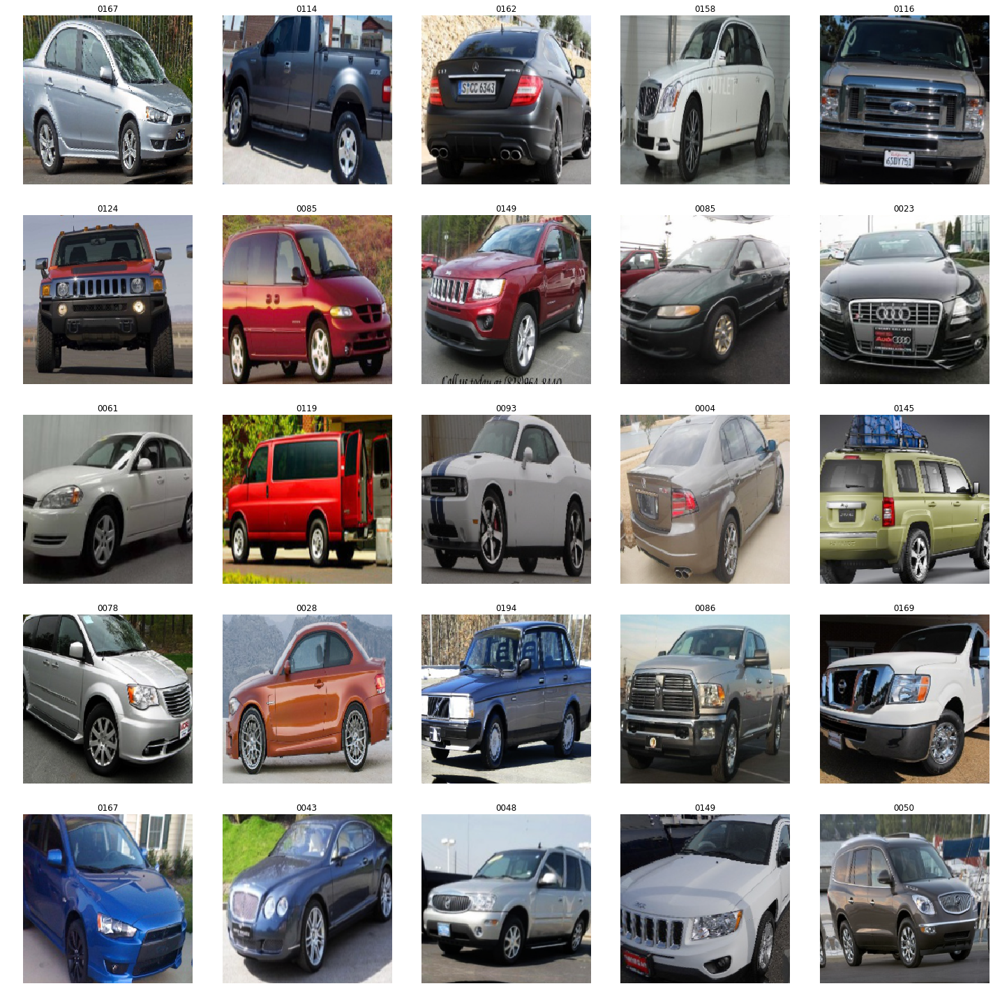

In [71]:
data.show_batch()

In [72]:
print(data.classes)
len(data.classes),data.c


['0001', '0002', '0003', '0004', '0005', '0006', '0007', '0008', '0009', '0010', '0011', '0012', '0013', '0014', '0015', '0016', '0017', '0018', '0019', '0020', '0021', '0022', '0023', '0024', '0025', '0026', '0027', '0028', '0029', '0030', '0031', '0032', '0033', '0034', '0035', '0036', '0037', '0038', '0039', '0040', '0041', '0042', '0043', '0044', '0045', '0046', '0047', '0048', '0049', '0050', '0051', '0052', '0053', '0054', '0055', '0056', '0057', '0058', '0059', '0060', '0061', '0062', '0063', '0064', '0065', '0066', '0067', '0068', '0069', '0070', '0071', '0072', '0073', '0074', '0075', '0076', '0077', '0078', '0079', '0080', '0081', '0082', '0083', '0084', '0085', '0086', '0087', '0088', '0089', '0090', '0091', '0092', '0093', '0094', '0095', '0096', '0097', '0098', '0099', '0100', '0101', '0102', '0103', '0104', '0105', '0106', '0107', '0108', '0109', '0110', '0111', '0112', '0113', '0114', '0115', '0116', '0117', '0118', '0119', '0120', '0121', '0122', '0123', '0124', '0125',

(196, 196)

## Training: resne50

In [73]:
learn = cnn_learner(data, models.resnet50, metrics=accuracy)

In [52]:
learn.fit_one_cycle(4)
preds,y, loss = learn.get_preds(with_loss=True)



In [53]:
acc = accuracy(preds, y)
print('The accuracy is {0} %.'.format(acc))

The accuracy is 0.6224677562713623 %.


In [54]:
learn.save('stanford-cars-1')

## Results

In [55]:
interp = ClassificationInterpretation.from_learner(learn)

losses,idxs = interp.top_losses()

len(data.valid_ds)==len(losses)==len(idxs)

True

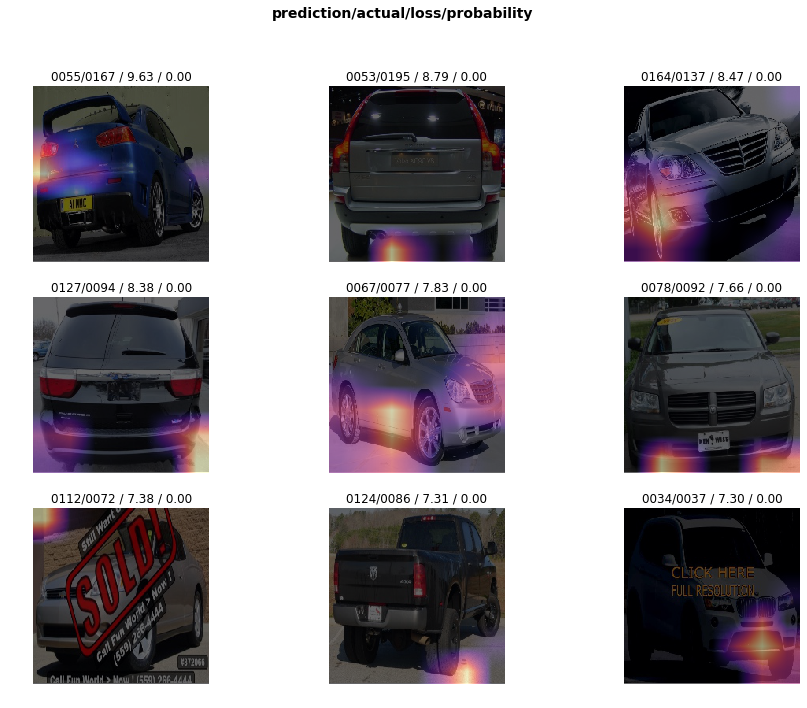

In [56]:
interp.plot_top_losses(9, figsize=(15,11))

In [ ]:
doc(interp.plot_top_losses)

In [57]:
interp.most_confused()

[('0084', '0083', 7),
 ('0140', '0138', 6),
 ('0071', '0119', 5),
 ('0019', '0014', 4),
 ('0024', '0023', 4),
 ('0088', '0166', 4),
 ('0017', '0016', 3),
 ('0018', '0017', 3),
 ('0036', '0031', 3),
 ('0062', '0120', 3),
 ('0095', '0076', 3),
 ('0124', '0125', 3),
 ('0129', '0126', 3),
 ('0165', '0164', 3),
 ('0179', '0180', 3),
 ('0006', '0040', 2),
 ('0009', '0173', 2),
 ('0012', '0021', 2),
 ('0014', '0013', 2),
 ('0014', '0019', 2),
 ('0015', '0014', 2),
 ('0016', '0017', 2),
 ('0017', '0018', 2),
 ('0022', '0023', 2),
 ('0022', '0162', 2),
 ('0023', '0013', 2),
 ('0025', '0013', 2),
 ('0025', '0022', 2),
 ('0029', '0035', 2),
 ('0031', '0036', 2),
 ('0031', '0038', 2),
 ('0042', '0011', 2),
 ('0042', '0043', 2),
 ('0045', '0157', 2),
 ('0064', '0071', 2),
 ('0065', '0054', 2),
 ('0067', '0061', 2),
 ('0072', '0061', 2),
 ('0073', '0061', 2),
 ('0074', '0054', 2),
 ('0086', '0075', 2),
 ('0086', '0087', 2),
 ('0091', '0122', 2),
 ('0095', '0143', 2),
 ('0097', '0096', 2),
 ('0114', 

## Unfreezing, fine-tuning, and learning rates

Since our model is working as we expect it to, we will *unfreeze* our model and train some more.

In [74]:
learn.unfreeze()

In [42]:
learn.load('stanford-cars-1');

In [75]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


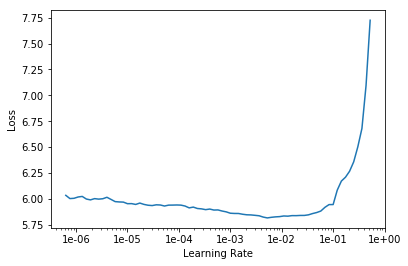

In [76]:
learn.recorder.plot()

In [77]:
learn.fit_one_cycle(10, max_lr=slice(1e-5,1e-2))

epoch,train_loss,valid_loss,accuracy,time
0,3.980040,2.892502,0.311848,01:31
1,2.487354,2.167235,0.445058,01:32
2,2.109999,1.529038,0.590546,01:33
3,1.548193,1.437101,0.611418,01:33
4,1.069342,0.967165,0.742787,01:33
5,0.709701,0.819891,0.793125,01:33
6,0.405046,0.690320,0.819521,01:33
7,0.209479,0.525795,0.861265,01:33
8,0.115298,0.456329,0.877839,01:33
9,0.072730,0.448345,0.885206,01:33


That's a pretty accurate model!